In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'T4_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 250)      255000      input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 44)       11044       lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        90          dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-T4/model checkpoint/T4_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 262543.84375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00002: val_loss improved from 262543.84375 to 197187.34375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00003: val_loss improved from 197187.34375 to 164502.31250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00004: val_loss improved from 164502.31250 to 148489.95312, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00005: val_loss improved from 148489.95312 to 124221.37500, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ck


Epoch 00097: val_loss did not improve from 4619.45898

Epoch 00098: val_loss did not improve from 4619.45898

Epoch 00099: val_loss did not improve from 4619.45898

Epoch 00100: val_loss did not improve from 4619.45898

Epoch 00101: val_loss did not improve from 4619.45898

Epoch 00102: val_loss did not improve from 4619.45898

Epoch 00103: val_loss did not improve from 4619.45898

Epoch 00104: val_loss improved from 4619.45898 to 4169.72803, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00105: val_loss did not improve from 4169.72803

Epoch 00106: val_loss did not improve from 4169.72803

Epoch 00107: val_loss did not improve from 4169.72803

Epoch 00108: val_loss did not improve from 4169.72803

Epoch 00109: val_loss did not improve from 4169.72803

Epoch 00110: val_loss did not improve from 4169.72803

Epoch 00111: val_loss did not improve from 4169.72803

Epoch 00112: val_loss did not improve from 4169.72803



Epoch 00225: val_loss did not improve from 2789.44189

Epoch 00226: val_loss did not improve from 2789.44189

Epoch 00227: val_loss did not improve from 2789.44189

Epoch 00228: val_loss did not improve from 2789.44189

Epoch 00229: val_loss did not improve from 2789.44189

Epoch 00230: val_loss improved from 2789.44189 to 2708.71582, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00231: val_loss did not improve from 2708.71582

Epoch 00232: val_loss did not improve from 2708.71582

Epoch 00233: val_loss did not improve from 2708.71582

Epoch 00234: val_loss did not improve from 2708.71582

Epoch 00235: val_loss improved from 2708.71582 to 2691.36108, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00236: val_loss did not improve from 2691.36108

Epoch 00237: val_loss did not improve from 2691.36108

Epoch 00238: val_loss did not improve from 2


Epoch 00353: val_loss did not improve from 2077.50732

Epoch 00354: val_loss improved from 2077.50732 to 2057.36182, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00355: val_loss did not improve from 2057.36182

Epoch 00356: val_loss did not improve from 2057.36182

Epoch 00357: val_loss did not improve from 2057.36182

Epoch 00358: val_loss did not improve from 2057.36182

Epoch 00359: val_loss improved from 2057.36182 to 2030.64526, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00360: val_loss did not improve from 2030.64526

Epoch 00361: val_loss did not improve from 2030.64526

Epoch 00362: val_loss did not improve from 2030.64526

Epoch 00363: val_loss did not improve from 2030.64526

Epoch 00364: val_loss did not improve from 2030.64526

Epoch 00365: val_loss did not improve from 2030.64526

Epoch 00366: val_loss did not improve from 2


Epoch 00474: val_loss did not improve from 1605.96936

Epoch 00475: val_loss did not improve from 1605.96936

Epoch 00476: val_loss did not improve from 1605.96936

Epoch 00477: val_loss did not improve from 1605.96936

Epoch 00478: val_loss did not improve from 1605.96936

Epoch 00479: val_loss did not improve from 1605.96936

Epoch 00480: val_loss did not improve from 1605.96936

Epoch 00481: val_loss did not improve from 1605.96936

Epoch 00482: val_loss did not improve from 1605.96936

Epoch 00483: val_loss did not improve from 1605.96936

Epoch 00484: val_loss did not improve from 1605.96936

Epoch 00485: val_loss did not improve from 1605.96936

Epoch 00486: val_loss did not improve from 1605.96936

Epoch 00487: val_loss did not improve from 1605.96936

Epoch 00488: val_loss did not improve from 1605.96936

Epoch 00489: val_loss did not improve from 1605.96936

Epoch 00490: val_loss did not improve from 1605.96936

Epoch 00491: val_loss did not improve from 1605.96936

Epoch 004


Epoch 00600: val_loss did not improve from 1209.01514

Epoch 00601: val_loss did not improve from 1209.01514

Epoch 00602: val_loss did not improve from 1209.01514

Epoch 00603: val_loss improved from 1209.01514 to 1163.07935, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00604: val_loss did not improve from 1163.07935

Epoch 00605: val_loss did not improve from 1163.07935

Epoch 00606: val_loss did not improve from 1163.07935

Epoch 00607: val_loss did not improve from 1163.07935

Epoch 00608: val_loss did not improve from 1163.07935

Epoch 00609: val_loss did not improve from 1163.07935

Epoch 00610: val_loss did not improve from 1163.07935

Epoch 00611: val_loss did not improve from 1163.07935

Epoch 00612: val_loss did not improve from 1163.07935

Epoch 00613: val_loss did not improve from 1163.07935

Epoch 00614: val_loss did not improve from 1163.07935

Epoch 00615: val_loss did not improve from 1163.07935



Epoch 00733: val_loss did not improve from 874.40656

Epoch 00734: val_loss did not improve from 874.40656

Epoch 00735: val_loss did not improve from 874.40656

Epoch 00736: val_loss did not improve from 874.40656

Epoch 00737: val_loss did not improve from 874.40656

Epoch 00738: val_loss did not improve from 874.40656

Epoch 00739: val_loss did not improve from 874.40656

Epoch 00740: val_loss did not improve from 874.40656

Epoch 00741: val_loss did not improve from 874.40656

Epoch 00742: val_loss did not improve from 874.40656

Epoch 00743: val_loss did not improve from 874.40656

Epoch 00744: val_loss did not improve from 874.40656

Epoch 00745: val_loss did not improve from 874.40656

Epoch 00746: val_loss did not improve from 874.40656

Epoch 00747: val_loss did not improve from 874.40656

Epoch 00748: val_loss did not improve from 874.40656

Epoch 00749: val_loss did not improve from 874.40656

Epoch 00750: val_loss did not improve from 874.40656

Epoch 00751: val_loss did n


Epoch 00863: val_loss did not improve from 475.13782

Epoch 00864: val_loss did not improve from 475.13782

Epoch 00865: val_loss improved from 475.13782 to 454.86209, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00866: val_loss did not improve from 454.86209

Epoch 00867: val_loss improved from 454.86209 to 420.16266, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00868: val_loss did not improve from 420.16266

Epoch 00869: val_loss did not improve from 420.16266

Epoch 00870: val_loss did not improve from 420.16266

Epoch 00871: val_loss did not improve from 420.16266

Epoch 00872: val_loss did not improve from 420.16266

Epoch 00873: val_loss did not improve from 420.16266

Epoch 00874: val_loss did not improve from 420.16266

Epoch 00875: val_loss did not improve from 420.16266

Epoch 00876: val_loss did not improve from 420.16266

Epoch


Epoch 00992: val_loss did not improve from 136.49727

Epoch 00993: val_loss did not improve from 136.49727

Epoch 00994: val_loss did not improve from 136.49727

Epoch 00995: val_loss improved from 136.49727 to 132.35349, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00996: val_loss did not improve from 132.35349

Epoch 00997: val_loss improved from 132.35349 to 72.97645, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 00998: val_loss did not improve from 72.97645

Epoch 00999: val_loss did not improve from 72.97645

Epoch 01000: val_loss did not improve from 72.97645

Epoch 01001: val_loss did not improve from 72.97645

Epoch 01002: val_loss did not improve from 72.97645

Epoch 01003: val_loss did not improve from 72.97645

Epoch 01004: val_loss did not improve from 72.97645

Epoch 01005: val_loss did not improve from 72.97645

Epoch 01006: v


Epoch 01129: val_loss did not improve from 15.83768

Epoch 01130: val_loss did not improve from 15.83768

Epoch 01131: val_loss did not improve from 15.83768

Epoch 01132: val_loss did not improve from 15.83768

Epoch 01133: val_loss did not improve from 15.83768

Epoch 01134: val_loss did not improve from 15.83768

Epoch 01135: val_loss did not improve from 15.83768

Epoch 01136: val_loss did not improve from 15.83768

Epoch 01137: val_loss did not improve from 15.83768

Epoch 01138: val_loss did not improve from 15.83768

Epoch 01139: val_loss did not improve from 15.83768

Epoch 01140: val_loss did not improve from 15.83768

Epoch 01141: val_loss did not improve from 15.83768

Epoch 01142: val_loss did not improve from 15.83768

Epoch 01143: val_loss did not improve from 15.83768

Epoch 01144: val_loss did not improve from 15.83768

Epoch 01145: val_loss did not improve from 15.83768

Epoch 01146: val_loss did not improve from 15.83768

Epoch 01147: val_loss did not improve from 15


Epoch 01283: val_loss did not improve from 12.45728

Epoch 01284: val_loss did not improve from 12.45728

Epoch 01285: val_loss did not improve from 12.45728

Epoch 01286: val_loss did not improve from 12.45728

Epoch 01287: val_loss did not improve from 12.45728

Epoch 01288: val_loss did not improve from 12.45728

Epoch 01289: val_loss did not improve from 12.45728

Epoch 01290: val_loss did not improve from 12.45728

Epoch 01291: val_loss did not improve from 12.45728

Epoch 01292: val_loss did not improve from 12.45728

Epoch 01293: val_loss did not improve from 12.45728

Epoch 01294: val_loss did not improve from 12.45728

Epoch 01295: val_loss did not improve from 12.45728

Epoch 01296: val_loss did not improve from 12.45728

Epoch 01297: val_loss did not improve from 12.45728

Epoch 01298: val_loss did not improve from 12.45728

Epoch 01299: val_loss did not improve from 12.45728

Epoch 01300: val_loss did not improve from 12.45728

Epoch 01301: val_loss did not improve from 12


Epoch 01438: val_loss did not improve from 12.41222

Epoch 01439: val_loss did not improve from 12.41222

Epoch 01440: val_loss did not improve from 12.41222

Epoch 01441: val_loss did not improve from 12.41222

Epoch 01442: val_loss did not improve from 12.41222

Epoch 01443: val_loss did not improve from 12.41222

Epoch 01444: val_loss did not improve from 12.41222

Epoch 01445: val_loss did not improve from 12.41222

Epoch 01446: val_loss did not improve from 12.41222

Epoch 01447: val_loss did not improve from 12.41222

Epoch 01448: val_loss did not improve from 12.41222

Epoch 01449: val_loss did not improve from 12.41222

Epoch 01450: val_loss did not improve from 12.41222

Epoch 01451: val_loss did not improve from 12.41222

Epoch 01452: val_loss did not improve from 12.41222

Epoch 01453: val_loss did not improve from 12.41222

Epoch 01454: val_loss did not improve from 12.41222

Epoch 01455: val_loss did not improve from 12.41222

Epoch 01456: val_loss did not improve from 12


Epoch 01595: val_loss did not improve from 12.41222

Epoch 01596: val_loss did not improve from 12.41222

Epoch 01597: val_loss did not improve from 12.41222

Epoch 01598: val_loss did not improve from 12.41222

Epoch 01599: val_loss did not improve from 12.41222

Epoch 01600: val_loss did not improve from 12.41222

Epoch 01601: val_loss did not improve from 12.41222

Epoch 01602: val_loss did not improve from 12.41222

Epoch 01603: val_loss did not improve from 12.41222

Epoch 01604: val_loss did not improve from 12.41222

Epoch 01605: val_loss did not improve from 12.41222

Epoch 01606: val_loss did not improve from 12.41222

Epoch 01607: val_loss did not improve from 12.41222

Epoch 01608: val_loss did not improve from 12.41222

Epoch 01609: val_loss did not improve from 12.41222

Epoch 01610: val_loss did not improve from 12.41222

Epoch 01611: val_loss did not improve from 12.41222

Epoch 01612: val_loss did not improve from 12.41222

Epoch 01613: val_loss did not improve from 12


Epoch 01750: val_loss did not improve from 12.41222

Epoch 01751: val_loss did not improve from 12.41222

Epoch 01752: val_loss did not improve from 12.41222

Epoch 01753: val_loss did not improve from 12.41222

Epoch 01754: val_loss did not improve from 12.41222

Epoch 01755: val_loss did not improve from 12.41222

Epoch 01756: val_loss did not improve from 12.41222

Epoch 01757: val_loss improved from 12.41222 to 11.92572, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4/model checkpoint\T4_2_ckpt

Epoch 01758: val_loss did not improve from 11.92572

Epoch 01759: val_loss did not improve from 11.92572

Epoch 01760: val_loss did not improve from 11.92572

Epoch 01761: val_loss did not improve from 11.92572

Epoch 01762: val_loss did not improve from 11.92572

Epoch 01763: val_loss did not improve from 11.92572

Epoch 01764: val_loss did not improve from 11.92572

Epoch 01765: val_loss did not improve from 11.92572

Epoch 01766: val_loss did not imp


Epoch 01905: val_loss did not improve from 11.92572

Epoch 01906: val_loss did not improve from 11.92572

Epoch 01907: val_loss did not improve from 11.92572

Epoch 01908: val_loss did not improve from 11.92572

Epoch 01909: val_loss did not improve from 11.92572

Epoch 01910: val_loss did not improve from 11.92572

Epoch 01911: val_loss did not improve from 11.92572

Epoch 01912: val_loss did not improve from 11.92572

Epoch 01913: val_loss did not improve from 11.92572

Epoch 01914: val_loss did not improve from 11.92572

Epoch 01915: val_loss did not improve from 11.92572

Epoch 01916: val_loss did not improve from 11.92572

Epoch 01917: val_loss did not improve from 11.92572

Epoch 01918: val_loss did not improve from 11.92572

Epoch 01919: val_loss did not improve from 11.92572

Epoch 01920: val_loss did not improve from 11.92572

Epoch 01921: val_loss did not improve from 11.92572

Epoch 01922: val_loss did not improve from 11.92572

Epoch 01923: val_loss did not improve from 11


Epoch 02061: val_loss did not improve from 11.92572

Epoch 02062: val_loss did not improve from 11.92572

Epoch 02063: val_loss did not improve from 11.92572

Epoch 02064: val_loss did not improve from 11.92572

Epoch 02065: val_loss did not improve from 11.92572

Epoch 02066: val_loss did not improve from 11.92572

Epoch 02067: val_loss did not improve from 11.92572

Epoch 02068: val_loss did not improve from 11.92572

Epoch 02069: val_loss did not improve from 11.92572

Epoch 02070: val_loss did not improve from 11.92572

Epoch 02071: val_loss did not improve from 11.92572

Epoch 02072: val_loss did not improve from 11.92572

Epoch 02073: val_loss did not improve from 11.92572

Epoch 02074: val_loss did not improve from 11.92572

Epoch 02075: val_loss did not improve from 11.92572

Epoch 02076: val_loss did not improve from 11.92572

Epoch 02077: val_loss did not improve from 11.92572

Epoch 02078: val_loss did not improve from 11.92572

Epoch 02079: val_loss did not improve from 11


Epoch 02218: val_loss did not improve from 11.92572

Epoch 02219: val_loss did not improve from 11.92572

Epoch 02220: val_loss did not improve from 11.92572

Epoch 02221: val_loss did not improve from 11.92572

Epoch 02222: val_loss did not improve from 11.92572

Epoch 02223: val_loss did not improve from 11.92572

Epoch 02224: val_loss did not improve from 11.92572

Epoch 02225: val_loss did not improve from 11.92572

Epoch 02226: val_loss did not improve from 11.92572

Epoch 02227: val_loss did not improve from 11.92572

Epoch 02228: val_loss did not improve from 11.92572

Epoch 02229: val_loss did not improve from 11.92572

Epoch 02230: val_loss did not improve from 11.92572

Epoch 02231: val_loss did not improve from 11.92572

Epoch 02232: val_loss did not improve from 11.92572

Epoch 02233: val_loss did not improve from 11.92572

Epoch 02234: val_loss did not improve from 11.92572

Epoch 02235: val_loss did not improve from 11.92572

Epoch 02236: val_loss did not improve from 11


Epoch 02374: val_loss did not improve from 11.92572

Epoch 02375: val_loss did not improve from 11.92572

Epoch 02376: val_loss did not improve from 11.92572

Epoch 02377: val_loss did not improve from 11.92572

Epoch 02378: val_loss did not improve from 11.92572

Epoch 02379: val_loss did not improve from 11.92572

Epoch 02380: val_loss did not improve from 11.92572

Epoch 02381: val_loss did not improve from 11.92572

Epoch 02382: val_loss did not improve from 11.92572

Epoch 02383: val_loss did not improve from 11.92572

Epoch 02384: val_loss did not improve from 11.92572

Epoch 02385: val_loss did not improve from 11.92572

Epoch 02386: val_loss did not improve from 11.92572

Epoch 02387: val_loss did not improve from 11.92572

Epoch 02388: val_loss did not improve from 11.92572

Epoch 02389: val_loss did not improve from 11.92572

Epoch 02390: val_loss did not improve from 11.92572

Epoch 02391: val_loss did not improve from 11.92572

Epoch 02392: val_loss did not improve from 11


Epoch 02530: val_loss did not improve from 11.92572

Epoch 02531: val_loss did not improve from 11.92572

Epoch 02532: val_loss did not improve from 11.92572

Epoch 02533: val_loss did not improve from 11.92572

Epoch 02534: val_loss did not improve from 11.92572

Epoch 02535: val_loss did not improve from 11.92572

Epoch 02536: val_loss did not improve from 11.92572

Epoch 02537: val_loss did not improve from 11.92572

Epoch 02538: val_loss did not improve from 11.92572

Epoch 02539: val_loss did not improve from 11.92572

Epoch 02540: val_loss did not improve from 11.92572

Epoch 02541: val_loss did not improve from 11.92572

Epoch 02542: val_loss did not improve from 11.92572

Epoch 02543: val_loss did not improve from 11.92572

Epoch 02544: val_loss did not improve from 11.92572

Epoch 02545: val_loss did not improve from 11.92572

Epoch 02546: val_loss did not improve from 11.92572

Epoch 02547: val_loss did not improve from 11.92572

Epoch 02548: val_loss did not improve from 11


Epoch 02686: val_loss did not improve from 11.92572

Epoch 02687: val_loss did not improve from 11.92572

Epoch 02688: val_loss did not improve from 11.92572

Epoch 02689: val_loss did not improve from 11.92572

Epoch 02690: val_loss did not improve from 11.92572

Epoch 02691: val_loss did not improve from 11.92572

Epoch 02692: val_loss did not improve from 11.92572

Epoch 02693: val_loss did not improve from 11.92572

Epoch 02694: val_loss did not improve from 11.92572

Epoch 02695: val_loss did not improve from 11.92572

Epoch 02696: val_loss did not improve from 11.92572

Epoch 02697: val_loss did not improve from 11.92572

Epoch 02698: val_loss did not improve from 11.92572

Epoch 02699: val_loss did not improve from 11.92572

Epoch 02700: val_loss did not improve from 11.92572

Epoch 02701: val_loss did not improve from 11.92572

Epoch 02702: val_loss did not improve from 11.92572

Epoch 02703: val_loss did not improve from 11.92572

Epoch 02704: val_loss did not improve from 11


Epoch 02842: val_loss did not improve from 11.92572

Epoch 02843: val_loss did not improve from 11.92572

Epoch 02844: val_loss did not improve from 11.92572

Epoch 02845: val_loss did not improve from 11.92572

Epoch 02846: val_loss did not improve from 11.92572

Epoch 02847: val_loss did not improve from 11.92572

Epoch 02848: val_loss did not improve from 11.92572

Epoch 02849: val_loss did not improve from 11.92572

Epoch 02850: val_loss did not improve from 11.92572

Epoch 02851: val_loss did not improve from 11.92572

Epoch 02852: val_loss did not improve from 11.92572

Epoch 02853: val_loss did not improve from 11.92572

Epoch 02854: val_loss did not improve from 11.92572

Epoch 02855: val_loss did not improve from 11.92572

Epoch 02856: val_loss did not improve from 11.92572

Epoch 02857: val_loss did not improve from 11.92572

Epoch 02858: val_loss did not improve from 11.92572

Epoch 02859: val_loss did not improve from 11.92572

Epoch 02860: val_loss did not improve from 11


Epoch 02998: val_loss did not improve from 11.92572

Epoch 02999: val_loss did not improve from 11.92572

Epoch 03000: val_loss did not improve from 11.92572

Epoch 03001: val_loss did not improve from 11.92572

Epoch 03002: val_loss did not improve from 11.92572

Epoch 03003: val_loss did not improve from 11.92572

Epoch 03004: val_loss did not improve from 11.92572

Epoch 03005: val_loss did not improve from 11.92572

Epoch 03006: val_loss did not improve from 11.92572

Epoch 03007: val_loss did not improve from 11.92572

Epoch 03008: val_loss did not improve from 11.92572

Epoch 03009: val_loss did not improve from 11.92572

Epoch 03010: val_loss did not improve from 11.92572

Epoch 03011: val_loss did not improve from 11.92572

Epoch 03012: val_loss did not improve from 11.92572

Epoch 03013: val_loss did not improve from 11.92572

Epoch 03014: val_loss did not improve from 11.92572

Epoch 03015: val_loss did not improve from 11.92572

Epoch 03016: val_loss did not improve from 11

Epoch 03154: val_loss did not improve from 11.92572

Epoch 03155: val_loss did not improve from 11.92572

Epoch 03156: val_loss did not improve from 11.92572

Epoch 03157: val_loss did not improve from 11.92572

Epoch 03158: val_loss did not improve from 11.92572

Epoch 03159: val_loss did not improve from 11.92572

Epoch 03160: val_loss did not improve from 11.92572

Epoch 03161: val_loss did not improve from 11.92572

Epoch 03162: val_loss did not improve from 11.92572

Epoch 03163: val_loss did not improve from 11.92572

Epoch 03164: val_loss did not improve from 11.92572

Epoch 03165: val_loss did not improve from 11.92572

Epoch 03166: val_loss did not improve from 11.92572

Epoch 03167: val_loss did not improve from 11.92572

Epoch 03168: val_loss did not improve from 11.92572

Epoch 03169: val_loss did not improve from 11.92572

Epoch 03170: val_loss did not improve from 11.92572

Epoch 03171: val_loss did not improve from 11.92572

Epoch 03172: val_loss did not improve from 11.


Epoch 03309: val_loss did not improve from 11.92572

Epoch 03310: val_loss did not improve from 11.92572

Epoch 03311: val_loss did not improve from 11.92572

Epoch 03312: val_loss did not improve from 11.92572

Epoch 03313: val_loss did not improve from 11.92572

Epoch 03314: val_loss did not improve from 11.92572

Epoch 03315: val_loss did not improve from 11.92572

Epoch 03316: val_loss did not improve from 11.92572

Epoch 03317: val_loss did not improve from 11.92572

Epoch 03318: val_loss did not improve from 11.92572

Epoch 03319: val_loss did not improve from 11.92572

Epoch 03320: val_loss did not improve from 11.92572

Epoch 03321: val_loss did not improve from 11.92572

Epoch 03322: val_loss did not improve from 11.92572

Epoch 03323: val_loss did not improve from 11.92572

Epoch 03324: val_loss did not improve from 11.92572

Epoch 03325: val_loss did not improve from 11.92572

Epoch 03326: val_loss did not improve from 11.92572

Epoch 03327: val_loss did not improve from 11


Epoch 03465: val_loss did not improve from 11.92572

Epoch 03466: val_loss did not improve from 11.92572

Epoch 03467: val_loss did not improve from 11.92572

Epoch 03468: val_loss did not improve from 11.92572

Epoch 03469: val_loss did not improve from 11.92572

Epoch 03470: val_loss did not improve from 11.92572

Epoch 03471: val_loss did not improve from 11.92572

Epoch 03472: val_loss did not improve from 11.92572

Epoch 03473: val_loss did not improve from 11.92572

Epoch 03474: val_loss did not improve from 11.92572

Epoch 03475: val_loss did not improve from 11.92572

Epoch 03476: val_loss did not improve from 11.92572

Epoch 03477: val_loss did not improve from 11.92572

Epoch 03478: val_loss did not improve from 11.92572

Epoch 03479: val_loss did not improve from 11.92572

Epoch 03480: val_loss did not improve from 11.92572

Epoch 03481: val_loss did not improve from 11.92572

Epoch 03482: val_loss did not improve from 11.92572

Epoch 03483: val_loss did not improve from 11


Epoch 03621: val_loss did not improve from 11.92572

Epoch 03622: val_loss did not improve from 11.92572

Epoch 03623: val_loss did not improve from 11.92572

Epoch 03624: val_loss did not improve from 11.92572

Epoch 03625: val_loss did not improve from 11.92572

Epoch 03626: val_loss did not improve from 11.92572

Epoch 03627: val_loss did not improve from 11.92572

Epoch 03628: val_loss did not improve from 11.92572

Epoch 03629: val_loss did not improve from 11.92572

Epoch 03630: val_loss did not improve from 11.92572

Epoch 03631: val_loss did not improve from 11.92572

Epoch 03632: val_loss did not improve from 11.92572

Epoch 03633: val_loss did not improve from 11.92572

Epoch 03634: val_loss did not improve from 11.92572

Epoch 03635: val_loss did not improve from 11.92572

Epoch 03636: val_loss did not improve from 11.92572

Epoch 03637: val_loss did not improve from 11.92572

Epoch 03638: val_loss did not improve from 11.92572

Epoch 03639: val_loss did not improve from 11


Epoch 03776: val_loss did not improve from 11.92572

Epoch 03777: val_loss did not improve from 11.92572

Epoch 03778: val_loss did not improve from 11.92572

Epoch 03779: val_loss did not improve from 11.92572

Epoch 03780: val_loss did not improve from 11.92572

Epoch 03781: val_loss did not improve from 11.92572

Epoch 03782: val_loss did not improve from 11.92572

Epoch 03783: val_loss did not improve from 11.92572

Epoch 03784: val_loss did not improve from 11.92572

Epoch 03785: val_loss did not improve from 11.92572

Epoch 03786: val_loss did not improve from 11.92572

Epoch 03787: val_loss did not improve from 11.92572

Epoch 03788: val_loss did not improve from 11.92572

Epoch 03789: val_loss did not improve from 11.92572

Epoch 03790: val_loss did not improve from 11.92572

Epoch 03791: val_loss did not improve from 11.92572

Epoch 03792: val_loss did not improve from 11.92572

Epoch 03793: val_loss did not improve from 11.92572

Epoch 03794: val_loss did not improve from 11


Epoch 03933: val_loss did not improve from 11.92572

Epoch 03934: val_loss did not improve from 11.92572

Epoch 03935: val_loss did not improve from 11.92572

Epoch 03936: val_loss did not improve from 11.92572

Epoch 03937: val_loss did not improve from 11.92572

Epoch 03938: val_loss did not improve from 11.92572

Epoch 03939: val_loss did not improve from 11.92572

Epoch 03940: val_loss did not improve from 11.92572

Epoch 03941: val_loss did not improve from 11.92572

Epoch 03942: val_loss did not improve from 11.92572

Epoch 03943: val_loss did not improve from 11.92572

Epoch 03944: val_loss did not improve from 11.92572

Epoch 03945: val_loss did not improve from 11.92572

Epoch 03946: val_loss did not improve from 11.92572

Epoch 03947: val_loss did not improve from 11.92572

Epoch 03948: val_loss did not improve from 11.92572

Epoch 03949: val_loss did not improve from 11.92572

Epoch 03950: val_loss did not improve from 11.92572

Epoch 03951: val_loss did not improve from 11


Epoch 04089: val_loss did not improve from 11.92572

Epoch 04090: val_loss did not improve from 11.92572

Epoch 04091: val_loss did not improve from 11.92572

Epoch 04092: val_loss did not improve from 11.92572

Epoch 04093: val_loss did not improve from 11.92572

Epoch 04094: val_loss did not improve from 11.92572

Epoch 04095: val_loss did not improve from 11.92572

Epoch 04096: val_loss did not improve from 11.92572

Epoch 04097: val_loss did not improve from 11.92572

Epoch 04098: val_loss did not improve from 11.92572

Epoch 04099: val_loss did not improve from 11.92572

Epoch 04100: val_loss did not improve from 11.92572

Epoch 04101: val_loss did not improve from 11.92572

Epoch 04102: val_loss did not improve from 11.92572

Epoch 04103: val_loss did not improve from 11.92572

Epoch 04104: val_loss did not improve from 11.92572

Epoch 04105: val_loss did not improve from 11.92572

Epoch 04106: val_loss did not improve from 11.92572

Epoch 04107: val_loss did not improve from 11


Epoch 04245: val_loss did not improve from 11.92572

Epoch 04246: val_loss did not improve from 11.92572

Epoch 04247: val_loss did not improve from 11.92572

Epoch 04248: val_loss did not improve from 11.92572

Epoch 04249: val_loss did not improve from 11.92572

Epoch 04250: val_loss did not improve from 11.92572

Epoch 04251: val_loss did not improve from 11.92572

Epoch 04252: val_loss did not improve from 11.92572

Epoch 04253: val_loss did not improve from 11.92572

Epoch 04254: val_loss did not improve from 11.92572

Epoch 04255: val_loss did not improve from 11.92572

Epoch 04256: val_loss did not improve from 11.92572

Epoch 04257: val_loss did not improve from 11.92572

Epoch 04258: val_loss did not improve from 11.92572

Epoch 04259: val_loss did not improve from 11.92572

Epoch 04260: val_loss did not improve from 11.92572

Epoch 04261: val_loss did not improve from 11.92572

Epoch 04262: val_loss did not improve from 11.92572

Epoch 04263: val_loss did not improve from 11

Epoch 04401: val_loss did not improve from 11.92572

Epoch 04402: val_loss did not improve from 11.92572

Epoch 04403: val_loss did not improve from 11.92572

Epoch 04404: val_loss did not improve from 11.92572

Epoch 04405: val_loss did not improve from 11.92572

Epoch 04406: val_loss did not improve from 11.92572

Epoch 04407: val_loss did not improve from 11.92572

Epoch 04408: val_loss did not improve from 11.92572

Epoch 04409: val_loss did not improve from 11.92572

Epoch 04410: val_loss did not improve from 11.92572

Epoch 04411: val_loss did not improve from 11.92572

Epoch 04412: val_loss did not improve from 11.92572

Epoch 04413: val_loss did not improve from 11.92572

Epoch 04414: val_loss did not improve from 11.92572

Epoch 04415: val_loss did not improve from 11.92572

Epoch 04416: val_loss did not improve from 11.92572

Epoch 04417: val_loss did not improve from 11.92572

Epoch 04418: val_loss did not improve from 11.92572

Epoch 04419: val_loss did not improve from 11.

Epoch 04557: val_loss did not improve from 11.92572

Epoch 04558: val_loss did not improve from 11.92572

Epoch 04559: val_loss did not improve from 11.92572

Epoch 04560: val_loss did not improve from 11.92572

Epoch 04561: val_loss did not improve from 11.92572

Epoch 04562: val_loss did not improve from 11.92572

Epoch 04563: val_loss did not improve from 11.92572

Epoch 04564: val_loss did not improve from 11.92572

Epoch 04565: val_loss did not improve from 11.92572

Epoch 04566: val_loss did not improve from 11.92572

Epoch 04567: val_loss did not improve from 11.92572

Epoch 04568: val_loss did not improve from 11.92572

Epoch 04569: val_loss did not improve from 11.92572

Epoch 04570: val_loss did not improve from 11.92572

Epoch 04571: val_loss did not improve from 11.92572

Epoch 04572: val_loss did not improve from 11.92572

Epoch 04573: val_loss did not improve from 11.92572

Epoch 04574: val_loss did not improve from 11.92572

Epoch 04575: val_loss did not improve from 11.


Epoch 04713: val_loss did not improve from 11.92572

Epoch 04714: val_loss did not improve from 11.92572

Epoch 04715: val_loss did not improve from 11.92572

Epoch 04716: val_loss did not improve from 11.92572

Epoch 04717: val_loss did not improve from 11.92572

Epoch 04718: val_loss did not improve from 11.92572

Epoch 04719: val_loss did not improve from 11.92572

Epoch 04720: val_loss did not improve from 11.92572

Epoch 04721: val_loss did not improve from 11.92572

Epoch 04722: val_loss did not improve from 11.92572

Epoch 04723: val_loss did not improve from 11.92572

Epoch 04724: val_loss did not improve from 11.92572

Epoch 04725: val_loss did not improve from 11.92572

Epoch 04726: val_loss did not improve from 11.92572

Epoch 04727: val_loss did not improve from 11.92572

Epoch 04728: val_loss did not improve from 11.92572

Epoch 04729: val_loss did not improve from 11.92572

Epoch 04730: val_loss did not improve from 11.92572

Epoch 04731: val_loss did not improve from 11


Epoch 04869: val_loss did not improve from 11.92572

Epoch 04870: val_loss did not improve from 11.92572

Epoch 04871: val_loss did not improve from 11.92572

Epoch 04872: val_loss did not improve from 11.92572

Epoch 04873: val_loss did not improve from 11.92572

Epoch 04874: val_loss did not improve from 11.92572

Epoch 04875: val_loss did not improve from 11.92572

Epoch 04876: val_loss did not improve from 11.92572

Epoch 04877: val_loss did not improve from 11.92572

Epoch 04878: val_loss did not improve from 11.92572

Epoch 04879: val_loss did not improve from 11.92572

Epoch 04880: val_loss did not improve from 11.92572

Epoch 04881: val_loss did not improve from 11.92572

Epoch 04882: val_loss did not improve from 11.92572

Epoch 04883: val_loss did not improve from 11.92572

Epoch 04884: val_loss did not improve from 11.92572

Epoch 04885: val_loss did not improve from 11.92572

Epoch 04886: val_loss did not improve from 11.92572

Epoch 04887: val_loss did not improve from 11


Epoch 05024: val_loss did not improve from 11.92572

Epoch 05025: val_loss did not improve from 11.92572

Epoch 05026: val_loss did not improve from 11.92572

Epoch 05027: val_loss did not improve from 11.92572

Epoch 05028: val_loss did not improve from 11.92572

Epoch 05029: val_loss did not improve from 11.92572

Epoch 05030: val_loss did not improve from 11.92572

Epoch 05031: val_loss did not improve from 11.92572

Epoch 05032: val_loss did not improve from 11.92572

Epoch 05033: val_loss did not improve from 11.92572

Epoch 05034: val_loss did not improve from 11.92572

Epoch 05035: val_loss did not improve from 11.92572

Epoch 05036: val_loss did not improve from 11.92572

Epoch 05037: val_loss did not improve from 11.92572

Epoch 05038: val_loss did not improve from 11.92572

Epoch 05039: val_loss did not improve from 11.92572

Epoch 05040: val_loss did not improve from 11.92572

Epoch 05041: val_loss did not improve from 11.92572

Epoch 05042: val_loss did not improve from 11


Epoch 05181: val_loss did not improve from 11.92572

Epoch 05182: val_loss did not improve from 11.92572

Epoch 05183: val_loss did not improve from 11.92572

Epoch 05184: val_loss did not improve from 11.92572

Epoch 05185: val_loss did not improve from 11.92572

Epoch 05186: val_loss did not improve from 11.92572

Epoch 05187: val_loss did not improve from 11.92572

Epoch 05188: val_loss did not improve from 11.92572

Epoch 05189: val_loss did not improve from 11.92572

Epoch 05190: val_loss did not improve from 11.92572

Epoch 05191: val_loss did not improve from 11.92572

Epoch 05192: val_loss did not improve from 11.92572

Epoch 05193: val_loss did not improve from 11.92572

Epoch 05194: val_loss did not improve from 11.92572

Epoch 05195: val_loss did not improve from 11.92572

Epoch 05196: val_loss did not improve from 11.92572

Epoch 05197: val_loss did not improve from 11.92572

Epoch 05198: val_loss did not improve from 11.92572

Epoch 05199: val_loss did not improve from 11


Epoch 05337: val_loss did not improve from 11.92572

Epoch 05338: val_loss did not improve from 11.92572

Epoch 05339: val_loss did not improve from 11.92572

Epoch 05340: val_loss did not improve from 11.92572

Epoch 05341: val_loss did not improve from 11.92572

Epoch 05342: val_loss did not improve from 11.92572

Epoch 05343: val_loss did not improve from 11.92572

Epoch 05344: val_loss did not improve from 11.92572

Epoch 05345: val_loss did not improve from 11.92572

Epoch 05346: val_loss did not improve from 11.92572

Epoch 05347: val_loss did not improve from 11.92572

Epoch 05348: val_loss did not improve from 11.92572

Epoch 05349: val_loss did not improve from 11.92572

Epoch 05350: val_loss did not improve from 11.92572

Epoch 05351: val_loss did not improve from 11.92572

Epoch 05352: val_loss did not improve from 11.92572

Epoch 05353: val_loss did not improve from 11.92572

Epoch 05354: val_loss did not improve from 11.92572

Epoch 05355: val_loss did not improve from 11


Epoch 05492: val_loss did not improve from 11.92572

Epoch 05493: val_loss did not improve from 11.92572

Epoch 05494: val_loss did not improve from 11.92572

Epoch 05495: val_loss did not improve from 11.92572

Epoch 05496: val_loss did not improve from 11.92572

Epoch 05497: val_loss did not improve from 11.92572

Epoch 05498: val_loss did not improve from 11.92572

Epoch 05499: val_loss did not improve from 11.92572

Epoch 05500: val_loss did not improve from 11.92572

Epoch 05501: val_loss did not improve from 11.92572

Epoch 05502: val_loss did not improve from 11.92572

Epoch 05503: val_loss did not improve from 11.92572

Epoch 05504: val_loss did not improve from 11.92572

Epoch 05505: val_loss did not improve from 11.92572

Epoch 05506: val_loss did not improve from 11.92572

Epoch 05507: val_loss did not improve from 11.92572

Epoch 05508: val_loss did not improve from 11.92572

Epoch 05509: val_loss did not improve from 11.92572

Epoch 05510: val_loss did not improve from 11


Epoch 05649: val_loss did not improve from 11.92572

Epoch 05650: val_loss did not improve from 11.92572

Epoch 05651: val_loss did not improve from 11.92572

Epoch 05652: val_loss did not improve from 11.92572

Epoch 05653: val_loss did not improve from 11.92572

Epoch 05654: val_loss did not improve from 11.92572

Epoch 05655: val_loss did not improve from 11.92572

Epoch 05656: val_loss did not improve from 11.92572

Epoch 05657: val_loss did not improve from 11.92572

Epoch 05658: val_loss did not improve from 11.92572

Epoch 05659: val_loss did not improve from 11.92572

Epoch 05660: val_loss did not improve from 11.92572

Epoch 05661: val_loss did not improve from 11.92572

Epoch 05662: val_loss did not improve from 11.92572

Epoch 05663: val_loss did not improve from 11.92572

Epoch 05664: val_loss did not improve from 11.92572

Epoch 05665: val_loss did not improve from 11.92572

Epoch 05666: val_loss did not improve from 11.92572

Epoch 05667: val_loss did not improve from 11


Epoch 05804: val_loss did not improve from 11.92572

Epoch 05805: val_loss did not improve from 11.92572

Epoch 05806: val_loss did not improve from 11.92572

Epoch 05807: val_loss did not improve from 11.92572

Epoch 05808: val_loss did not improve from 11.92572

Epoch 05809: val_loss did not improve from 11.92572

Epoch 05810: val_loss did not improve from 11.92572

Epoch 05811: val_loss did not improve from 11.92572

Epoch 05812: val_loss did not improve from 11.92572

Epoch 05813: val_loss did not improve from 11.92572

Epoch 05814: val_loss did not improve from 11.92572

Epoch 05815: val_loss did not improve from 11.92572

Epoch 05816: val_loss did not improve from 11.92572

Epoch 05817: val_loss did not improve from 11.92572

Epoch 05818: val_loss did not improve from 11.92572

Epoch 05819: val_loss did not improve from 11.92572

Epoch 05820: val_loss did not improve from 11.92572

Epoch 05821: val_loss did not improve from 11.92572

Epoch 05822: val_loss did not improve from 11

Epoch 05960: val_loss did not improve from 11.92572

Epoch 05961: val_loss did not improve from 11.92572

Epoch 05962: val_loss did not improve from 11.92572

Epoch 05963: val_loss did not improve from 11.92572

Epoch 05964: val_loss did not improve from 11.92572

Epoch 05965: val_loss did not improve from 11.92572

Epoch 05966: val_loss did not improve from 11.92572

Epoch 05967: val_loss did not improve from 11.92572

Epoch 05968: val_loss did not improve from 11.92572

Epoch 05969: val_loss did not improve from 11.92572

Epoch 05970: val_loss did not improve from 11.92572

Epoch 05971: val_loss did not improve from 11.92572

Epoch 05972: val_loss did not improve from 11.92572

Epoch 05973: val_loss did not improve from 11.92572

Epoch 05974: val_loss did not improve from 11.92572

Epoch 05975: val_loss did not improve from 11.92572

Epoch 05976: val_loss did not improve from 11.92572

Epoch 05977: val_loss did not improve from 11.92572

Epoch 05978: val_loss did not improve from 11.


Epoch 06116: val_loss did not improve from 11.92572

Epoch 06117: val_loss did not improve from 11.92572

Epoch 06118: val_loss did not improve from 11.92572

Epoch 06119: val_loss did not improve from 11.92572

Epoch 06120: val_loss did not improve from 11.92572

Epoch 06121: val_loss did not improve from 11.92572

Epoch 06122: val_loss did not improve from 11.92572

Epoch 06123: val_loss did not improve from 11.92572

Epoch 06124: val_loss did not improve from 11.92572

Epoch 06125: val_loss did not improve from 11.92572

Epoch 06126: val_loss did not improve from 11.92572

Epoch 06127: val_loss did not improve from 11.92572

Epoch 06128: val_loss did not improve from 11.92572

Epoch 06129: val_loss did not improve from 11.92572

Epoch 06130: val_loss did not improve from 11.92572

Epoch 06131: val_loss did not improve from 11.92572

Epoch 06132: val_loss did not improve from 11.92572

Epoch 06133: val_loss did not improve from 11.92572

Epoch 06134: val_loss did not improve from 11


Epoch 06272: val_loss did not improve from 11.92572

Epoch 06273: val_loss did not improve from 11.92572

Epoch 06274: val_loss did not improve from 11.92572

Epoch 06275: val_loss did not improve from 11.92572

Epoch 06276: val_loss did not improve from 11.92572

Epoch 06277: val_loss did not improve from 11.92572

Epoch 06278: val_loss did not improve from 11.92572

Epoch 06279: val_loss did not improve from 11.92572

Epoch 06280: val_loss did not improve from 11.92572

Epoch 06281: val_loss did not improve from 11.92572

Epoch 06282: val_loss did not improve from 11.92572

Epoch 06283: val_loss did not improve from 11.92572

Epoch 06284: val_loss did not improve from 11.92572

Epoch 06285: val_loss did not improve from 11.92572

Epoch 06286: val_loss did not improve from 11.92572

Epoch 06287: val_loss did not improve from 11.92572

Epoch 06288: val_loss did not improve from 11.92572

Epoch 06289: val_loss did not improve from 11.92572

Epoch 06290: val_loss did not improve from 11


Epoch 06428: val_loss did not improve from 11.92572

Epoch 06429: val_loss did not improve from 11.92572

Epoch 06430: val_loss did not improve from 11.92572

Epoch 06431: val_loss did not improve from 11.92572

Epoch 06432: val_loss did not improve from 11.92572

Epoch 06433: val_loss did not improve from 11.92572

Epoch 06434: val_loss did not improve from 11.92572

Epoch 06435: val_loss did not improve from 11.92572

Epoch 06436: val_loss did not improve from 11.92572

Epoch 06437: val_loss did not improve from 11.92572

Epoch 06438: val_loss did not improve from 11.92572

Epoch 06439: val_loss did not improve from 11.92572

Epoch 06440: val_loss did not improve from 11.92572

Epoch 06441: val_loss did not improve from 11.92572

Epoch 06442: val_loss did not improve from 11.92572

Epoch 06443: val_loss did not improve from 11.92572

Epoch 06444: val_loss did not improve from 11.92572

Epoch 06445: val_loss did not improve from 11.92572

Epoch 06446: val_loss did not improve from 11


Epoch 06583: val_loss did not improve from 11.92572

Epoch 06584: val_loss did not improve from 11.92572

Epoch 06585: val_loss did not improve from 11.92572

Epoch 06586: val_loss did not improve from 11.92572

Epoch 06587: val_loss did not improve from 11.92572

Epoch 06588: val_loss did not improve from 11.92572

Epoch 06589: val_loss did not improve from 11.92572

Epoch 06590: val_loss did not improve from 11.92572

Epoch 06591: val_loss did not improve from 11.92572

Epoch 06592: val_loss did not improve from 11.92572

Epoch 06593: val_loss did not improve from 11.92572

Epoch 06594: val_loss did not improve from 11.92572

Epoch 06595: val_loss did not improve from 11.92572

Epoch 06596: val_loss did not improve from 11.92572

Epoch 06597: val_loss did not improve from 11.92572

Epoch 06598: val_loss did not improve from 11.92572

Epoch 06599: val_loss did not improve from 11.92572

Epoch 06600: val_loss did not improve from 11.92572

Epoch 06601: val_loss did not improve from 11

Epoch 06739: val_loss did not improve from 11.92572

Epoch 06740: val_loss did not improve from 11.92572

Epoch 06741: val_loss did not improve from 11.92572

Epoch 06742: val_loss did not improve from 11.92572

Epoch 06743: val_loss did not improve from 11.92572

Epoch 06744: val_loss did not improve from 11.92572

Epoch 06745: val_loss did not improve from 11.92572

Epoch 06746: val_loss did not improve from 11.92572

Epoch 06747: val_loss did not improve from 11.92572

Epoch 06748: val_loss did not improve from 11.92572

Epoch 06749: val_loss did not improve from 11.92572

Epoch 06750: val_loss did not improve from 11.92572

Epoch 06751: val_loss did not improve from 11.92572

Epoch 06752: val_loss did not improve from 11.92572

Epoch 06753: val_loss did not improve from 11.92572

Epoch 06754: val_loss did not improve from 11.92572

Epoch 06755: val_loss did not improve from 11.92572

Epoch 06756: val_loss did not improve from 11.92572

Epoch 06757: val_loss did not improve from 11.


Epoch 06895: val_loss did not improve from 11.92572

Epoch 06896: val_loss did not improve from 11.92572

Epoch 06897: val_loss did not improve from 11.92572

Epoch 06898: val_loss did not improve from 11.92572

Epoch 06899: val_loss did not improve from 11.92572

Epoch 06900: val_loss did not improve from 11.92572

Epoch 06901: val_loss did not improve from 11.92572

Epoch 06902: val_loss did not improve from 11.92572

Epoch 06903: val_loss did not improve from 11.92572

Epoch 06904: val_loss did not improve from 11.92572

Epoch 06905: val_loss did not improve from 11.92572

Epoch 06906: val_loss did not improve from 11.92572

Epoch 06907: val_loss did not improve from 11.92572

Epoch 06908: val_loss did not improve from 11.92572

Epoch 06909: val_loss did not improve from 11.92572

Epoch 06910: val_loss did not improve from 11.92572

Epoch 06911: val_loss did not improve from 11.92572

Epoch 06912: val_loss did not improve from 11.92572

Epoch 06913: val_loss did not improve from 11


Epoch 07050: val_loss did not improve from 11.92572

Epoch 07051: val_loss did not improve from 11.92572

Epoch 07052: val_loss did not improve from 11.92572

Epoch 07053: val_loss did not improve from 11.92572

Epoch 07054: val_loss did not improve from 11.92572

Epoch 07055: val_loss did not improve from 11.92572

Epoch 07056: val_loss did not improve from 11.92572

Epoch 07057: val_loss did not improve from 11.92572

Epoch 07058: val_loss did not improve from 11.92572

Epoch 07059: val_loss did not improve from 11.92572

Epoch 07060: val_loss did not improve from 11.92572

Epoch 07061: val_loss did not improve from 11.92572

Epoch 07062: val_loss did not improve from 11.92572

Epoch 07063: val_loss did not improve from 11.92572

Epoch 07064: val_loss did not improve from 11.92572

Epoch 07065: val_loss did not improve from 11.92572

Epoch 07066: val_loss did not improve from 11.92572

Epoch 07067: val_loss did not improve from 11.92572

Epoch 07068: val_loss did not improve from 11


Epoch 07207: val_loss did not improve from 11.92572

Epoch 07208: val_loss did not improve from 11.92572

Epoch 07209: val_loss did not improve from 11.92572

Epoch 07210: val_loss did not improve from 11.92572

Epoch 07211: val_loss did not improve from 11.92572

Epoch 07212: val_loss did not improve from 11.92572

Epoch 07213: val_loss did not improve from 11.92572

Epoch 07214: val_loss did not improve from 11.92572

Epoch 07215: val_loss did not improve from 11.92572

Epoch 07216: val_loss did not improve from 11.92572

Epoch 07217: val_loss did not improve from 11.92572

Epoch 07218: val_loss did not improve from 11.92572

Epoch 07219: val_loss did not improve from 11.92572

Epoch 07220: val_loss did not improve from 11.92572

Epoch 07221: val_loss did not improve from 11.92572

Epoch 07222: val_loss did not improve from 11.92572

Epoch 07223: val_loss did not improve from 11.92572

Epoch 07224: val_loss did not improve from 11.92572

Epoch 07225: val_loss did not improve from 11


Epoch 07363: val_loss did not improve from 11.92572

Epoch 07364: val_loss did not improve from 11.92572

Epoch 07365: val_loss did not improve from 11.92572

Epoch 07366: val_loss did not improve from 11.92572

Epoch 07367: val_loss did not improve from 11.92572

Epoch 07368: val_loss did not improve from 11.92572

Epoch 07369: val_loss did not improve from 11.92572

Epoch 07370: val_loss did not improve from 11.92572

Epoch 07371: val_loss did not improve from 11.92572

Epoch 07372: val_loss did not improve from 11.92572

Epoch 07373: val_loss did not improve from 11.92572

Epoch 07374: val_loss did not improve from 11.92572

Epoch 07375: val_loss did not improve from 11.92572

Epoch 07376: val_loss did not improve from 11.92572

Epoch 07377: val_loss did not improve from 11.92572

Epoch 07378: val_loss did not improve from 11.92572

Epoch 07379: val_loss did not improve from 11.92572

Epoch 07380: val_loss did not improve from 11.92572

Epoch 07381: val_loss did not improve from 11


Epoch 07519: val_loss did not improve from 11.92572

Epoch 07520: val_loss did not improve from 11.92572

Epoch 07521: val_loss did not improve from 11.92572

Epoch 07522: val_loss did not improve from 11.92572

Epoch 07523: val_loss did not improve from 11.92572

Epoch 07524: val_loss did not improve from 11.92572

Epoch 07525: val_loss did not improve from 11.92572

Epoch 07526: val_loss did not improve from 11.92572

Epoch 07527: val_loss did not improve from 11.92572

Epoch 07528: val_loss did not improve from 11.92572

Epoch 07529: val_loss did not improve from 11.92572

Epoch 07530: val_loss did not improve from 11.92572

Epoch 07531: val_loss did not improve from 11.92572

Epoch 07532: val_loss did not improve from 11.92572

Epoch 07533: val_loss did not improve from 11.92572

Epoch 07534: val_loss did not improve from 11.92572

Epoch 07535: val_loss did not improve from 11.92572

Epoch 07536: val_loss did not improve from 11.92572

Epoch 07537: val_loss did not improve from 11


Epoch 07675: val_loss did not improve from 11.92572

Epoch 07676: val_loss did not improve from 11.92572

Epoch 07677: val_loss did not improve from 11.92572

Epoch 07678: val_loss did not improve from 11.92572

Epoch 07679: val_loss did not improve from 11.92572

Epoch 07680: val_loss did not improve from 11.92572

Epoch 07681: val_loss did not improve from 11.92572

Epoch 07682: val_loss did not improve from 11.92572

Epoch 07683: val_loss did not improve from 11.92572

Epoch 07684: val_loss did not improve from 11.92572

Epoch 07685: val_loss did not improve from 11.92572

Epoch 07686: val_loss did not improve from 11.92572

Epoch 07687: val_loss did not improve from 11.92572

Epoch 07688: val_loss did not improve from 11.92572

Epoch 07689: val_loss did not improve from 11.92572

Epoch 07690: val_loss did not improve from 11.92572

Epoch 07691: val_loss did not improve from 11.92572

Epoch 07692: val_loss did not improve from 11.92572

Epoch 07693: val_loss did not improve from 11


Epoch 07830: val_loss did not improve from 11.92572

Epoch 07831: val_loss did not improve from 11.92572

Epoch 07832: val_loss did not improve from 11.92572

Epoch 07833: val_loss did not improve from 11.92572

Epoch 07834: val_loss did not improve from 11.92572

Epoch 07835: val_loss did not improve from 11.92572

Epoch 07836: val_loss did not improve from 11.92572

Epoch 07837: val_loss did not improve from 11.92572

Epoch 07838: val_loss did not improve from 11.92572

Epoch 07839: val_loss did not improve from 11.92572

Epoch 07840: val_loss did not improve from 11.92572

Epoch 07841: val_loss did not improve from 11.92572

Epoch 07842: val_loss did not improve from 11.92572

Epoch 07843: val_loss did not improve from 11.92572

Epoch 07844: val_loss did not improve from 11.92572

Epoch 07845: val_loss did not improve from 11.92572

Epoch 07846: val_loss did not improve from 11.92572

Epoch 07847: val_loss did not improve from 11.92572

Epoch 07848: val_loss did not improve from 11


Epoch 07985: val_loss did not improve from 11.92572

Epoch 07986: val_loss did not improve from 11.92572

Epoch 07987: val_loss did not improve from 11.92572

Epoch 07988: val_loss did not improve from 11.92572

Epoch 07989: val_loss did not improve from 11.92572

Epoch 07990: val_loss did not improve from 11.92572

Epoch 07991: val_loss did not improve from 11.92572

Epoch 07992: val_loss did not improve from 11.92572

Epoch 07993: val_loss did not improve from 11.92572

Epoch 07994: val_loss did not improve from 11.92572

Epoch 07995: val_loss did not improve from 11.92572

Epoch 07996: val_loss did not improve from 11.92572

Epoch 07997: val_loss did not improve from 11.92572

Epoch 07998: val_loss did not improve from 11.92572

Epoch 07999: val_loss did not improve from 11.92572

Epoch 08000: val_loss did not improve from 11.92572

Epoch 08001: val_loss did not improve from 11.92572

Epoch 08002: val_loss did not improve from 11.92572

Epoch 08003: val_loss did not improve from 11


Epoch 08140: val_loss did not improve from 11.92572

Epoch 08141: val_loss did not improve from 11.92572

Epoch 08142: val_loss did not improve from 11.92572

Epoch 08143: val_loss did not improve from 11.92572

Epoch 08144: val_loss did not improve from 11.92572

Epoch 08145: val_loss did not improve from 11.92572

Epoch 08146: val_loss did not improve from 11.92572

Epoch 08147: val_loss did not improve from 11.92572

Epoch 08148: val_loss did not improve from 11.92572

Epoch 08149: val_loss did not improve from 11.92572

Epoch 08150: val_loss did not improve from 11.92572

Epoch 08151: val_loss did not improve from 11.92572

Epoch 08152: val_loss did not improve from 11.92572

Epoch 08153: val_loss did not improve from 11.92572

Epoch 08154: val_loss did not improve from 11.92572

Epoch 08155: val_loss did not improve from 11.92572

Epoch 08156: val_loss did not improve from 11.92572

Epoch 08157: val_loss did not improve from 11.92572

Epoch 08158: val_loss did not improve from 11


Epoch 08296: val_loss did not improve from 11.92572

Epoch 08297: val_loss did not improve from 11.92572

Epoch 08298: val_loss did not improve from 11.92572

Epoch 08299: val_loss did not improve from 11.92572

Epoch 08300: val_loss did not improve from 11.92572

Epoch 08301: val_loss did not improve from 11.92572

Epoch 08302: val_loss did not improve from 11.92572

Epoch 08303: val_loss did not improve from 11.92572

Epoch 08304: val_loss did not improve from 11.92572

Epoch 08305: val_loss did not improve from 11.92572

Epoch 08306: val_loss did not improve from 11.92572

Epoch 08307: val_loss did not improve from 11.92572

Epoch 08308: val_loss did not improve from 11.92572

Epoch 08309: val_loss did not improve from 11.92572

Epoch 08310: val_loss did not improve from 11.92572

Epoch 08311: val_loss did not improve from 11.92572

Epoch 08312: val_loss did not improve from 11.92572

Epoch 08313: val_loss did not improve from 11.92572

Epoch 08314: val_loss did not improve from 11


Epoch 08605: val_loss did not improve from 11.92572

Epoch 08606: val_loss did not improve from 11.92572

Epoch 08607: val_loss did not improve from 11.92572

Epoch 08608: val_loss did not improve from 11.92572

Epoch 08609: val_loss did not improve from 11.92572

Epoch 08610: val_loss did not improve from 11.92572

Epoch 08611: val_loss did not improve from 11.92572

Epoch 08612: val_loss did not improve from 11.92572

Epoch 08613: val_loss did not improve from 11.92572

Epoch 08614: val_loss did not improve from 11.92572

Epoch 08615: val_loss did not improve from 11.92572

Epoch 08616: val_loss did not improve from 11.92572

Epoch 08617: val_loss did not improve from 11.92572

Epoch 08618: val_loss did not improve from 11.92572

Epoch 08619: val_loss did not improve from 11.92572

Epoch 08620: val_loss did not improve from 11.92572

Epoch 08621: val_loss did not improve from 11.92572

Epoch 08622: val_loss did not improve from 11.92572

Epoch 08623: val_loss did not improve from 11


Epoch 08914: val_loss did not improve from 11.92572

Epoch 08915: val_loss did not improve from 11.92572

Epoch 08916: val_loss did not improve from 11.92572

Epoch 08917: val_loss did not improve from 11.92572

Epoch 08918: val_loss did not improve from 11.92572

Epoch 08919: val_loss did not improve from 11.92572

Epoch 08920: val_loss did not improve from 11.92572

Epoch 08921: val_loss did not improve from 11.92572

Epoch 08922: val_loss did not improve from 11.92572

Epoch 08923: val_loss did not improve from 11.92572

Epoch 08924: val_loss did not improve from 11.92572

Epoch 08925: val_loss did not improve from 11.92572

Epoch 08926: val_loss did not improve from 11.92572

Epoch 08927: val_loss did not improve from 11.92572

Epoch 08928: val_loss did not improve from 11.92572

Epoch 08929: val_loss did not improve from 11.92572

Epoch 08930: val_loss did not improve from 11.92572

Epoch 08931: val_loss did not improve from 11.92572

Epoch 08932: val_loss did not improve from 11


Epoch 09069: val_loss did not improve from 11.92572

Epoch 09070: val_loss did not improve from 11.92572

Epoch 09071: val_loss did not improve from 11.92572

Epoch 09072: val_loss did not improve from 11.92572

Epoch 09073: val_loss did not improve from 11.92572

Epoch 09074: val_loss did not improve from 11.92572

Epoch 09075: val_loss did not improve from 11.92572

Epoch 09076: val_loss did not improve from 11.92572

Epoch 09077: val_loss did not improve from 11.92572

Epoch 09078: val_loss did not improve from 11.92572

Epoch 09079: val_loss did not improve from 11.92572

Epoch 09080: val_loss did not improve from 11.92572

Epoch 09081: val_loss did not improve from 11.92572

Epoch 09082: val_loss did not improve from 11.92572

Epoch 09083: val_loss did not improve from 11.92572

Epoch 09084: val_loss did not improve from 11.92572

Epoch 09085: val_loss did not improve from 11.92572

Epoch 09086: val_loss did not improve from 11.92572

Epoch 09087: val_loss did not improve from 11


Epoch 09379: val_loss did not improve from 11.92572

Epoch 09380: val_loss did not improve from 11.92572

Epoch 09381: val_loss did not improve from 11.92572

Epoch 09382: val_loss did not improve from 11.92572

Epoch 09383: val_loss did not improve from 11.92572

Epoch 09384: val_loss did not improve from 11.92572

Epoch 09385: val_loss did not improve from 11.92572

Epoch 09386: val_loss did not improve from 11.92572

Epoch 09387: val_loss did not improve from 11.92572

Epoch 09388: val_loss did not improve from 11.92572

Epoch 09389: val_loss did not improve from 11.92572

Epoch 09390: val_loss did not improve from 11.92572

Epoch 09391: val_loss did not improve from 11.92572

Epoch 09392: val_loss did not improve from 11.92572

Epoch 09393: val_loss did not improve from 11.92572

Epoch 09394: val_loss did not improve from 11.92572

Epoch 09395: val_loss did not improve from 11.92572

Epoch 09396: val_loss did not improve from 11.92572

Epoch 09397: val_loss did not improve from 11


Epoch 09535: val_loss did not improve from 11.92572

Epoch 09536: val_loss did not improve from 11.92572

Epoch 09537: val_loss did not improve from 11.92572

Epoch 09538: val_loss did not improve from 11.92572

Epoch 09539: val_loss did not improve from 11.92572

Epoch 09540: val_loss did not improve from 11.92572

Epoch 09541: val_loss did not improve from 11.92572

Epoch 09542: val_loss did not improve from 11.92572

Epoch 09543: val_loss did not improve from 11.92572

Epoch 09544: val_loss did not improve from 11.92572

Epoch 09545: val_loss did not improve from 11.92572

Epoch 09546: val_loss did not improve from 11.92572

Epoch 09547: val_loss did not improve from 11.92572

Epoch 09548: val_loss did not improve from 11.92572

Epoch 09549: val_loss did not improve from 11.92572

Epoch 09550: val_loss did not improve from 11.92572

Epoch 09551: val_loss did not improve from 11.92572

Epoch 09552: val_loss did not improve from 11.92572

Epoch 09553: val_loss did not improve from 11

Epoch 09691: val_loss did not improve from 11.92572

Epoch 09692: val_loss did not improve from 11.92572

Epoch 09693: val_loss did not improve from 11.92572

Epoch 09694: val_loss did not improve from 11.92572

Epoch 09695: val_loss did not improve from 11.92572

Epoch 09696: val_loss did not improve from 11.92572

Epoch 09697: val_loss did not improve from 11.92572

Epoch 09698: val_loss did not improve from 11.92572

Epoch 09699: val_loss did not improve from 11.92572

Epoch 09700: val_loss did not improve from 11.92572

Epoch 09701: val_loss did not improve from 11.92572

Epoch 09702: val_loss did not improve from 11.92572

Epoch 09703: val_loss did not improve from 11.92572

Epoch 09704: val_loss did not improve from 11.92572

Epoch 09705: val_loss did not improve from 11.92572

Epoch 09706: val_loss did not improve from 11.92572

Epoch 09707: val_loss did not improve from 11.92572

Epoch 09708: val_loss did not improve from 11.92572

Epoch 09709: val_loss did not improve from 11.


Epoch 09847: val_loss did not improve from 11.92572

Epoch 09848: val_loss did not improve from 11.92572

Epoch 09849: val_loss did not improve from 11.92572

Epoch 09850: val_loss did not improve from 11.92572

Epoch 09851: val_loss did not improve from 11.92572

Epoch 09852: val_loss did not improve from 11.92572

Epoch 09853: val_loss did not improve from 11.92572

Epoch 09854: val_loss did not improve from 11.92572

Epoch 09855: val_loss did not improve from 11.92572

Epoch 09856: val_loss did not improve from 11.92572

Epoch 09857: val_loss did not improve from 11.92572

Epoch 09858: val_loss did not improve from 11.92572

Epoch 09859: val_loss did not improve from 11.92572

Epoch 09860: val_loss did not improve from 11.92572

Epoch 09861: val_loss did not improve from 11.92572

Epoch 09862: val_loss did not improve from 11.92572

Epoch 09863: val_loss did not improve from 11.92572

Epoch 09864: val_loss did not improve from 11.92572

Epoch 09865: val_loss did not improve from 11

In [24]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

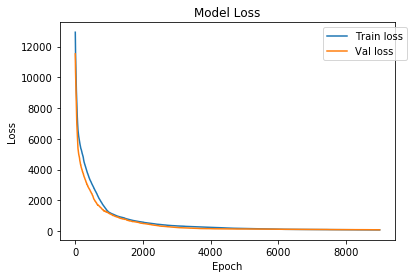

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

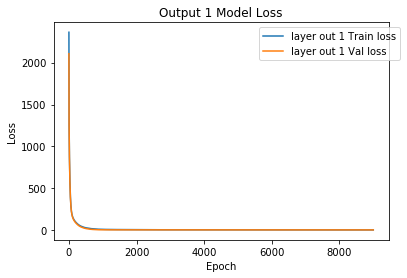

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

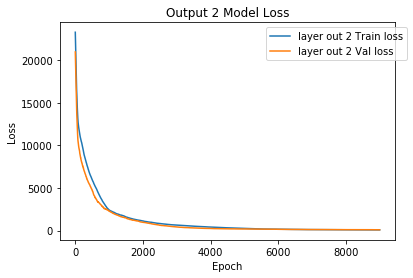

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [30]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [25]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([621.69024026, 623.71331437, 623.44431134, 618.09571555,
       619.06648215, 620.55174846, 623.11903177, 619.56884322,
       617.73974503, 618.63378624, 624.25949241, 628.25874477,
       625.18121486, 625.17989904, 625.60000133, 626.9968975 ,
       628.10190629, 623.35563972, 628.90730013, 627.77851223,
       625.07374879, 626.32135413, 628.50077338, 628.40120669,
       623.54434033, 629.46893564, 625.65211811, 629.00153476,
       631.49630983, 629.83027419, 634.12526938, 640.14146217,
       637.11595205, 624.11573271])

In [26]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [27]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw2 = preds[2]
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)
    tens_draw2 = tf.keras.backend.get_value(tens_draw2)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(12.785446164951129, 42.23400547527295)

In [28]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [29]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

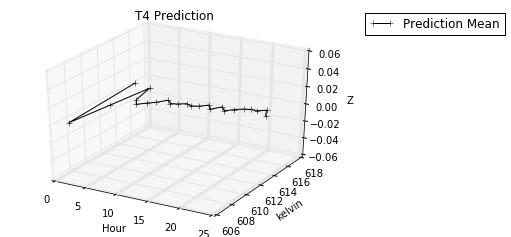

In [30]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("T4 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

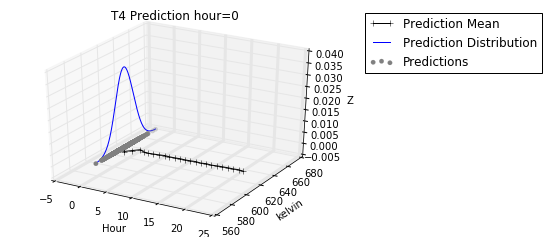

In [31]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("T4 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

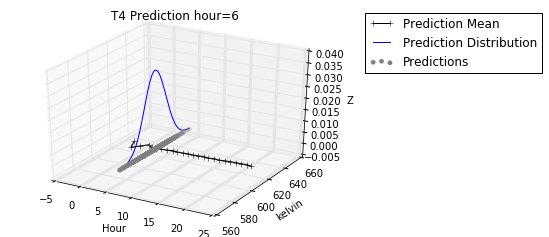

In [32]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

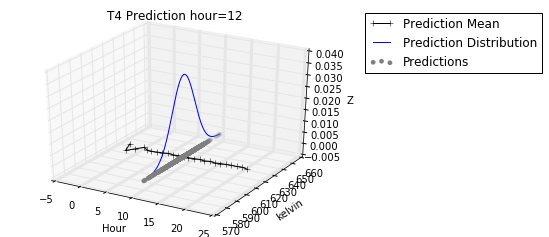

In [33]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

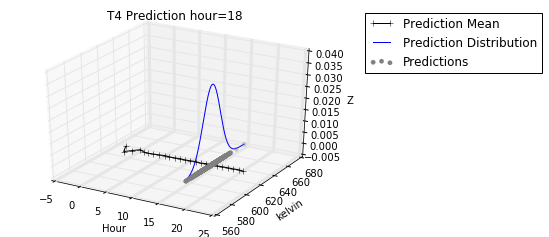

In [34]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

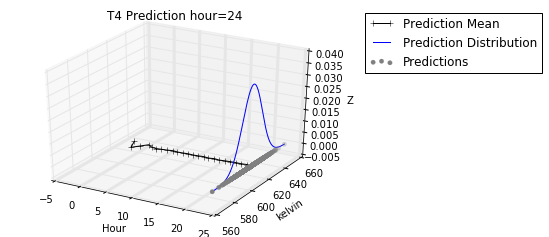

In [35]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [36]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [37]:
#Load hour of prediction

hour_NUM = ['5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm']

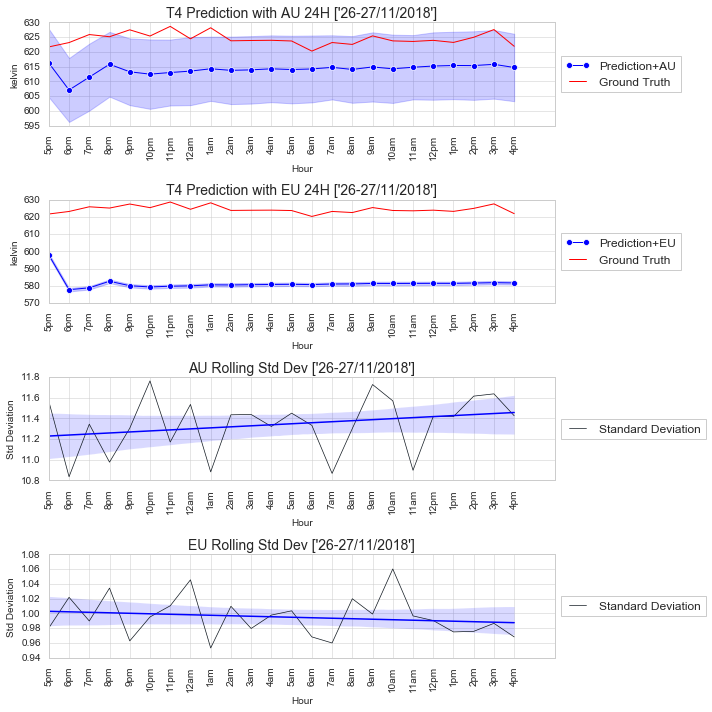

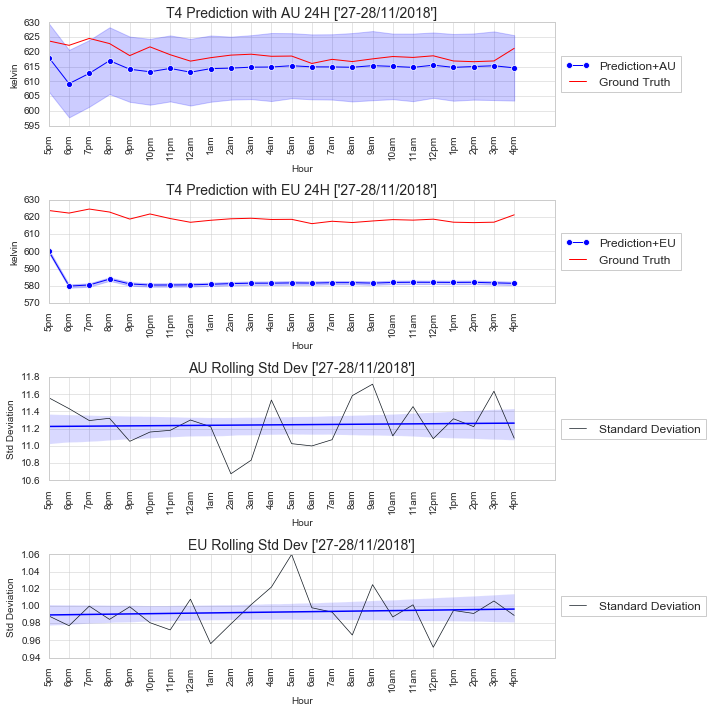

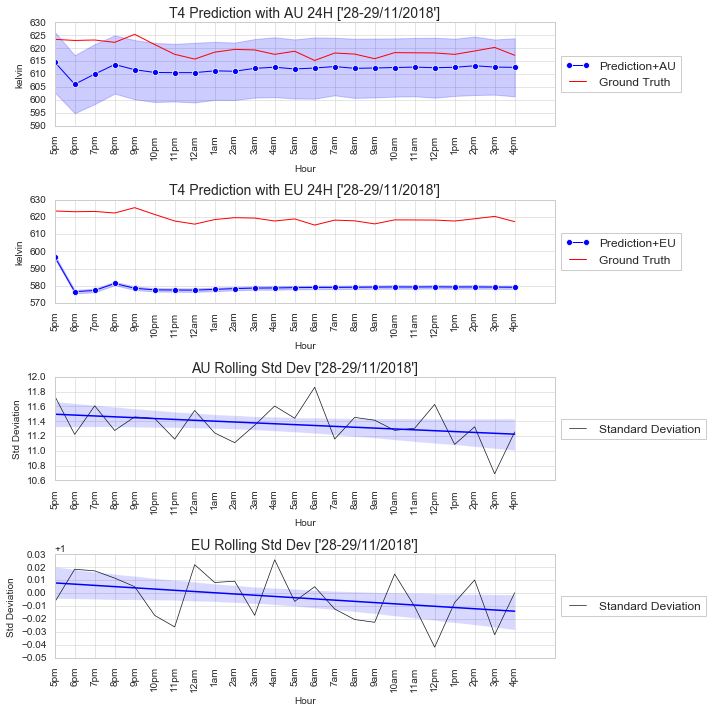

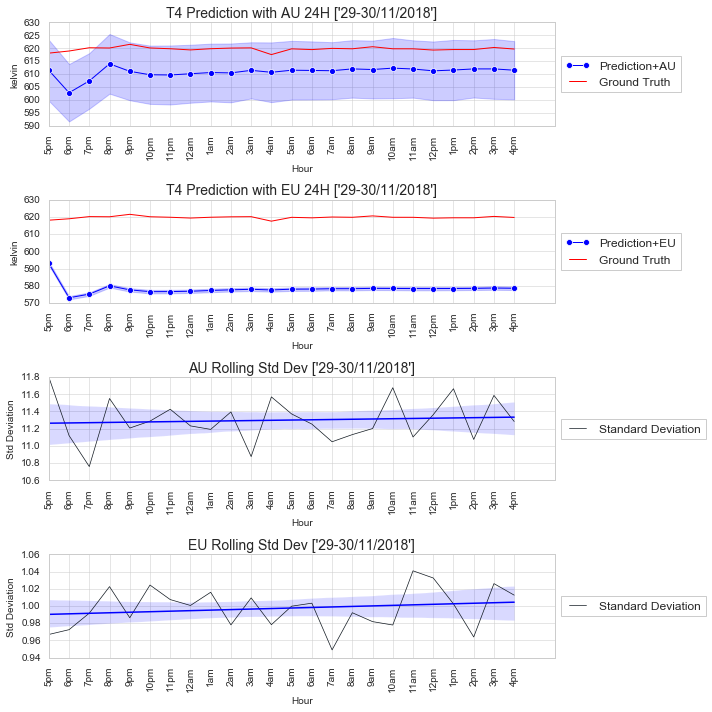

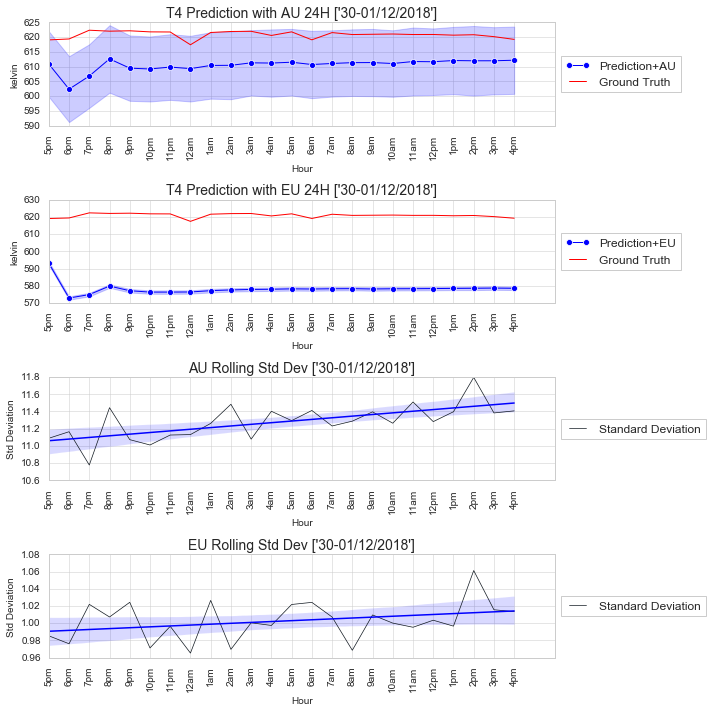

...

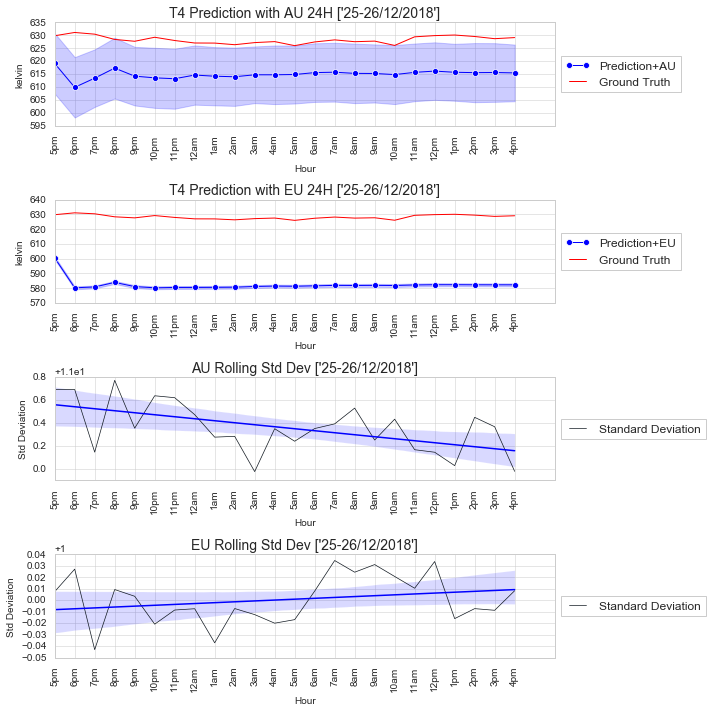

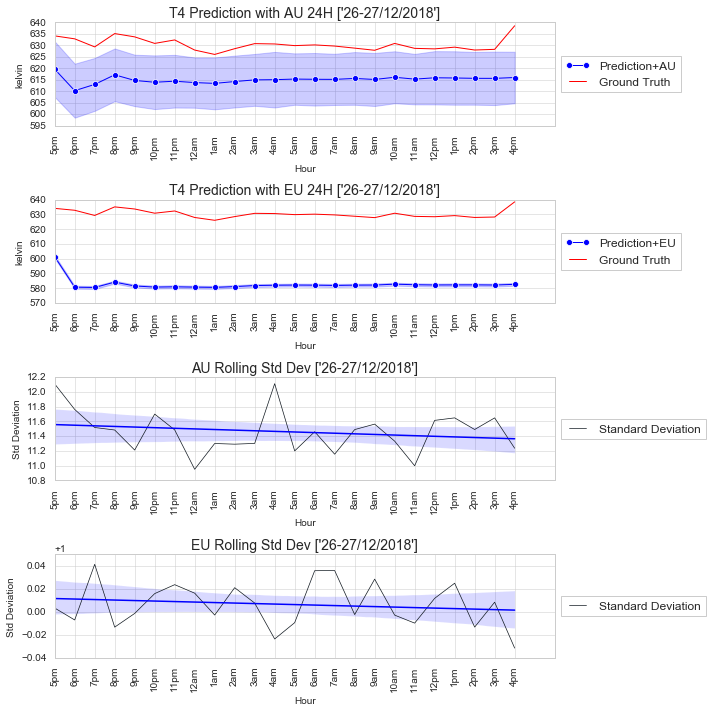

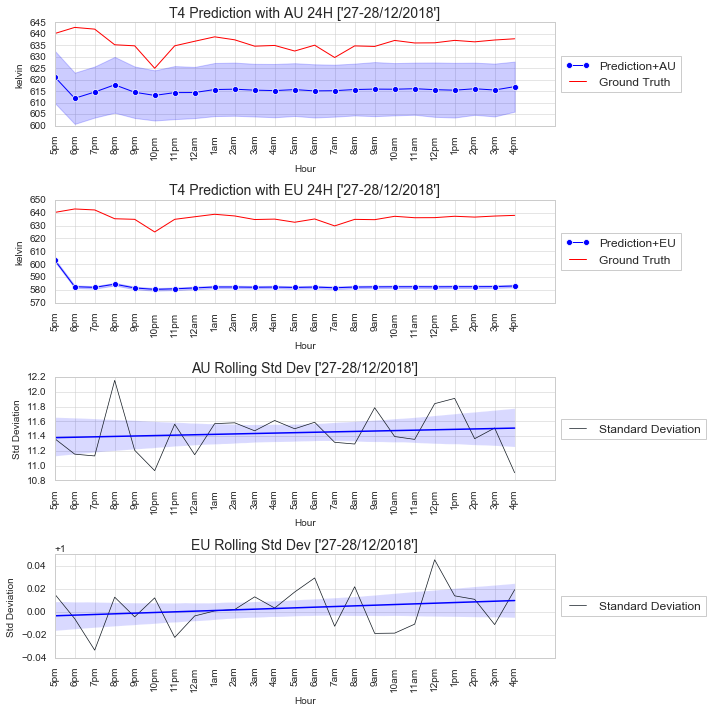

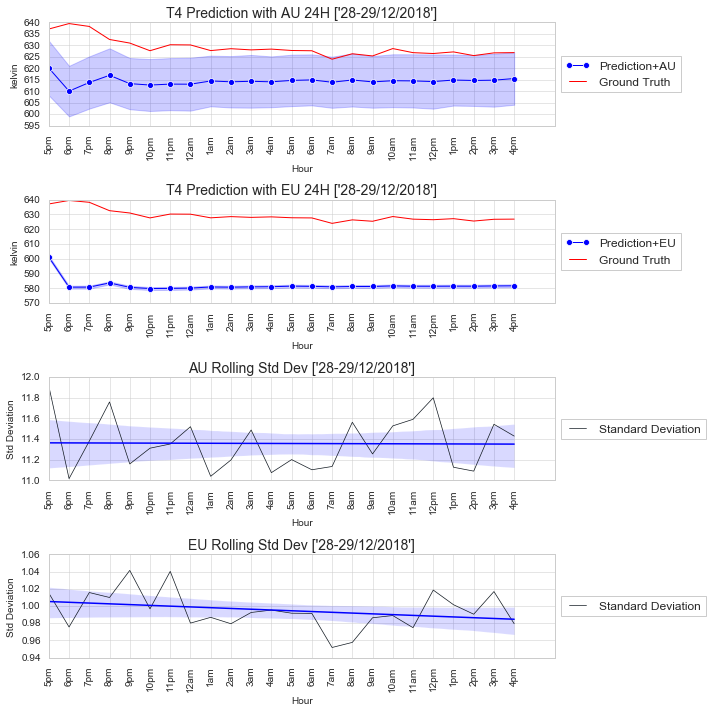

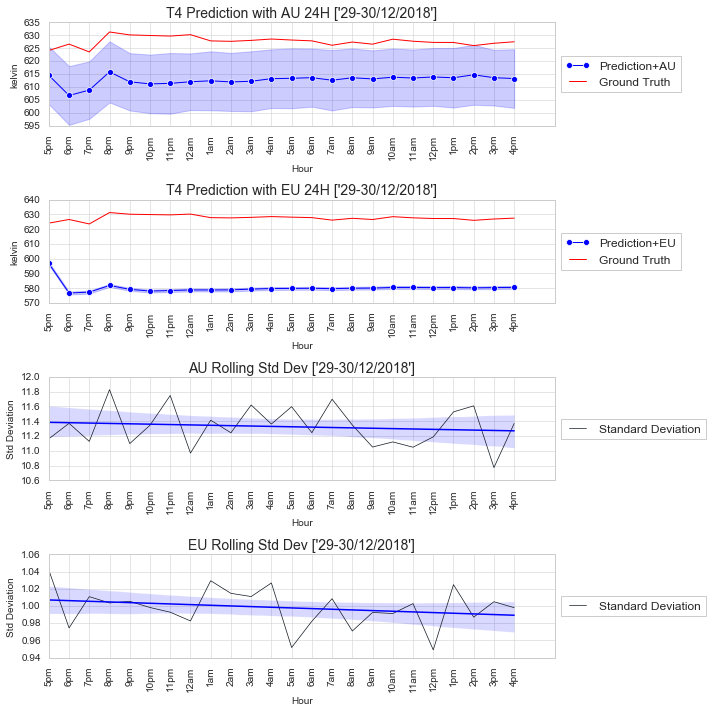

In [40]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set_style("whitegrid")
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','kelvin']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','kelvin']
    
    max_Seq_Arrange1.columns = ['Hour','kelvin']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','kelvin']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','kelvin']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['kelvin'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="kelvin",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="kelvin", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('T4 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="kelvin",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="kelvin", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('T4 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'kelvin', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['kelvin'],scatter = False)
    plt.title('AU Rolling Std Dev ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'kelvin', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['kelvin'],scatter = False)
    plt.title('EU Rolling Std Dev ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.savefig("T4_Pred %i" %B+'.tiff')
    plt.show()

In [25]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 250)           255000    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 44)            11044     
_________________________________________________________________
dense_4 (Dense)              (None, 24, 1)             45        
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 266,089
Trainable params: 266,089
Non-trainable params: 0
_________________________________________________________________


In [26]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [27]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [28]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [29]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [30]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

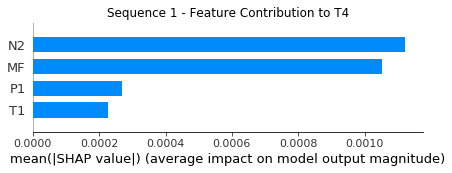

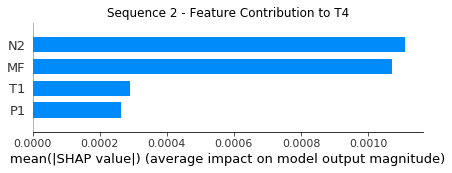

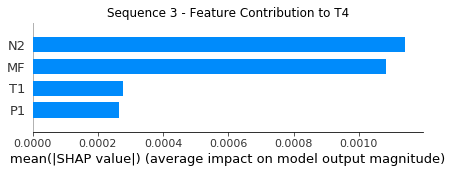

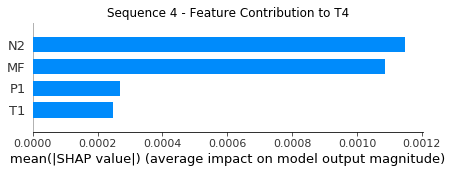

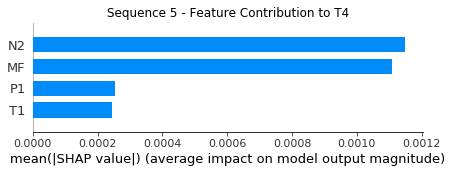

...

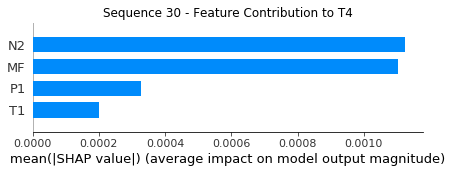

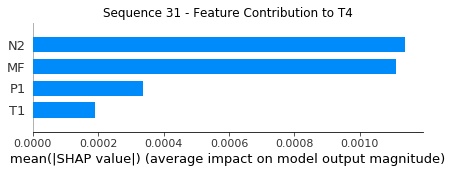

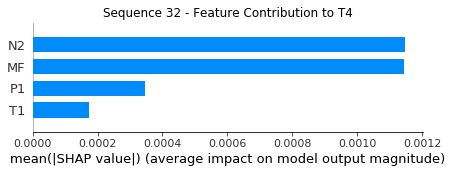

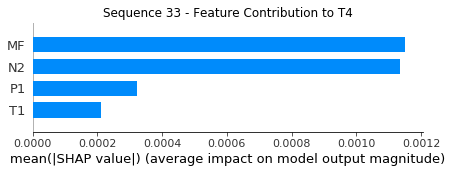

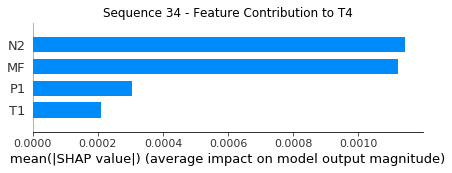

In [31]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution to T4" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

In [48]:
#SHAP Force Plot - Matplotlib
import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [-0.00148626 -0.00173069 -0.00635258 -0.00555439]


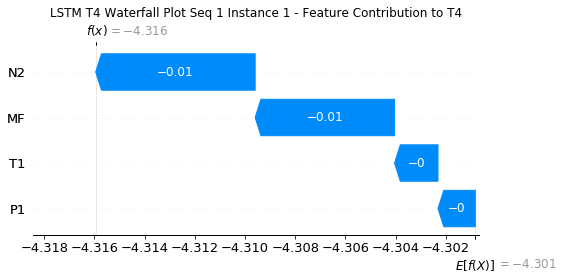

None

Contribution: [1.30228865e-04 6.22421947e-07 8.13780353e-04 7.21266041e-04]


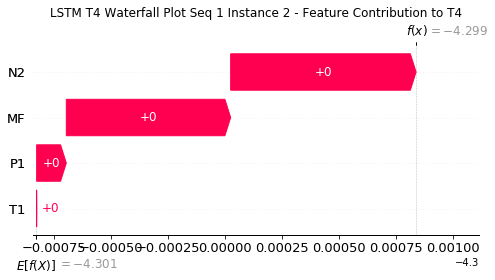

None

Contribution: [-2.44934540e-06 -5.23029394e-06 -1.64972975e-05 -1.35883235e-05]


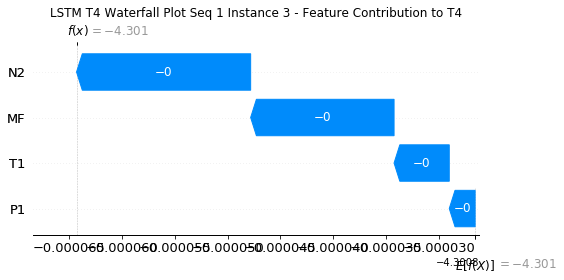

None

Contribution: [-1.27674362e-05 -1.33154321e-05 -5.02903973e-05 -3.97003416e-05]


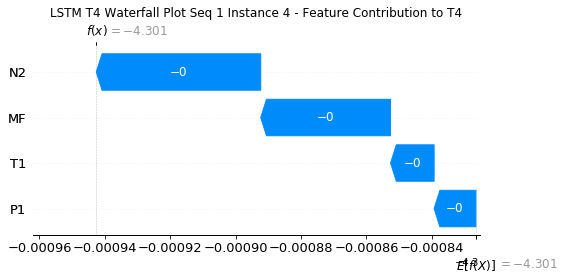

None

Contribution: [-2.39692580e-05 -2.30369888e-05 -8.89254265e-05 -7.20937932e-05]


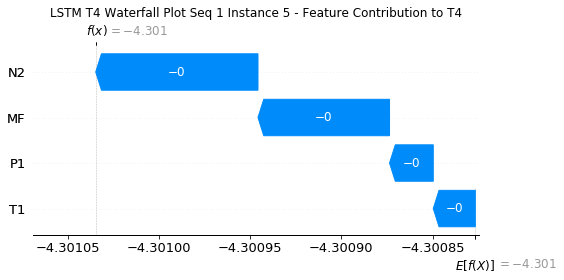

None

Contribution: [-2.65302565e-05 -2.61697171e-05 -9.80366010e-05 -8.14123988e-05]


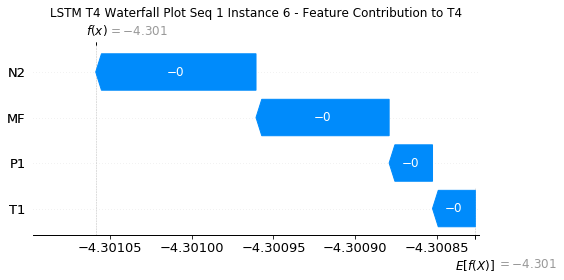

None

Contribution: [-2.70668379e-05 -2.61123837e-05 -9.80289696e-05 -8.35028236e-05]


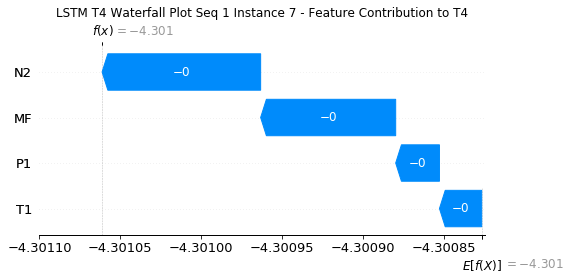

None

Contribution: [-2.61392855e-05 -2.74275335e-05 -9.74203908e-05 -8.14774452e-05]


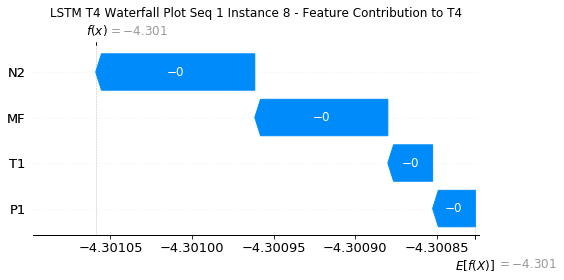

None

Contribution: [-2.78429519e-05 -2.75768017e-05 -1.01336940e-04 -8.75282688e-05]


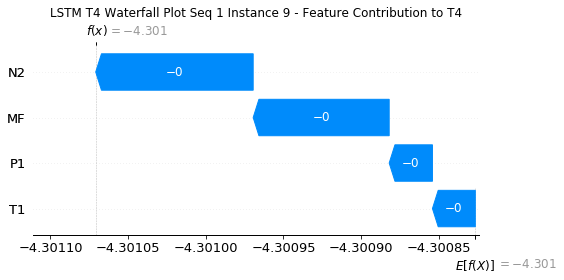

None

Contribution: [-2.92344435e-05 -2.70914285e-05 -1.06259828e-04 -9.09083585e-05]


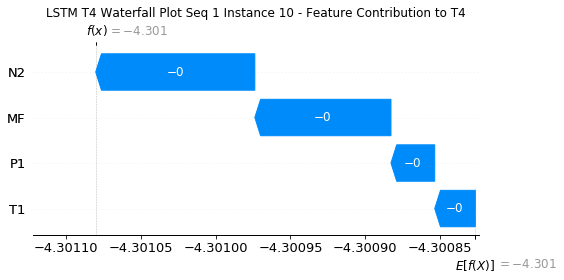

None

Contribution: [-3.12292579e-05 -2.81633701e-05 -1.11729400e-04 -9.59300630e-05]


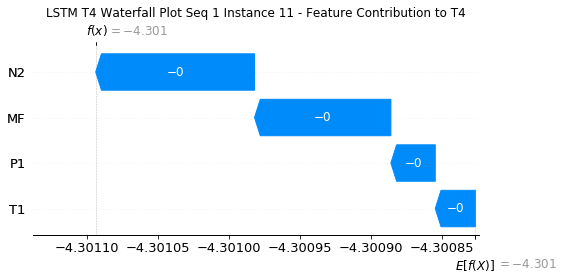

None

Contribution: [-3.42075785e-05 -2.89668516e-05 -1.18842407e-04 -1.02349681e-04]


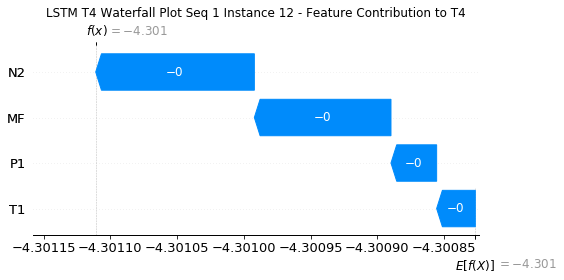

None

Contribution: [-3.63389308e-05 -3.25055569e-05 -1.28379029e-04 -1.11651950e-04]


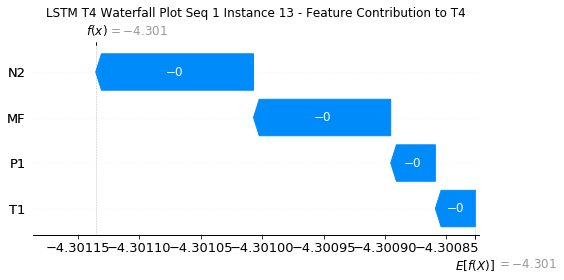

None

Contribution: [-3.93342938e-05 -3.58128084e-05 -1.44191138e-04 -1.24849197e-04]


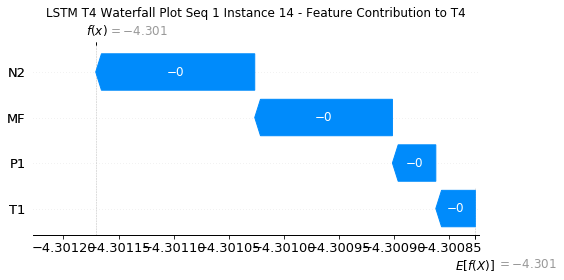

None

Contribution: [-4.74012968e-05 -4.17815789e-05 -1.65194824e-04 -1.46210307e-04]


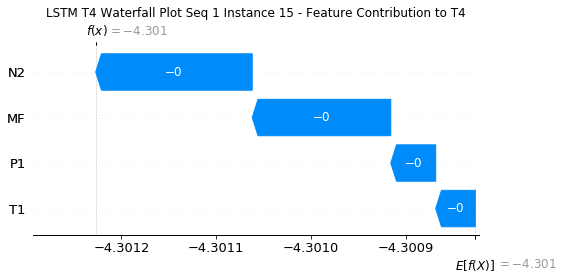

None

Contribution: [-4.85116312e-05 -4.24109283e-05 -1.68133522e-04 -1.49642104e-04]


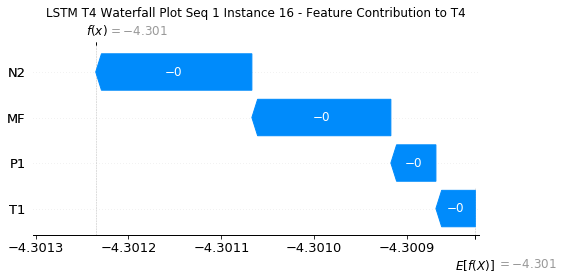

None

Contribution: [-3.08252816e-05 -2.57952857e-05 -1.09654503e-04 -9.70759572e-05]


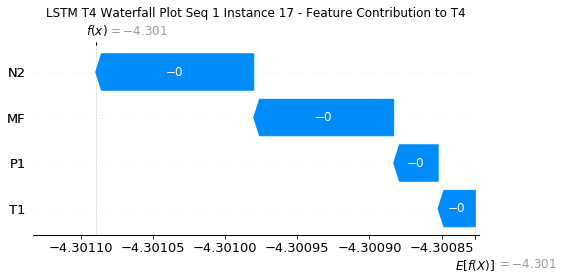

None

Contribution: [1.43085469e-05 1.90969013e-05 5.09128691e-05 5.32583762e-05]


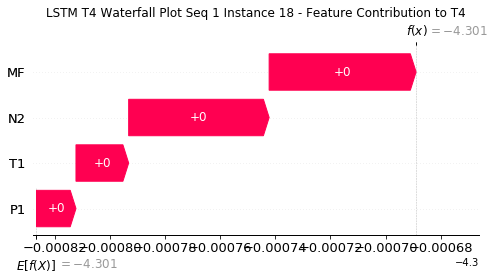

None

Contribution: [6.98143729e-05 7.08280942e-05 2.40749288e-04 2.32989792e-04]


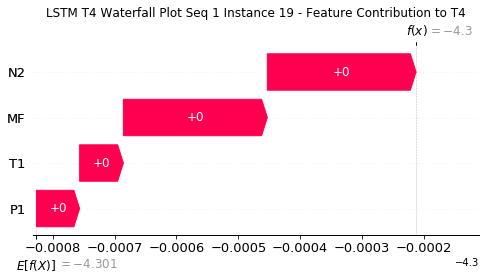

None

Contribution: [3.46478577e-05 3.22942160e-05 1.09487639e-04 1.19822917e-04]


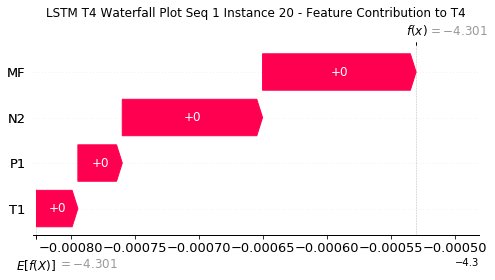

None

Contribution: [-0.00027731 -0.00026648 -0.00102286 -0.0009251 ]


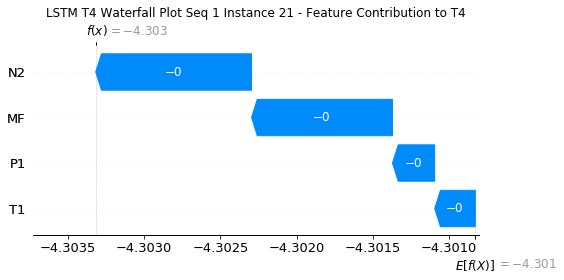

None

Contribution: [-0.001001   -0.000824   -0.00370171 -0.00345501]


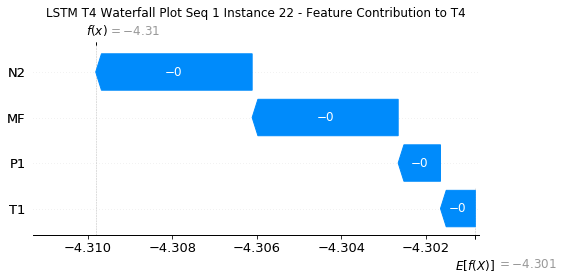

None

Contribution: [-0.00194016 -0.00171289 -0.00766227 -0.00733434]


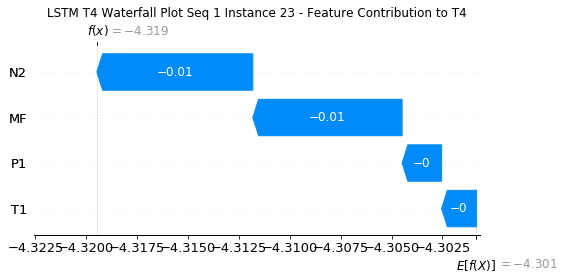

None

Contribution: [-0.00104208 -0.00038302 -0.00532989 -0.0054479 ]


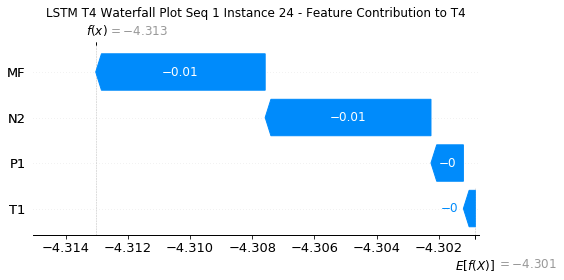

None

Contribution: [-0.00164544 -0.00191951 -0.00634192 -0.00571758]


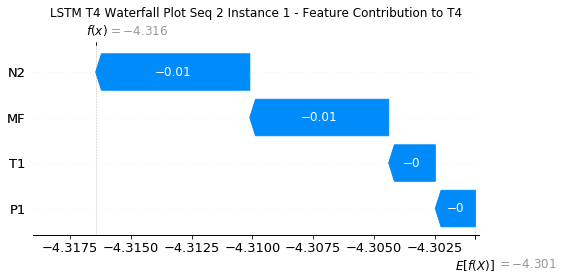

None

Contribution: [0.00017136 0.00012672 0.00079852 0.00080197]


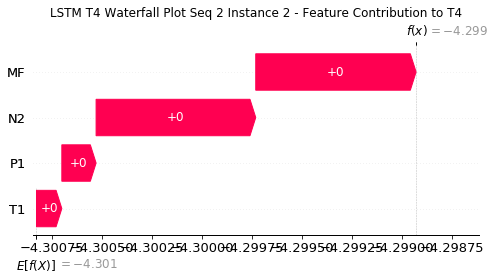

None

Contribution: [-3.74941437e-06 -9.36422110e-06 -1.57231395e-05 -1.58665484e-05]


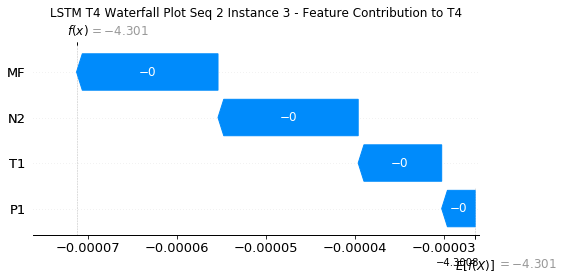

None

Contribution: [-1.39892264e-05 -1.69739752e-05 -5.06231300e-05 -4.17391909e-05]


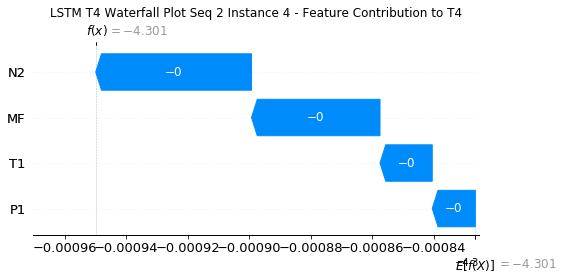

None

Contribution: [-2.50520539e-05 -2.71459089e-05 -8.84581778e-05 -7.42247055e-05]


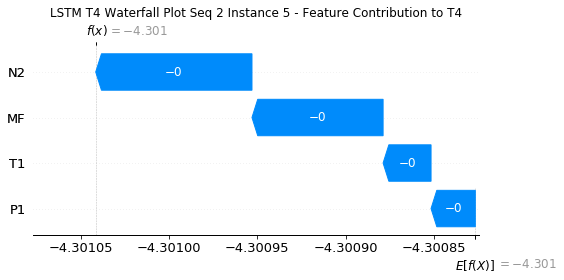

None

Contribution: [-2.78762374e-05 -3.02405230e-05 -9.83681078e-05 -8.37580735e-05]


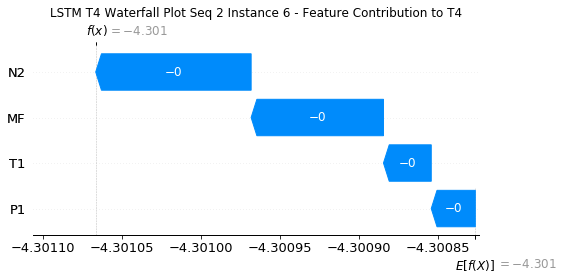

None

Contribution: [-2.74088216e-05 -2.80680996e-05 -9.69178946e-05 -8.41295326e-05]


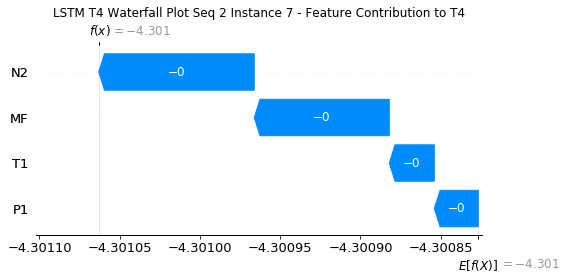

None

Contribution: [-2.69529564e-05 -2.78327386e-05 -9.59827903e-05 -8.20802021e-05]


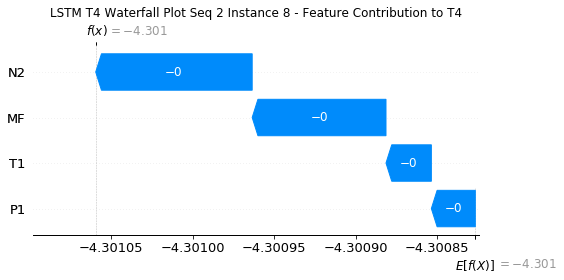

None

Contribution: [-2.89022311e-05 -2.78301272e-05 -9.95025594e-05 -8.64052697e-05]


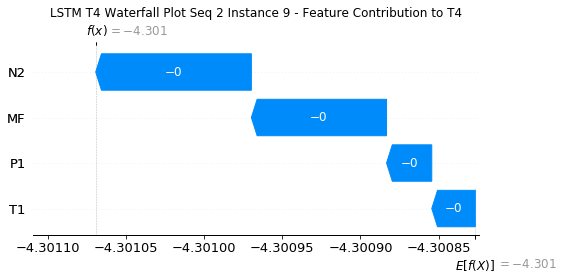

None

Contribution: [-3.00091303e-05 -3.13133758e-05 -1.05509737e-04 -9.19018083e-05]


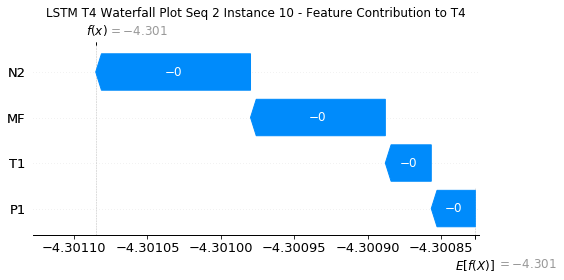

None

Contribution: [-3.18065653e-05 -3.26858689e-05 -1.11002763e-04 -9.71412497e-05]


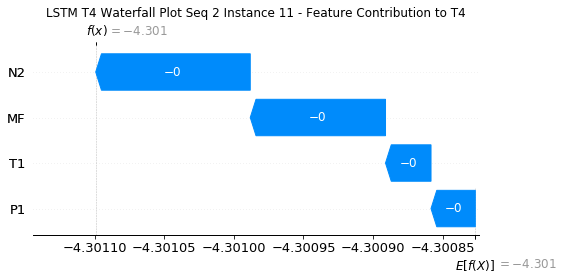

None

Contribution: [-3.42417832e-05 -3.19938868e-05 -1.17818182e-04 -1.03941104e-04]


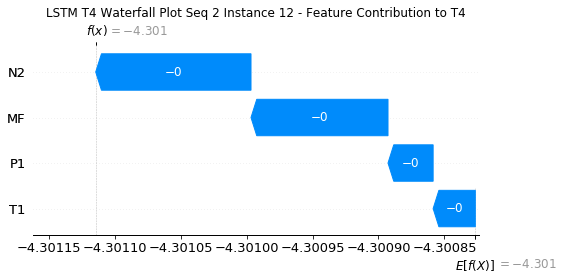

None

Contribution: [-3.68590927e-05 -3.63002779e-05 -1.27438587e-04 -1.12574035e-04]


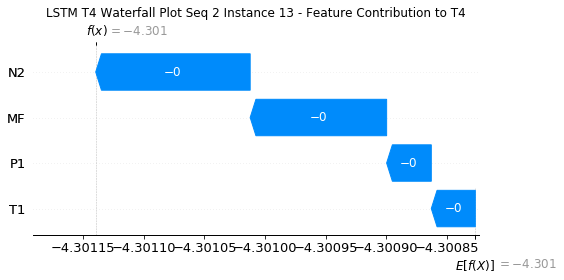

None

Contribution: [-4.00589331e-05 -4.02763038e-05 -1.43686055e-04 -1.28164986e-04]


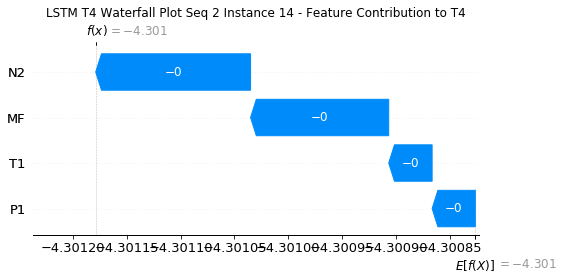

None

Contribution: [-4.75549387e-05 -4.63093237e-05 -1.63899014e-04 -1.46626466e-04]


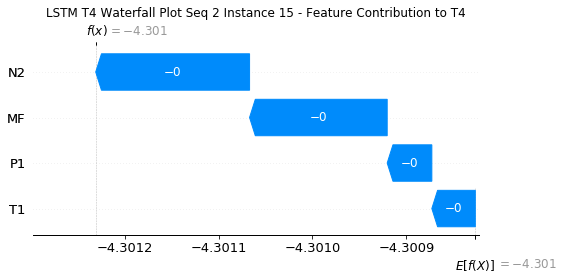

None

Contribution: [-4.86363292e-05 -4.72559877e-05 -1.66559063e-04 -1.49479009e-04]


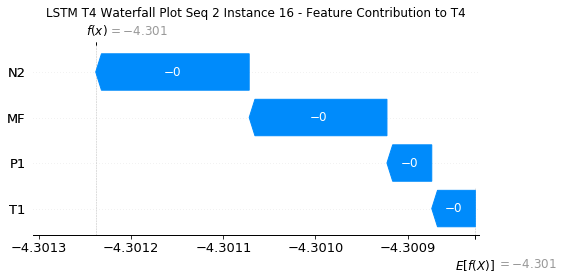

None

Contribution: [-3.03844271e-05 -2.73338784e-05 -1.07624153e-04 -9.27668670e-05]


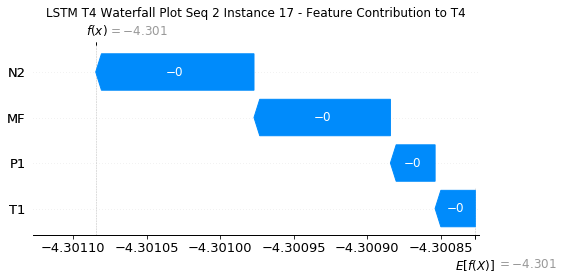

None

Contribution: [1.41616465e-05 1.81799336e-05 5.06083246e-05 5.26410259e-05]


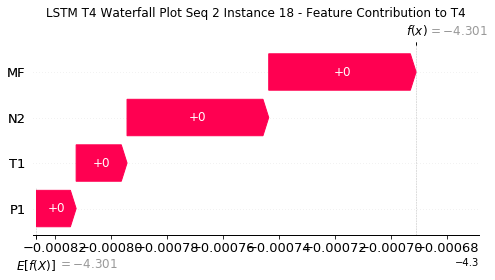

None

Contribution: [6.94850130e-05 7.15695708e-05 2.39180804e-04 2.32088482e-04]


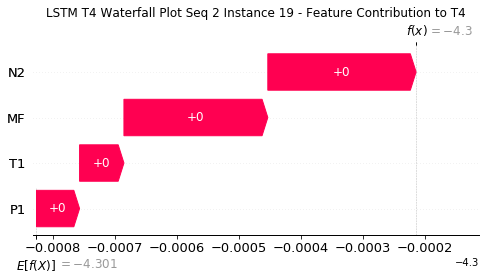

None

Contribution: [3.41984295e-05 3.03148882e-05 1.09110487e-04 1.18107324e-04]


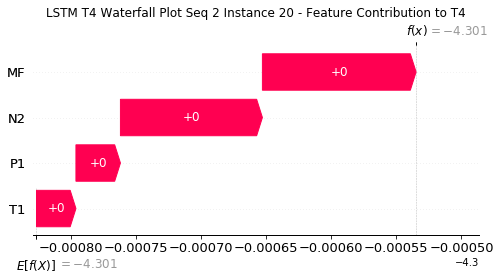

None

Contribution: [-0.00027977 -0.00028851 -0.0010156  -0.00092665]


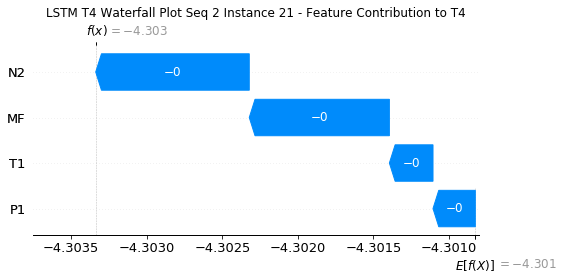

None

Contribution: [-0.00101351 -0.00095575 -0.00366259 -0.00340957]


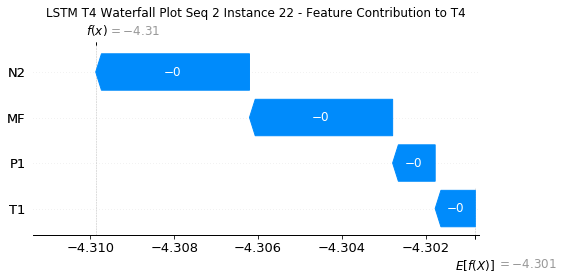

None

Contribution: [-0.00182969 -0.00160725 -0.007508   -0.00695964]


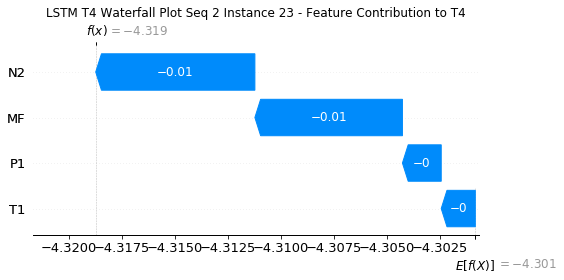

None

Contribution: [-0.00082743  0.00147325 -0.00531197 -0.00607497]


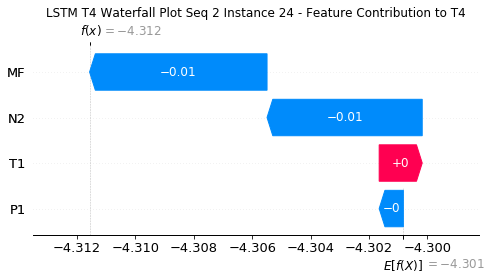

None

Contribution: [-0.00159218 -0.0010863  -0.00659056 -0.00617856]


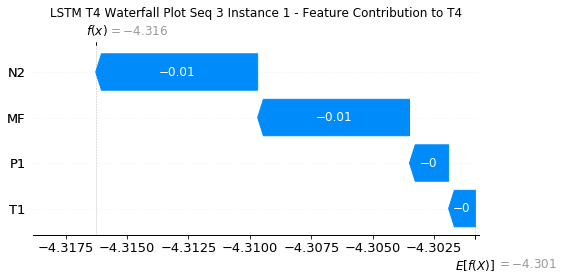

None

Contribution: [ 0.00014828 -0.00019135  0.00082653  0.00084565]


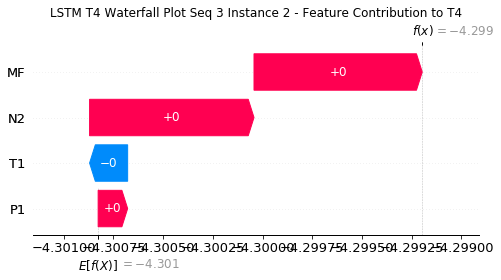

None

Contribution: [-3.97697771e-06  8.12899467e-06 -1.96193690e-05 -1.89532843e-05]


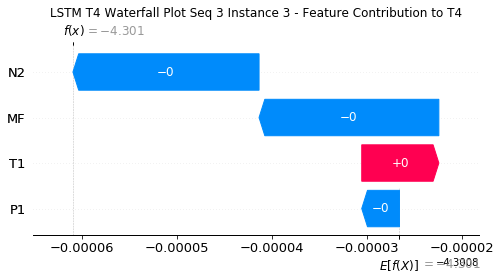

None

Contribution: [-1.36575293e-05 -3.16378613e-06 -5.21385867e-05 -4.26477467e-05]


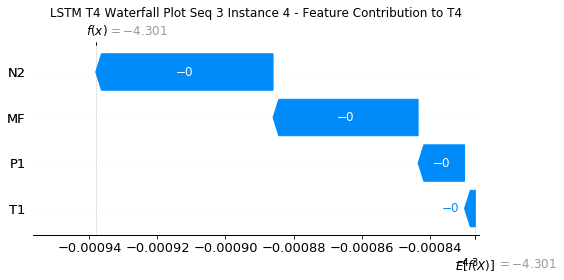

None

Contribution: [-2.48326857e-05 -1.14497942e-05 -9.19560975e-05 -7.61843351e-05]


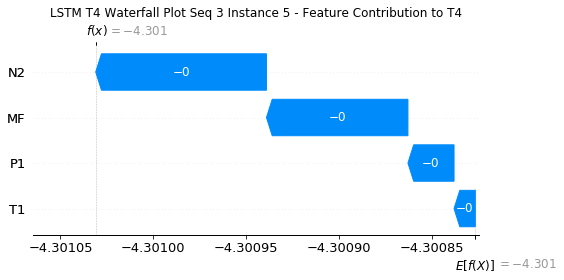

None

Contribution: [-2.75591611e-05 -1.35834322e-05 -1.00772848e-04 -8.51290976e-05]


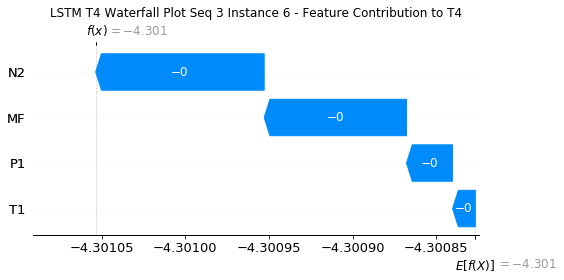

None

Contribution: [-2.61983554e-05 -1.21803207e-05 -9.88584545e-05 -8.48031633e-05]


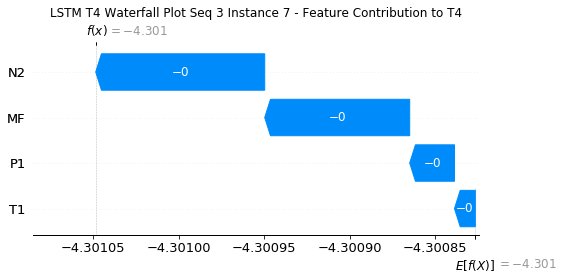

None

Contribution: [-2.74918754e-05 -8.62688428e-06 -9.78041174e-05 -8.27167722e-05]


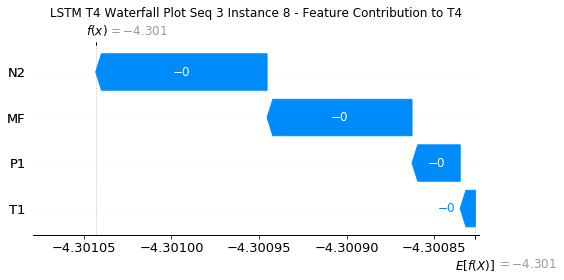

None

Contribution: [-2.75799351e-05 -1.11126496e-05 -1.01471285e-04 -8.70301583e-05]


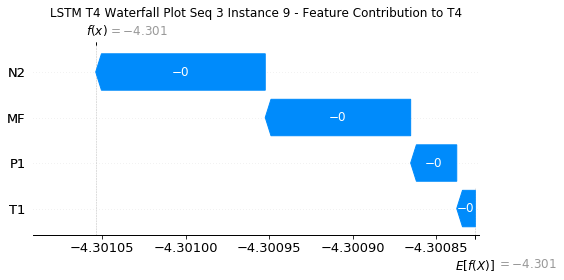

None

Contribution: [-2.96858661e-05 -1.33528587e-05 -1.07874060e-04 -9.31053380e-05]


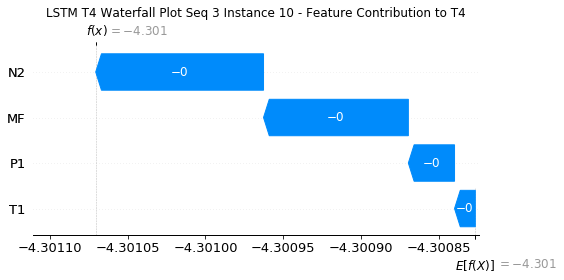

None

Contribution: [-3.14829417e-05 -1.45332969e-05 -1.13309676e-04 -9.82674206e-05]


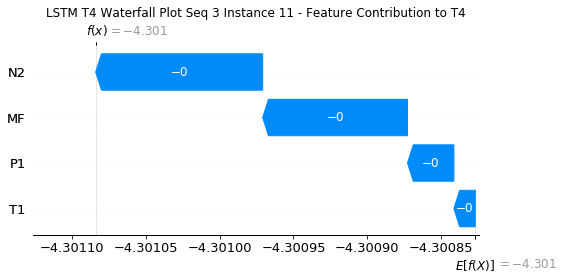

None

Contribution: [-3.38050724e-05 -1.47095393e-05 -1.19937894e-04 -1.03658093e-04]


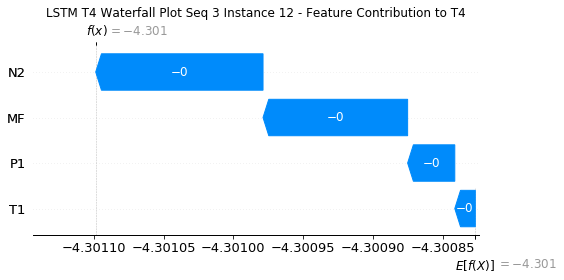

None

Contribution: [-3.65980587e-05 -1.78932381e-05 -1.30721237e-04 -1.14303354e-04]


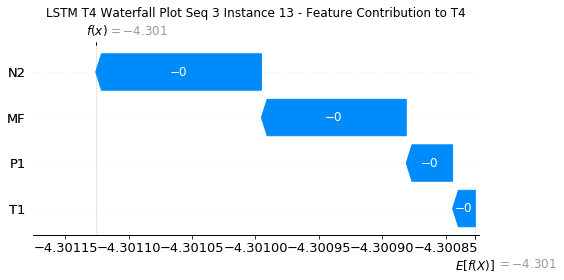

None

Contribution: [-4.16870389e-05 -2.16026432e-05 -1.48011162e-04 -1.30180870e-04]


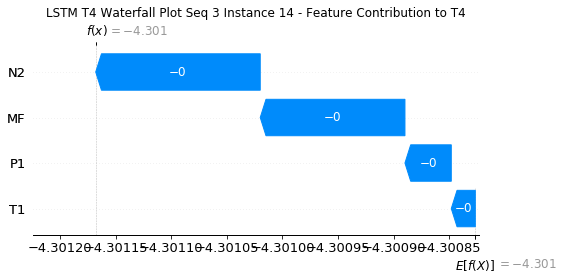

None

Contribution: [-4.77495361e-05 -2.52623396e-05 -1.69358980e-04 -1.50465262e-04]


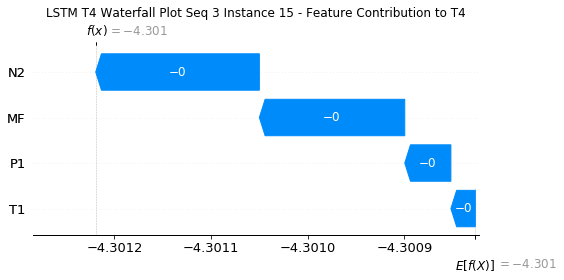

None

Contribution: [-4.84256361e-05 -2.47808680e-05 -1.70385080e-04 -1.52032063e-04]


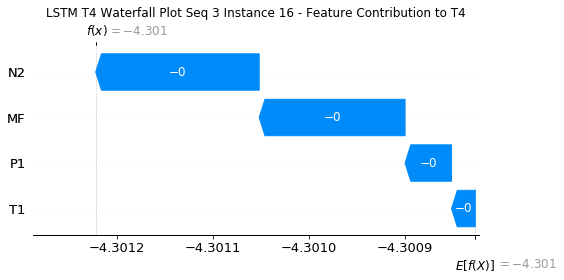

None

Contribution: [-2.98532995e-05 -1.04422850e-05 -1.04540325e-04 -9.13802258e-05]


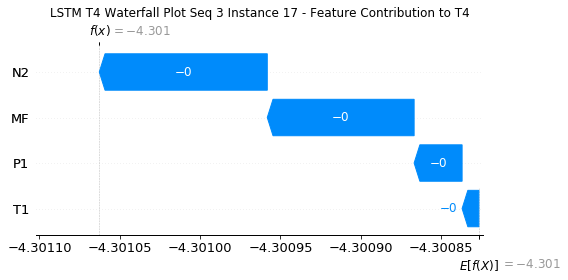

None

Contribution: [1.89875062e-05 2.68537886e-05 6.61016879e-05 6.74408031e-05]


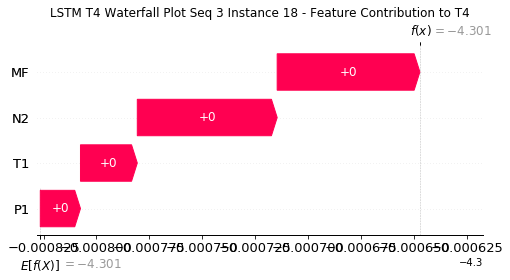

None

Contribution: [7.54329310e-05 7.06324129e-05 2.60780866e-04 2.52117538e-04]


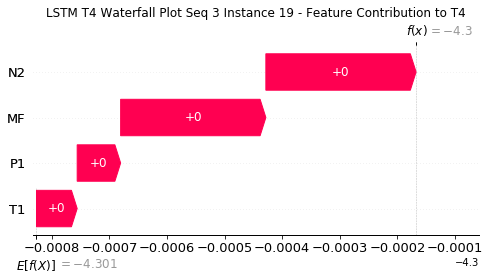

None

Contribution: [3.63769731e-05 4.89590685e-05 1.09226614e-04 1.20199263e-04]


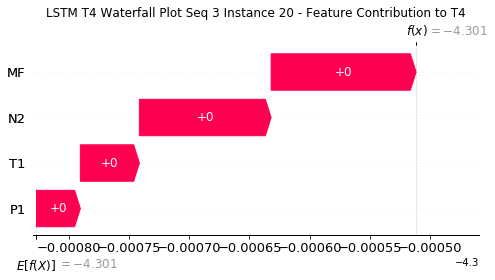

None

Contribution: [-0.00028299 -0.00012059 -0.00108104 -0.00097579]


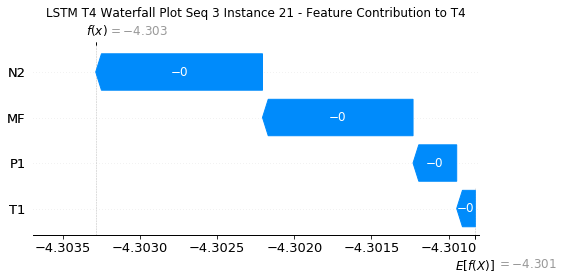

None

Contribution: [-0.00100446 -0.00021537 -0.0038221  -0.0035437 ]


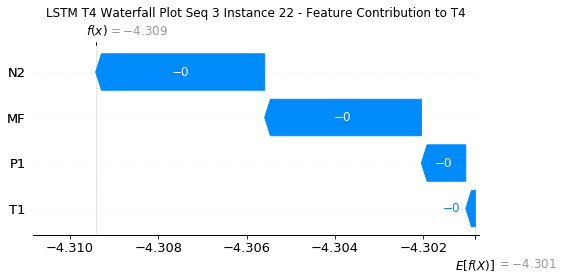

None

Contribution: [-0.00193089  0.00072748 -0.00775252 -0.00728381]


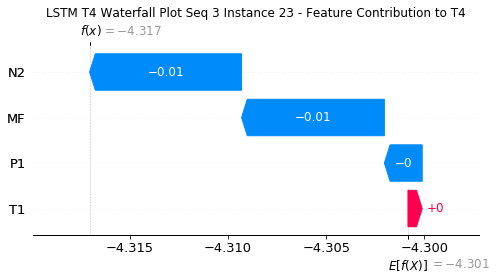

None

Contribution: [-0.00079281  0.00395914 -0.00523618 -0.00535366]


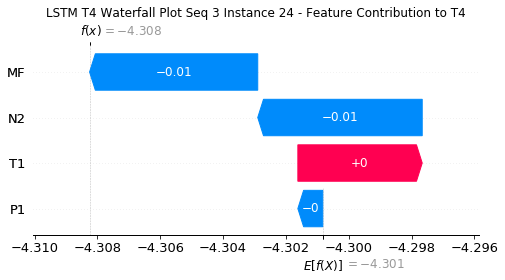

None

Contribution: [-0.00156008 -0.00057858 -0.00658819 -0.00589317]


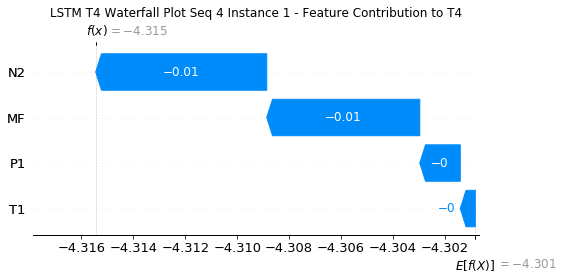

None

Contribution: [ 0.0001323  -0.00034808  0.00081898  0.00078698]


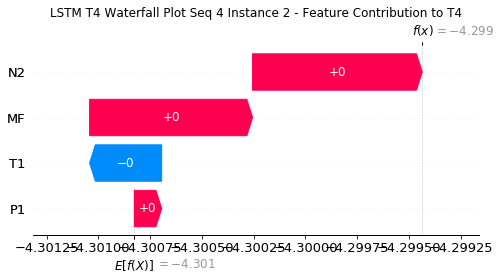

None

Contribution: [-3.83732494e-06  8.79122118e-06 -1.85839881e-05 -1.61606713e-05]


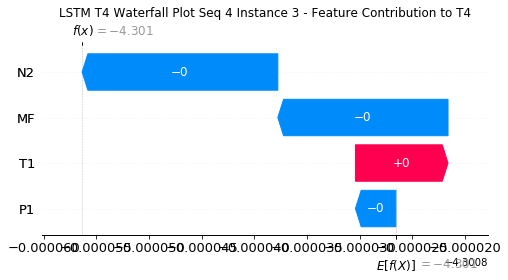

None

Contribution: [-1.32402988e-05 -2.64630787e-06 -5.06278363e-05 -4.02018692e-05]


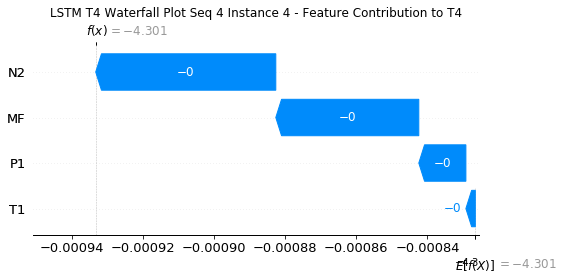

None

Contribution: [-2.48624094e-05 -1.42702865e-05 -9.03689274e-05 -7.38787773e-05]


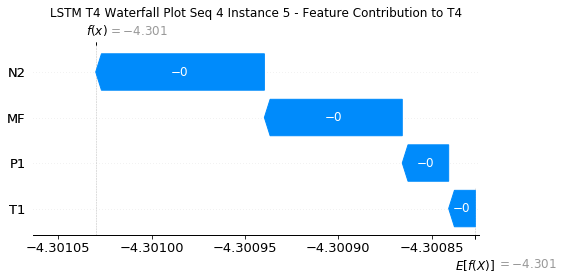

None

Contribution: [-2.73425547e-05 -1.33447741e-05 -9.94699359e-05 -8.27341708e-05]


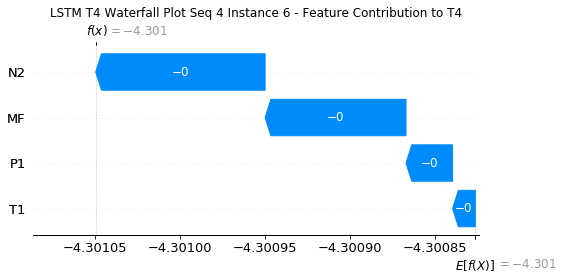

None

Contribution: [-2.75616382e-05 -1.15565930e-05 -9.84740025e-05 -8.28847448e-05]


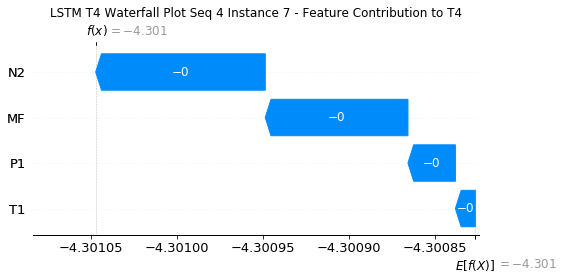

None

Contribution: [-2.71080924e-05 -1.05362702e-05 -9.79670207e-05 -8.22975740e-05]


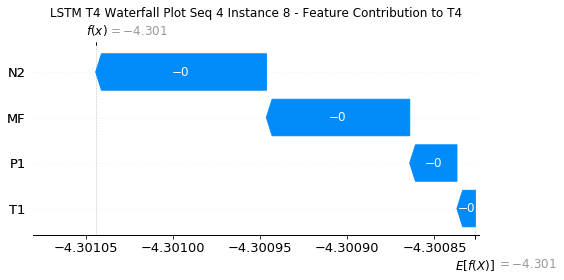

None

Contribution: [-2.76288434e-05 -1.26263155e-05 -1.01652775e-04 -8.66672110e-05]


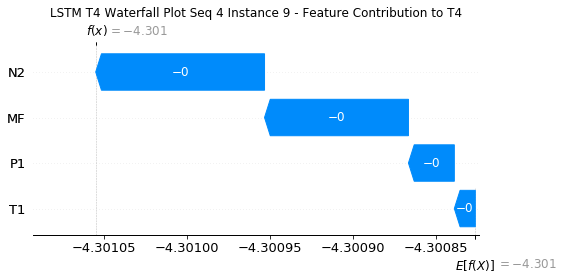

None

Contribution: [-2.98978777e-05 -1.33314835e-05 -1.07739352e-04 -9.29693053e-05]


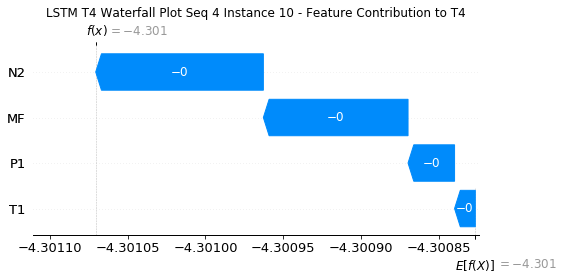

None

Contribution: [-3.19031844e-05 -1.37918387e-05 -1.12978212e-04 -9.77065666e-05]


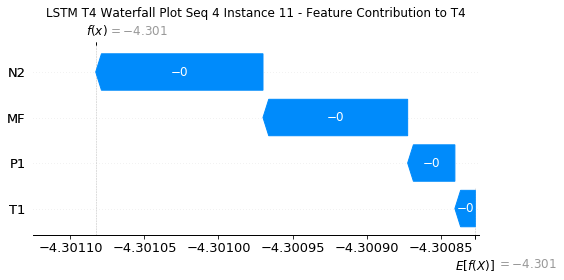

None

Contribution: [-3.17400909e-05 -1.24743644e-05 -1.19307800e-04 -1.02381087e-04]


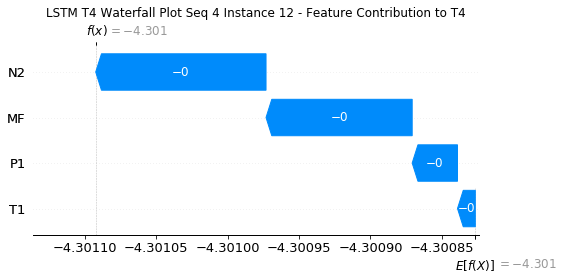

None

Contribution: [-3.69474522e-05 -1.67701411e-05 -1.30527008e-04 -1.14091737e-04]


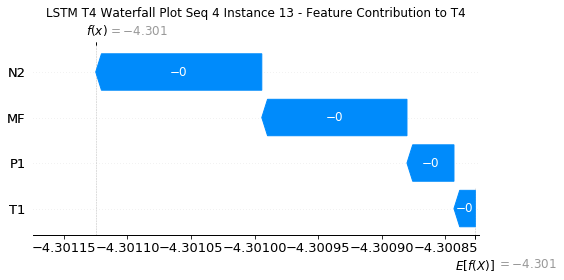

None

Contribution: [-4.24601316e-05 -1.82395711e-05 -1.48612698e-04 -1.30564695e-04]


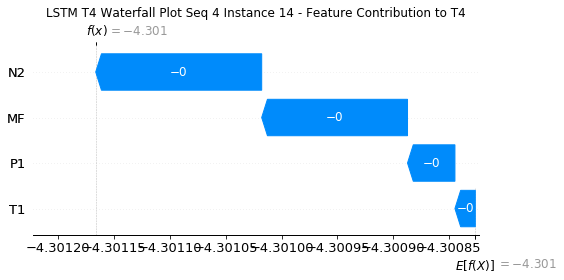

None

Contribution: [-4.87145796e-05 -2.35154248e-05 -1.70084778e-04 -1.51079729e-04]


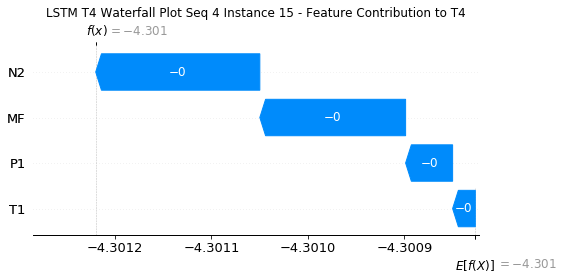

None

Contribution: [-4.91284706e-05 -2.33723094e-05 -1.71204893e-04 -1.52627153e-04]


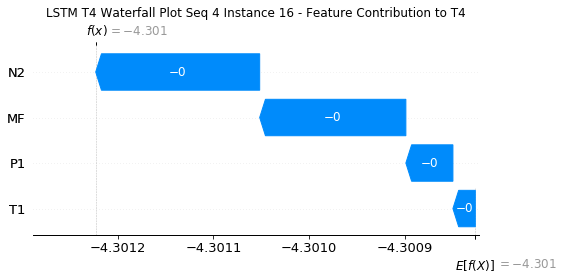

None

Contribution: [-3.05178990e-05 -8.87927919e-06 -1.04265358e-04 -9.09142814e-05]


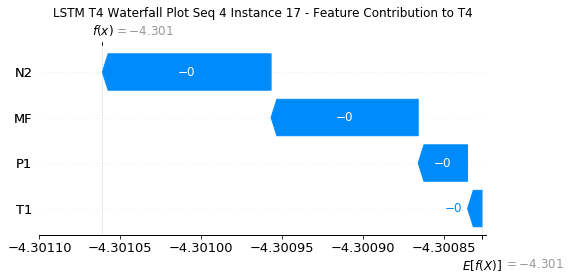

None

Contribution: [1.98537948e-05 2.82551274e-05 6.96470512e-05 7.08932515e-05]


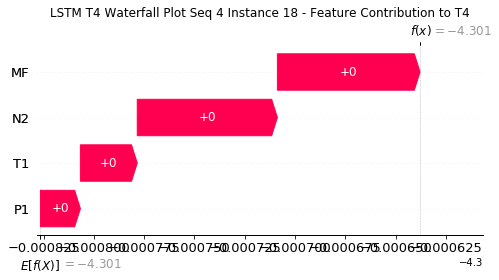

None

Contribution: [7.73561875e-05 7.14085439e-05 2.66773503e-04 2.57411211e-04]


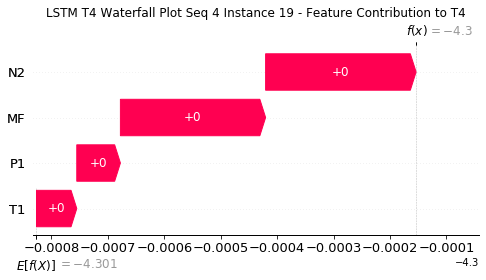

None

Contribution: [3.71973577e-05 5.26372760e-05 1.12927226e-04 1.24369233e-04]


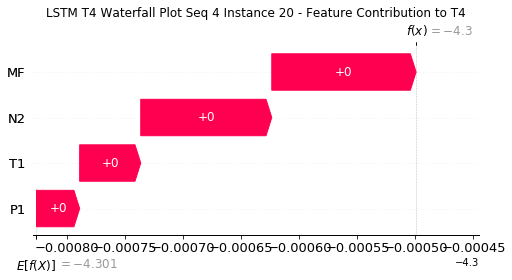

None

Contribution: [-0.00028477 -0.00010667 -0.00108955 -0.00098245]


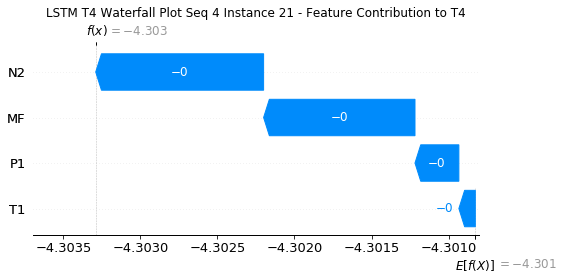

None

Contribution: [-0.00100357 -0.00016928 -0.00384365 -0.00354505]


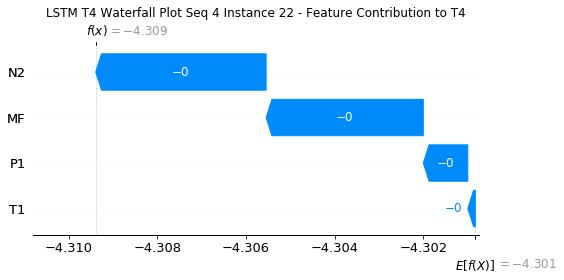

None

Contribution: [-0.00197598  0.00046189 -0.00777446 -0.00733739]


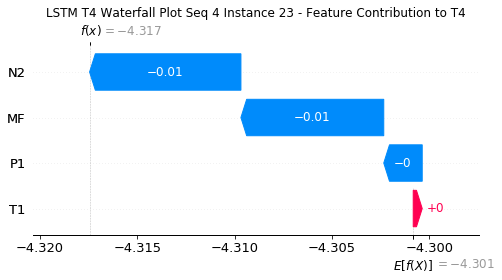

None

Contribution: [-0.0009042   0.00393979 -0.00534704 -0.00569141]


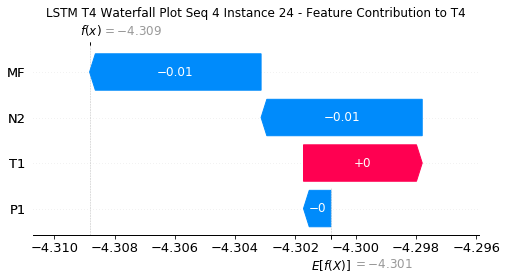

None

Contribution: [-0.00163125 -0.00042827 -0.00661258 -0.00601619]


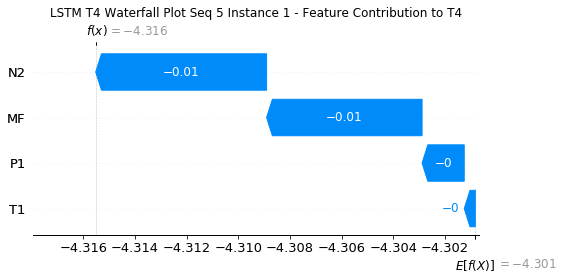

None

Contribution: [ 0.00015273 -0.00045132  0.00081639  0.00081298]


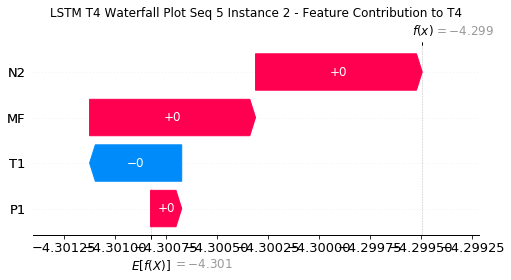

None

Contribution: [-3.91037650e-06  1.47695292e-05 -1.95283037e-05 -1.94008369e-05]


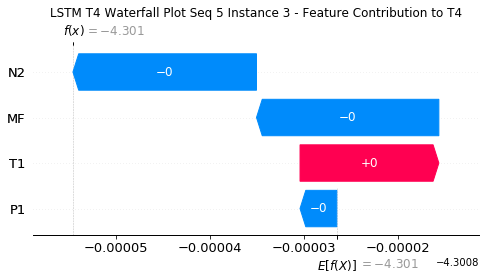

None

Contribution: [-1.33813122e-05  1.01533742e-06 -5.11496896e-05 -4.23015062e-05]


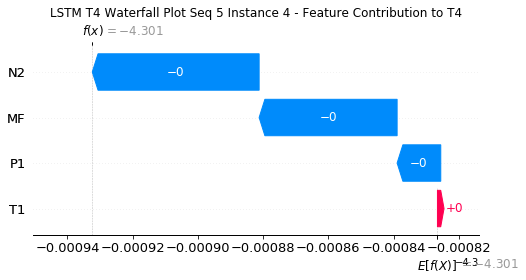

None

Contribution: [-2.52283884e-05 -6.15123536e-06 -9.03155441e-05 -7.55332628e-05]


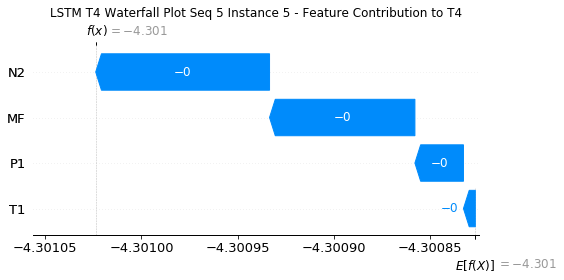

None

Contribution: [-2.73524908e-05 -8.99885407e-06 -9.97889107e-05 -8.47355037e-05]


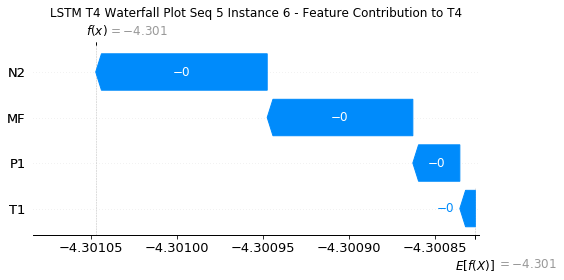

None

Contribution: [-2.70859863e-05 -7.86569281e-06 -9.85092155e-05 -8.36983912e-05]


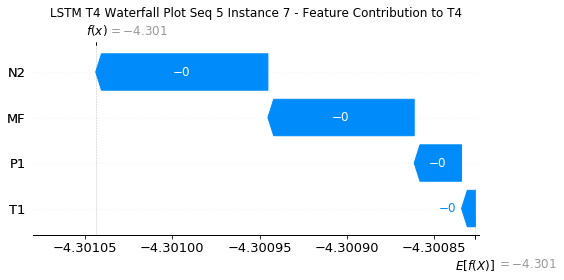

None

Contribution: [-2.58353751e-05 -7.68827780e-06 -9.74052957e-05 -8.16878597e-05]


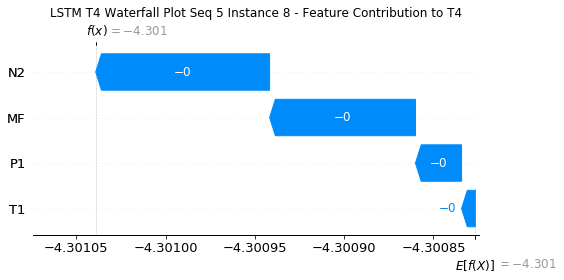

None

Contribution: [-2.80155782e-05 -1.00434965e-05 -1.01894014e-04 -8.90214795e-05]


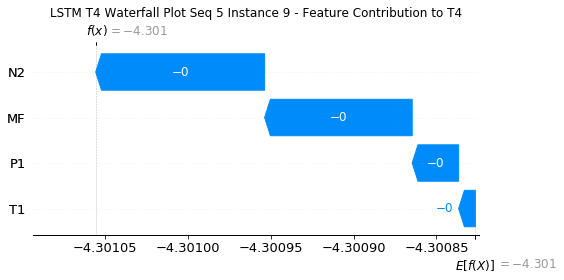

None

Contribution: [-3.02528316e-05 -1.08148784e-05 -1.07829289e-04 -9.44365409e-05]


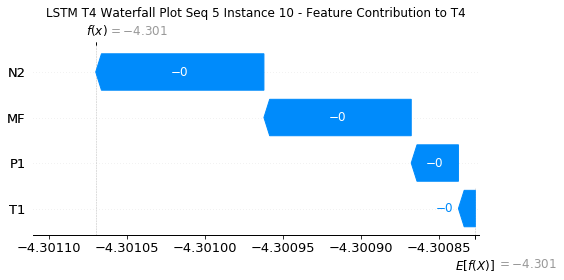

None

Contribution: [-3.20955103e-05 -1.12336752e-05 -1.13227694e-04 -9.90826614e-05]


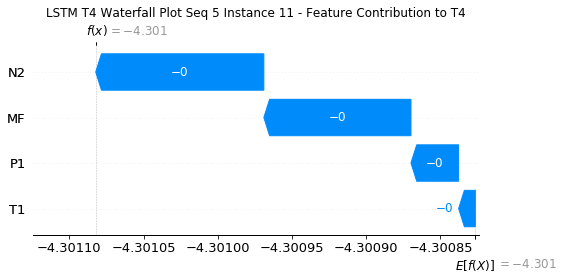

None

Contribution: [-3.30233770e-05 -1.32156450e-05 -1.20361382e-04 -1.05430497e-04]


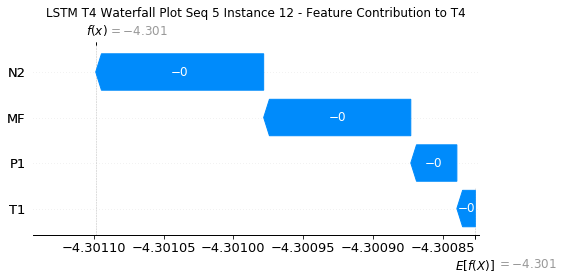

None

Contribution: [-3.74147317e-05 -1.49675418e-05 -1.31127351e-04 -1.16082488e-04]


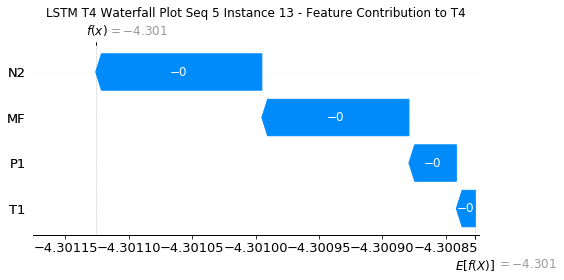

None

Contribution: [-4.28287832e-05 -1.82528548e-05 -1.48613167e-04 -1.29408922e-04]


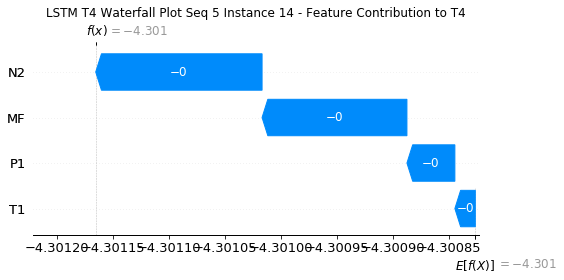

None

Contribution: [-4.91116321e-05 -2.16749453e-05 -1.70768743e-04 -1.52985619e-04]


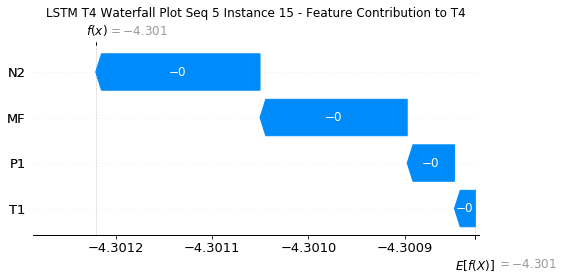

None

Contribution: [-4.92910448e-05 -2.12587112e-05 -1.71613714e-04 -1.54242373e-04]


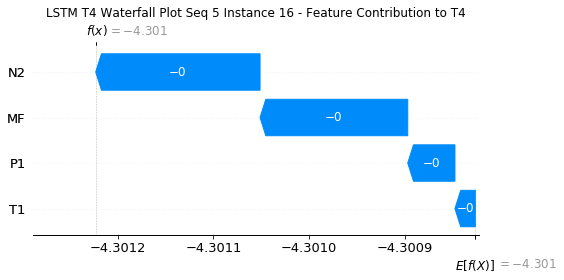

None

Contribution: [-2.89517079e-05 -6.14144894e-06 -1.03801696e-04 -9.16778994e-05]


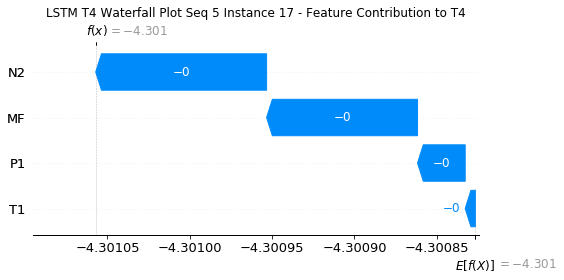

None

Contribution: [2.01090512e-05 2.88544170e-05 7.01693022e-05 7.11885470e-05]


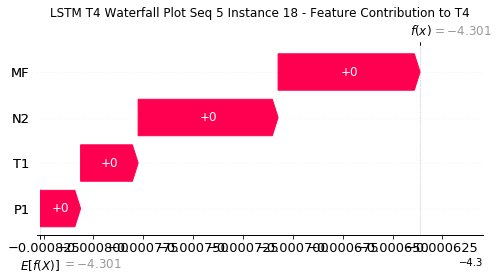

None

Contribution: [7.73820374e-05 7.07780251e-05 2.67441526e-04 2.58534443e-04]


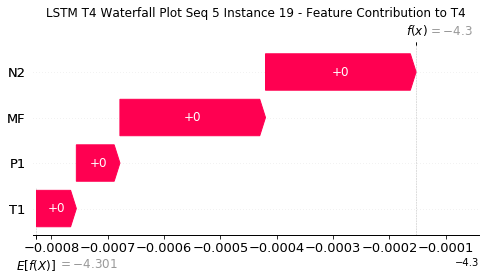

None

Contribution: [3.77216731e-05 5.41964041e-05 1.12995334e-04 1.23096134e-04]


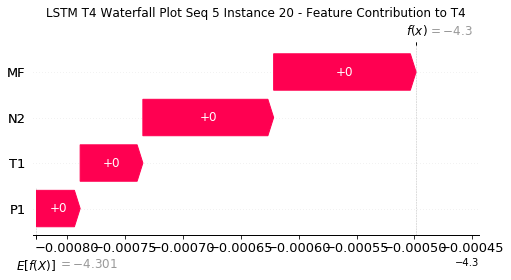

None

Contribution: [-2.83192879e-04 -9.74453819e-05 -1.09037722e-03 -9.96661265e-04]


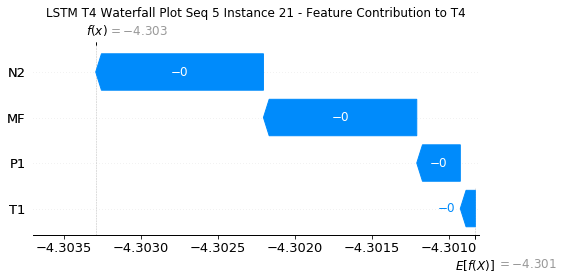

None

Contribution: [-0.00099266 -0.00013664 -0.00384691 -0.00360794]


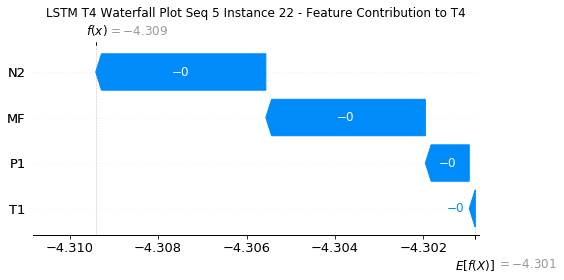

None

Contribution: [-0.00181632  0.00046371 -0.00776092 -0.00741356]


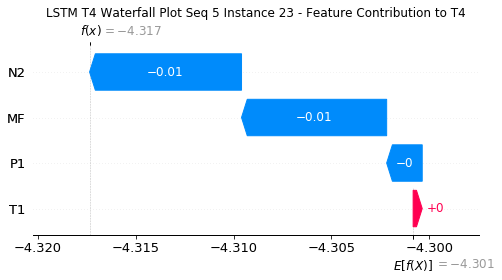

None

Contribution: [-0.00064842  0.00399897 -0.00533465 -0.00590987]


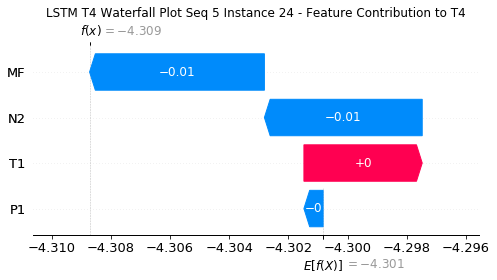

None

Contribution: [-0.00154619 -0.0005895  -0.00657177 -0.00613282]


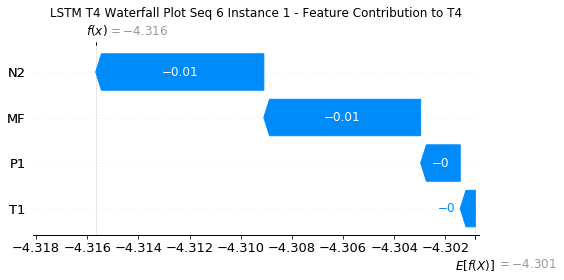

None

Contribution: [ 0.0001498  -0.00039614  0.0008191   0.00089738]


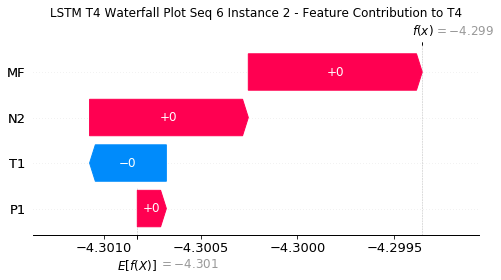

None

Contribution: [-3.30298336e-06  1.05974010e-05 -1.84458026e-05 -1.77314604e-05]


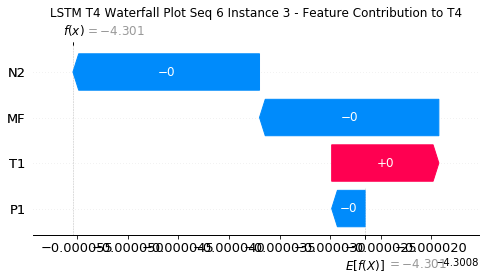

None

Contribution: [-1.31468063e-05 -1.51326069e-06 -5.06725496e-05 -4.15033621e-05]


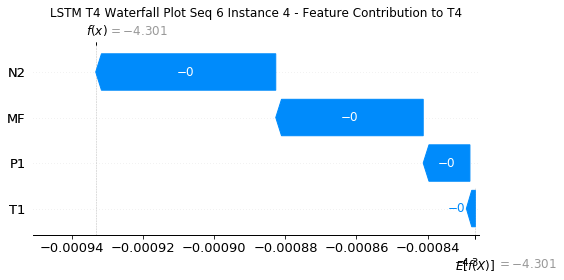

None

Contribution: [-2.31114143e-05 -9.79629539e-06 -8.92710717e-05 -7.36192988e-05]


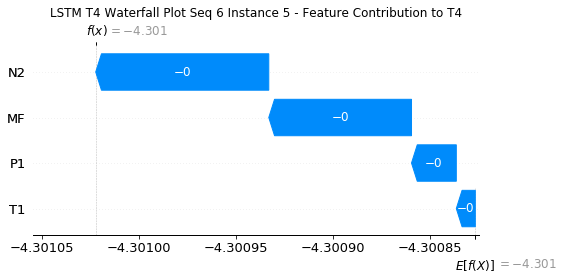

None

Contribution: [-2.69893929e-05 -1.20947208e-05 -9.89516748e-05 -8.36494476e-05]


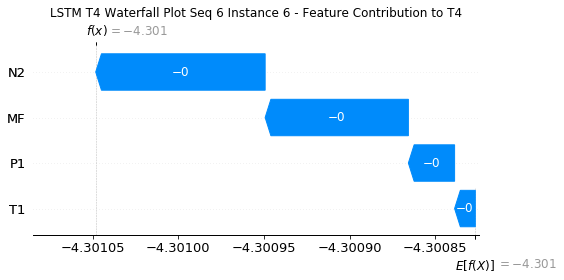

None

Contribution: [-2.61745494e-05 -1.05985866e-05 -9.75302224e-05 -8.19017394e-05]


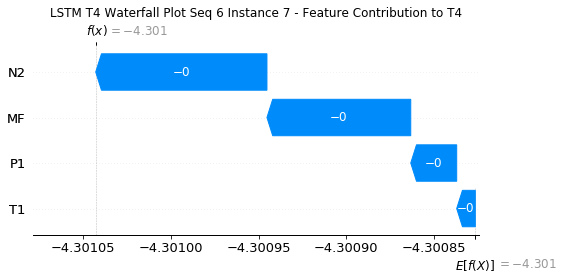

None

Contribution: [-2.53067856e-05 -1.16767432e-05 -9.76712277e-05 -8.41157420e-05]


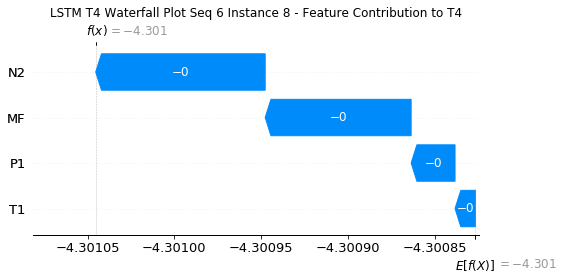

None

Contribution: [-2.77201577e-05 -1.16561535e-05 -1.01387504e-04 -8.75181574e-05]


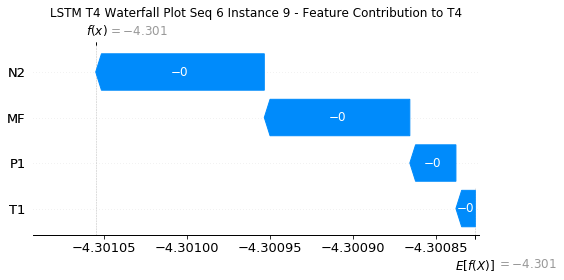

None

Contribution: [-2.96576892e-05 -1.28222971e-05 -1.07305807e-04 -9.43436197e-05]


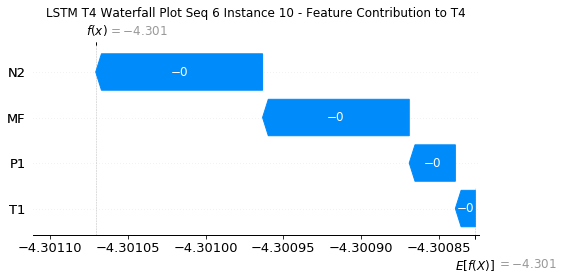

None

Contribution: [-3.15716939e-05 -1.36758202e-05 -1.12801256e-04 -9.90914267e-05]


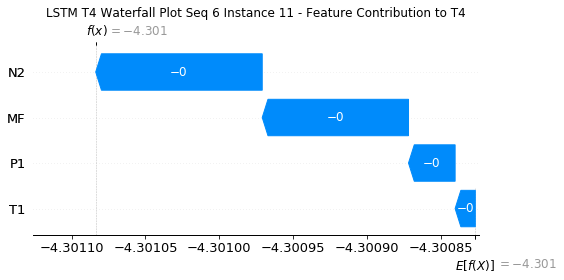

None

Contribution: [-3.49618766e-05 -1.51720912e-05 -1.20132207e-04 -1.06589073e-04]


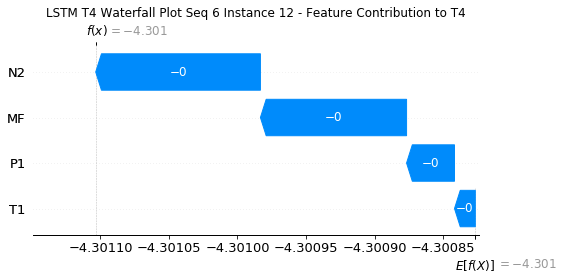

None

Contribution: [-3.68950219e-05 -1.73042351e-05 -1.30556917e-04 -1.15831737e-04]


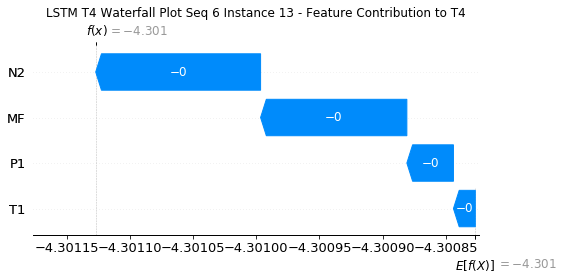

None

Contribution: [-4.19332706e-05 -1.92150295e-05 -1.46996780e-04 -1.30268086e-04]


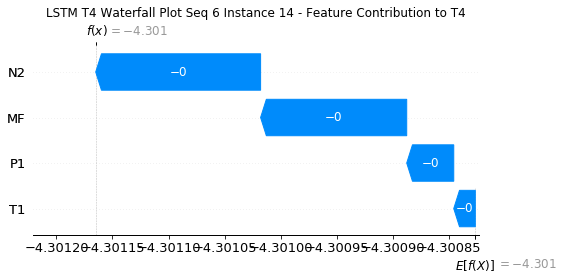

None

Contribution: [-4.84320967e-05 -2.44750535e-05 -1.69413398e-04 -1.51781507e-04]


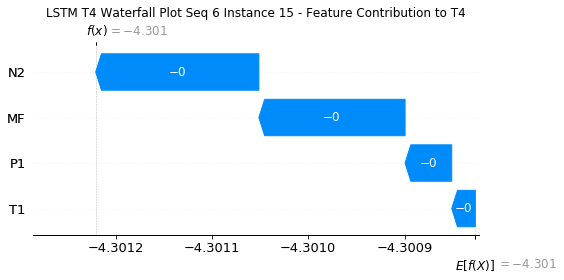

None

Contribution: [-4.94030792e-05 -2.46678423e-05 -1.70840688e-04 -1.53665214e-04]


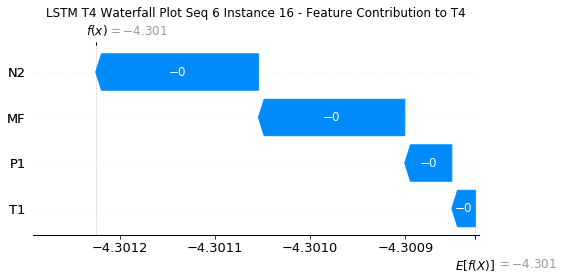

None

Contribution: [-2.96235478e-05 -1.07775233e-05 -1.04967460e-04 -9.23126688e-05]


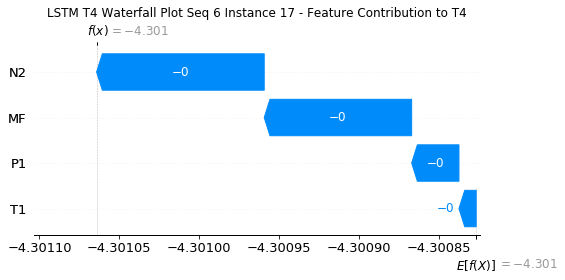

None

Contribution: [1.88753715e-05 2.69590946e-05 6.63239367e-05 6.76758625e-05]


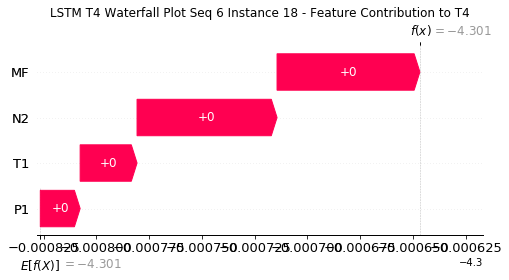

None

Contribution: [7.60017395e-05 7.10125593e-05 2.61873044e-04 2.53141786e-04]


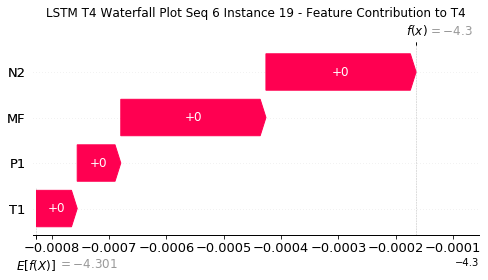

None

Contribution: [3.63479267e-05 4.84691483e-05 1.11908449e-04 1.22223350e-04]


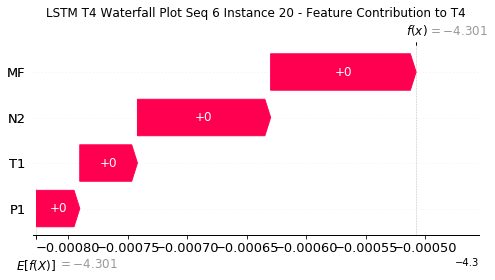

None

Contribution: [-0.00029042 -0.00013557 -0.00107994 -0.0009866 ]


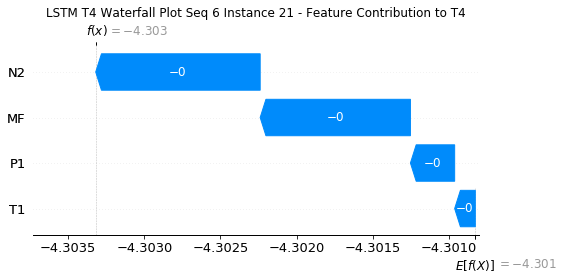

None

Contribution: [-0.00102314 -0.00029131 -0.00382794 -0.00356559]


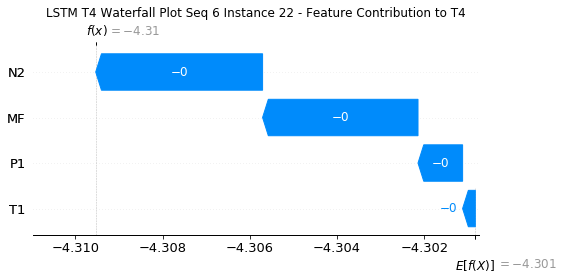

None

Contribution: [-0.00188914  0.00013669 -0.00777129 -0.00717199]


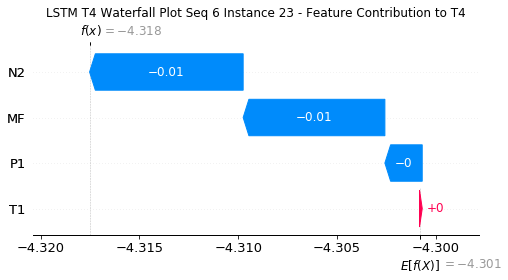

None

Contribution: [-0.00094728  0.00315236 -0.00540978 -0.00576944]


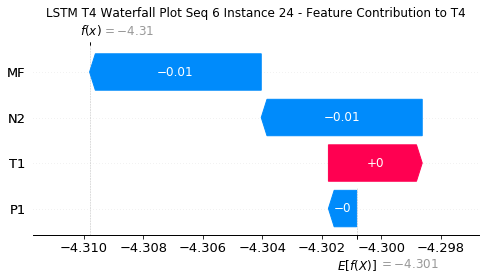

None

Contribution: [-0.00159324 -0.00075657 -0.00666391 -0.00603749]


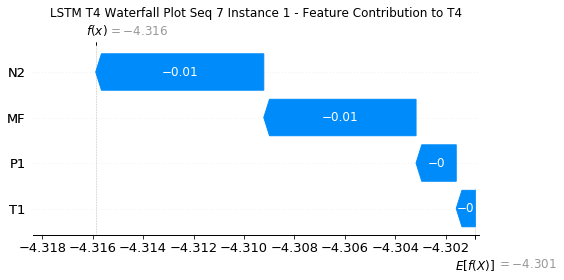

None

Contribution: [ 0.00014333 -0.00036242  0.00081848  0.00075825]


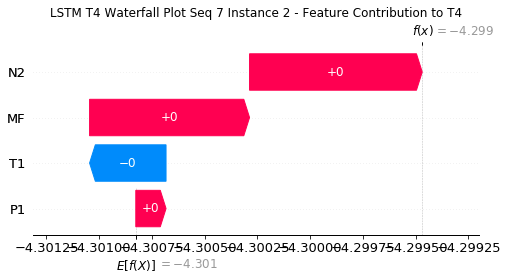

None

Contribution: [-4.34108165e-06  1.23733510e-05 -2.03298981e-05 -1.83864011e-05]


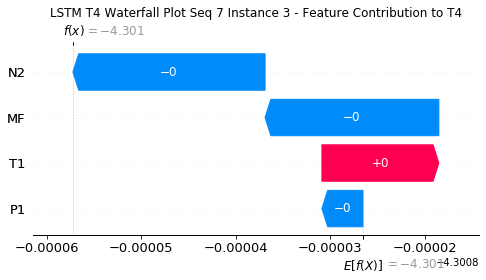

None

Contribution: [-1.37526966e-05 -7.79136629e-09 -5.20915921e-05 -4.17319649e-05]


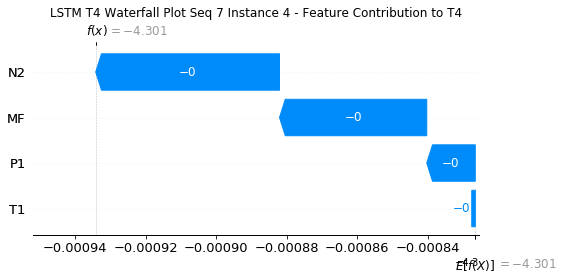

None

Contribution: [-2.44720438e-05 -9.06071193e-06 -9.15663043e-05 -7.60141745e-05]


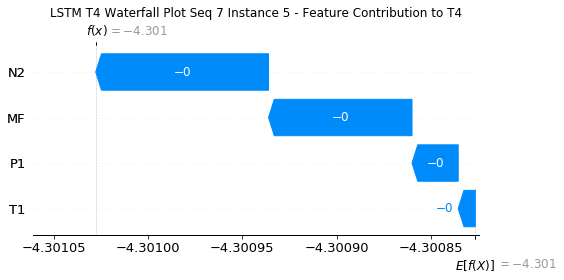

None

Contribution: [-2.76592664e-05 -9.62991958e-06 -1.00584973e-04 -8.39453962e-05]


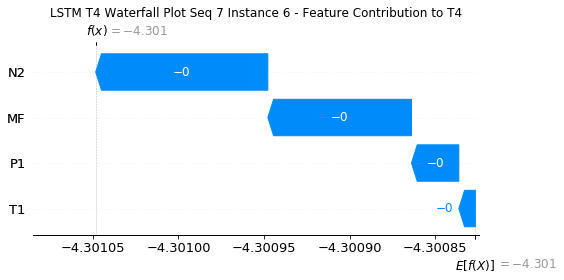

None

Contribution: [-2.66621005e-05 -6.20313025e-06 -9.80664930e-05 -8.29938606e-05]


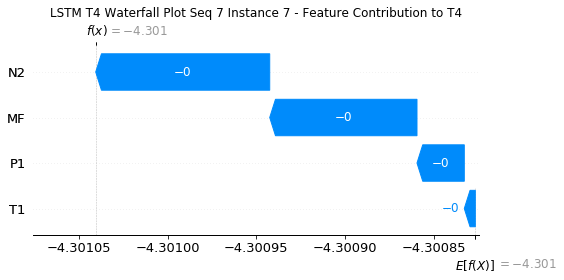

None

Contribution: [-2.74721531e-05 -9.61281161e-06 -9.83529000e-05 -8.34106571e-05]


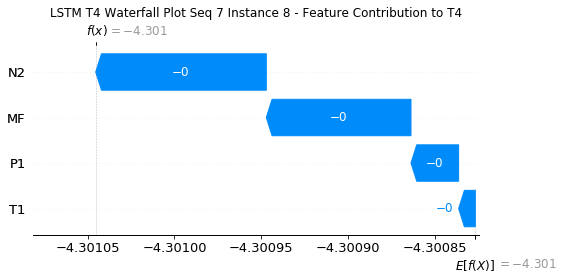

None

Contribution: [-2.80877995e-05 -9.56724125e-06 -1.01806031e-04 -8.74085083e-05]


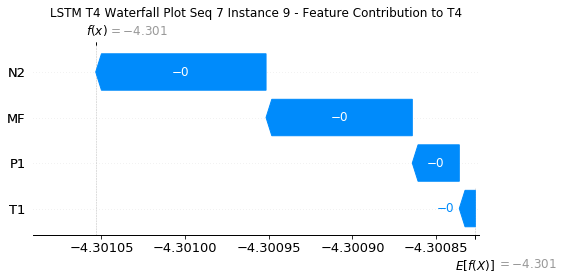

None

Contribution: [-3.02734074e-05 -8.55719105e-06 -1.08763392e-04 -9.36025650e-05]


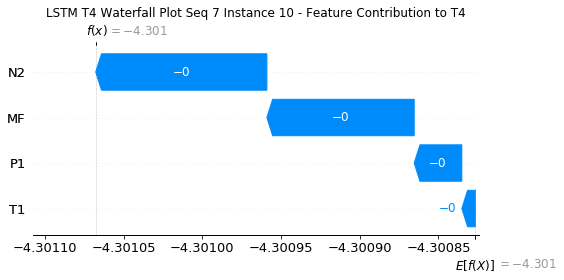

None

Contribution: [-3.20519855e-05 -8.51112566e-06 -1.14057473e-04 -9.83059892e-05]


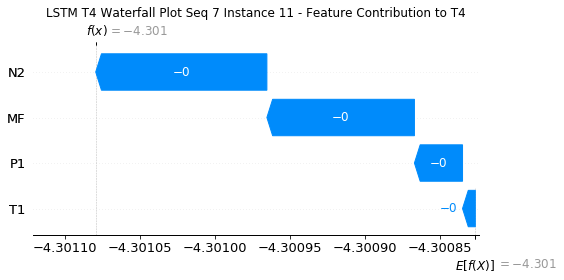

None

Contribution: [-3.44747638e-05 -6.37890099e-06 -1.21104302e-04 -1.03887918e-04]


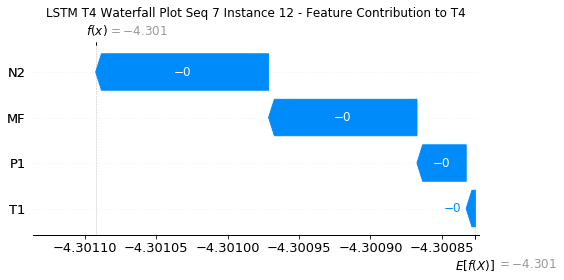

None

Contribution: [-3.72304829e-05 -1.11957173e-05 -1.31985148e-04 -1.15061704e-04]


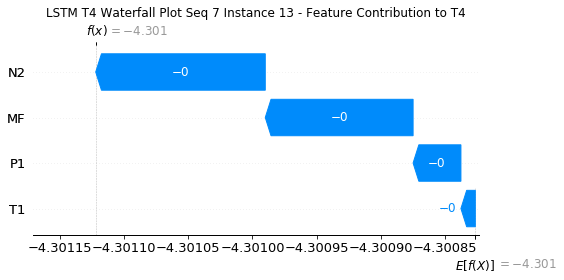

None

Contribution: [-4.25540841e-05 -1.18452512e-05 -1.50531387e-04 -1.31494776e-04]


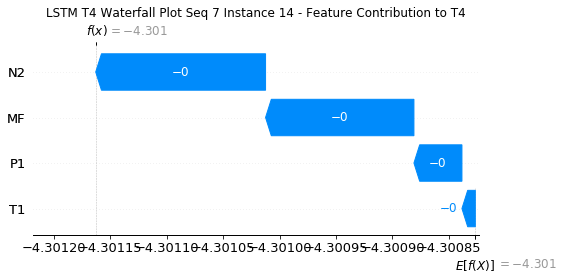

None

Contribution: [-4.87191570e-05 -1.64885644e-05 -1.71966094e-04 -1.52091710e-04]


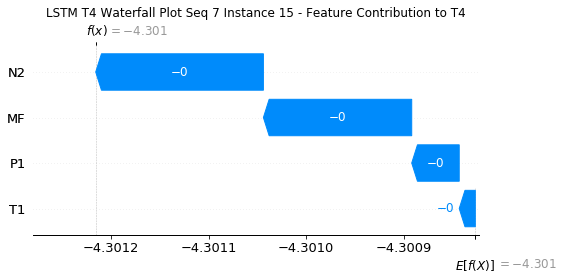

None

Contribution: [-4.91425189e-05 -1.62619295e-05 -1.72492184e-04 -1.52853729e-04]


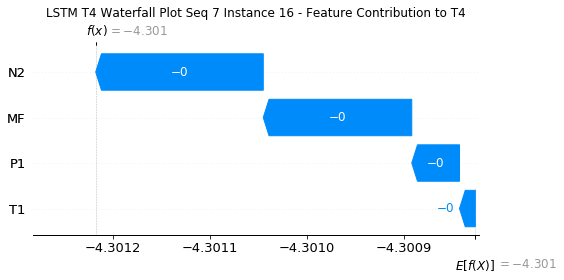

None

Contribution: [-2.94007449e-05 -2.15771491e-06 -1.02907015e-04 -8.79204567e-05]


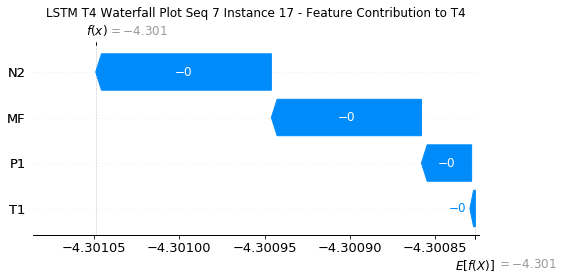

None

Contribution: [2.10458707e-05 3.03907460e-05 7.31006362e-05 7.42380727e-05]


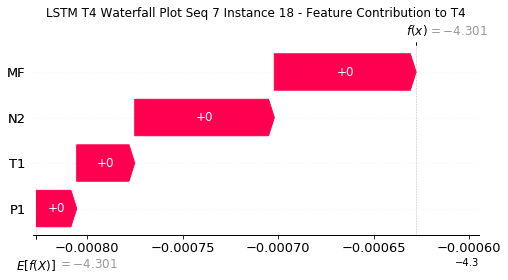

None

Contribution: [7.82664886e-05 6.99043995e-05 2.70623992e-04 2.60844208e-04]


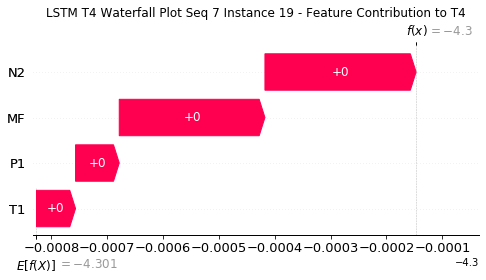

None

Contribution: [3.73831790e-05 5.98638582e-05 1.10560752e-04 1.22719977e-04]


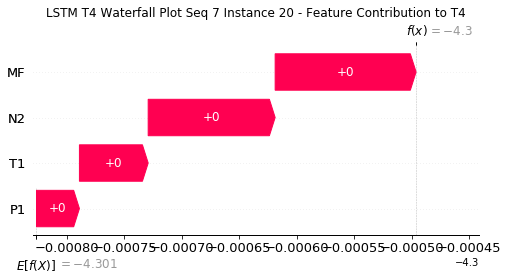

None

Contribution: [-2.86998416e-04 -4.62474193e-05 -1.10791043e-03 -9.92794824e-04]


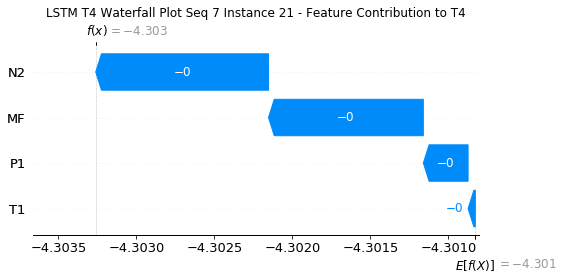

None

Contribution: [-1.00051704e-03  4.99860349e-05 -3.88181699e-03 -3.56263456e-03]


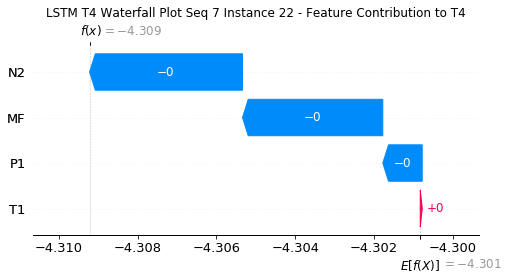

None

Contribution: [-0.00192061  0.00123863 -0.00781804 -0.00748079]


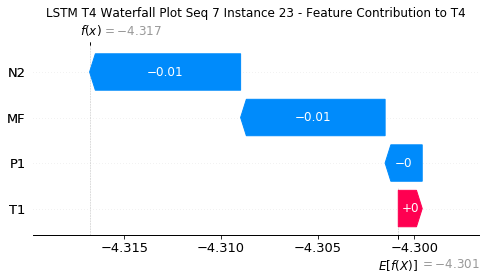

None

Contribution: [-0.00083428  0.00529911 -0.00543782 -0.00599435]


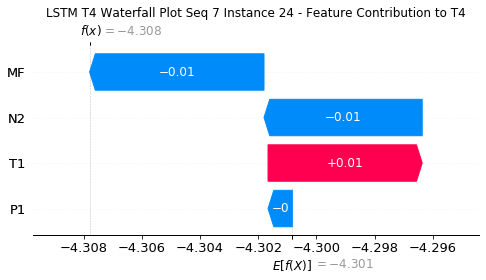

None

Contribution: [-0.00156995  0.00010237 -0.00675505 -0.00629851]


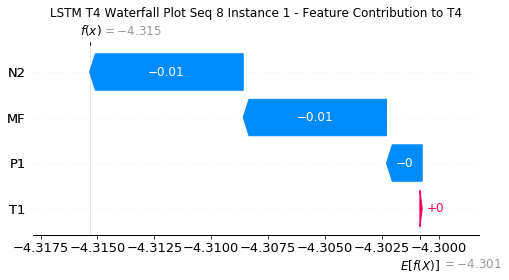

None

Contribution: [ 0.00011632 -0.00053518  0.00083313  0.00087098]


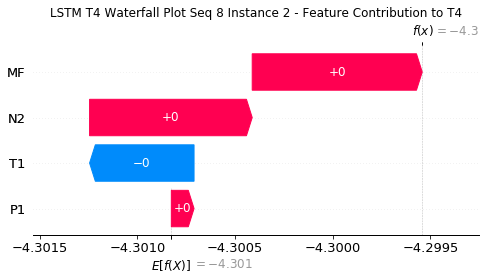

None

Contribution: [-4.65006365e-06  2.24757212e-05 -1.97539208e-05 -1.86424803e-05]


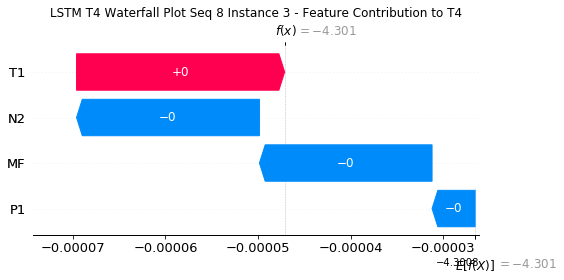

None

Contribution: [-1.29861543e-05  6.78544659e-06 -5.04620481e-05 -4.02084294e-05]


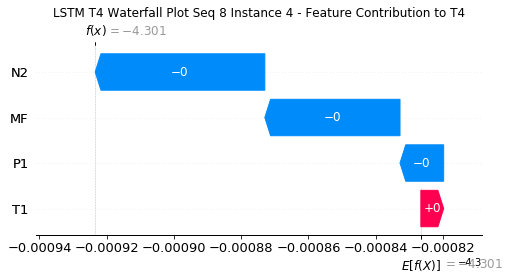

None

Contribution: [-2.48039892e-05 -4.71273101e-06 -9.07804953e-05 -7.55003180e-05]


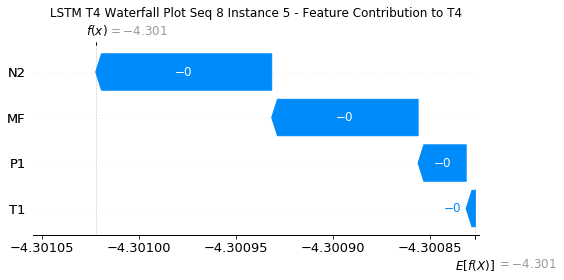

None

Contribution: [-2.67937087e-05 -3.23590533e-06 -9.93983526e-05 -8.24242156e-05]


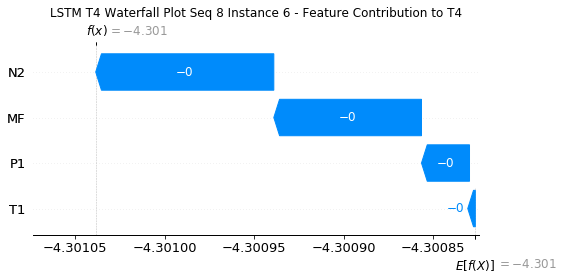

None

Contribution: [-2.66400070e-05 -5.06714520e-06 -9.92441704e-05 -8.50858347e-05]


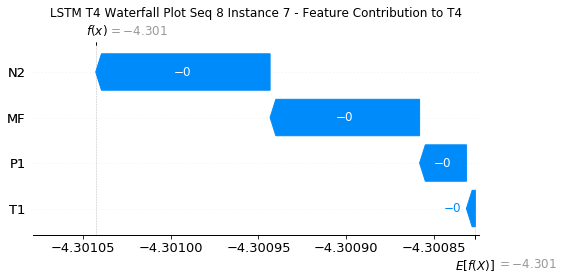

None

Contribution: [-2.61845647e-05 -2.90649670e-06 -9.86217025e-05 -8.45723734e-05]


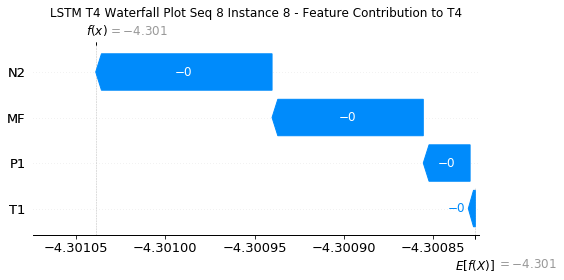

None

Contribution: [-2.71187589e-05 -6.84245618e-06 -1.02509985e-04 -8.82525797e-05]


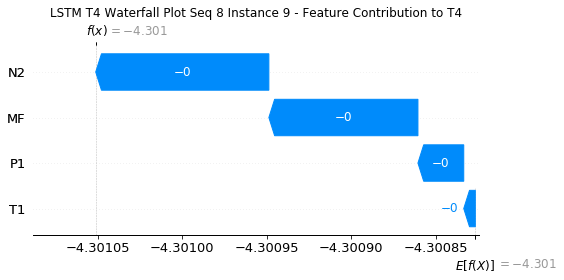

None

Contribution: [-2.97940214e-05 -5.21108544e-06 -1.08312756e-04 -9.34746088e-05]


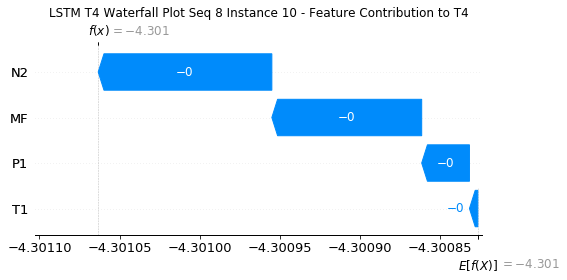

None

Contribution: [-3.16121480e-05 -5.44786322e-06 -1.13501315e-04 -9.80980187e-05]


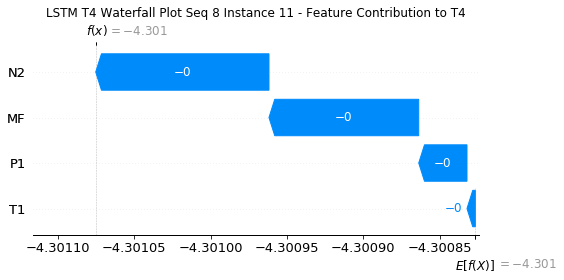

None

Contribution: [-3.28834956e-05 -5.87384753e-06 -1.20669921e-04 -1.03252500e-04]


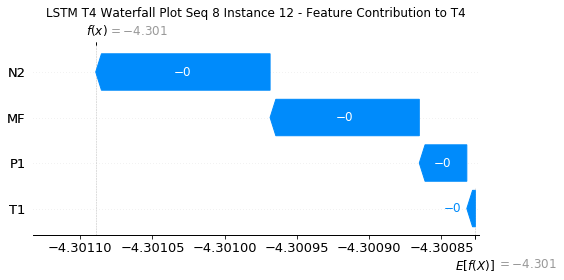

None

Contribution: [-3.77122223e-05 -9.51100493e-06 -1.32609476e-04 -1.16821761e-04]


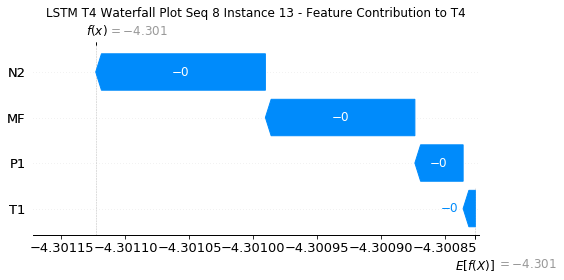

None

Contribution: [-4.32786196e-05 -9.90862670e-06 -1.51419342e-04 -1.33326577e-04]


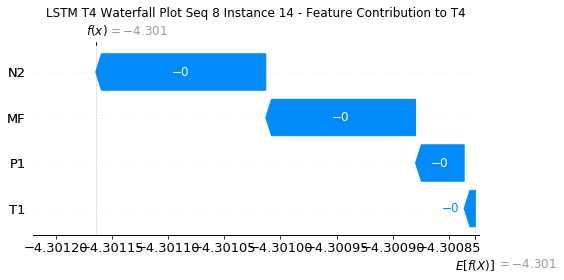

None

Contribution: [-4.87260320e-05 -1.52987880e-05 -1.73174540e-04 -1.53784706e-04]


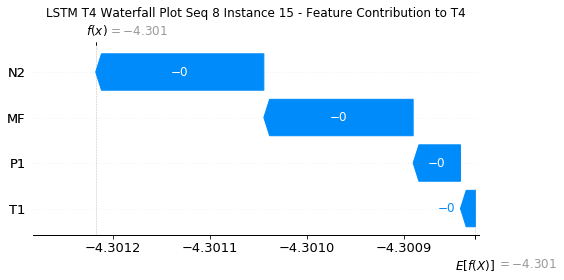

None

Contribution: [-4.75333286e-05 -1.42656466e-05 -1.72604033e-04 -1.51473144e-04]


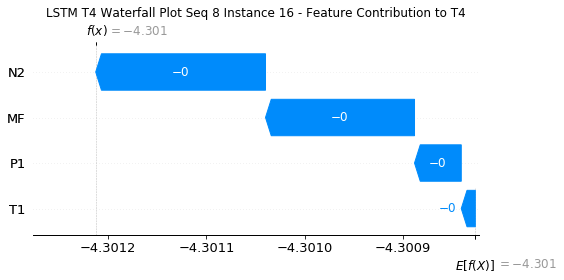

None

Contribution: [-2.78251003e-05 -1.85127051e-06 -1.02532890e-04 -8.91417260e-05]


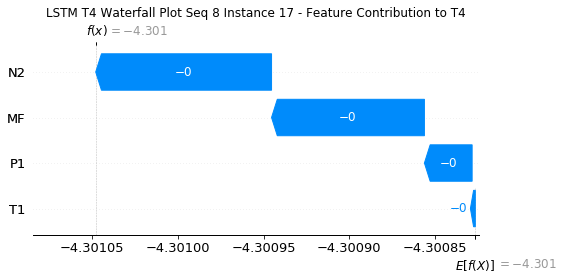

None

Contribution: [2.23483596e-05 3.17244816e-05 7.74530740e-05 7.83348931e-05]


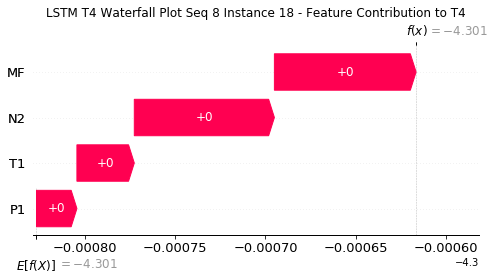

None

Contribution: [8.05289170e-05 7.18752164e-05 2.79081592e-04 2.68195145e-04]


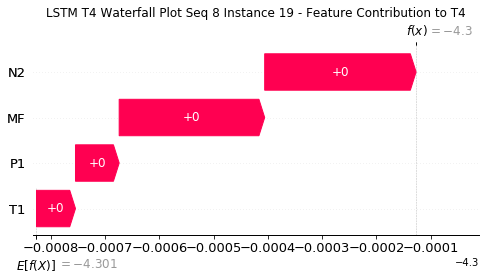

None

Contribution: [3.89176196e-05 6.15130882e-05 1.17770321e-04 1.29388448e-04]


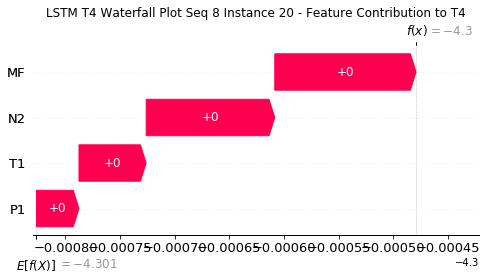

None

Contribution: [-2.81890195e-04 -4.98314573e-05 -1.11245831e-03 -9.87726793e-04]


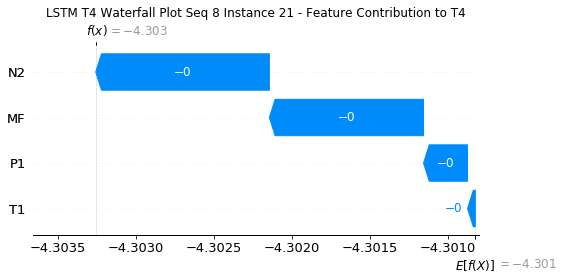

None

Contribution: [-1.03766902e-03  5.77801008e-05 -3.94817809e-03 -3.73807593e-03]


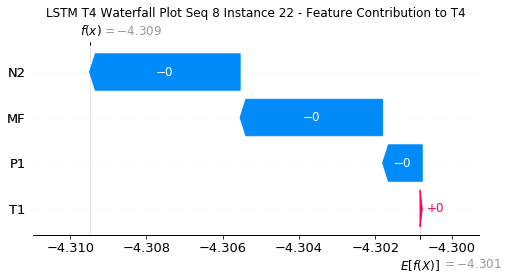

None

Contribution: [-0.00177238  0.00147154 -0.00793351 -0.00758298]


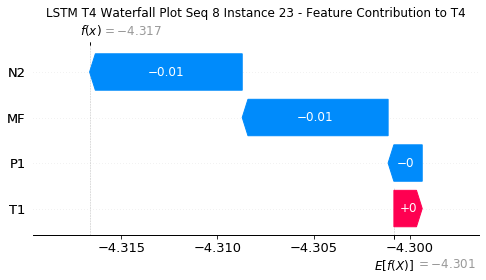

None

Contribution: [ 3.60294269e-05  5.57967024e-03 -4.99304769e-03 -2.55862778e-03]


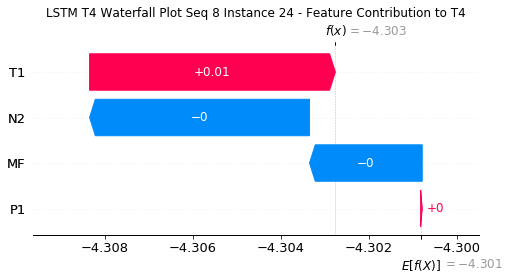

None

Contribution: [-0.00165366 -0.00027501 -0.00657275 -0.00569292]


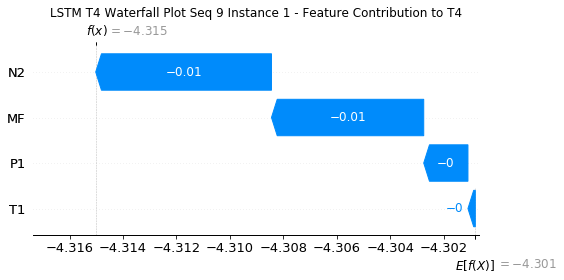

None

Contribution: [ 0.00012516 -0.0006073   0.00082741  0.00075938]


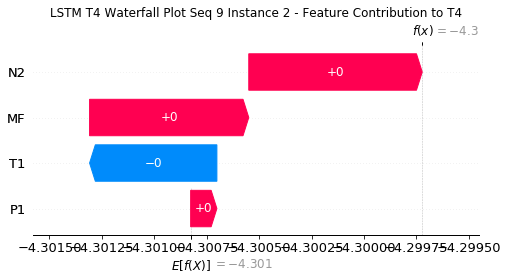

None

Contribution: [-6.74131441e-07  1.75414104e-05 -1.91474209e-05 -1.83579107e-05]


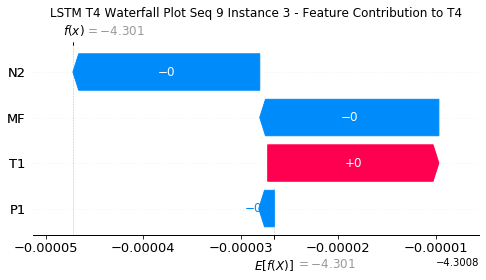

None

Contribution: [-1.14626797e-05  2.07648047e-06 -4.97265389e-05 -4.08461190e-05]


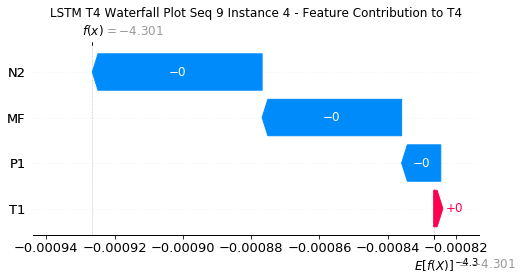

None

Contribution: [-1.88493866e-05 -2.18820370e-06 -8.63951784e-05 -6.73575396e-05]


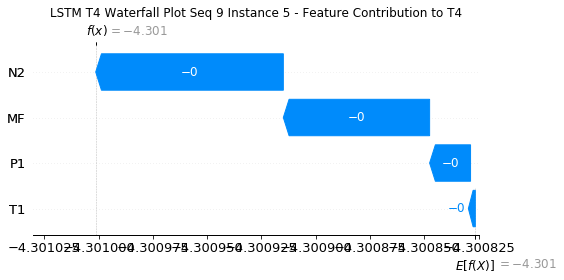

None

Contribution: [-2.52998054e-05 -9.16877589e-06 -9.74965648e-05 -8.24927875e-05]


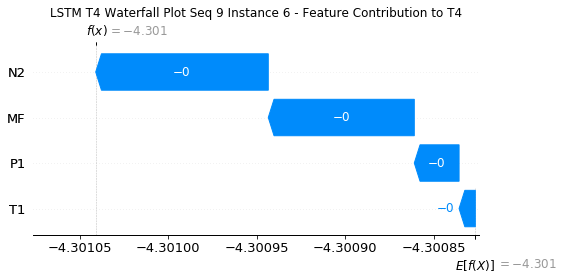

None

Contribution: [-2.63006148e-05 -1.52073118e-05 -9.77022357e-05 -8.34848052e-05]


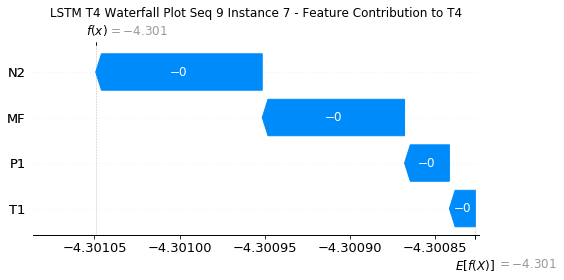

None

Contribution: [-2.71733032e-05 -1.80098786e-05 -9.85926401e-05 -8.55844445e-05]


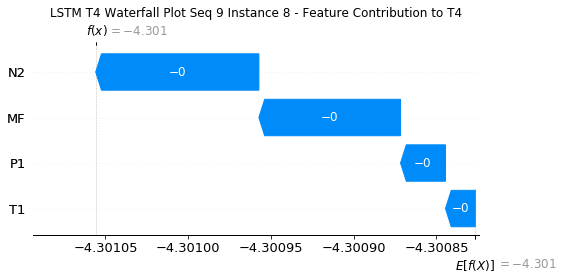

None

Contribution: [-2.86968840e-05 -1.44831979e-05 -1.01877610e-04 -8.95612923e-05]


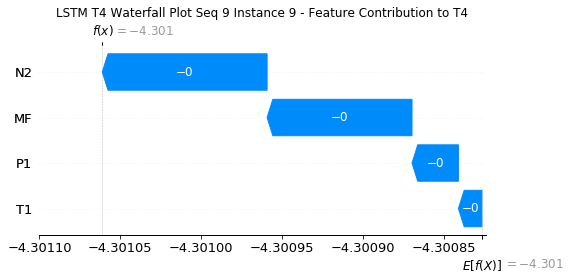

None

Contribution: [-3.03946078e-05 -1.31911502e-05 -1.07408107e-04 -9.43195150e-05]


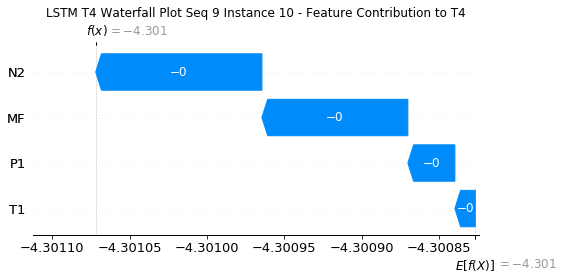

None

Contribution: [-3.21661615e-05 -1.47217158e-05 -1.12730504e-04 -9.89026689e-05]


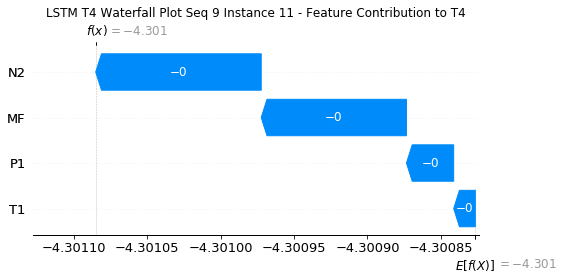

None

Contribution: [-3.35542172e-05 -1.66264298e-05 -1.19167223e-04 -1.03189546e-04]


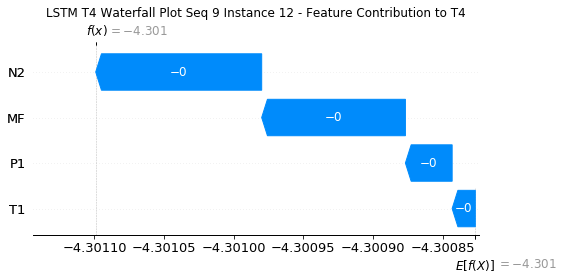

None

Contribution: [-3.75781136e-05 -1.85988142e-05 -1.29953597e-04 -1.14529164e-04]


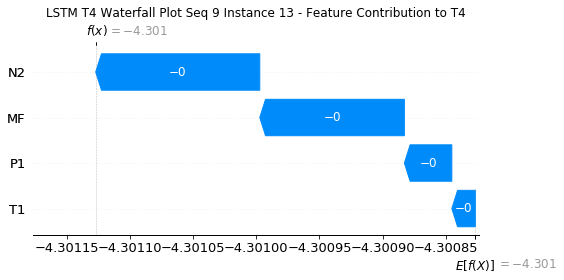

None

Contribution: [-4.28615380e-05 -2.04932042e-05 -1.47616598e-04 -1.29952482e-04]


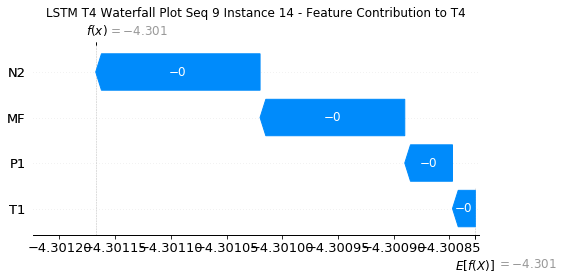

None

Contribution: [-4.98464852e-05 -2.86392125e-05 -1.69505149e-04 -1.51247872e-04]


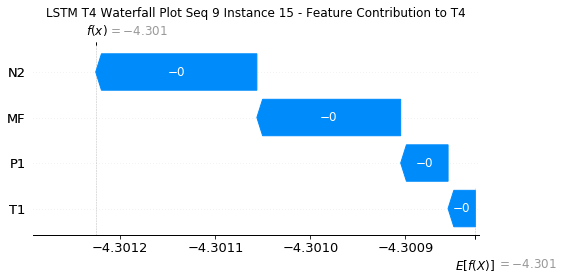

None

Contribution: [-5.10785370e-05 -2.95397341e-05 -1.71568395e-04 -1.54223605e-04]


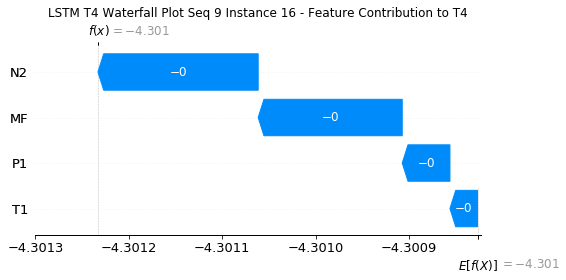

None

Contribution: [-2.97835182e-05 -1.52264217e-05 -1.05845335e-04 -9.20299558e-05]


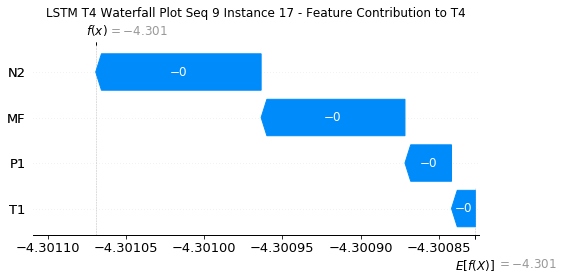

None

Contribution: [1.85913177e-05 2.60739186e-05 6.56248808e-05 6.71898172e-05]


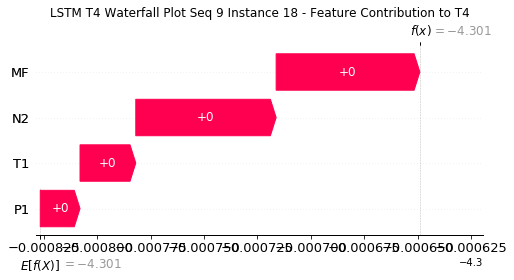

None

Contribution: [7.62323598e-05 7.23299272e-05 2.62216095e-04 2.53068171e-04]


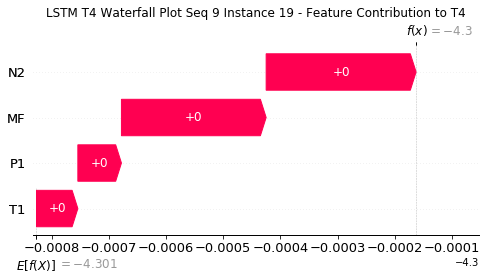

None

Contribution: [3.64687140e-05 4.63899700e-05 1.13887388e-04 1.25547282e-04]


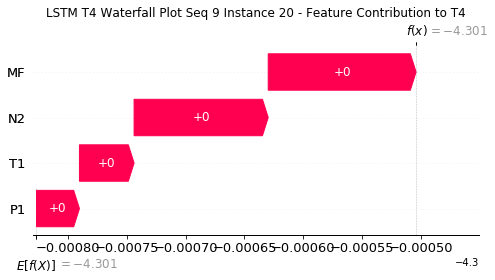

None

Contribution: [-0.00030112 -0.00016996 -0.00107772 -0.00097317]


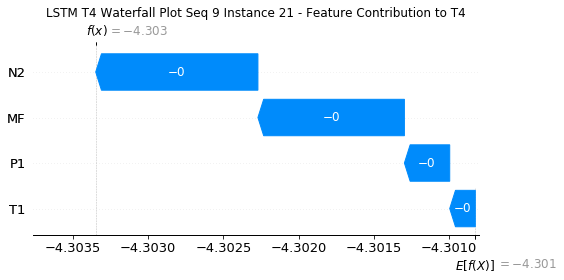

None

Contribution: [-0.00104129 -0.00038911 -0.00382307 -0.0034797 ]


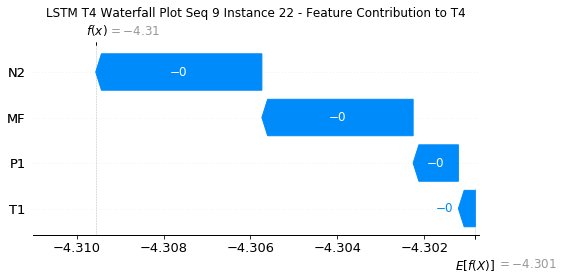

None

Contribution: [-0.00182976 -0.0005558  -0.00768178 -0.00707226]


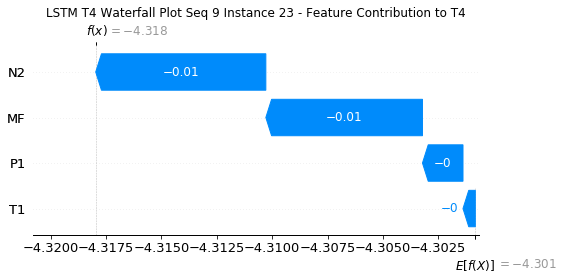

None

Contribution: [-0.00098695  0.00197859 -0.00537238 -0.0061927 ]


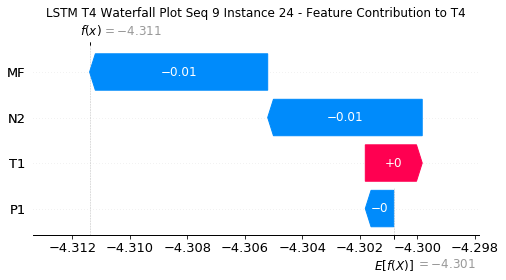

None

Contribution: [-0.00151929 -0.00106043 -0.00648096 -0.00585918]


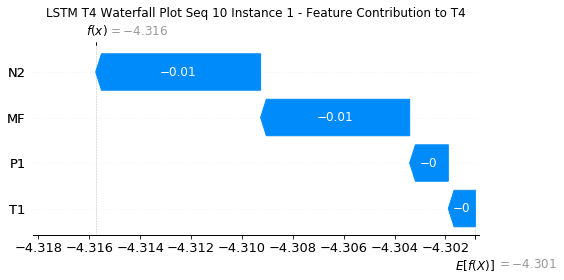

None

Contribution: [ 0.00011477 -0.00023809  0.00080997  0.00079028]


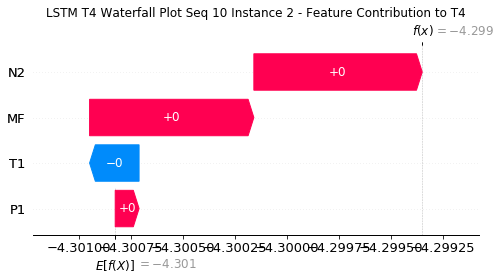

None

Contribution: [-4.52245065e-06  6.83108700e-06 -1.74842832e-05 -1.64127411e-05]


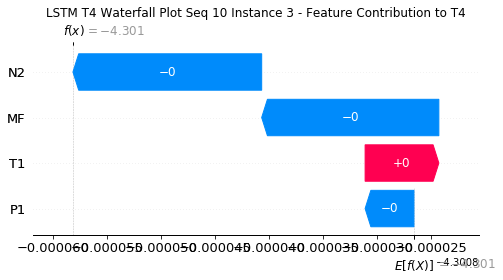

None

Contribution: [-1.42132218e-05 -4.43674581e-06 -5.06996866e-05 -4.13181196e-05]


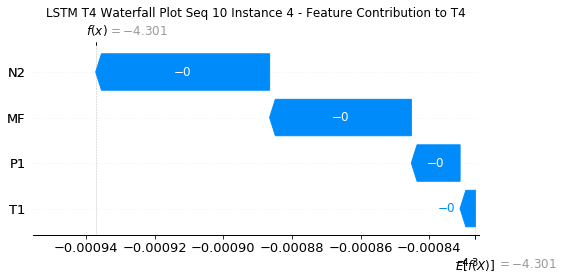

None

Contribution: [-2.50927971e-05 -1.48960942e-05 -9.01710722e-05 -7.73678123e-05]


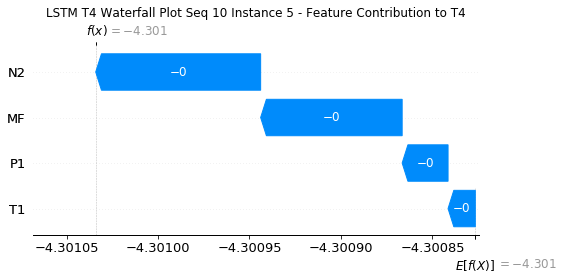

None

Contribution: [-2.80673214e-05 -1.50442425e-05 -9.86777878e-05 -8.33008827e-05]


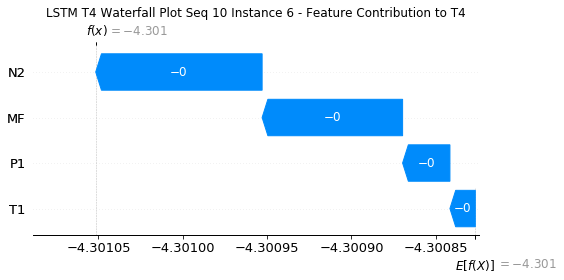

None

Contribution: [-2.60114815e-05 -1.32366526e-05 -9.69340272e-05 -8.01054343e-05]


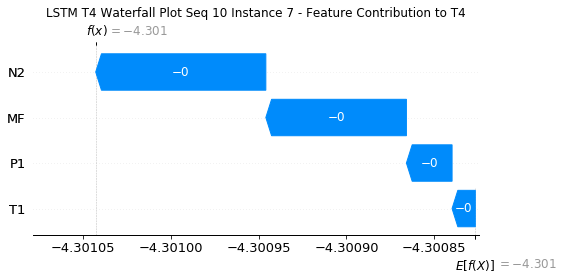

None

Contribution: [-2.94519800e-05 -1.44997506e-05 -9.87796197e-05 -8.73440982e-05]


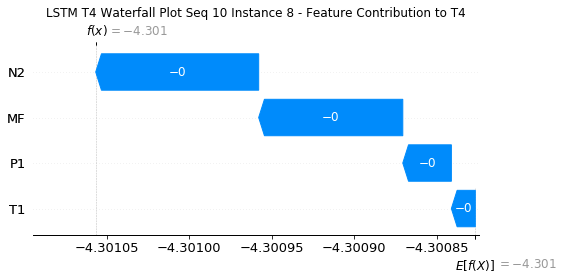

None

Contribution: [-2.85657075e-05 -1.45385107e-05 -1.01691135e-04 -8.86501049e-05]


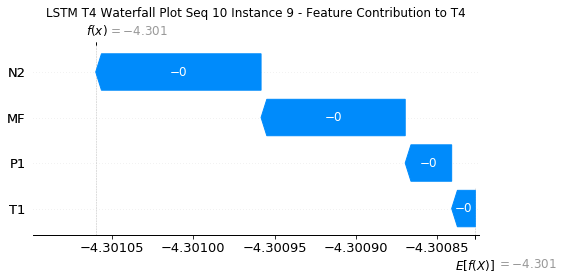

None

Contribution: [-3.13610830e-05 -1.51353859e-05 -1.07735164e-04 -9.49165479e-05]


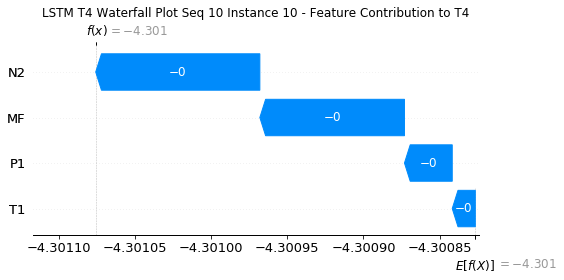

None

Contribution: [-3.29608652e-05 -1.56674061e-05 -1.12638209e-04 -9.87003710e-05]


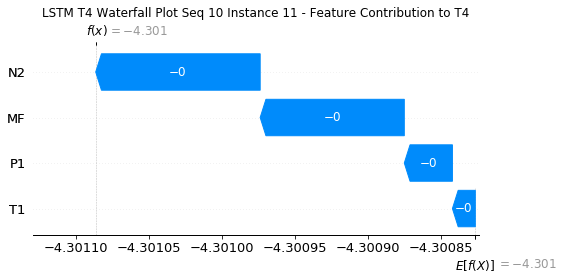

None

Contribution: [-3.44723764e-05 -1.42651475e-05 -1.18865938e-04 -1.02948340e-04]


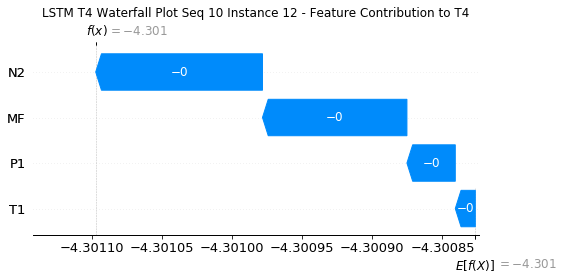

None

Contribution: [-3.84933702e-05 -1.88980191e-05 -1.30257964e-04 -1.15931487e-04]


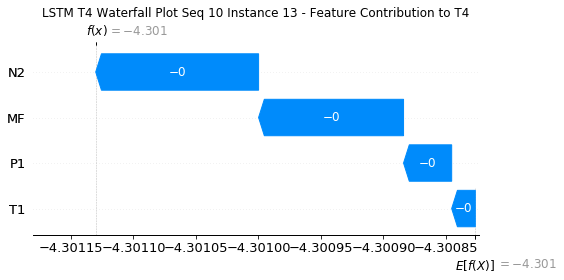

None

Contribution: [-4.29732578e-05 -2.38524288e-05 -1.48135419e-04 -1.33416519e-04]


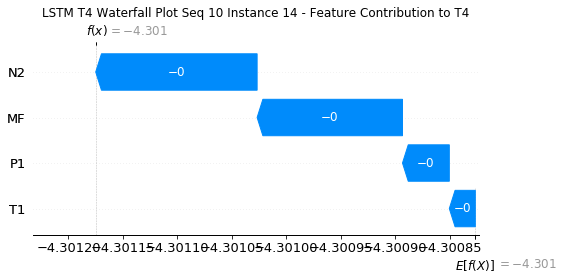

None

Contribution: [-5.01196769e-05 -2.65657714e-05 -1.69140168e-04 -1.51988679e-04]


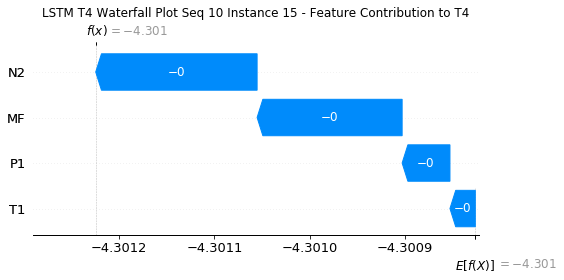

None

Contribution: [-5.09180323e-05 -2.65011033e-05 -1.70835006e-04 -1.54010691e-04]


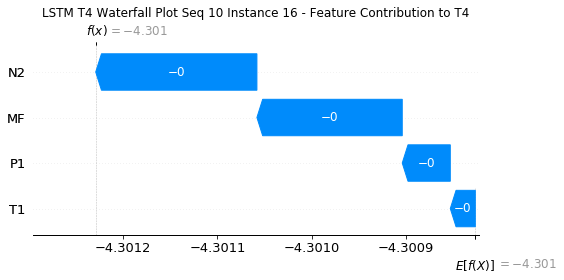

None

Contribution: [-3.13189170e-05 -1.10799451e-05 -1.06082437e-04 -9.33652519e-05]


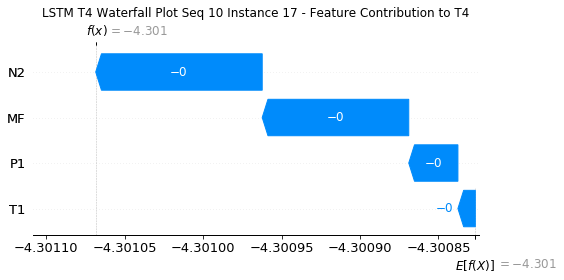

None

Contribution: [1.76296625e-05 2.60398342e-05 6.30980459e-05 6.45519650e-05]


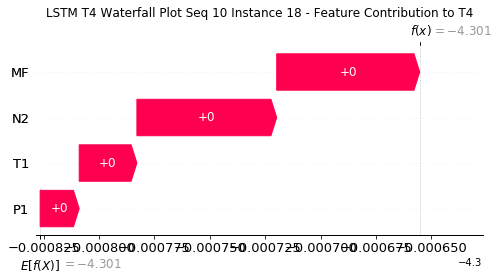

None

Contribution: [7.51655445e-05 6.98051526e-05 2.57603823e-04 2.49383795e-04]


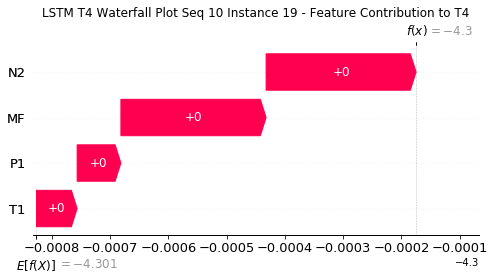

None

Contribution: [3.43326260e-05 4.87584696e-05 1.10688350e-04 1.20090546e-04]


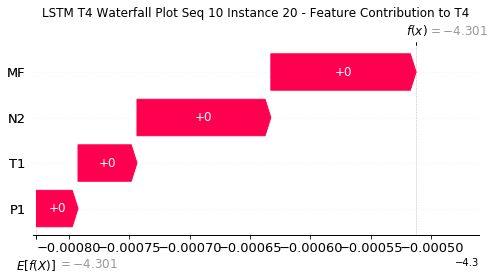

None

Contribution: [-0.0003029  -0.00012794 -0.00107337 -0.00099213]


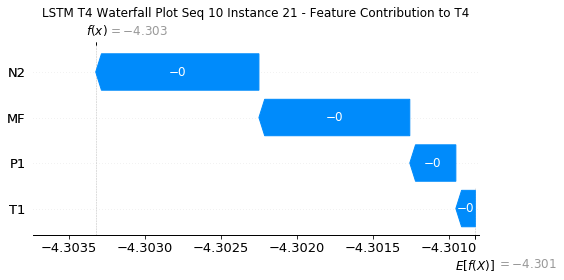

None

Contribution: [-0.00108181 -0.00024744 -0.00381639 -0.00360447]


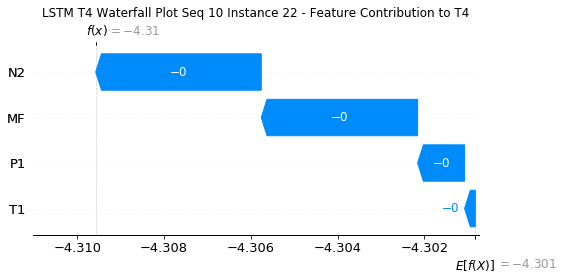

None

Contribution: [-2.08464093e-03  1.92825686e-05 -7.74461688e-03 -7.13936316e-03]


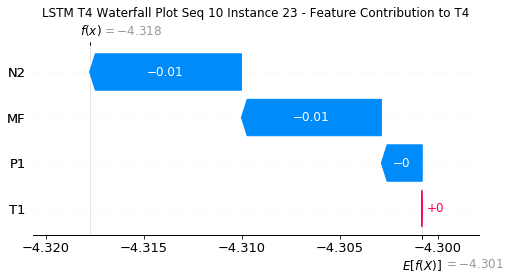

None

Contribution: [-0.00135971  0.00273139 -0.00544737 -0.00616462]


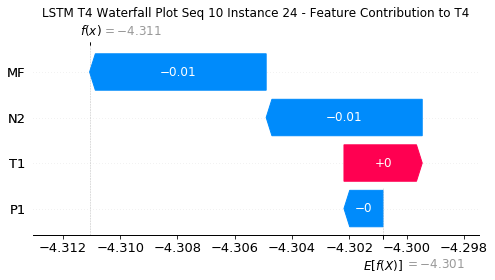

None

Contribution: [-0.00181279 -0.00095204 -0.00644378 -0.00606158]


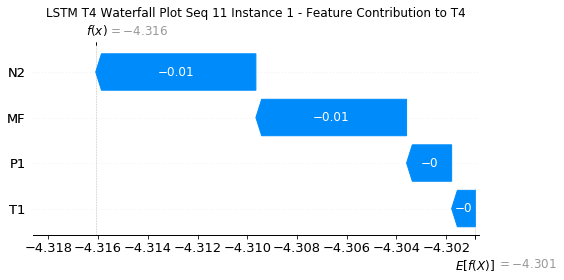

None

Contribution: [ 0.00024567 -0.00017699  0.00081977  0.00090053]


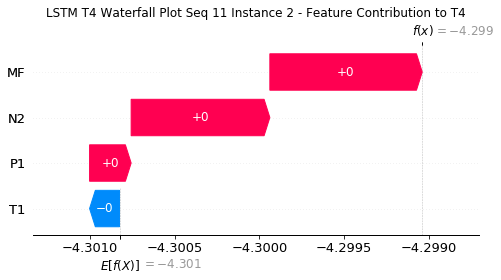

None

Contribution: [-8.75629187e-06  9.60744496e-06 -1.82271136e-05 -2.27253557e-05]


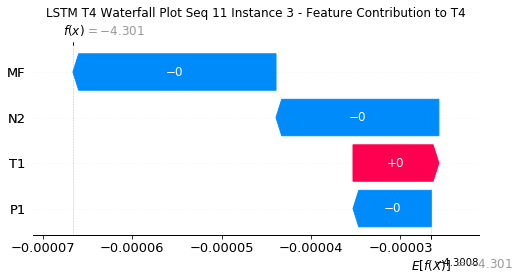

None

Contribution: [-1.68768050e-05 -5.03621445e-07 -5.08504142e-05 -4.49894312e-05]


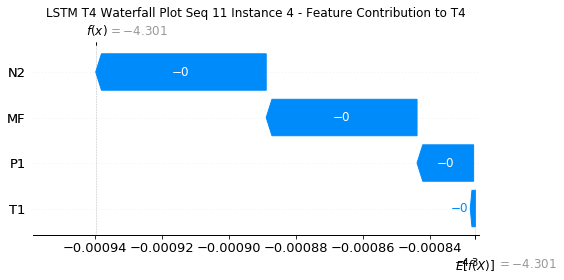

None

Contribution: [-2.93815058e-05 -1.58969245e-05 -9.01514703e-05 -7.88121947e-05]


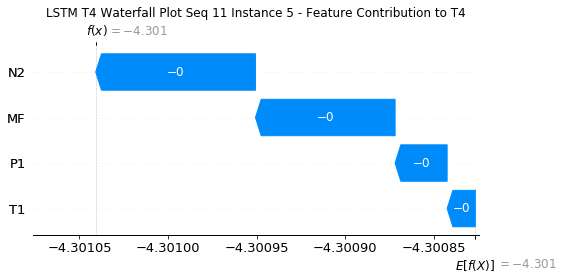

None

Contribution: [-3.14036983e-05 -1.17843541e-05 -9.89518098e-05 -8.74506086e-05]


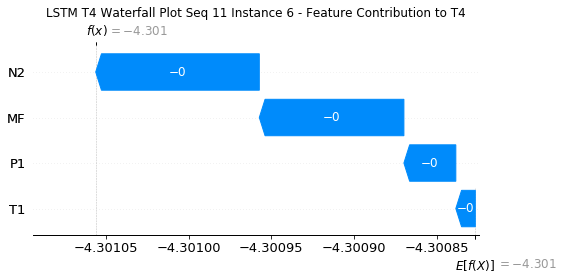

None

Contribution: [-3.14186366e-05 -1.69329540e-05 -9.98055053e-05 -8.84018117e-05]


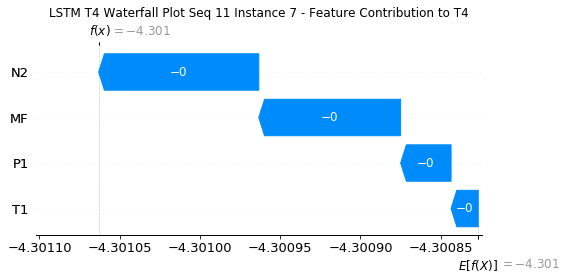

None

Contribution: [-3.18842603e-05 -1.61794116e-05 -1.00769490e-04 -9.00300392e-05]


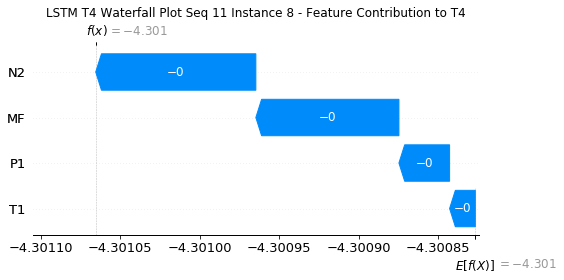

None

Contribution: [-3.29107764e-05 -1.86848317e-05 -1.04684903e-04 -9.40735416e-05]


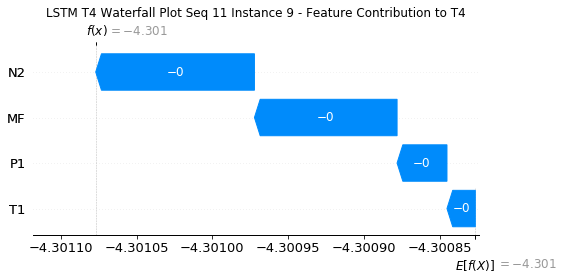

None

Contribution: [-3.35996155e-05 -2.02189638e-06 -1.08594535e-04 -9.76376398e-05]


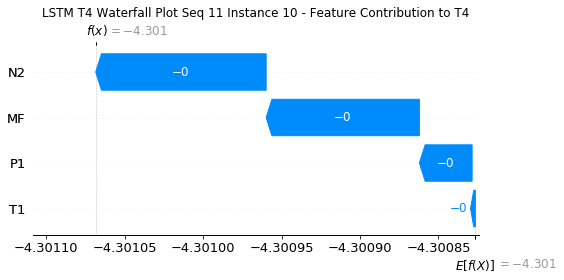

None

Contribution: [-3.53887208e-05 -2.71920786e-06 -1.13523706e-04 -1.01979695e-04]


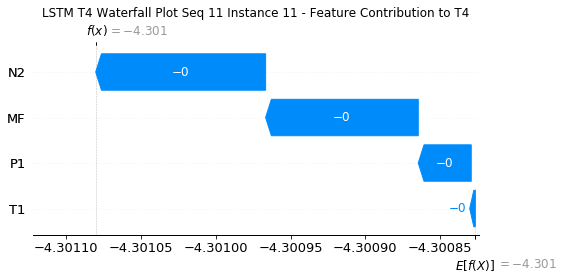

None

Contribution: [-3.57811246e-05  6.33829336e-06 -1.19543464e-04 -1.07711482e-04]


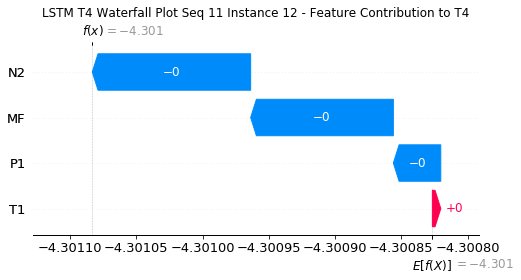

None

Contribution: [-4.02923355e-05 -4.71818732e-06 -1.30211986e-04 -1.17178508e-04]


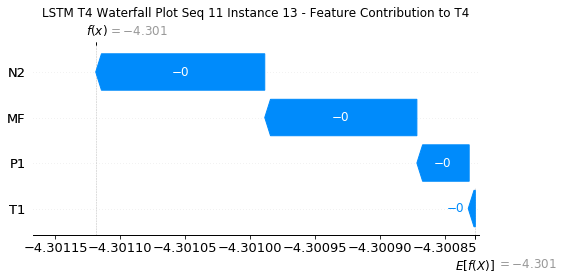

None

Contribution: [-4.43141241e-05  2.52345684e-06 -1.47493961e-04 -1.34164807e-04]


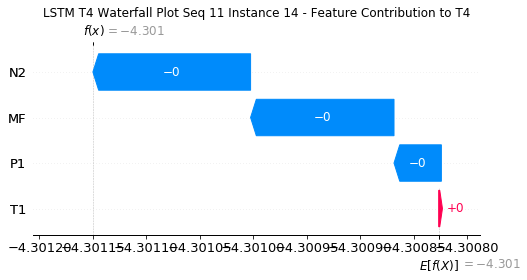

None

Contribution: [-5.14959048e-05 -1.05567499e-05 -1.67678635e-04 -1.51384936e-04]


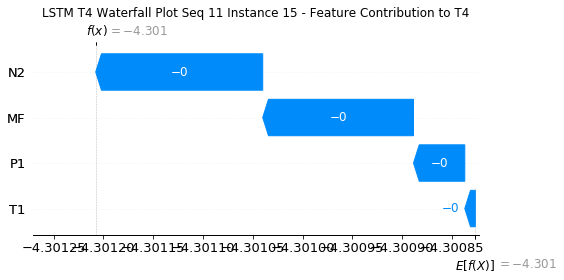

None

Contribution: [-5.24940899e-05 -1.34817091e-05 -1.69695189e-04 -1.53654093e-04]


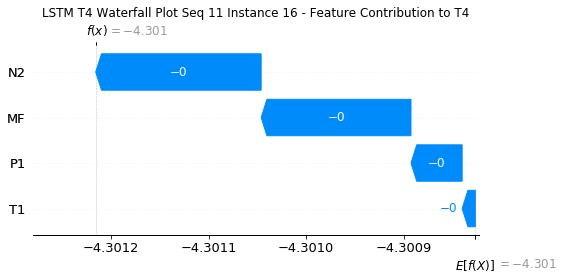

None

Contribution: [-3.43674793e-05 -6.92946971e-06 -1.08005791e-04 -9.93417252e-05]


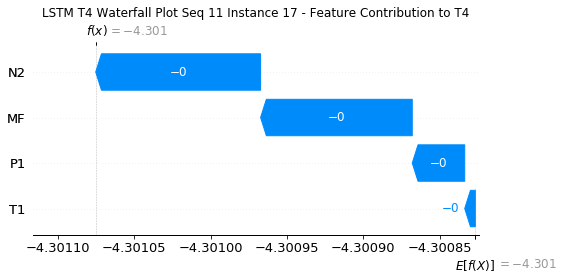

None

Contribution: [1.57199052e-05 2.56607174e-05 5.84470128e-05 6.00592988e-05]


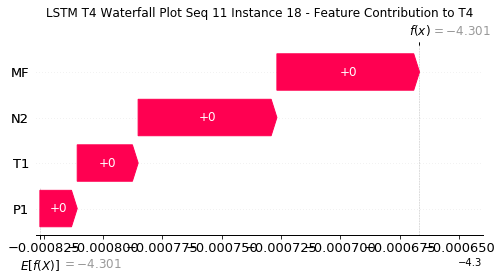

None

Contribution: [7.35697798e-05 6.69124296e-05 2.49696589e-04 2.41983660e-04]


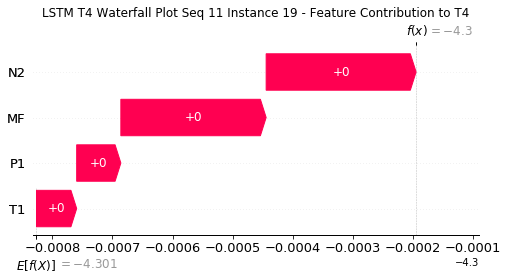

None

Contribution: [3.11771104e-05 4.85364068e-05 1.07076902e-04 1.16857672e-04]


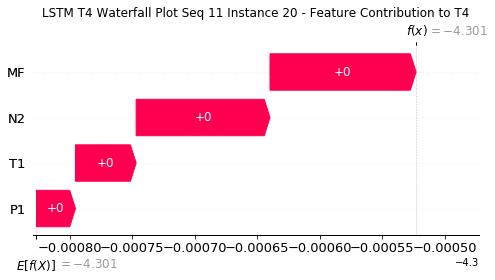

None

Contribution: [-3.10966316e-04 -8.92323607e-05 -1.05206392e-03 -9.60611959e-04]


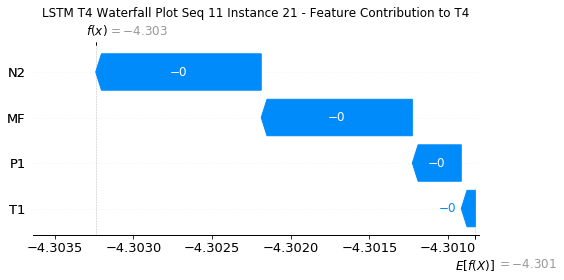

None

Contribution: [-0.00111599 -0.00022426 -0.00373698 -0.00348977]


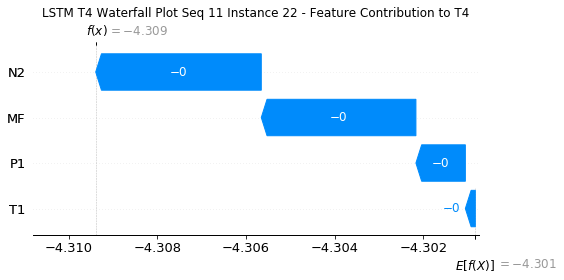

None

Contribution: [-0.00244682 -0.00081975 -0.00768277 -0.00768778]


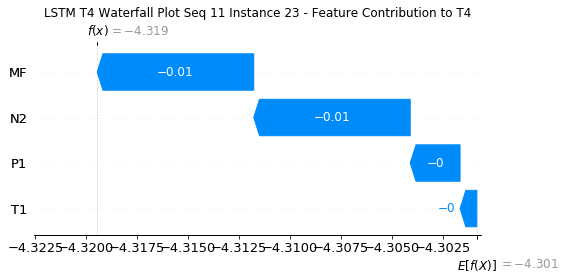

None

Contribution: [-0.00198096  0.00124571 -0.0054913  -0.00676729]


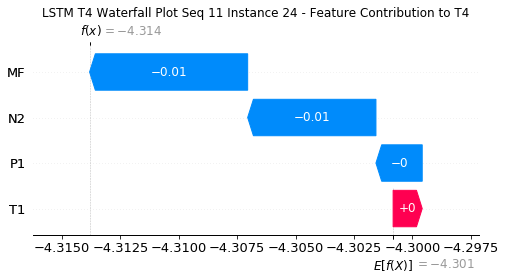

None

Contribution: [-0.00194453 -0.0012532  -0.00633482 -0.00601022]


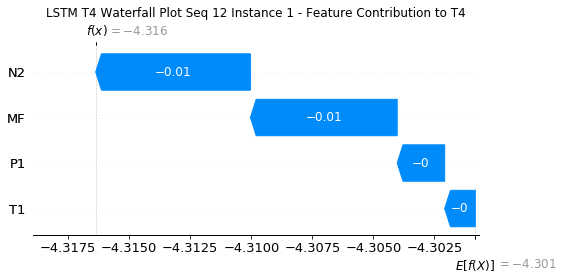

None

Contribution: [ 2.49475353e-04 -6.51769022e-05  8.08221893e-04  8.31237005e-04]


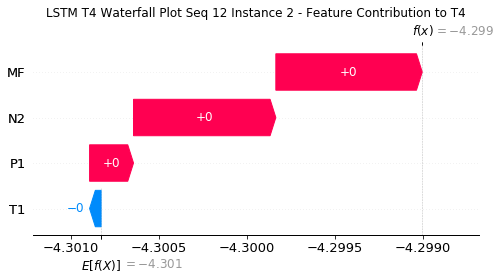

None

Contribution: [-8.22658334e-06  9.18774937e-07 -1.56126375e-05 -1.66192477e-05]


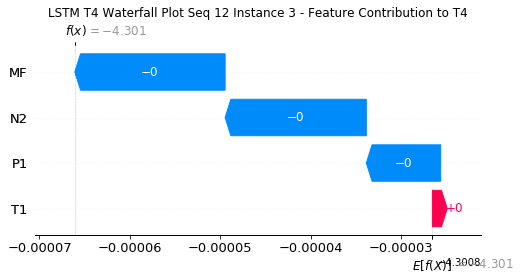

None

Contribution: [-1.71314626e-05 -9.37875439e-06 -4.99457384e-05 -4.20735565e-05]


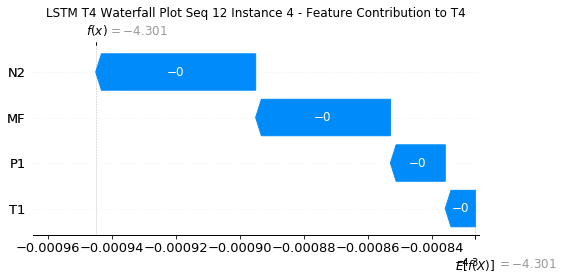

None

Contribution: [-2.66575543e-05 -1.89623376e-05 -8.78559298e-05 -7.38421911e-05]


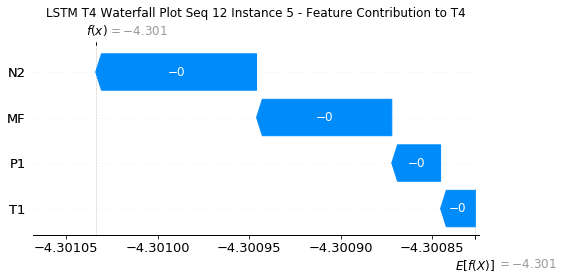

None

Contribution: [-3.17185912e-05 -2.15686353e-05 -9.76752226e-05 -8.46314560e-05]


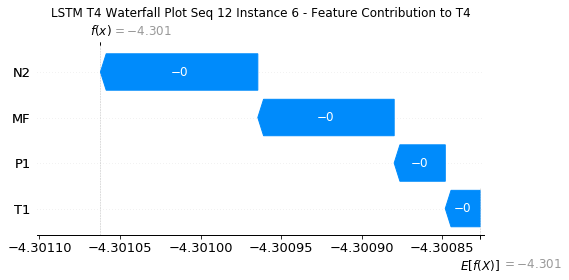

None

Contribution: [-3.29072496e-05 -2.18106123e-05 -9.81375084e-05 -8.92813143e-05]


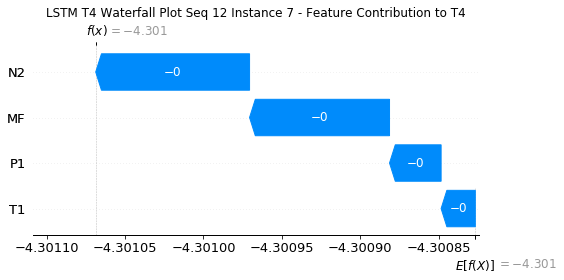

None

Contribution: [-3.16596641e-05 -1.97146089e-05 -9.65725350e-05 -8.45666605e-05]


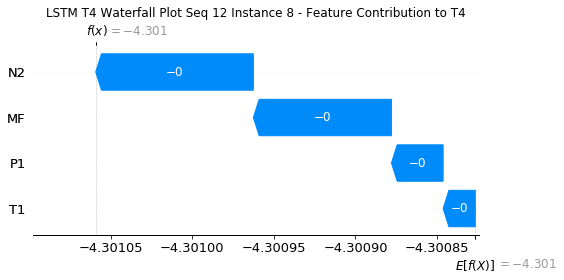

None

Contribution: [-3.26398916e-05 -2.15520359e-05 -1.00458841e-04 -9.03794128e-05]


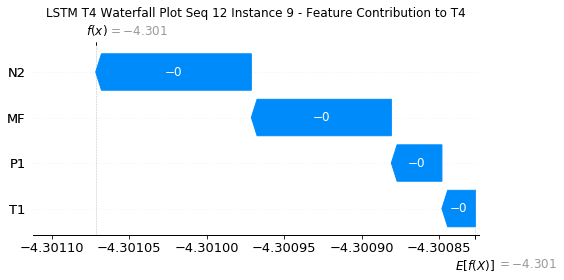

None

Contribution: [-3.46260671e-05 -2.37834122e-05 -1.05828204e-04 -9.53635397e-05]


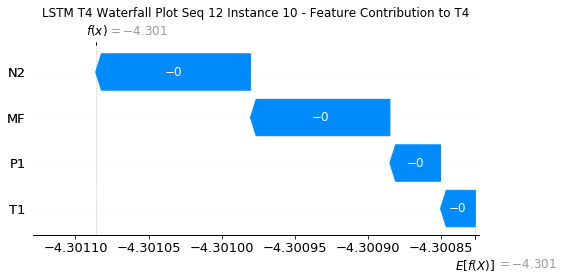

None

Contribution: [-3.67232388e-05 -2.49772125e-05 -1.10868927e-04 -1.00434986e-04]


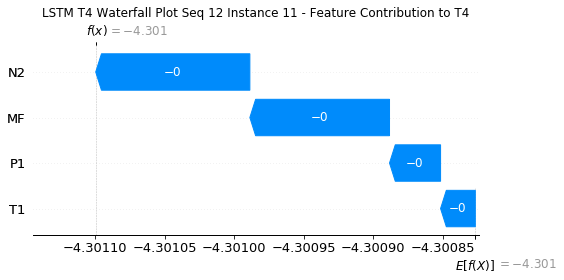

None

Contribution: [-3.62873353e-05 -2.56297013e-05 -1.15667749e-04 -1.02208049e-04]


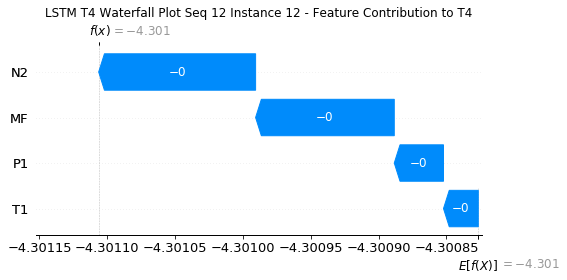

None

Contribution: [-4.17365913e-05 -2.93175172e-05 -1.27258707e-04 -1.16382019e-04]


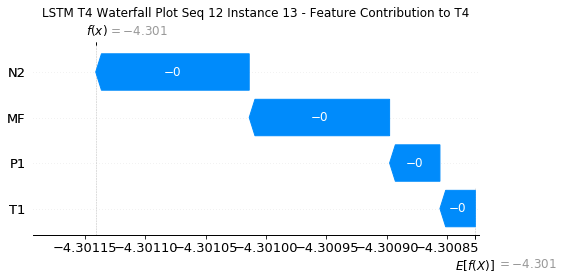

None

Contribution: [-4.81250215e-05 -3.44588398e-05 -1.44768329e-04 -1.38044553e-04]


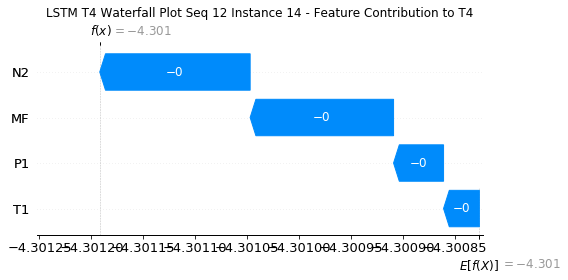

None

Contribution: [-5.34868708e-05 -3.86786889e-05 -1.64154319e-04 -1.52103712e-04]


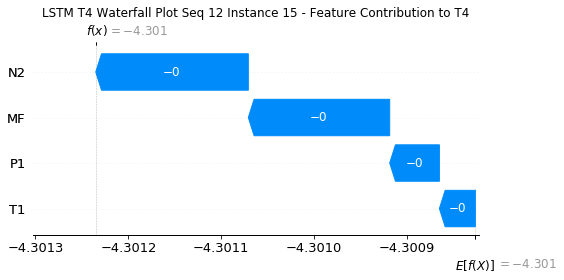

None

Contribution: [-5.43685531e-05 -3.91302584e-05 -1.67007466e-04 -1.54670480e-04]


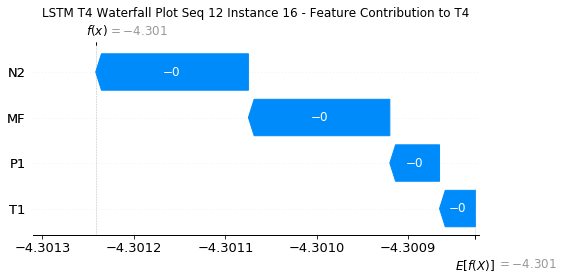

None

Contribution: [-3.51533284e-05 -2.15034509e-05 -1.08786788e-04 -9.76419454e-05]


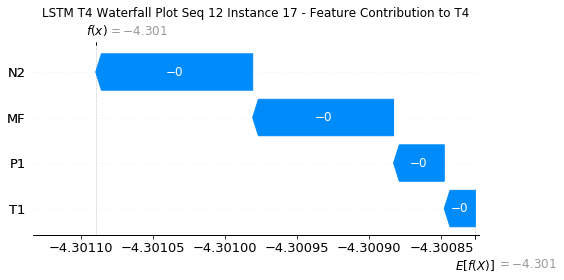

None

Contribution: [1.17716147e-05 1.87633365e-05 4.71830521e-05 4.84024443e-05]


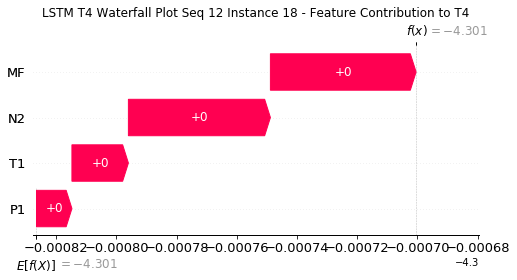

None

Contribution: [6.96621372e-05 6.83521552e-05 2.34851965e-04 2.29492095e-04]


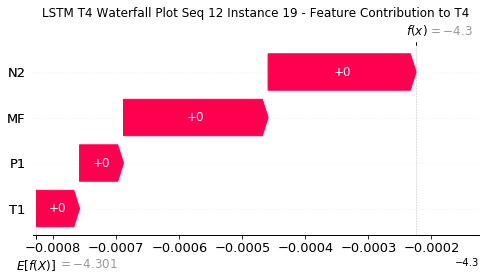

None

Contribution: [3.00007773e-05 3.39731874e-05 1.08209862e-04 1.14224892e-04]


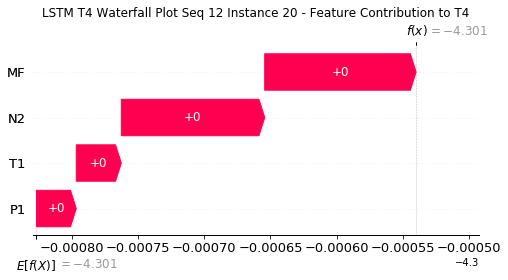

None

Contribution: [-0.00031253 -0.00024196 -0.00100684 -0.00095246]


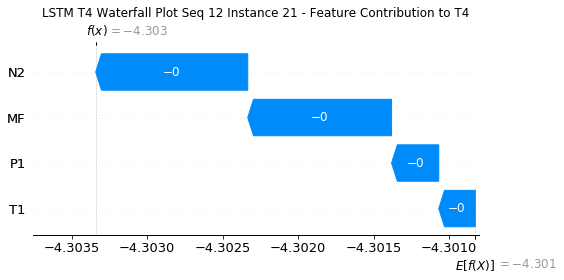

None

Contribution: [-0.00113452 -0.0007137  -0.0036397  -0.00354644]


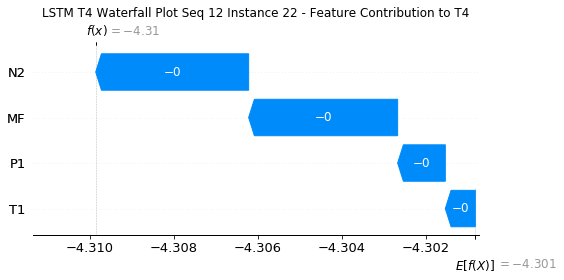

None

Contribution: [-0.00236549 -0.00133322 -0.00749682 -0.00744721]


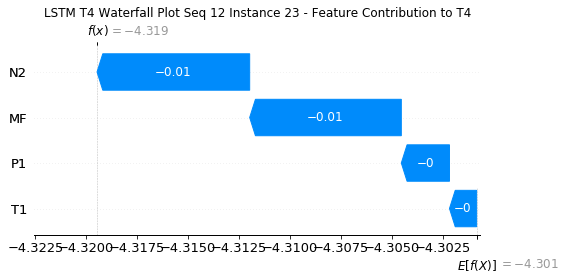

None

Contribution: [-0.00189044  0.00016166 -0.00537194 -0.00632447]


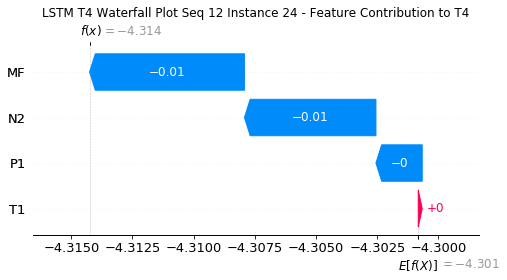

None

Contribution: [-0.00195938 -0.00171764 -0.00626654 -0.00602813]


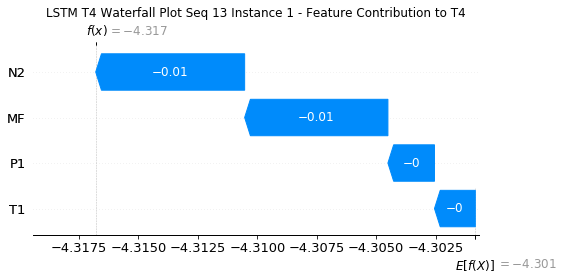

None

Contribution: [2.73636161e-04 1.27827796e-06 7.95637970e-04 8.99249431e-04]


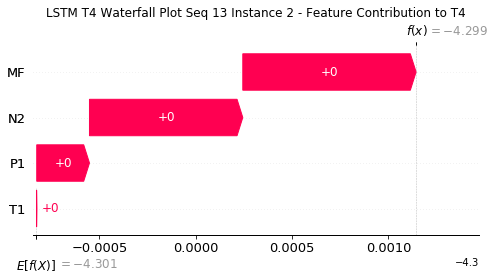

None

Contribution: [-7.86648571e-06 -1.32643982e-09 -1.61652095e-05 -1.97312361e-05]


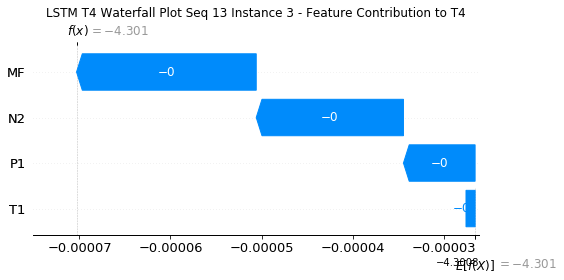

None

Contribution: [-1.74174147e-05 -9.54628222e-06 -5.16496113e-05 -4.57892538e-05]


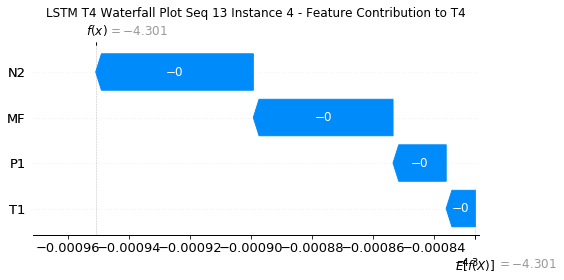

None

Contribution: [-3.03192583e-05 -1.97440789e-05 -9.08861442e-05 -8.05732490e-05]


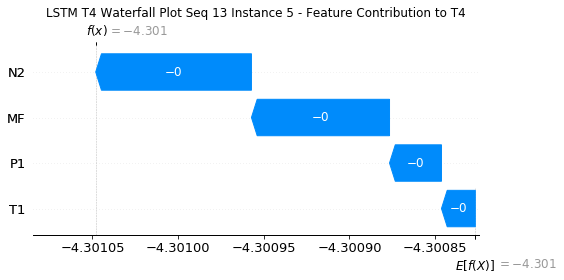

None

Contribution: [-3.16886454e-05 -2.09193151e-05 -9.92753228e-05 -8.78657263e-05]


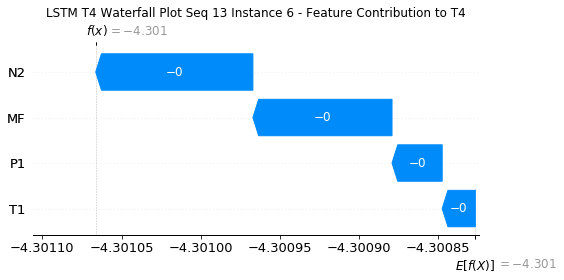

None

Contribution: [-2.88611724e-05 -1.79210790e-05 -9.62345193e-05 -8.24315686e-05]


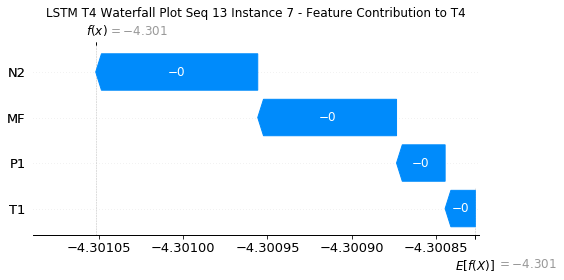

None

Contribution: [-2.95527686e-05 -1.57923986e-05 -9.58030643e-05 -8.43790622e-05]


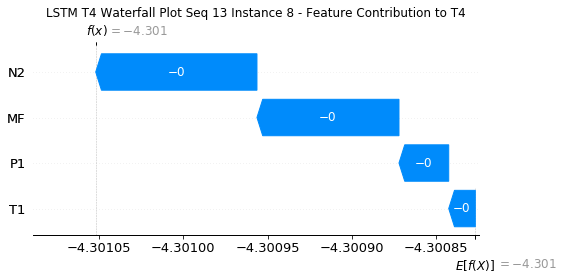

None

Contribution: [-3.11355047e-05 -1.82812431e-05 -9.94746798e-05 -8.86640007e-05]


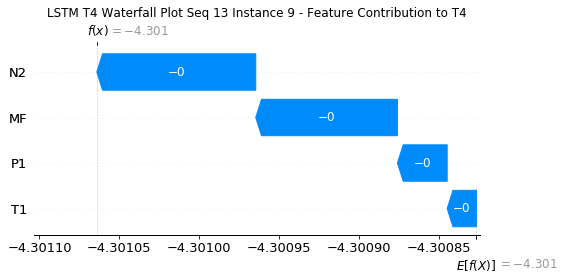

None

Contribution: [-3.49473644e-05 -2.00966224e-05 -1.06677240e-04 -9.82485822e-05]


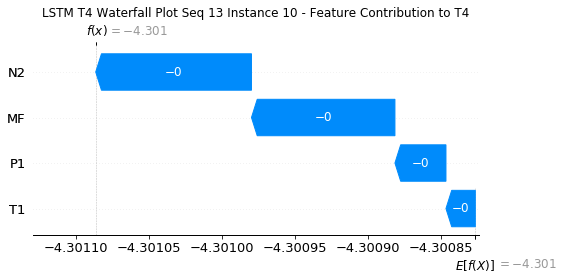

None

Contribution: [-3.66221043e-05 -2.12768954e-05 -1.12244001e-04 -1.02788962e-04]


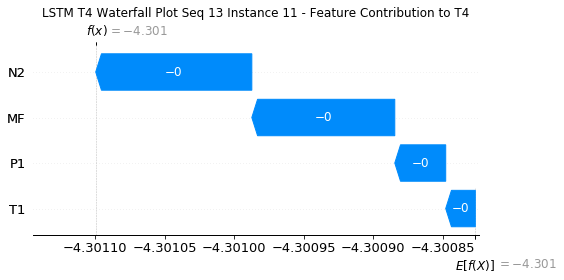

None

Contribution: [-3.90414154e-05 -2.27534801e-05 -1.19338401e-04 -1.10695857e-04]


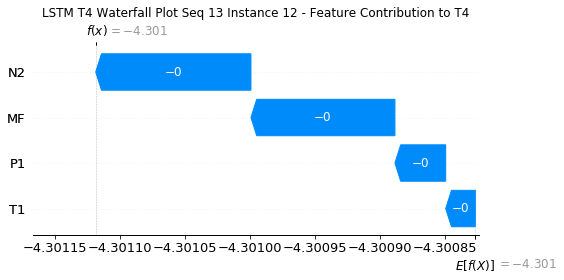

None

Contribution: [-4.19271952e-05 -2.51014632e-05 -1.28845309e-04 -1.18608801e-04]


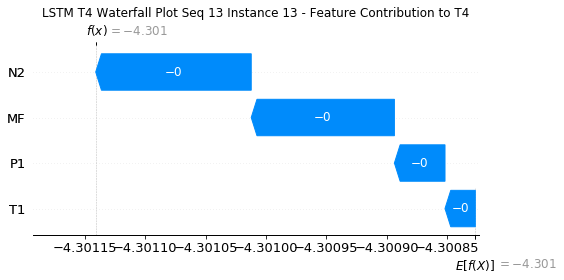

None

Contribution: [-4.49968717e-05 -2.69512106e-05 -1.44195478e-04 -1.30131842e-04]


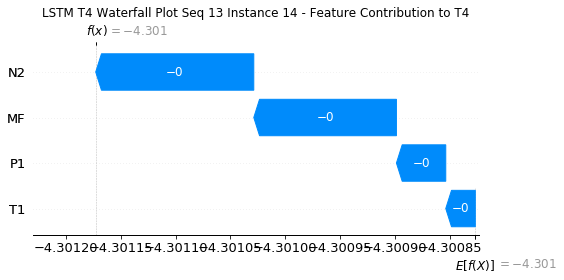

None

Contribution: [-5.27470719e-05 -3.27470799e-05 -1.64945241e-04 -1.51947915e-04]


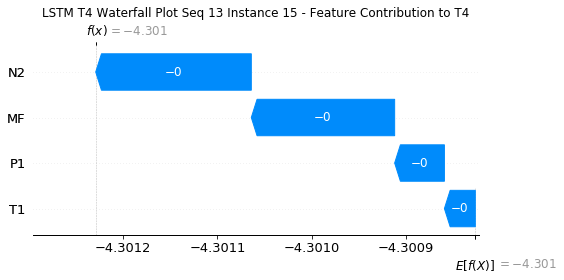

None

Contribution: [-5.37030743e-05 -3.34980668e-05 -1.68147194e-04 -1.55281224e-04]


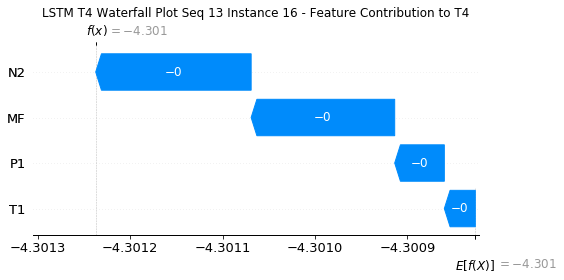

None

Contribution: [-3.54796093e-05 -2.19606819e-05 -1.10448713e-04 -1.00640160e-04]


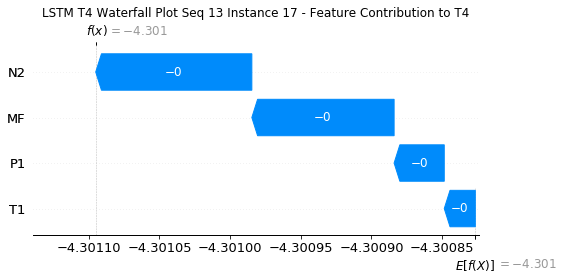

None

Contribution: [1.26666626e-05 2.00663235e-05 4.83824957e-05 5.02721240e-05]


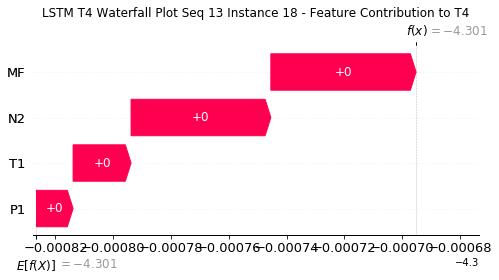

None

Contribution: [6.96026232e-05 6.73875051e-05 2.36303932e-04 2.30000126e-04]


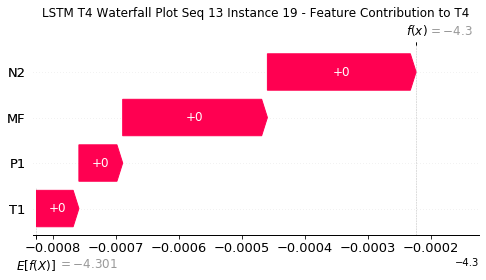

None

Contribution: [3.06739057e-05 3.64814189e-05 1.06325060e-04 1.14310587e-04]


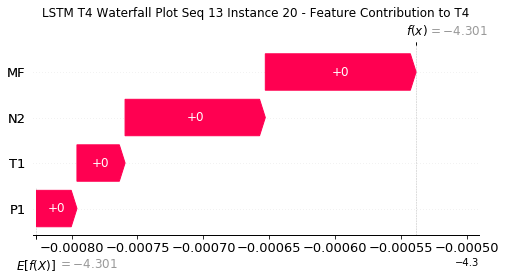

None

Contribution: [-0.00030978 -0.00020709 -0.00101919 -0.0009553 ]


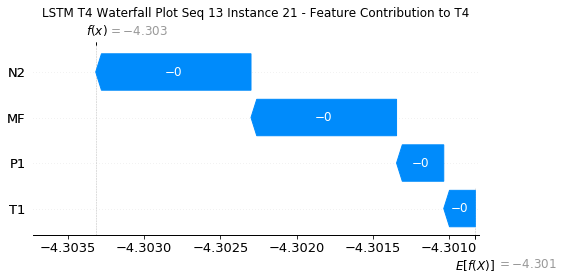

None

Contribution: [-0.00111514 -0.00063886 -0.00367748 -0.00352505]


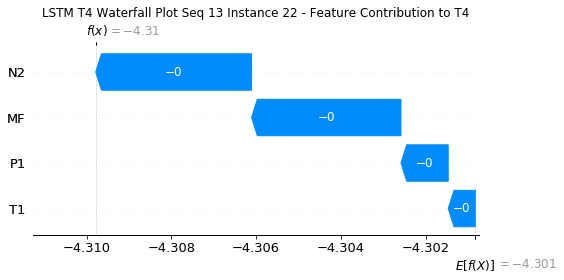

None

Contribution: [-0.0021393  -0.00137715 -0.00753818 -0.00736426]


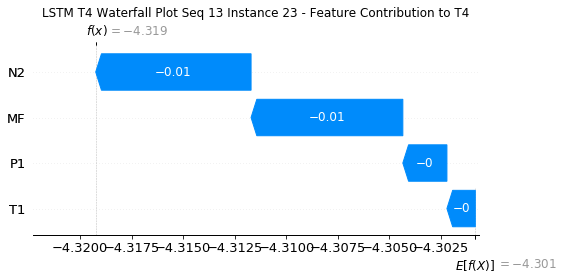

None

Contribution: [-0.00153753  0.00085481 -0.00538602 -0.00635003]


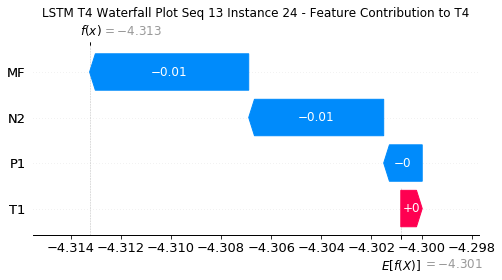

None

Contribution: [-0.00179972 -0.00158547 -0.00622663 -0.00581853]


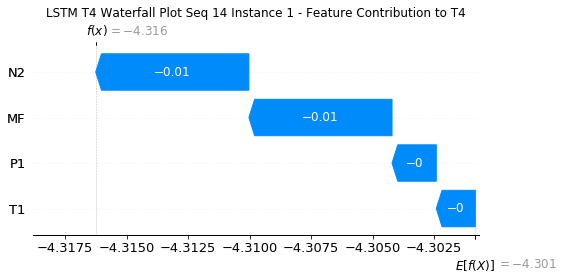

None

Contribution: [ 2.11752222e-04 -3.77692798e-05  7.89496155e-04  7.78665556e-04]


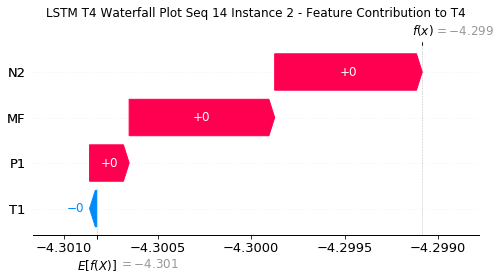

None

Contribution: [-7.25286275e-06  1.07977060e-06 -1.63772329e-05 -1.84237912e-05]


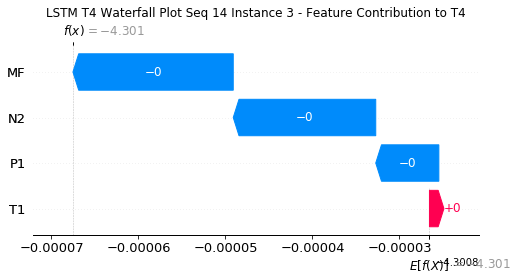

None

Contribution: [-1.63175777e-05 -9.58529421e-06 -5.05478198e-05 -4.35910968e-05]


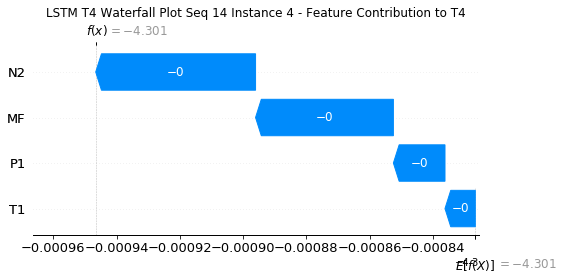

None

Contribution: [-2.66294017e-05 -1.39708288e-05 -8.73881403e-05 -7.42280496e-05]


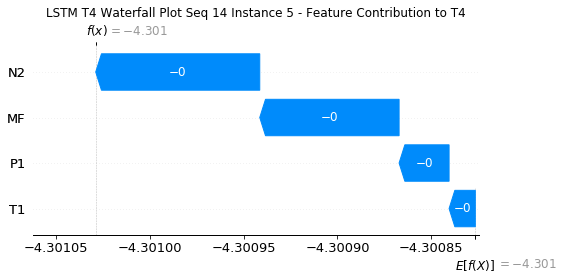

None

Contribution: [-3.01973495e-05 -2.16746469e-05 -9.74039277e-05 -8.50208954e-05]


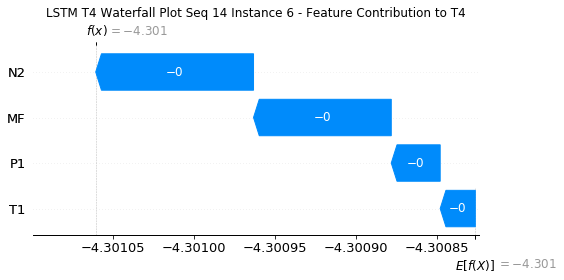

None

Contribution: [-2.90017846e-05 -2.13780137e-05 -9.62266774e-05 -8.36151275e-05]


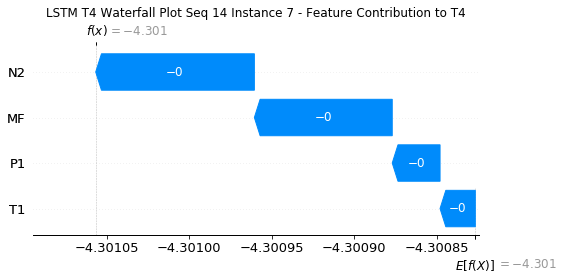

None

Contribution: [-2.91284412e-05 -2.36116748e-05 -9.64201998e-05 -8.46103666e-05]


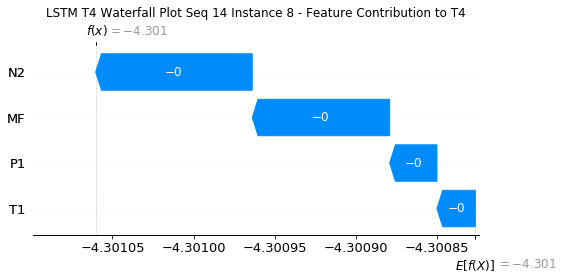

None

Contribution: [-3.06872564e-05 -2.48168289e-05 -1.00084383e-04 -8.93166595e-05]


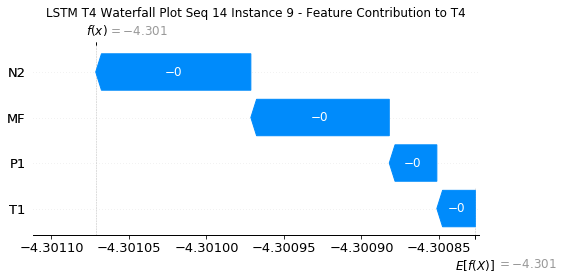

None

Contribution: [-3.25069168e-05 -2.41542057e-05 -1.05491727e-04 -9.41561140e-05]


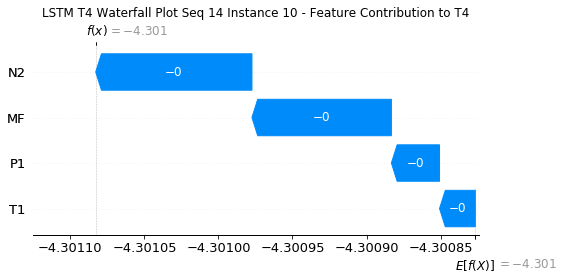

None

Contribution: [-3.43490353e-05 -2.51421151e-05 -1.10962055e-04 -9.90325085e-05]


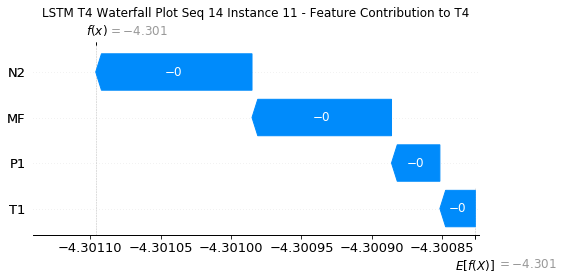

None

Contribution: [-3.58657535e-05 -2.74344337e-05 -1.18431956e-04 -1.07565990e-04]


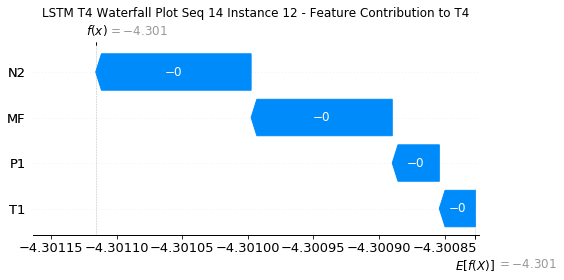

None

Contribution: [-3.93425856e-05 -3.01306040e-05 -1.27539239e-04 -1.14786811e-04]


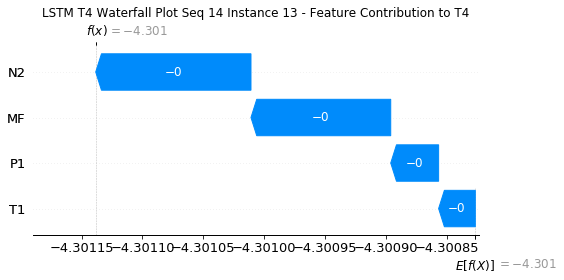

None

Contribution: [-4.25649258e-05 -3.18048155e-05 -1.43493485e-04 -1.30077666e-04]


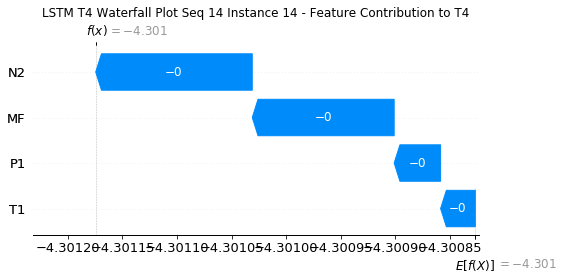

None

Contribution: [-5.00118236e-05 -3.91913065e-05 -1.63666421e-04 -1.48830390e-04]


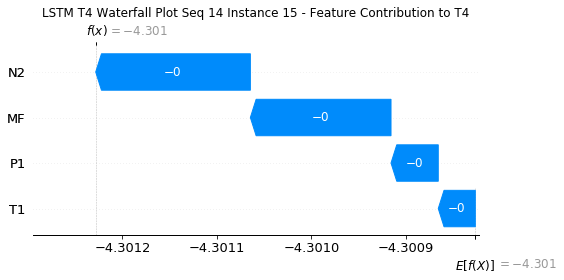

None

Contribution: [-5.12831665e-05 -4.06134960e-05 -1.67241477e-04 -1.53342950e-04]


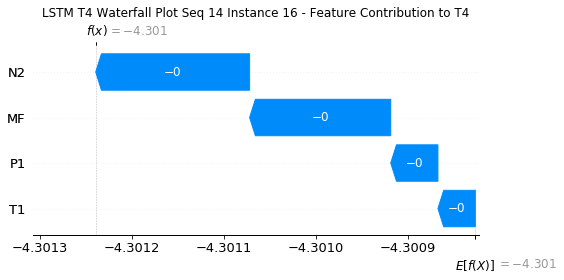

None

Contribution: [-3.39008802e-05 -2.10830351e-05 -1.10649167e-04 -1.00815011e-04]


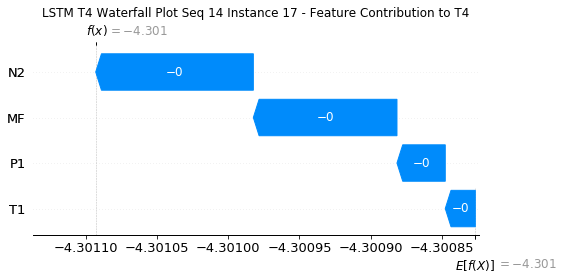

None

Contribution: [1.17689494e-05 1.75203992e-05 4.44464164e-05 4.63020337e-05]


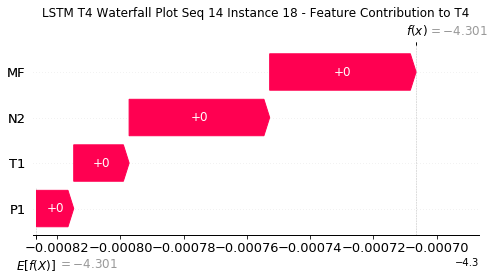

None

Contribution: [6.77192484e-05 6.81376173e-05 2.31262809e-04 2.25447562e-04]


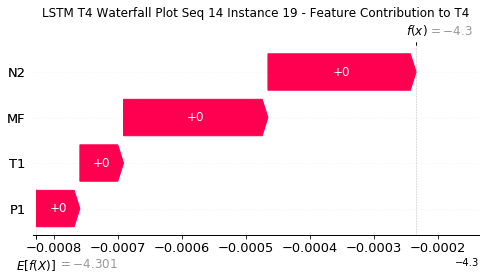

None

Contribution: [3.22365169e-05 3.12125891e-05 1.08692895e-04 1.16031251e-04]


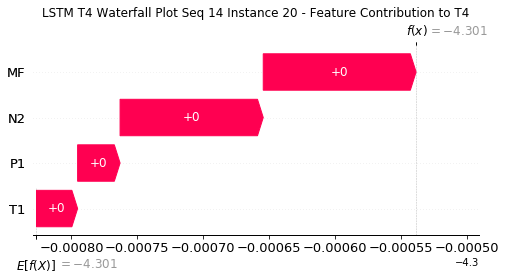

None

Contribution: [-0.00028928 -0.00027218 -0.00099504 -0.00093281]


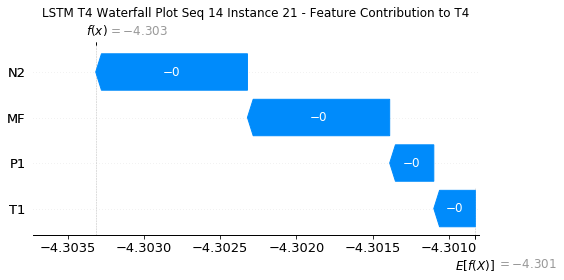

None

Contribution: [-0.00106399 -0.00088513 -0.00363425 -0.003532  ]


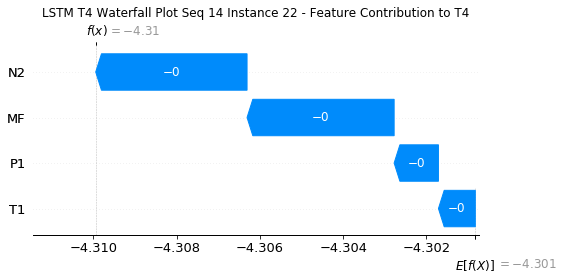

None

Contribution: [-0.00226193 -0.00208238 -0.00752484 -0.00770971]


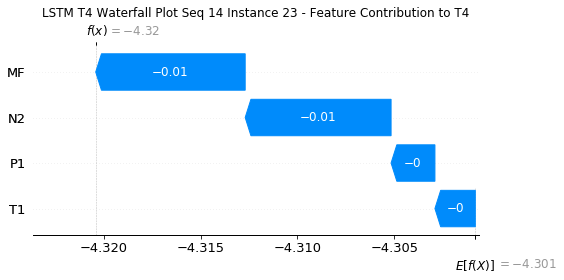

None

Contribution: [-0.00163525 -0.00086927 -0.00534915 -0.006394  ]


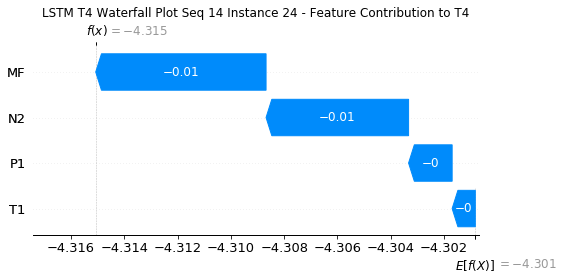

None

Contribution: [-0.0018475  -0.00206318 -0.00623945 -0.00583763]


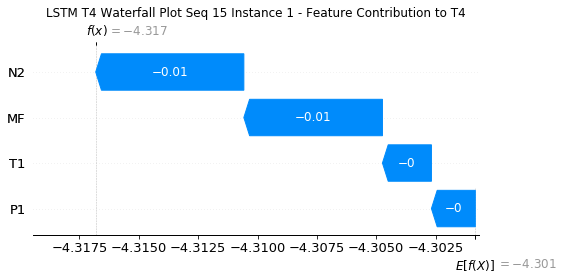

None

Contribution: [0.00024095 0.00011345 0.00079098 0.00085177]


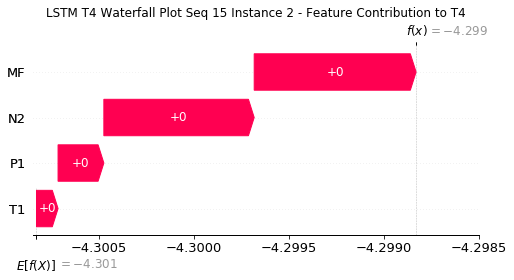

None

Contribution: [-6.14530548e-06 -7.62151616e-06 -1.53740142e-05 -1.62078596e-05]


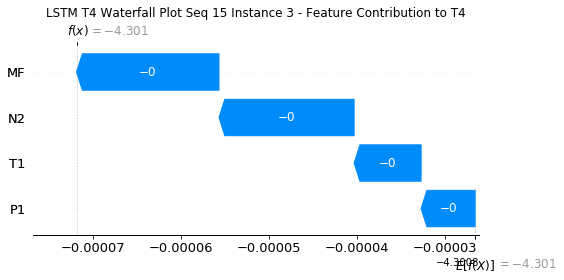

None

Contribution: [-1.60443864e-05 -1.50437600e-05 -5.11066240e-05 -4.31319824e-05]


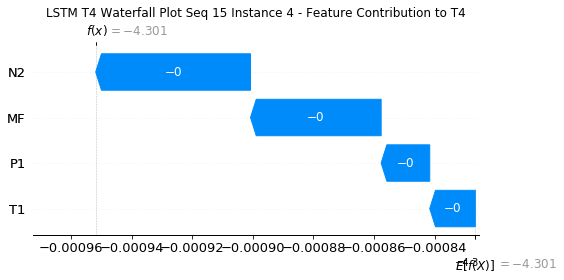

None

Contribution: [-2.79134042e-05 -2.67761036e-05 -8.98472693e-05 -7.73353304e-05]


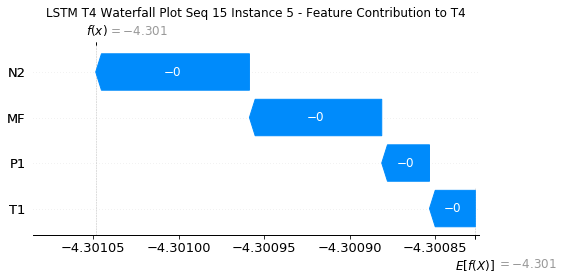

None

Contribution: [-3.00675519e-05 -2.75507991e-05 -9.84660206e-05 -8.49126814e-05]


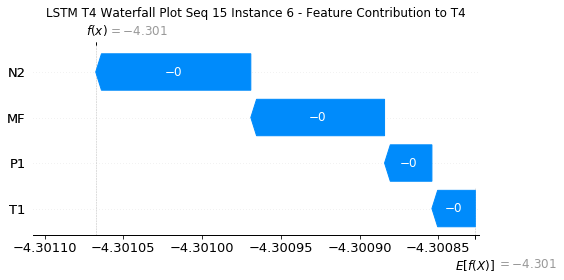

None

Contribution: [-2.81726175e-05 -2.44091316e-05 -9.66235989e-05 -8.30846241e-05]


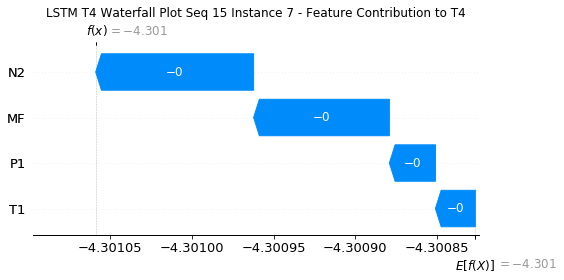

None

Contribution: [-3.02122936e-05 -2.45745788e-05 -9.71530466e-05 -8.61911491e-05]


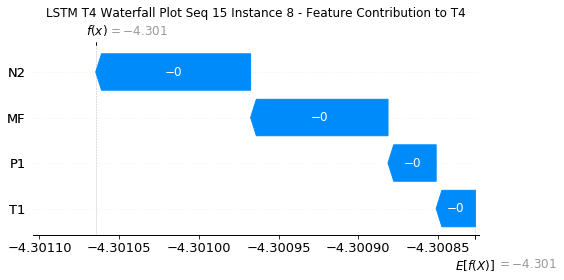

None

Contribution: [-3.03291265e-05 -2.61969936e-05 -1.00022038e-04 -8.75617065e-05]


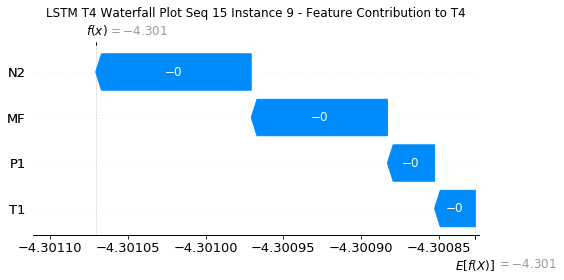

None

Contribution: [-3.27943965e-05 -2.61125479e-05 -1.06268824e-04 -9.49746942e-05]


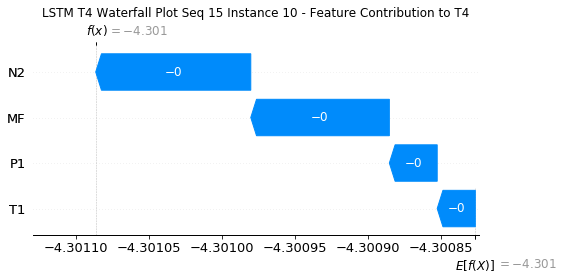

None

Contribution: [-3.45150119e-05 -2.70277474e-05 -1.11719360e-04 -9.98575181e-05]


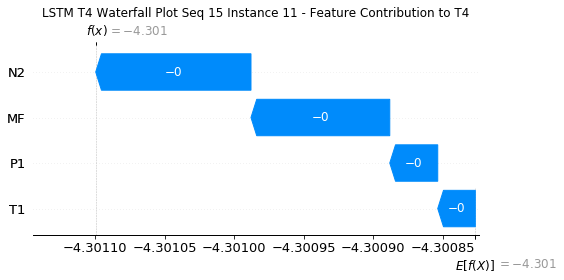

None

Contribution: [-3.66217439e-05 -2.90200372e-05 -1.19066076e-04 -1.07625933e-04]


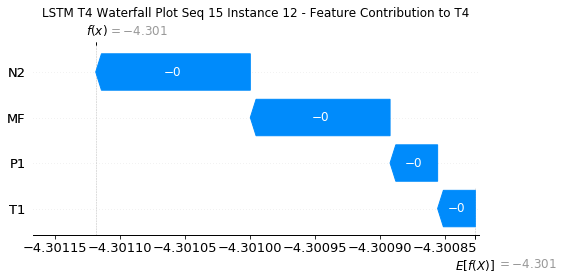

None

Contribution: [-3.97566772e-05 -3.06219113e-05 -1.28335765e-04 -1.15731619e-04]


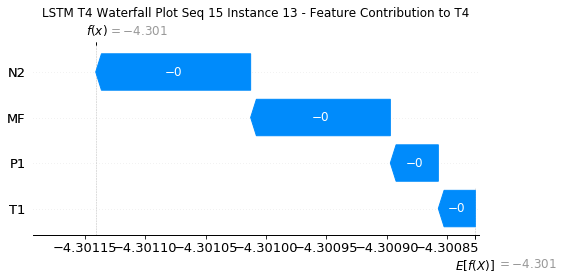

None

Contribution: [-4.45008066e-05 -3.16538088e-05 -1.44894359e-04 -1.31969500e-04]


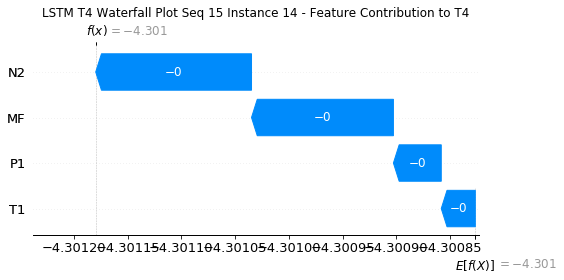

None

Contribution: [-5.06065771e-05 -3.85186977e-05 -1.64466700e-04 -1.49660428e-04]


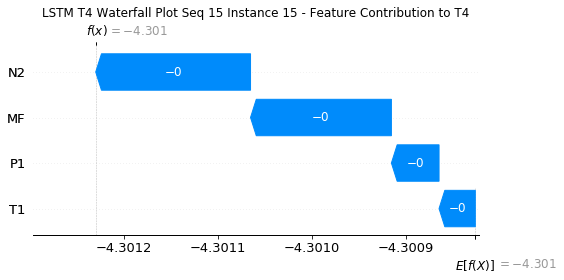

None

Contribution: [-5.17308723e-05 -3.94340846e-05 -1.67533693e-04 -1.52888077e-04]


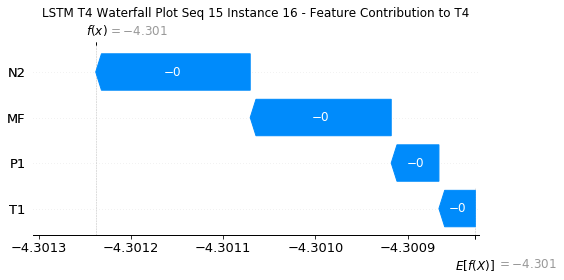

None

Contribution: [-3.41935393e-05 -2.25757432e-05 -1.09925421e-04 -9.86671772e-05]


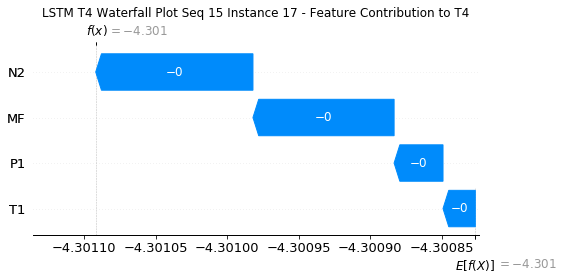

None

Contribution: [1.25080293e-05 1.86172145e-05 4.69355332e-05 4.89429607e-05]


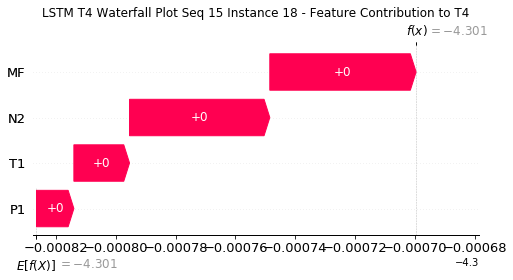

None

Contribution: [6.84536504e-05 6.80755275e-05 2.33536955e-04 2.27221991e-04]


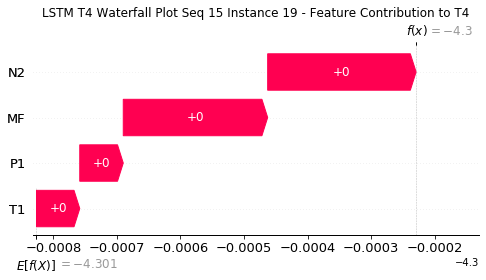

None

Contribution: [3.10182746e-05 3.28326771e-05 1.04552400e-04 1.12974606e-04]


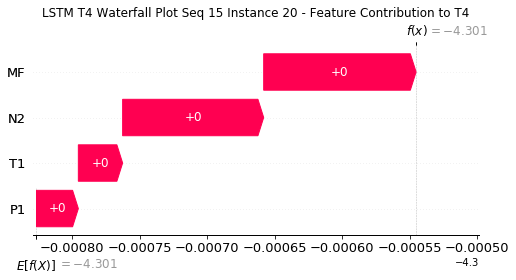

None

Contribution: [-0.00029872 -0.00024135 -0.00101588 -0.00094284]


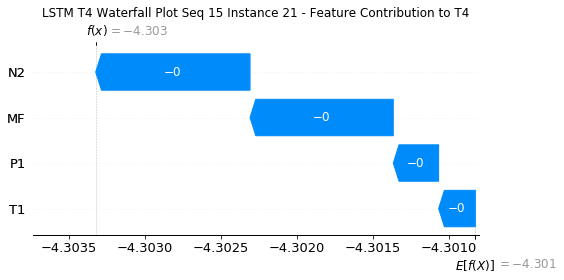

None

Contribution: [-0.00107609 -0.00072051 -0.00366452 -0.00347507]


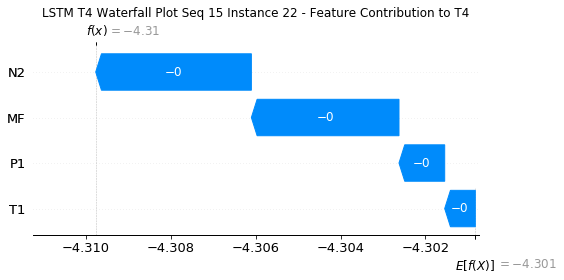

None

Contribution: [-0.00211579 -0.00128862 -0.00754373 -0.00731014]


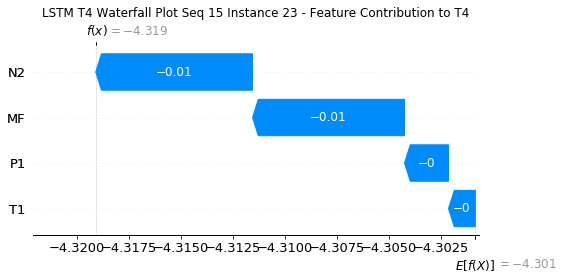

None

Contribution: [-1.61339583e-03  3.21877662e-05 -5.42872568e-03 -6.58749952e-03]


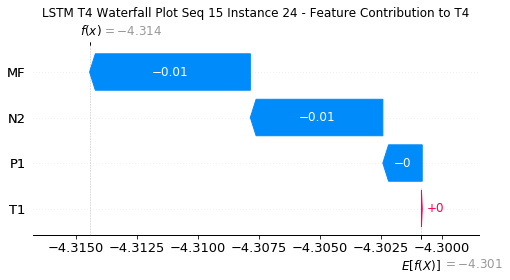

None

Contribution: [-0.00185    -0.00168095 -0.00628248 -0.0059913 ]


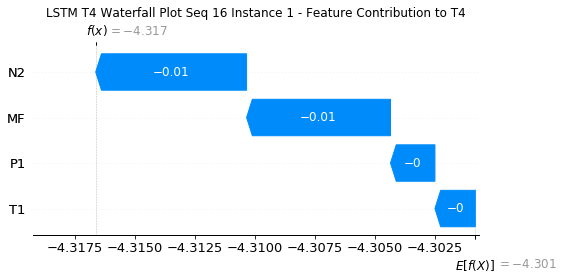

None

Contribution: [2.60603713e-04 2.03438797e-05 8.06929687e-04 8.69622663e-04]


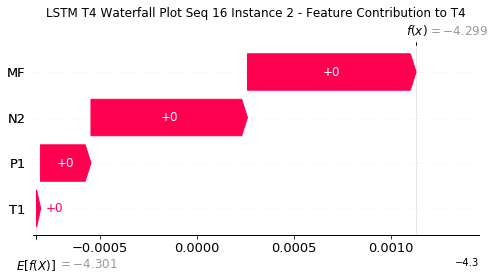

None

Contribution: [-5.52671993e-06 -2.32265924e-06 -1.55074278e-05 -1.63990012e-05]


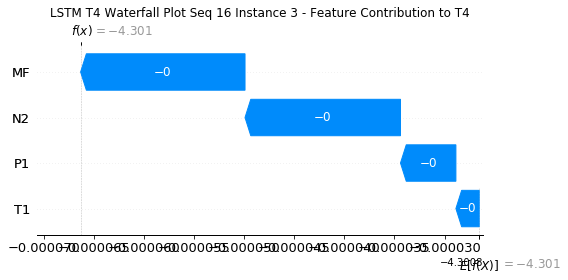

None

Contribution: [-1.55076636e-05 -1.17392729e-05 -5.06596670e-05 -4.28229896e-05]


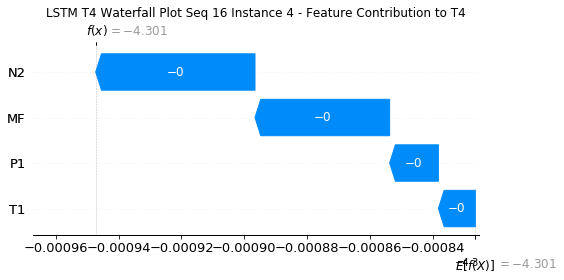

None

Contribution: [-2.76051097e-05 -2.23502940e-05 -8.93204345e-05 -7.73010366e-05]


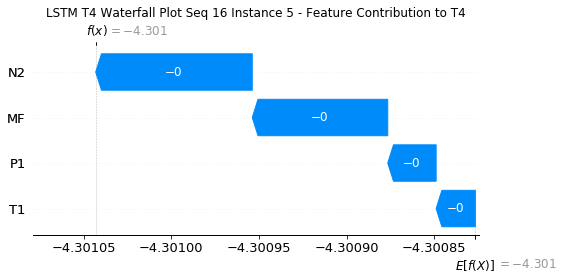

None

Contribution: [-2.95733542e-05 -2.40790442e-05 -9.80479261e-05 -8.47709378e-05]


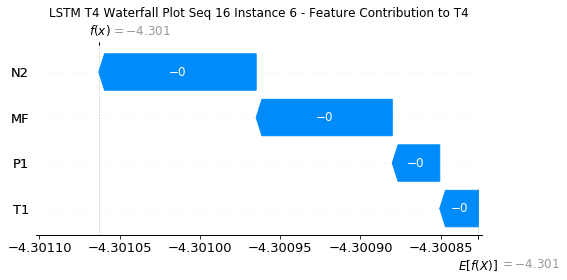

None

Contribution: [-2.88303186e-05 -2.25788905e-05 -9.69181273e-05 -8.50959134e-05]


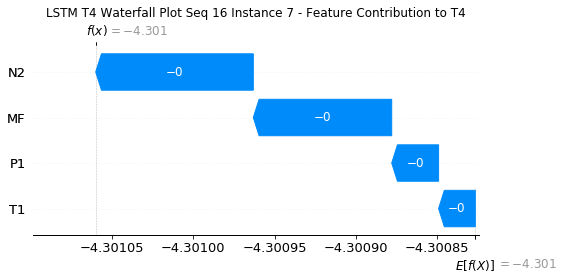

None

Contribution: [-2.88224533e-05 -2.43145229e-05 -9.64252051e-05 -8.40874534e-05]


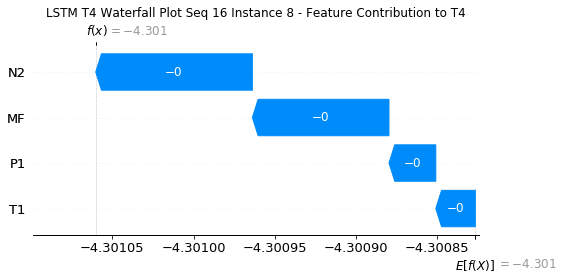

None

Contribution: [-3.08567597e-05 -2.37484052e-05 -1.00356503e-04 -8.97374527e-05]


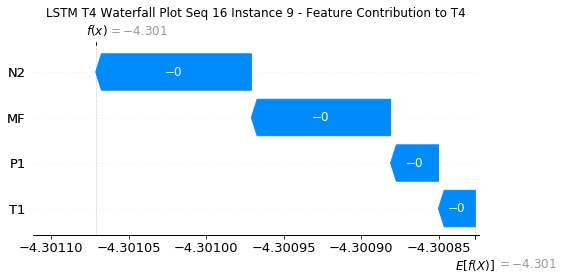

None

Contribution: [-3.27986845e-05 -2.56713062e-05 -1.06140160e-04 -9.51127009e-05]


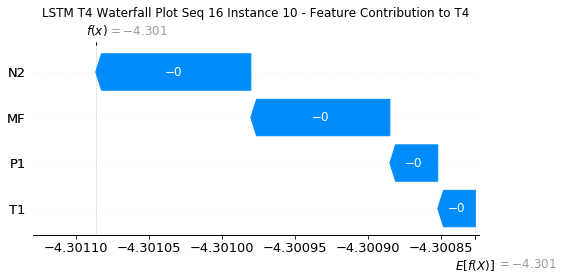

None

Contribution: [-3.44617286e-05 -2.67705583e-05 -1.11490185e-04 -9.98760335e-05]


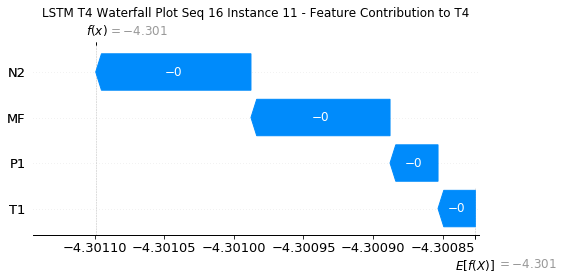

None

Contribution: [-3.64138276e-05 -3.06003191e-05 -1.18300263e-04 -1.05435993e-04]


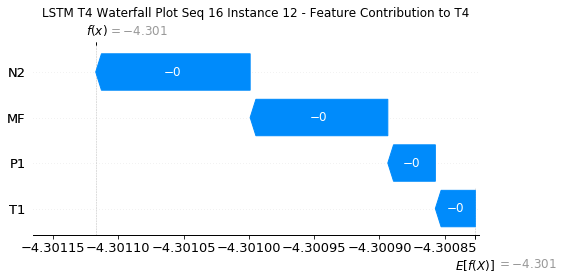

None

Contribution: [-3.97552595e-05 -3.11587796e-05 -1.28170888e-04 -1.16017191e-04]


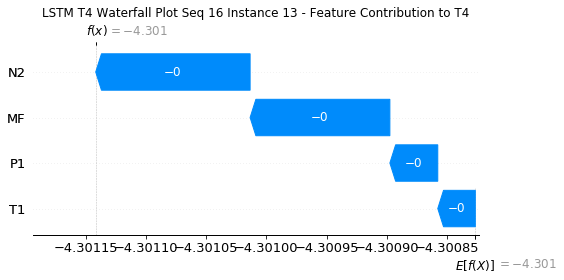

None

Contribution: [-4.45390167e-05 -3.50883853e-05 -1.44321015e-04 -1.30477598e-04]


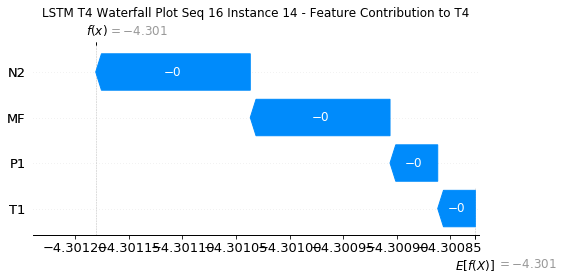

None

Contribution: [-5.06974290e-05 -3.99717396e-05 -1.64636775e-04 -1.50606130e-04]


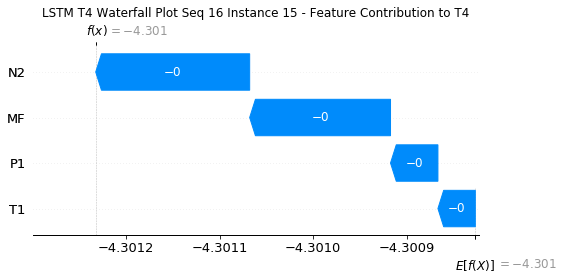

None

Contribution: [-5.16569638e-05 -4.06378584e-05 -1.67762027e-04 -1.53677339e-04]


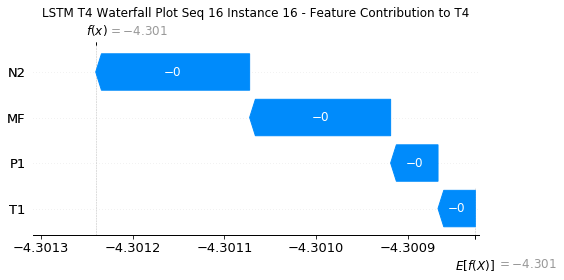

None

Contribution: [-3.43351052e-05 -2.25843231e-05 -1.10239008e-04 -9.88816676e-05]


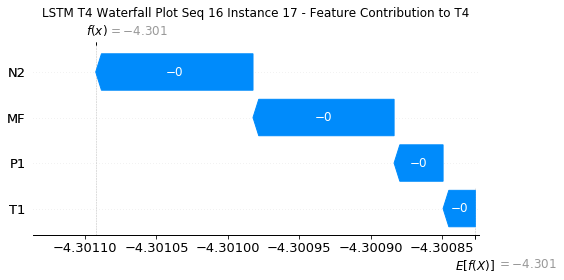

None

Contribution: [1.24768455e-05 1.83037000e-05 4.64726015e-05 4.83232487e-05]


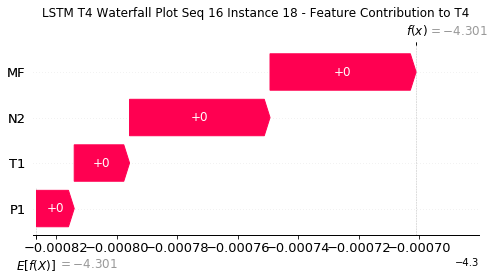

None

Contribution: [6.84004883e-05 6.84260745e-05 2.33841285e-04 2.27692519e-04]


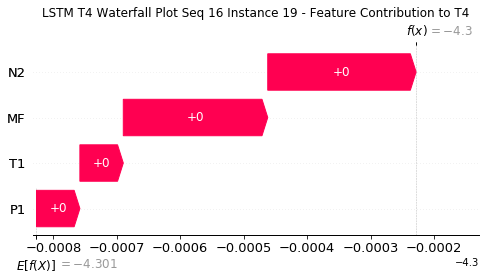

None

Contribution: [3.21328171e-05 3.25651914e-05 1.07089379e-04 1.14933156e-04]


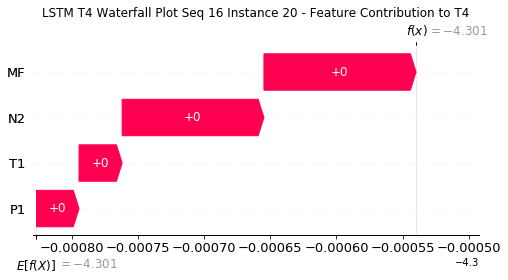

None

Contribution: [-0.00029396 -0.00025454 -0.00100954 -0.00094076]


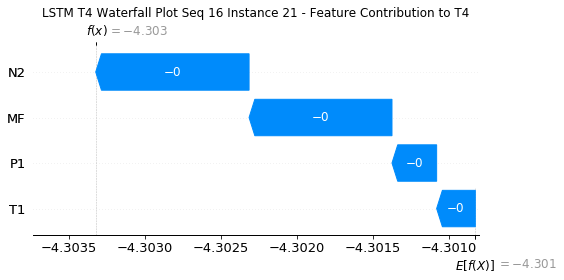

None

Contribution: [-0.00106114 -0.00081942 -0.00365908 -0.00348778]


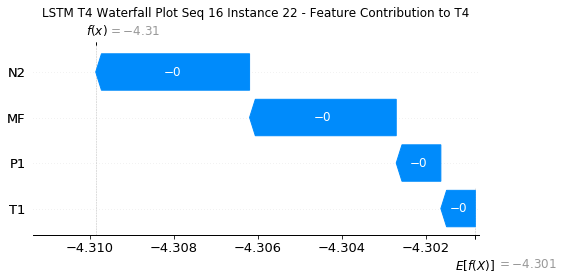

None

Contribution: [-0.00221132 -0.00178299 -0.00753445 -0.00722982]


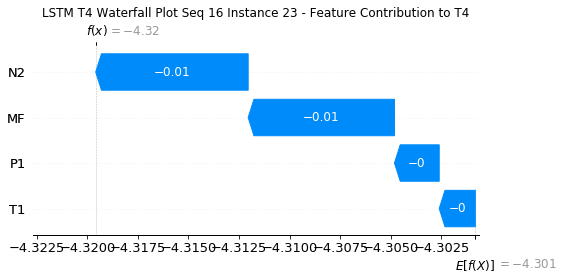

None

Contribution: [-0.0016413   0.00033192 -0.00537691 -0.00636351]


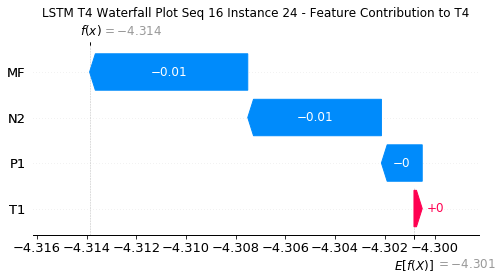

None

Contribution: [-0.00188198 -0.00168262 -0.00629232 -0.00600885]


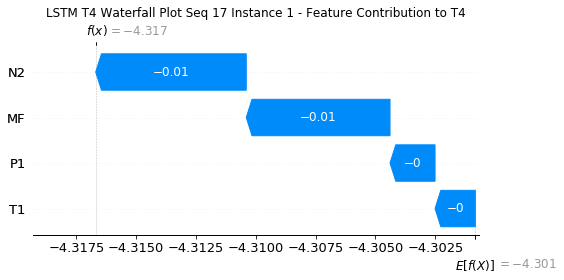

None

Contribution: [ 2.58618334e-04 -2.55162219e-05  8.14595527e-04  9.34406328e-04]


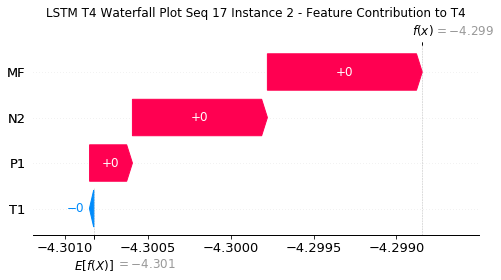

None

Contribution: [-6.45569522e-06  5.26100645e-07 -1.62145931e-05 -1.82354460e-05]


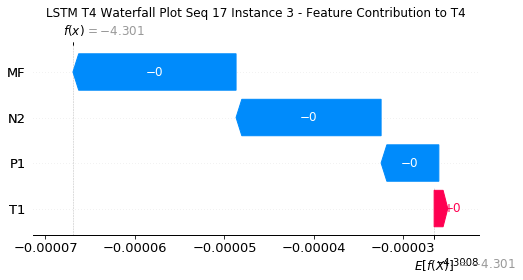

None

Contribution: [-1.58639468e-05 -9.32340274e-06 -5.08828938e-05 -4.34878072e-05]


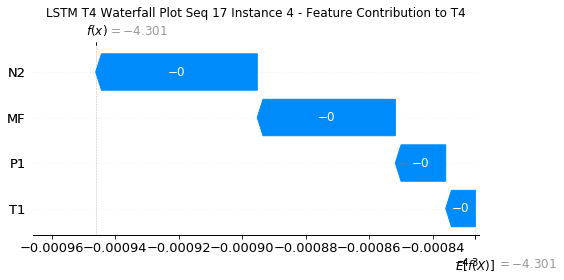

None

Contribution: [-2.73685972e-05 -2.11667782e-05 -8.94287567e-05 -7.71147743e-05]


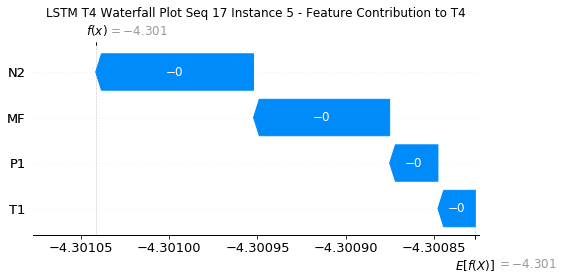

None

Contribution: [-2.99308925e-05 -2.14742161e-05 -9.83607503e-05 -8.55072652e-05]


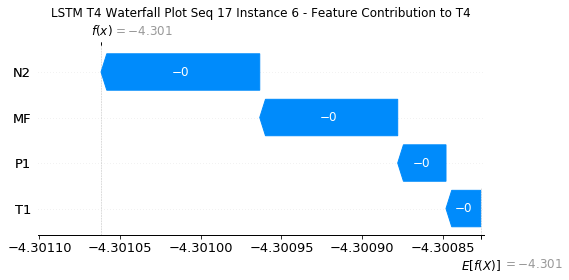

None

Contribution: [-2.92318241e-05 -2.24165119e-05 -9.76224485e-05 -8.60041378e-05]


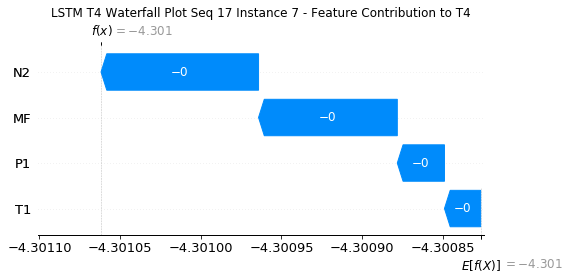

None

Contribution: [-2.95388307e-05 -2.15990091e-05 -9.80038309e-05 -8.79660788e-05]


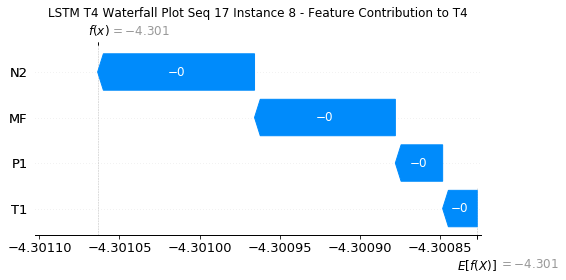

None

Contribution: [-3.02805536e-05 -2.23356405e-05 -1.00738894e-04 -8.93463248e-05]


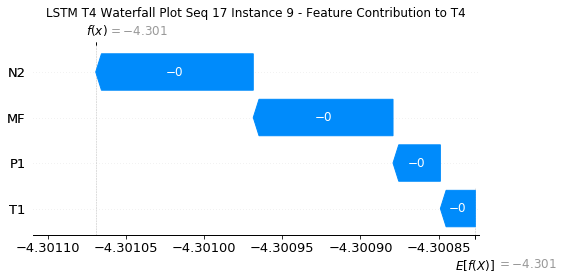

None

Contribution: [-3.22361294e-05 -2.19943184e-05 -1.06117060e-04 -9.39508417e-05]


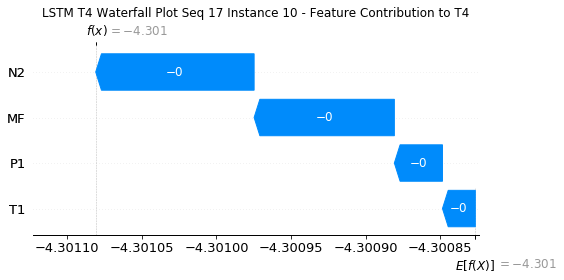

None

Contribution: [-3.41601927e-05 -2.32521358e-05 -1.11537442e-04 -9.89994955e-05]


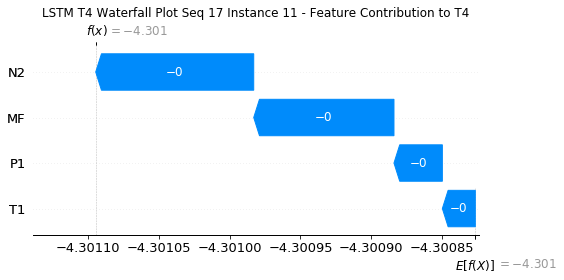

None

Contribution: [-3.61566786e-05 -2.67719152e-05 -1.18725841e-04 -1.05749610e-04]


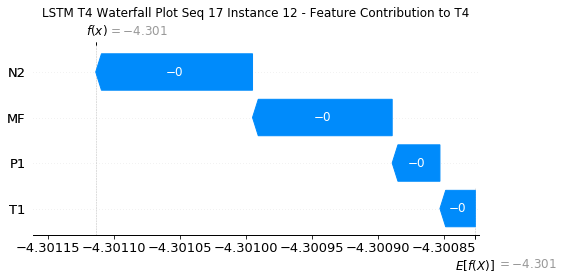

None

Contribution: [-3.93157530e-05 -2.74717286e-05 -1.28194936e-04 -1.14479865e-04]


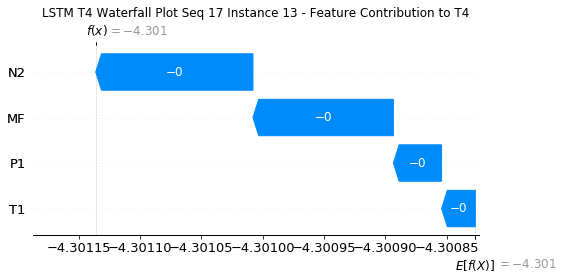

None

Contribution: [-4.46975365e-05 -3.05980477e-05 -1.44908098e-04 -1.33765853e-04]


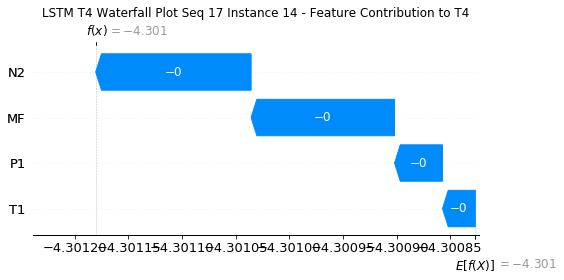

None

Contribution: [-5.03080445e-05 -3.61334509e-05 -1.64672324e-04 -1.48580403e-04]


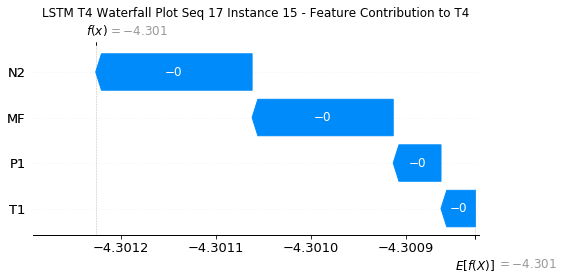

None

Contribution: [-5.13991170e-05 -3.66204620e-05 -1.67806054e-04 -1.52144393e-04]


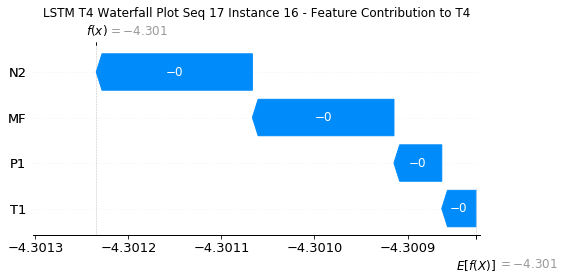

None

Contribution: [-3.41534047e-05 -2.08088177e-05 -1.09675410e-04 -1.00326194e-04]


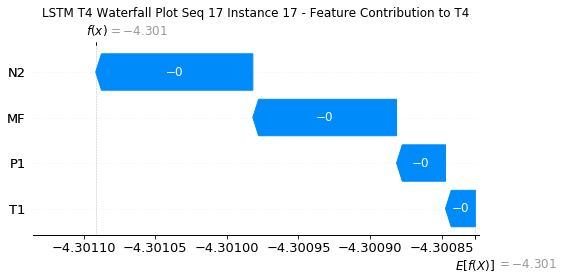

None

Contribution: [1.27465003e-05 1.94053461e-05 4.79277612e-05 4.99203478e-05]


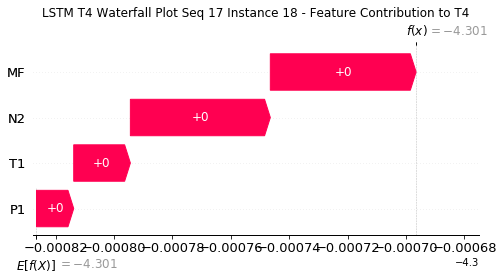

None

Contribution: [6.91746843e-05 6.79564959e-05 2.35826480e-04 2.29255876e-04]


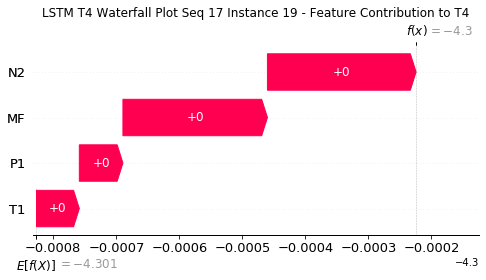

None

Contribution: [3.16761199e-05 3.51686715e-05 1.07147567e-04 1.15828074e-04]


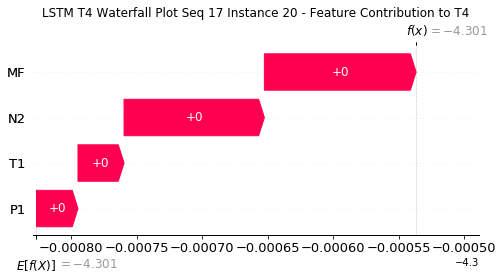

None

Contribution: [-0.00029607 -0.00022568 -0.00101407 -0.00093327]


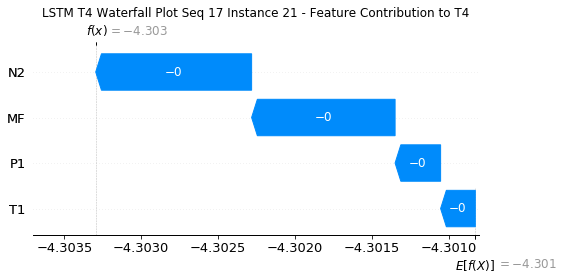

None

Contribution: [-0.00109136 -0.00068747 -0.00367346 -0.00349593]


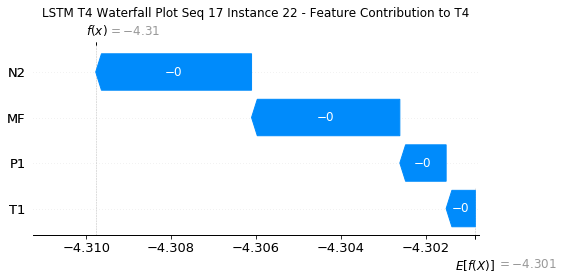

None

Contribution: [-0.00235618 -0.00117659 -0.00762184 -0.00772688]


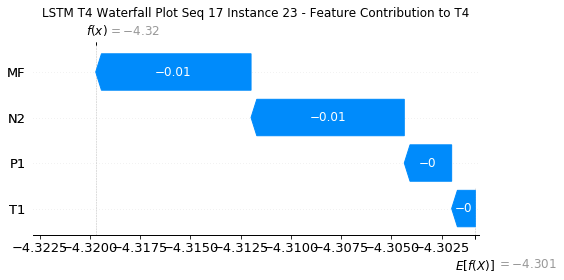

None

Contribution: [-0.00157565  0.00102272 -0.00535279 -0.00625529]


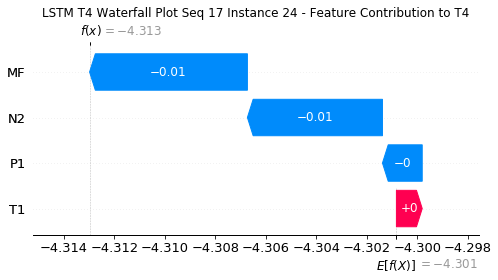

None

Contribution: [-0.00187464 -0.00149872 -0.00632125 -0.00589844]


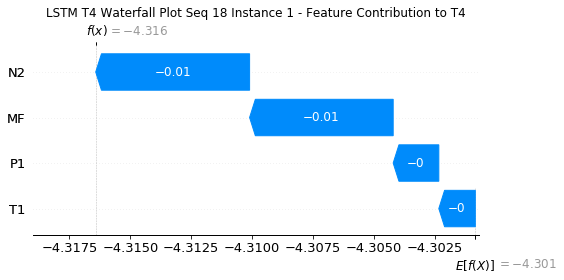

None

Contribution: [ 2.47127922e-04 -7.67117942e-05  8.00122375e-04  8.26431292e-04]


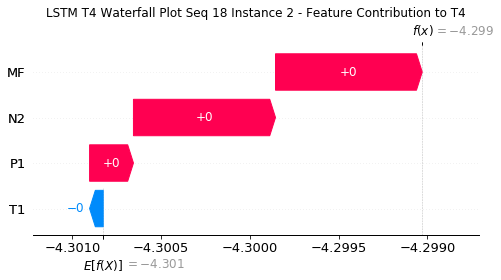

None

Contribution: [-6.64941283e-06  3.39035461e-06 -1.66830588e-05 -1.77030389e-05]


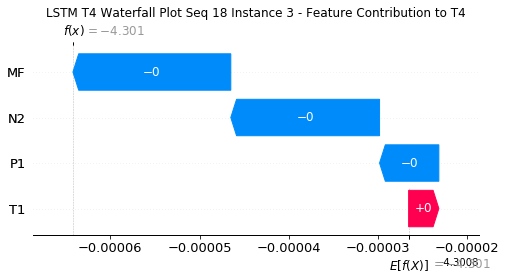

None

Contribution: [-1.59568080e-05 -7.56200565e-06 -5.09660229e-05 -4.26648259e-05]


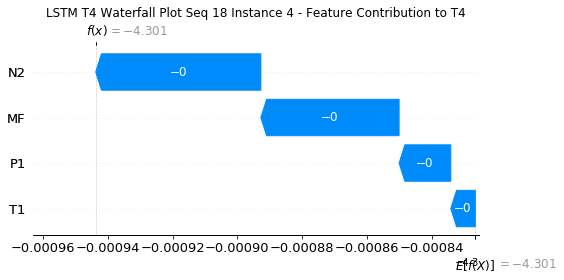

None

Contribution: [-2.71361294e-05 -1.87563172e-05 -9.01261071e-05 -7.61560742e-05]


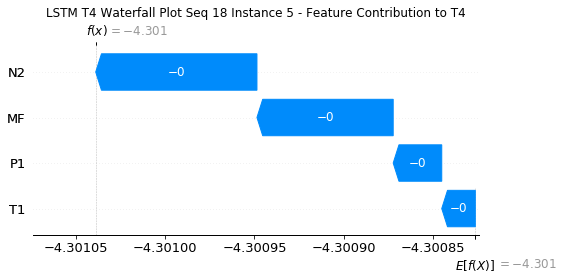

None

Contribution: [-3.00219506e-05 -1.91286397e-05 -9.86056941e-05 -8.43762350e-05]


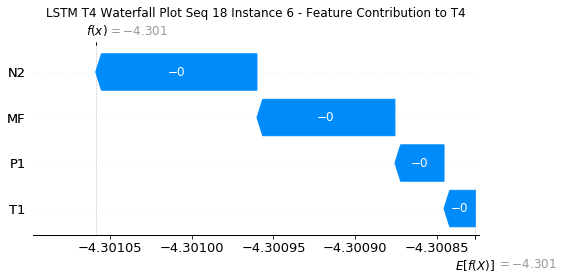

None

Contribution: [-2.83691378e-05 -1.73120068e-05 -9.69979451e-05 -8.26598159e-05]


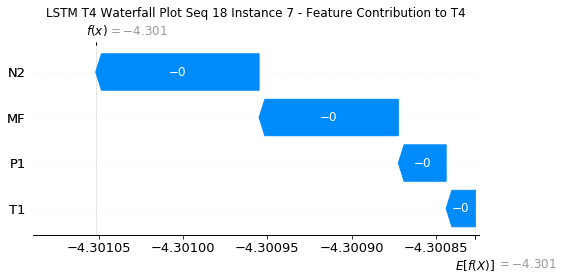

None

Contribution: [-2.96038228e-05 -1.73805139e-05 -9.74107027e-05 -8.52120839e-05]


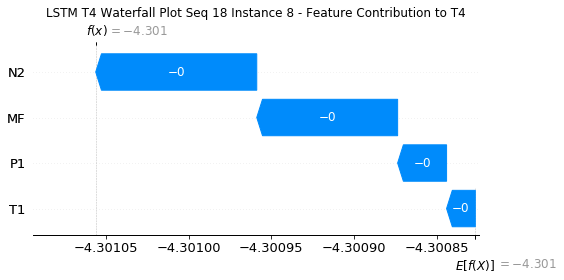

None

Contribution: [-2.97923987e-05 -1.86724007e-05 -1.00244516e-04 -8.69137155e-05]


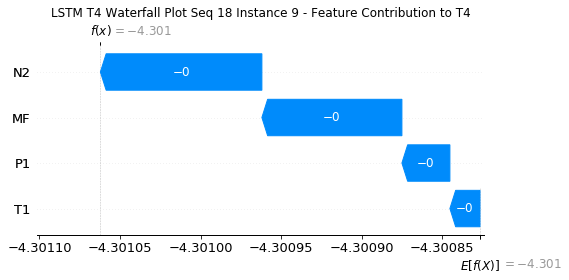

None

Contribution: [-3.26755378e-05 -2.08957882e-05 -1.06678391e-04 -9.37601807e-05]


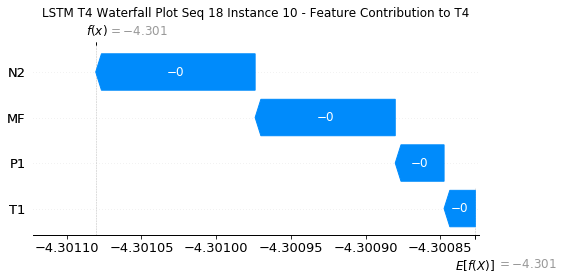

None

Contribution: [-3.45563578e-05 -2.18110012e-05 -1.11988178e-04 -9.85344648e-05]


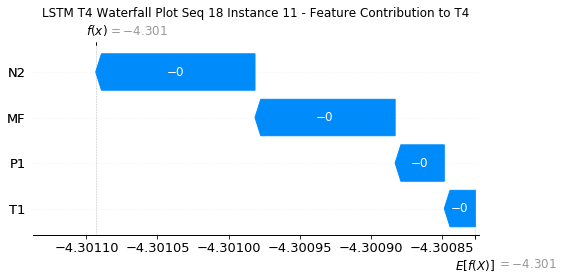

None

Contribution: [-3.63007478e-05 -2.37845149e-05 -1.18173639e-04 -1.03519644e-04]


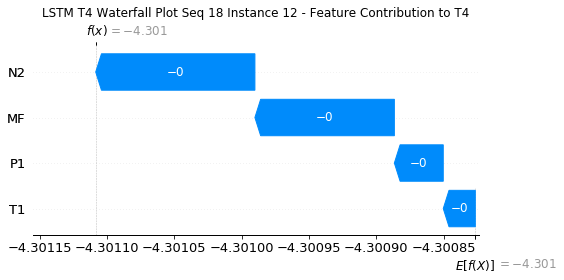

None

Contribution: [-3.99350226e-05 -2.62086433e-05 -1.29055128e-04 -1.14814407e-04]


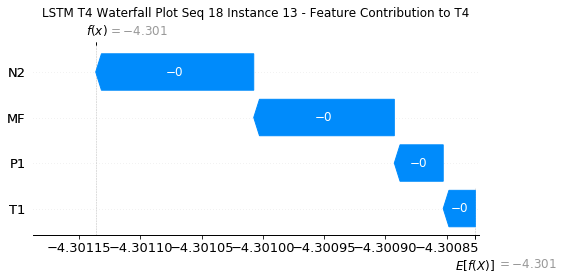

None

Contribution: [-4.48910878e-05 -3.16131388e-05 -1.45906394e-04 -1.29764264e-04]


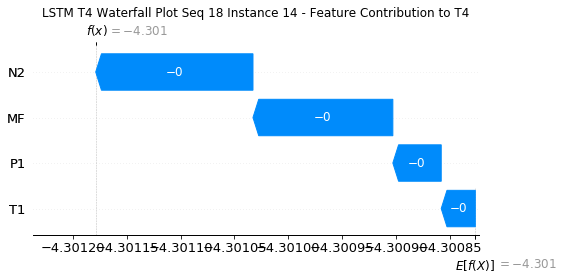

None

Contribution: [-5.12899559e-05 -3.49597170e-05 -1.66271009e-04 -1.49301294e-04]


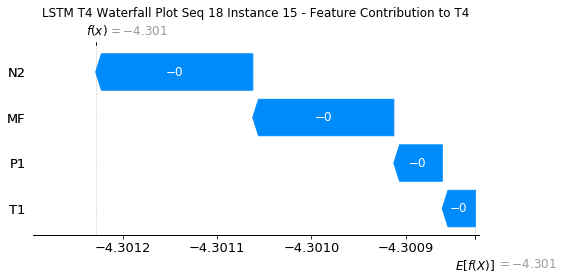

None

Contribution: [-5.22617216e-05 -3.53240356e-05 -1.68743264e-04 -1.51775687e-04]


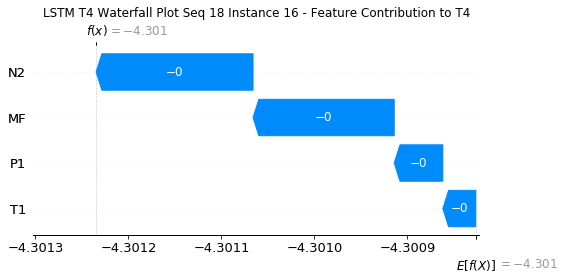

None

Contribution: [-3.36051752e-05 -1.76869537e-05 -1.08863384e-04 -9.59344161e-05]


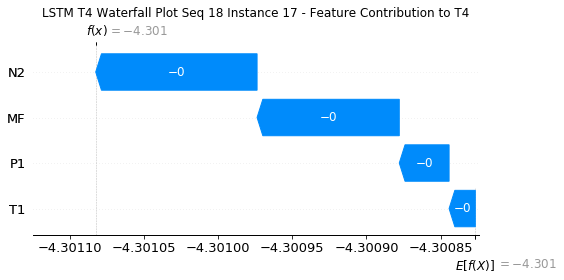

None

Contribution: [1.35648593e-05 2.08309366e-05 5.10671030e-05 5.30682280e-05]


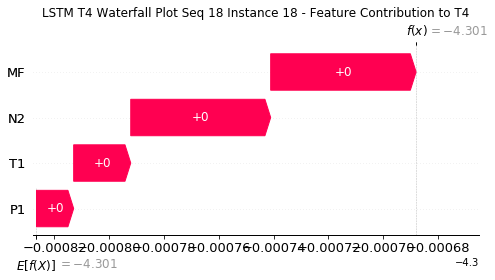

None

Contribution: [7.06625817e-05 6.85386447e-05 2.40394309e-04 2.33285258e-04]


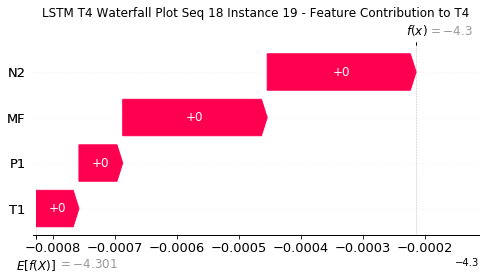

None

Contribution: [3.12913356e-05 3.71015794e-05 1.07118612e-04 1.16001262e-04]


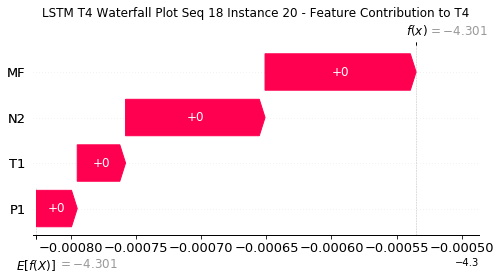

None

Contribution: [-0.00030555 -0.0002168  -0.00103076 -0.00094513]


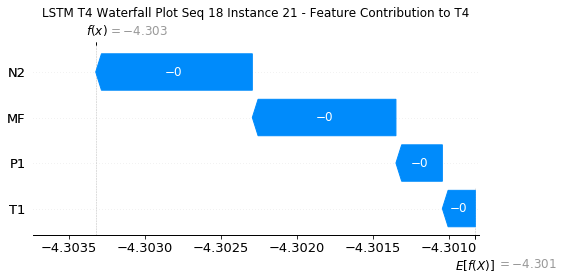

None

Contribution: [-0.00111124 -0.00061752 -0.00371622 -0.00350902]


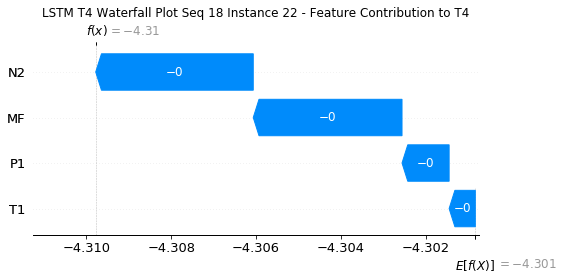

None

Contribution: [-0.00221197 -0.00088814 -0.00763752 -0.00743139]


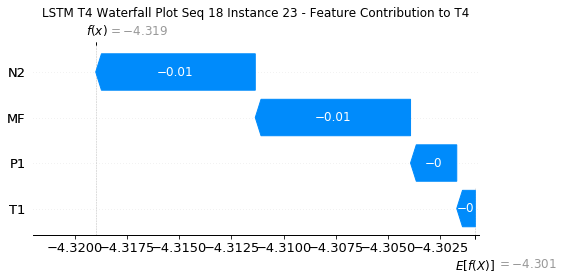

None

Contribution: [-0.00161991  0.00101104 -0.00546557 -0.00641284]


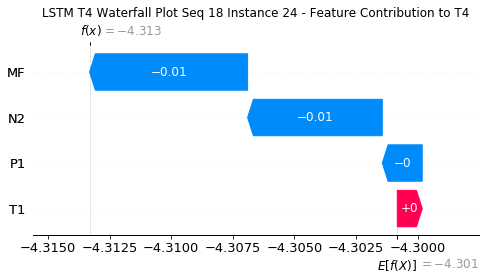

None

Contribution: [-0.00188944 -0.0014916  -0.00634601 -0.00610805]


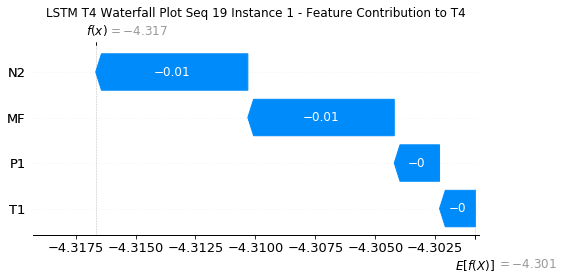

None

Contribution: [ 2.71765752e-04 -5.62009809e-05  8.21989938e-04  9.31199563e-04]


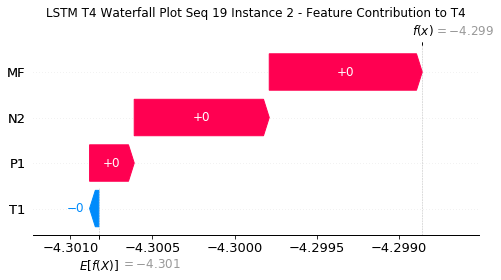

None

Contribution: [-7.19259461e-06 -9.38382974e-07 -1.61034208e-05 -1.88333400e-05]


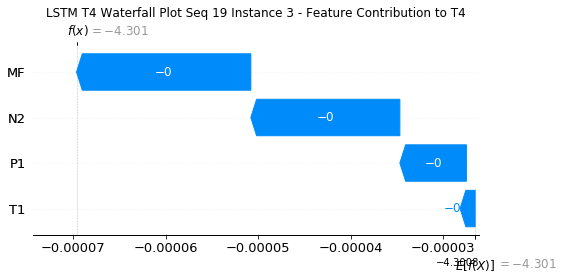

None

Contribution: [-1.64697967e-05 -1.06397854e-05 -5.08557664e-05 -4.39076209e-05]


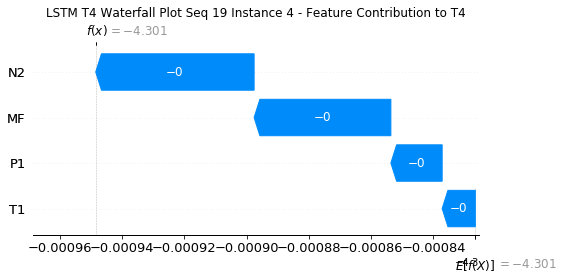

None

Contribution: [-2.85200651e-05 -1.95916205e-05 -8.89595487e-05 -7.63730217e-05]


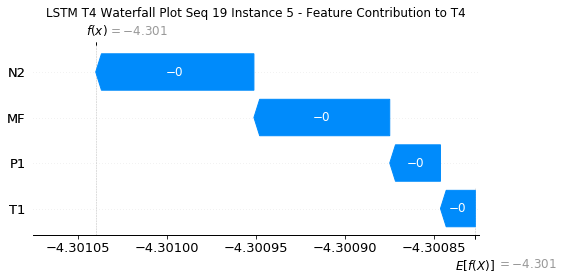

None

Contribution: [-3.07657186e-05 -2.26455976e-05 -9.82852232e-05 -8.59317677e-05]


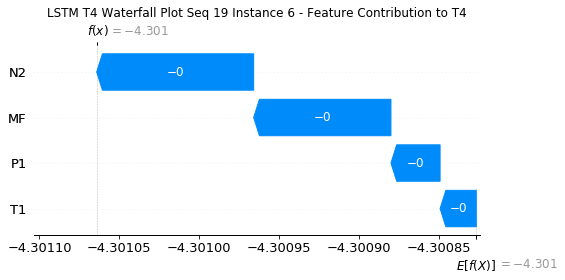

None

Contribution: [-3.07866632e-05 -2.20145481e-05 -9.79653819e-05 -8.71729055e-05]


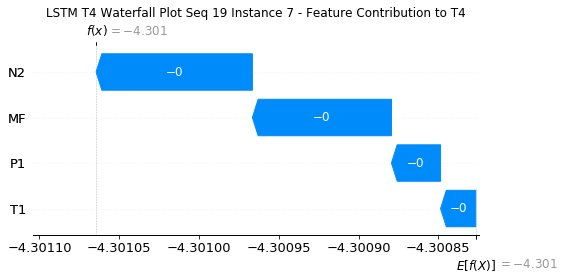

None

Contribution: [-3.15861233e-05 -2.13520968e-05 -9.84204728e-05 -9.00784889e-05]


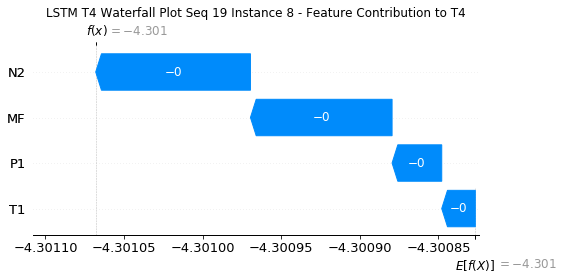

None

Contribution: [-3.16016932e-05 -2.44363063e-05 -1.00983510e-04 -9.03376539e-05]


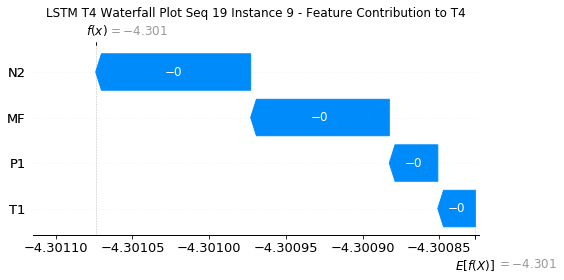

None

Contribution: [-3.34933061e-05 -2.43070041e-05 -1.06361085e-04 -9.49185303e-05]


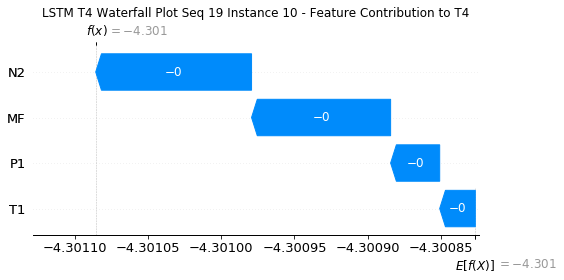

None

Contribution: [-3.54603121e-05 -2.49992764e-05 -1.11914778e-04 -1.00033196e-04]


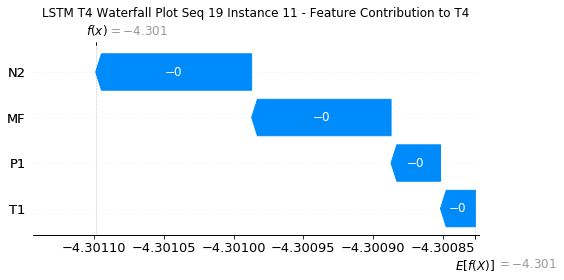

None

Contribution: [-3.84103352e-05 -2.68948738e-05 -1.19568092e-04 -1.08691928e-04]


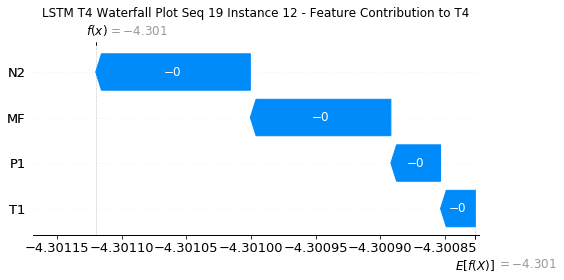

None

Contribution: [-4.06579491e-05 -2.92666035e-05 -1.28622706e-04 -1.15335507e-04]


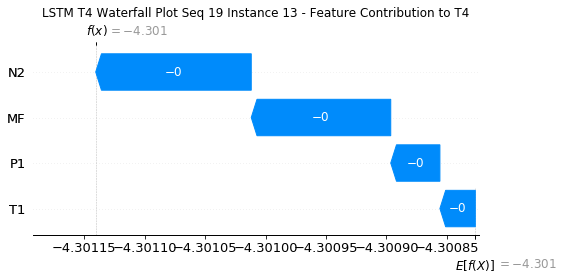

None

Contribution: [-4.56549110e-05 -3.16720341e-05 -1.45401388e-04 -1.32566713e-04]


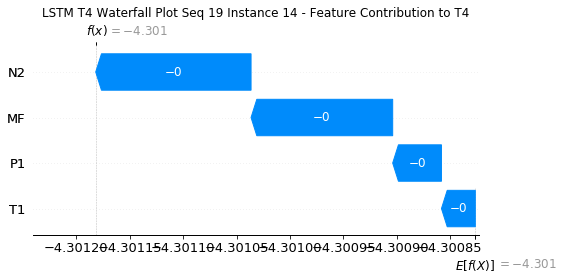

None

Contribution: [-5.16027939e-05 -3.69662944e-05 -1.65013464e-04 -1.48876591e-04]


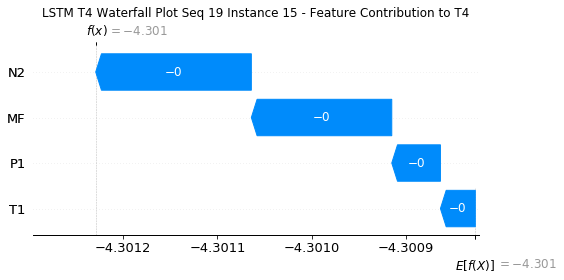

None

Contribution: [-5.24538594e-05 -3.72371682e-05 -1.68013609e-04 -1.52041146e-04]


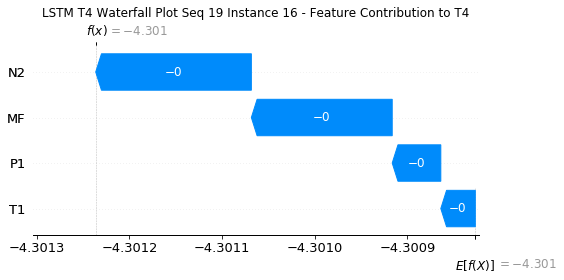

None

Contribution: [-3.48648204e-05 -2.10394431e-05 -1.10431474e-04 -1.00248289e-04]


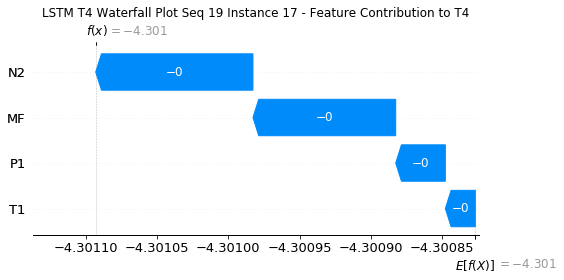

None

Contribution: [1.30182592e-05 2.00438239e-05 4.93173017e-05 5.14677695e-05]


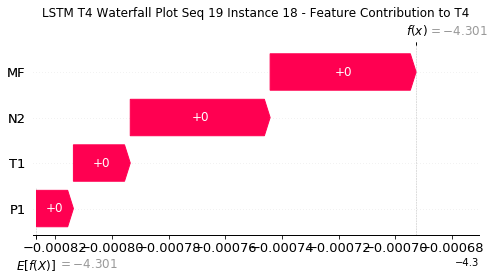

None

Contribution: [6.98351930e-05 6.80974926e-05 2.37419063e-04 2.30442825e-04]


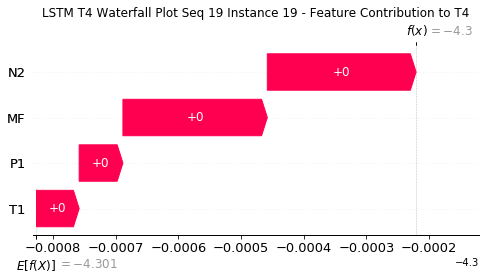

None

Contribution: [3.08396933e-05 3.54218252e-05 1.05970069e-04 1.15432073e-04]


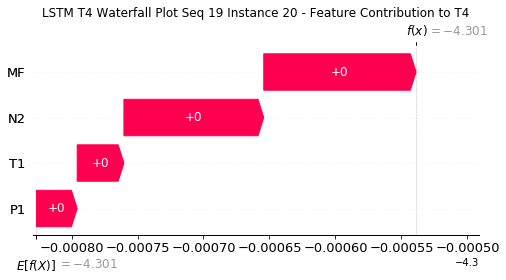

None

Contribution: [-0.0003034  -0.00022779 -0.00102212 -0.00093347]


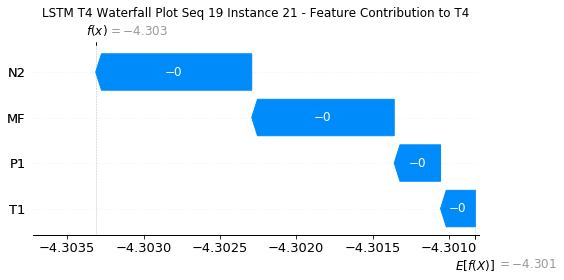

None

Contribution: [-0.00109317 -0.00066471 -0.00368261 -0.00343017]


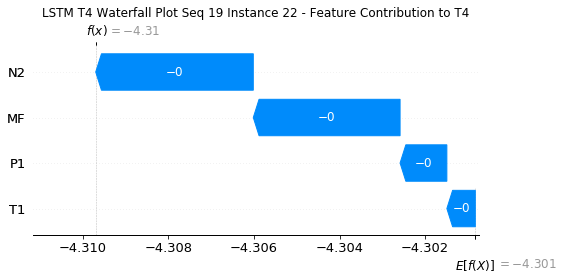

None

Contribution: [-0.00227404 -0.00112441 -0.00762458 -0.00747842]


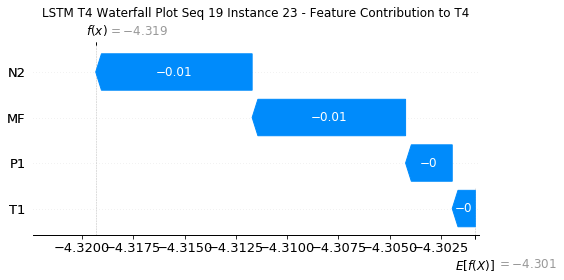

None

Contribution: [-0.00176699  0.00080423 -0.00547275 -0.00671326]


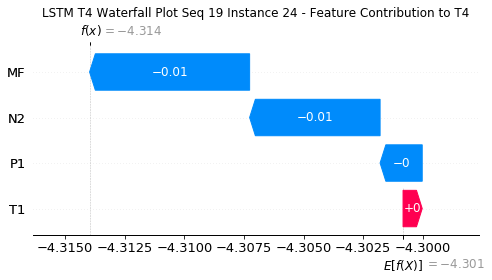

None

Contribution: [-0.00193446 -0.00156451 -0.00632955 -0.00598563]


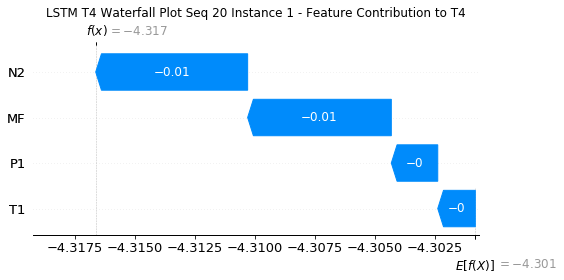

None

Contribution: [ 2.33754351e-04 -7.62332539e-05  8.00110403e-04  7.99803411e-04]


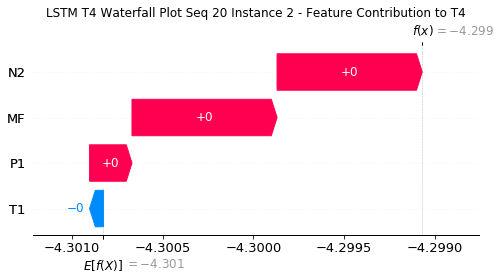

None

Contribution: [-6.98002035e-06  1.03288707e-06 -1.63802877e-05 -1.75098098e-05]


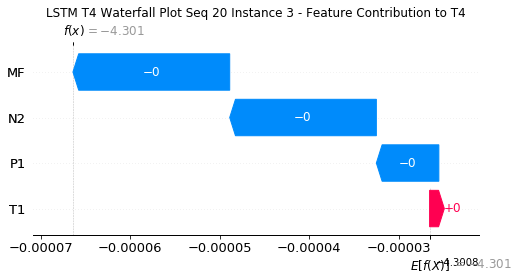

None

Contribution: [-1.64873643e-05 -9.30114883e-06 -5.10940783e-05 -4.33921172e-05]


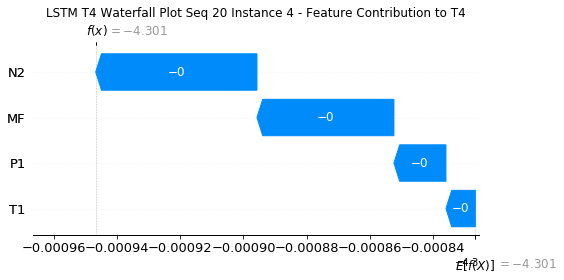

None

Contribution: [-2.82494464e-05 -1.94372638e-05 -8.95934144e-05 -7.60358165e-05]


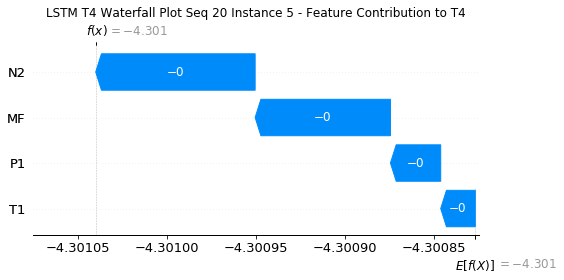

None

Contribution: [-3.07896232e-05 -2.09945561e-05 -9.86904903e-05 -8.55413243e-05]


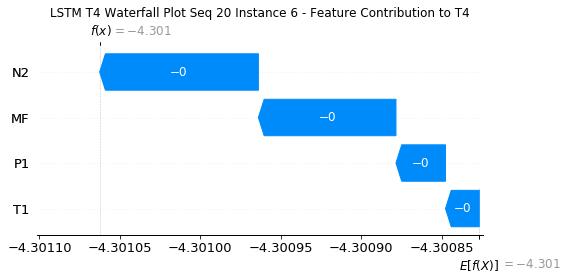

None

Contribution: [-3.01957655e-05 -1.93834517e-05 -9.78968483e-05 -8.64802304e-05]


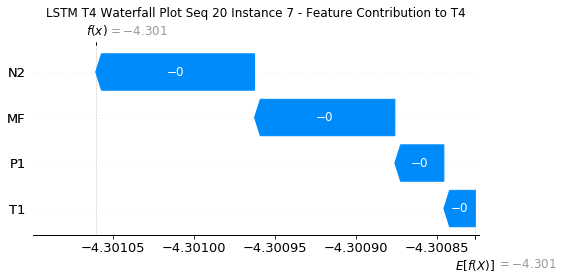

None

Contribution: [-3.05628009e-05 -2.01319953e-05 -9.77337338e-05 -8.55356098e-05]


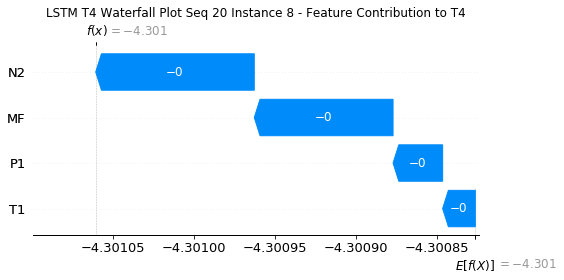

None

Contribution: [-3.17743559e-05 -2.14778831e-05 -1.01497228e-04 -9.07339135e-05]


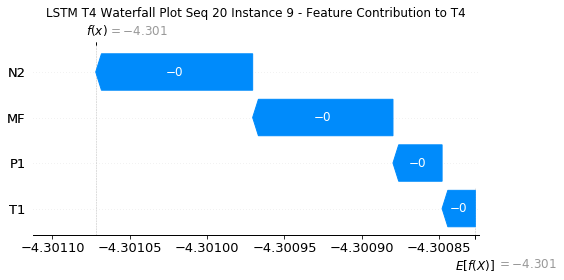

None

Contribution: [-3.33992684e-05 -2.25285565e-05 -1.06469622e-04 -9.40541859e-05]


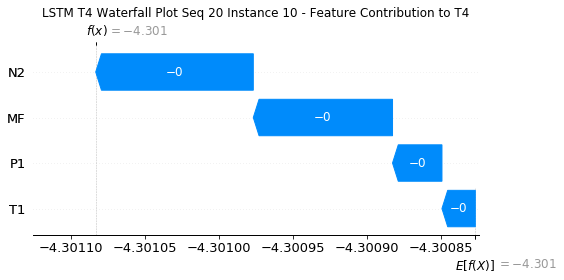

None

Contribution: [-3.52970397e-05 -2.33207623e-05 -1.11915981e-04 -9.91272237e-05]


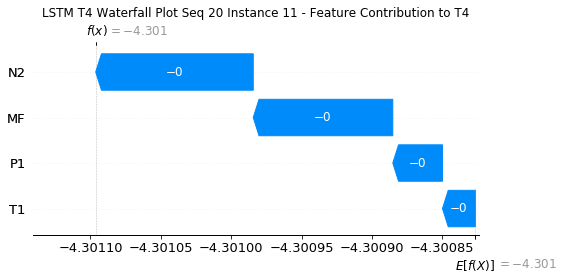

None

Contribution: [-3.80206393e-05 -2.77823566e-05 -1.18520329e-04 -1.05383313e-04]


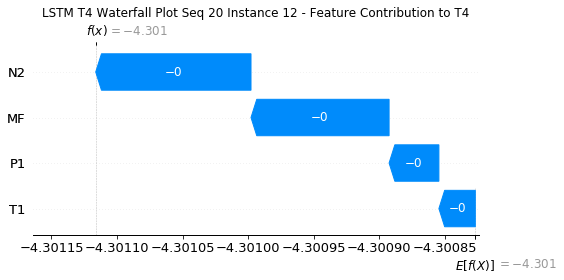

None

Contribution: [-4.04996839e-05 -2.75086064e-05 -1.28419336e-04 -1.14402796e-04]


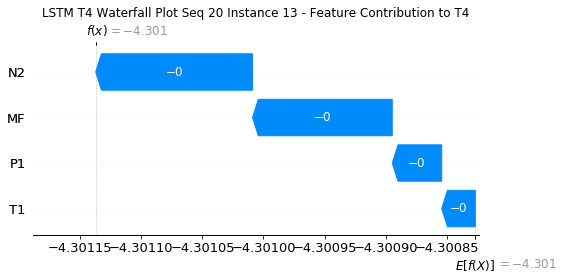

None

Contribution: [-4.45676996e-05 -3.08728080e-05 -1.44515479e-04 -1.28701680e-04]


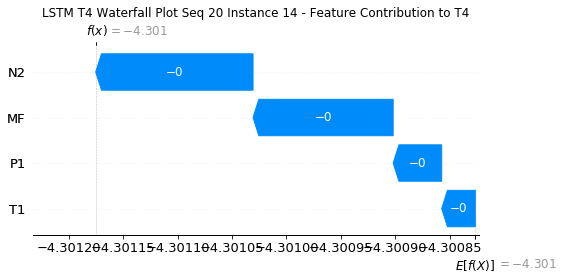

None

Contribution: [-5.19103412e-05 -3.56780265e-05 -1.65121047e-04 -1.49368017e-04]


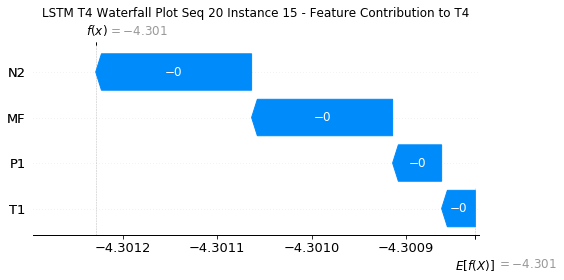

None

Contribution: [-5.30898534e-05 -3.61802289e-05 -1.68119303e-04 -1.53242837e-04]


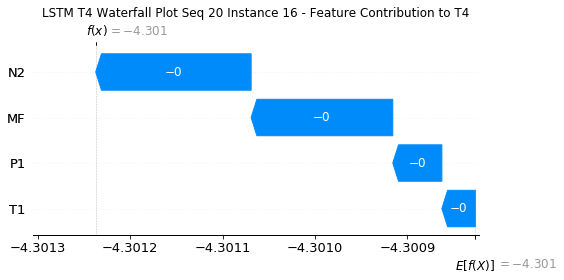

None

Contribution: [-3.53497613e-05 -1.94029711e-05 -1.09028401e-04 -9.84231321e-05]


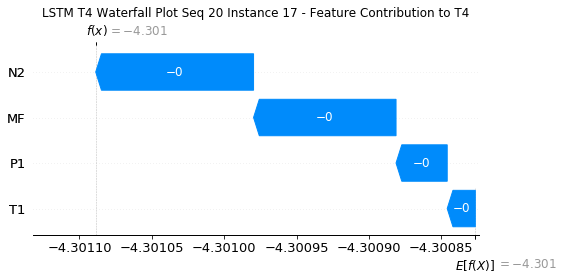

None

Contribution: [1.31205290e-05 2.04266635e-05 5.00508634e-05 5.18748253e-05]


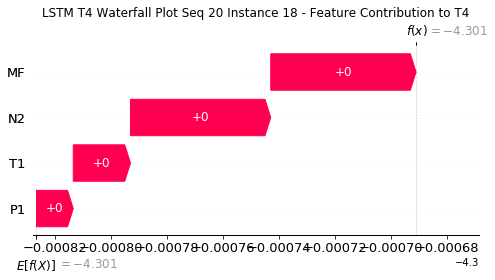

None

Contribution: [7.01886849e-05 6.80800402e-05 2.38160083e-04 2.31601780e-04]


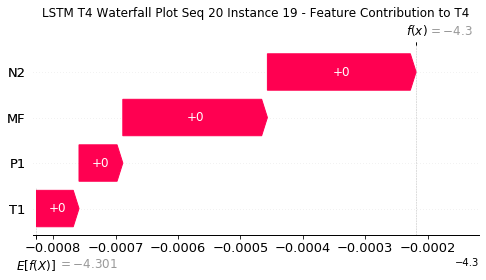

None

Contribution: [3.07474993e-05 3.63081247e-05 1.06156754e-04 1.15225903e-04]


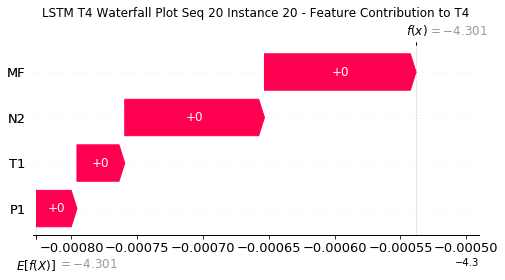

None

Contribution: [-0.00030807 -0.00022059 -0.00102317 -0.00094318]


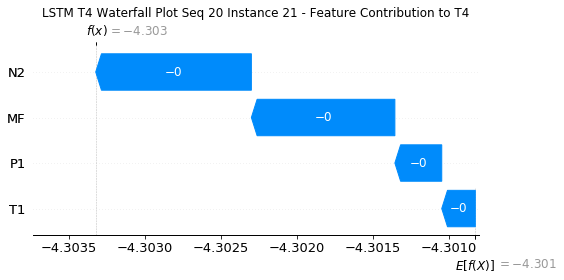

None

Contribution: [-0.00110739 -0.00063702 -0.00367395 -0.00344399]


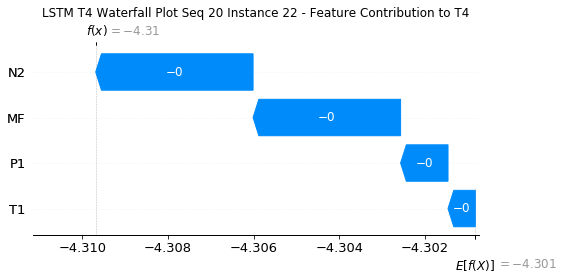

None

Contribution: [-0.00223579 -0.00128764 -0.00755803 -0.00709898]


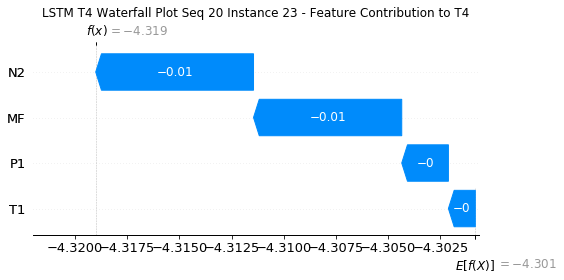

None

Contribution: [-0.0017479   0.000512   -0.00540902 -0.00639146]


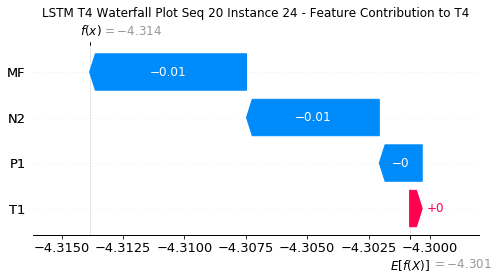

None

Contribution: [-0.0019076  -0.00162253 -0.00633657 -0.00584482]


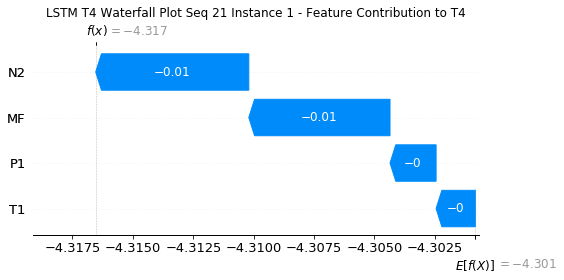

None

Contribution: [ 2.87398887e-04 -2.64600274e-05  8.20711458e-04  9.03153045e-04]


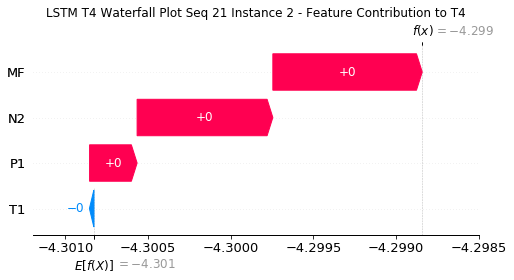

None

Contribution: [-6.72098303e-06  7.66351055e-07 -1.60897735e-05 -1.66404789e-05]


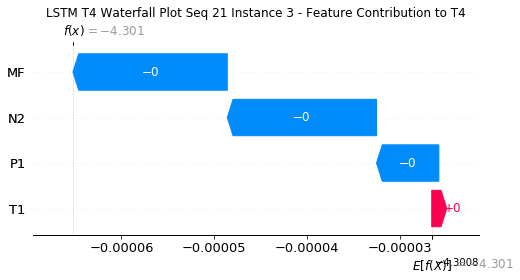

None

Contribution: [-1.60495761e-05 -9.50704092e-06 -5.06051423e-05 -4.24228430e-05]


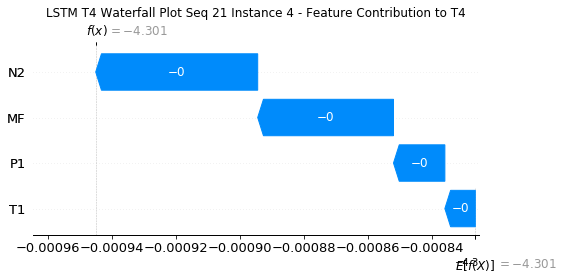

None

Contribution: [-2.85231350e-05 -1.62349286e-05 -8.84609108e-05 -7.59627430e-05]


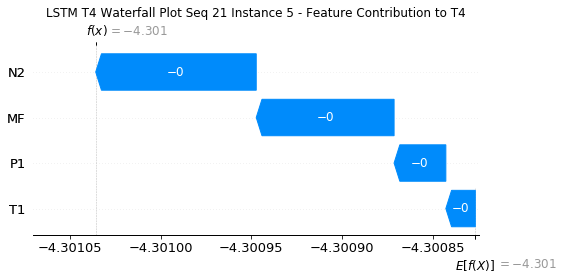

None

Contribution: [-3.04501528e-05 -2.16637428e-05 -9.80830035e-05 -8.45462655e-05]


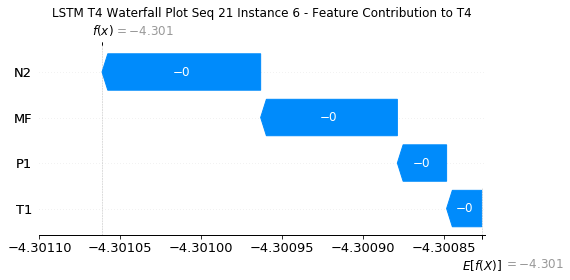

None

Contribution: [-3.08765946e-05 -2.20826446e-05 -9.74581437e-05 -8.58713787e-05]


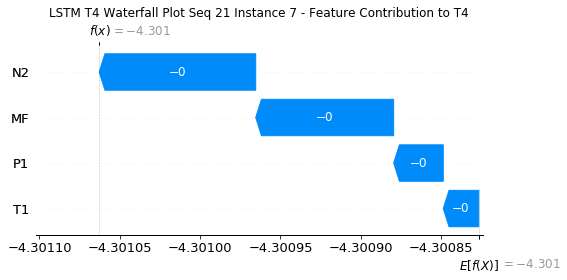

None

Contribution: [-3.09542703e-05 -2.40144836e-05 -9.78018868e-05 -8.68486832e-05]


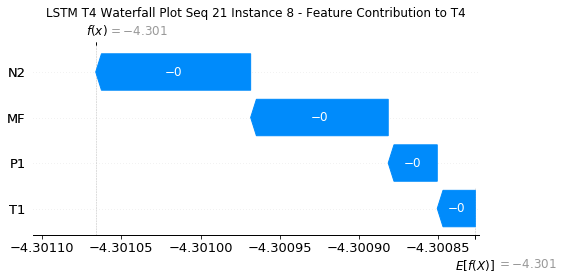

None

Contribution: [-3.17284336e-05 -2.44912368e-05 -1.01044445e-04 -9.04063594e-05]


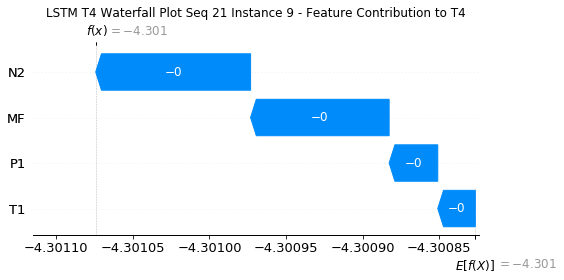

None

Contribution: [-3.25227749e-05 -2.27684373e-05 -1.06132503e-04 -9.34166455e-05]


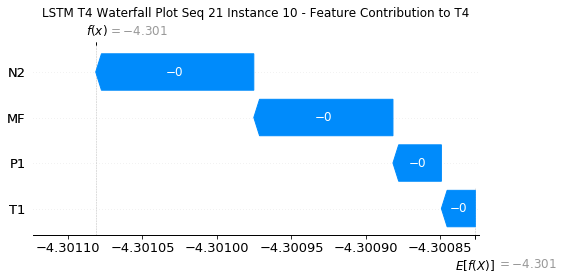

None

Contribution: [-3.46225047e-05 -2.37022584e-05 -1.11605072e-04 -9.85569799e-05]


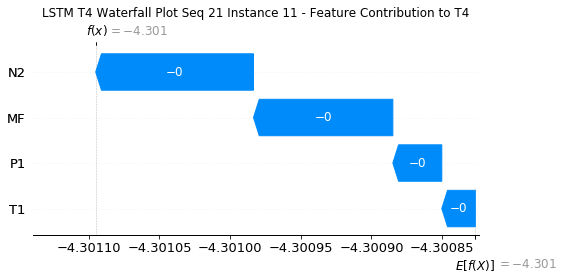

None

Contribution: [-3.85317774e-05 -2.60135434e-05 -1.19684933e-04 -1.09100427e-04]


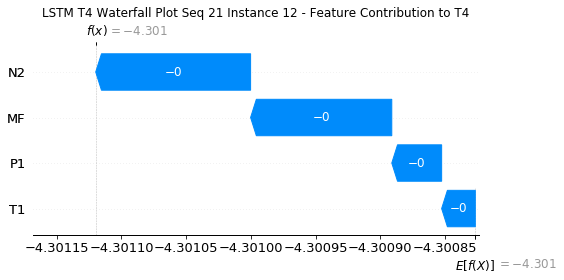

None

Contribution: [-4.00258909e-05 -2.80923271e-05 -1.28441137e-04 -1.14887321e-04]


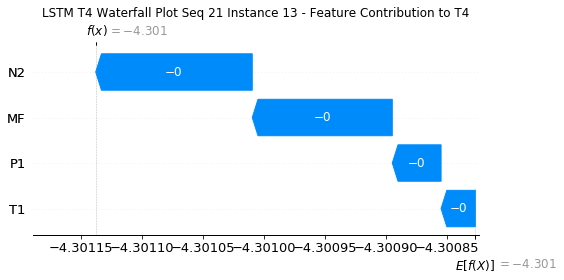

None

Contribution: [-4.58876214e-05 -3.21142964e-05 -1.45479660e-04 -1.31331489e-04]


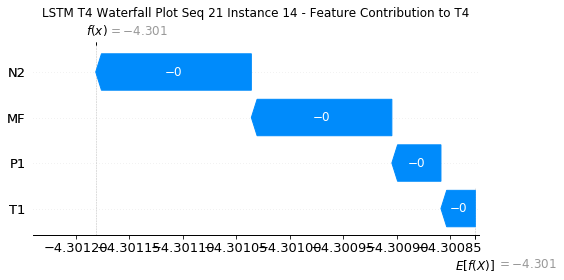

None

Contribution: [-5.28943737e-05 -3.41354969e-05 -1.66222438e-04 -1.52838169e-04]


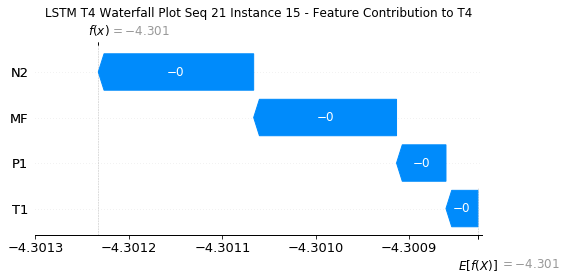

None

Contribution: [-5.33856067e-05 -3.48038950e-05 -1.68892962e-04 -1.54299004e-04]


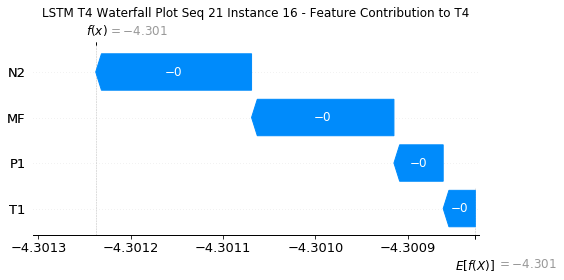

None

Contribution: [-3.49163327e-05 -1.83521987e-05 -1.09423872e-04 -9.85591229e-05]


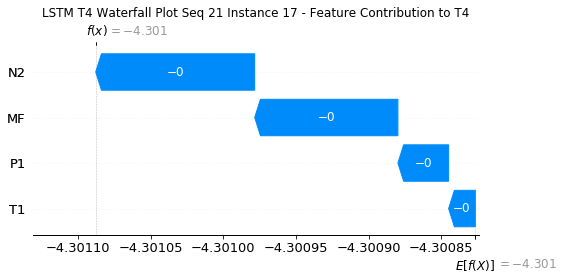

None

Contribution: [1.33100738e-05 2.09956227e-05 5.11626865e-05 5.27400837e-05]


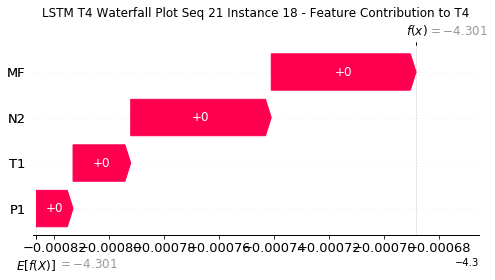

None

Contribution: [7.10096592e-05 6.80546458e-05 2.41108609e-04 2.34319009e-04]


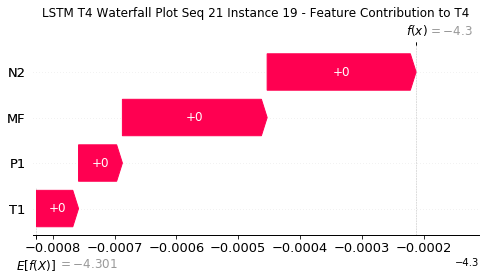

None

Contribution: [3.08879098e-05 3.89122251e-05 1.05897234e-04 1.14846914e-04]


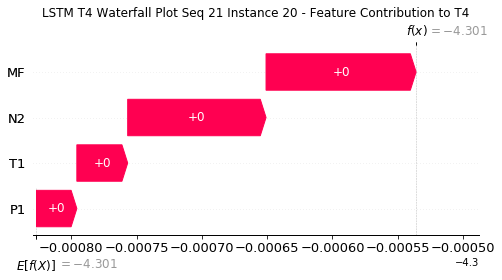

None

Contribution: [-0.00030646 -0.00019478 -0.0010356  -0.00095469]


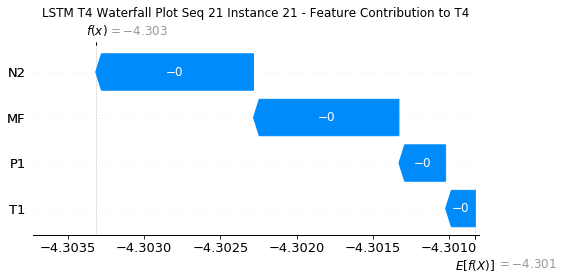

None

Contribution: [-0.00110856 -0.00050396 -0.00372548 -0.00351588]


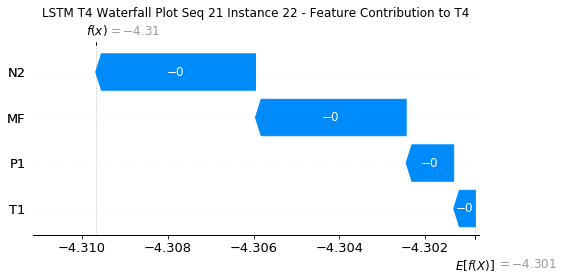

None

Contribution: [-0.00229953 -0.00046317 -0.00766082 -0.00742453]


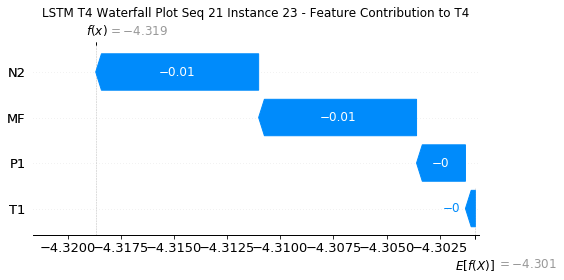

None

Contribution: [-0.00194142  0.00156117 -0.00552041 -0.00683887]


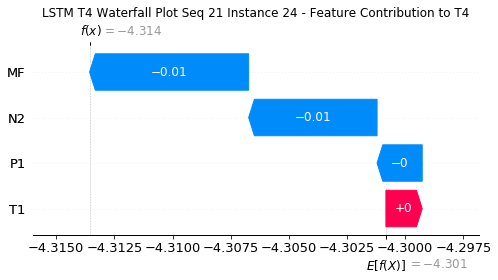

None

Contribution: [-0.00191586 -0.00124542 -0.0063454  -0.00610758]


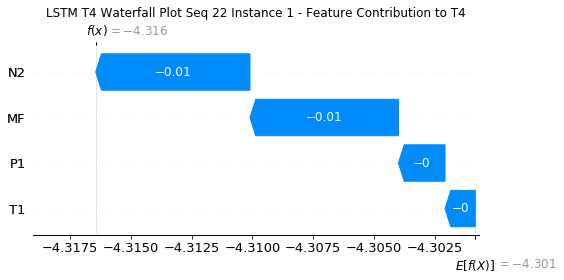

None

Contribution: [ 0.00026558 -0.00017805  0.00079754  0.00092217]


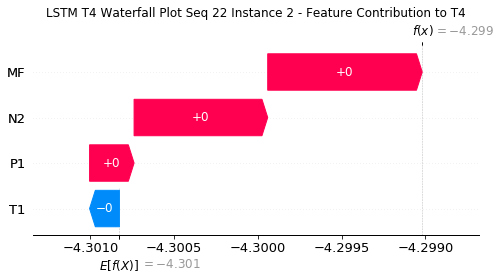

None

Contribution: [-7.39154613e-06  7.83791687e-06 -1.47452860e-05 -1.84679554e-05]


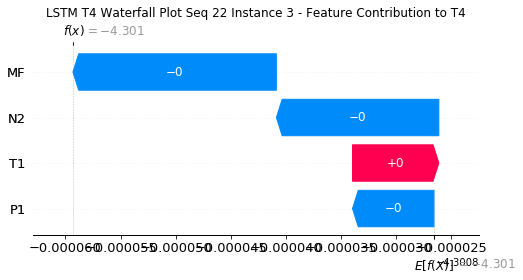

None

Contribution: [-1.60912371e-05 -7.46983929e-06 -4.94098291e-05 -4.28441806e-05]


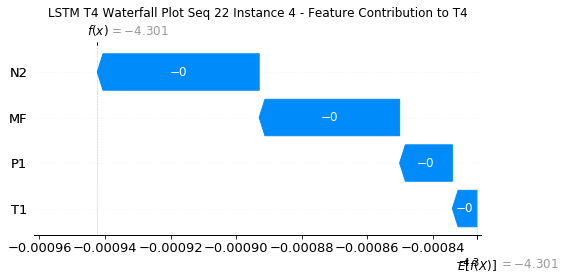

None

Contribution: [-2.73731095e-05 -1.68689854e-05 -8.75788765e-05 -7.58257896e-05]


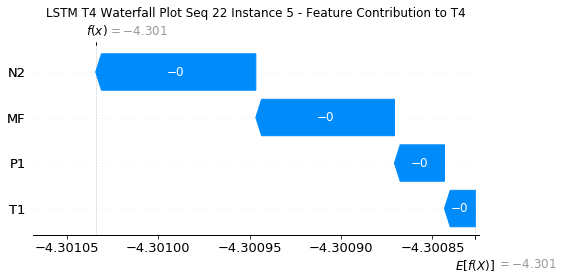

None

Contribution: [-3.08459679e-05 -2.06220321e-05 -9.68433832e-05 -8.36778613e-05]


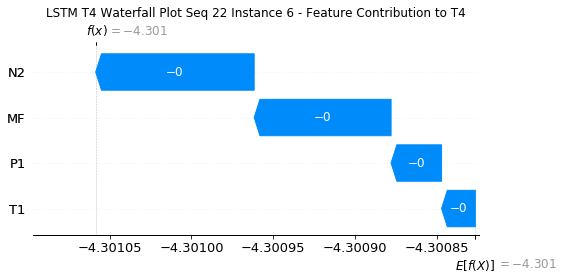

None

Contribution: [-2.99339999e-05 -1.95846360e-05 -9.62589018e-05 -8.59436900e-05]


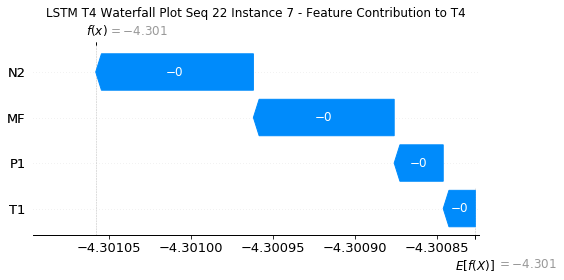

None

Contribution: [-3.08663579e-05 -2.29687467e-05 -9.73013815e-05 -8.90336450e-05]


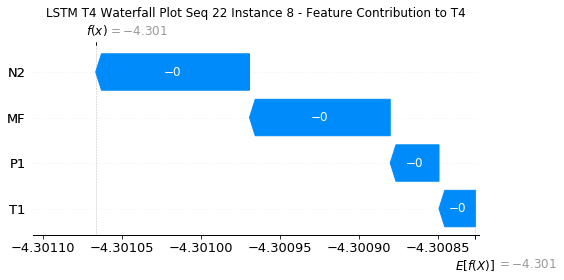

None

Contribution: [-3.22590194e-05 -2.24807372e-05 -1.00546041e-04 -9.21983176e-05]


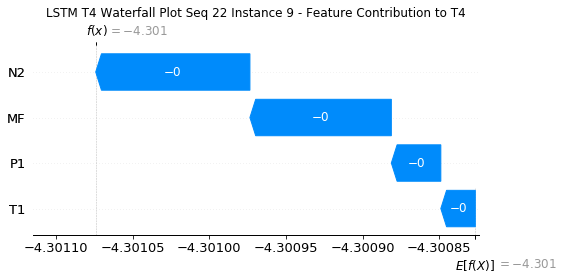

None

Contribution: [-3.29924210e-05 -2.35821903e-05 -1.05992384e-04 -9.69721810e-05]


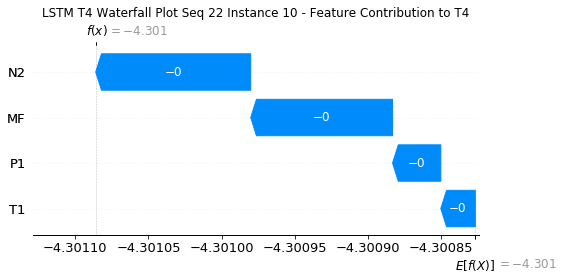

None

Contribution: [-3.46102594e-05 -2.31893560e-05 -1.10742044e-04 -1.00030849e-04]


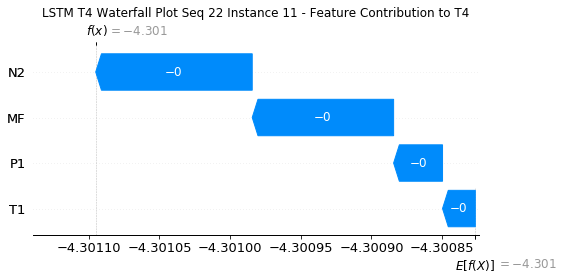

None

Contribution: [-3.70745263e-05 -2.53436052e-05 -1.18243798e-04 -1.07360066e-04]


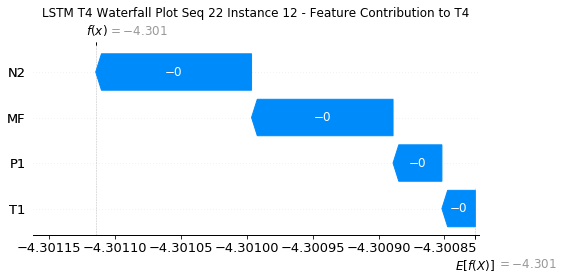

None

Contribution: [-4.17187712e-05 -2.79672952e-05 -1.29393434e-04 -1.22411858e-04]


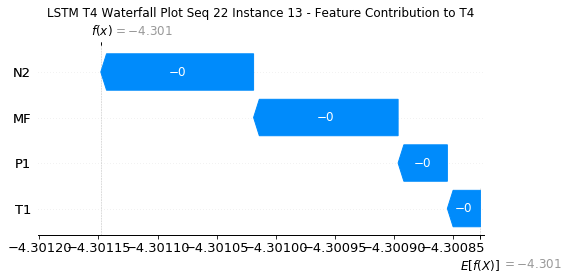

None

Contribution: [-4.47849374e-05 -3.14376796e-05 -1.44448054e-04 -1.32208778e-04]


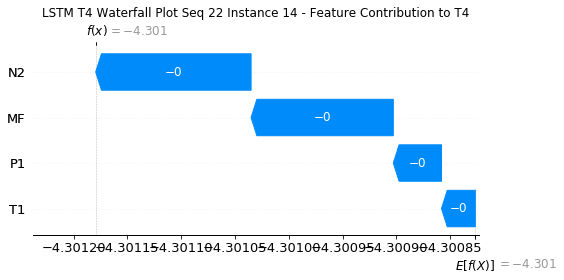

None

Contribution: [-5.10126171e-05 -3.64580089e-05 -1.64326114e-04 -1.49265155e-04]


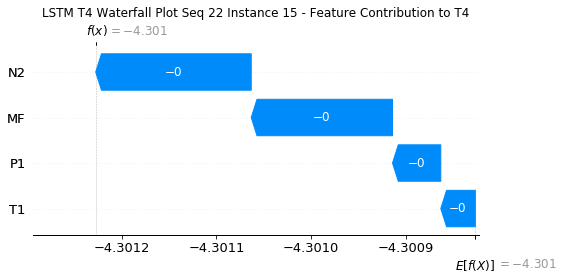

None

Contribution: [-5.28743179e-05 -3.79624491e-05 -1.68138180e-04 -1.54983661e-04]


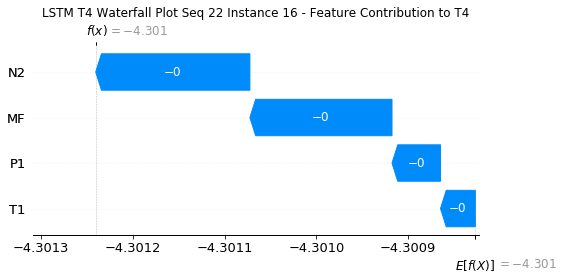

None

Contribution: [-3.50294878e-05 -2.14528807e-05 -1.09976455e-04 -1.00828468e-04]


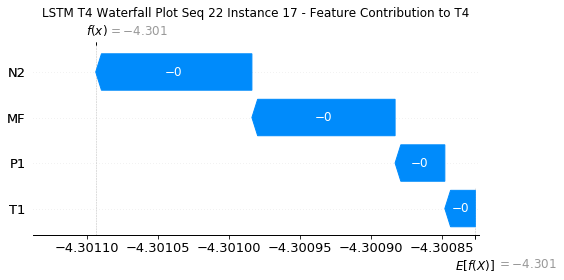

None

Contribution: [1.23838897e-05 1.96015055e-05 4.88824608e-05 5.03453619e-05]


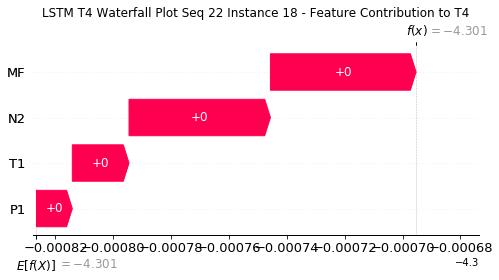

None

Contribution: [7.02709895e-05 6.87456274e-05 2.38331310e-04 2.32384163e-04]


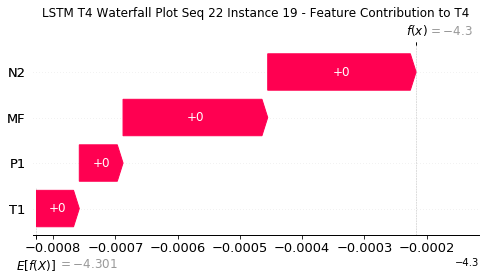

None

Contribution: [3.13060908e-05 3.56554996e-05 1.08560909e-04 1.15554358e-04]


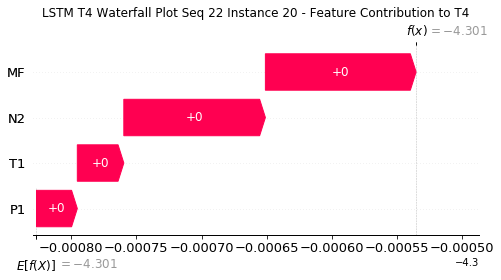

None

Contribution: [-0.00030439 -0.00022821 -0.00102215 -0.00095532]


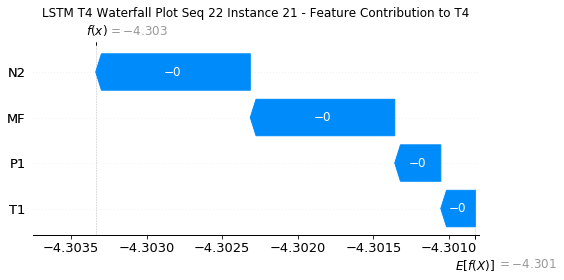

None

Contribution: [-0.00110936 -0.00066982 -0.00370534 -0.00357185]


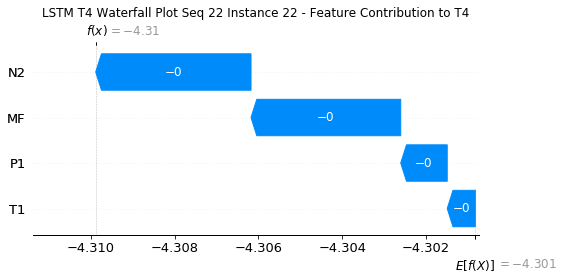

None

Contribution: [-0.00223358 -0.00089823 -0.00763161 -0.00753152]


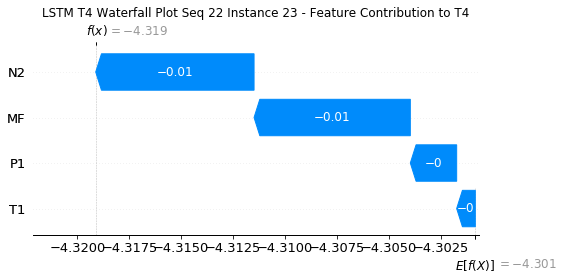

None

Contribution: [-0.00132333  0.00153016 -0.00538136 -0.00622705]


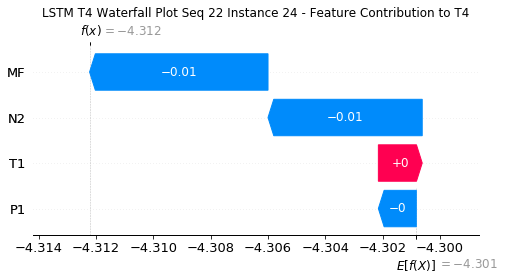

None

Contribution: [-0.00193259 -0.00147623 -0.00631547 -0.00612068]


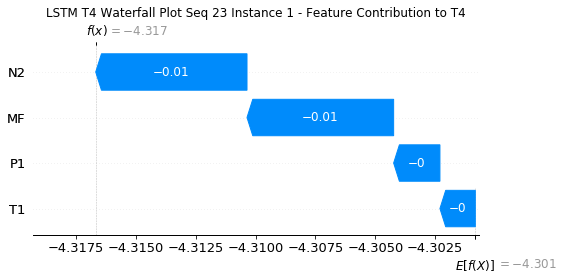

None

Contribution: [ 2.68954752e-04 -9.18921701e-05  8.11133707e-04  8.98251128e-04]


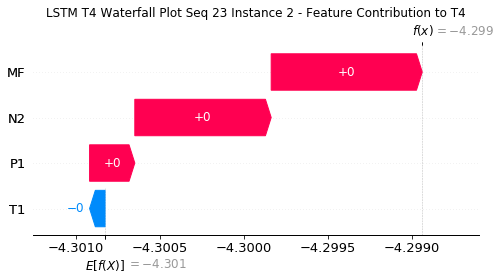

None

Contribution: [-7.99927724e-06  2.08150392e-06 -1.62000341e-05 -1.85225314e-05]


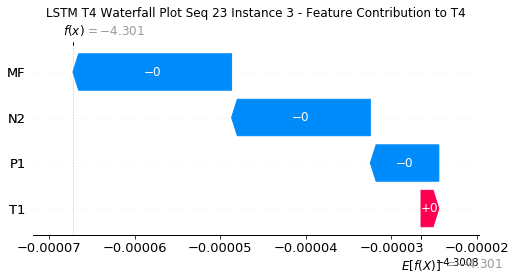

None

Contribution: [-1.65078948e-05 -9.20821731e-06 -5.07877906e-05 -4.27284705e-05]


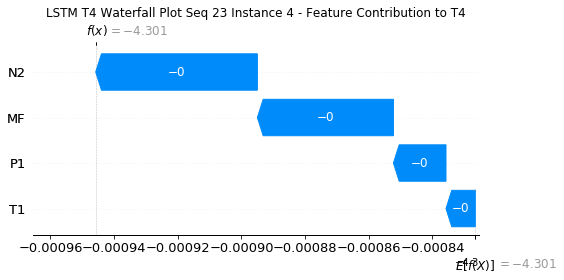

None

Contribution: [-2.78256349e-05 -1.87448750e-05 -8.90419491e-05 -7.56116152e-05]


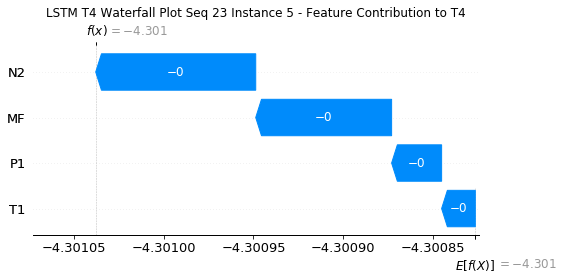

None

Contribution: [-3.19398736e-05 -2.16394109e-05 -9.86964120e-05 -8.59734453e-05]


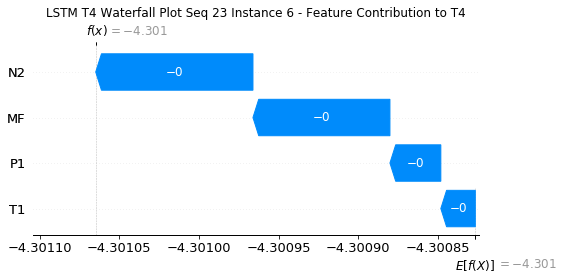

None

Contribution: [-3.04295784e-05 -2.08701100e-05 -9.75583507e-05 -8.54788518e-05]


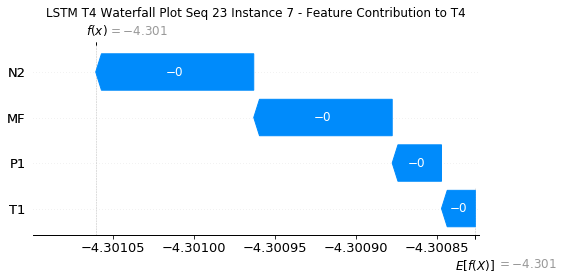

None

Contribution: [-3.13408643e-05 -2.05467839e-05 -9.76413477e-05 -8.71054545e-05]


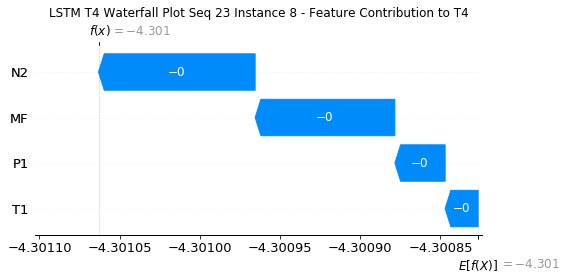

None

Contribution: [-3.20939715e-05 -2.34172807e-05 -1.00917769e-04 -8.87547416e-05]


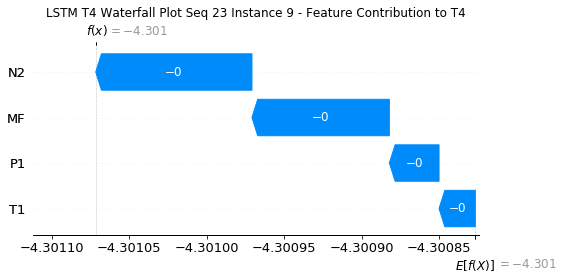

None

Contribution: [-3.39828093e-05 -2.37265212e-05 -1.07171656e-04 -9.70049985e-05]


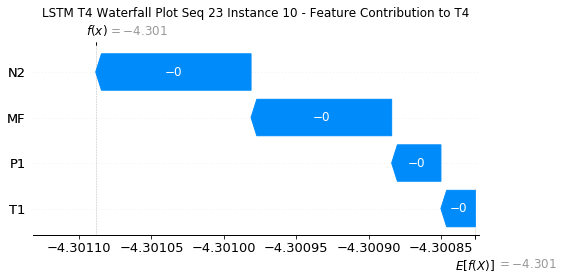

None

Contribution: [-3.54287829e-05 -2.44135358e-05 -1.12070386e-04 -9.99577613e-05]


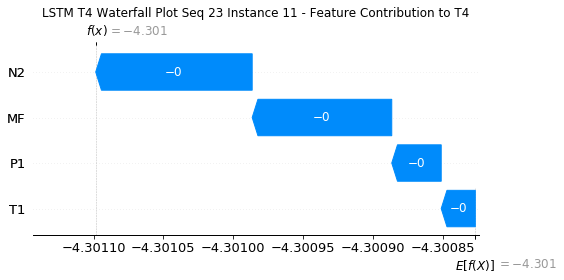

None

Contribution: [-3.77041995e-05 -2.59278943e-05 -1.19222963e-04 -1.06506103e-04]


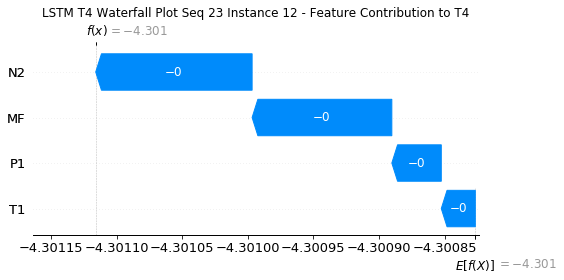

None

Contribution: [-4.12663208e-05 -2.87621157e-05 -1.28948547e-04 -1.15794305e-04]


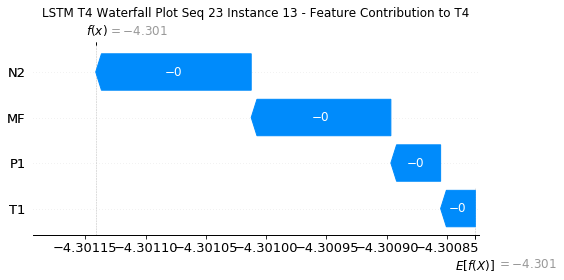

None

Contribution: [-4.55670423e-05 -3.19863590e-05 -1.45356782e-04 -1.31234943e-04]


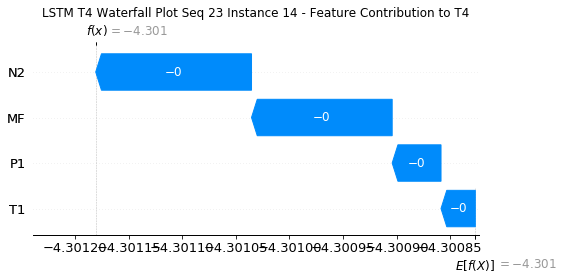

None

Contribution: [-5.20718105e-05 -3.58073159e-05 -1.64455270e-04 -1.45886933e-04]


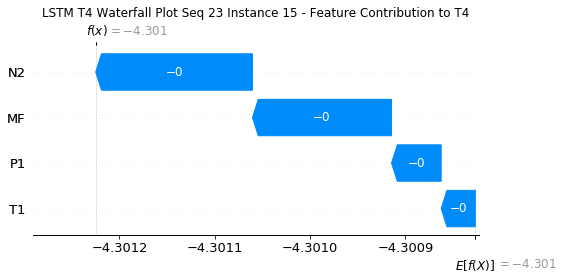

None

Contribution: [-5.33685199e-05 -3.73910633e-05 -1.68668205e-04 -1.53193019e-04]


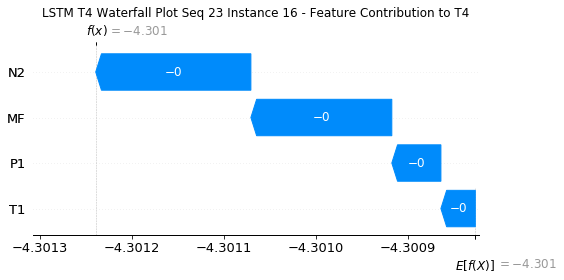

None

Contribution: [-3.52513154e-05 -2.10603090e-05 -1.10171051e-04 -9.90055816e-05]


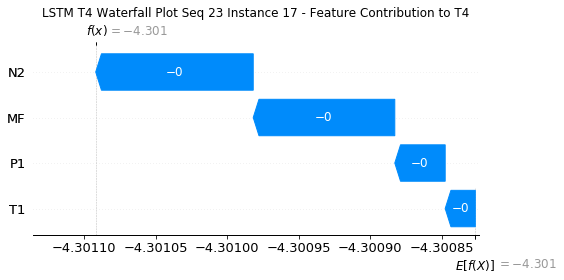

None

Contribution: [1.27993654e-05 1.99906974e-05 4.89048428e-05 5.11954114e-05]


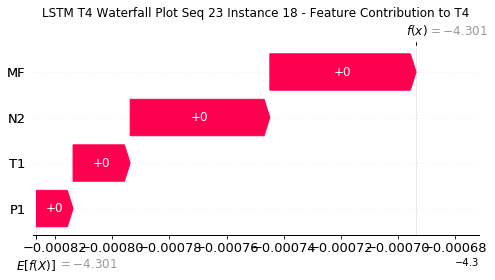

None

Contribution: [6.99199491e-05 6.78510018e-05 2.36816151e-04 2.29969758e-04]


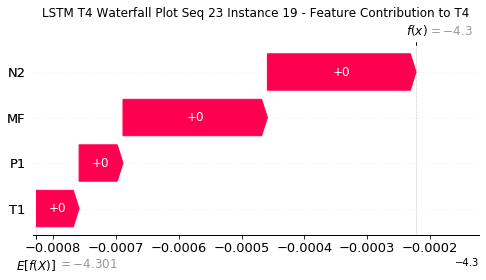

None

Contribution: [3.03193835e-05 3.58070049e-05 1.06274690e-04 1.15376239e-04]


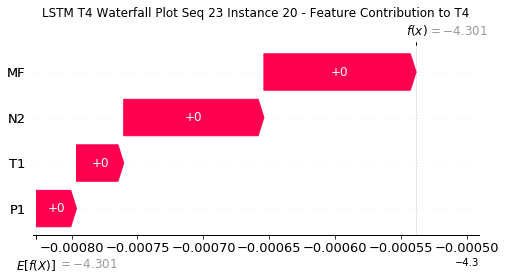

None

Contribution: [-0.00030968 -0.00022376 -0.00102099 -0.00093532]


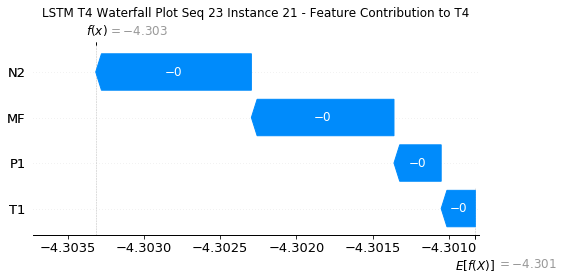

None

Contribution: [-0.00112658 -0.00066077 -0.00369154 -0.0034866 ]


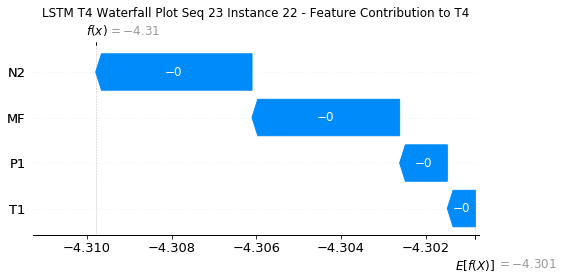

None

Contribution: [-0.00238906 -0.00097412 -0.00762458 -0.0074157 ]


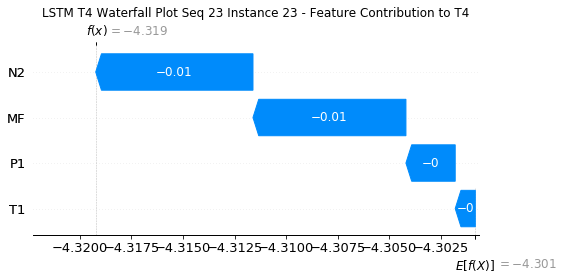

None

Contribution: [-0.00204611  0.00114855 -0.00548828 -0.00668662]


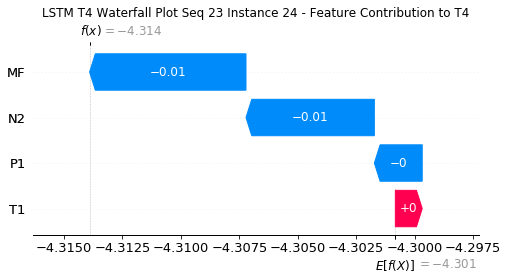

None

Contribution: [-0.00196475 -0.00143131 -0.00631406 -0.00592292]


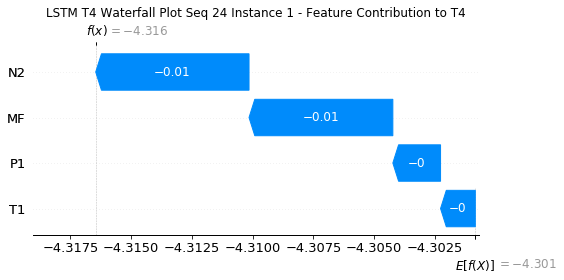

None

Contribution: [ 0.00029113 -0.00010493  0.0008123   0.00085079]


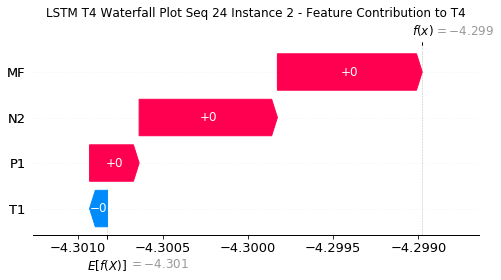

None

Contribution: [-7.29708887e-06  3.45903505e-06 -1.57577592e-05 -1.62674639e-05]


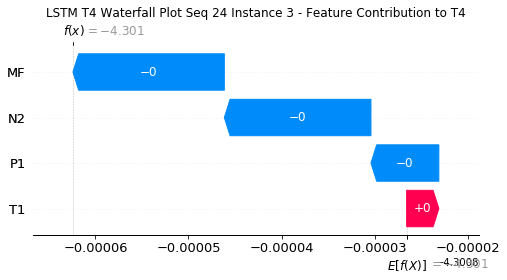

None

Contribution: [-1.65692078e-05 -7.17363952e-06 -5.05241260e-05 -4.26532953e-05]


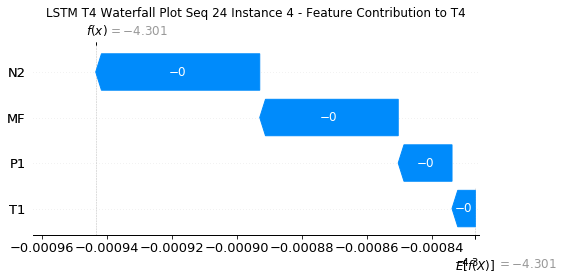

None

Contribution: [-2.78767598e-05 -1.68412656e-05 -8.87419270e-05 -7.52891244e-05]


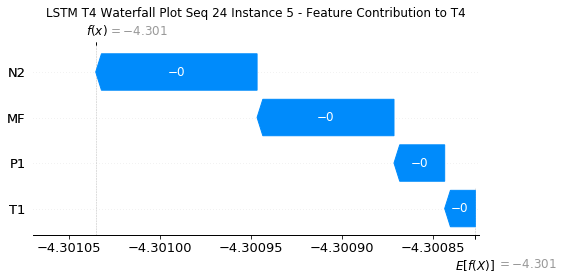

None

Contribution: [-3.13278731e-05 -1.90101475e-05 -9.82504388e-05 -8.61543113e-05]


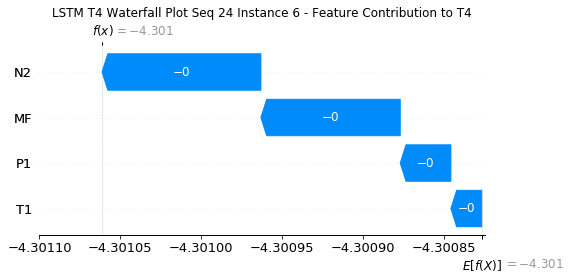

None

Contribution: [-3.04010023e-05 -1.92177874e-05 -9.72834023e-05 -8.50892534e-05]


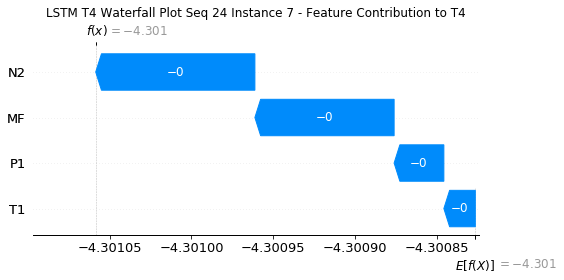

None

Contribution: [-3.07112006e-05 -1.80631414e-05 -9.70906235e-05 -8.60918427e-05]


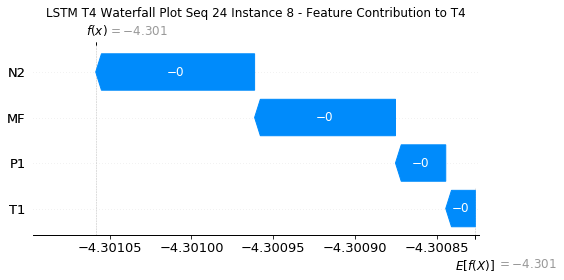

None

Contribution: [-3.12703750e-05 -1.96030823e-05 -1.00019502e-04 -8.86450470e-05]


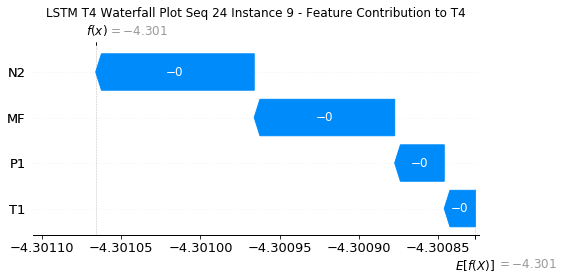

None

Contribution: [-3.35980700e-05 -2.06789199e-05 -1.05785344e-04 -9.36362092e-05]


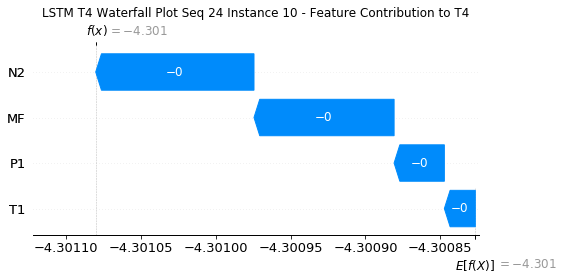

None

Contribution: [-3.54925908e-05 -2.40362051e-05 -1.11402965e-04 -9.95080585e-05]


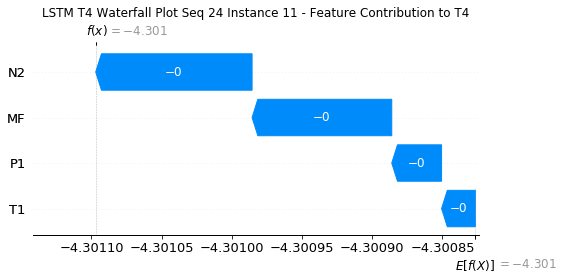

None

Contribution: [-3.76940246e-05 -2.58405098e-05 -1.18530532e-04 -1.06452477e-04]


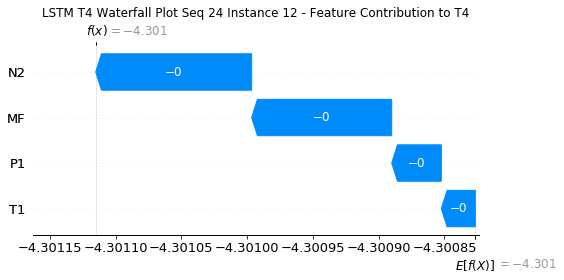

None

Contribution: [-4.07855321e-05 -2.95871685e-05 -1.27875757e-04 -1.15558122e-04]


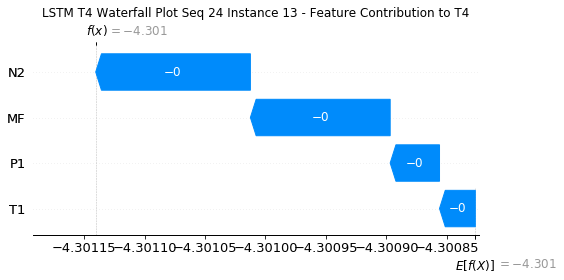

None

Contribution: [-4.57566125e-05 -3.27593925e-05 -1.44565091e-04 -1.31493637e-04]


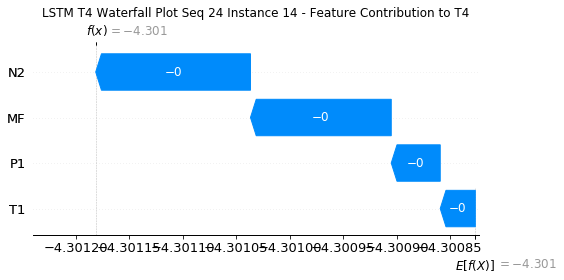

None

Contribution: [-5.19016112e-05 -3.89509566e-05 -1.65232115e-04 -1.49802586e-04]


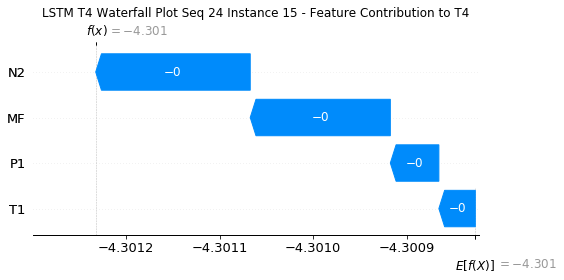

None

Contribution: [-5.35751324e-05 -3.94879540e-05 -1.68301180e-04 -1.54340303e-04]


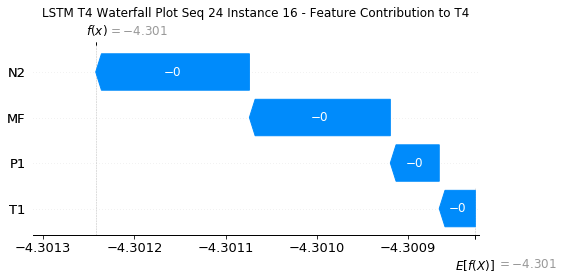

None

Contribution: [-3.56151417e-05 -2.34400973e-05 -1.10915165e-04 -1.00446326e-04]


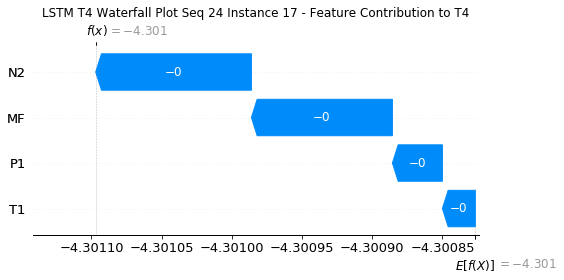

None

Contribution: [1.15939021e-05 1.79947418e-05 4.59652066e-05 4.76416415e-05]


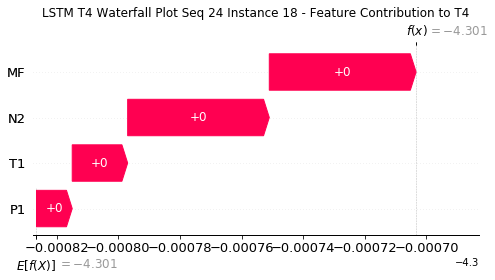

None

Contribution: [6.92252506e-05 6.82962309e-05 2.34400639e-04 2.28356174e-04]


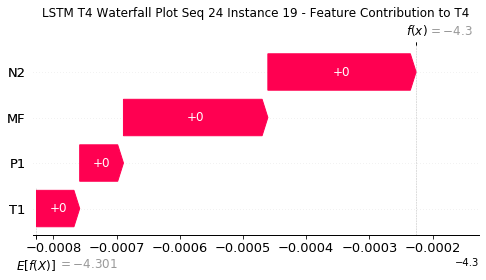

None

Contribution: [3.08893559e-05 3.35814418e-05 1.08732810e-04 1.16504044e-04]


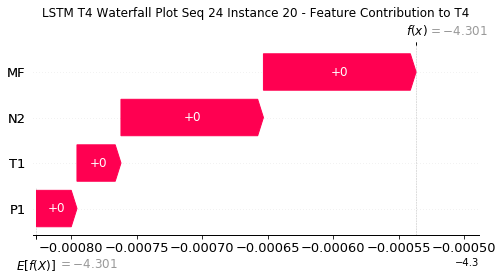

None

Contribution: [-0.00030971 -0.0002505  -0.00100882 -0.00093811]


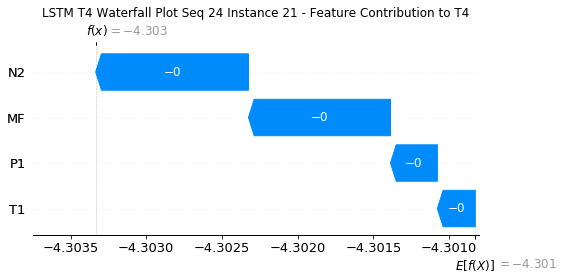

None

Contribution: [-0.00113318 -0.00078824 -0.00366657 -0.00350073]


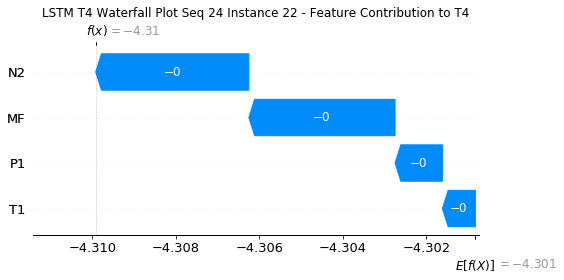

None

Contribution: [-0.00242474 -0.00133622 -0.00760738 -0.00759829]


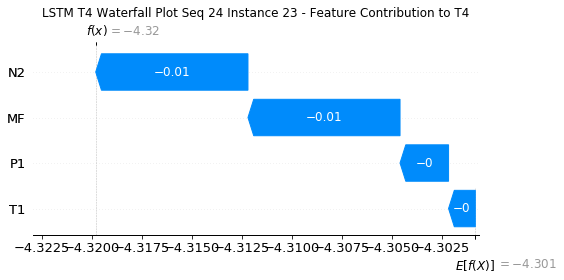

None

Contribution: [-0.00153841  0.00098619 -0.00539537 -0.00612333]


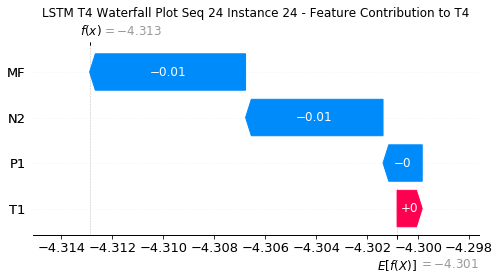

None

Contribution: [-0.00178953 -0.00164267 -0.00624587 -0.00559093]


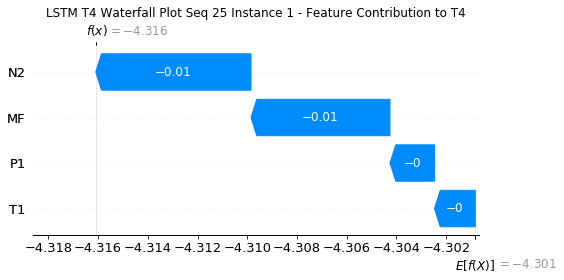

None

Contribution: [ 2.66405453e-04 -2.77521957e-05  8.11386821e-04  8.21502234e-04]


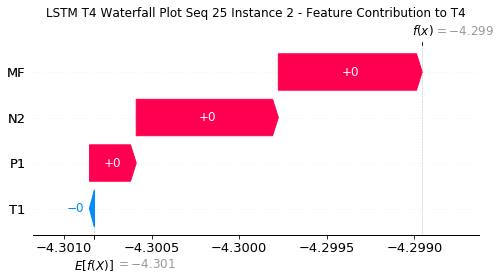

None

Contribution: [-6.90211717e-06 -3.88308317e-07 -1.57644580e-05 -1.63081570e-05]


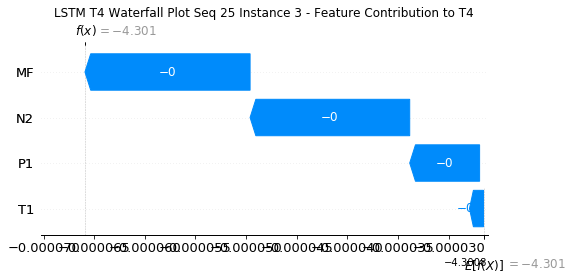

None

Contribution: [-1.67878332e-05 -9.99274707e-06 -5.08278650e-05 -4.39604305e-05]


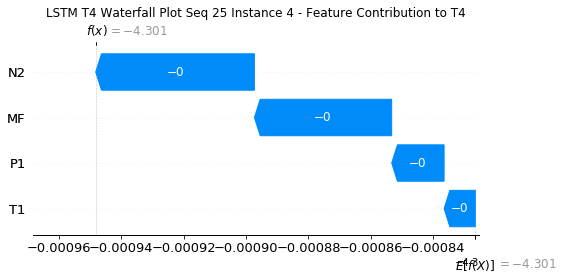

None

Contribution: [-2.78788225e-05 -1.94862977e-05 -8.85216362e-05 -7.59512810e-05]


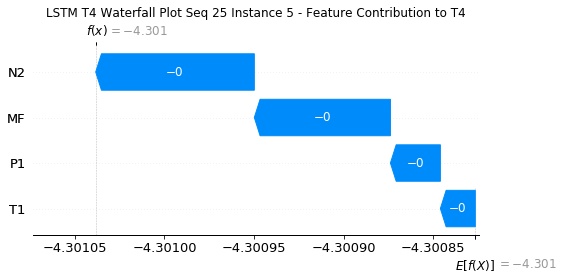

None

Contribution: [-2.86818132e-05 -2.01954776e-05 -9.64753726e-05 -8.07273466e-05]


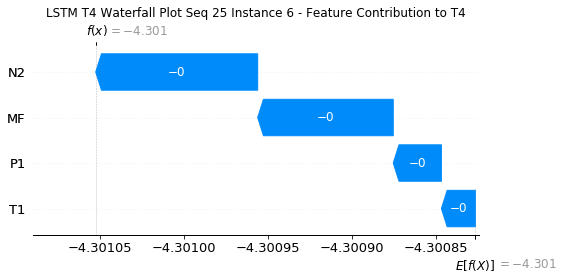

None

Contribution: [-3.02751358e-05 -2.17953916e-05 -9.69260714e-05 -8.54579648e-05]


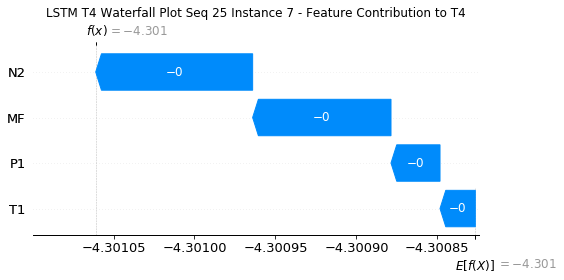

None

Contribution: [-3.02223293e-05 -2.13723104e-05 -9.66986426e-05 -8.50479515e-05]


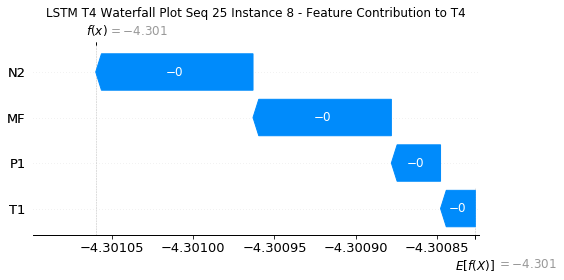

None

Contribution: [-3.12333990e-05 -2.27593750e-05 -1.00084657e-04 -8.88992187e-05]


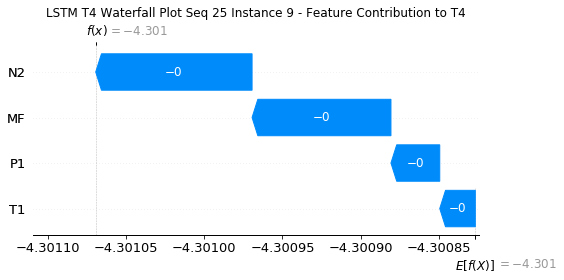

None

Contribution: [-3.37028157e-05 -2.40660064e-05 -1.05925505e-04 -9.35407887e-05]


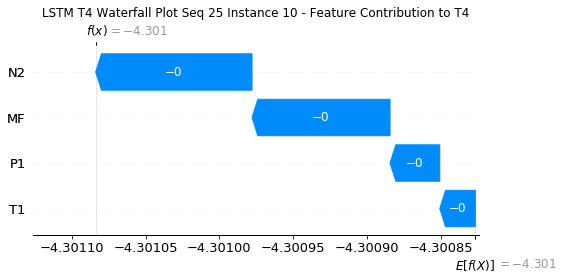

None

Contribution: [-3.46062613e-05 -2.48618656e-05 -1.10918779e-04 -9.81558609e-05]


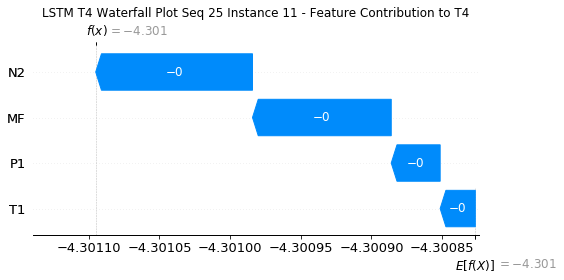

None

Contribution: [-3.67148677e-05 -2.67494193e-05 -1.17889377e-04 -1.05021234e-04]


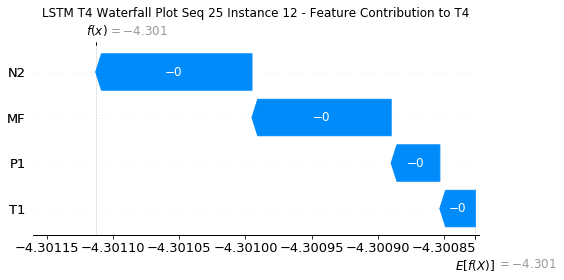

None

Contribution: [-3.87540382e-05 -2.89945738e-05 -1.26922438e-04 -1.12427436e-04]


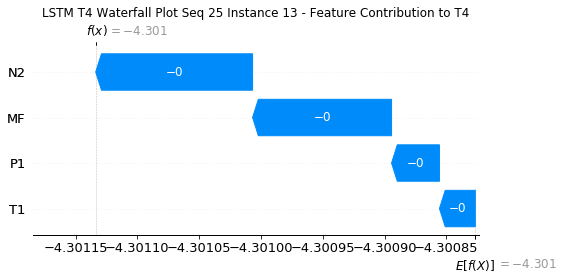

None

Contribution: [-4.43936328e-05 -3.34194717e-05 -1.43678313e-04 -1.29356019e-04]


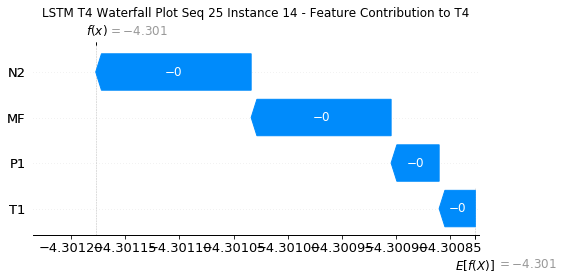

None

Contribution: [-5.25176827e-05 -3.92939984e-05 -1.64317817e-04 -1.49955029e-04]


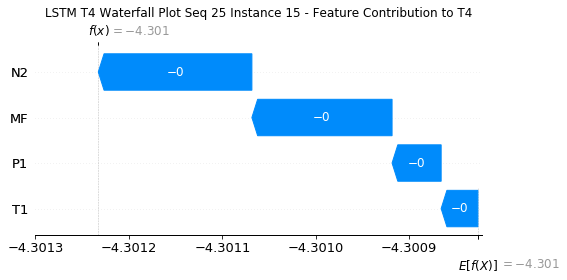

None

Contribution: [-5.19823679e-05 -3.99741018e-05 -1.67263060e-04 -1.51672471e-04]


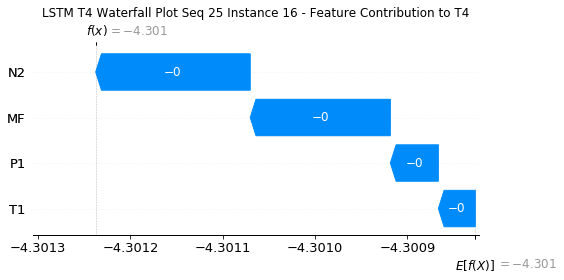

None

Contribution: [-3.49349608e-05 -2.41660926e-05 -1.10748387e-04 -9.97283492e-05]


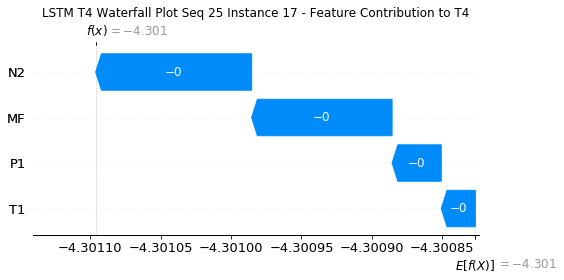

None

Contribution: [1.12743303e-05 1.71883740e-05 4.47012950e-05 4.61993739e-05]


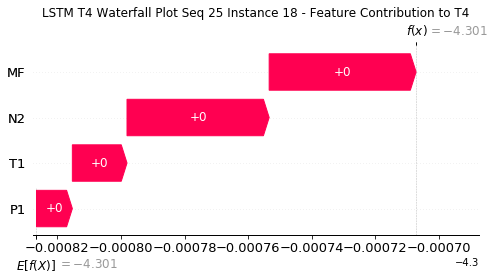

None

Contribution: [6.86400957e-05 6.85559906e-05 2.33083212e-04 2.27125976e-04]


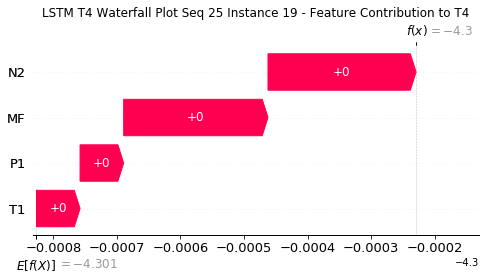

None

Contribution: [3.12035110e-05 3.19652556e-05 1.08681682e-04 1.16069325e-04]


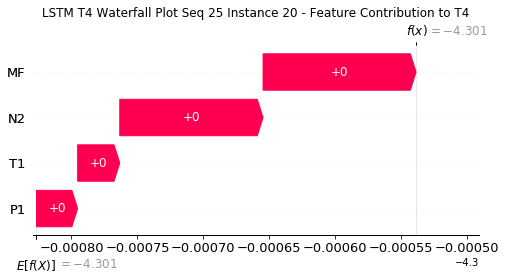

None

Contribution: [-0.00030455 -0.00026669 -0.00100515 -0.00093934]


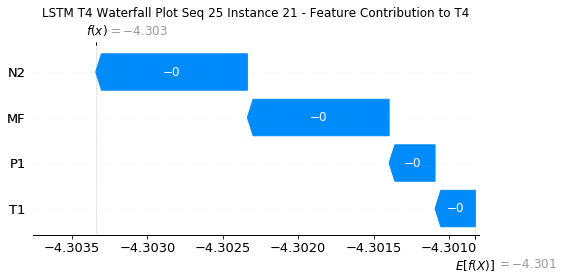

None

Contribution: [-0.00111574 -0.00083548 -0.0036593  -0.00350389]


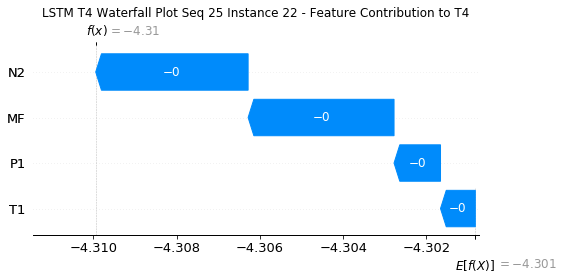

None

Contribution: [-0.00237338 -0.00161786 -0.00760466 -0.00759565]


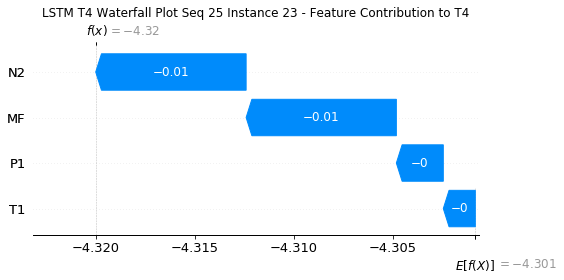

None

Contribution: [-1.81692832e-03 -2.01359510e-05 -5.50080529e-03 -6.61241036e-03]


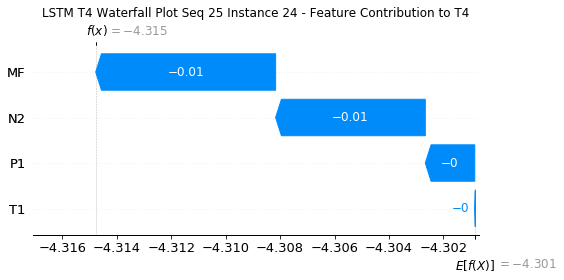

None

Contribution: [-0.00193294 -0.00179792 -0.00623395 -0.00591733]


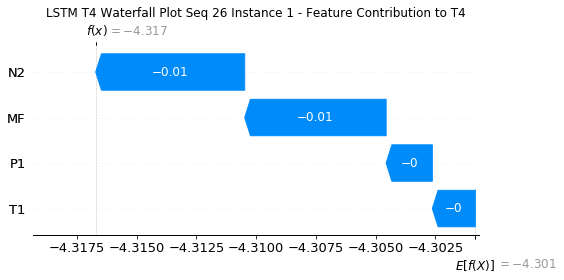

None

Contribution: [2.80321133e-04 3.88771259e-05 8.08502419e-04 8.82111136e-04]


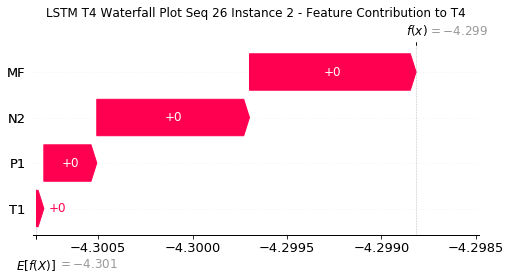

None

Contribution: [-7.37811939e-06 -3.93180886e-06 -1.60029093e-05 -1.78102179e-05]


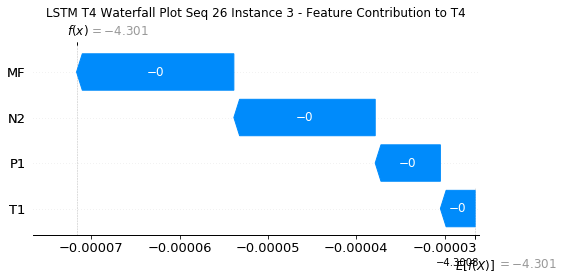

None

Contribution: [-1.56424439e-05 -1.14903353e-05 -5.05363947e-05 -4.19083781e-05]


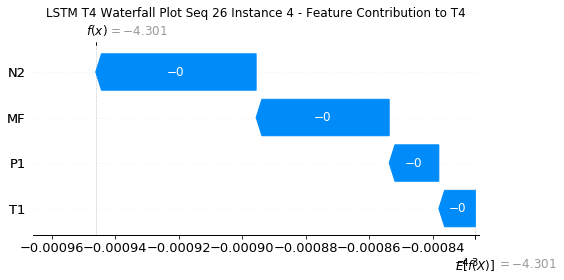

None

Contribution: [-2.69246666e-05 -2.12083203e-05 -8.84007550e-05 -7.44332302e-05]


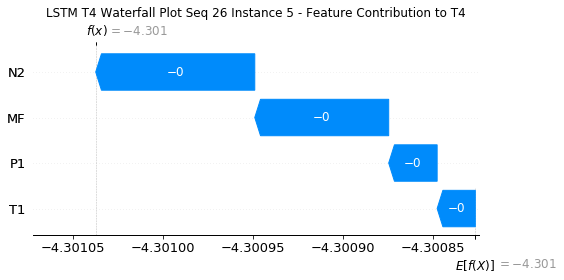

None

Contribution: [-3.05150912e-05 -2.40817337e-05 -9.79058157e-05 -8.53646968e-05]


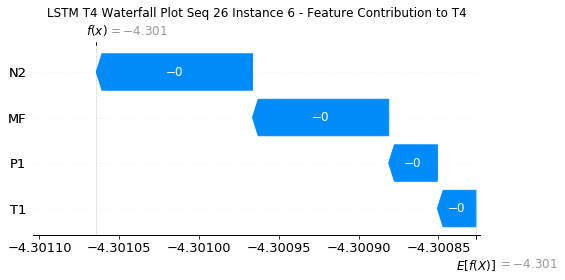

None

Contribution: [-2.95110308e-05 -2.31748565e-05 -9.66328795e-05 -8.42173612e-05]


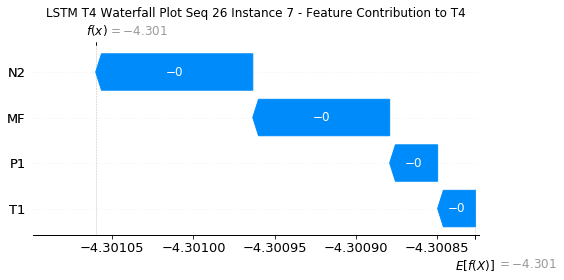

None

Contribution: [-3.03798075e-05 -2.26227162e-05 -9.70550826e-05 -8.62701969e-05]


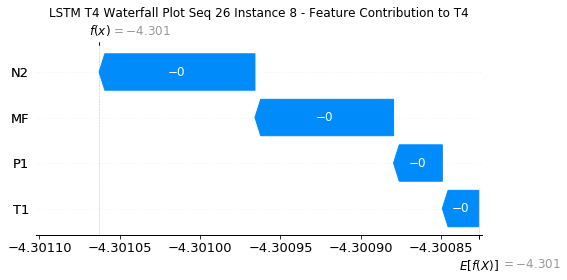

None

Contribution: [-3.32533930e-05 -2.38603383e-05 -1.01367019e-04 -9.31239993e-05]


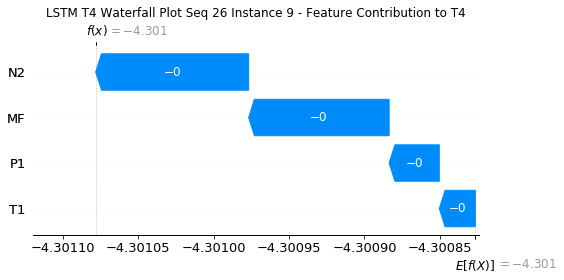

None

Contribution: [-3.41190893e-05 -2.54521819e-05 -1.06485039e-04 -9.61175074e-05]


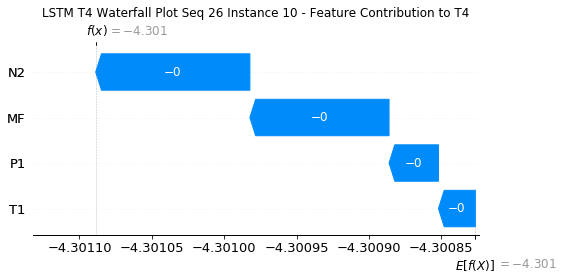

None

Contribution: [-3.45787052e-05 -2.60987576e-05 -1.11003859e-04 -9.92096225e-05]


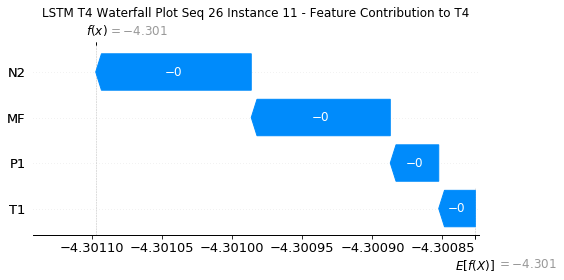

None

Contribution: [-3.66596725e-05 -2.78219263e-05 -1.18113335e-04 -1.05895235e-04]


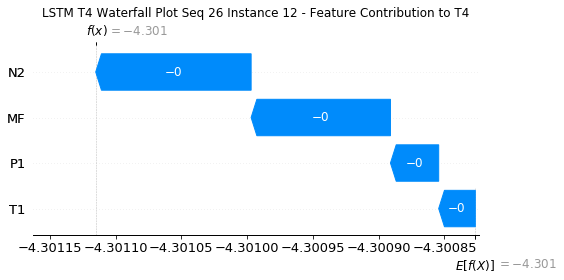

None

Contribution: [-4.09338714e-05 -3.28358569e-05 -1.28303633e-04 -1.17219799e-04]


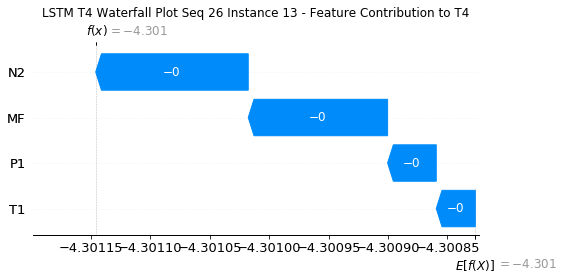

None

Contribution: [-4.46154649e-05 -3.43964362e-05 -1.43995958e-04 -1.31267781e-04]


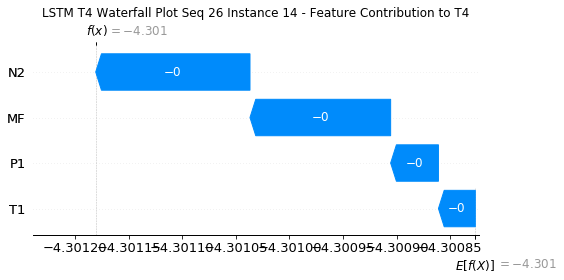

None

Contribution: [-5.15524963e-05 -4.06772473e-05 -1.63836936e-04 -1.49735420e-04]


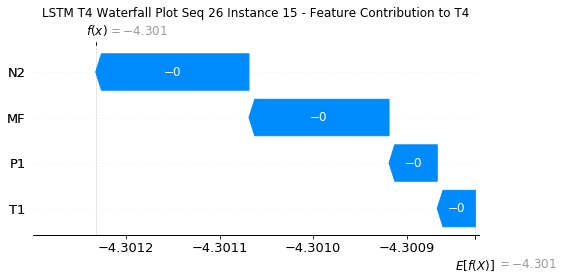

None

Contribution: [-5.25411058e-05 -4.04090019e-05 -1.67648050e-04 -1.54124645e-04]


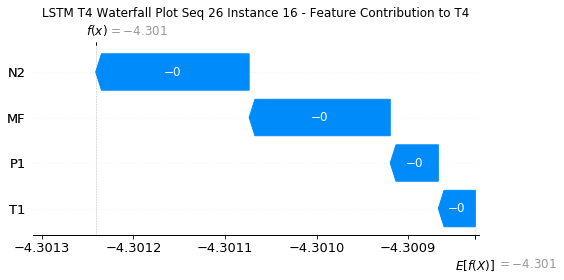

None

Contribution: [-3.53415092e-05 -2.39552953e-05 -1.11231614e-04 -1.01307103e-04]


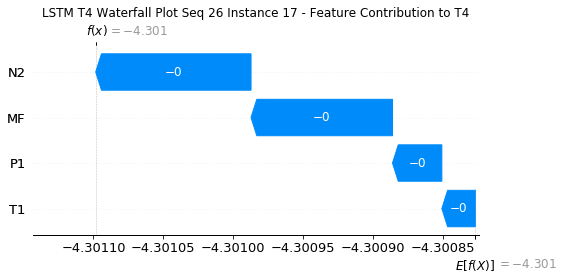

None

Contribution: [1.12182182e-05 1.74764275e-05 4.38521483e-05 4.60074658e-05]


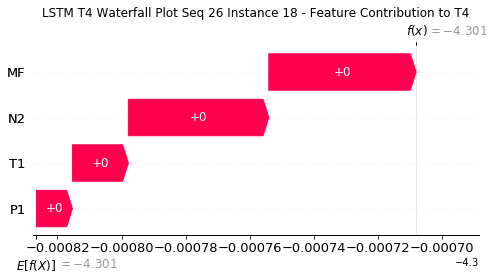

None

Contribution: [6.76998950e-05 6.71561224e-05 2.29879418e-04 2.24311608e-04]


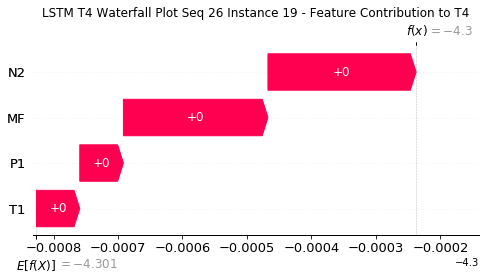

None

Contribution: [3.05110336e-05 3.27970507e-05 1.06233130e-04 1.13358185e-04]


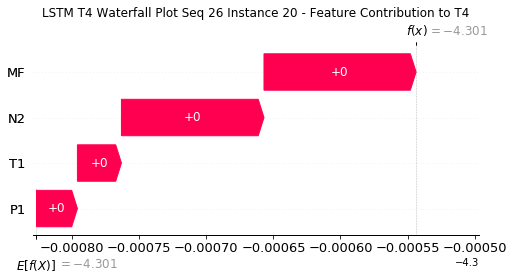

None

Contribution: [-0.00030177 -0.00024766 -0.00099899 -0.00093942]


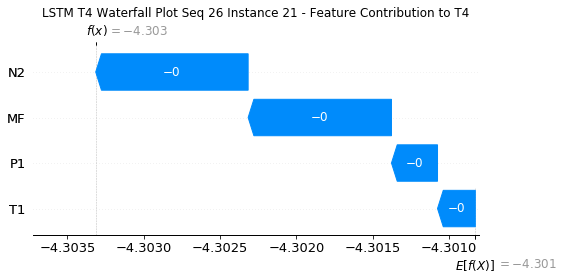

None

Contribution: [-0.00111666 -0.0007598  -0.00363549 -0.00352905]


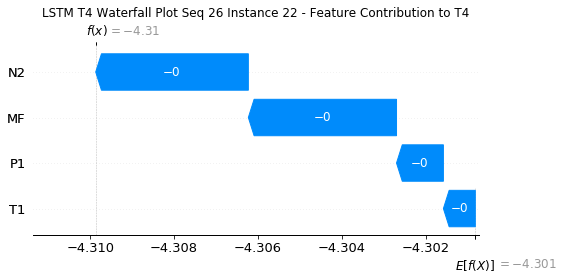

None

Contribution: [-0.00240653 -0.001435   -0.00755863 -0.00779802]


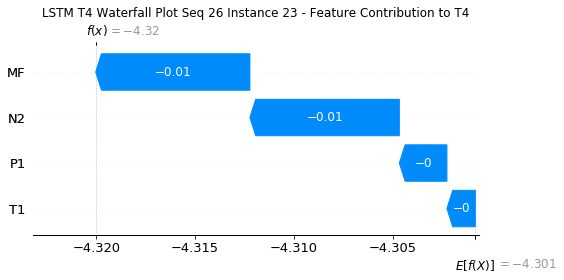

None

Contribution: [-0.00182173  0.00029298 -0.00546493 -0.00695953]


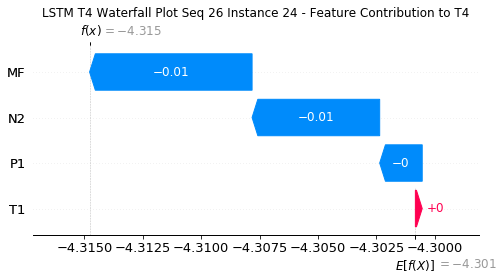

None

Contribution: [-0.00184781 -0.00152458 -0.00630419 -0.00580992]


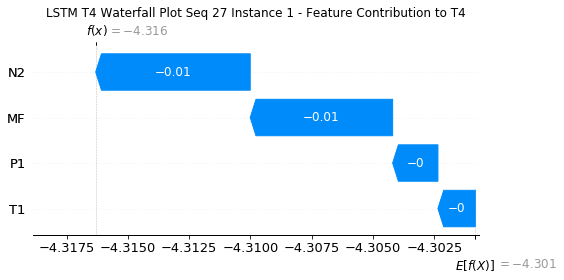

None

Contribution: [ 2.54740926e-04 -3.94840097e-05  8.14977665e-04  8.82893244e-04]


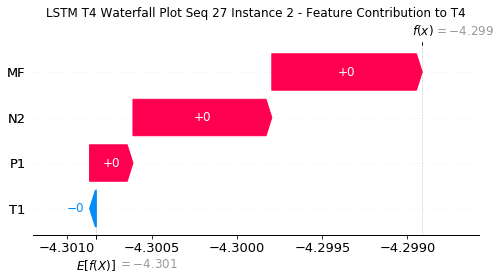

None

Contribution: [-6.81463959e-06 -2.18389804e-06 -1.60598857e-05 -1.84862469e-05]


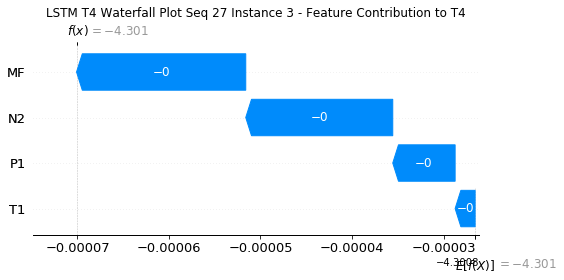

None

Contribution: [-1.64047318e-05 -1.07158793e-05 -5.05405158e-05 -4.25133620e-05]


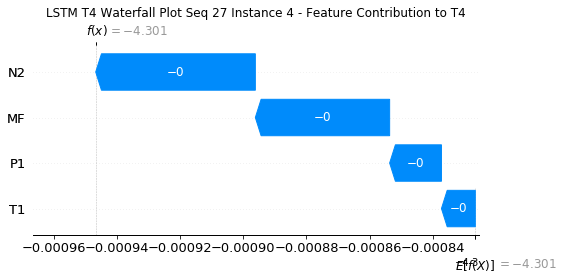

None

Contribution: [-2.77335741e-05 -2.06441257e-05 -8.88645484e-05 -7.53728490e-05]


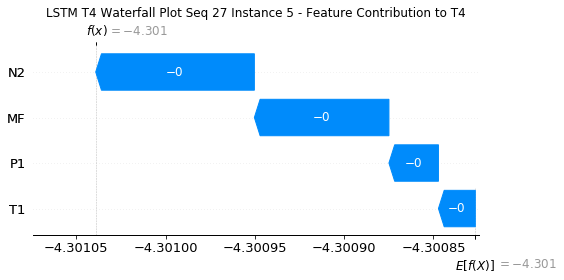

None

Contribution: [-3.04078133e-05 -2.26724260e-05 -9.82076587e-05 -8.41608271e-05]


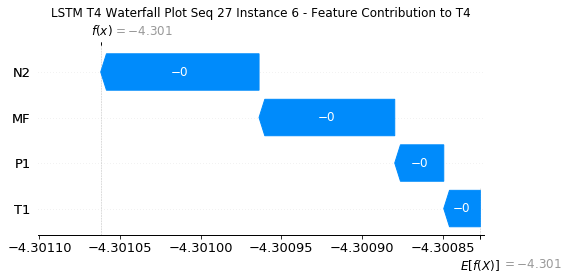

None

Contribution: [-3.01286103e-05 -2.27335547e-05 -9.76047236e-05 -8.52372601e-05]


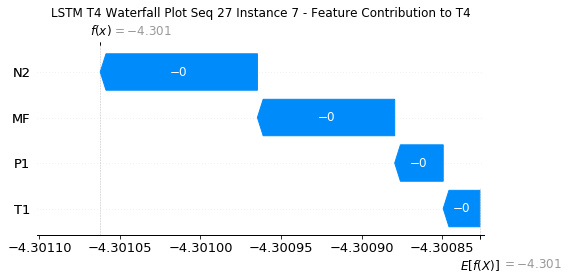

None

Contribution: [-2.98206577e-05 -2.13284965e-05 -9.67615167e-05 -8.51134051e-05]


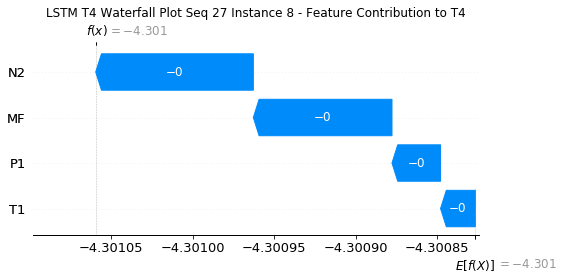

None

Contribution: [-2.96469273e-05 -1.81000435e-05 -9.87190526e-05 -8.57376557e-05]


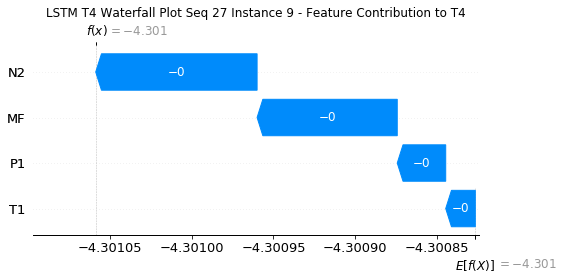

None

Contribution: [-3.20793319e-05 -2.36656920e-05 -1.05300988e-04 -9.25731947e-05]


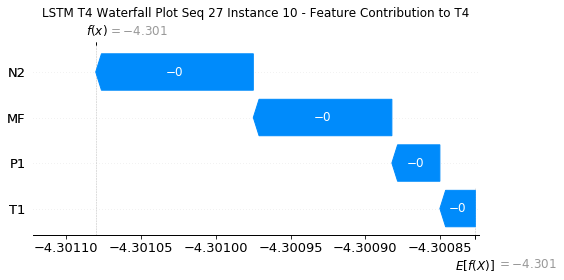

None

Contribution: [-3.51393313e-05 -2.66523367e-05 -1.11359309e-04 -9.92779665e-05]


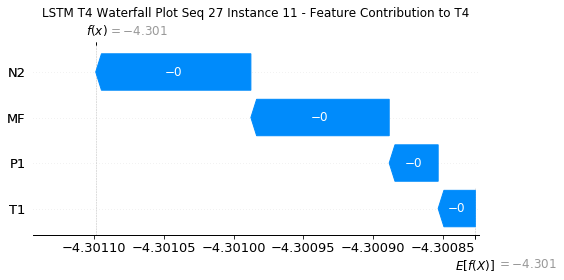

None

Contribution: [-3.73523590e-05 -2.84442435e-05 -1.18472411e-04 -1.06162542e-04]


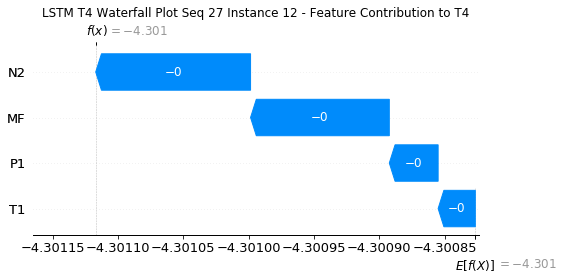

None

Contribution: [-3.96846226e-05 -3.15894693e-05 -1.27331788e-04 -1.12671065e-04]


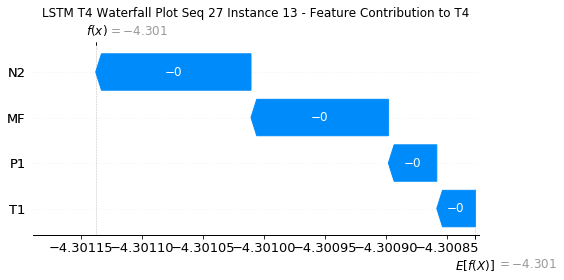

None

Contribution: [-4.47706499e-05 -3.51662616e-05 -1.44200187e-04 -1.30341321e-04]


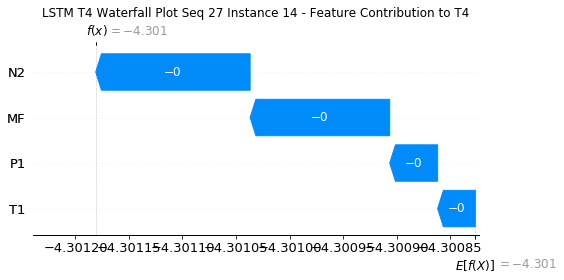

None

Contribution: [-5.14483065e-05 -4.03752077e-05 -1.63800648e-04 -1.47476548e-04]


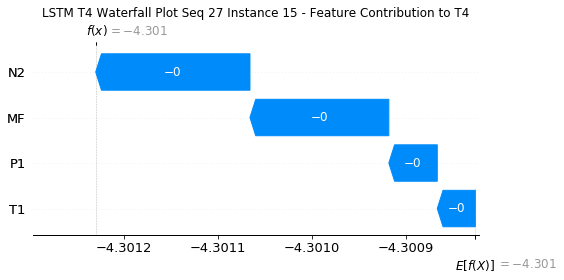

None

Contribution: [-5.23957969e-05 -4.14674047e-05 -1.67664148e-04 -1.52923683e-04]


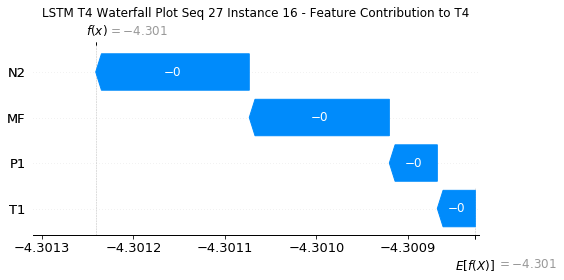

None

Contribution: [-3.46661900e-05 -2.44907719e-05 -1.10196011e-04 -9.94982018e-05]


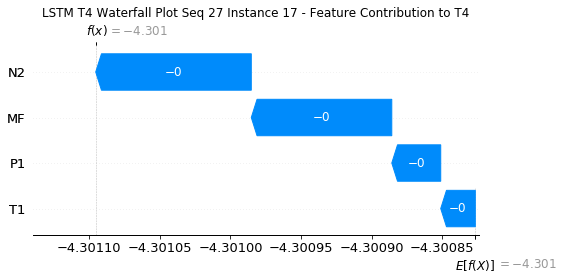

None

Contribution: [1.19305497e-05 1.77146950e-05 4.66670899e-05 4.77201926e-05]


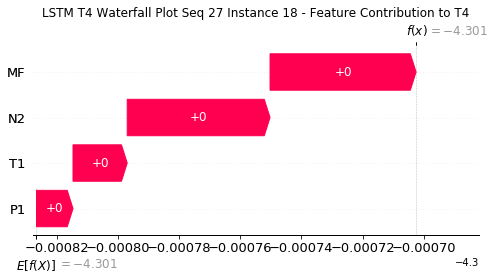

None

Contribution: [6.93404403e-05 6.92510500e-05 2.36270022e-04 2.29737082e-04]


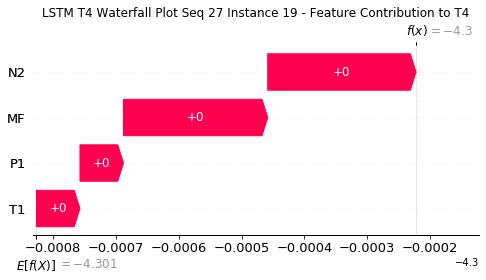

None

Contribution: [3.18265189e-05 3.23358764e-05 1.07495831e-04 1.16098736e-04]


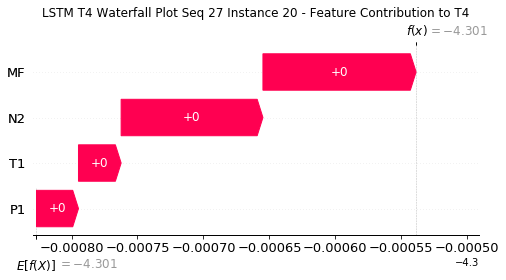

None

Contribution: [-0.00029542 -0.00026066 -0.00101589 -0.00093213]


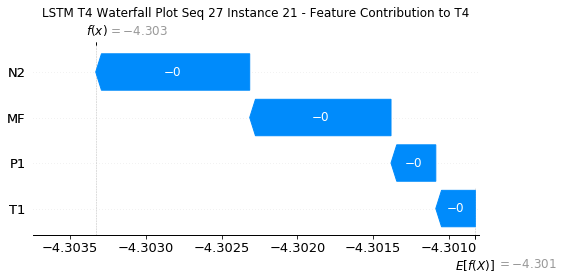

None

Contribution: [-0.00107246 -0.00080498 -0.00367214 -0.00346626]


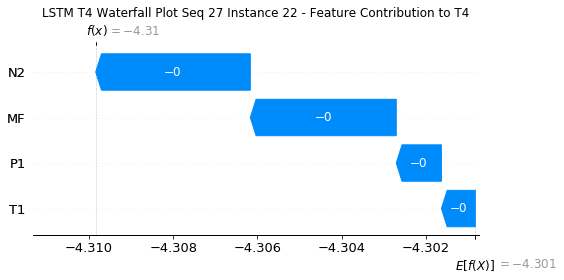

None

Contribution: [-0.00212508 -0.00145866 -0.00754608 -0.00723434]


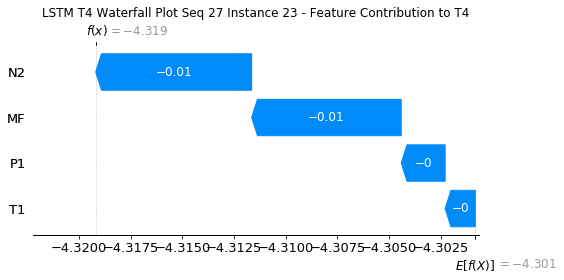

None

Contribution: [-0.00184644  0.00024514 -0.0054051  -0.00670734]


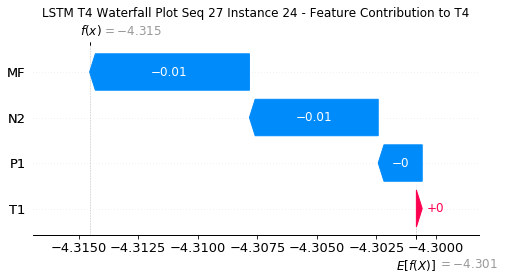

None

Contribution: [-0.00206513 -0.001695   -0.00629598 -0.00619449]


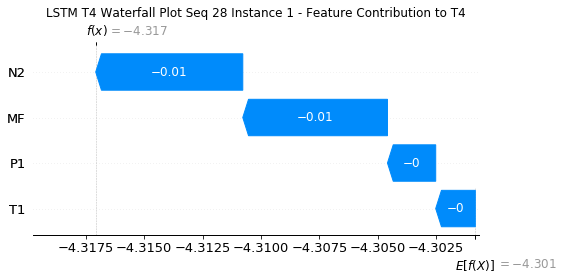

None

Contribution: [3.11170758e-04 2.42414461e-05 8.09850770e-04 9.48336070e-04]


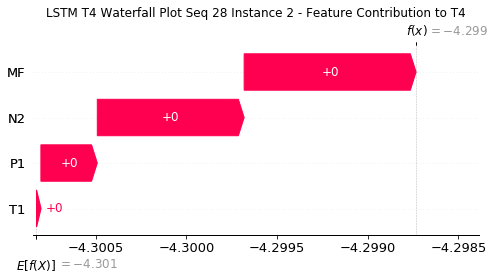

None

Contribution: [-8.13232699e-06 -3.78913832e-06 -1.60521111e-05 -2.14552482e-05]


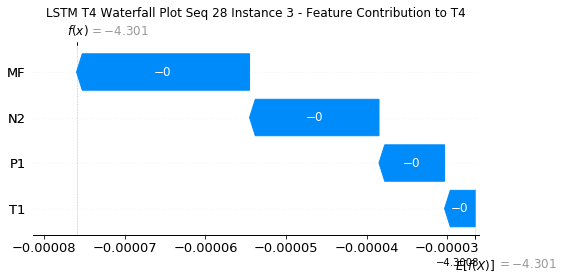

None

Contribution: [-1.72164211e-05 -1.52129246e-05 -5.17137679e-05 -4.44009150e-05]


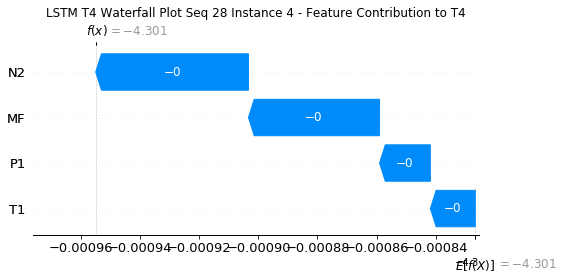

None

Contribution: [-2.82919336e-05 -2.46685971e-05 -9.00921773e-05 -7.66937434e-05]


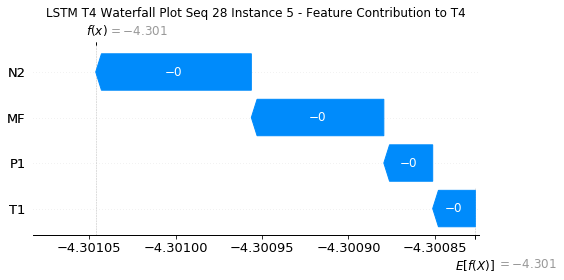

None

Contribution: [-3.31026323e-05 -2.92412526e-05 -1.00726083e-04 -9.03013152e-05]


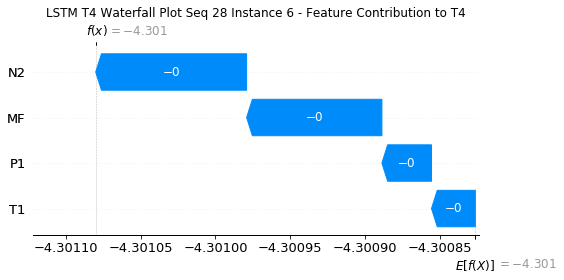

None

Contribution: [-3.12156732e-05 -2.46522296e-05 -9.87134157e-05 -8.67872413e-05]


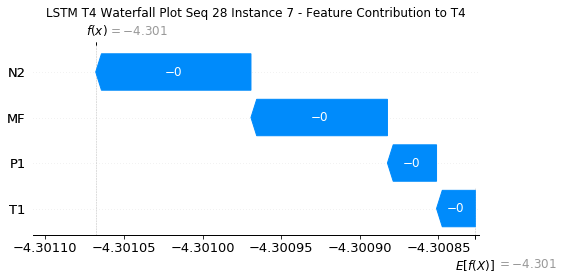

None

Contribution: [-3.14845409e-05 -2.25935493e-05 -9.81196140e-05 -8.75092585e-05]


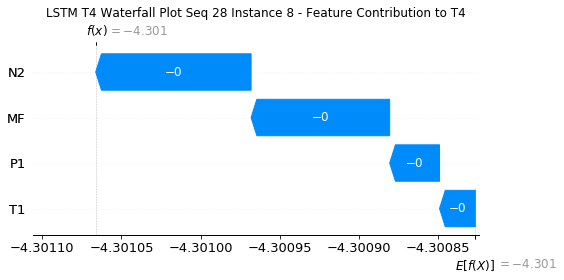

None

Contribution: [-3.23284774e-05 -2.29313386e-05 -1.01425661e-04 -9.24679923e-05]


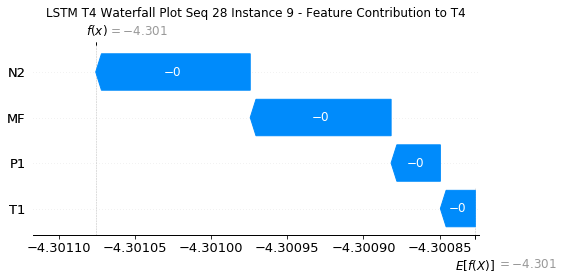

None

Contribution: [-3.32511023e-05 -2.33040908e-05 -1.06503466e-04 -9.37937557e-05]


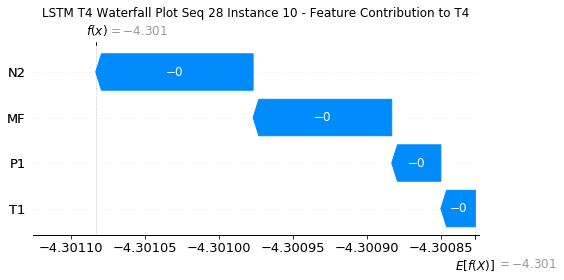

None

Contribution: [-3.64406675e-05 -2.70396584e-05 -1.12801497e-04 -1.01356987e-04]


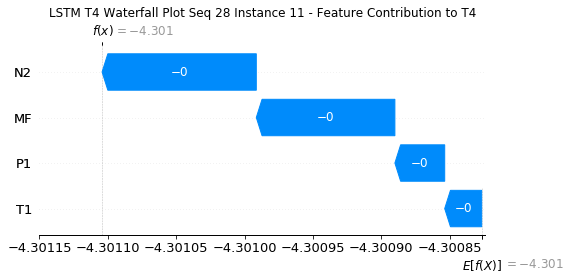

None

Contribution: [-3.91606930e-05 -2.76095945e-05 -1.19968630e-04 -1.08652584e-04]


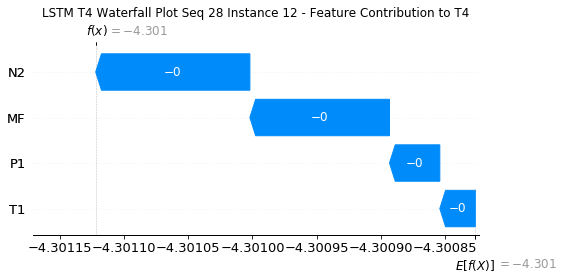

None

Contribution: [-3.91321319e-05 -3.00577462e-05 -1.28505475e-04 -1.14636882e-04]


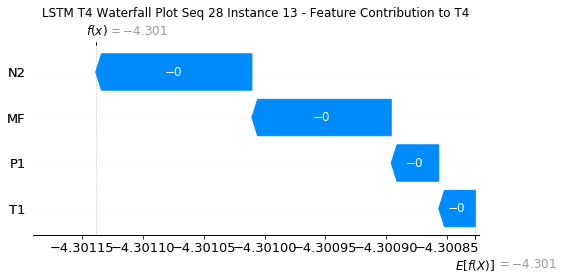

None

Contribution: [-4.83528035e-05 -3.03386599e-05 -1.46509385e-04 -1.35130907e-04]


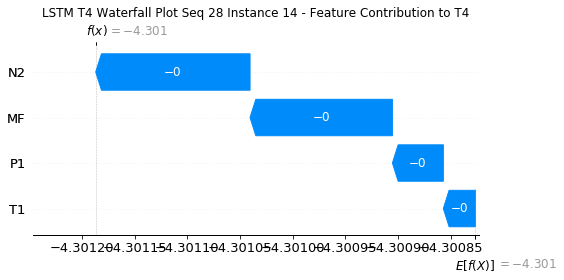

None

Contribution: [-5.20778838e-05 -3.26611028e-05 -1.65708116e-04 -1.51254810e-04]


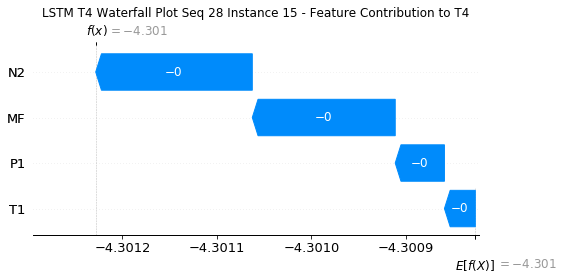

None

Contribution: [-5.71076139e-05 -3.13231239e-05 -1.69695247e-04 -1.57775938e-04]


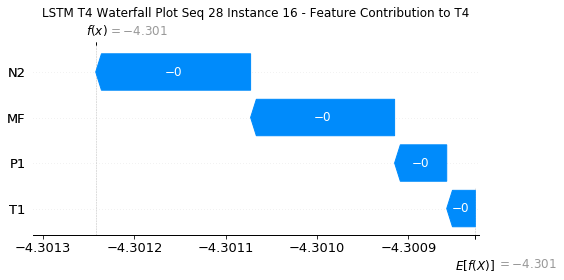

None

Contribution: [-3.77664004e-05 -1.32514345e-05 -1.09605348e-04 -1.00390681e-04]


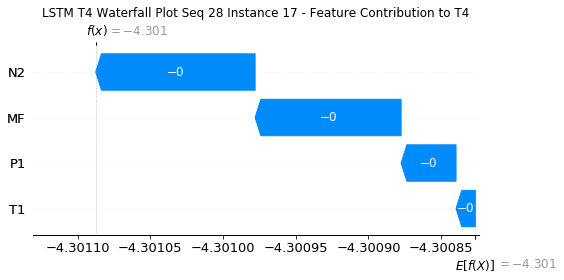

None

Contribution: [1.40402143e-05 2.07126941e-05 5.13966520e-05 5.43723629e-05]


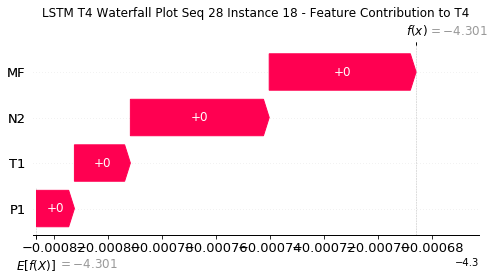

None

Contribution: [7.24585815e-05 6.31419205e-05 2.38885693e-04 2.34246065e-04]


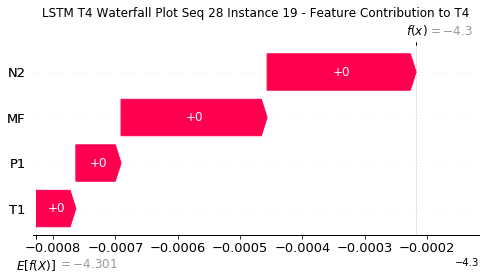

None

Contribution: [2.42040000e-05 5.10035125e-05 1.04093171e-04 1.09106687e-04]


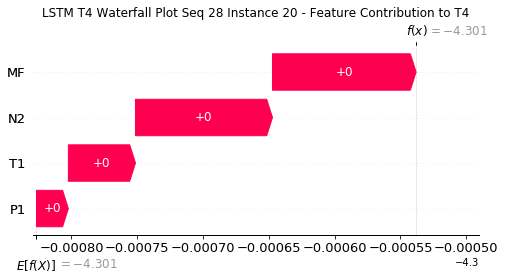

None

Contribution: [-3.78446108e-04 -5.74984296e-05 -1.04151936e-03 -1.01494868e-03]


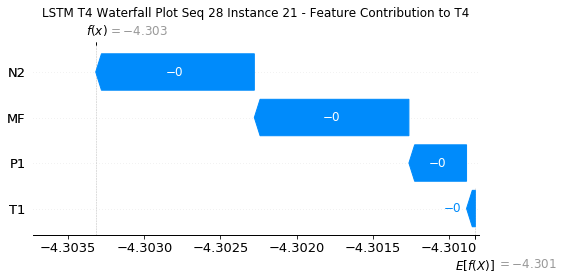

None

Contribution: [-1.35708894e-03  2.50107840e-05 -3.74212105e-03 -3.71210532e-03]


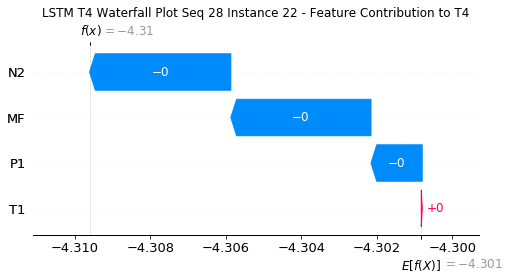

None

Contribution: [-0.00328288  0.00145891 -0.00780114 -0.00844016]


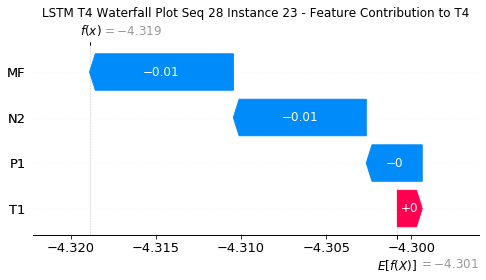

None

Contribution: [-0.00351634  0.00532574 -0.00578    -0.00815509]


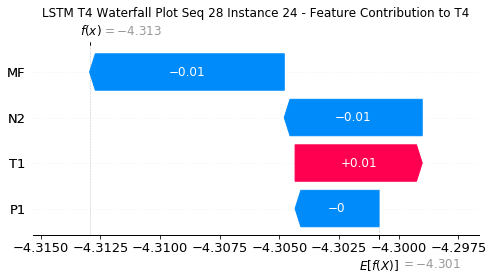

None

Contribution: [-0.00259989  0.00014201 -0.00657728 -0.00625982]


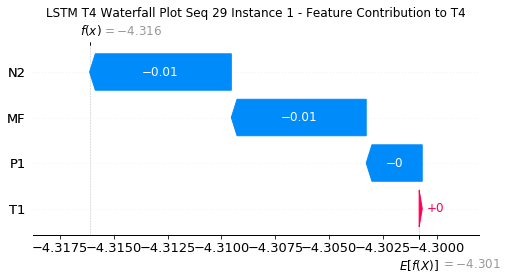

None

Contribution: [ 0.00056674 -0.00063292  0.00088443  0.00111165]


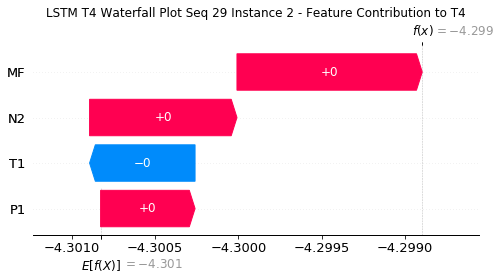

None

Contribution: [-1.72812334e-05  2.53186768e-05 -1.96853650e-05 -2.61123430e-05]


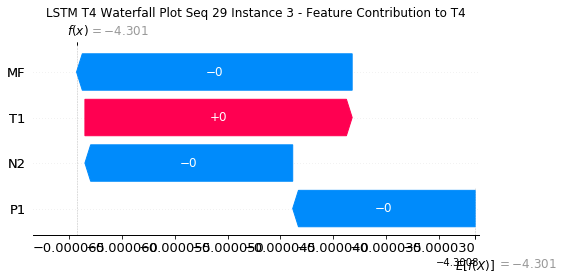

None

Contribution: [-2.34229396e-05  1.19968571e-05 -5.21119971e-05 -4.74565957e-05]


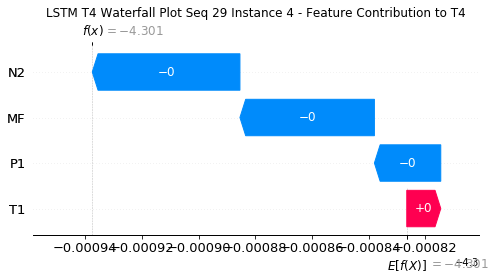

None

Contribution: [-3.56636099e-05  4.23241848e-06 -9.02818008e-05 -8.04705251e-05]


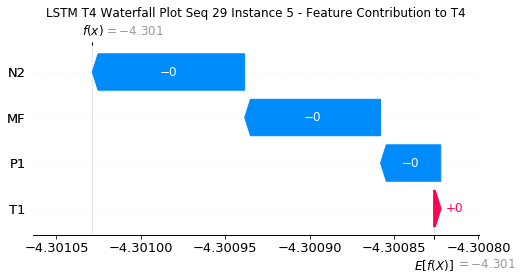

None

Contribution: [-3.31660438e-05  2.20607061e-06 -9.69450375e-05 -8.22312463e-05]


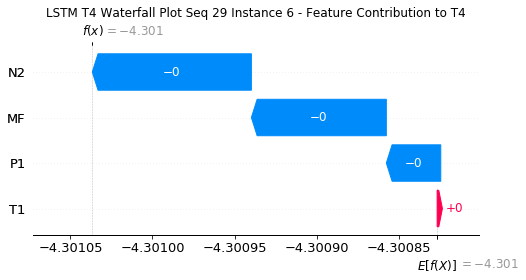

None

Contribution: [-3.73171438e-05  1.24787182e-06 -9.78430258e-05 -8.90982242e-05]


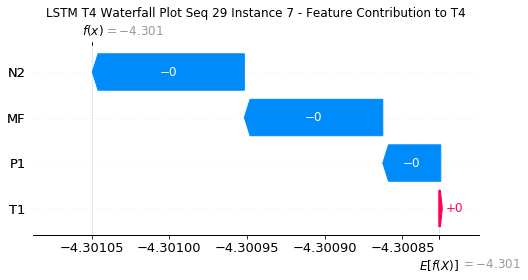

None

Contribution: [-3.74241993e-05  2.98511595e-06 -9.77949827e-05 -8.93648774e-05]


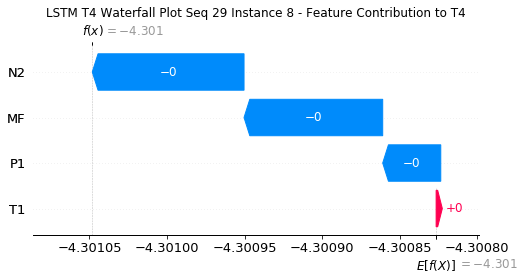

None

Contribution: [-4.21448201e-05  5.24607628e-07 -1.03380120e-04 -1.00792453e-04]


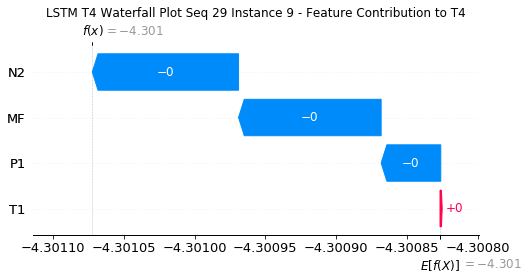

None

Contribution: [-4.40782596e-05 -5.66524914e-07 -1.08733056e-04 -1.03155499e-04]


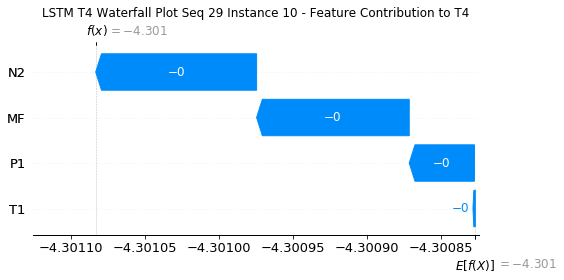

None

Contribution: [-4.32362030e-05 -3.31384862e-06 -1.13169870e-04 -1.05549676e-04]


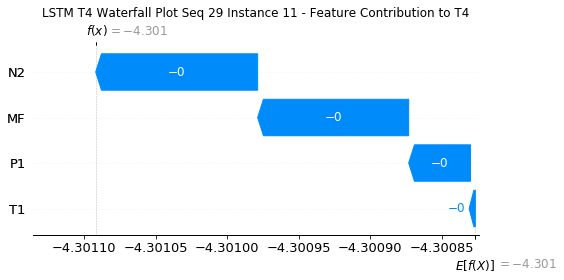

None

Contribution: [-4.45701600e-05 -5.51182906e-06 -1.20100663e-04 -1.11373977e-04]


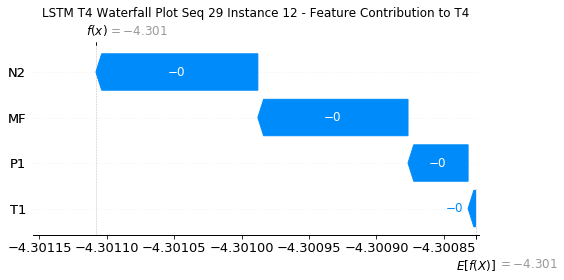

None

Contribution: [-4.96299537e-05 -4.74319769e-06 -1.30664314e-04 -1.23308640e-04]


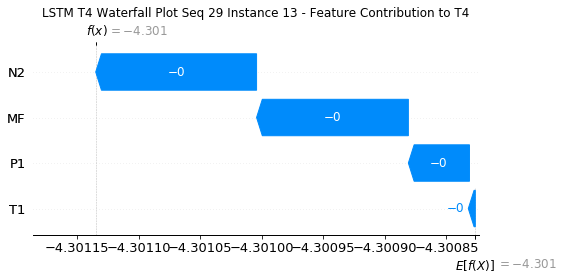

None

Contribution: [-5.26607771e-05 -1.30959975e-05 -1.47442127e-04 -1.37713604e-04]


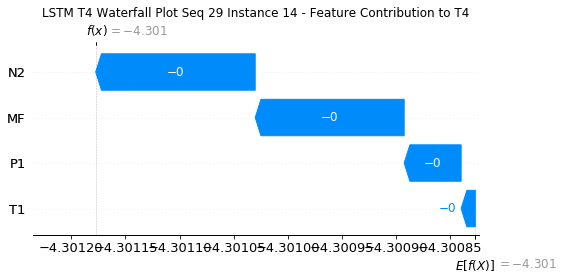

None

Contribution: [-5.52945234e-05 -2.87399330e-05 -1.67085289e-04 -1.51604063e-04]


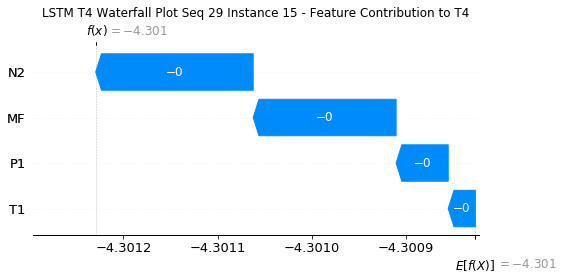

None

Contribution: [-5.85260352e-05 -2.31796543e-05 -1.70961148e-04 -1.58272360e-04]


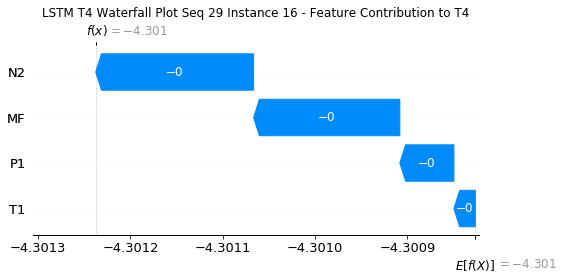

None

Contribution: [-3.74329172e-05 -1.23017317e-05 -1.09046983e-04 -9.93642467e-05]


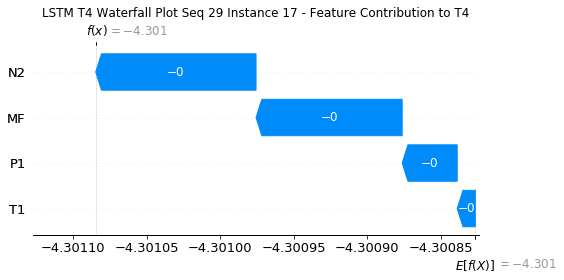

None

Contribution: [1.58796482e-05 2.26248672e-05 5.70296877e-05 5.92788044e-05]


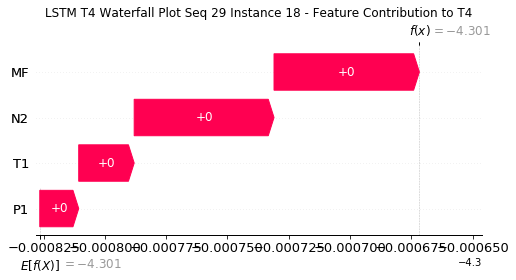

None

Contribution: [7.35866624e-05 7.01599897e-05 2.49878169e-04 2.42281735e-04]


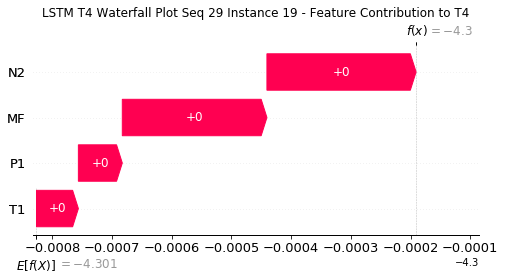

None

Contribution: [3.35248030e-05 4.06145292e-05 1.14263757e-04 1.23110607e-04]


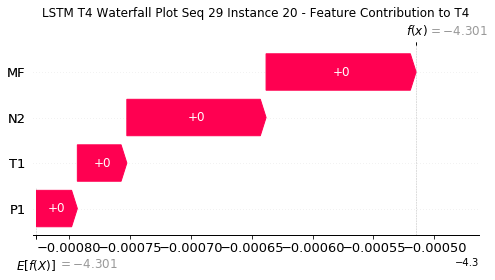

None

Contribution: [-0.00030745 -0.00020744 -0.00104056 -0.00096189]


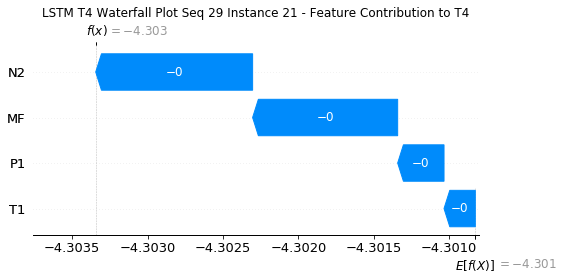

None

Contribution: [-0.0011336  -0.00063639 -0.00376098 -0.00358536]


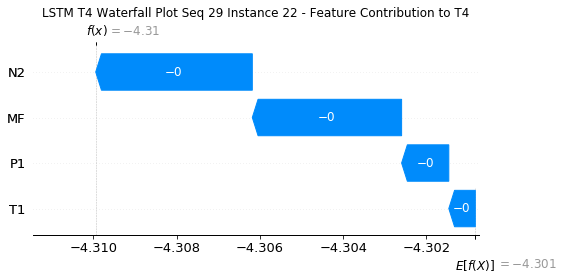

None

Contribution: [-0.00217346 -0.00083832 -0.00774295 -0.00747936]


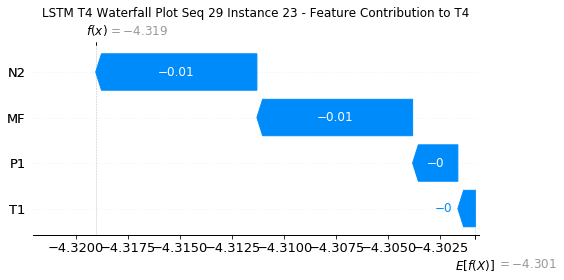

None

Contribution: [-0.00093061  0.00252675 -0.00543288 -0.00553893]


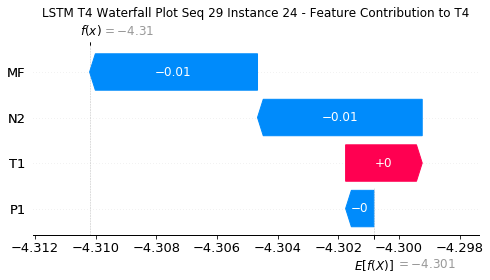

None

Contribution: [-0.00186602 -0.00159868 -0.0063203  -0.00594336]


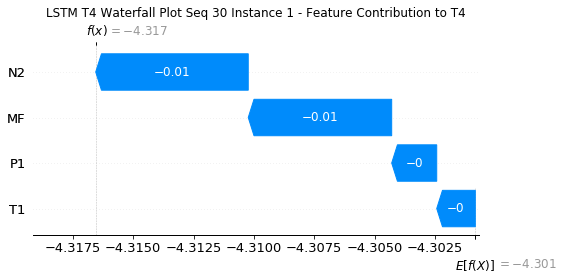

None

Contribution: [ 2.86355972e-04 -8.90923634e-05  8.23118929e-04  9.31255848e-04]


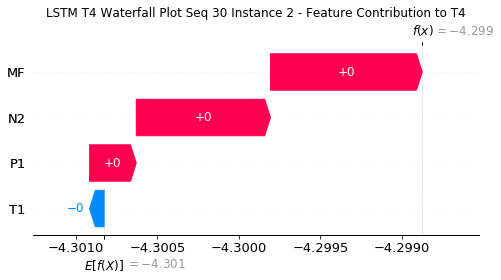

None

Contribution: [-8.15853846e-06 -4.23157150e-06 -1.67553982e-05 -1.81107326e-05]


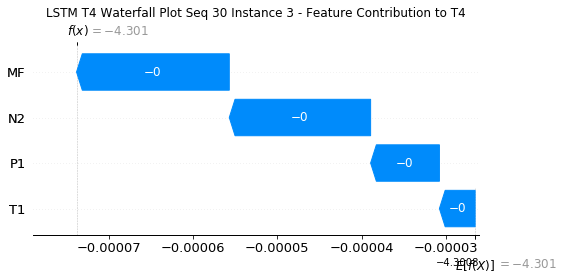

None

Contribution: [-1.61838124e-05 -1.27952335e-05 -5.12376288e-05 -4.27457178e-05]


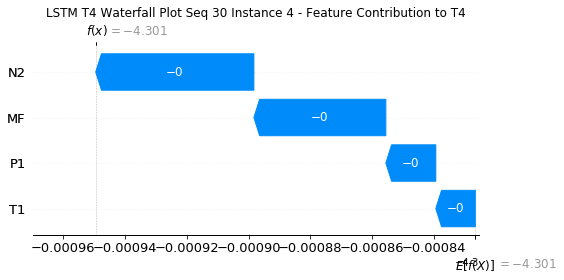

None

Contribution: [-2.73683189e-05 -2.20542360e-05 -8.93175467e-05 -7.50829490e-05]


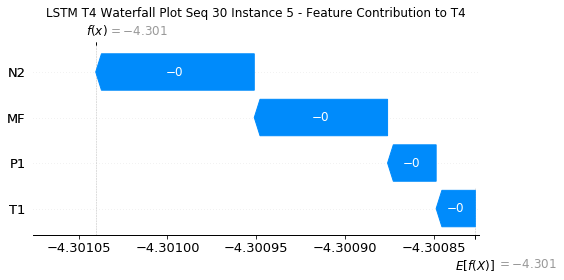

None

Contribution: [-3.11390963e-05 -2.28523967e-05 -9.89238609e-05 -8.43222925e-05]


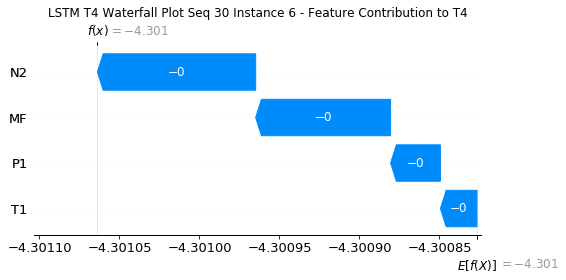

None

Contribution: [-3.00094152e-05 -2.37459020e-05 -9.81415678e-05 -8.50489693e-05]


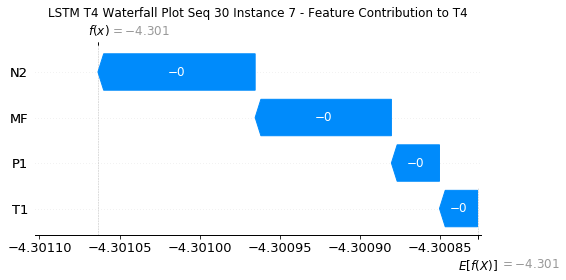

None

Contribution: [-2.98787509e-05 -2.07656735e-05 -9.72593555e-05 -8.36274357e-05]


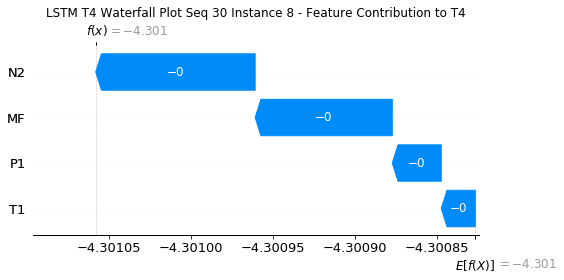

None

Contribution: [-3.02278586e-05 -2.02951405e-05 -1.00266465e-04 -8.70693378e-05]


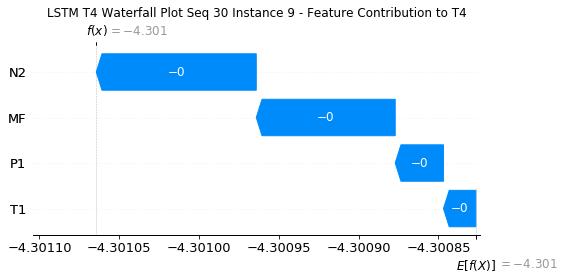

None

Contribution: [-3.26243867e-05 -2.18554268e-05 -1.05851261e-04 -9.08041233e-05]


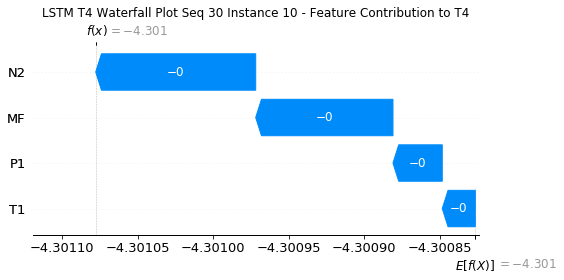

None

Contribution: [-3.44861122e-05 -2.44990582e-05 -1.11636733e-04 -9.83314842e-05]


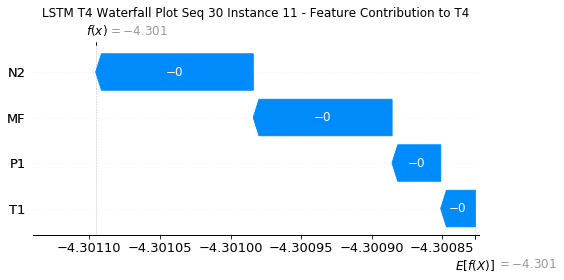

None

Contribution: [-3.66353827e-05 -2.65676599e-05 -1.18649707e-04 -1.05218673e-04]


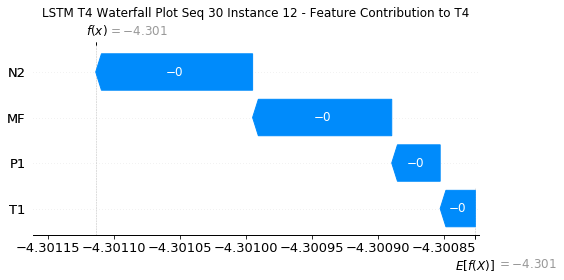

None

Contribution: [-3.91025151e-05 -2.75941132e-05 -1.27278800e-04 -1.10662365e-04]


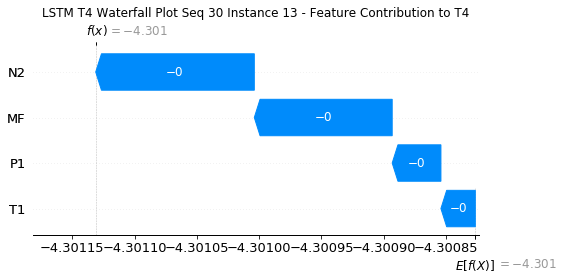

None

Contribution: [-4.42457787e-05 -3.24689189e-05 -1.44578393e-04 -1.29328155e-04]


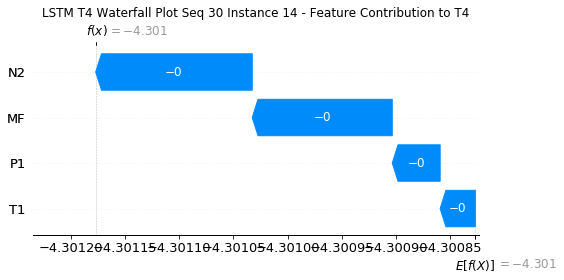

None

Contribution: [-5.17351869e-05 -4.01301833e-05 -1.64954719e-04 -1.48786704e-04]


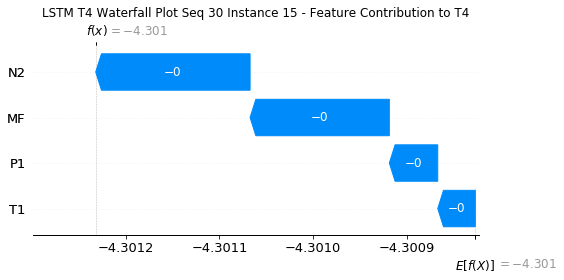

None

Contribution: [-5.19157096e-05 -3.84638394e-05 -1.67947860e-04 -1.51723916e-04]


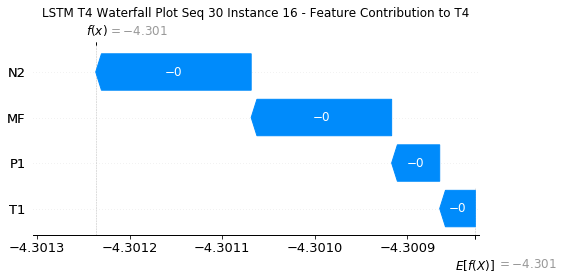

None

Contribution: [-3.44500591e-05 -2.24490708e-05 -1.09945237e-04 -9.84905682e-05]


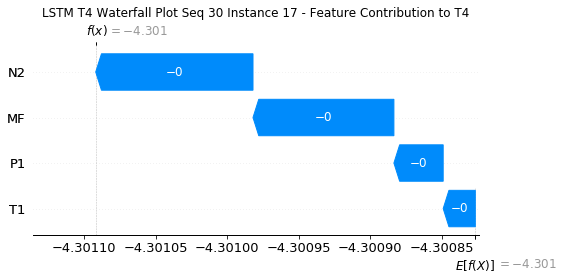

None

Contribution: [1.25508890e-05 1.93572313e-05 4.80678541e-05 5.05699513e-05]


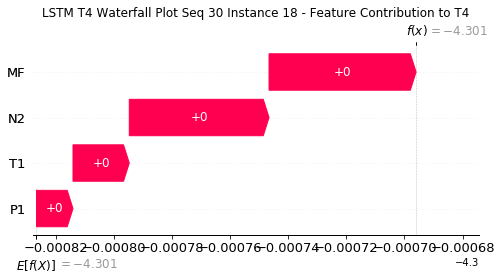

None

Contribution: [6.90587732e-05 6.87188057e-05 2.34997077e-04 2.28435088e-04]


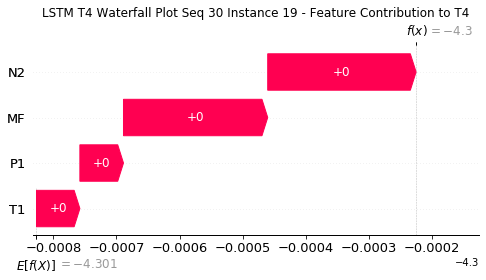

None

Contribution: [3.09663619e-05 3.25148839e-05 1.06337129e-04 1.14912913e-04]


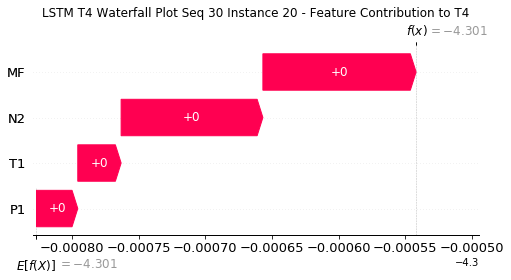

None

Contribution: [-0.00030178 -0.0002547  -0.00101789 -0.00093604]


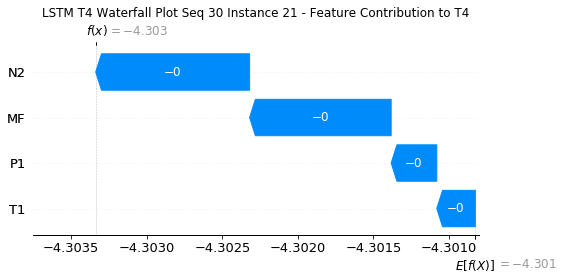

None

Contribution: [-0.00110227 -0.00074508 -0.00368694 -0.00348036]


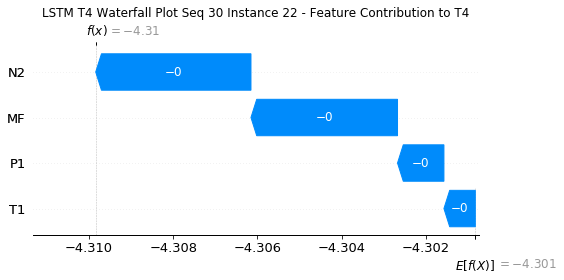

None

Contribution: [-0.00224841 -0.00142507 -0.00762259 -0.00733341]


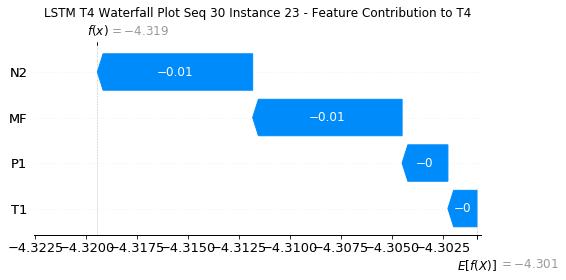

None

Contribution: [-0.00144685  0.0001969  -0.00550968 -0.00603283]


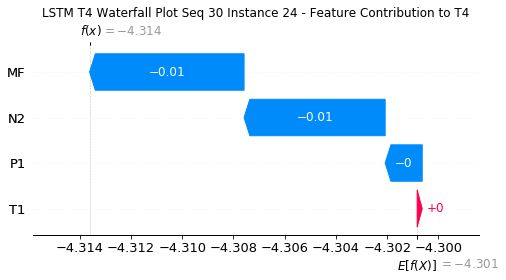

None

Contribution: [-0.00191808 -0.00160533 -0.00637256 -0.00599883]


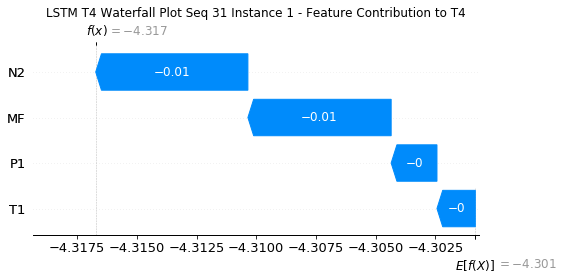

None

Contribution: [ 2.48985477e-04 -3.46148952e-05  8.29373675e-04  8.39050411e-04]


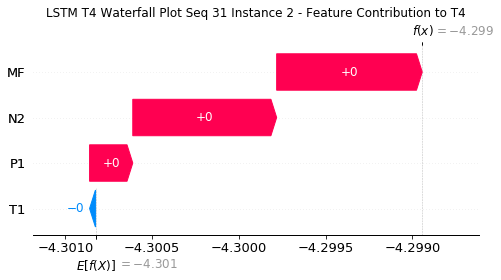

None

Contribution: [-5.30319032e-06 -2.06480621e-06 -1.56768181e-05 -1.38792423e-05]


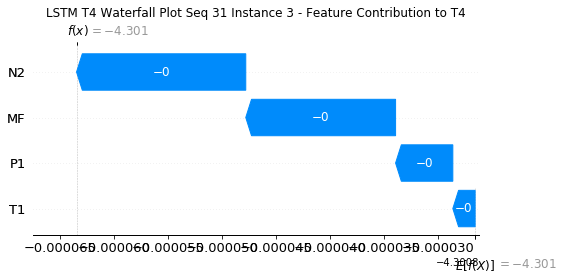

None

Contribution: [-1.71400606e-05 -1.21820072e-05 -5.20593551e-05 -4.45862457e-05]


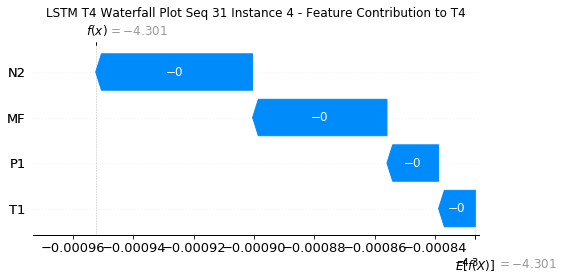

None

Contribution: [-2.85120927e-05 -2.19481953e-05 -9.05515501e-05 -7.73746327e-05]


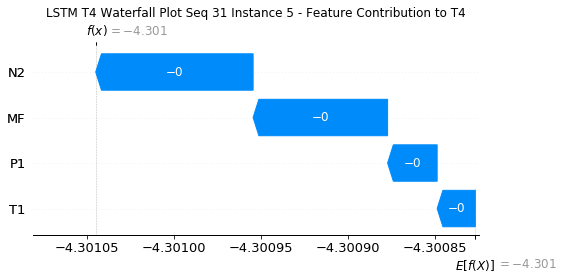

None

Contribution: [-3.15615531e-05 -2.48211881e-05 -9.97494588e-05 -8.57983525e-05]


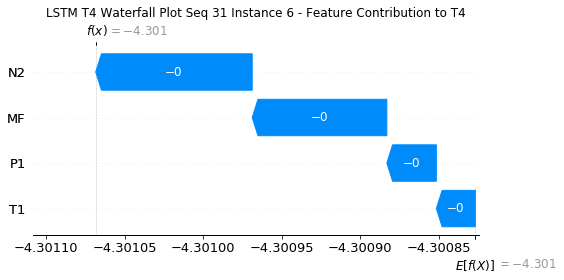

None

Contribution: [-3.08214913e-05 -2.37096514e-05 -9.92039603e-05 -8.69739070e-05]


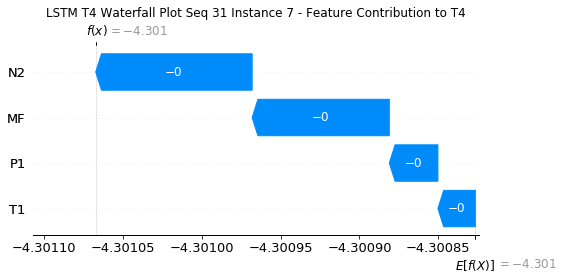

None

Contribution: [-2.94668025e-05 -2.06782015e-05 -9.71807679e-05 -8.39853603e-05]


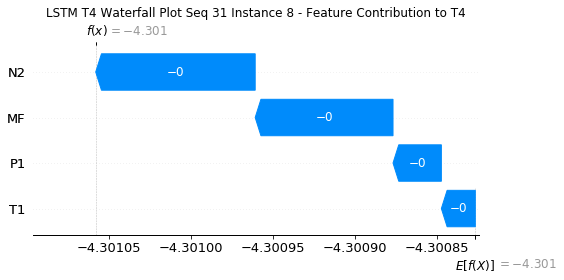

None

Contribution: [-2.93924093e-05 -2.15068787e-05 -9.93071816e-05 -8.34976812e-05]


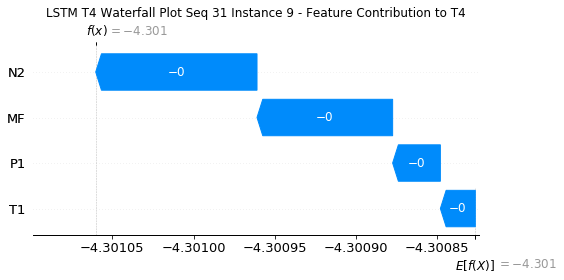

None

Contribution: [-3.21712657e-05 -2.22704061e-05 -1.05962119e-04 -9.30734370e-05]


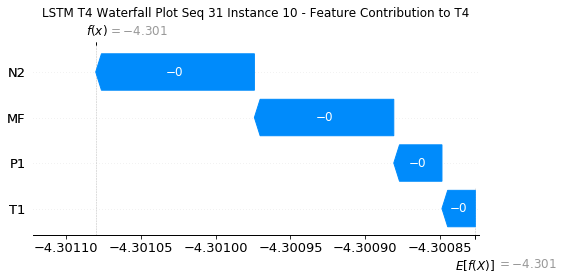

None

Contribution: [-3.55615951e-05 -2.62084326e-05 -1.12306703e-04 -9.97181492e-05]


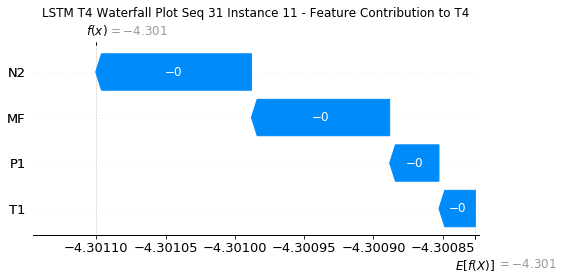

None

Contribution: [-3.77591081e-05 -2.80512797e-05 -1.19561107e-04 -1.06439700e-04]


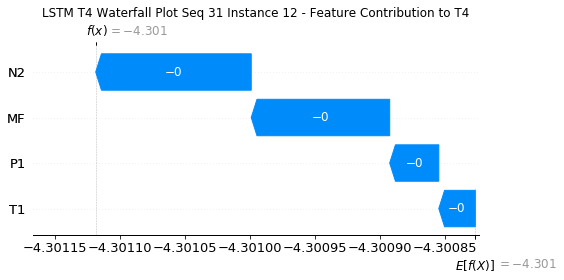

None

Contribution: [-4.07731611e-05 -2.98972049e-05 -1.29188616e-04 -1.16552996e-04]


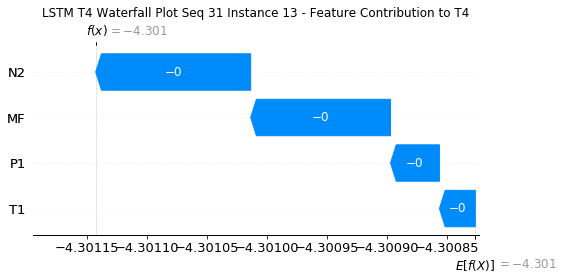

None

Contribution: [-4.53626576e-05 -3.35473562e-05 -1.45400088e-04 -1.30959755e-04]


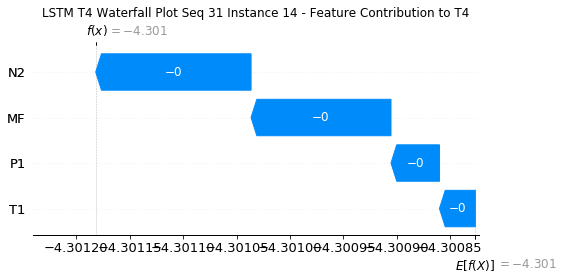

None

Contribution: [-5.06406059e-05 -3.84406610e-05 -1.64948592e-04 -1.45234744e-04]


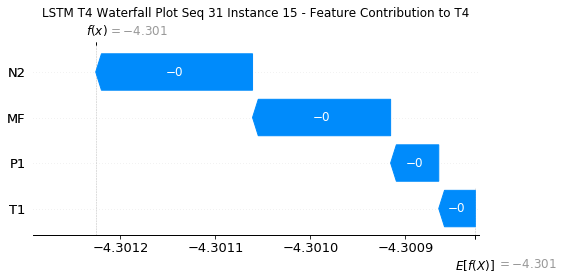

None

Contribution: [-5.26640173e-05 -3.88661111e-05 -1.68135238e-04 -1.52040006e-04]


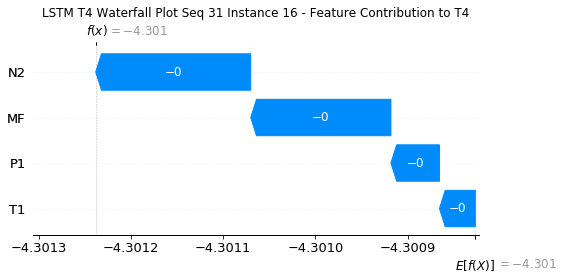

None

Contribution: [-3.48551280e-05 -2.27280208e-05 -1.10497754e-04 -9.87903386e-05]


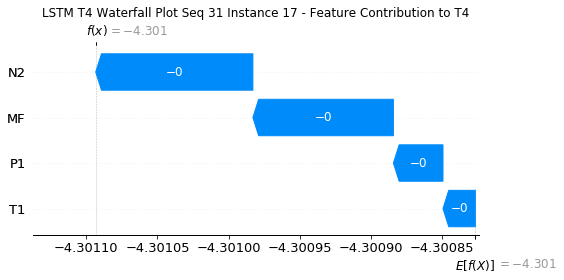

None

Contribution: [1.16808377e-05 1.80959956e-05 4.62568653e-05 4.77948331e-05]


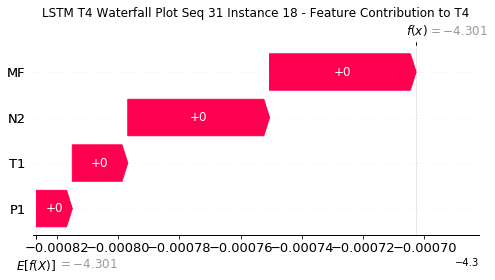

None

Contribution: [6.91248848e-05 6.80271397e-05 2.35221663e-04 2.28524521e-04]


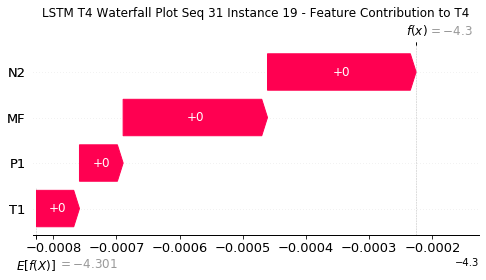

None

Contribution: [3.08745533e-05 3.40043654e-05 1.05209081e-04 1.14311988e-04]


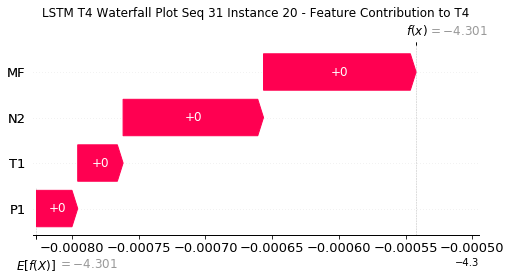

None

Contribution: [-0.00030155 -0.00023474 -0.00102269 -0.00094091]


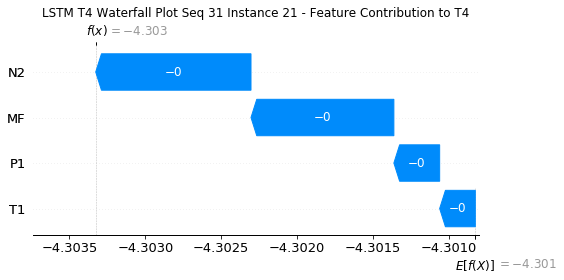

None

Contribution: [-0.00109272 -0.00069332 -0.00368869 -0.00348391]


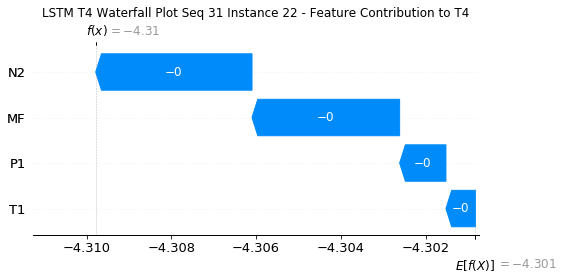

None

Contribution: [-0.00220231 -0.00108577 -0.00761036 -0.00728135]


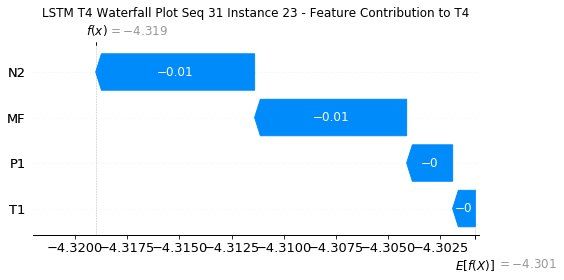

None

Contribution: [-0.00173662  0.00039481 -0.00577343 -0.00632271]


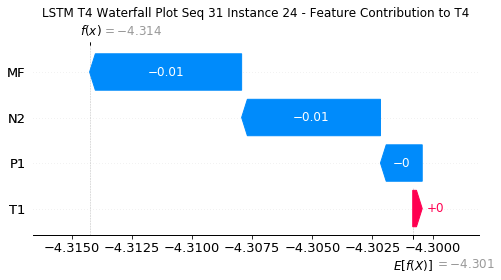

None

Contribution: [-0.00202469 -0.00162683 -0.00640052 -0.00619953]


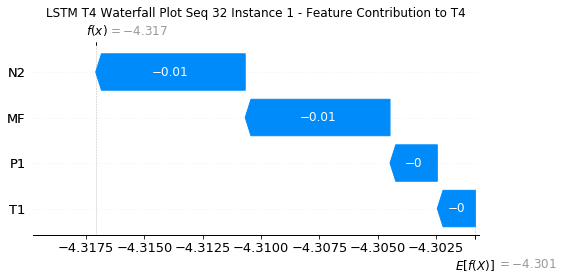

None

Contribution: [ 3.15628308e-04 -6.34607940e-05  8.63264416e-04  9.90585352e-04]


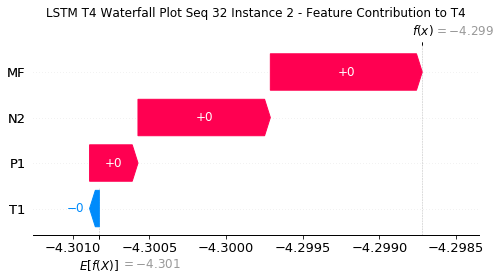

None

Contribution: [-8.58910583e-06  2.25157164e-06 -1.90219600e-05 -2.23111448e-05]


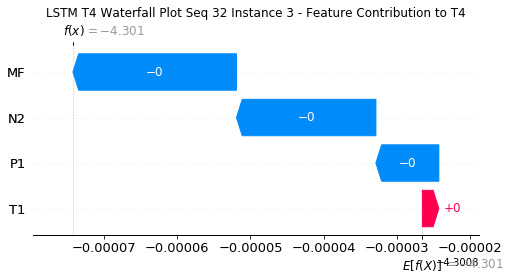

None

Contribution: [-1.64186692e-05 -1.07654106e-05 -5.24957088e-05 -4.36435863e-05]


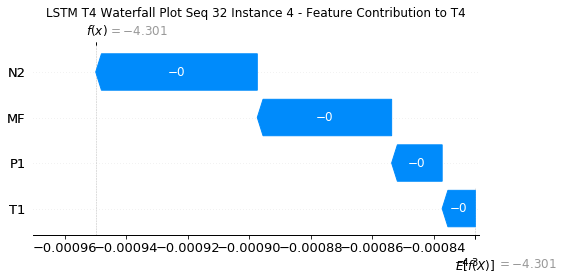

None

Contribution: [-2.74342162e-05 -2.02403309e-05 -9.01273950e-05 -7.54595974e-05]


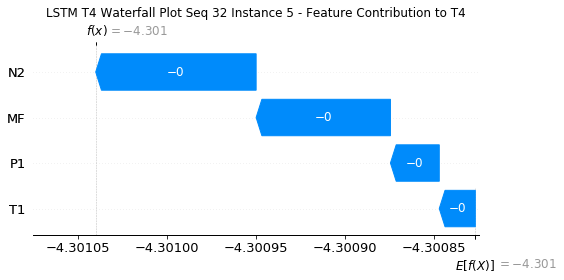

None

Contribution: [-2.85154422e-05 -2.28634933e-05 -9.71485936e-05 -8.15811142e-05]


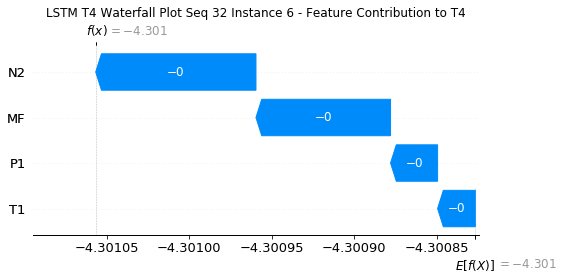

None

Contribution: [-2.97137358e-05 -2.20357821e-05 -9.81447660e-05 -8.49505271e-05]


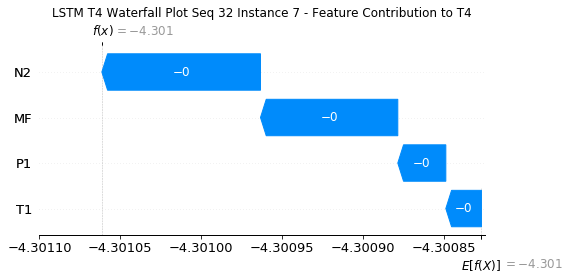

None

Contribution: [-3.06581168e-05 -2.24202829e-05 -9.90755132e-05 -8.85813911e-05]


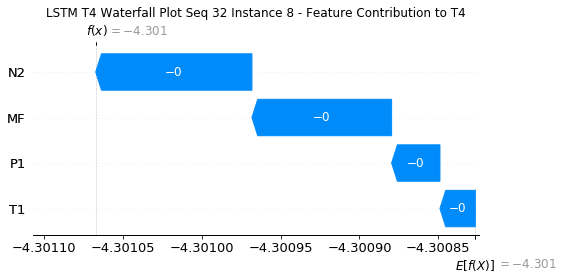

None

Contribution: [-3.24791428e-05 -2.48303025e-05 -1.03303984e-04 -9.55167336e-05]


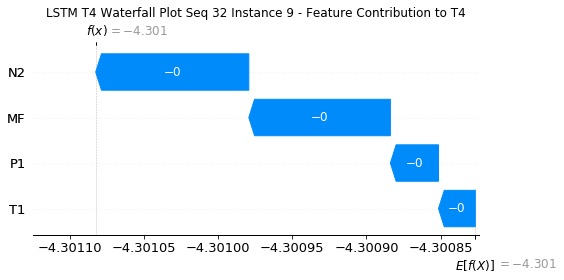

None

Contribution: [-3.34447395e-05 -2.58131095e-05 -1.08699717e-04 -9.68401587e-05]


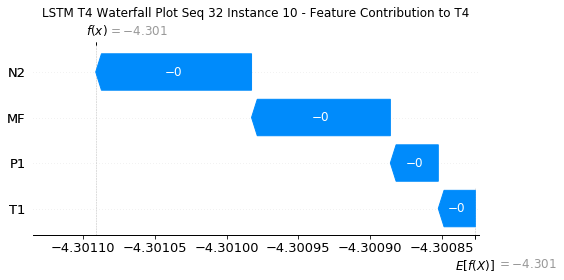

None

Contribution: [-3.50231966e-05 -2.49691083e-05 -1.13464290e-04 -1.00382051e-04]


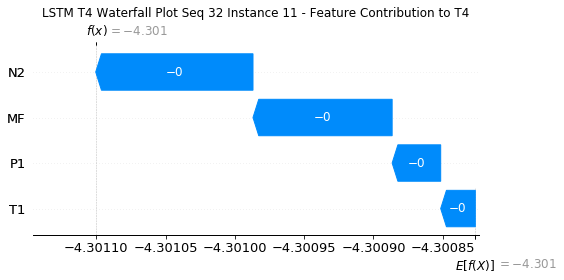

None

Contribution: [-3.72835429e-05 -2.63227281e-05 -1.20649727e-04 -1.07362730e-04]


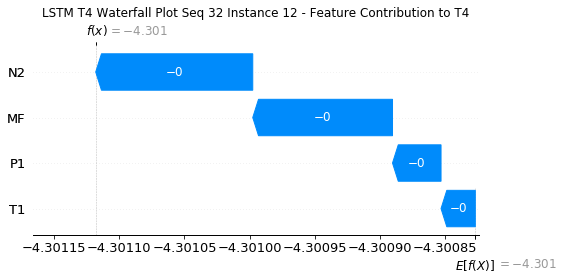

None

Contribution: [-3.93866482e-05 -2.77359558e-05 -1.29561045e-04 -1.13438458e-04]


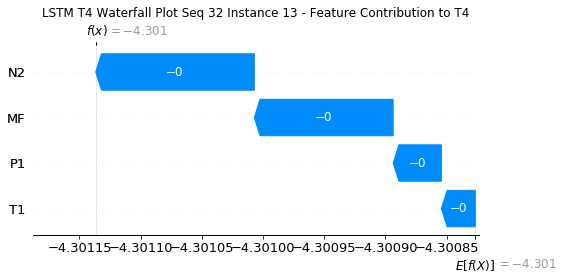

None

Contribution: [-4.48049427e-05 -3.17640810e-05 -1.46426721e-04 -1.31714571e-04]


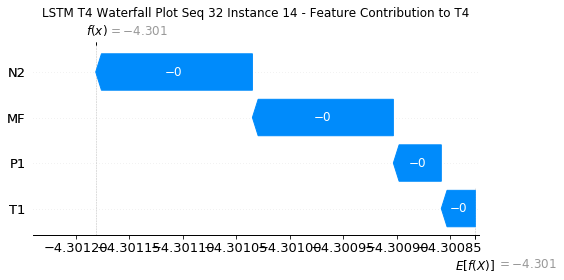

None

Contribution: [-4.81347259e-05 -3.22293028e-05 -1.64313322e-04 -1.46790303e-04]


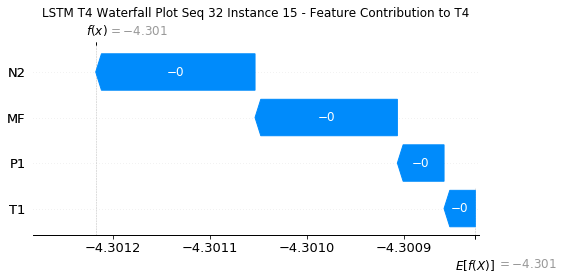

None

Contribution: [-5.23138688e-05 -3.68064879e-05 -1.69426649e-04 -1.53429278e-04]


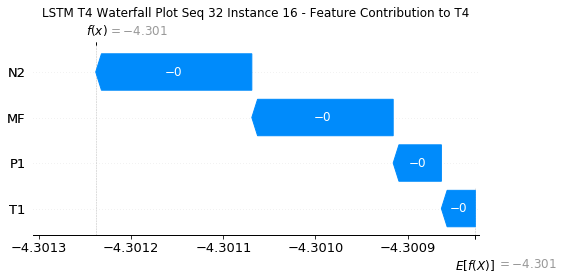

None

Contribution: [-3.46737423e-05 -2.08989954e-05 -1.11616606e-04 -9.95700004e-05]


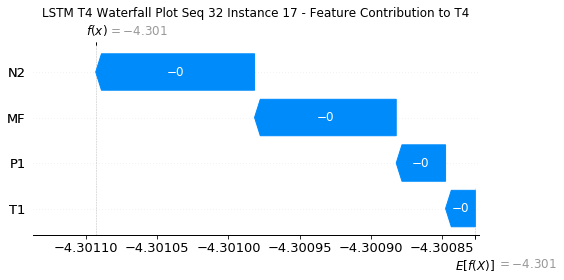

None

Contribution: [1.20657288e-05 1.94667465e-05 4.56934314e-05 4.79153287e-05]


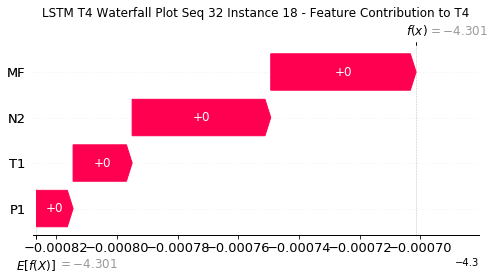

None

Contribution: [6.84470526e-05 6.64970536e-05 2.33265752e-04 2.26678006e-04]


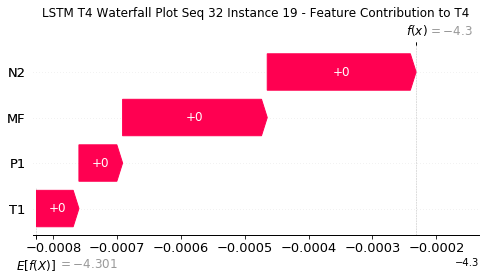

None

Contribution: [3.03103052e-05 3.57273636e-05 1.02635974e-04 1.12229824e-04]


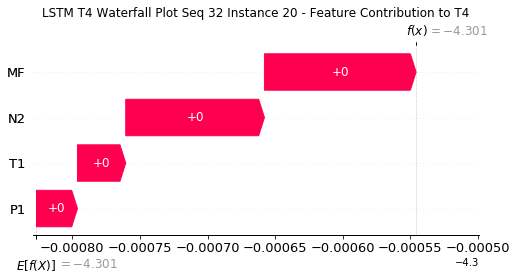

None

Contribution: [-0.00030227 -0.00021356 -0.00102918 -0.00094412]


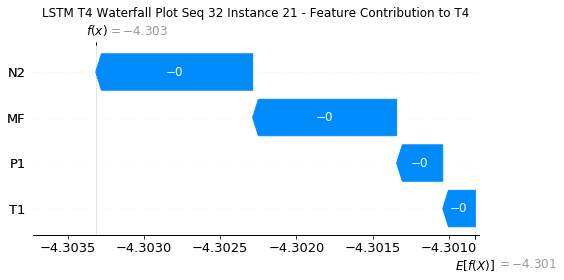

None

Contribution: [-0.00109418 -0.00061857 -0.0037209  -0.00349223]


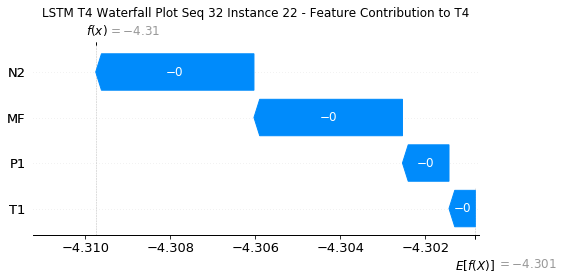

None

Contribution: [-0.00227125 -0.00091724 -0.00775149 -0.00744663]


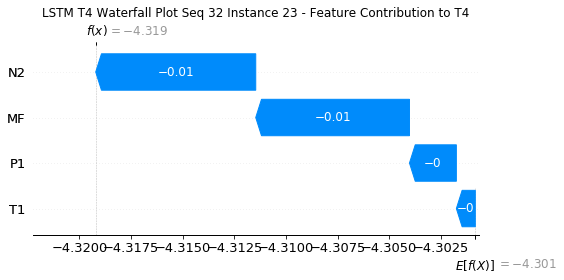

None

Contribution: [-0.00171881  0.00024437 -0.00574731 -0.00653776]


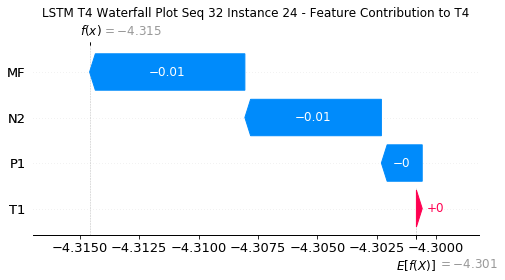

None

Contribution: [-0.00191852 -0.00153702 -0.00650487 -0.00607887]


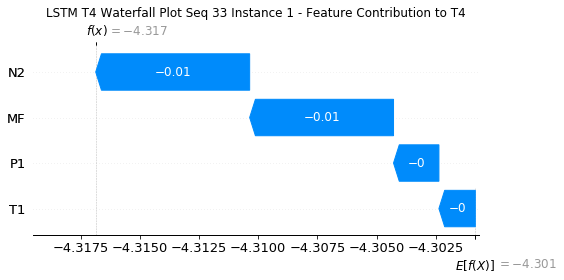

None

Contribution: [ 2.76646541e-04 -7.63209709e-05  8.64751433e-04  9.35819916e-04]


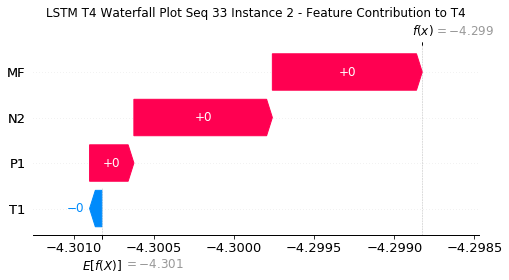

None

Contribution: [-7.46817753e-06  7.34480664e-07 -1.95821374e-05 -1.99535950e-05]


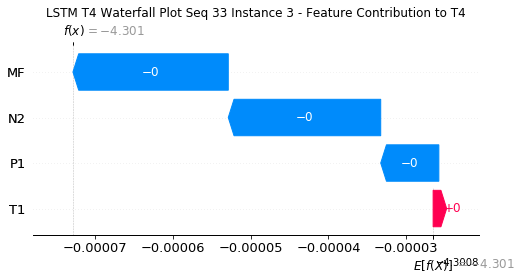

None

Contribution: [-1.54096264e-05 -8.37253619e-06 -5.26592386e-05 -4.37377842e-05]


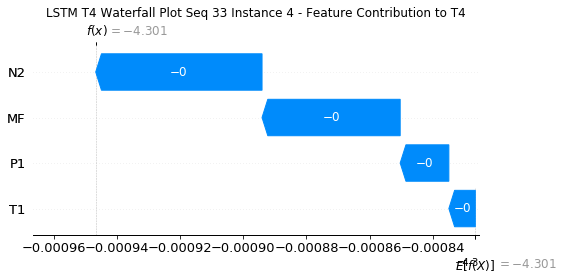

None

Contribution: [-2.63904670e-05 -1.72453355e-05 -9.07755424e-05 -7.58523999e-05]


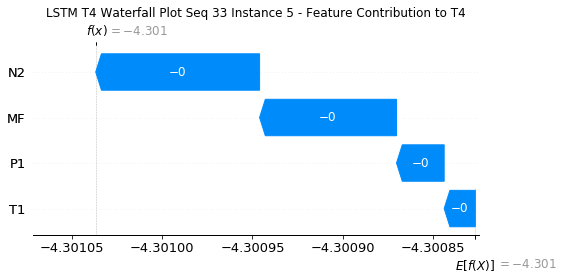

None

Contribution: [-2.93527416e-05 -2.14677707e-05 -9.92671665e-05 -8.35415018e-05]


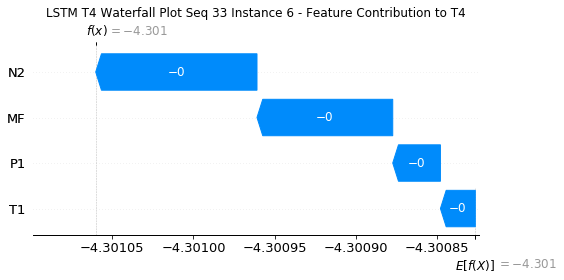

None

Contribution: [-2.88396926e-05 -1.87262288e-05 -9.89715928e-05 -8.52160583e-05]


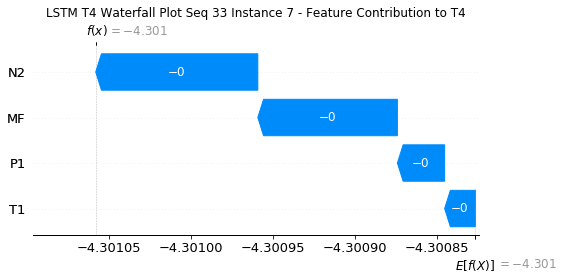

None

Contribution: [-3.02776372e-05 -1.64492916e-05 -9.85117236e-05 -8.48016503e-05]


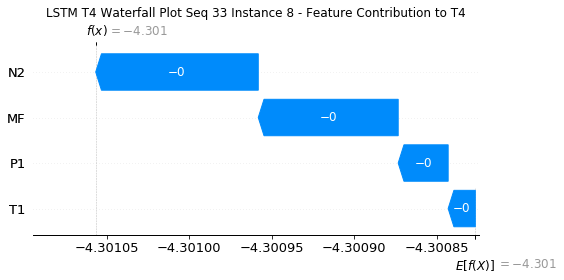

None

Contribution: [-3.15049952e-05 -2.09623330e-05 -1.02087003e-04 -9.10917697e-05]


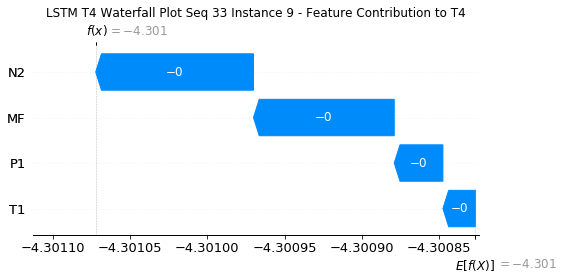

None

Contribution: [-3.27651485e-05 -1.79018694e-05 -1.07192118e-04 -9.31806983e-05]


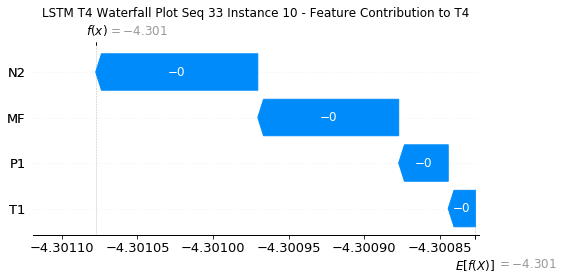

None

Contribution: [-3.38551685e-05 -2.07869240e-05 -1.12641291e-04 -9.91426062e-05]


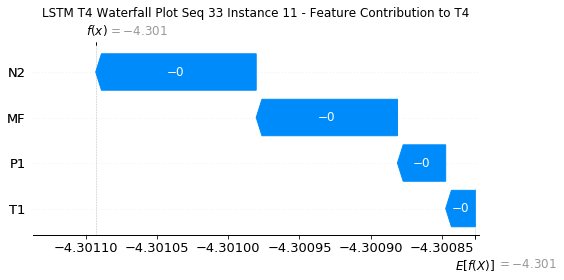

None

Contribution: [-3.61538551e-05 -2.24766506e-05 -1.20163260e-04 -1.06245144e-04]


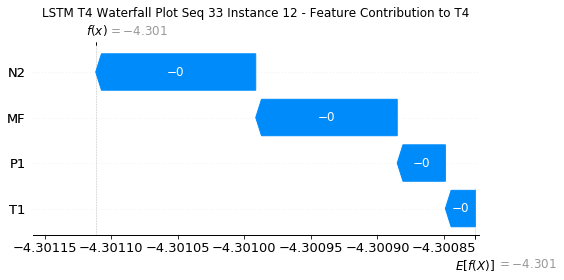

None

Contribution: [-4.09738387e-05 -2.52649943e-05 -1.30380123e-04 -1.17381369e-04]


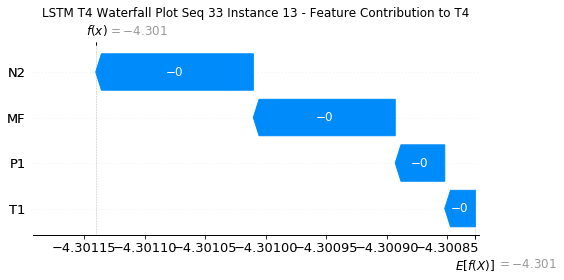

None

Contribution: [-4.42199688e-05 -2.75776955e-05 -1.46803594e-04 -1.31809401e-04]


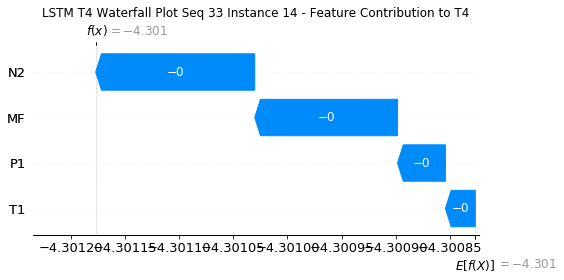

None

Contribution: [-4.94826160e-05 -3.17243904e-05 -1.65750995e-04 -1.46308546e-04]


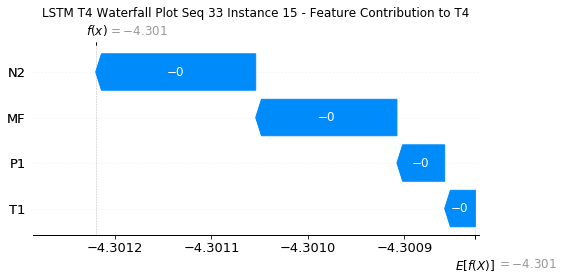

None

Contribution: [-5.13132866e-05 -3.23008901e-05 -1.68997279e-04 -1.52238687e-04]


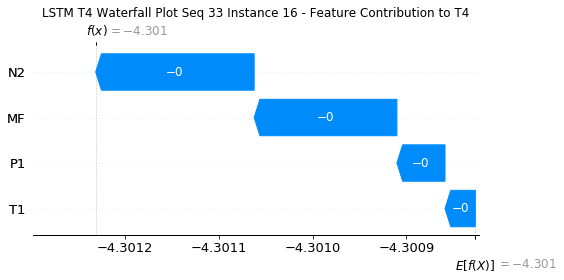

None

Contribution: [-3.27679760e-05 -1.65557433e-05 -1.08452860e-04 -9.61325776e-05]


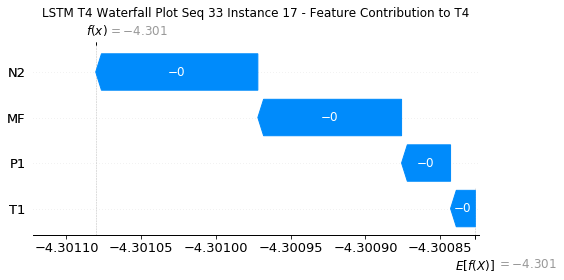

None

Contribution: [1.39449786e-05 2.23139140e-05 5.27010899e-05 5.41326234e-05]


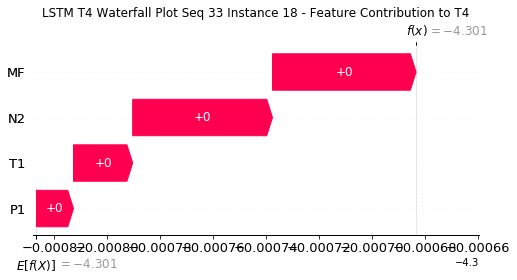

None

Contribution: [7.10488302e-05 6.78908947e-05 2.42945256e-04 2.35783480e-04]


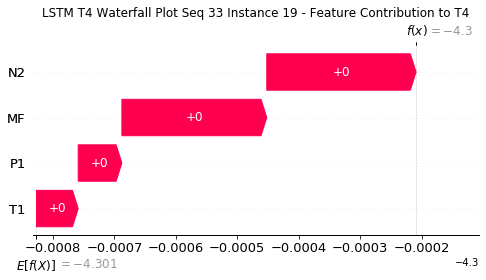

None

Contribution: [3.22874587e-05 4.04243817e-05 1.05493856e-04 1.14924144e-04]


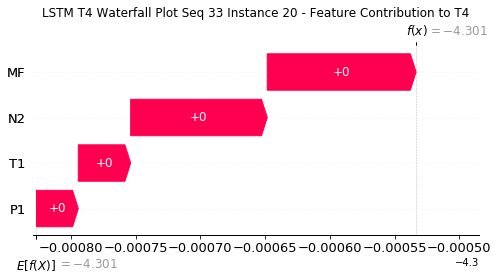

None

Contribution: [-0.00029903 -0.0001793  -0.0010428  -0.00096509]


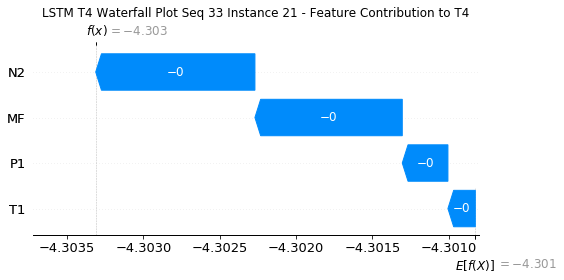

None

Contribution: [-0.00106692 -0.00045108 -0.00372668 -0.0035313 ]


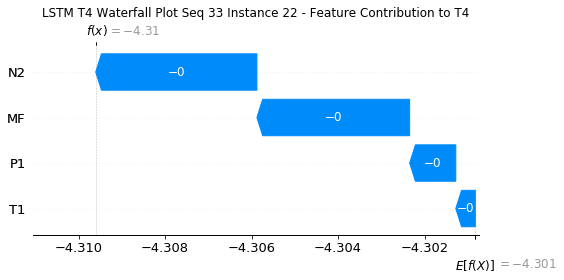

None

Contribution: [-0.00217466 -0.00027686 -0.00766199 -0.00762471]


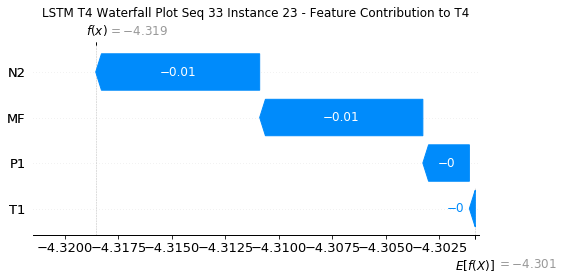

None

Contribution: [-0.00136306  0.00214538 -0.0054246  -0.00661499]


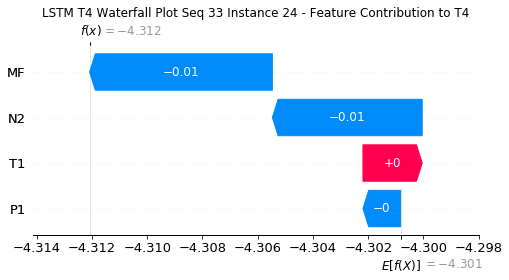

None

Contribution: [-0.00172776 -0.00115894 -0.00646428 -0.00588642]


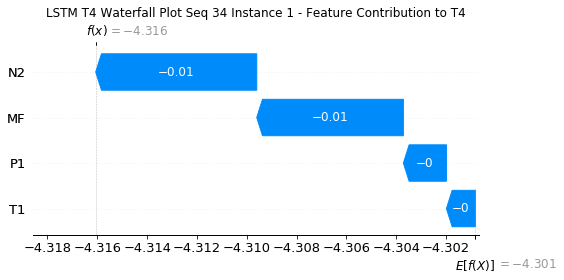

None

Contribution: [ 0.00024482 -0.00022391  0.00082669  0.00087348]


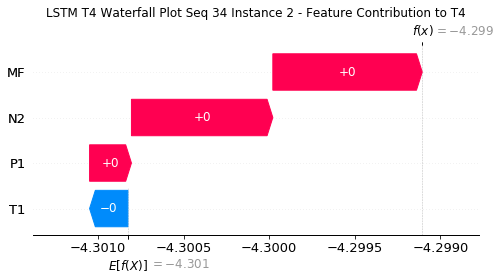

None

Contribution: [-5.62310950e-06  7.46410855e-06 -1.70199269e-05 -1.47601760e-05]


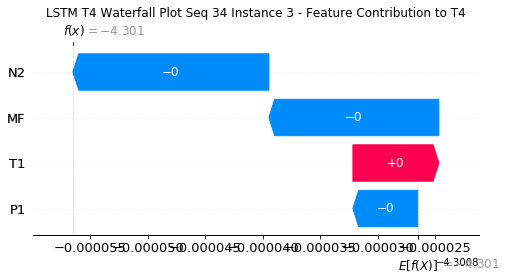

None

Contribution: [-1.49102547e-05 -5.27496885e-06 -5.18014138e-05 -4.41443478e-05]


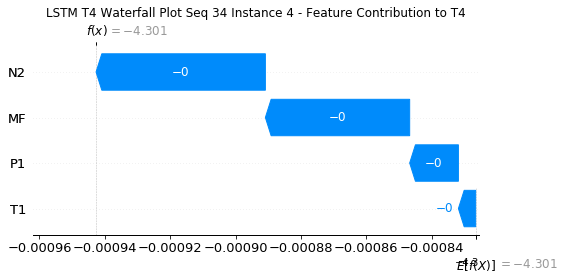

None

Contribution: [-2.57852148e-05 -1.38561087e-05 -9.03051351e-05 -7.62316071e-05]


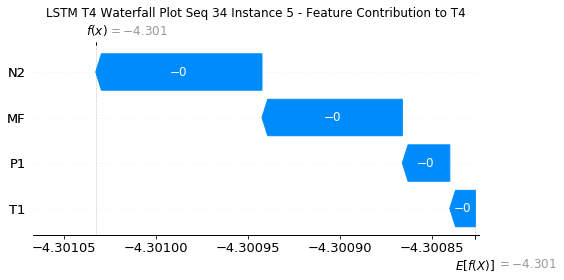

None

Contribution: [-2.71108668e-05 -1.50670236e-05 -9.94178052e-05 -8.46636344e-05]


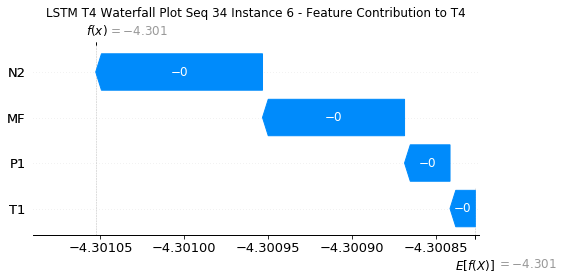

None

Contribution: [-2.79807042e-05 -1.57212071e-05 -9.92626004e-05 -8.61265403e-05]


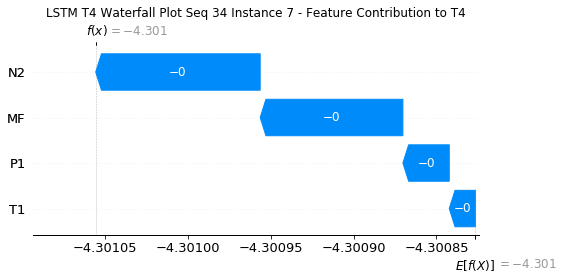

None

Contribution: [-2.70738627e-05 -1.57422127e-05 -9.90820092e-05 -8.69989084e-05]


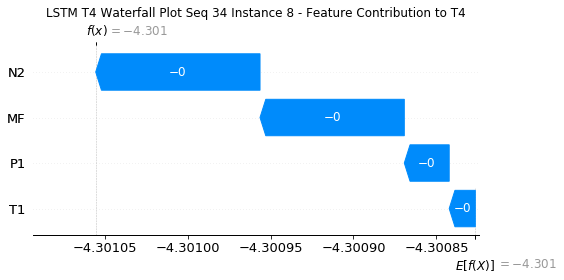

None

Contribution: [-2.57220080e-05 -1.55126376e-05 -1.01045043e-04 -8.67065312e-05]


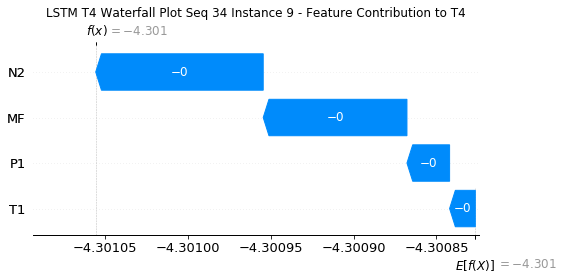

None

Contribution: [-2.83106904e-05 -1.68469080e-05 -1.06745983e-04 -9.08530911e-05]


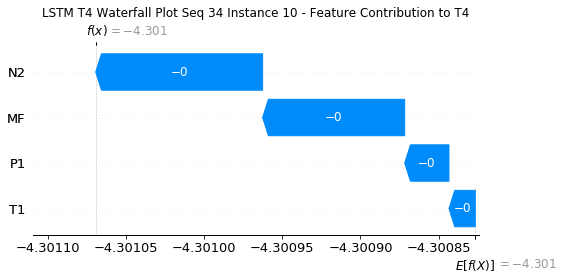

None

Contribution: [-3.26078241e-05 -1.78136418e-05 -1.12720558e-04 -9.81417878e-05]


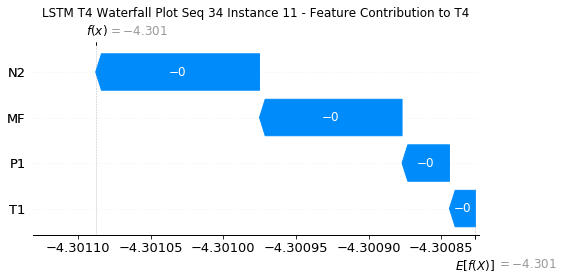

None

Contribution: [-3.51758124e-05 -1.96272771e-05 -1.20397803e-04 -1.06086356e-04]


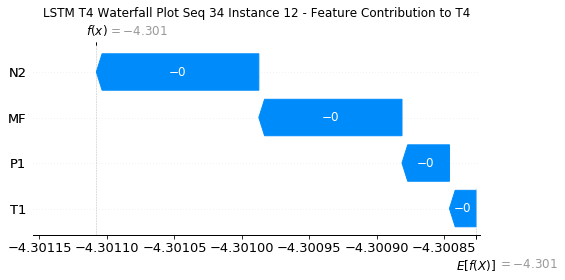

None

Contribution: [-3.75148677e-05 -2.36600338e-05 -1.30418130e-04 -1.13991731e-04]


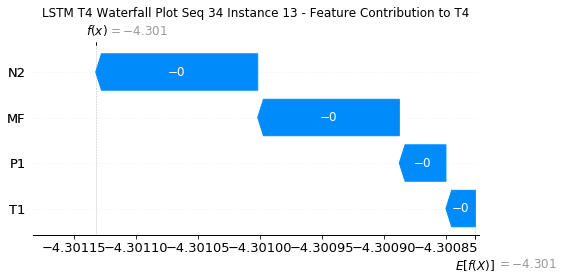

None

Contribution: [-4.29696653e-05 -2.51535127e-05 -1.47507952e-04 -1.31188918e-04]


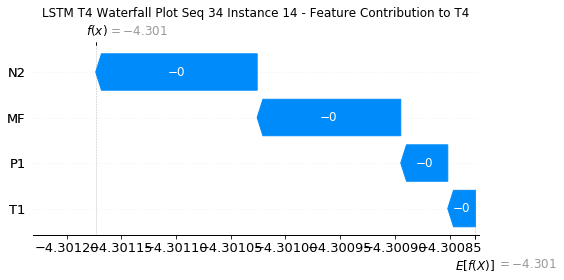

None

Contribution: [-4.77053919e-05 -2.82222801e-05 -1.67169059e-04 -1.47331064e-04]


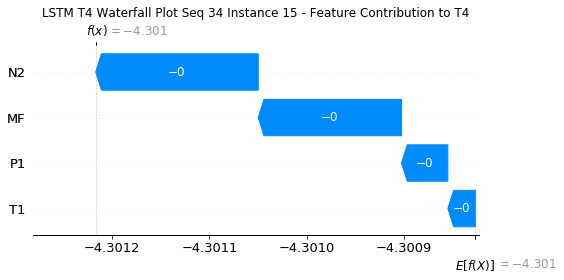

None

Contribution: [-5.03932324e-05 -2.98663764e-05 -1.70084147e-04 -1.52657687e-04]


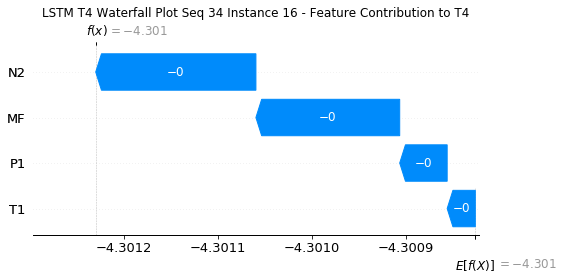

None

Contribution: [-3.17875030e-05 -1.41787650e-05 -1.07531970e-04 -9.48349392e-05]


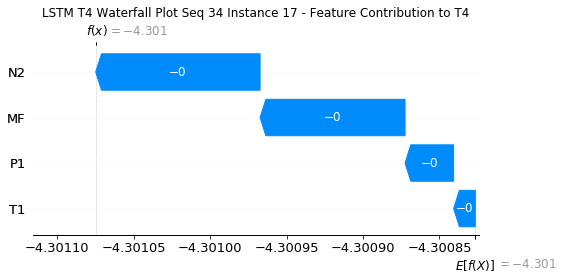

None

Contribution: [1.57552415e-05 2.34477105e-05 5.73376255e-05 5.86581269e-05]


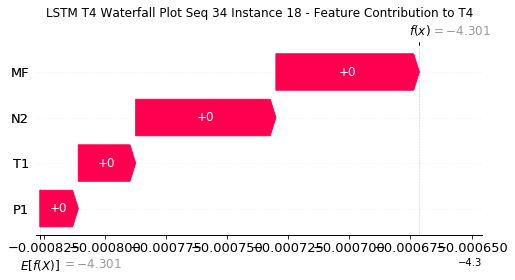

None

Contribution: [7.30741801e-05 6.93883989e-05 2.50184321e-04 2.42810322e-04]


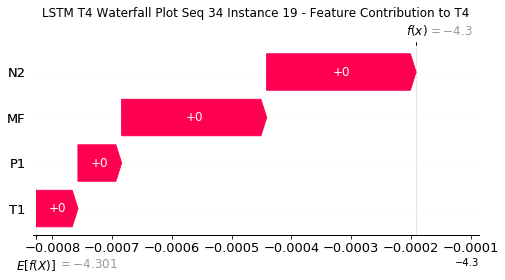

None

Contribution: [3.33814319e-05 4.29103673e-05 1.08057623e-04 1.17479252e-04]


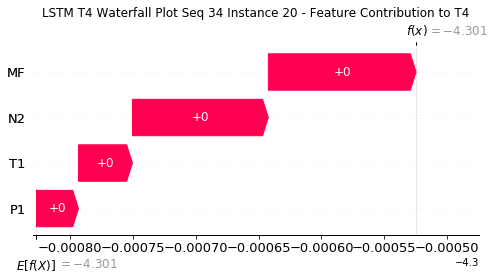

None

Contribution: [-0.00029916 -0.00017471 -0.00105895 -0.00097156]


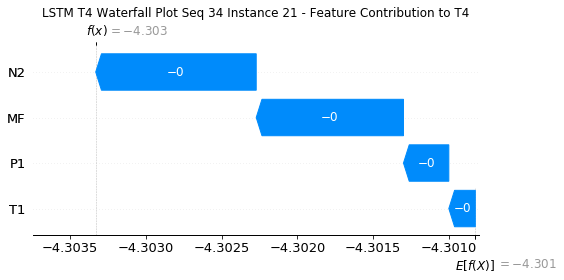

None

Contribution: [-0.00105234 -0.00041736 -0.00377691 -0.00350893]


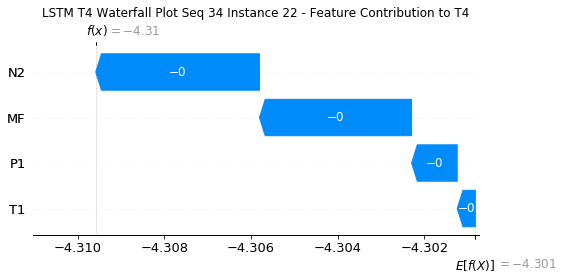

None

Contribution: [-0.00211584 -0.00019344 -0.007739   -0.00745674]


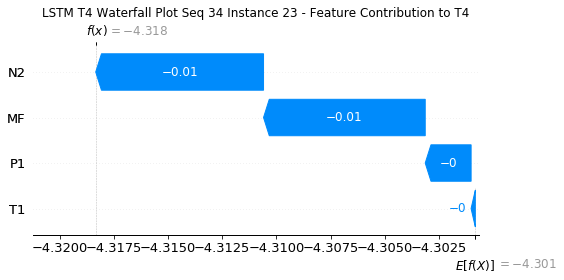

None

Contribution: [-0.00132731  0.00245232 -0.00550312 -0.00635086]


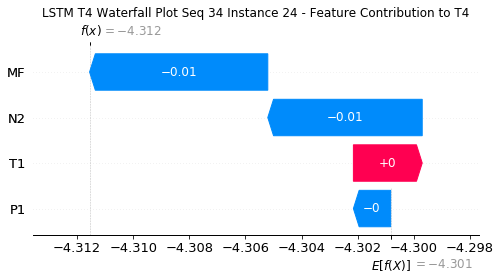

None

In [32]:
#Waterfall Plot for Local Accuracy & Consistency metrics
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM T4 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to T4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [49]:
# calculate variables for control limit c

std.stack().max(),std.stack().mean(),std.stack().std()

(12.154605142421127, 11.347825473994153, 0.25737511475646546)

In [50]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

3.13464520138386

In [51]:
#Load NaN anomaly testing data

xtest_AD_file = "xNan.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [52]:
#Load NaN anomaly ground truth

ytest_AD_file = "yNan.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [53]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
y1_AD = preds_AD[2]
y_AD = tf.keras.backend.get_value(y_AD)
y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, tens_draw1_AD

(array([618.41430463]), array([[nan]], dtype=float32))

In [54]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [55]:
hour_NUM2 = ['3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm']

0


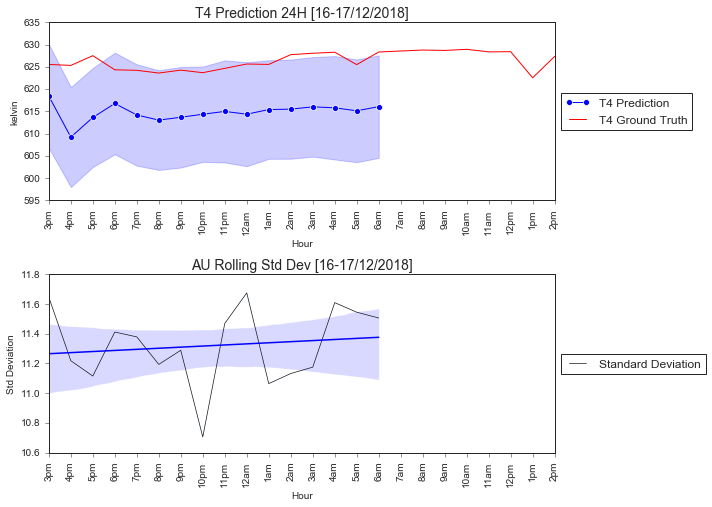

In [57]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','kelvin']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['T4'][x]
    max_RUL_Arrange.columns = ['Hour','kelvin']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','kelvin']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['kelvin'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="kelvin",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="T4 Prediction")
    sns.lineplot(x="Hour", y="kelvin", data = max_RUL_Arrange, color='red', ax=ax,label="T4 Ground Truth")
    plt.title('T4 Prediction 24H [16-17/12/2018]',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'kelvin', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['kelvin'],scatter = False)
    plt.title('AU Rolling Std Dev [16-17/12/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [58]:
#Load Null anomaly testing data

xtest_AD_ALL_file = "xNull.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [59]:
#Load Null anomaly ground truth

ytest_AD_ALL_file = "yNull.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [60]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, tens_draw1_AD_ALL

(array([626.24799353]), array([[-4.3731575]], dtype=float32))

In [61]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [62]:
hour_NUM3 = ['6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm',]

0


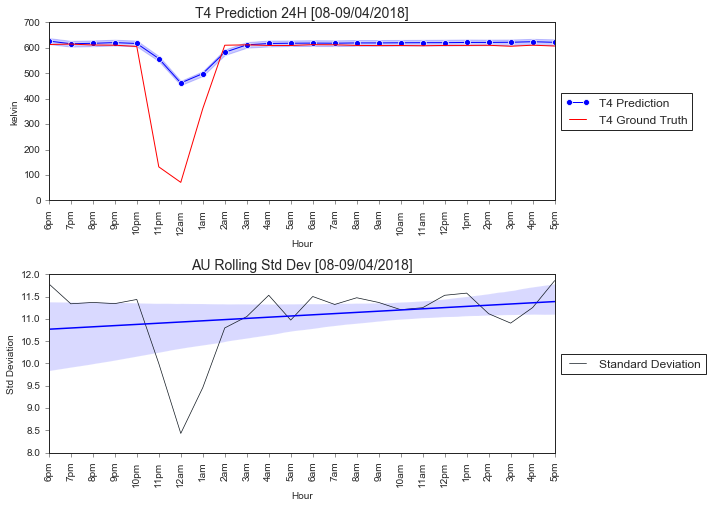

In [63]:
#Visualize anomaly prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','kelvin']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['T4'][x]
    max_RUL_Arrange.columns = ['Hour','kelvin']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','kelvin']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['kelvin'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="kelvin",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="T4 Prediction")
    sns.lineplot(x="Hour", y="kelvin", data = max_RUL_Arrange, color='red', ax=ax,label="T4 Ground Truth")
    plt.title('T4 Prediction 24H [08-09/04/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'kelvin', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['kelvin'],scatter = False)
    plt.title('AU Rolling Std Dev [08-09/04/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

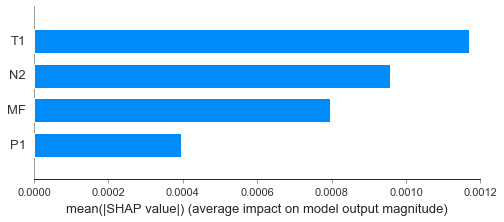

In [66]:
#Summary Plot for anomaly

instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="bar")

In [67]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [68]:
#export for CUSUM MATLAB
min_Std_Arrange.to_csv(r'C:\Users\Asus\OneDrive - Universiti Teknologi PETRONAS\New folder\T4_2\AD.csv', index = False)

In [33]:
#Define New LSTM without probabilistic layers for Consistency metric

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 250)           254000    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 44)            11044     
_________________________________________________________________
dense_6 (Dense)              (None, 24, 1)             45        
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 265,089
Trainable params: 265,089
Non-trainable params: 0
_________________________________________________________________


In [34]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [35]:
#Transfer weights from previous LSTM to new LSTM

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [36]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [37]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [38]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ 0.0077945   0.03330504 -0.00722854]


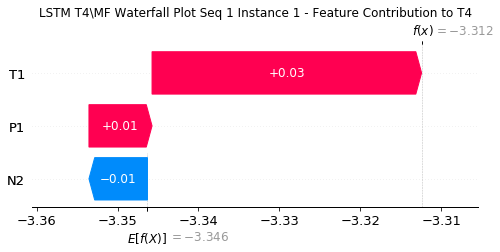

None

Contribution: [-0.00054937 -0.00204842  0.00114484]


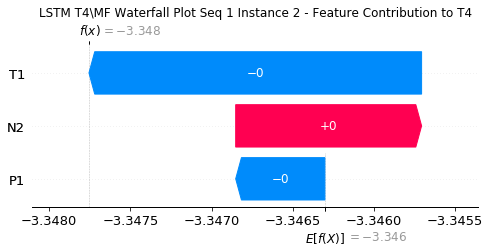

None

Contribution: [ 2.84663500e-04  1.02890445e-03 -9.94533757e-06]


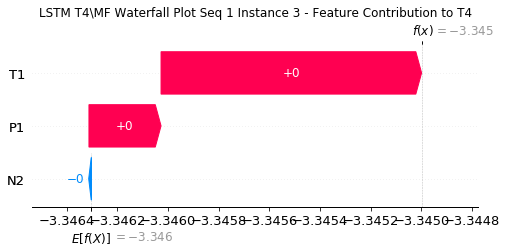

None

Contribution: [ 4.64460673e-05  3.23857099e-04 -4.23545045e-06]


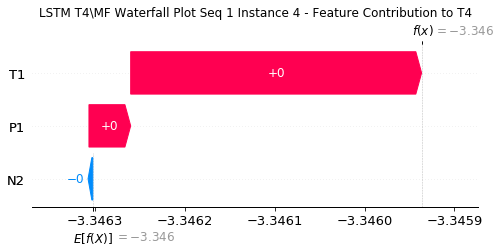

None

Contribution: [6.44306559e-07 2.39883451e-04 5.47925636e-06]


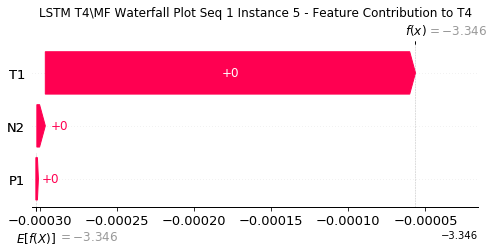

None

Contribution: [9.76963536e-06 2.06025376e-04 6.72260614e-05]


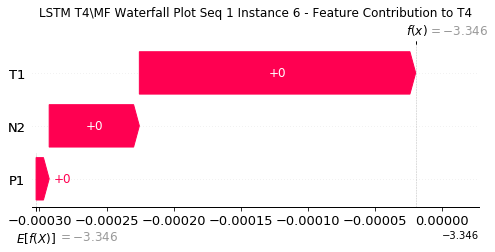

None

Contribution: [4.99949426e-05 8.19219399e-05 8.96881130e-05]


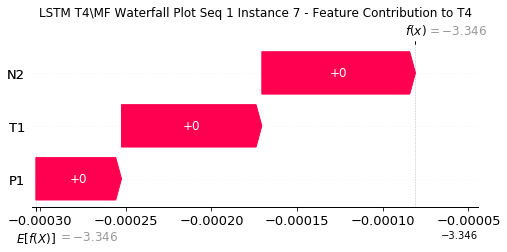

None

Contribution: [ 6.81427699e-05 -1.31596343e-04  5.84502742e-06]


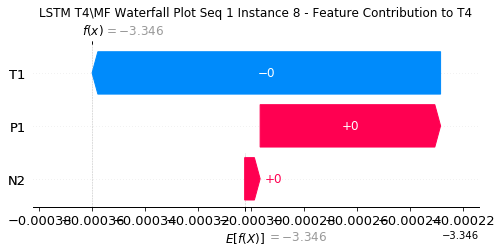

None

Contribution: [ 1.48407200e-05 -2.53425168e-04 -1.68270006e-04]


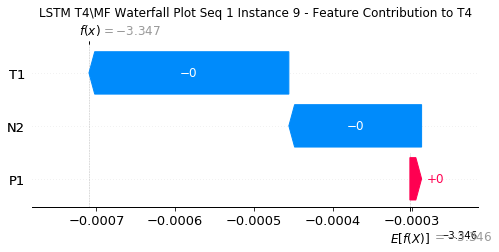

None

Contribution: [-7.05851333e-05 -1.35405431e-04 -2.84647223e-04]


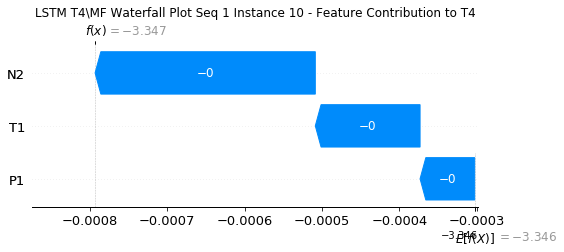

None

Contribution: [-0.00010828  0.0002557  -0.00019214]


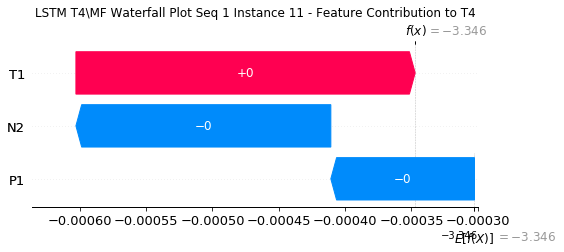

None

Contribution: [-5.20220775e-06  8.09016436e-04  1.59218351e-04]


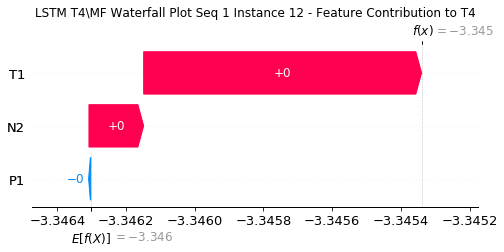

None

Contribution: [0.00016269 0.00116014 0.00052221]


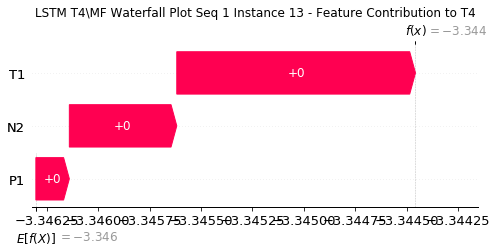

None

Contribution: [0.00046371 0.00086854 0.00045354]


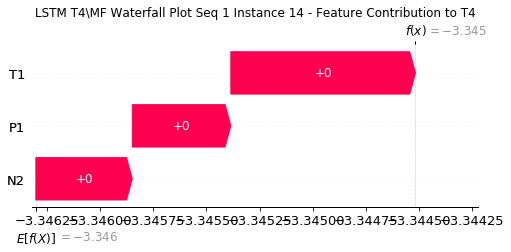

None

Contribution: [ 0.00021168 -0.00025925 -0.00030544]


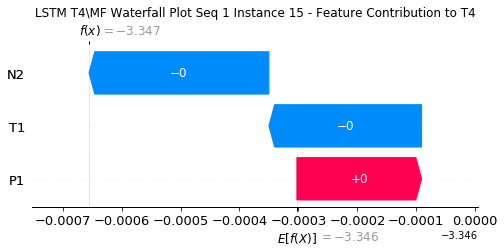

None

Contribution: [-0.00019372 -0.00184874 -0.00137096]


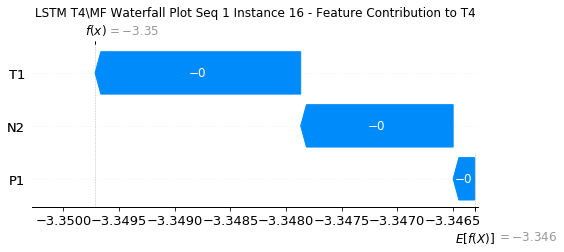

None

Contribution: [-0.00085809 -0.00286989 -0.00158793]


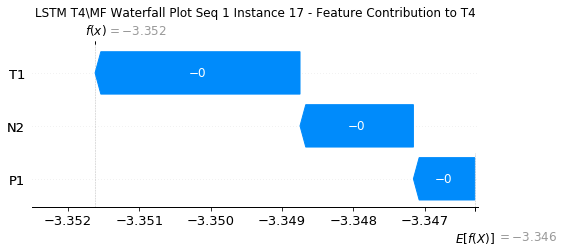

None

Contribution: [-7.93397614e-04 -2.48581202e-03 -7.27814943e-05]


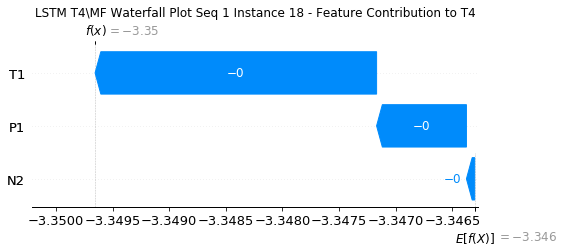

None

Contribution: [-2.51801123e-04 -7.54112743e-05  2.75139151e-03]


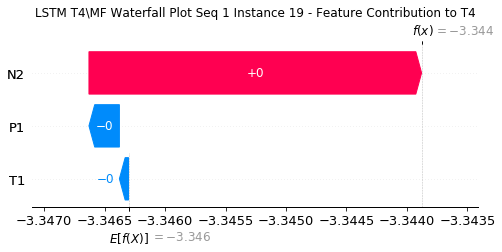

None

Contribution: [0.00080723 0.00448021 0.00414849]


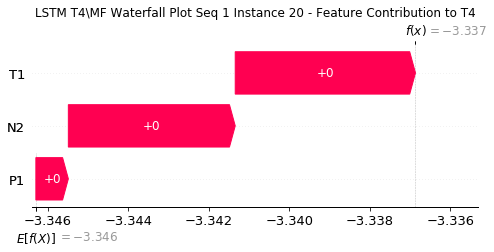

None

Contribution: [0.0023661  0.01073101 0.00081866]


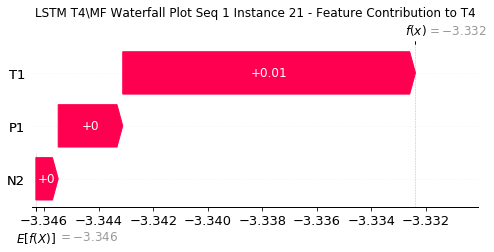

None

Contribution: [ 0.0023209   0.01756532 -0.00688799]


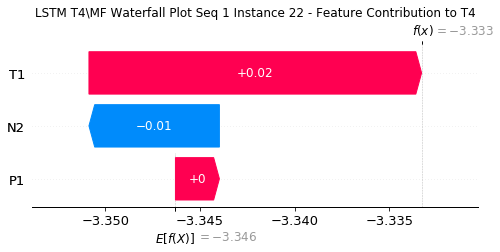

None

Contribution: [ 0.00206864  0.01410959 -0.01495   ]


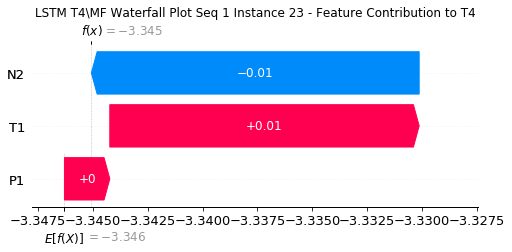

None

Contribution: [ 0.00132448  0.00729004 -0.00693483]


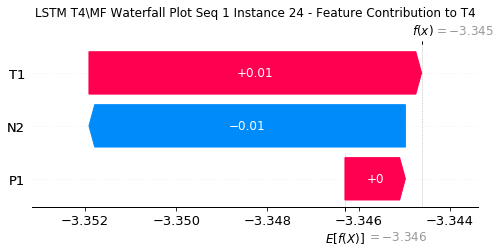

None

Contribution: [ 0.00381305  0.02661417 -0.00732281]


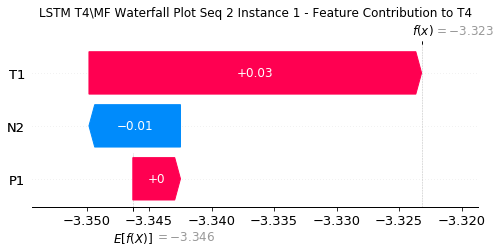

None

Contribution: [-0.00026498 -0.00109025  0.00105038]


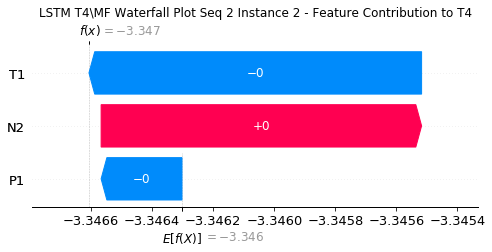

None

Contribution: [1.99091276e-04 7.87785333e-04 1.23247149e-05]


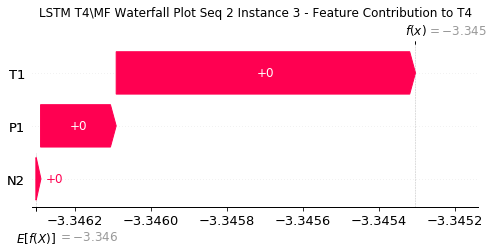

None

Contribution: [3.68801212e-05 2.83299562e-04 2.92334610e-06]


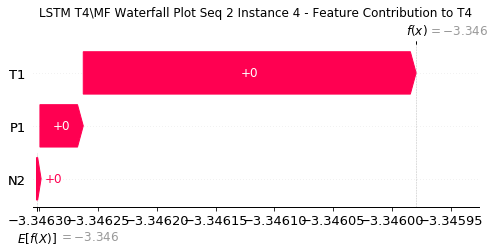

None

Contribution: [4.99103174e-06 2.32092511e-04 4.25819098e-06]


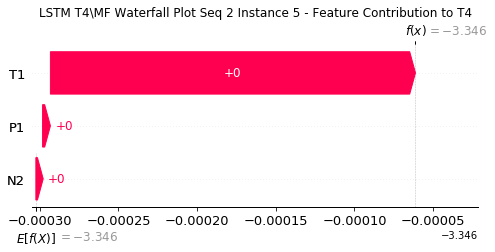

None

Contribution: [1.48118775e-05 1.91483686e-04 5.91532951e-05]


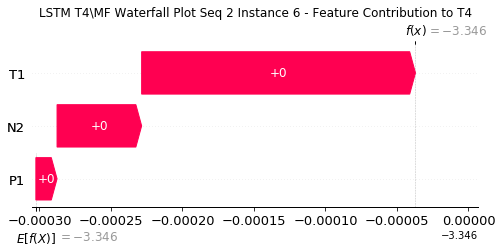

None

Contribution: [4.84905581e-05 5.47747661e-05 8.46777563e-05]


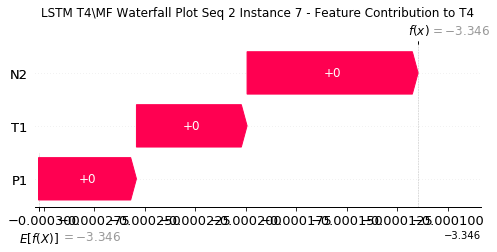

None

Contribution: [ 5.34509630e-05 -1.33685676e-04  1.19930466e-05]


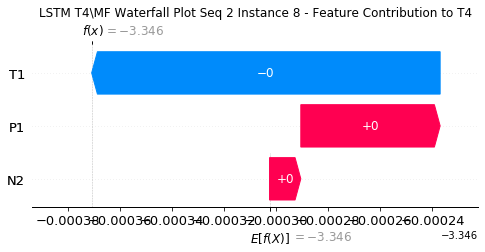

None

Contribution: [ 8.88416199e-07 -2.21109884e-04 -1.55915119e-04]


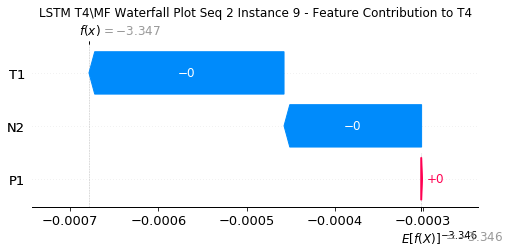

None

Contribution: [-6.48110234e-05 -6.18160546e-05 -2.79925998e-04]


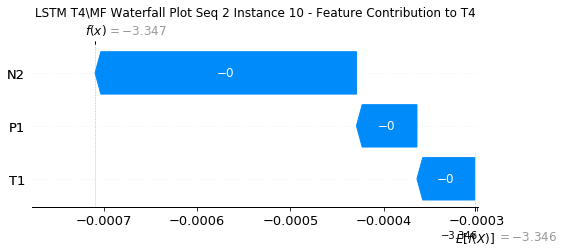

None

Contribution: [-8.69998654e-05  3.74677372e-04 -1.92647367e-04]


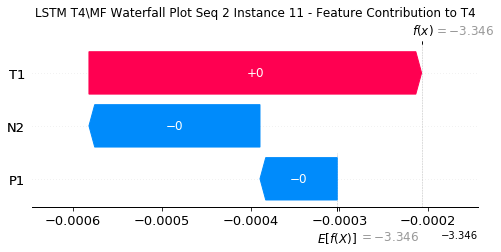

None

Contribution: [1.04462577e-05 8.54776943e-04 1.51518650e-04]


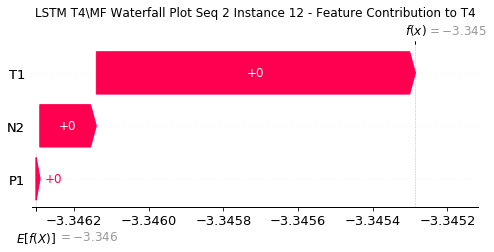

None

Contribution: [0.00016721 0.00103982 0.00052371]


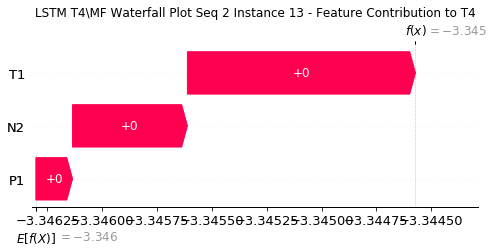

None

Contribution: [0.00041719 0.00051364 0.00047493]


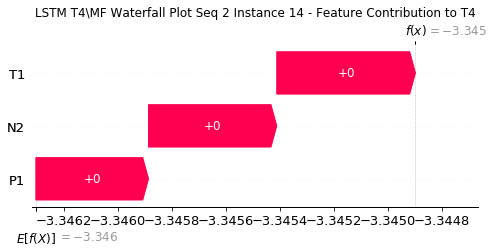

None

Contribution: [ 0.00017286 -0.00071233 -0.00022283]


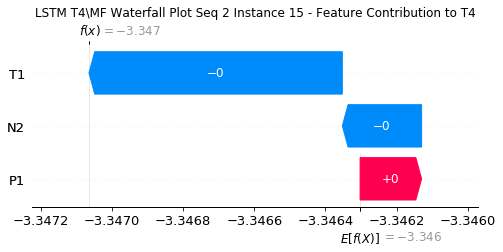

None

Contribution: [-0.00023147 -0.00208512 -0.00130561]


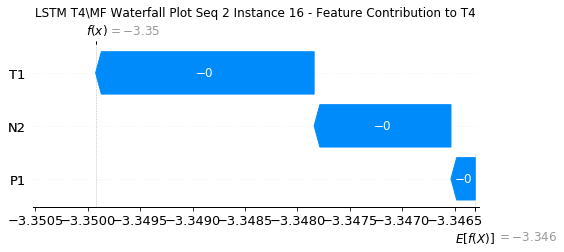

None

Contribution: [-0.00089354 -0.00258841 -0.00168717]


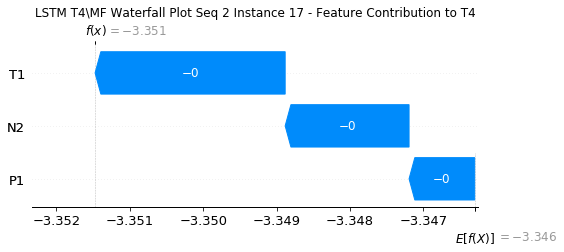

None

Contribution: [-0.00077358 -0.00139645 -0.00032121]


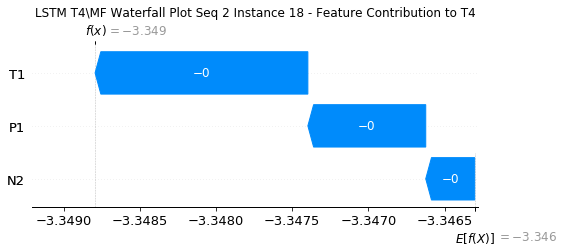

None

Contribution: [-0.00018007  0.00140546  0.00235437]


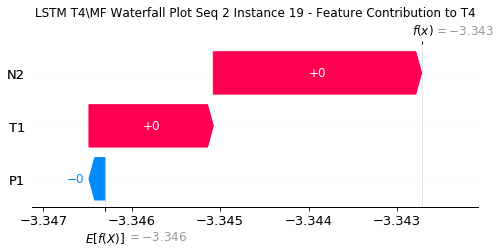

None

Contribution: [0.00089596 0.00509707 0.00392684]


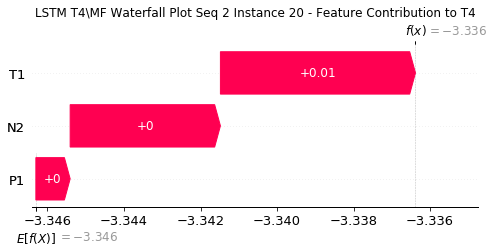

None

Contribution: [0.00234485 0.00973645 0.00135512]


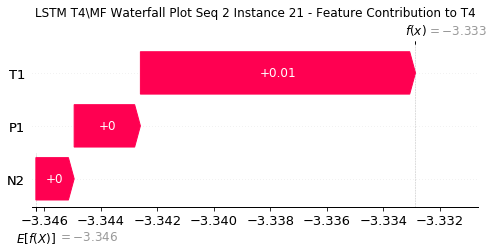

None

Contribution: [ 0.00194658  0.01227689 -0.00477847]


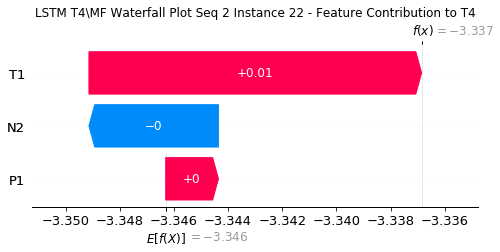

None

Contribution: [ 0.00418843  0.01605777 -0.01149728]


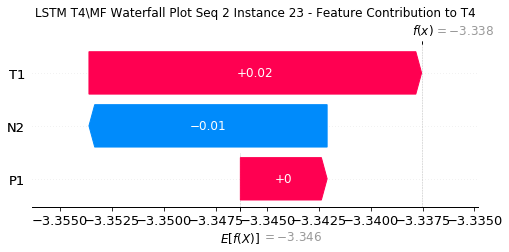

None

Contribution: [ 0.00251593  0.01771093 -0.00673901]


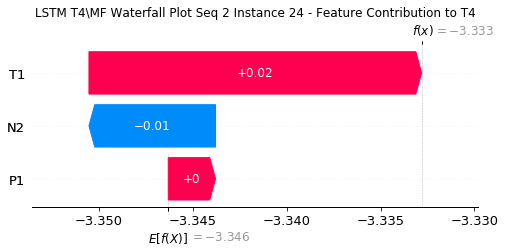

None

Contribution: [ 0.00552478  0.04931211 -0.00692899]


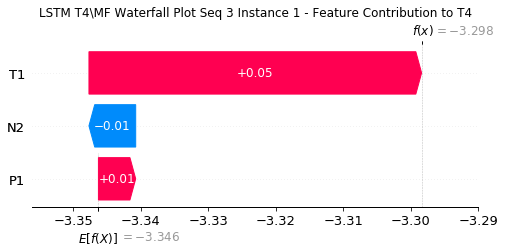

None

Contribution: [-0.00042682 -0.00337553  0.00107911]


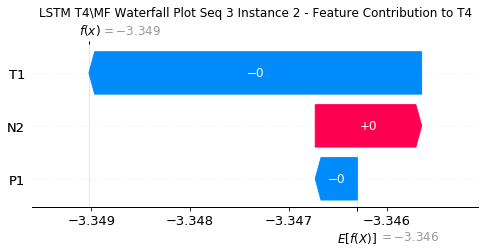

None

Contribution: [2.16082129e-04 1.57769311e-03 2.21547616e-05]


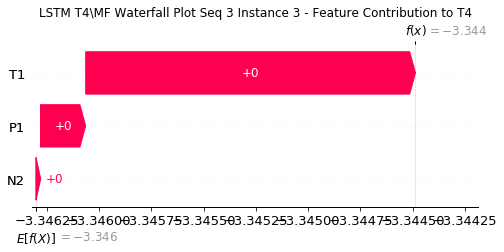

None

Contribution: [ 2.14760097e-05  3.34246859e-04 -1.15906457e-05]


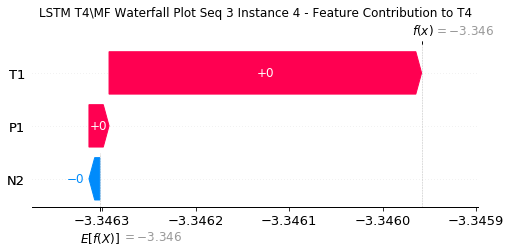

None

Contribution: [-2.35846511e-05  1.56274136e-04 -1.56716244e-06]


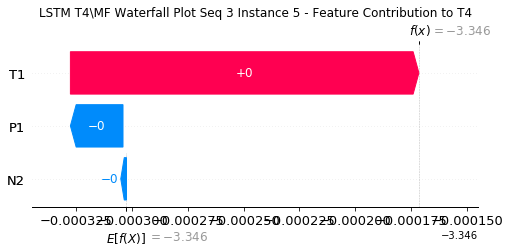

None

Contribution: [-1.48560662e-05  1.70856651e-04  7.06502290e-05]


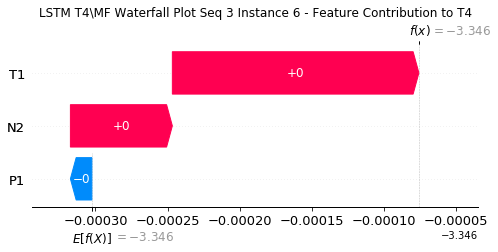

None

Contribution: [4.34603385e-05 1.95671458e-04 1.22062594e-04]


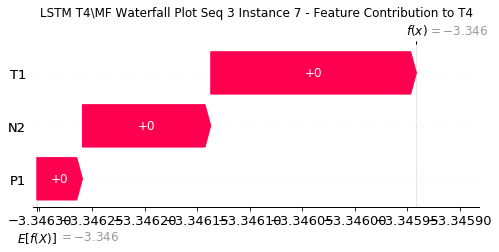

None

Contribution: [6.92874082e-05 1.47574701e-04 6.08858193e-05]


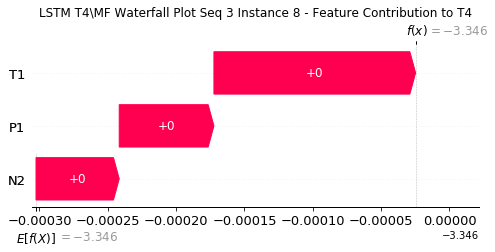

None

Contribution: [ 4.67923074e-05 -1.49901966e-04 -1.36351218e-04]


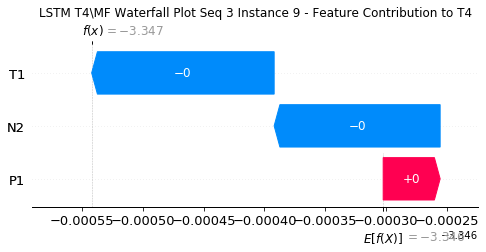

None

Contribution: [-7.36442465e-05 -4.47247271e-04 -3.16340782e-04]


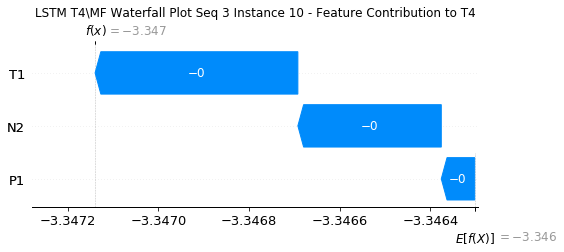

None

Contribution: [-0.00016717 -0.0004193  -0.00027514]


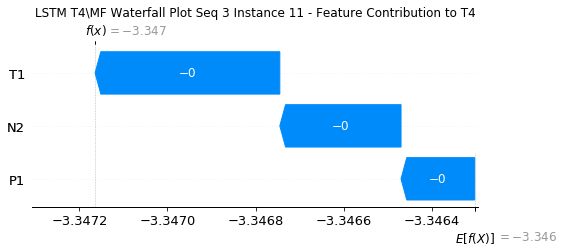

None

Contribution: [-1.11250823e-04  1.21783789e-04  7.09478448e-05]


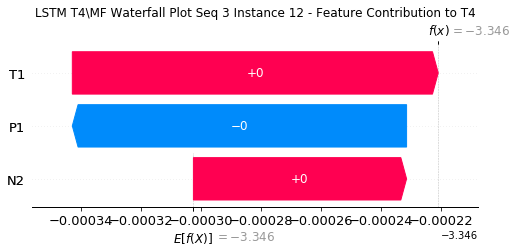

None

Contribution: [9.21719165e-05 1.24049279e-03 5.40137110e-04]


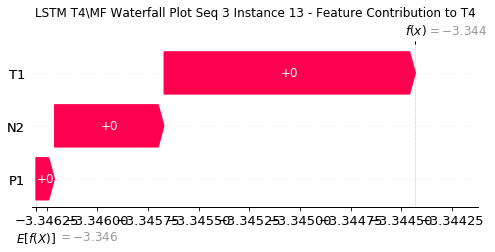

None

Contribution: [0.00043295 0.00222541 0.00061462]


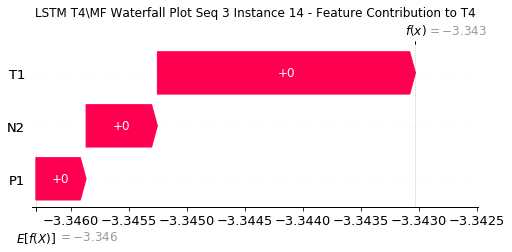

None

Contribution: [ 4.67038255e-04  2.23287207e-03 -6.02395231e-05]


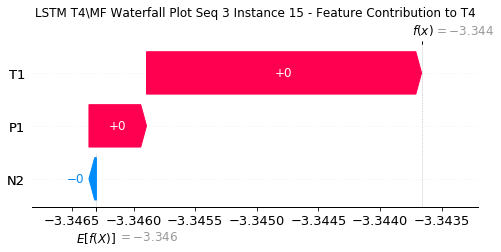

None

Contribution: [ 6.73956447e-05  9.48523117e-05 -1.22926027e-03]


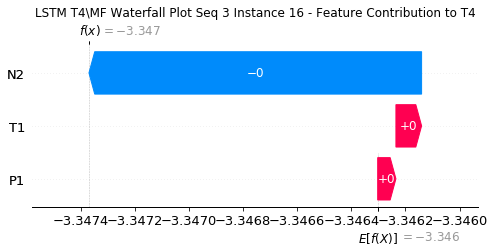

None

Contribution: [-0.00075864 -0.00415638 -0.0017979 ]


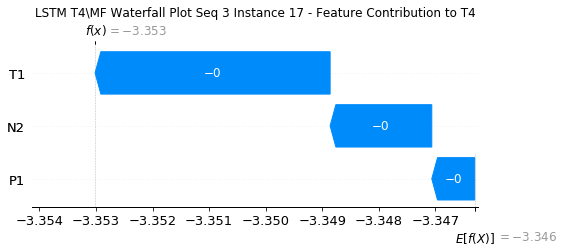

None

Contribution: [-0.00136884 -0.00852866 -0.00059749]


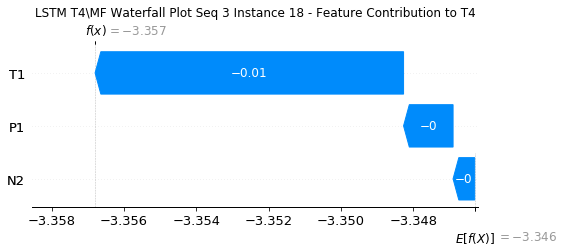

None

Contribution: [-0.00123948 -0.00970711  0.00210909]


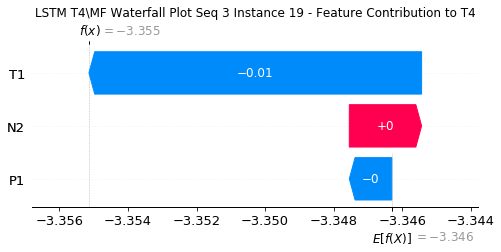

None

Contribution: [-3.10480086e-05 -2.38416522e-03  3.85845040e-03]


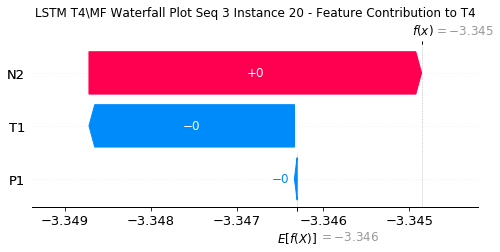

None

Contribution: [0.0025133  0.01600567 0.00148917]


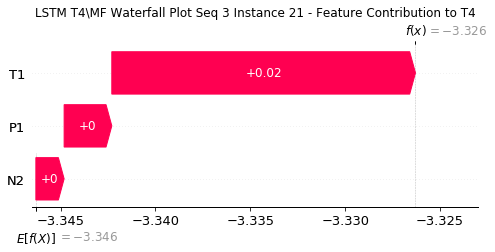

None

Contribution: [ 0.00367849  0.04098203 -0.00498343]


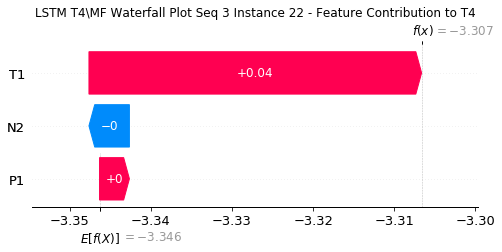

None

Contribution: [ 0.00315326  0.05627672 -0.01211109]


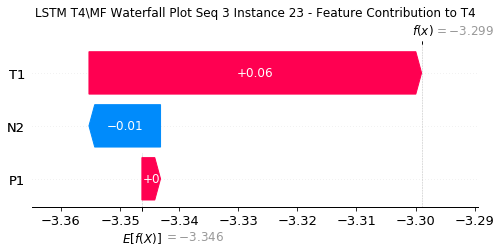

None

Contribution: [ 0.00270583  0.0308678  -0.00583412]


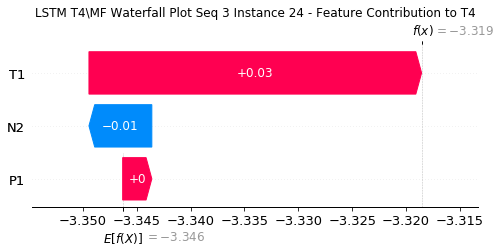

None

Contribution: [ 0.00635768  0.06207615 -0.00484799]


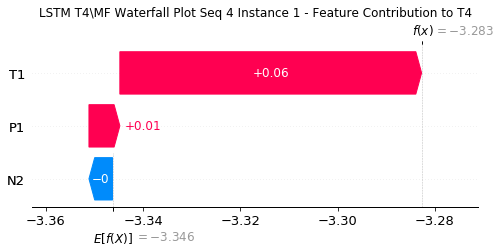

None

Contribution: [-0.00053567 -0.00442646  0.00093895]


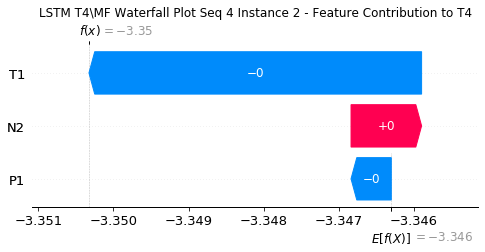

None

Contribution: [2.03216193e-04 1.48854194e-03 5.02663614e-05]


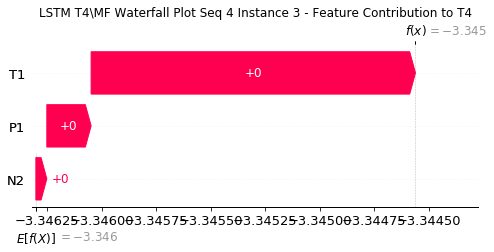

None

Contribution: [ 1.76456021e-05  2.88132748e-04 -1.09973650e-05]


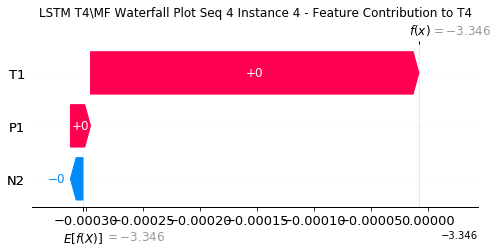

None

Contribution: [-2.64058738e-05  1.57065575e-04 -8.23735255e-06]


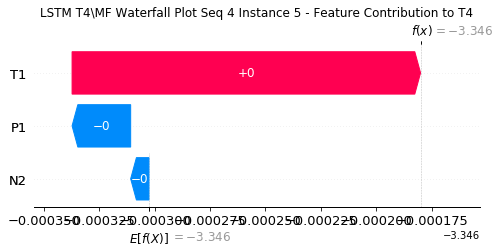

None

Contribution: [-1.90926348e-05  1.77262311e-04  7.03071215e-05]


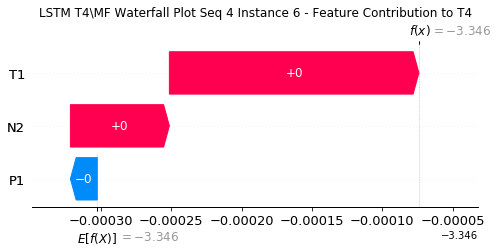

None

Contribution: [4.00904125e-05 2.38809389e-04 1.28175296e-04]


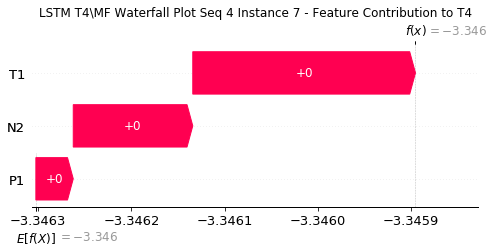

None

Contribution: [7.89506756e-05 1.72937595e-04 6.24753041e-05]


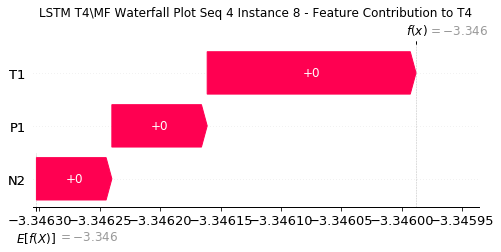

None

Contribution: [ 5.41908106e-05 -1.62041939e-04 -1.35974847e-04]


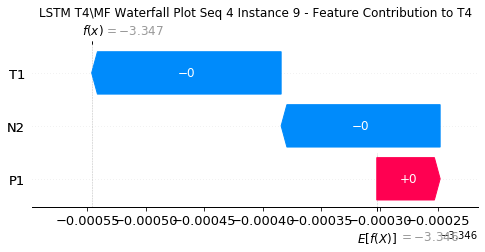

None

Contribution: [-7.13031906e-05 -5.17147830e-04 -3.19205100e-04]


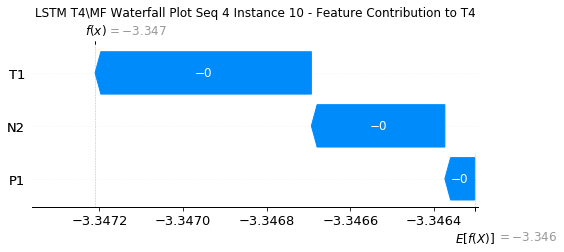

None

Contribution: [-0.00016308 -0.00059013 -0.00028579]


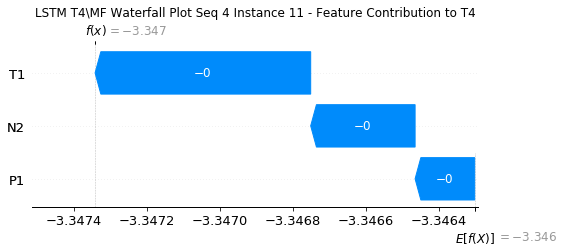

None

Contribution: [-2.23622503e-04 -1.58299153e-04  6.35737250e-05]


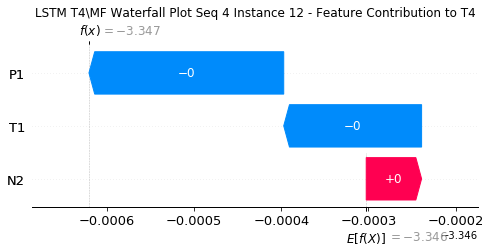

None

Contribution: [7.10521164e-05 1.14506245e-03 5.41918486e-04]


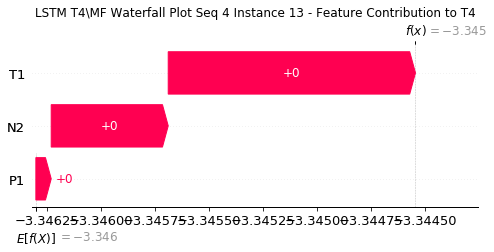

None

Contribution: [0.00038466 0.00250052 0.00059802]


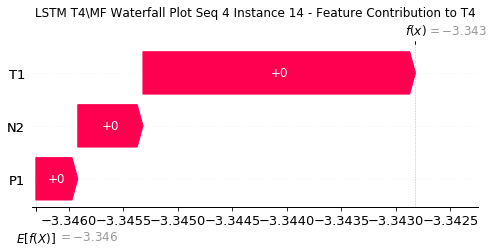

None

Contribution: [ 4.02155755e-04  2.70368879e-03 -6.45376699e-05]


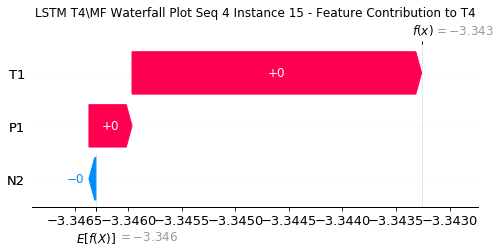

None

Contribution: [ 5.90486486e-05  5.41705272e-04 -1.24697594e-03]


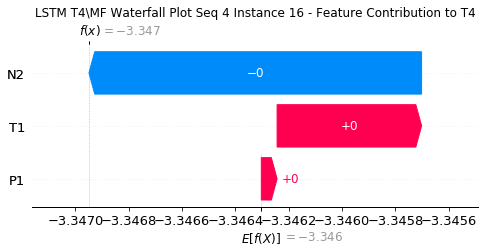

None

Contribution: [-0.00068673 -0.0041231  -0.00179067]


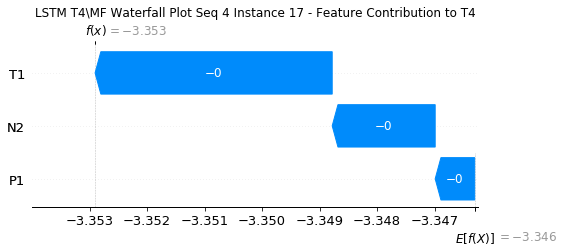

None

Contribution: [-0.00115458 -0.00965132 -0.00057844]


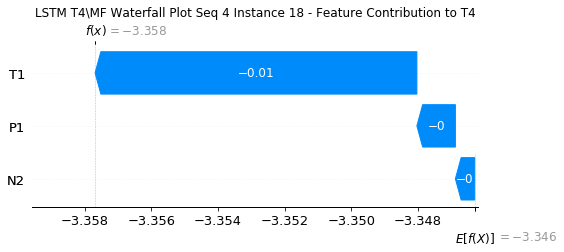

None

Contribution: [-0.00106071 -0.01164561  0.00219063]


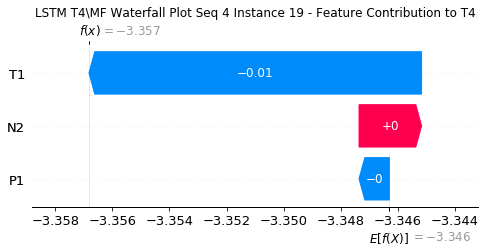

None

Contribution: [-4.41909900e-05 -4.30664893e-03  3.93427008e-03]


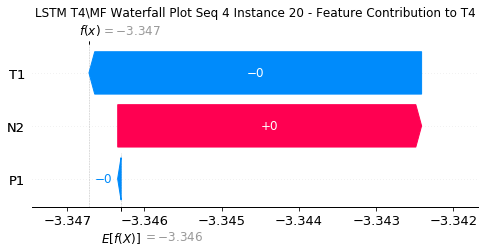

None

Contribution: [0.00234502 0.0155538  0.00139121]


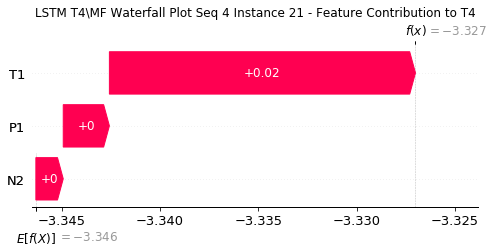

None

Contribution: [ 0.0038011   0.04217488 -0.00516182]


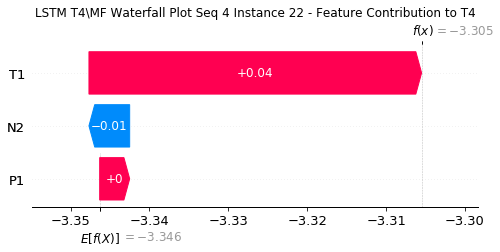

None

Contribution: [ 0.00244235  0.051643   -0.01218099]


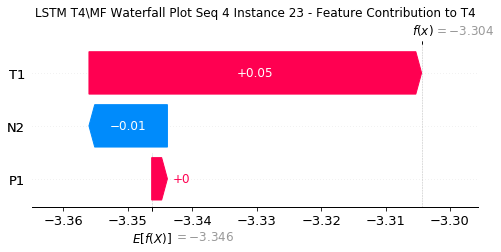

None

Contribution: [ 0.00211119  0.03071668 -0.00638381]


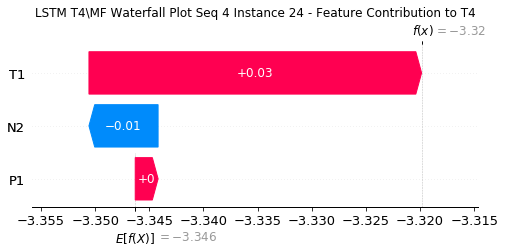

None

Contribution: [ 0.00490925  0.06587562 -0.00543107]


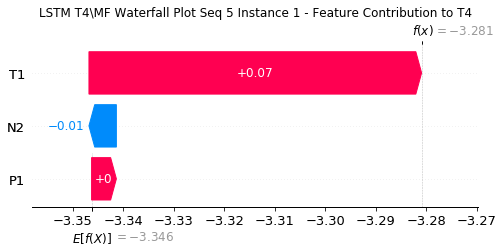

None

Contribution: [-0.0004006  -0.00513251  0.00093421]


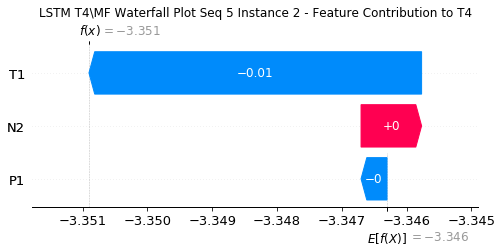

None

Contribution: [2.04592519e-04 1.71602090e-03 3.32867984e-05]


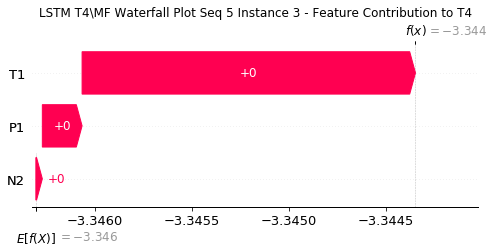

None

Contribution: [ 1.41501419e-05  2.70676264e-04 -1.24033399e-05]


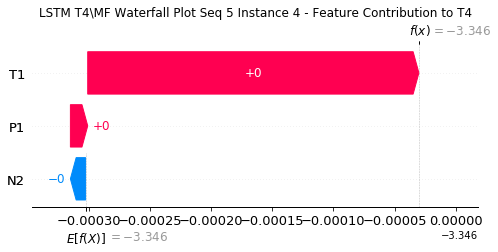

None

Contribution: [-2.63606837e-05  4.97250020e-05 -6.10310105e-06]


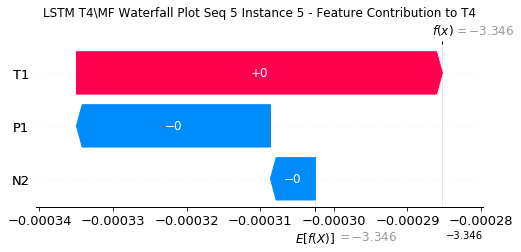

None

Contribution: [-2.39193088e-05  1.10654000e-04  7.48479083e-05]


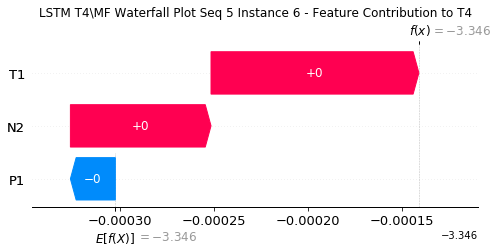

None

Contribution: [3.84614779e-05 2.45264412e-04 1.29331147e-04]


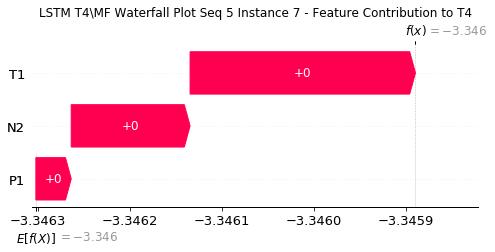

None

Contribution: [1.00768856e-04 2.38866298e-04 6.57913332e-05]


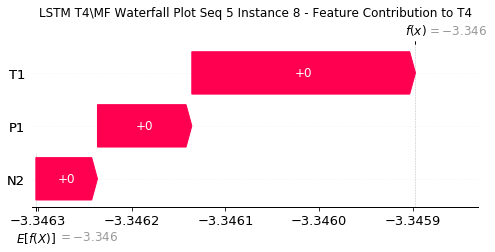

None

Contribution: [ 4.97061140e-05 -1.04943825e-04 -1.40558088e-04]


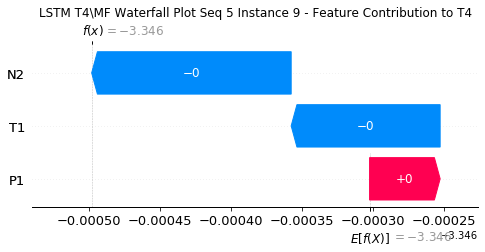

None

Contribution: [-6.97519223e-05 -5.37636690e-04 -3.19668792e-04]


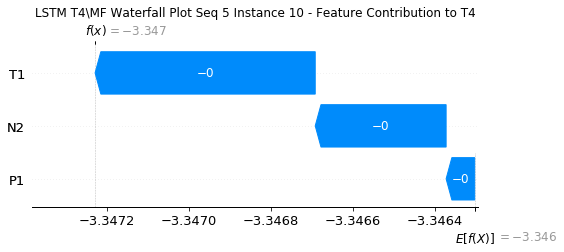

None

Contribution: [-0.00015991 -0.00071575 -0.00028242]


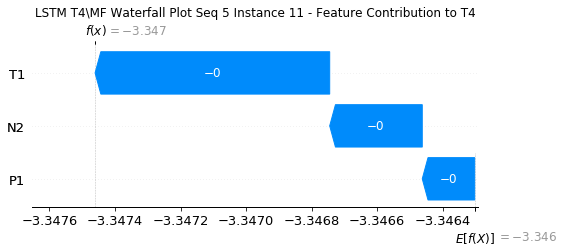

None

Contribution: [-1.82095522e-04 -1.73368331e-04  7.65880702e-05]


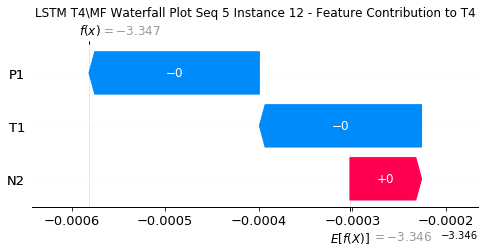

None

Contribution: [6.98885905e-05 1.08817197e-03 5.45195500e-04]


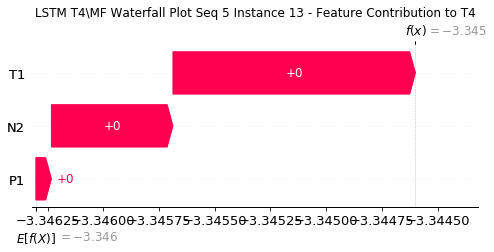

None

Contribution: [0.00037004 0.00254735 0.00061994]


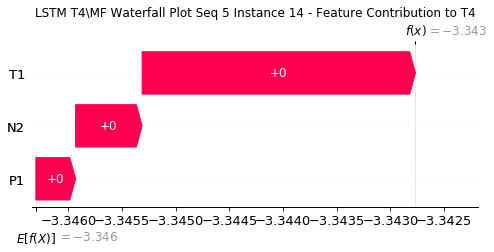

None

Contribution: [ 3.84109943e-04  3.04566231e-03 -7.34468062e-05]


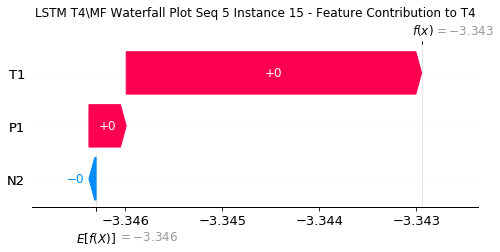

None

Contribution: [ 7.14934003e-05  9.19007439e-04 -1.24877152e-03]


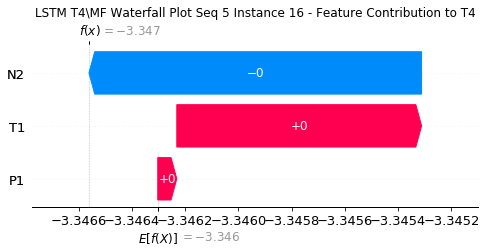

None

Contribution: [-0.00072855 -0.00418592 -0.00180002]


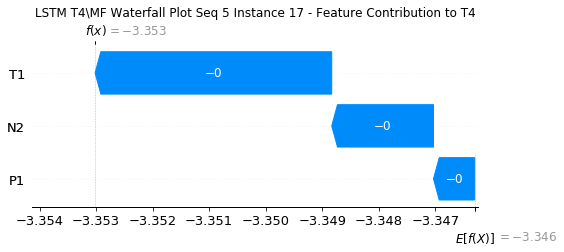

None

Contribution: [-0.00131029 -0.01048393 -0.00056417]


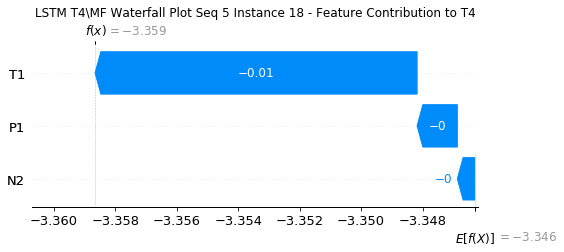

None

Contribution: [-0.0013272  -0.01300713  0.00221135]


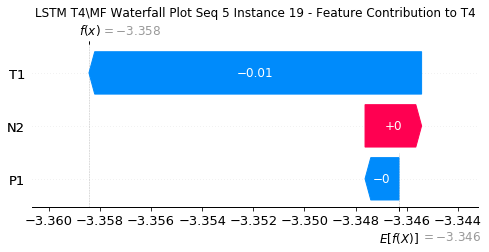

None

Contribution: [-0.00023493 -0.00502901  0.00396775]


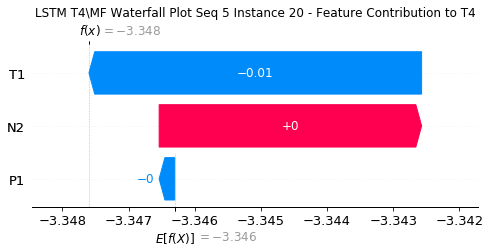

None

Contribution: [0.00239339 0.01580686 0.00137276]


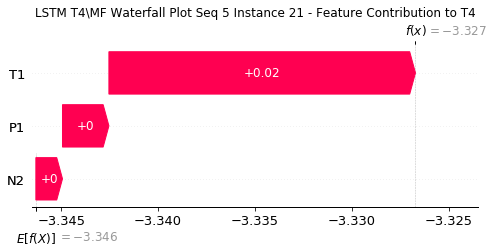

None

Contribution: [ 0.00422089  0.04335791 -0.00522561]


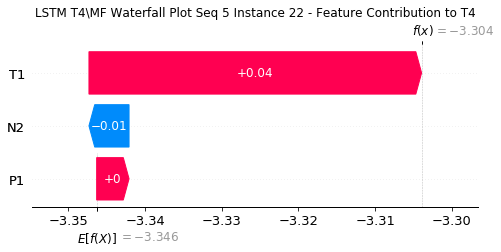

None

Contribution: [ 0.00519443  0.05162204 -0.01185883]


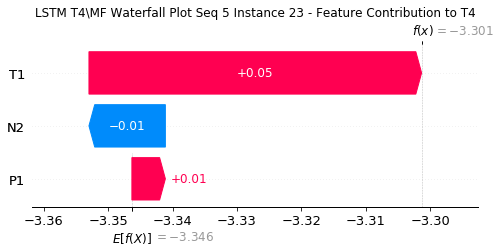

None

Contribution: [ 0.00348892  0.03101195 -0.00630225]


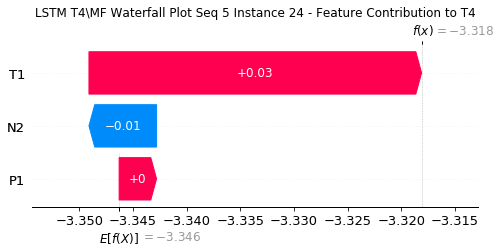

None

Contribution: [ 0.00660473  0.06370081 -0.00576737]


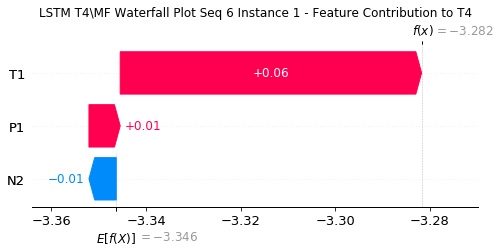

None

Contribution: [-0.00042438 -0.00484035  0.00098477]


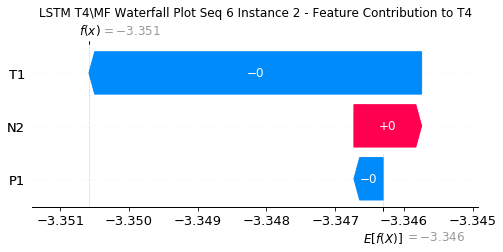

None

Contribution: [2.35093353e-04 1.60255587e-03 5.74459896e-05]


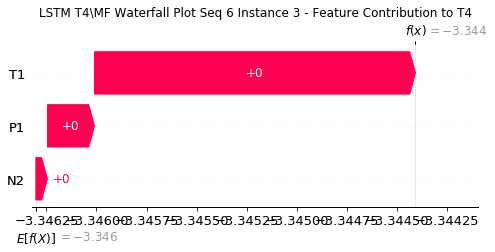

None

Contribution: [ 1.81464059e-05  2.91207799e-04 -9.52287611e-06]


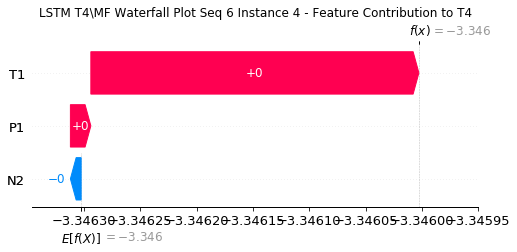

None

Contribution: [-3.96454457e-05  1.05471181e-04 -8.62504104e-06]


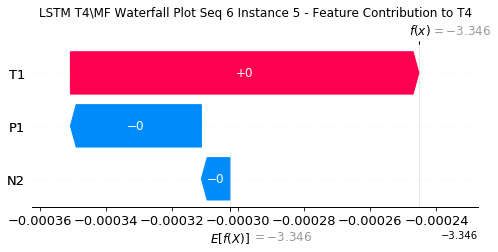

None

Contribution: [-2.16608813e-05  1.47126406e-04  7.14167582e-05]


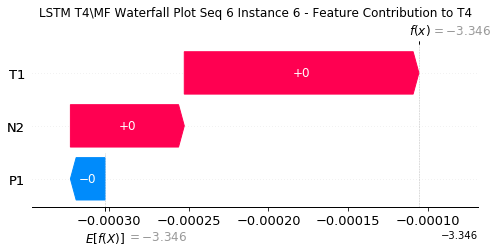

None

Contribution: [4.14940373e-05 2.20718761e-04 1.26173190e-04]


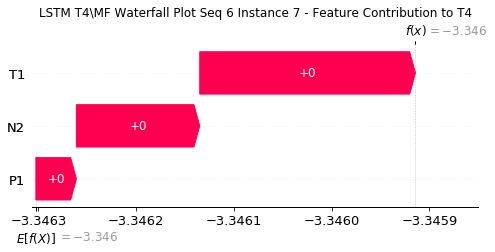

None

Contribution: [1.06623646e-04 1.40783902e-04 5.61243523e-05]


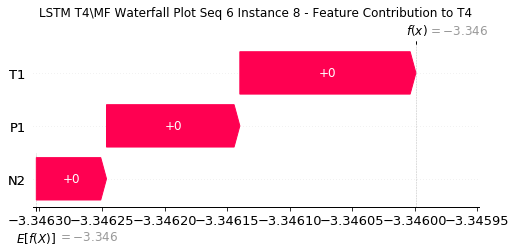

None

Contribution: [ 4.69299028e-05 -1.46645482e-04 -1.44271352e-04]


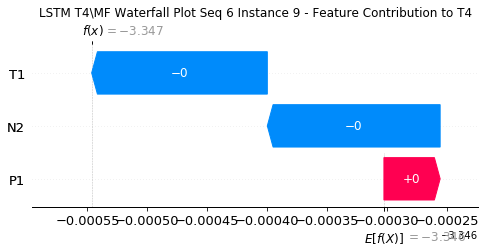

None

Contribution: [-7.20487753e-05 -4.92281616e-04 -3.16599028e-04]


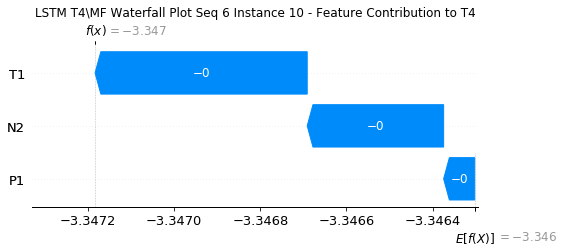

None

Contribution: [-0.00016619 -0.00053535 -0.00027634]


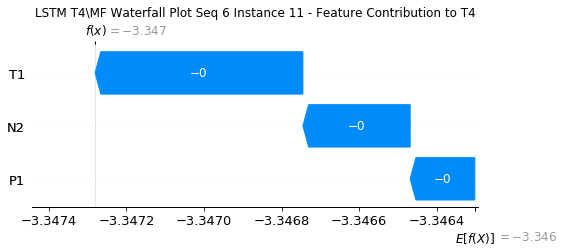

None

Contribution: [-7.55063901e-05  4.28249118e-05  7.95682021e-05]


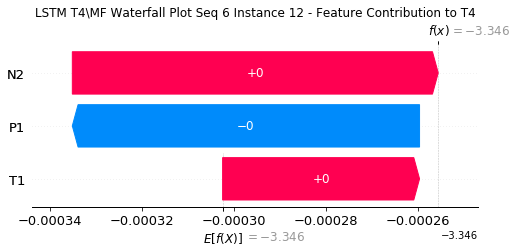

None

Contribution: [8.20338931e-05 1.19393074e-03 5.46816630e-04]


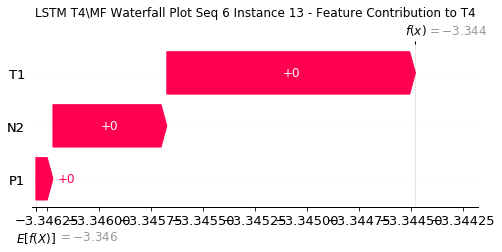

None

Contribution: [0.00040347 0.0024078  0.00063812]


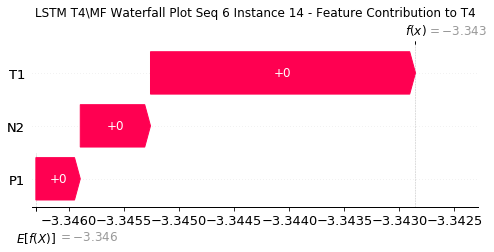

None

Contribution: [ 3.95287219e-04  2.46100087e-03 -9.23163573e-05]


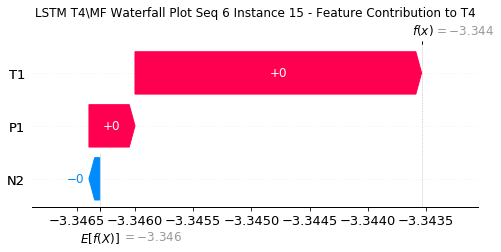

None

Contribution: [-8.58352791e-06  2.54590653e-04 -1.27281744e-03]


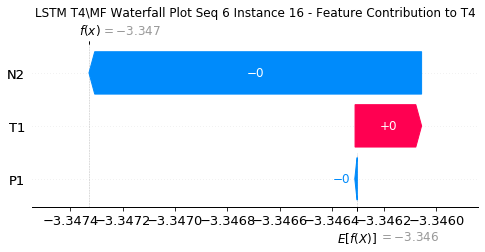

None

Contribution: [-0.00075217 -0.00408951 -0.00178208]


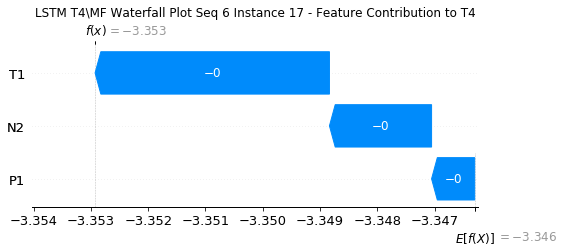

None

Contribution: [-0.00112348 -0.00874578 -0.00053171]


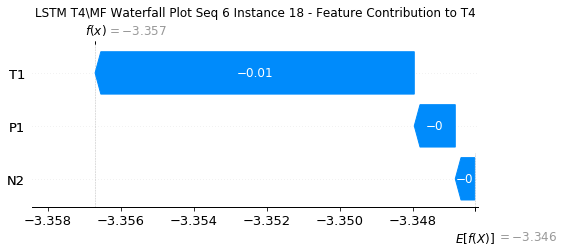

None

Contribution: [-0.00080869 -0.00984732  0.00229619]


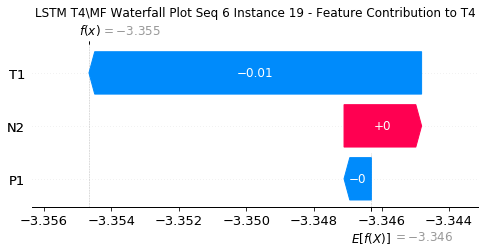

None

Contribution: [ 0.0002005  -0.00245763  0.00405433]


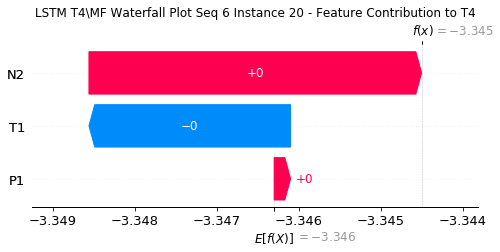

None

Contribution: [0.00210341 0.01511297 0.00121795]


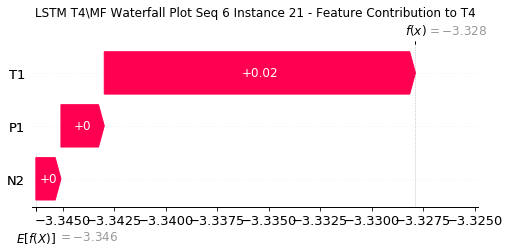

None

Contribution: [ 0.002821    0.03806917 -0.0057687 ]


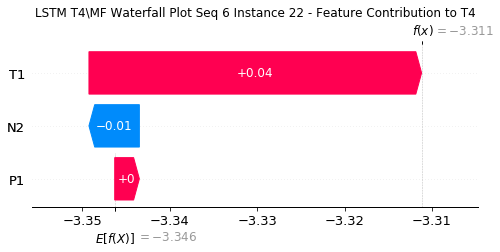

None

Contribution: [ 0.00380452  0.04634917 -0.0127948 ]


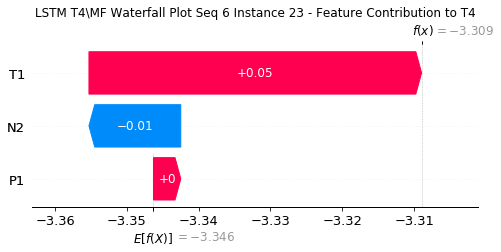

None

Contribution: [ 0.00188243  0.02662597 -0.00683175]


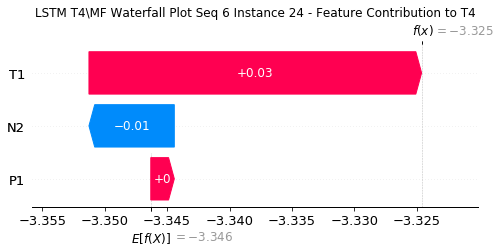

None

Contribution: [ 0.00556972  0.05584299 -0.00645604]


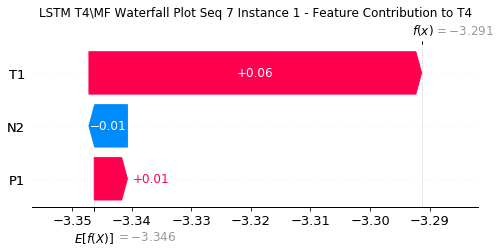

None

Contribution: [-0.00044927 -0.00446286  0.00096735]


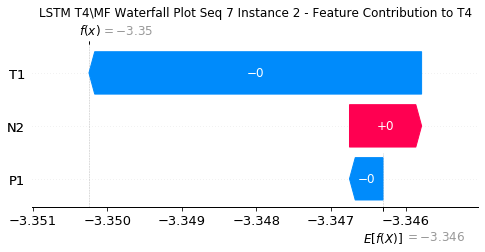

None

Contribution: [2.02170470e-04 1.64139671e-03 4.37724764e-05]


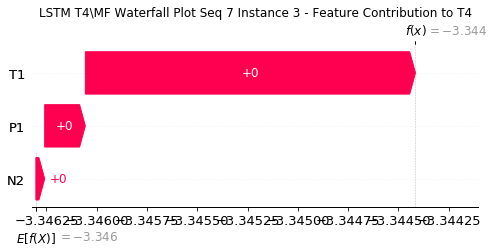

None

Contribution: [ 1.45816625e-05  2.84439439e-04 -1.49519139e-05]


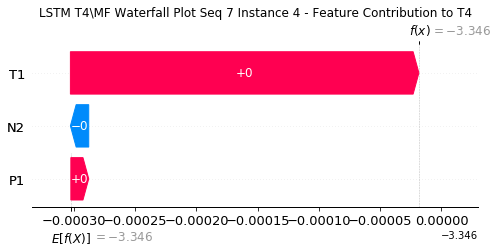

None

Contribution: [-3.62949191e-05  9.13725949e-05 -1.10469358e-05]


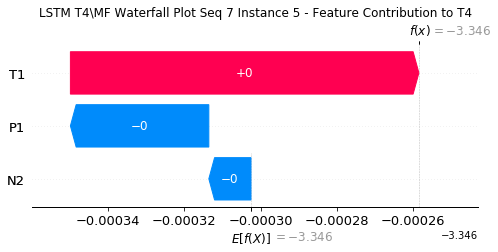

None

Contribution: [-2.36775802e-05  1.26314140e-04  6.98357165e-05]


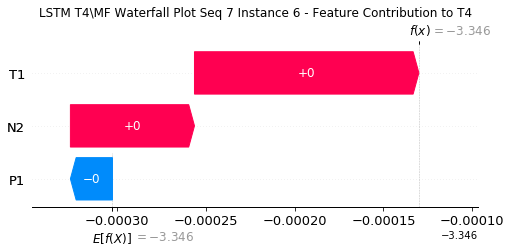

None

Contribution: [3.88126118e-05 2.51867975e-04 1.30386822e-04]


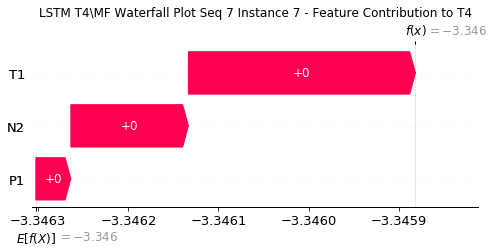

None

Contribution: [8.13199099e-05 2.22494115e-04 8.03344227e-05]


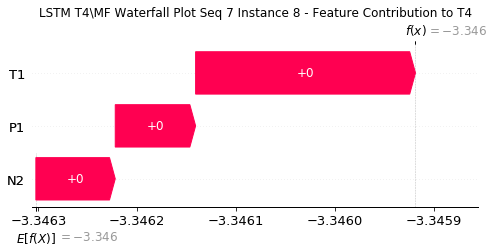

None

Contribution: [ 5.68879216e-05 -8.53028838e-05 -1.17015568e-04]


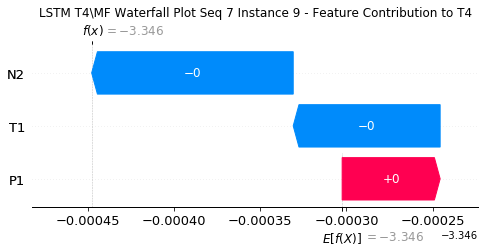

None

Contribution: [-6.98737096e-05 -5.53412114e-04 -3.23272271e-04]


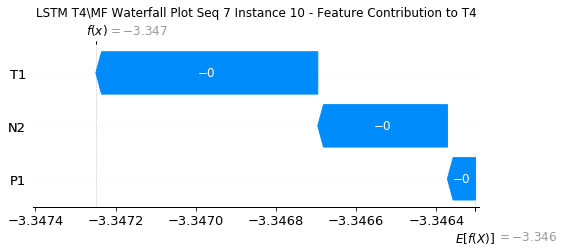

None

Contribution: [-0.00017405 -0.00084914 -0.00029471]


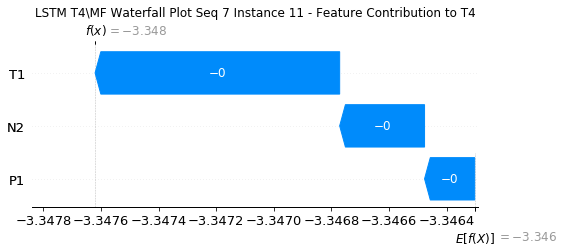

None

Contribution: [-1.29481623e-04 -5.74309957e-04  6.91658269e-05]


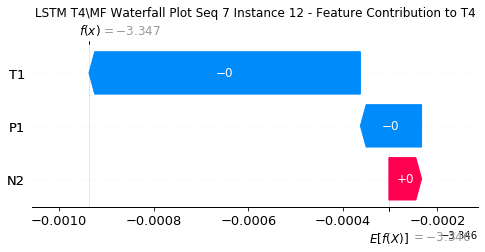

None

Contribution: [5.30838880e-05 9.79614474e-04 5.37100794e-04]


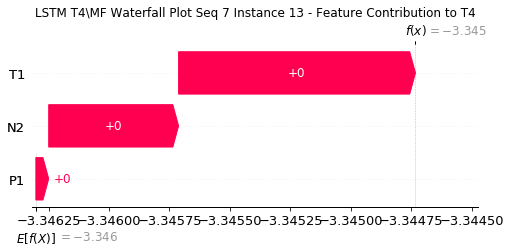

None

Contribution: [0.0004046  0.00292712 0.00059557]


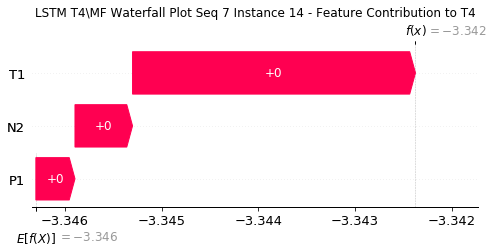

None

Contribution: [ 4.84493371e-04  3.78467935e-03 -5.32953171e-05]


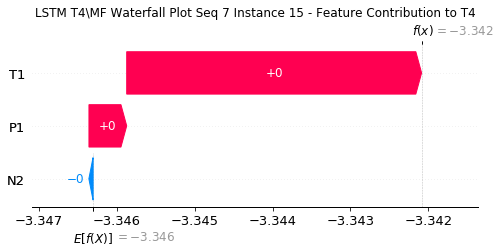

None

Contribution: [ 0.00012485  0.0016     -0.00125918]


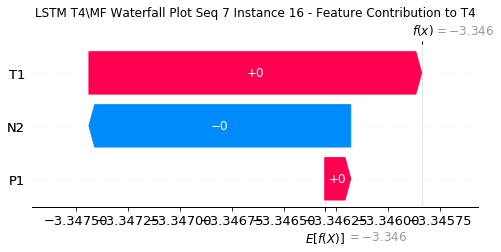

None

Contribution: [-0.00069801 -0.00431301 -0.00180238]


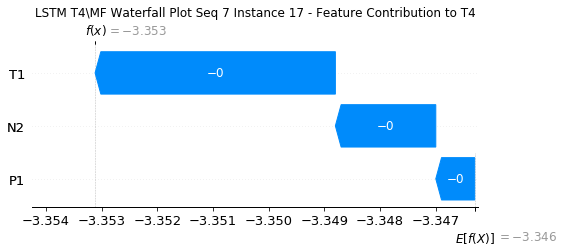

None

Contribution: [-0.0014405  -0.01200061 -0.00055505]


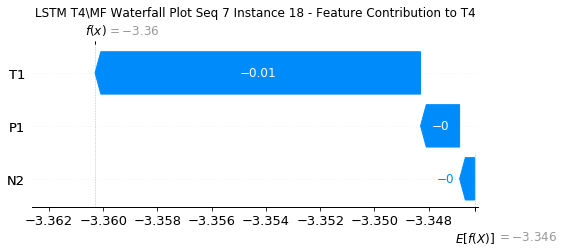

None

Contribution: [-0.0014517  -0.01567829  0.00227925]


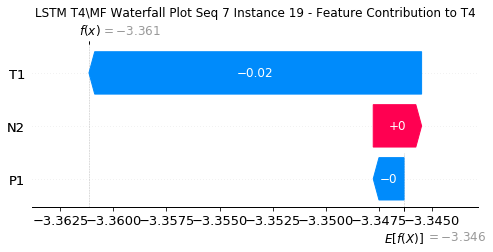

None

Contribution: [-0.00032977 -0.00723859  0.00397175]


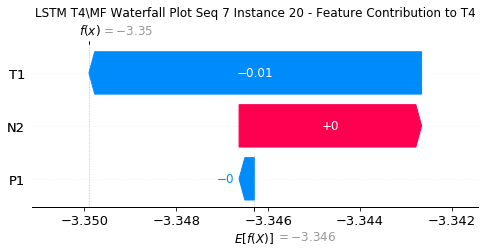

None

Contribution: [0.00235346 0.01723173 0.0013187 ]


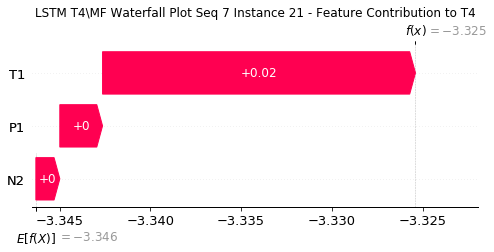

None

Contribution: [ 0.00417644  0.04982913 -0.00538237]


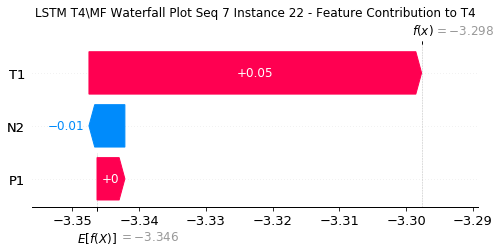

None

Contribution: [ 0.00353266  0.06436259 -0.01221579]


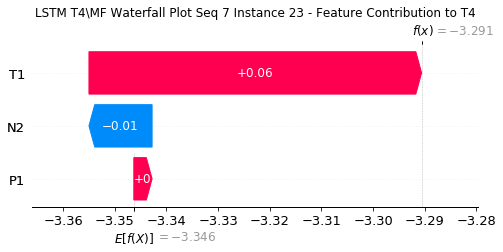

None

Contribution: [ 0.00248508  0.03790177 -0.00678841]


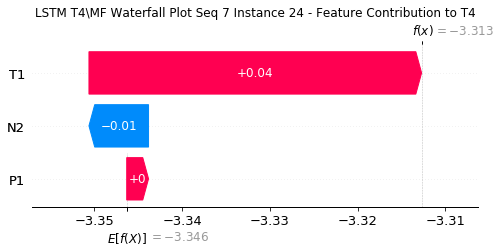

None

Contribution: [ 0.00627793  0.07450717 -0.00547569]


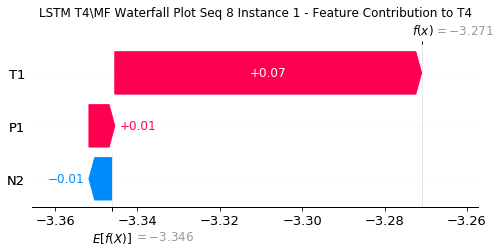

None

Contribution: [-0.00063492 -0.00562373  0.00096334]


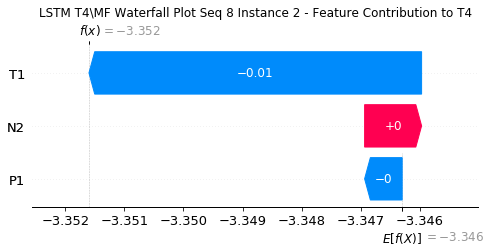

None

Contribution: [1.76343129e-04 1.87040117e-03 7.39483823e-05]


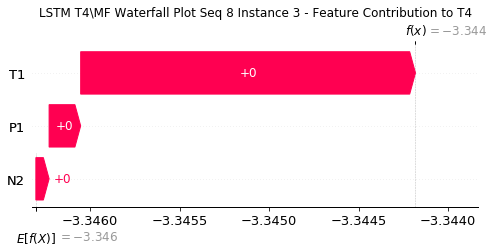

None

Contribution: [ 9.49054334e-06  1.92242742e-04 -1.31396266e-05]


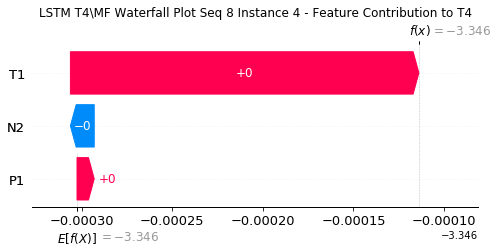

None

Contribution: [-4.02975340e-05 -3.48495595e-05 -1.26850594e-05]


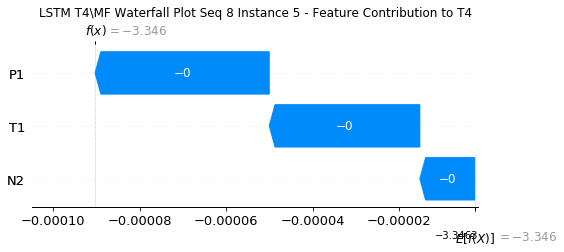

None

Contribution: [-4.26657889e-05  1.02609607e-05  6.30915054e-05]


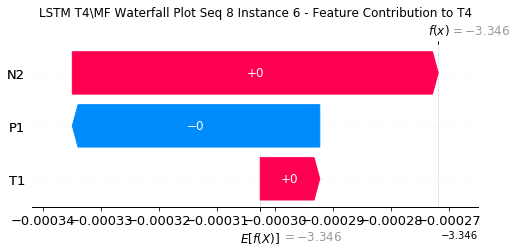

None

Contribution: [3.46982457e-05 2.97286301e-04 1.32706639e-04]


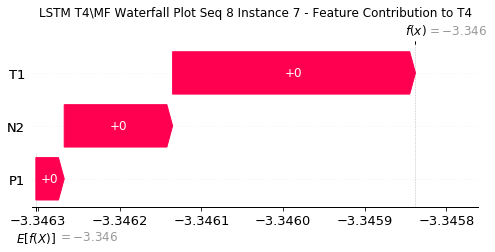

None

Contribution: [1.08906198e-04 4.17157615e-04 7.85251344e-05]


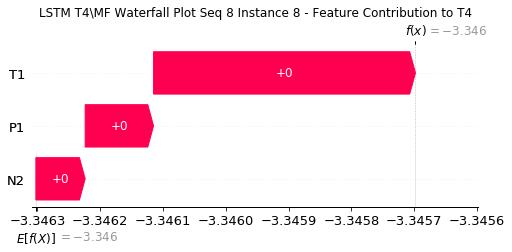

None

Contribution: [ 8.86976433e-05 -5.72255082e-07 -1.22837799e-04]


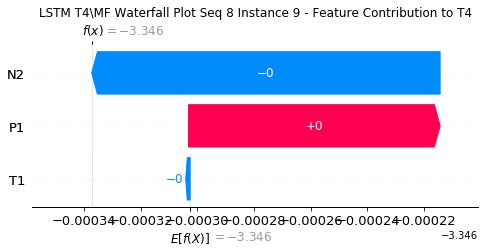

None

Contribution: [-6.52595921e-05 -6.29524923e-04 -3.19970696e-04]


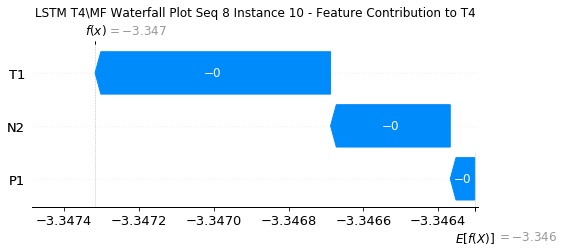

None

Contribution: [-0.00019417 -0.00114928 -0.00030758]


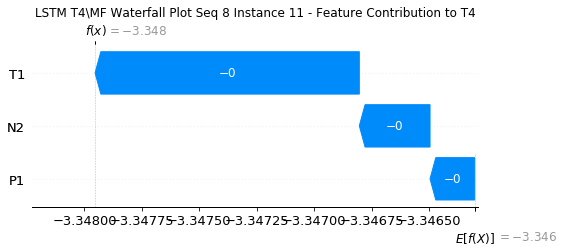

None

Contribution: [-2.39837941e-04 -8.65749703e-04  4.49406625e-05]


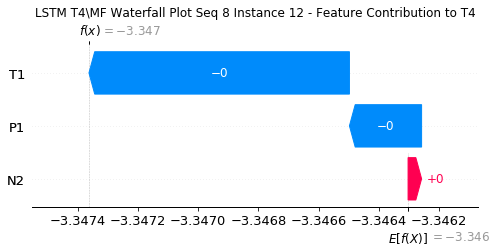

None

Contribution: [3.48439903e-05 7.76791974e-04 5.38894655e-04]


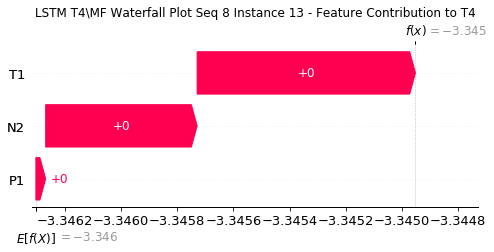

None

Contribution: [0.00036987 0.00308222 0.00060108]


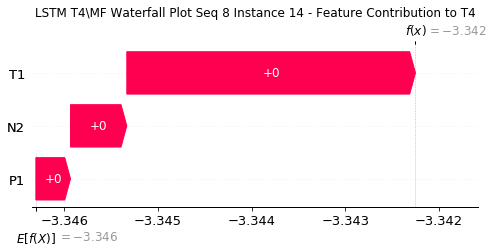

None

Contribution: [ 5.48233085e-04  4.25610965e-03 -5.52731806e-05]


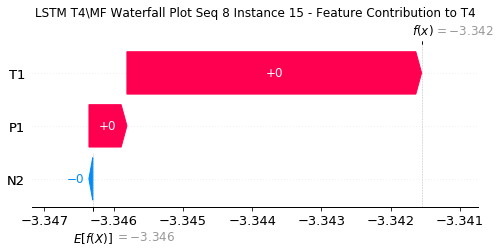

None

Contribution: [ 0.00040701  0.00229612 -0.00118126]


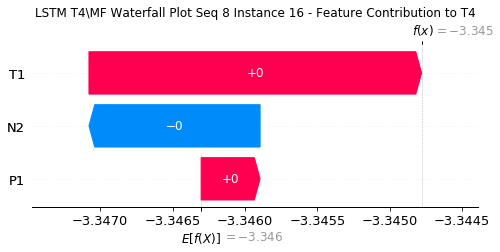

None

Contribution: [-0.00067692 -0.00403703 -0.00179207]


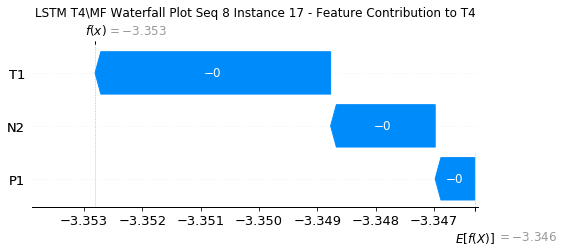

None

Contribution: [-0.00150434 -0.0124214  -0.00058144]


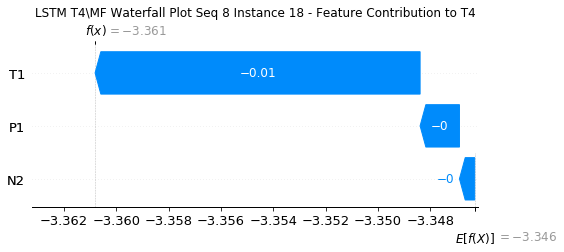

None

Contribution: [-0.00189072 -0.01669029  0.00210506]


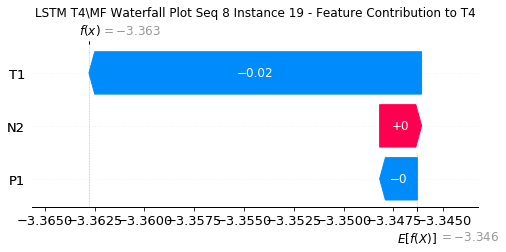

None

Contribution: [-0.00016302 -0.00778774  0.00404186]


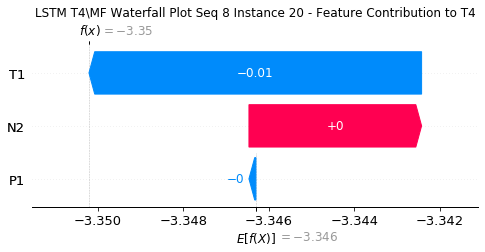

None

Contribution: [0.00244001 0.01634384 0.00133075]


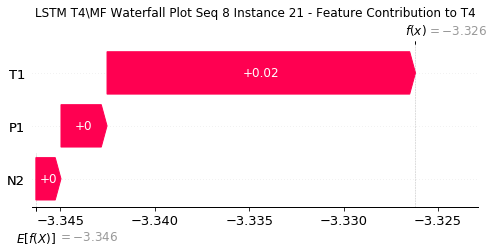

None

Contribution: [ 0.00307567  0.04933881 -0.00651076]


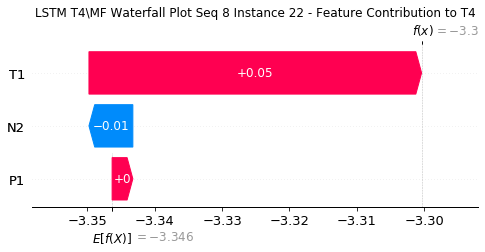

None

Contribution: [ 0.00621451  0.06681222 -0.0126187 ]


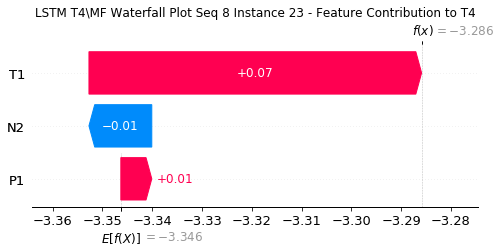

None

Contribution: [ 0.00692438  0.03814765 -0.00410859]


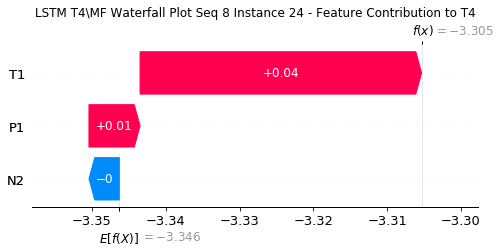

None

Contribution: [ 0.00451013  0.0731283  -0.00524106]


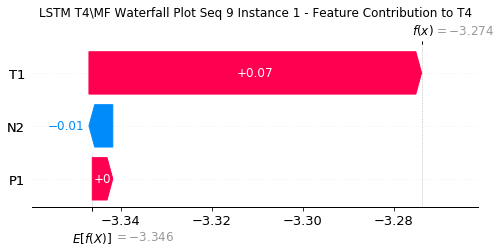

None

Contribution: [-0.00057761 -0.00626504  0.00101711]


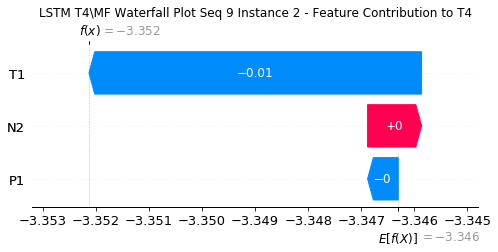

None

Contribution: [3.43471067e-04 1.82916629e-03 9.03906322e-06]


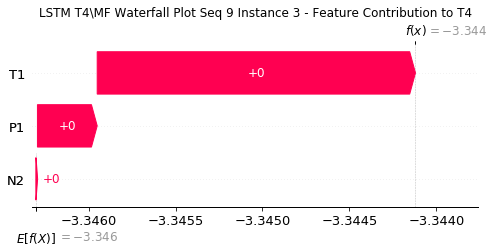

None

Contribution: [ 1.73308245e-05  2.50475380e-04 -5.97835729e-06]


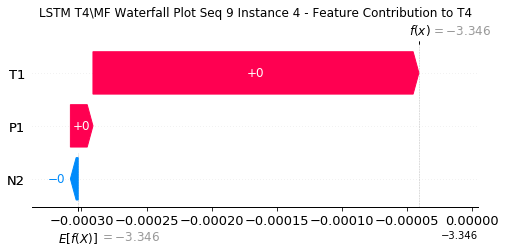

None

Contribution: [-7.97419177e-05 -2.10371677e-05  9.32750080e-06]


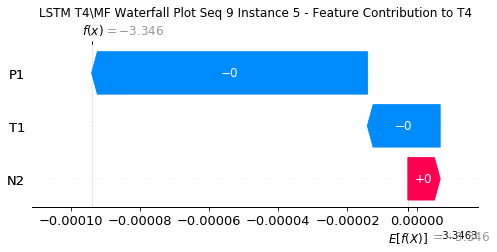

None

Contribution: [-3.16773418e-05  1.03012514e-04  8.92173181e-05]


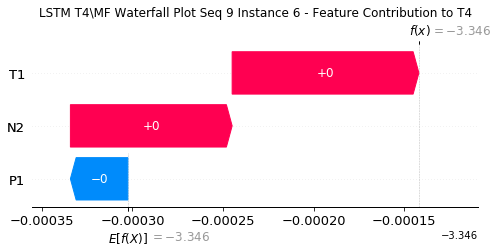

None

Contribution: [4.72825022e-05 2.38978095e-04 1.19899561e-04]


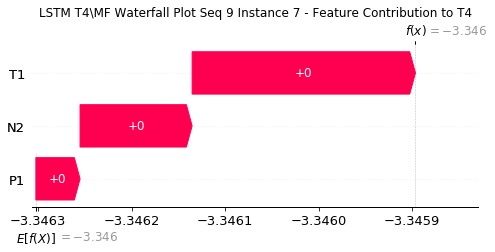

None

Contribution: [7.97540674e-05 6.94041971e-05 3.02114460e-05]


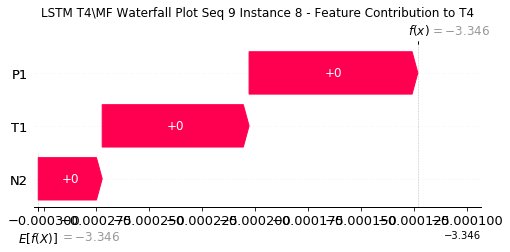

None

Contribution: [ 2.72191850e-05 -1.81939759e-04 -1.60533501e-04]


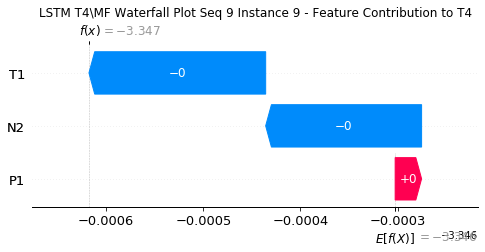

None

Contribution: [-7.33654270e-05 -5.02123847e-04 -3.10171726e-04]


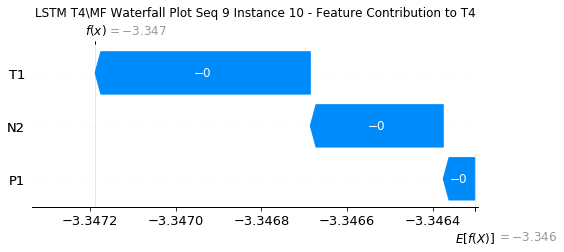

None

Contribution: [-0.00014236 -0.00052187 -0.00024583]


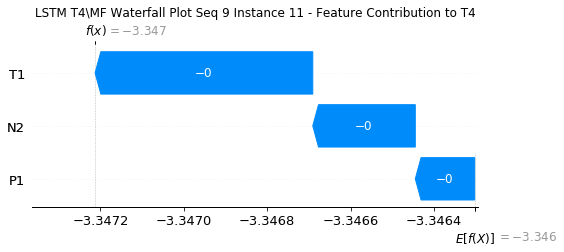

None

Contribution: [-1.17971053e-04  9.71476101e-05  1.05266581e-04]


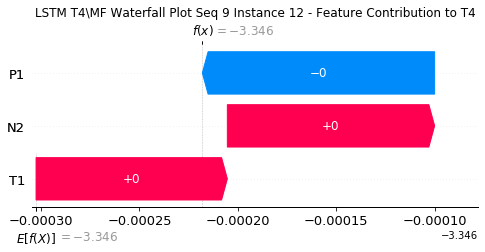

None

Contribution: [9.92789914e-05 1.19870466e-03 5.58062744e-04]


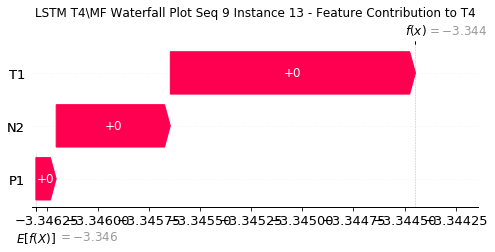

None

Contribution: [0.00033521 0.00226784 0.00054477]


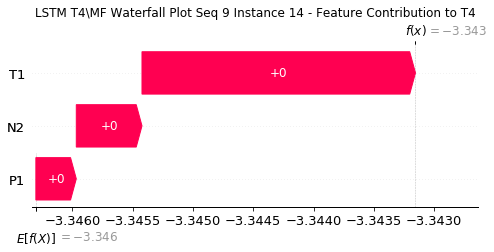

None

Contribution: [ 0.00020161  0.00184723 -0.00018832]


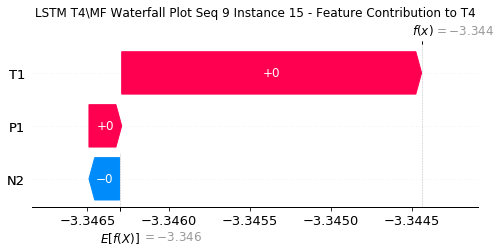

None

Contribution: [-0.00019693 -0.00037576 -0.00136325]


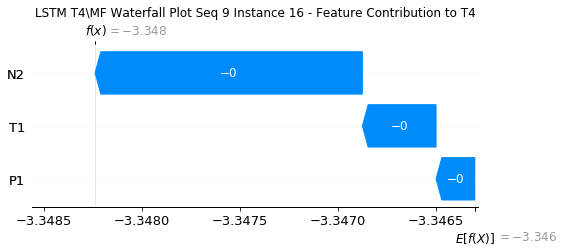

None

Contribution: [-0.00076899 -0.00391627 -0.00174918]


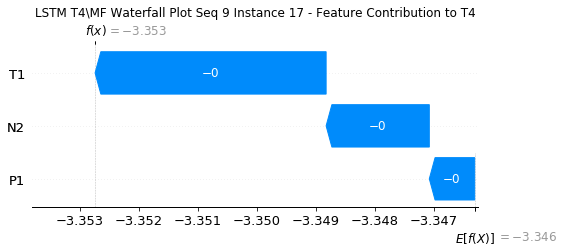

None

Contribution: [-0.00098659 -0.00763722 -0.00033474]


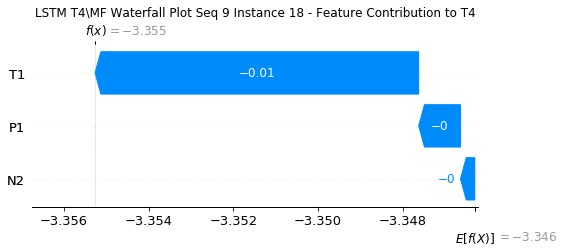

None

Contribution: [-0.00049899 -0.00805912  0.0025871 ]


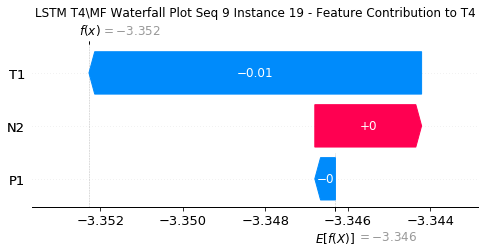

None

Contribution: [ 0.00036752 -0.00159756  0.00416178]


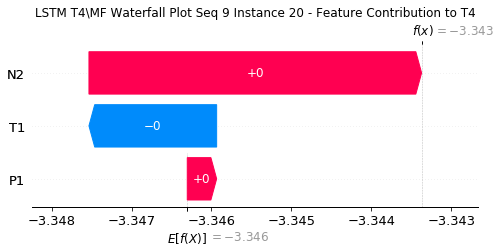

None

Contribution: [0.00164963 0.01383147 0.00111355]


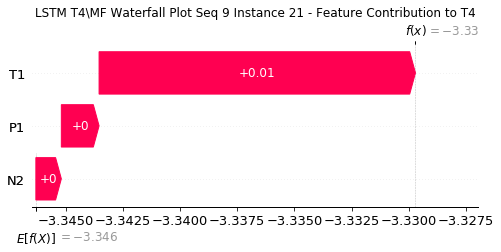

None

Contribution: [ 0.00204535  0.0343846  -0.00592219]


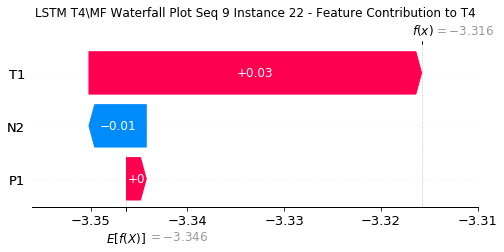

None

Contribution: [ 0.00477144  0.03453762 -0.01156145]


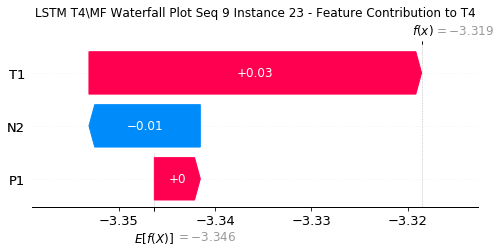

None

Contribution: [ 0.00167041  0.02028694 -0.00669993]


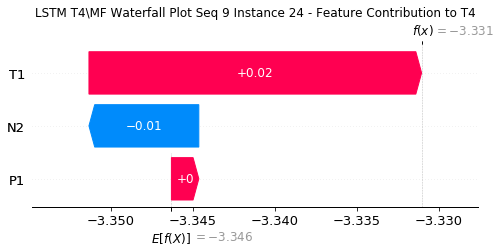

None

Contribution: [ 0.0070506   0.05132542 -0.00524462]


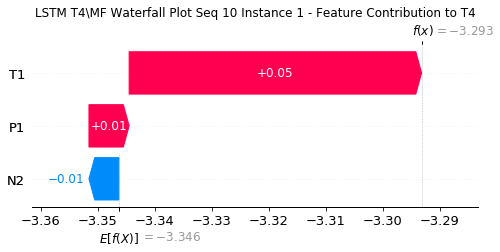

None

Contribution: [-0.00064511 -0.00371307  0.00097062]


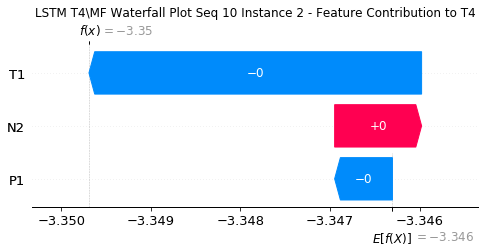

None

Contribution: [1.62806935e-04 1.50767472e-03 4.84684394e-05]


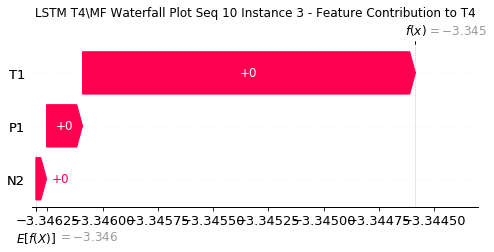

None

Contribution: [ 1.53554526e-05  3.32447854e-04 -8.49713053e-06]


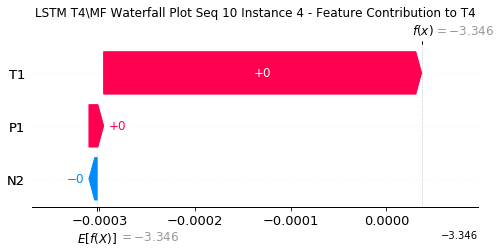

None

Contribution: [-1.78968906e-05  1.86274412e-04 -3.10582110e-06]


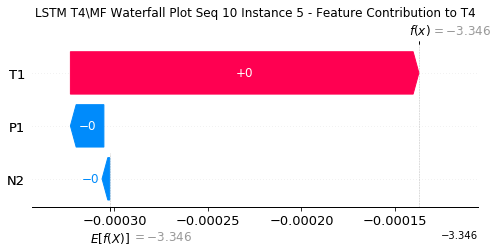

None

Contribution: [-3.38685063e-06  1.85934622e-04  7.25010013e-05]


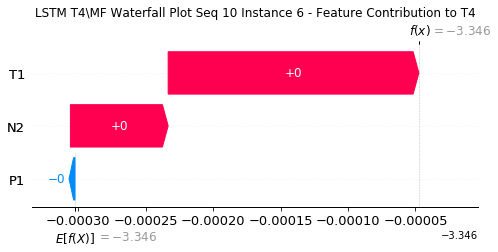

None

Contribution: [4.59266265e-05 1.90821491e-04 1.21366933e-04]


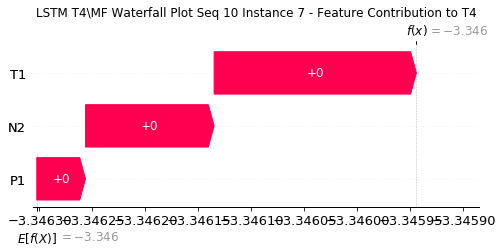

None

Contribution: [3.79536946e-05 6.66419785e-05 3.73785001e-05]


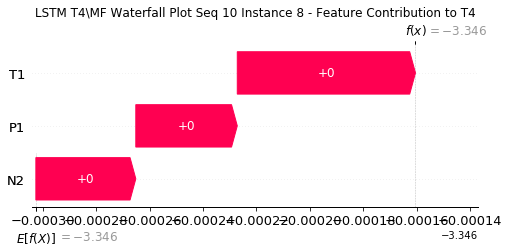

None

Contribution: [ 2.62634032e-05 -1.90577652e-04 -1.52752577e-04]


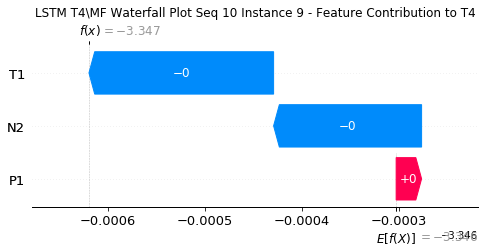

None

Contribution: [-7.05220656e-05 -4.17980544e-04 -3.12365794e-04]


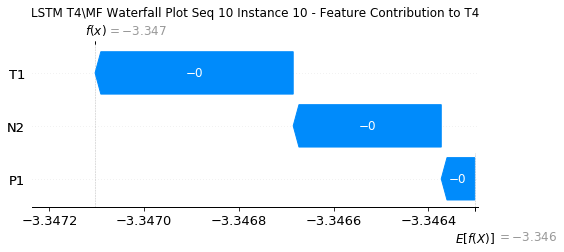

None

Contribution: [-0.00011366 -0.00035084 -0.00025119]


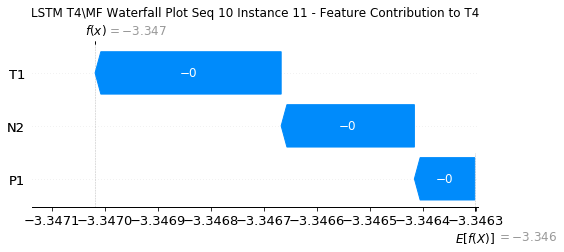

None

Contribution: [-6.17745234e-05  1.40681167e-04  1.03745659e-04]


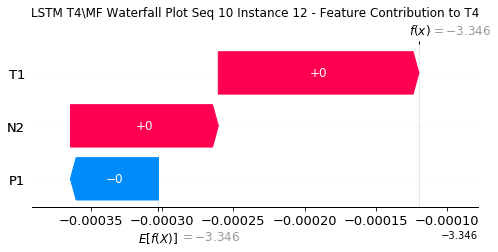

None

Contribution: [0.00011856 0.00125512 0.00055205]


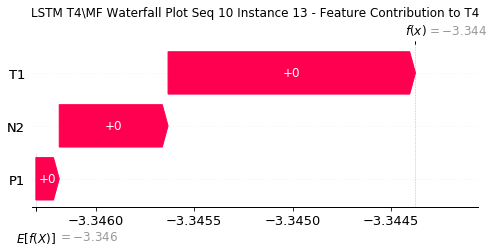

None

Contribution: [0.00034098 0.00203527 0.00053441]


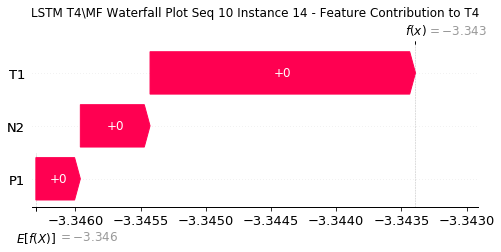

None

Contribution: [ 0.0001512   0.00195086 -0.00019462]


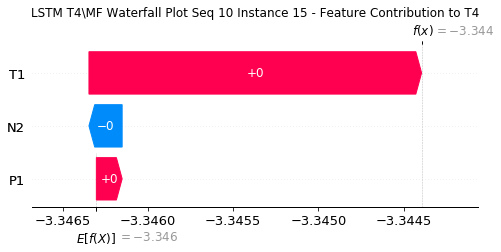

None

Contribution: [-0.00021001 -0.000205   -0.00135319]


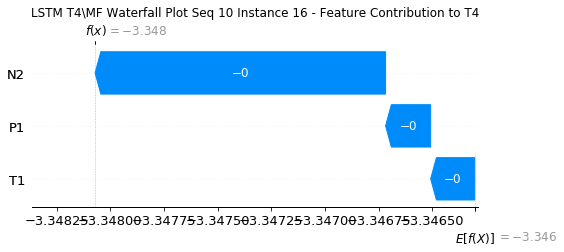

None

Contribution: [-0.00069923 -0.00417622 -0.00174514]


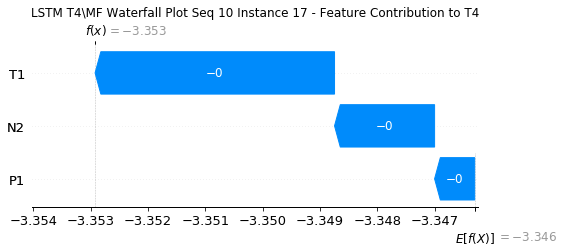

None

Contribution: [-0.00065969 -0.00835297 -0.00034232]


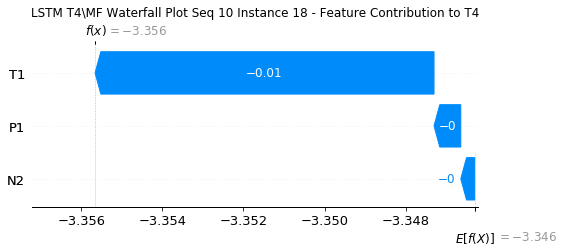

None

Contribution: [-7.62072827e-05 -9.27310617e-03  2.57646886e-03]


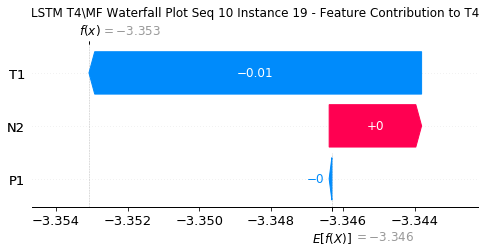

None

Contribution: [ 0.00080919 -0.0021467   0.00420926]


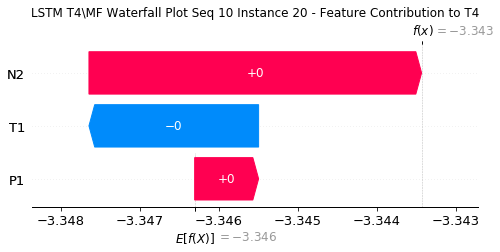

None

Contribution: [0.00154547 0.01595353 0.00098261]


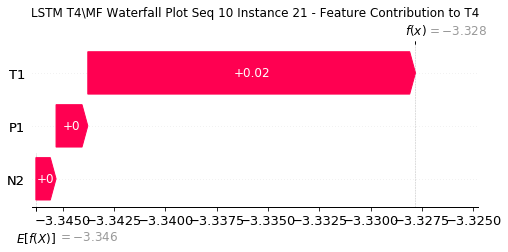

None

Contribution: [ 0.00029247  0.04011217 -0.00652577]


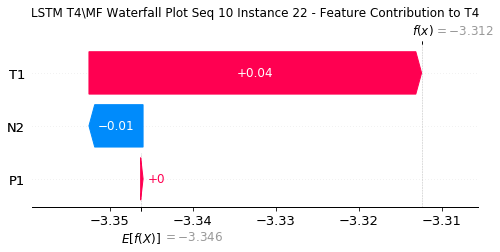

None

Contribution: [ 0.00022102  0.04464406 -0.01319762]


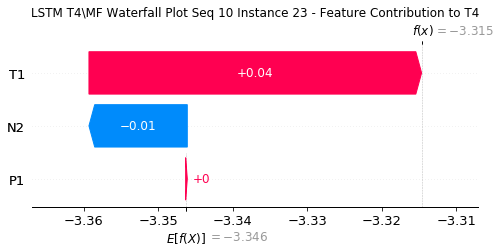

None

Contribution: [-0.00038141  0.02454615 -0.00719306]


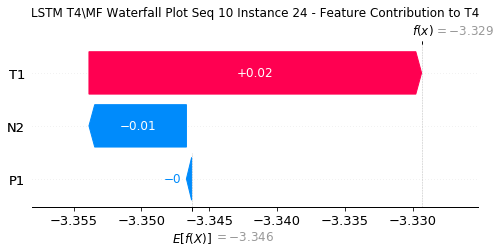

None

Contribution: [ 8.80219056e-05  5.56422635e-02 -7.22114214e-03]


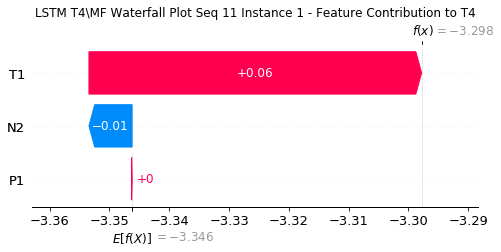

None

Contribution: [ 0.00023098 -0.00332249  0.00110536]


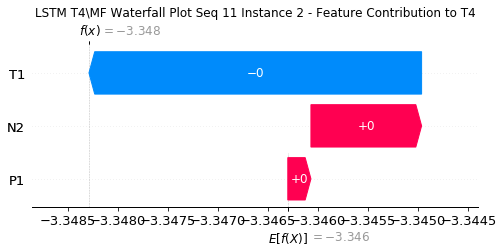

None

Contribution: [-6.55228678e-05  1.66959789e-03  1.83332942e-05]


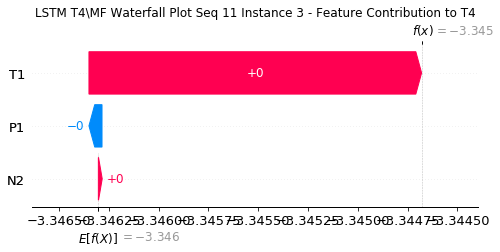

None

Contribution: [-7.40112306e-06  3.64605039e-04 -1.16283951e-05]


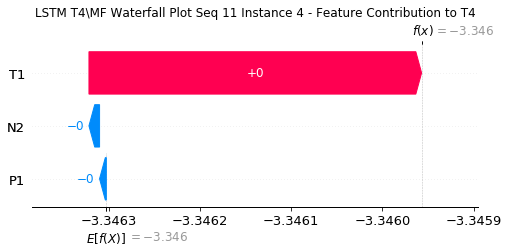

None

Contribution: [ 6.02518642e-06  2.08699216e-04 -9.36171958e-07]


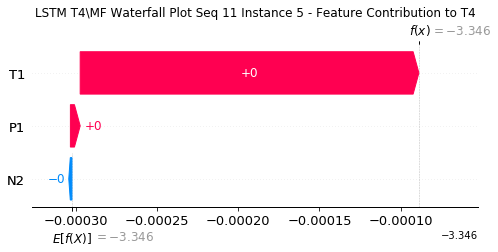

None

Contribution: [2.12262911e-05 2.02488469e-04 7.71742487e-05]


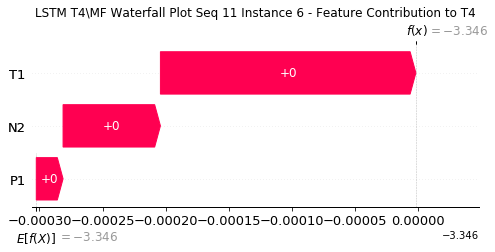

None

Contribution: [3.25307578e-05 2.56816565e-04 1.19073701e-04]


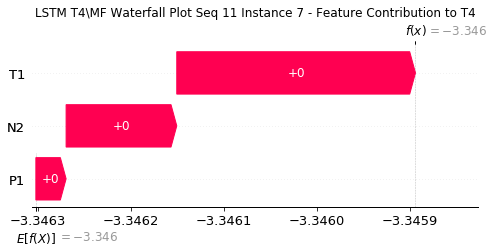

None

Contribution: [2.57571350e-06 1.12157665e-04 2.86019873e-05]


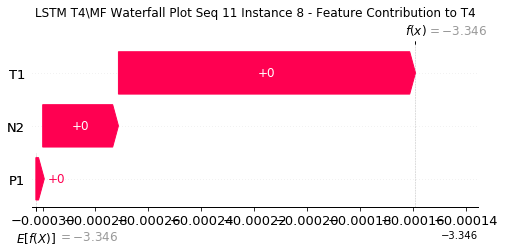

None

Contribution: [-3.65806300e-05 -2.44985828e-04 -1.68279585e-04]


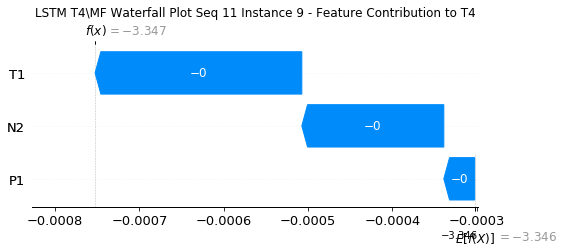

None

Contribution: [-6.74370645e-05 -5.62236345e-04 -3.17303954e-04]


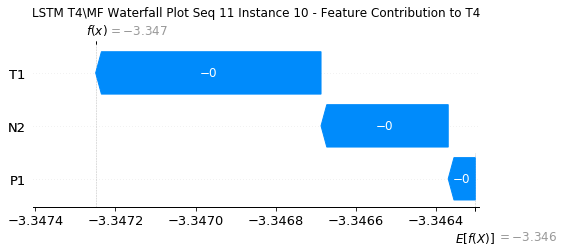

None

Contribution: [-4.87739499e-05 -9.85300254e-04 -2.54304705e-04]


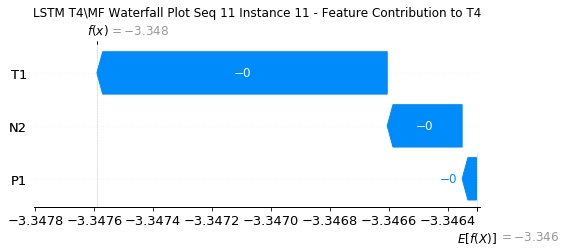

None

Contribution: [-2.13576715e-05 -1.06481910e-03  1.19952638e-04]


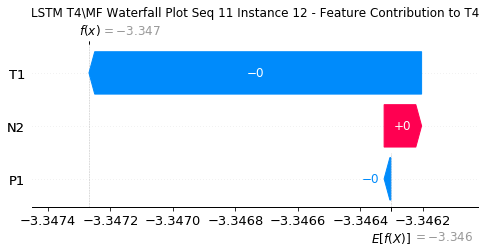

None

Contribution: [0.00013513 0.00095161 0.00055424]


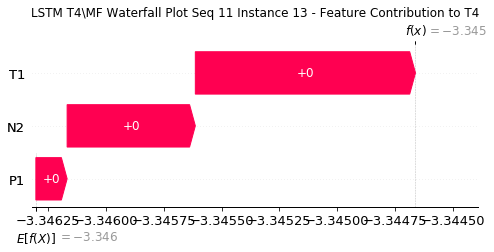

None

Contribution: [0.00023373 0.00351023 0.00048922]


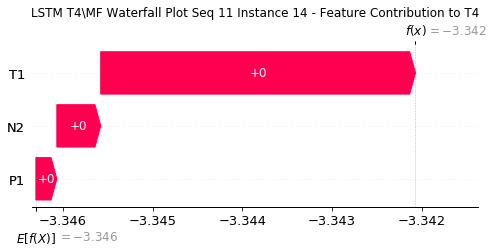

None

Contribution: [-5.60436643e-05  3.80594917e-03 -2.06342953e-04]


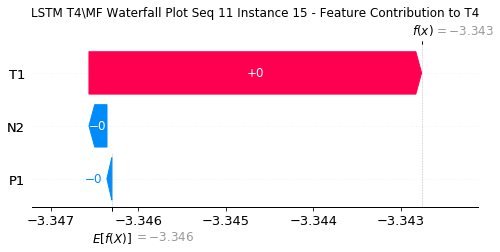

None

Contribution: [-0.00039741  0.0011063  -0.00136198]


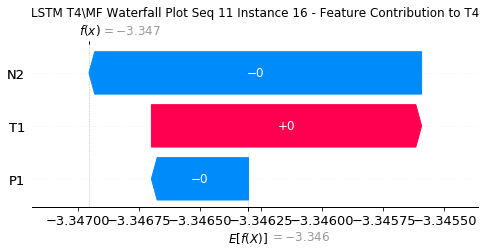

None

Contribution: [-0.00054927 -0.00436055 -0.00173167]


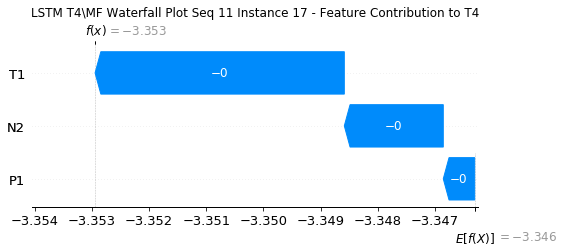

None

Contribution: [ 2.96714436e-05 -9.27807610e-03 -3.47919999e-04]


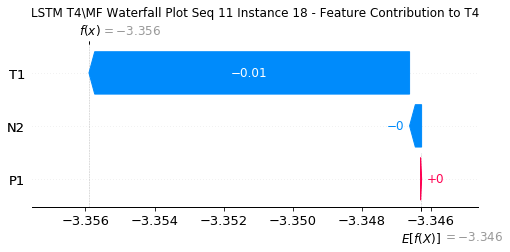

None

Contribution: [ 0.00100336 -0.01043348  0.00253193]


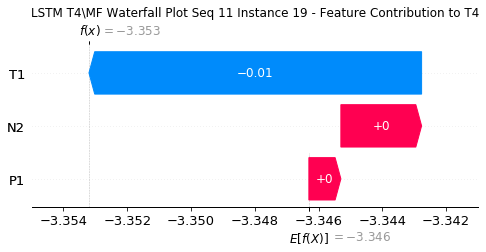

None

Contribution: [ 0.00145117 -0.00271519  0.00416993]


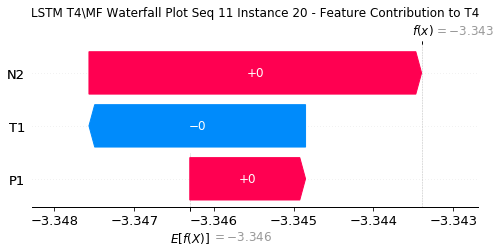

None

Contribution: [0.00100857 0.0171506  0.00117239]


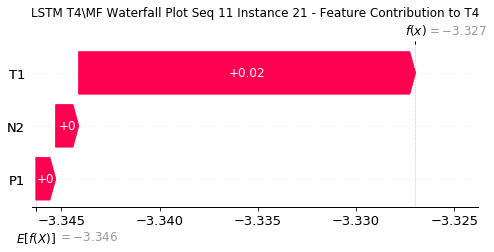

None

Contribution: [-0.00174806  0.04114425 -0.00588562]


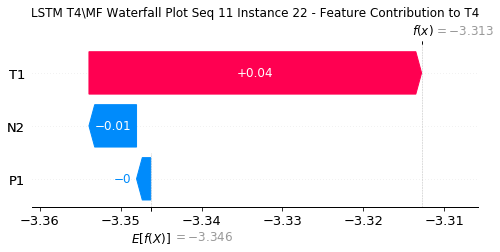

None

Contribution: [-0.00696107  0.03047443 -0.01458165]


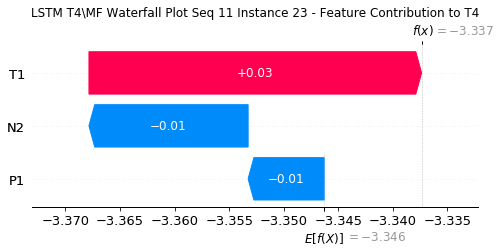

None

Contribution: [-0.00394878  0.01664532 -0.00781034]


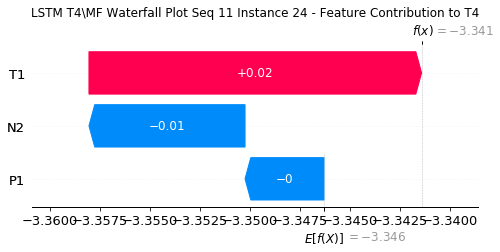

None

Contribution: [-0.00411821  0.05088279 -0.00854691]


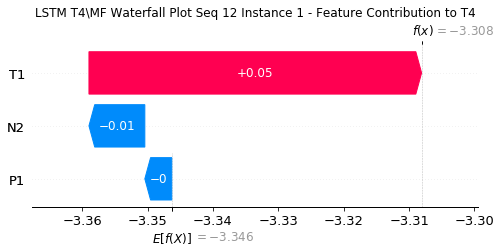

None

Contribution: [ 0.00029229 -0.00259106  0.00115444]


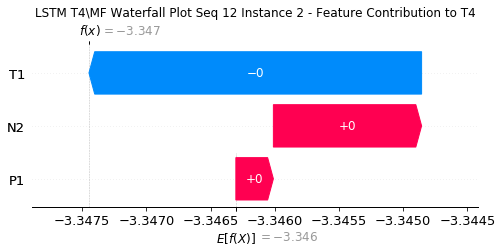

None

Contribution: [-1.24886956e-04  1.37706116e-03 -8.98056238e-06]


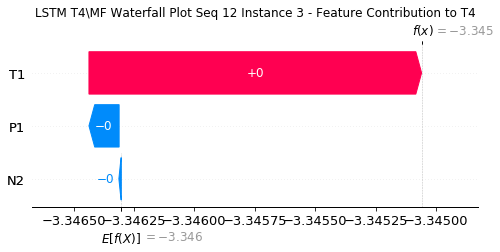

None

Contribution: [-2.11482979e-05  3.76198587e-04 -2.55786507e-06]


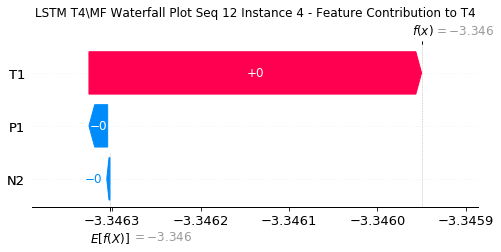

None

Contribution: [-1.53142533e-06  2.36488672e-04  6.23284568e-06]


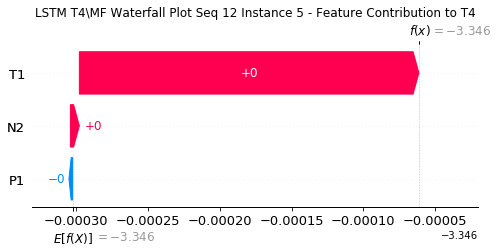

None

Contribution: [1.86715327e-05 1.92930155e-04 6.74263186e-05]


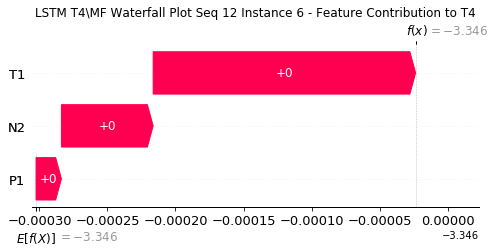

None

Contribution: [2.47434250e-05 9.37998733e-05 8.94910720e-05]


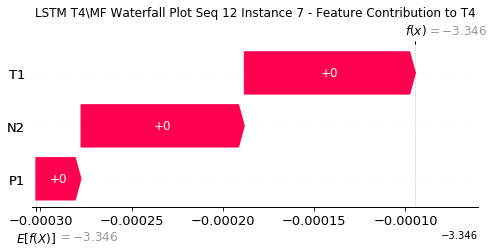

None

Contribution: [ 1.06541949e-06 -5.53614684e-05  8.06730674e-06]


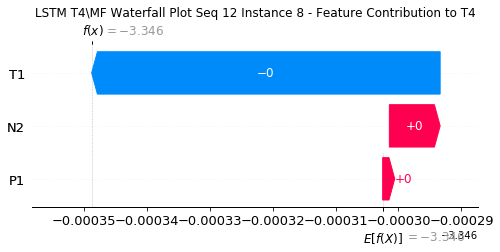

None

Contribution: [-3.52184536e-05 -2.01163144e-04 -1.65312657e-04]


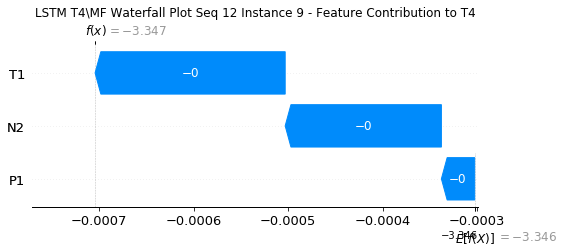

None

Contribution: [-5.60888480e-05 -1.41350485e-04 -2.84127829e-04]


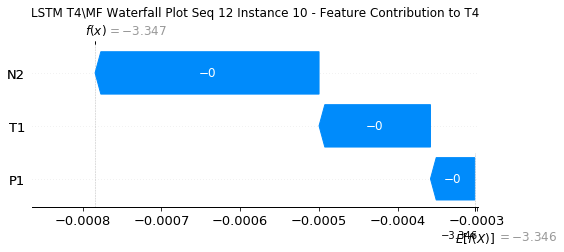

None

Contribution: [-1.21641288e-05  2.08894050e-04 -1.91466406e-04]


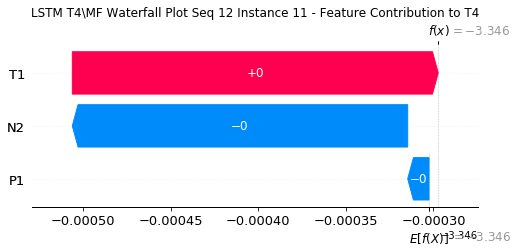

None

Contribution: [4.01647297e-05 7.53338139e-04 1.36945461e-04]


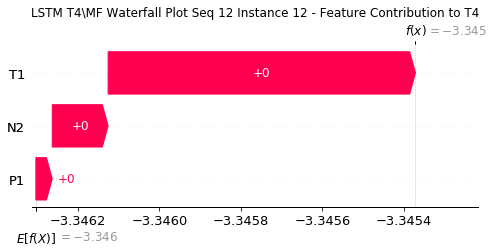

None

Contribution: [0.00010452 0.00117839 0.00052465]


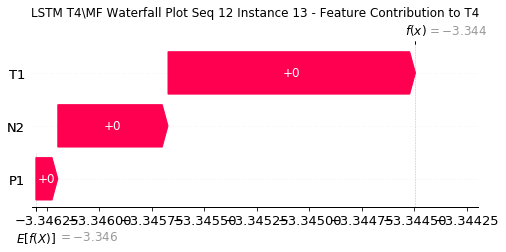

None

Contribution: [-3.06708121e-05  9.30336787e-04  4.30056924e-04]


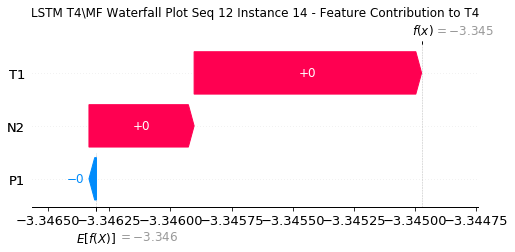

None

Contribution: [-3.31111048e-04 -2.88020683e-05 -2.86308917e-04]


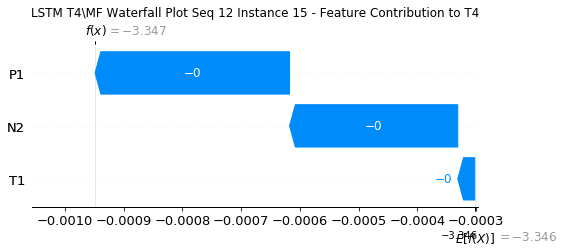

None

Contribution: [-0.00053261 -0.00169416 -0.00135325]


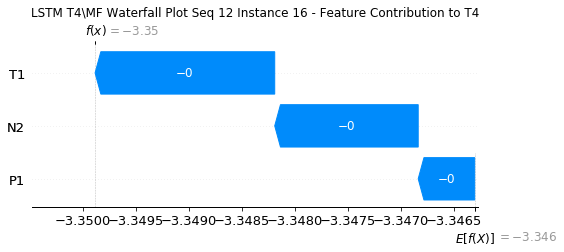

None

Contribution: [-0.00046781 -0.00329043 -0.00168068]


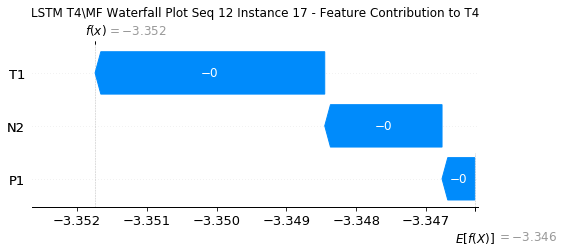

None

Contribution: [ 0.00065566 -0.00327483 -0.0001729 ]


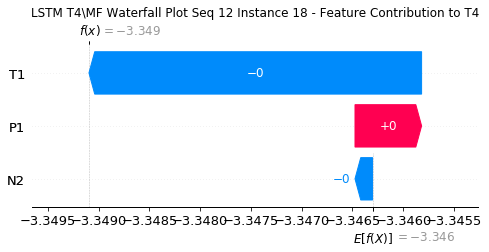

None

Contribution: [ 0.00171918 -0.0011267   0.00259906]


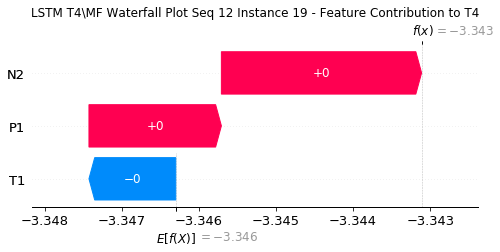

None

Contribution: [0.0017139  0.0039821  0.00404438]


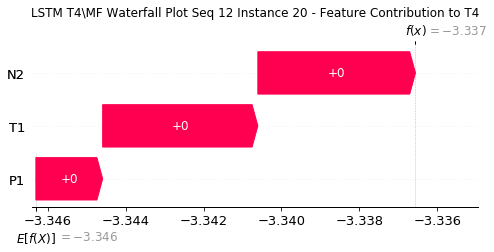

None

Contribution: [0.00023968 0.01198721 0.00110069]


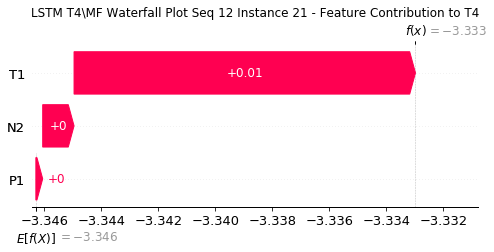

None

Contribution: [-0.00359628  0.02208704 -0.00535819]


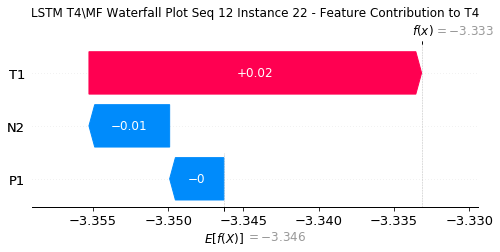

None

Contribution: [-0.00591355  0.02101719 -0.01255685]


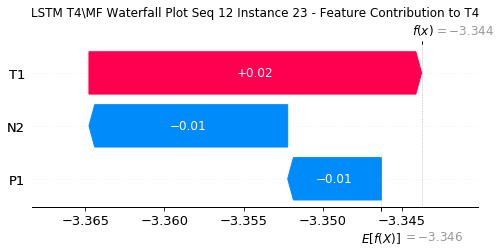

None

Contribution: [-0.00349882  0.01049052 -0.00729726]


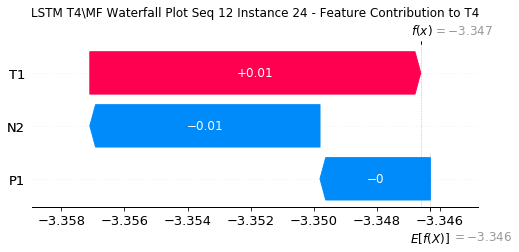

None

Contribution: [-0.00472613  0.03312824 -0.00742627]


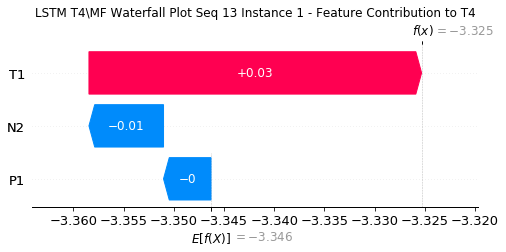

None

Contribution: [ 0.00047566 -0.00203923  0.001102  ]


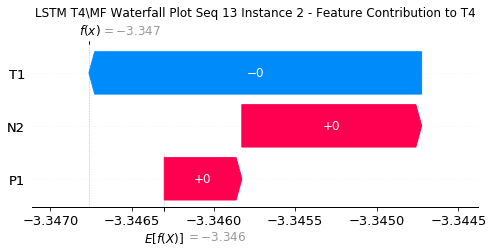

None

Contribution: [-8.45015976e-05  1.37633011e-03  6.70059589e-06]


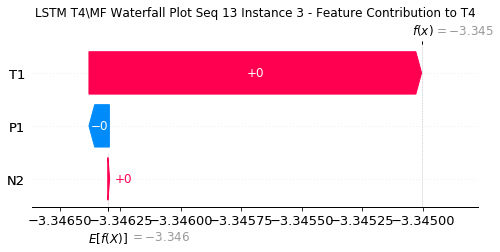

None

Contribution: [-2.00072779e-05  3.98574120e-04 -5.16953198e-06]


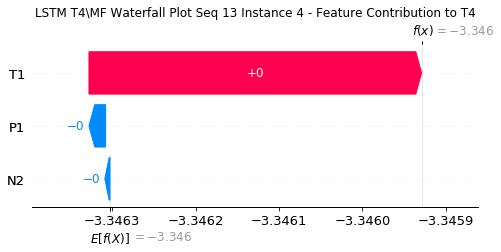

None

Contribution: [-8.74375189e-06  2.48556110e-04 -7.83771655e-07]


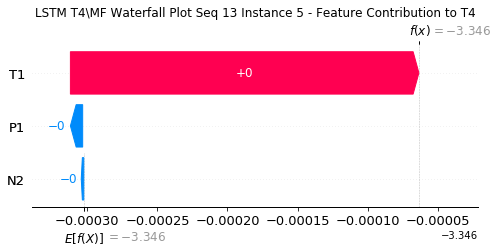

None

Contribution: [1.51023666e-05 1.89329367e-04 6.09507383e-05]


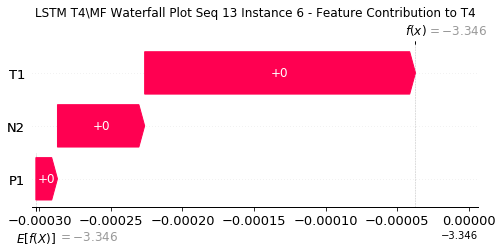

None

Contribution: [3.97015461e-05 8.69764224e-05 9.23993924e-05]


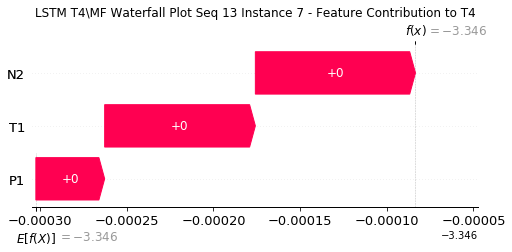

None

Contribution: [ 2.52049621e-05 -4.26143702e-05  1.73819804e-05]


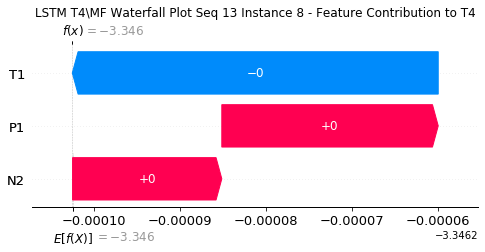

None

Contribution: [-2.01147780e-05 -1.83397352e-04 -1.57269531e-04]


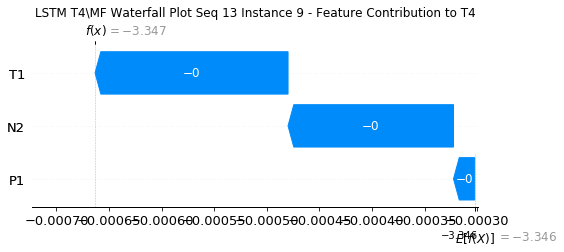

None

Contribution: [-5.72152854e-05 -1.39251619e-04 -2.85482060e-04]


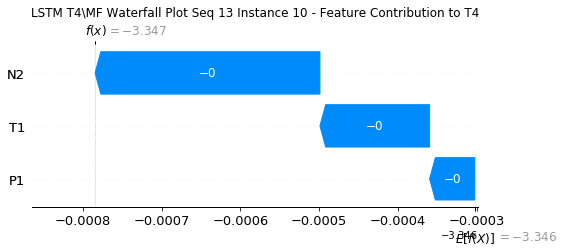

None

Contribution: [-2.45483000e-05  1.71228560e-04 -1.92435125e-04]


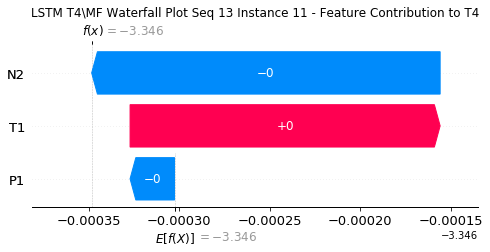

None

Contribution: [6.64410772e-05 7.25622888e-04 1.54500829e-04]


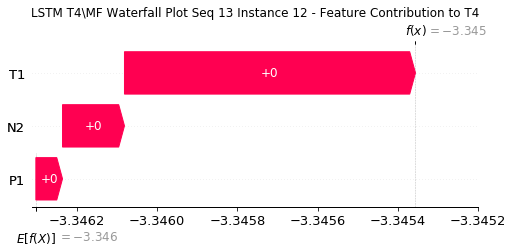

None

Contribution: [0.00010089 0.0012339  0.000516  ]


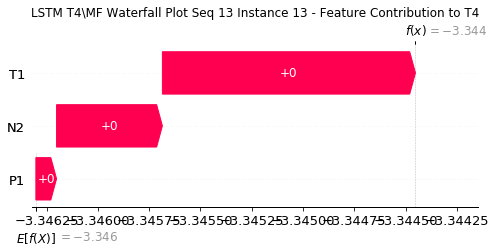

None

Contribution: [0.00013663 0.00135526 0.00044165]


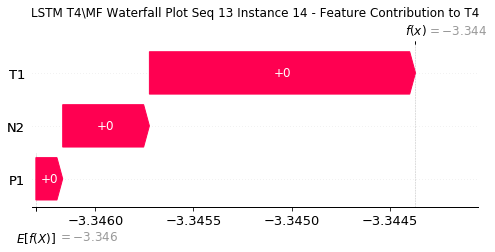

None

Contribution: [-0.00025953  0.00049317 -0.00031762]


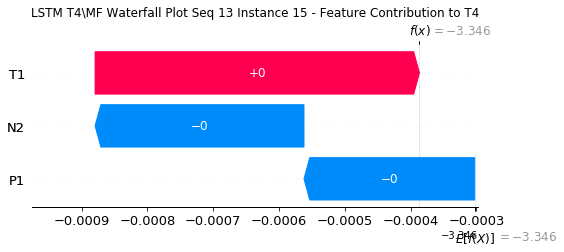

None

Contribution: [-0.00048473 -0.00136311 -0.00138127]


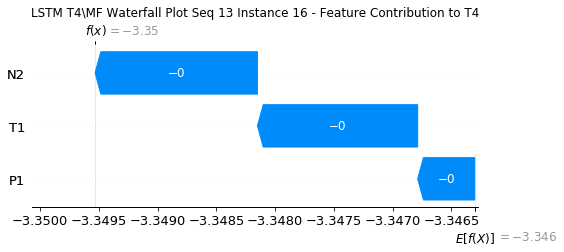

None

Contribution: [-0.00045979 -0.00322453 -0.00159272]


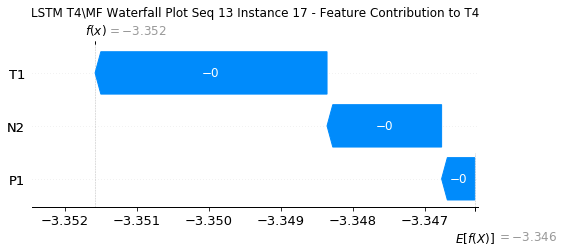

None

Contribution: [ 1.62762841e-04 -4.27277613e-03 -7.15720071e-05]


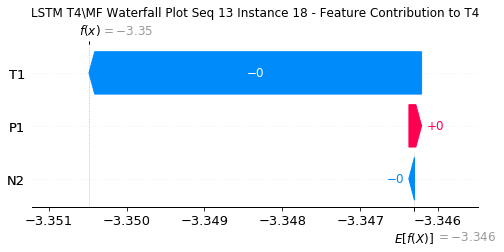

None

Contribution: [ 0.00111007 -0.00258386  0.00277132]


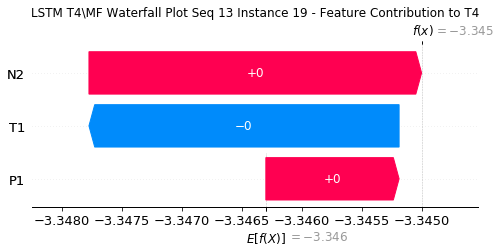

None

Contribution: [0.00146715 0.00340689 0.00414451]


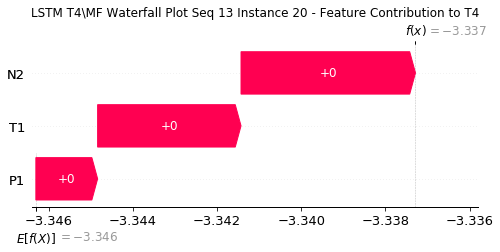

None

Contribution: [0.00048475 0.01405938 0.00071274]


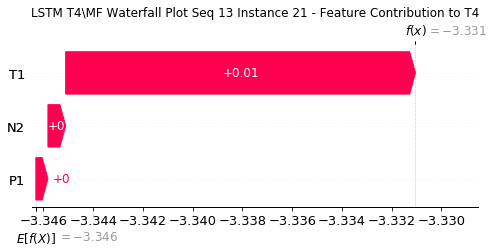

None

Contribution: [-0.00268866  0.02530103 -0.0066654 ]


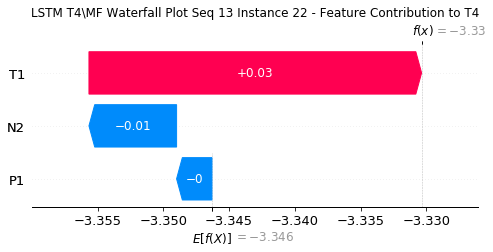

None

Contribution: [-0.00170646  0.02020031 -0.01320982]


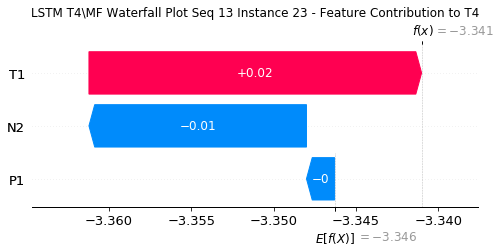

None

Contribution: [-0.00148725  0.01441867 -0.0073522 ]


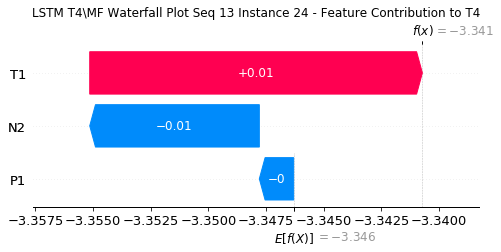

None

Contribution: [-0.0009623   0.03915554 -0.00762691]


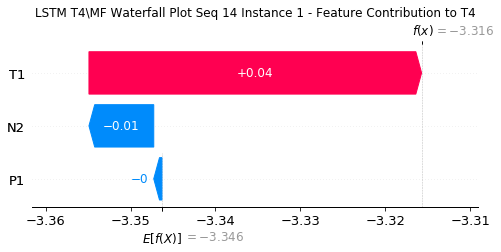

None

Contribution: [ 4.51946035e-05 -2.35701017e-03  1.08558961e-03]


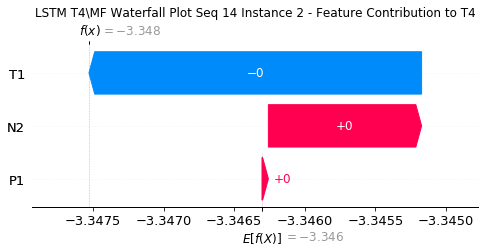

None

Contribution: [-4.72167782e-05  1.44498090e-03 -1.65759223e-05]


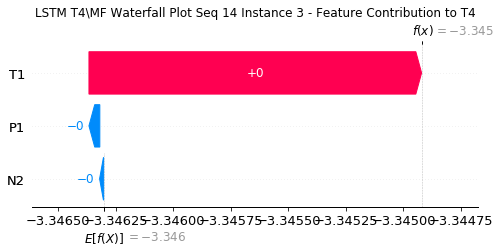

None

Contribution: [-7.17747137e-06  3.84220661e-04 -4.53231095e-06]


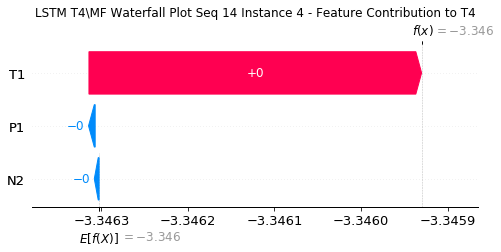

None

Contribution: [-1.04882627e-06  2.32625700e-04  6.65109547e-06]


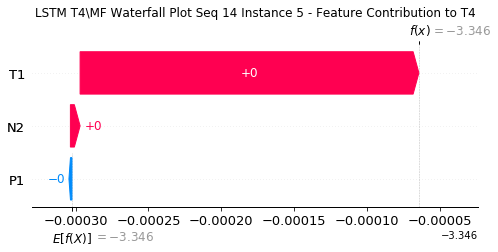

None

Contribution: [1.66621867e-05 1.85013634e-04 6.79915802e-05]


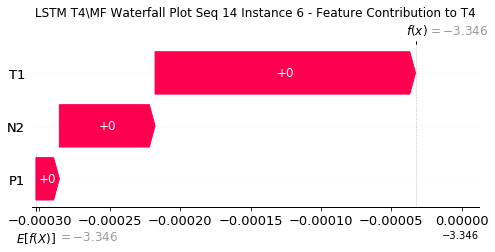

None

Contribution: [4.00531520e-05 8.80844935e-05 8.94158785e-05]


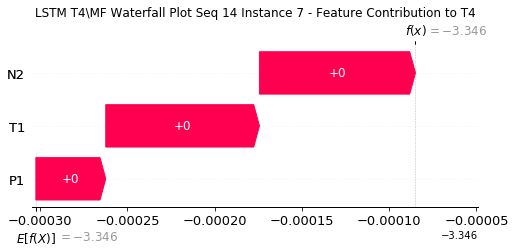

None

Contribution: [ 3.02149348e-05 -8.69916267e-05  3.28674538e-06]


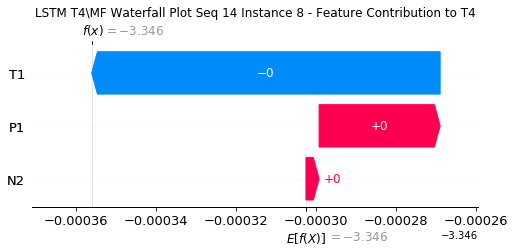

None

Contribution: [-1.62804185e-05 -2.04363556e-04 -1.68353681e-04]


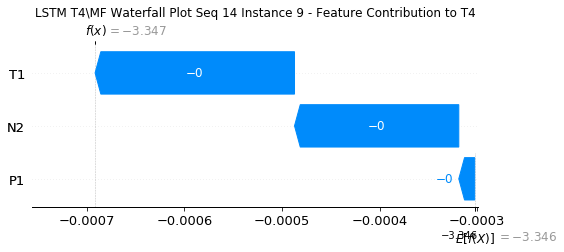

None

Contribution: [-6.07911713e-05 -1.04746977e-04 -2.83156607e-04]


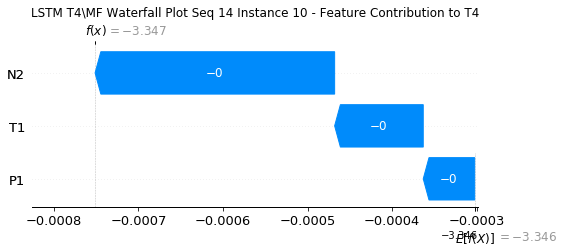

None

Contribution: [-5.12604457e-05  2.42352259e-04 -1.86668032e-04]


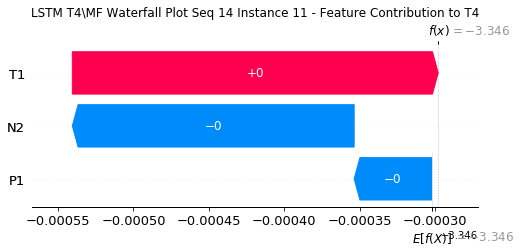

None

Contribution: [2.80605471e-05 7.98315929e-04 1.65524802e-04]


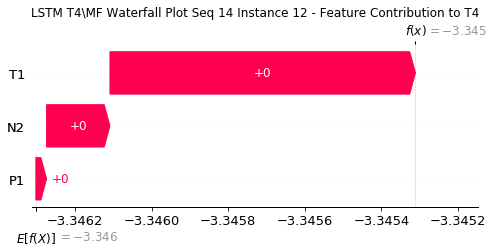

None

Contribution: [0.00012834 0.00115682 0.0005176 ]


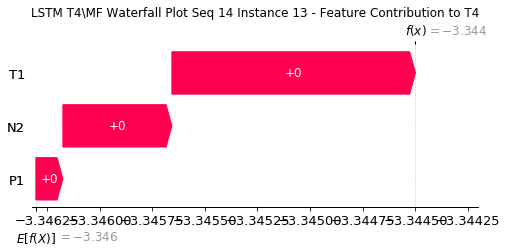

None

Contribution: [0.0002569  0.00102215 0.00041731]


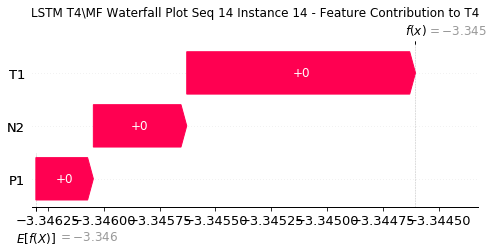

None

Contribution: [-5.92061404e-05 -1.33055605e-04 -3.21706250e-04]


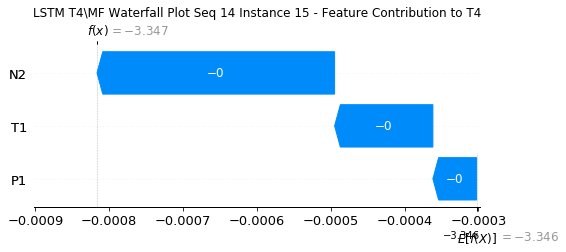

None

Contribution: [-0.00036844 -0.00178343 -0.00138261]


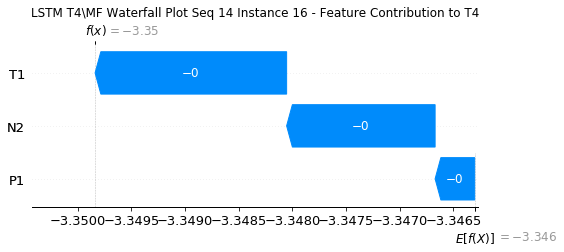

None

Contribution: [-0.00060362 -0.00327926 -0.00157869]


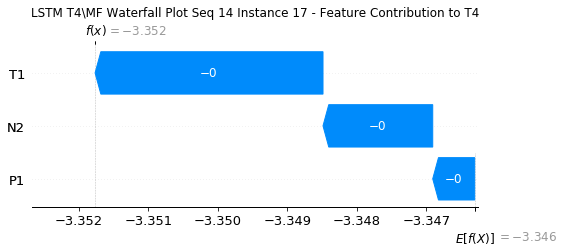

None

Contribution: [-1.07424802e-04 -2.53041539e-03  1.55791288e-05]


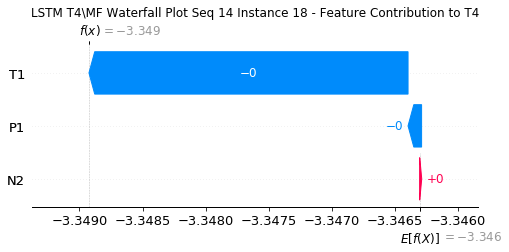

None

Contribution: [0.00071687 0.00021536 0.00287165]


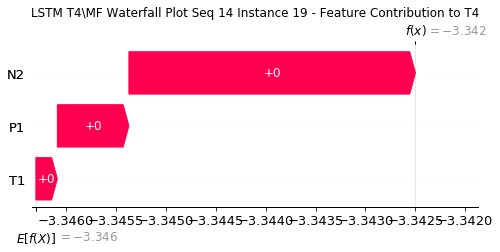

None

Contribution: [0.00128102 0.00497466 0.00416385]


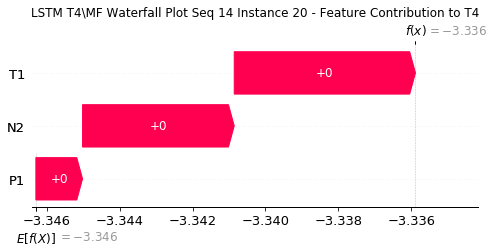

None

Contribution: [0.001243   0.01015283 0.00057835]


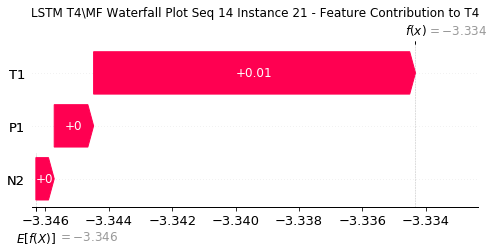

None

Contribution: [-0.00123835  0.01445489 -0.00734399]


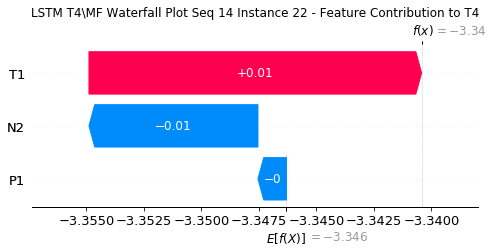

None

Contribution: [-0.00445268  0.00689569 -0.01458603]


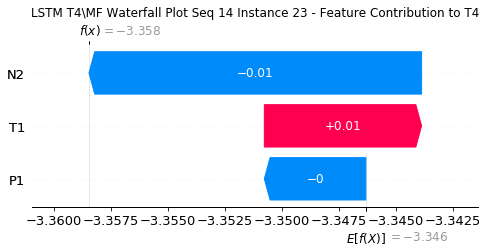

None

Contribution: [-0.00209931  0.00454196 -0.00733667]


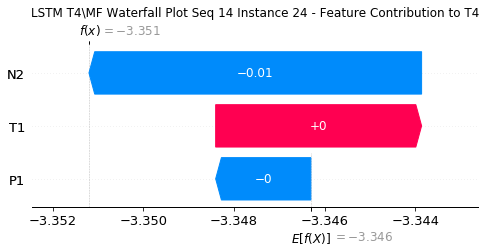

None

Contribution: [-0.00215886  0.02041635 -0.00777605]


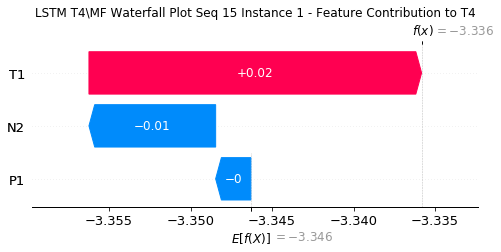

None

Contribution: [ 0.00025162 -0.00116297  0.0010981 ]


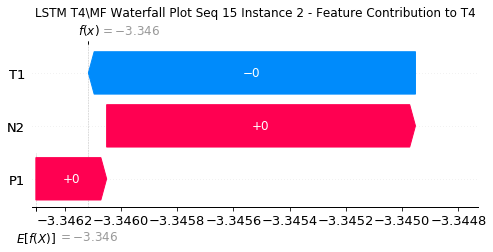

None

Contribution: [2.27295199e-05 9.17361033e-04 1.83068061e-05]


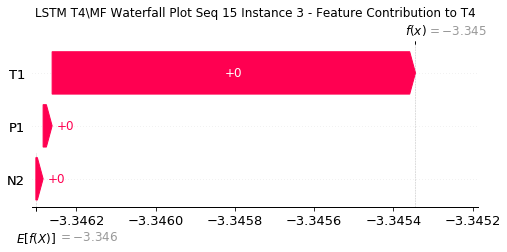

None

Contribution: [1.98652267e-06 3.24212605e-04 4.97767538e-07]


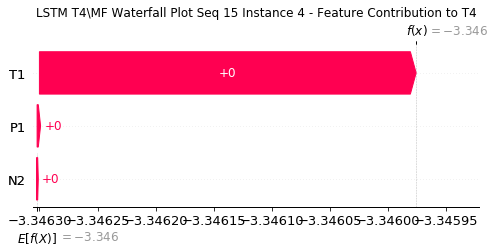

None

Contribution: [-4.14000824e-06  2.32564463e-04  1.08823958e-06]


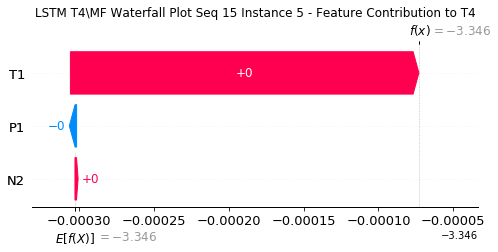

None

Contribution: [1.42693683e-05 1.84679978e-04 5.59894397e-05]


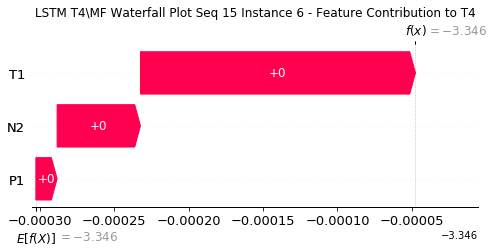

None

Contribution: [4.44396881e-05 6.39404437e-05 7.94073360e-05]


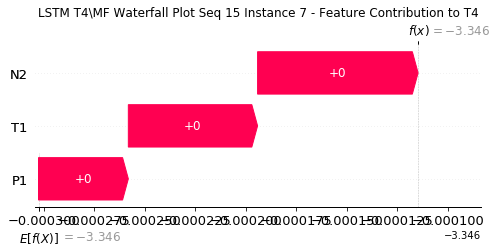

None

Contribution: [ 2.06071462e-05 -9.84382694e-05 -4.50441288e-07]


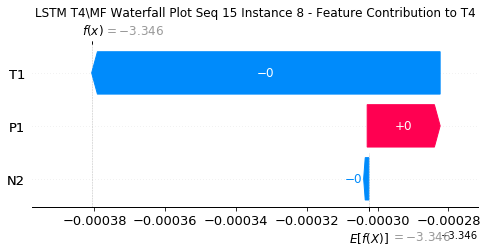

None

Contribution: [-1.22046520e-05 -1.93283147e-04 -1.61923273e-04]


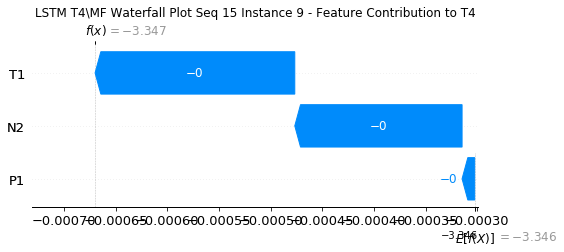

None

Contribution: [-5.94830370e-05 -5.61006200e-05 -2.74642408e-04]


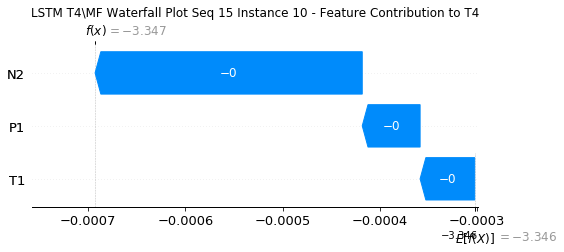

None

Contribution: [-5.07021182e-05  3.11155351e-04 -1.76389663e-04]


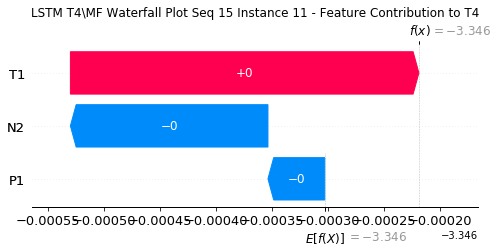

None

Contribution: [3.66264363e-05 8.19873936e-04 1.65124708e-04]


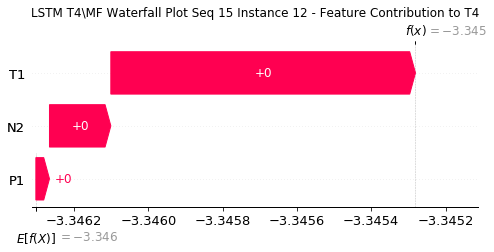

None

Contribution: [0.00012296 0.00109705 0.00050309]


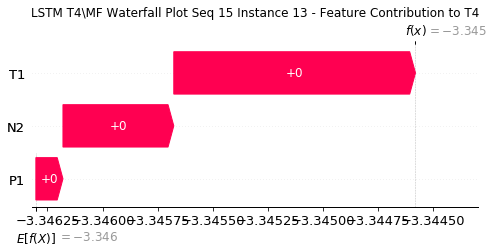

None

Contribution: [0.00015745 0.00095115 0.00037228]


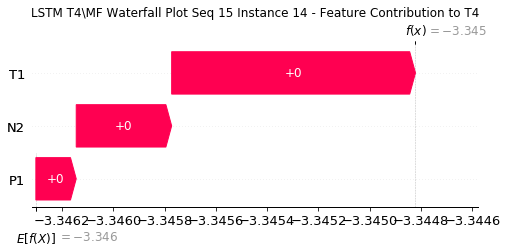

None

Contribution: [-9.34162678e-05 -1.41368162e-04 -3.42472540e-04]


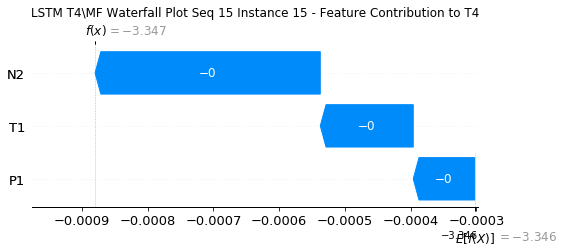

None

Contribution: [-0.00038364 -0.00173058 -0.00137422]


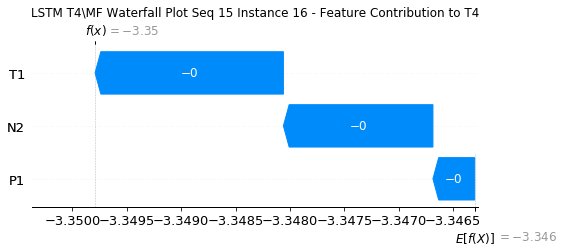

None

Contribution: [-0.00055369 -0.0030517  -0.00156604]


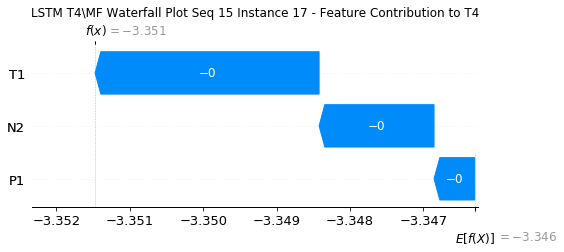

None

Contribution: [-1.01568964e-04 -2.81370790e-03 -3.13257298e-05]


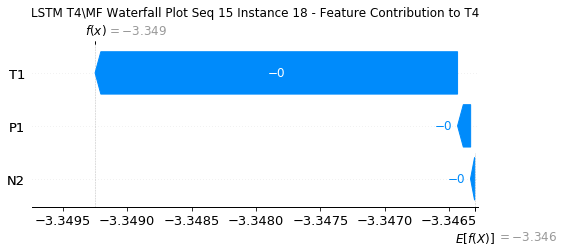

None

Contribution: [ 0.00072108 -0.0004515   0.00276115]


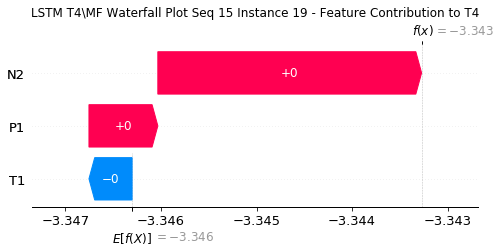

None

Contribution: [0.00127512 0.00454584 0.00407724]


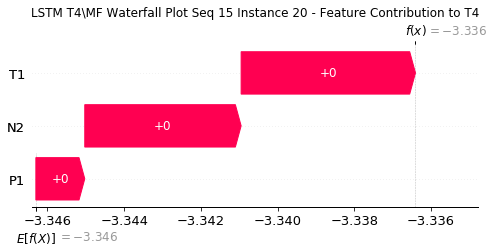

None

Contribution: [0.00107044 0.01243838 0.00067317]


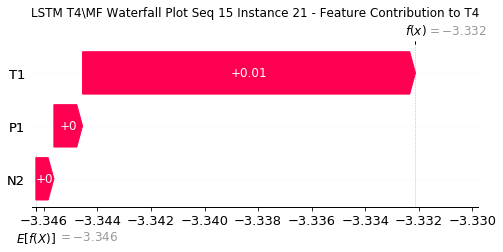

None

Contribution: [-0.0011543   0.02192594 -0.00654565]


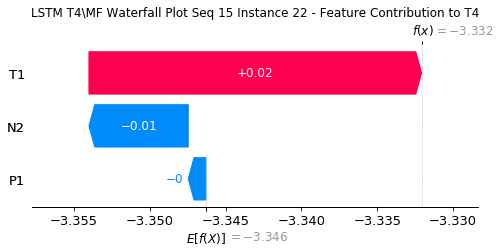

None

Contribution: [-0.0013619   0.02179177 -0.01365005]


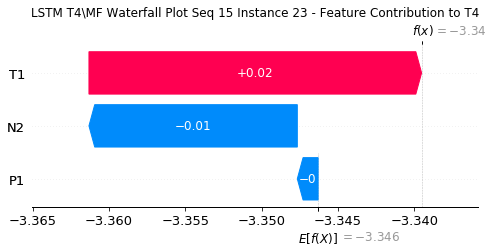

None

Contribution: [-0.00195026  0.00975877 -0.00771325]


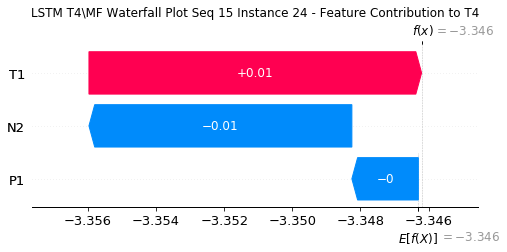

None

Contribution: [-0.00209598  0.03496305 -0.00852971]


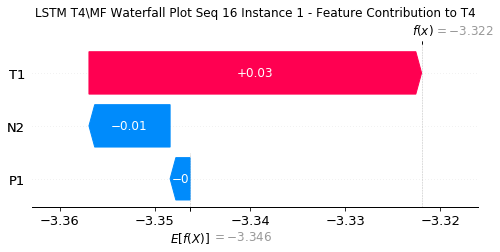

None

Contribution: [ 0.00038701 -0.0019085   0.00119628]


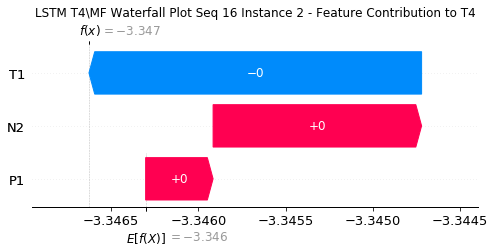

None

Contribution: [6.30055297e-05 1.22383096e-03 3.02614314e-06]


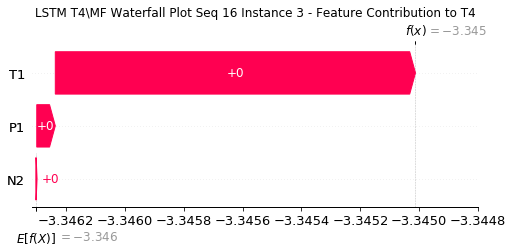

None

Contribution: [ 7.44854149e-06  3.60638417e-04 -2.35807837e-06]


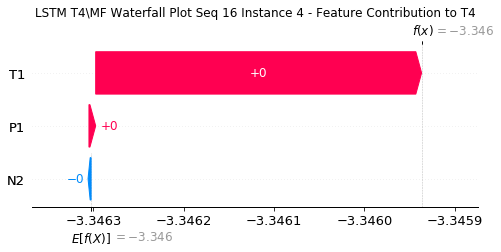

None

Contribution: [-2.87515679e-06  2.40096948e-04  3.49011980e-06]


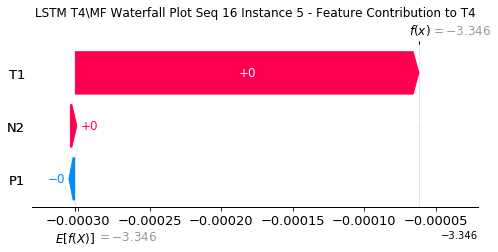

None

Contribution: [1.45321843e-05 1.88149534e-04 6.24406963e-05]


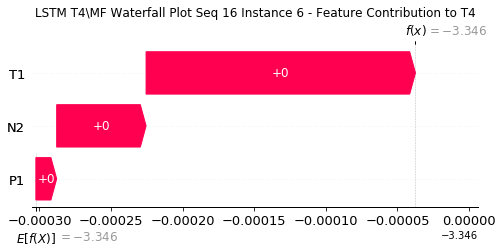

None

Contribution: [4.08441555e-05 7.53517112e-05 8.54447006e-05]


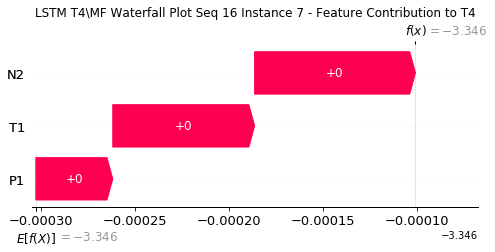

None

Contribution: [ 3.33425010e-05 -1.02299263e-04  5.32765745e-06]


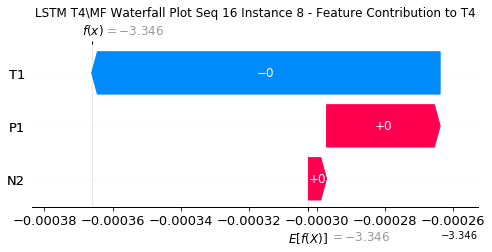

None

Contribution: [-1.70994852e-05 -1.95170505e-04 -1.65412960e-04]


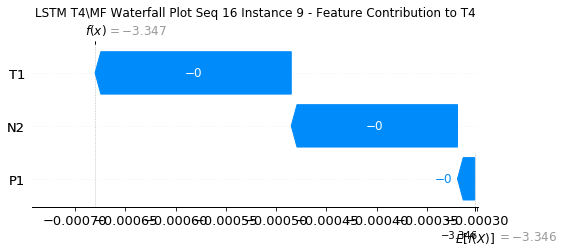

None

Contribution: [-5.98721438e-05 -8.76929973e-05 -2.78235786e-04]


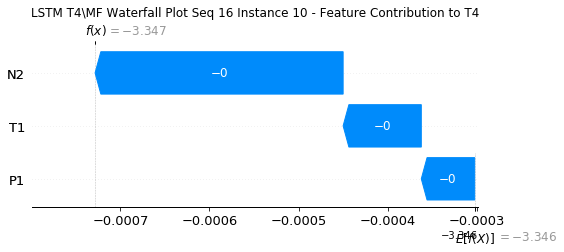

None

Contribution: [-5.07764984e-05  2.83931140e-04 -1.79814588e-04]


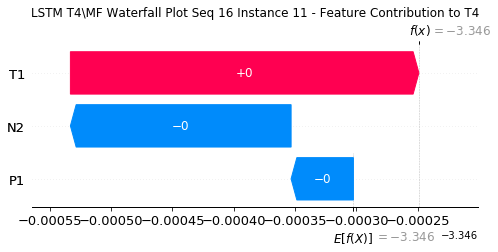

None

Contribution: [3.54427552e-05 8.42943697e-04 1.60995901e-04]


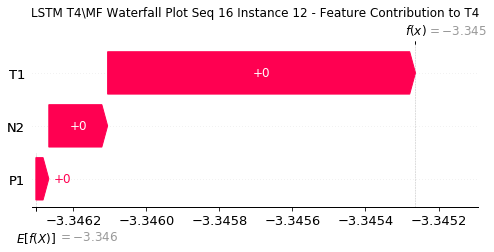

None

Contribution: [0.00012353 0.00112458 0.00050978]


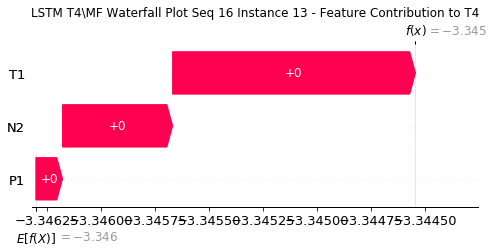

None

Contribution: [0.00015621 0.00081866 0.00040651]


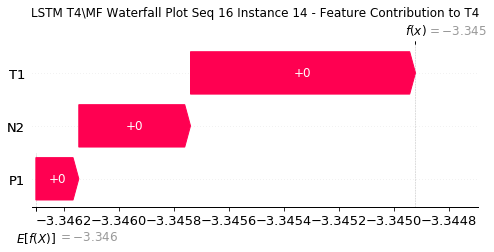

None

Contribution: [-9.89347852e-05 -2.04222605e-04 -3.49124162e-04]


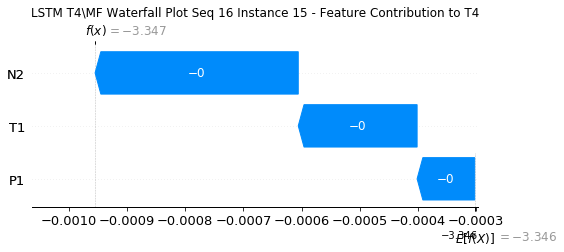

None

Contribution: [-0.00038118 -0.00178131 -0.00138791]


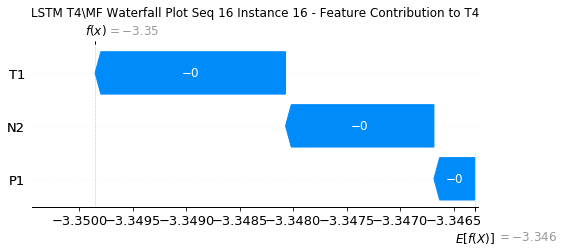

None

Contribution: [-0.00055367 -0.00313684 -0.00157987]


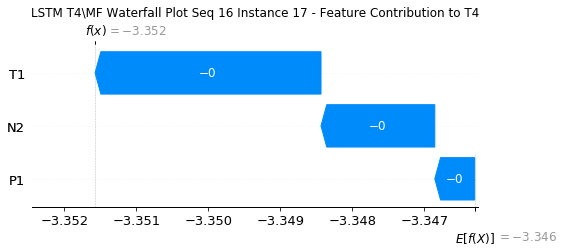

None

Contribution: [-2.10926497e-04 -2.79753326e-03 -8.87040696e-06]


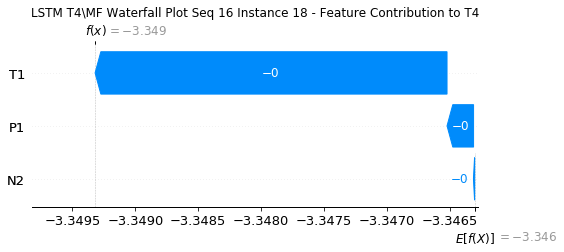

None

Contribution: [ 0.00056342 -0.00040263  0.00281504]


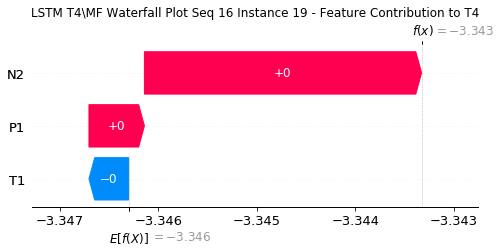

None

Contribution: [0.00120506 0.00451549 0.0041356 ]


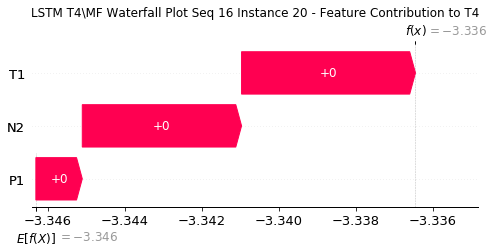

None

Contribution: [0.00122554 0.01139927 0.00065794]


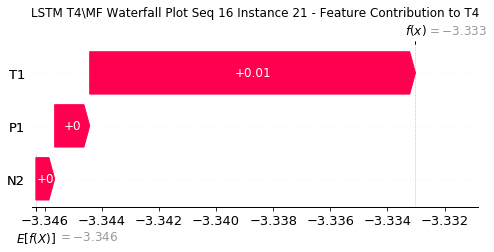

None

Contribution: [-0.00066325  0.01757242 -0.00682303]


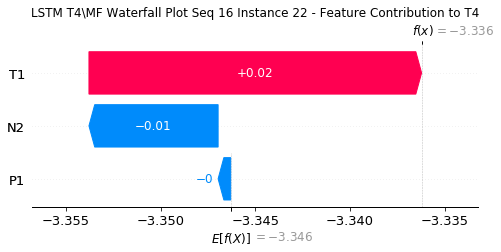

None

Contribution: [-0.00319443  0.01265914 -0.01369366]


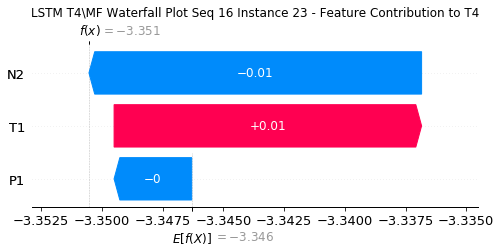

None

Contribution: [-0.00209724  0.01144861 -0.00737349]


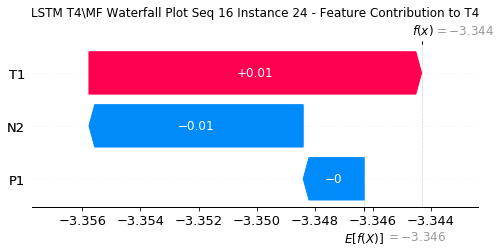

None

Contribution: [-0.00276085  0.03450653 -0.00818819]


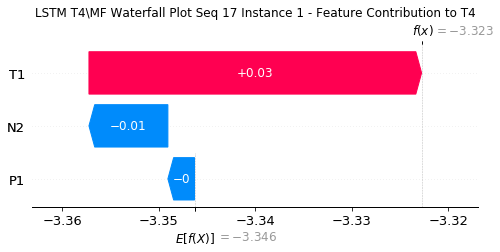

None

Contribution: [ 0.00036749 -0.00224968  0.00123591]


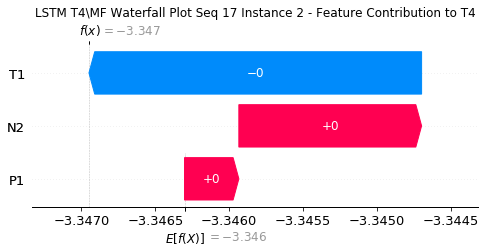

None

Contribution: [1.26849969e-05 1.40760488e-03 2.09012284e-06]


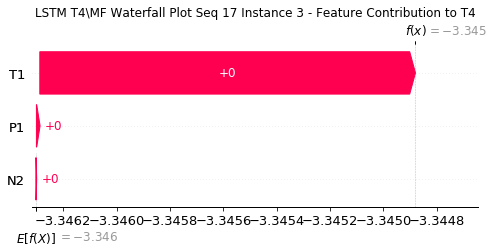

None

Contribution: [ 2.09229408e-06  3.92230602e-04 -3.61173133e-06]


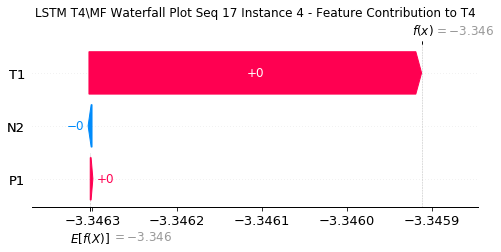

None

Contribution: [-2.60443860e-06  2.44498674e-04  2.96732518e-06]


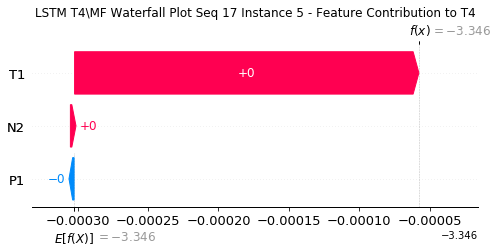

None

Contribution: [1.43350430e-05 1.95371307e-04 6.40727724e-05]


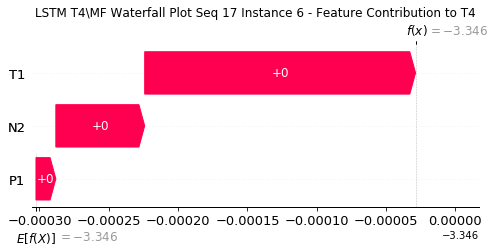

None

Contribution: [4.02741914e-05 9.04435234e-05 8.94187806e-05]


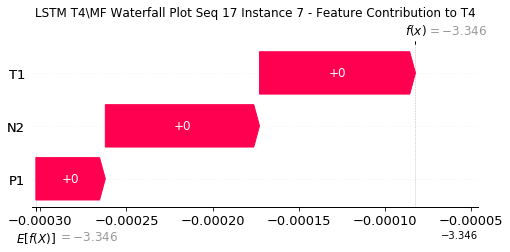

None

Contribution: [ 2.96855423e-05 -7.37737189e-05  4.36412416e-06]


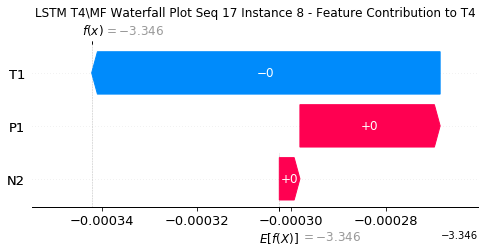

None

Contribution: [-1.01724691e-05 -2.08108491e-04 -1.63887247e-04]


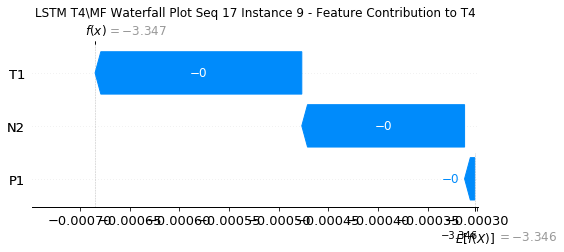

None

Contribution: [-6.25530665e-05 -1.46098303e-04 -2.84994400e-04]


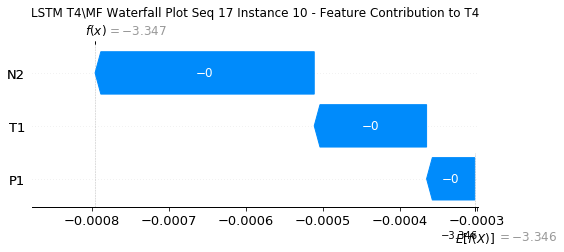

None

Contribution: [-5.85733436e-05  1.83652434e-04 -1.94135934e-04]


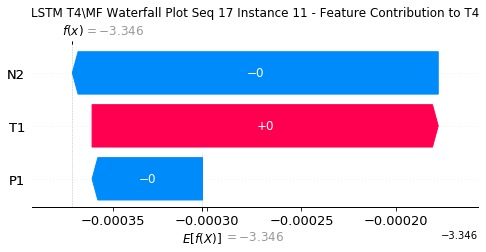

None

Contribution: [2.76103433e-05 7.80156552e-04 1.56111216e-04]


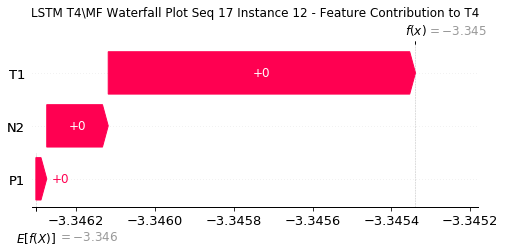

None

Contribution: [0.00013123 0.00120536 0.00052063]


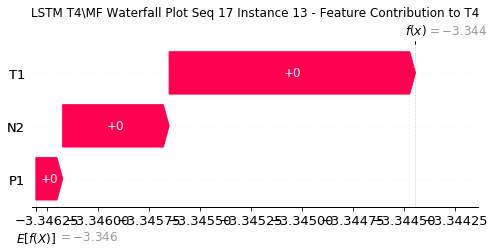

None

Contribution: [0.00016622 0.00114943 0.00043611]


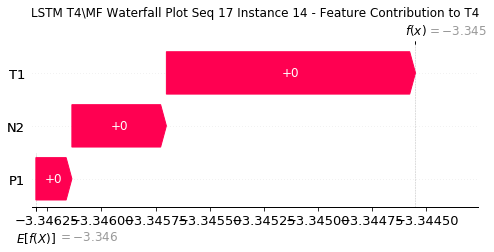

None

Contribution: [-5.13650985e-05  1.96789560e-04 -2.98580208e-04]


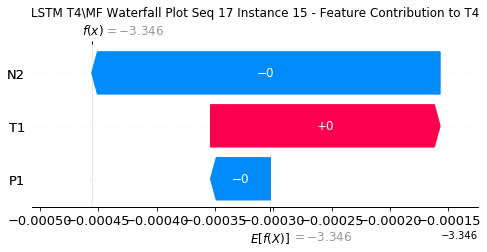

None

Contribution: [-0.00036213 -0.00154901 -0.00137331]


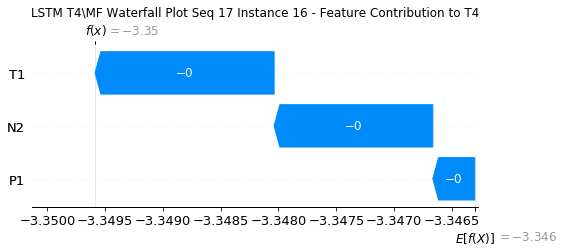

None

Contribution: [-0.00057517 -0.00334777 -0.00165166]


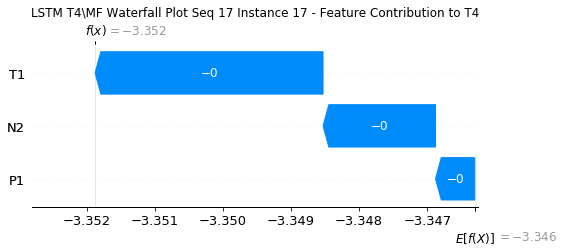

None

Contribution: [-7.15681342e-05 -3.70399887e-03 -8.89470604e-05]


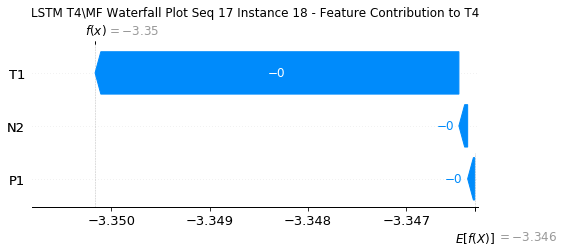

None

Contribution: [ 0.00074993 -0.00175069  0.00275192]


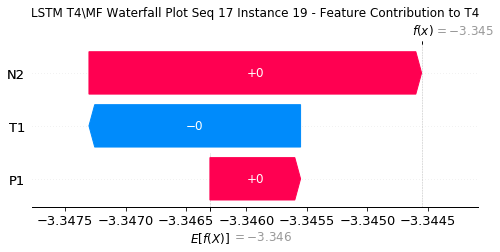

None

Contribution: [0.00129572 0.00376604 0.00411786]


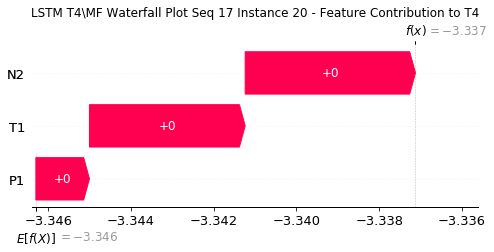

None

Contribution: [0.00120065 0.01299061 0.00079829]


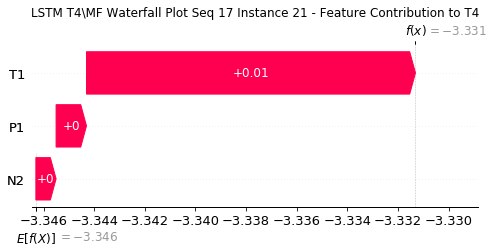

None

Contribution: [-0.00179302  0.02320667 -0.00687262]


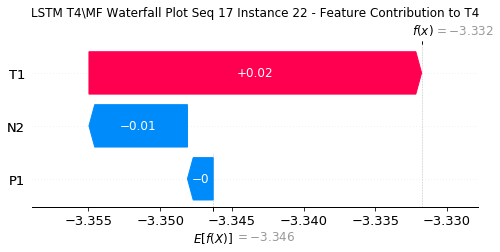

None

Contribution: [-0.00579909  0.02386615 -0.01505178]


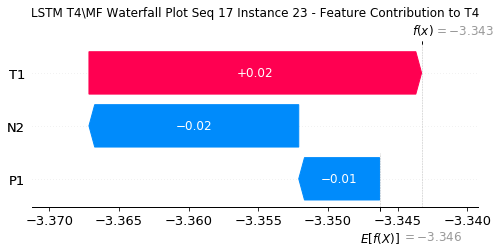

None

Contribution: [-0.00170172  0.01537073 -0.00715859]


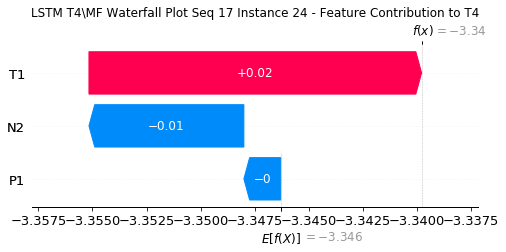

None

Contribution: [-0.00201202  0.0411419  -0.00685213]


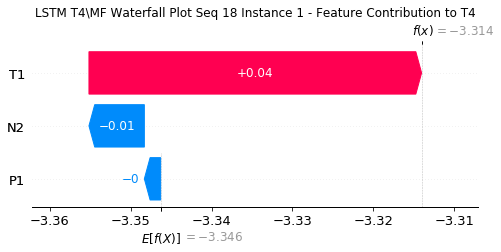

None

Contribution: [ 0.00026996 -0.00263759  0.00107271]


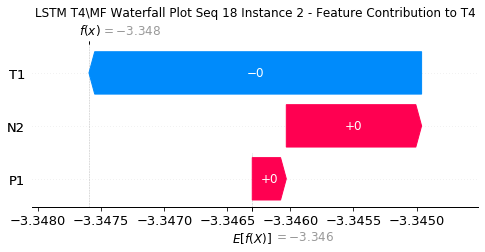

None

Contribution: [1.70557707e-05 1.53857966e-03 1.27555413e-05]


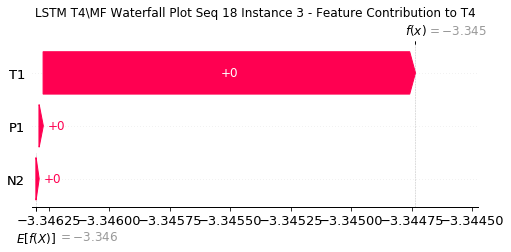

None

Contribution: [ 1.16913599e-06  3.96636808e-04 -3.72284587e-06]


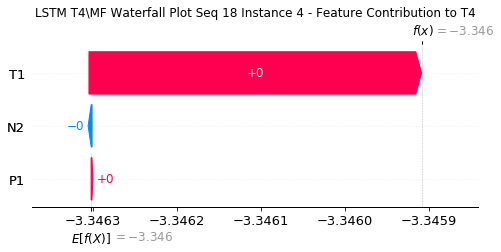

None

Contribution: [-3.05564198e-06  2.36328605e-04  2.92578539e-06]


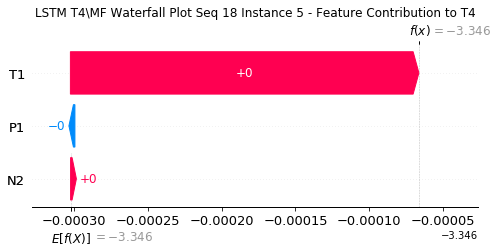

None

Contribution: [1.39154953e-05 1.86702703e-04 6.71135972e-05]


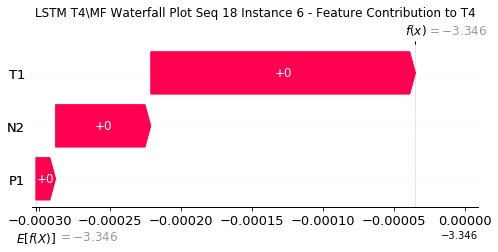

None

Contribution: [4.19194639e-05 1.03722129e-04 9.84518122e-05]


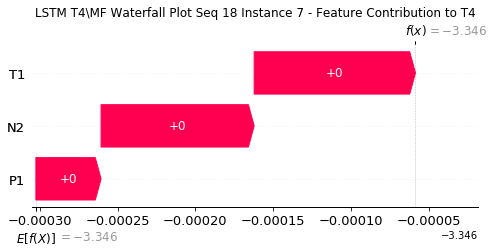

None

Contribution: [ 2.80743961e-05 -4.07514086e-05  1.45301070e-05]


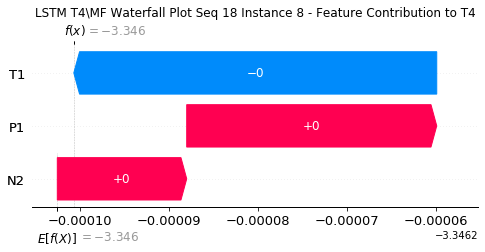

None

Contribution: [-5.27138268e-06 -1.97905898e-04 -1.59899811e-04]


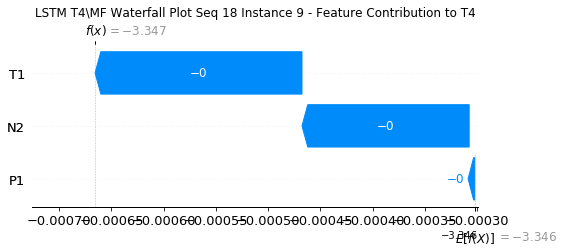

None

Contribution: [-6.26397400e-05 -1.84121857e-04 -2.90035618e-04]


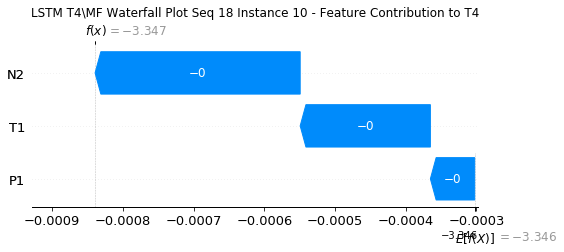

None

Contribution: [-5.50726437e-05  1.20007015e-04 -1.98950061e-04]


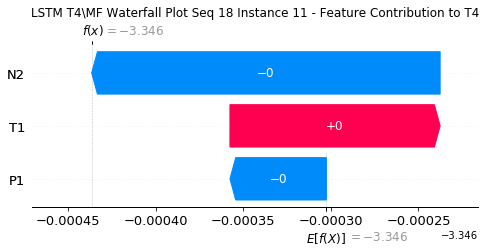

None

Contribution: [2.83799375e-05 7.09928467e-04 1.42948523e-04]


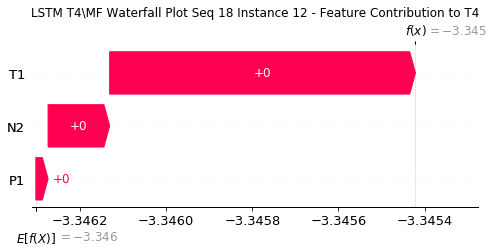

None

Contribution: [0.00012794 0.00124598 0.00052602]


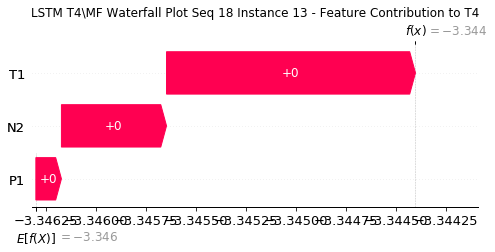

None

Contribution: [0.00017116 0.00117865 0.00043576]


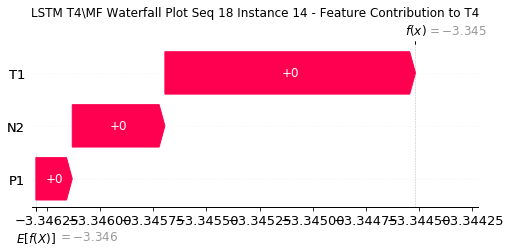

None

Contribution: [-0.00010121  0.00040939 -0.00031871]


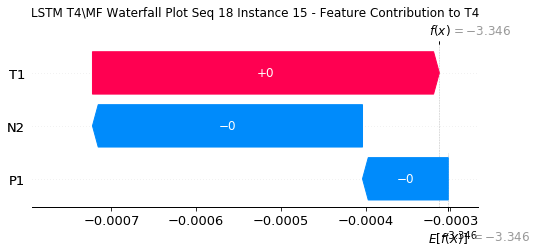

None

Contribution: [-0.00039865 -0.00143754 -0.00138725]


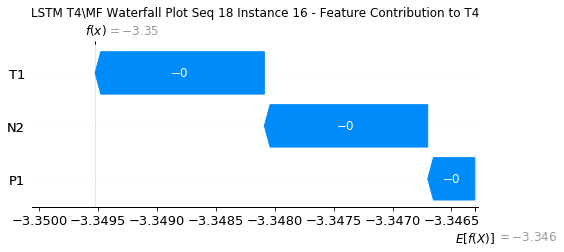

None

Contribution: [-0.00059589 -0.00368479 -0.00163111]


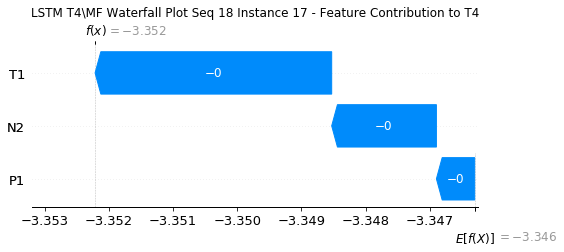

None

Contribution: [ 6.04789474e-05 -4.53549400e-03 -2.07065482e-05]


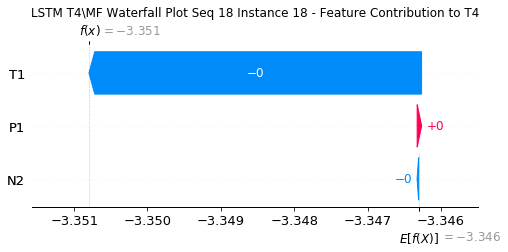

None

Contribution: [ 0.00095494 -0.00284305  0.00286076]


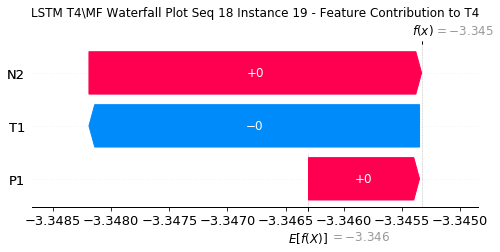

None

Contribution: [0.00140851 0.00309921 0.00422811]


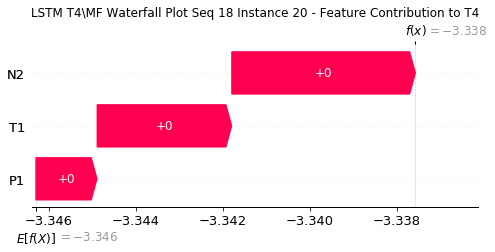

None

Contribution: [0.00088608 0.01344357 0.00064158]


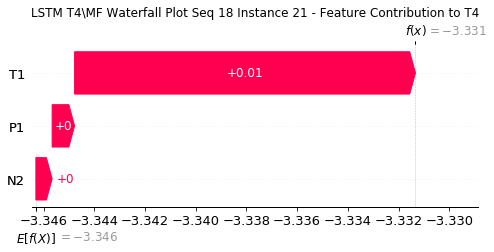

None

Contribution: [-0.00218027  0.0261962  -0.00715198]


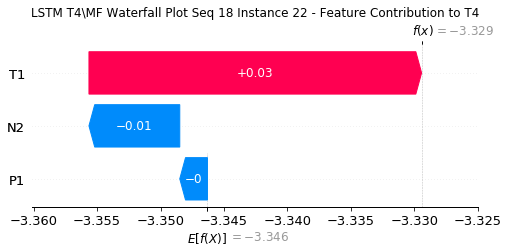

None

Contribution: [-0.00282875  0.0290809  -0.01426473]


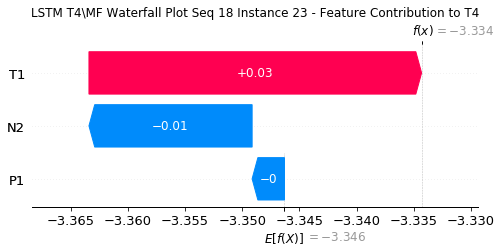

None

Contribution: [-0.00192585  0.01527324 -0.00770985]


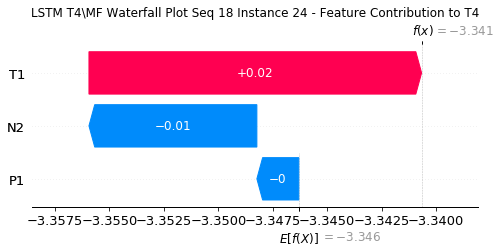

None

Contribution: [-0.00281896  0.04158392 -0.0092815 ]


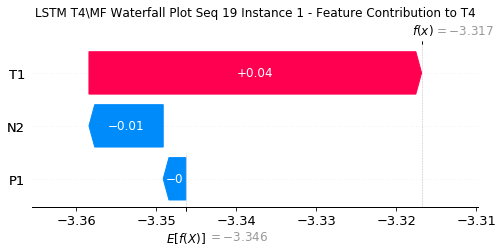

None

Contribution: [ 0.00045501 -0.00250238  0.00127273]


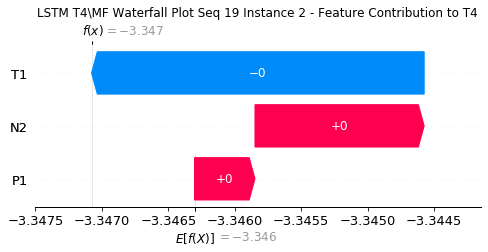

None

Contribution: [-4.76241486e-05  1.28667725e-03 -1.42798331e-05]


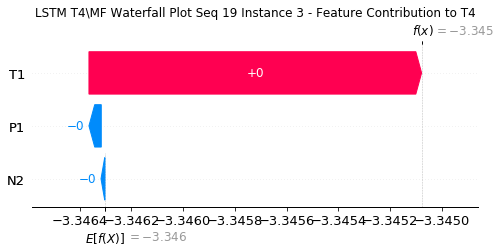

None

Contribution: [-8.23184614e-06  3.68103641e-04 -5.47493293e-06]


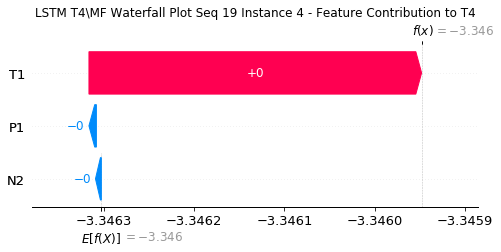

None

Contribution: [-3.97122117e-06  2.41524800e-04  4.03641790e-06]


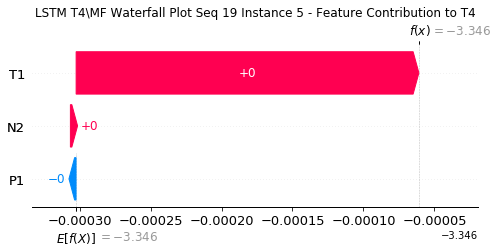

None

Contribution: [1.58507415e-05 1.95027744e-04 6.57727288e-05]


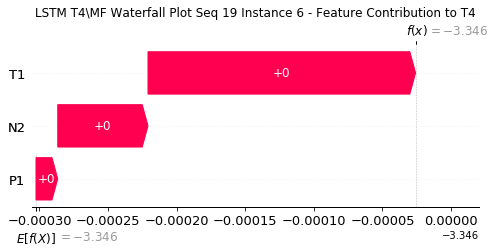

None

Contribution: [3.36034960e-05 9.09666962e-05 8.87783624e-05]


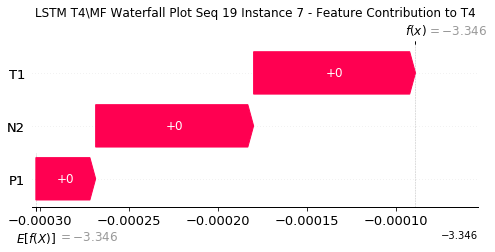

None

Contribution: [ 6.49986033e-06 -6.80623812e-05 -2.24383251e-08]


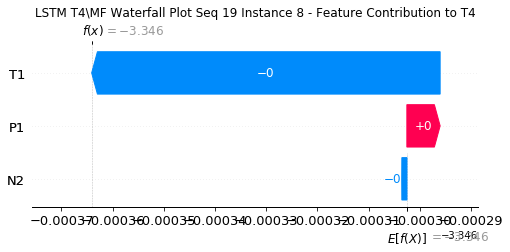

None

Contribution: [-2.29457251e-05 -2.20642484e-04 -1.65954281e-04]


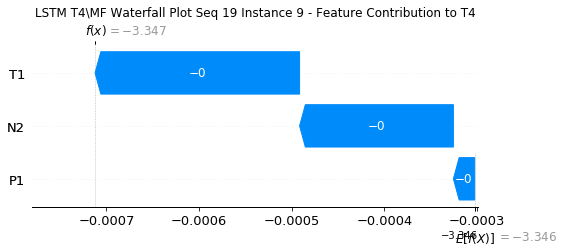

None

Contribution: [-5.91108200e-05 -1.33245330e-04 -2.82968734e-04]


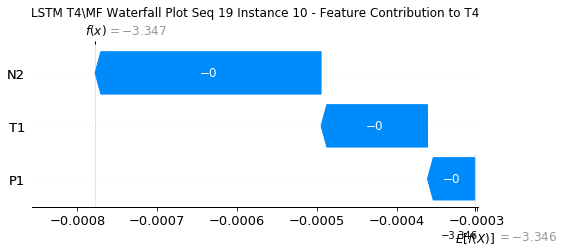

None

Contribution: [-3.76578636e-05  2.12872491e-04 -1.87059068e-04]


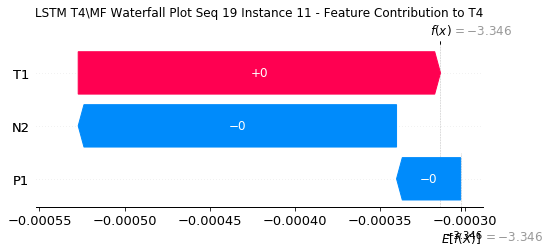

None

Contribution: [6.17759736e-05 7.79435702e-04 1.67233113e-04]


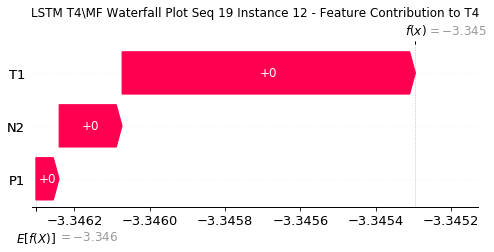

None

Contribution: [0.00011695 0.00119165 0.00051874]


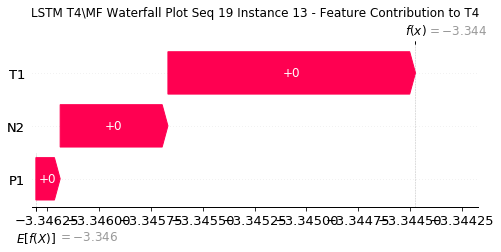

None

Contribution: [0.0001097  0.00110541 0.0004053 ]


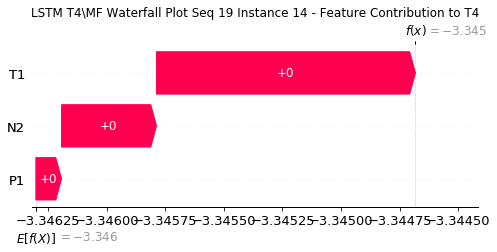

None

Contribution: [-0.00016179  0.00014805 -0.00032186]


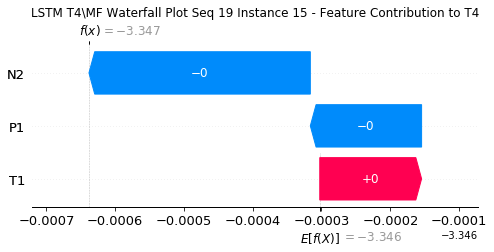

None

Contribution: [-0.00042116 -0.00157262 -0.00138471]


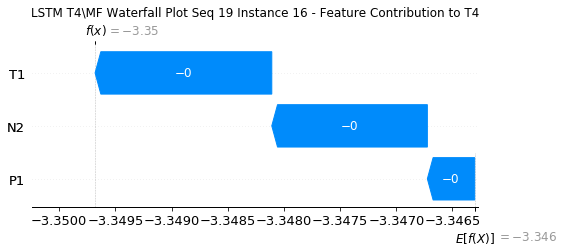

None

Contribution: [-0.00050488 -0.00335217 -0.00155515]


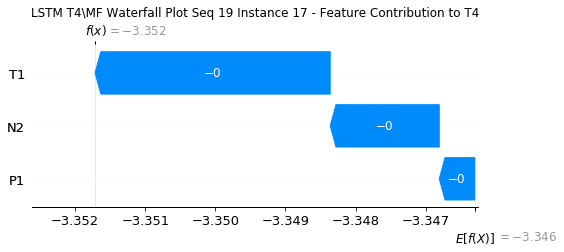

None

Contribution: [ 1.02791636e-04 -4.11249753e-03 -4.46144605e-05]


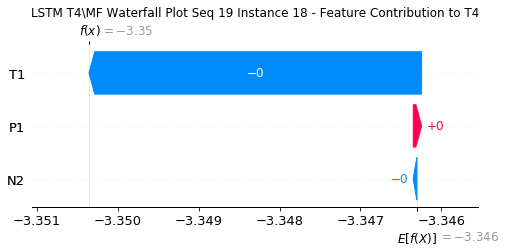

None

Contribution: [ 0.00098588 -0.00226938  0.00280173]


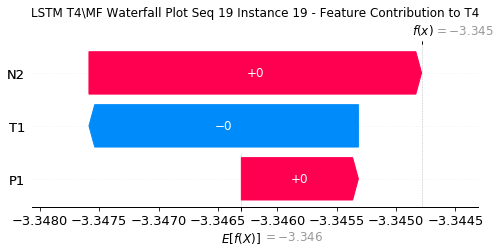

None

Contribution: [0.00141751 0.00349489 0.00416172]


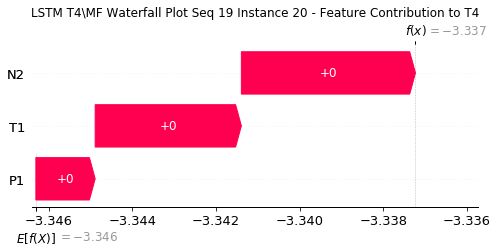

None

Contribution: [0.00090838 0.01285729 0.00077736]


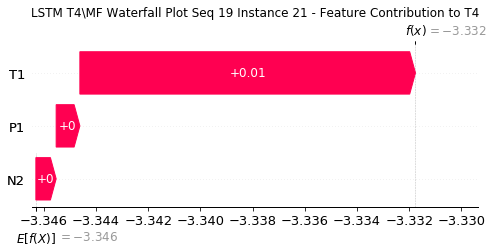

None

Contribution: [-0.00167395  0.02419924 -0.00658725]


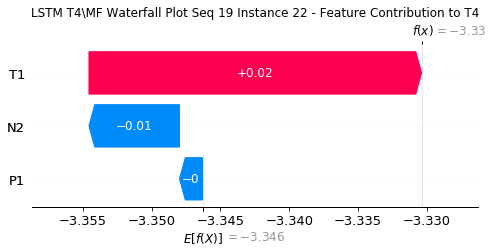

None

Contribution: [-0.00418553  0.0248521  -0.01478708]


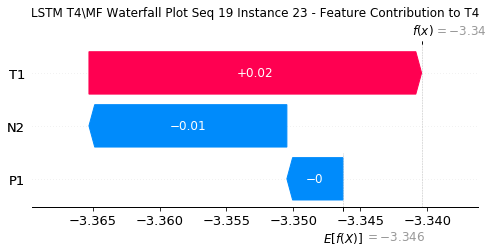

None

Contribution: [-0.00279694  0.01418237 -0.00787144]


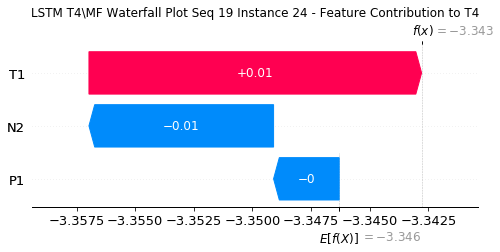

None

Contribution: [-0.00387517  0.03888672 -0.00847654]


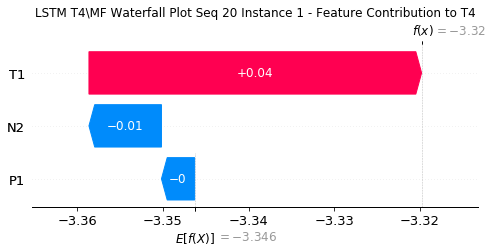

None

Contribution: [ 0.00019188 -0.00262341  0.00112663]


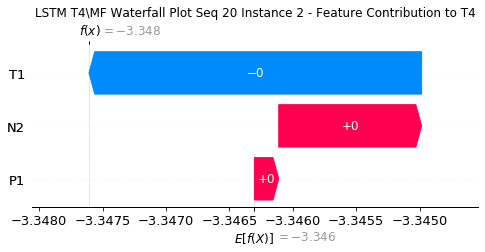

None

Contribution: [-1.95423854e-05  1.42092610e-03 -6.10637513e-08]


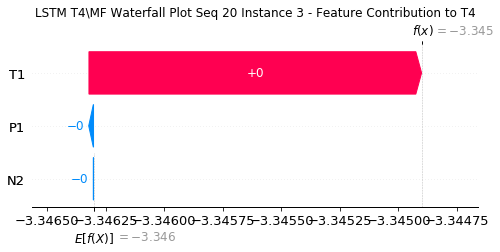

None

Contribution: [-7.13658838e-06  3.87503445e-04 -5.12344314e-06]


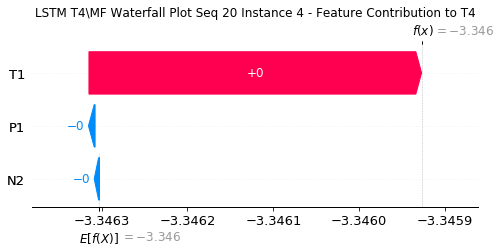

None

Contribution: [-3.72148121e-06  2.41961125e-04  2.48706781e-06]


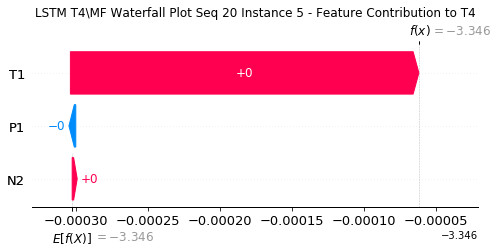

None

Contribution: [1.54798813e-05 1.92351792e-04 6.50988818e-05]


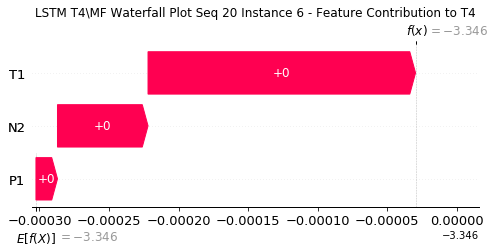

None

Contribution: [3.62358577e-05 9.88090041e-05 9.14063840e-05]


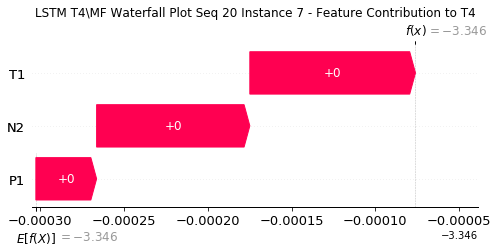

None

Contribution: [ 1.76597147e-05 -6.07106662e-05  7.55726543e-06]


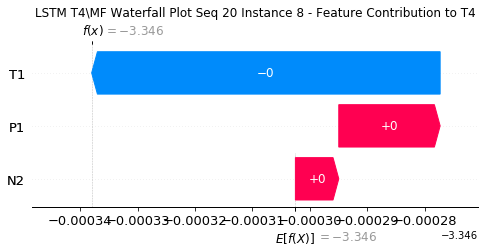

None

Contribution: [-2.37732168e-05 -2.01896590e-04 -1.67160751e-04]


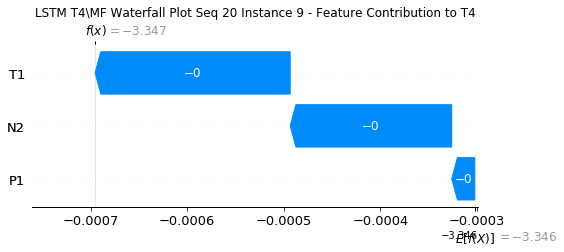

None

Contribution: [-6.02880341e-05 -1.49175090e-04 -2.87125009e-04]


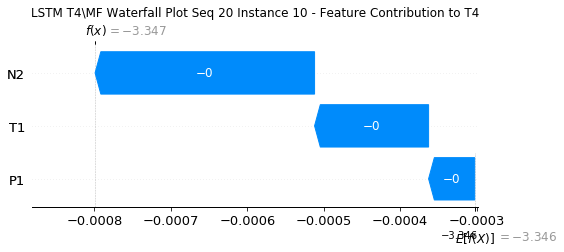

None

Contribution: [-4.30044473e-05  1.76151980e-04 -1.98374438e-04]


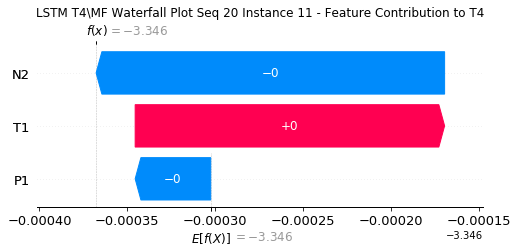

None

Contribution: [5.40283986e-05 7.94566447e-04 1.40187764e-04]


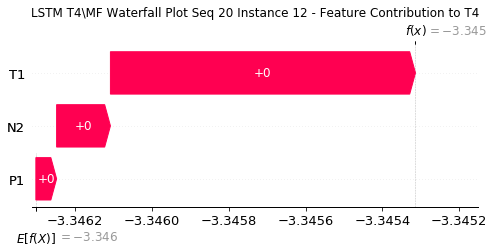

None

Contribution: [0.00012008 0.00121862 0.00052442]


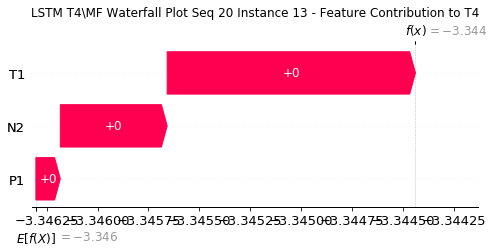

None

Contribution: [0.00017393 0.00117002 0.00046441]


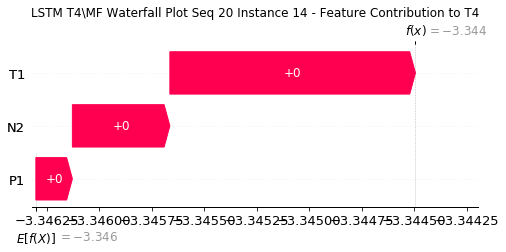

None

Contribution: [-0.00017323  0.00028968 -0.00027753]


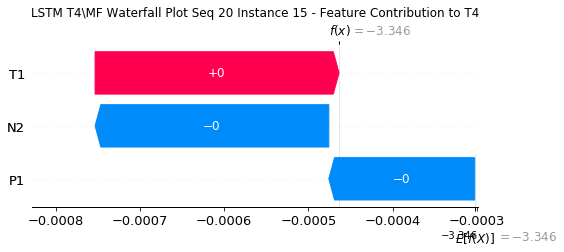

None

Contribution: [-0.00044978 -0.00150087 -0.00136467]


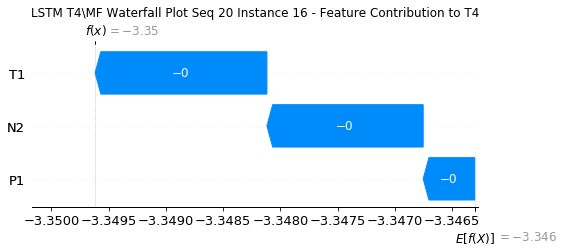

None

Contribution: [-0.0004563  -0.00350068 -0.00166665]


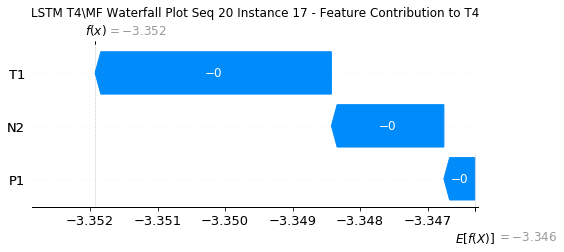

None

Contribution: [ 0.00017627 -0.00437038 -0.00019873]


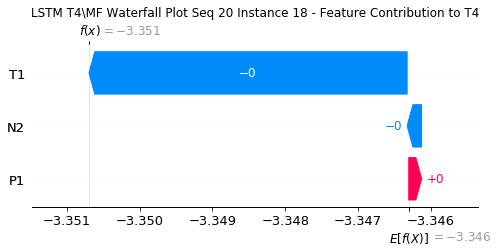

None

Contribution: [ 0.0011018  -0.00261592  0.00259999]


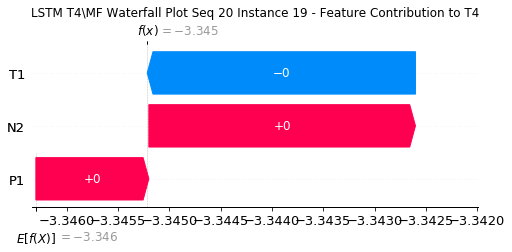

None

Contribution: [0.00141537 0.00324061 0.00403478]


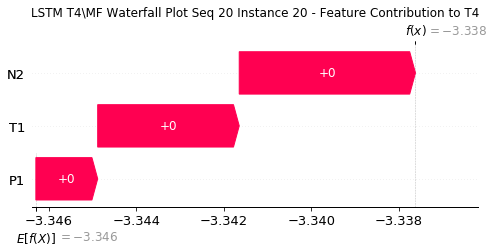

None

Contribution: [0.00074157 0.01327665 0.00102677]


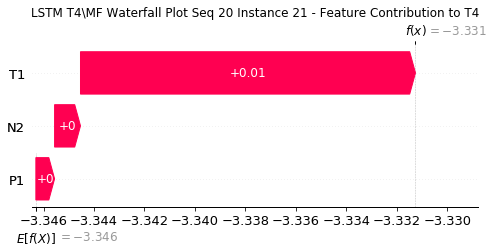

None

Contribution: [-0.00210992  0.02536525 -0.00568455]


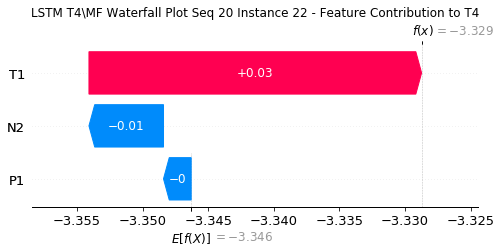

None

Contribution: [-0.00337639  0.02184941 -0.01320055]


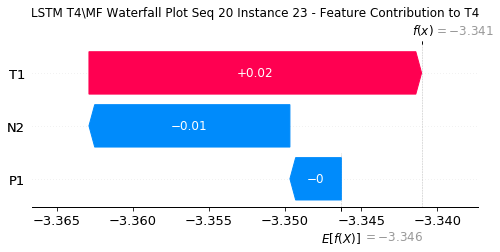

None

Contribution: [-0.00267941  0.0124713  -0.00748359]


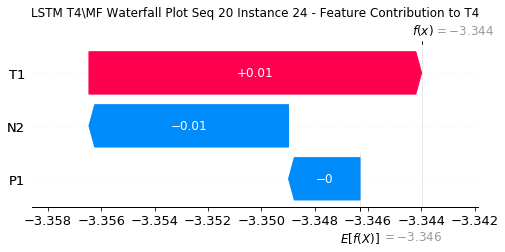

None

Contribution: [-0.00273417  0.03615671 -0.00706212]


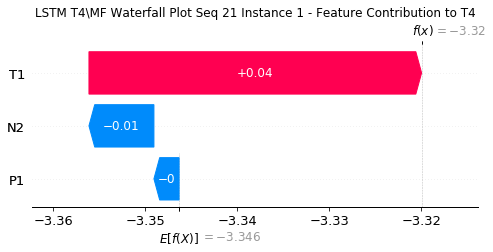

None

Contribution: [ 0.00054239 -0.00225371  0.00119684]


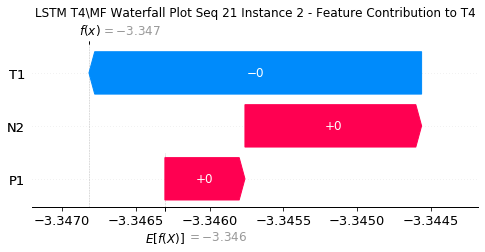

None

Contribution: [-3.95393704e-06  1.37828144e-03  5.63245381e-06]


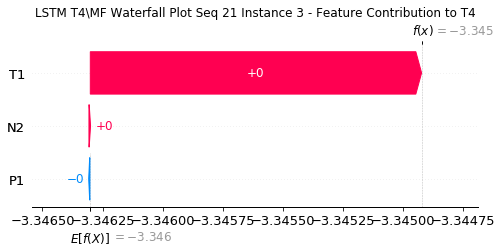

None

Contribution: [-2.00246362e-06  3.74184956e-04 -3.66792757e-06]


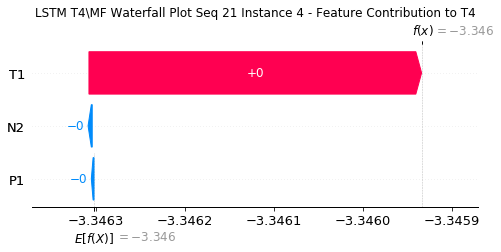

None

Contribution: [-2.63338653e-06  2.35582766e-04  4.55026755e-06]


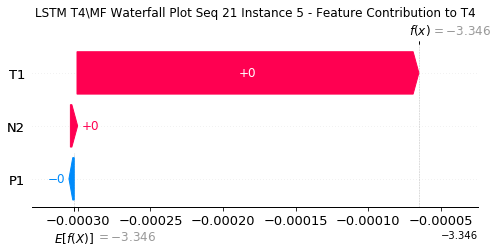

None

Contribution: [1.57950181e-05 1.94993782e-04 6.66341386e-05]


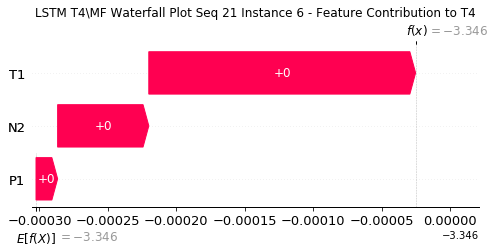

None

Contribution: [3.32032062e-05 9.88839922e-05 9.18752062e-05]


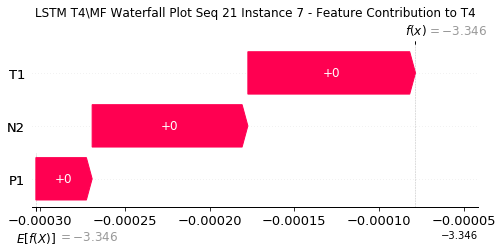

None

Contribution: [ 1.36907206e-05 -9.07055416e-05  8.33809969e-06]


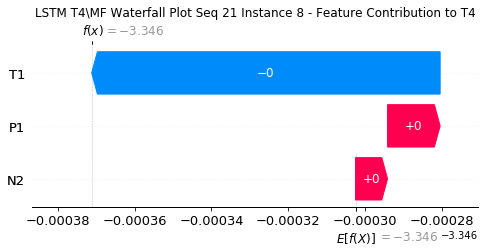

None

Contribution: [-2.36004222e-05 -2.27605356e-04 -1.64381296e-04]


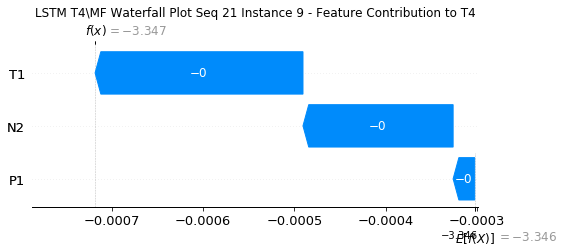

None

Contribution: [-6.19706815e-05 -1.61080082e-04 -2.85804559e-04]


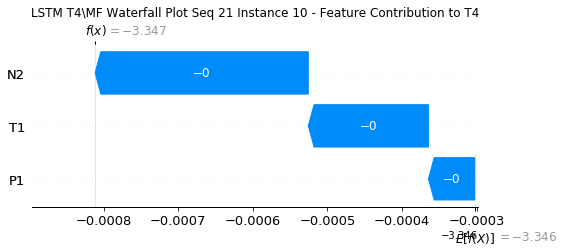

None

Contribution: [-5.13635423e-05  1.62650436e-04 -1.96046355e-04]


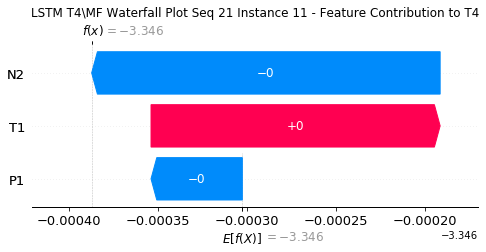

None

Contribution: [6.50337417e-05 7.49769624e-04 1.64131646e-04]


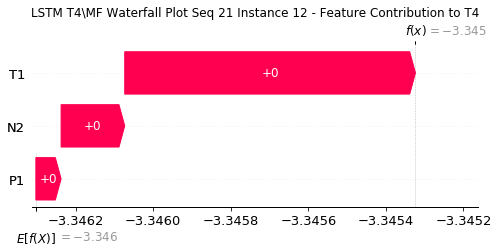

None

Contribution: [0.00012539 0.00121238 0.00052421]


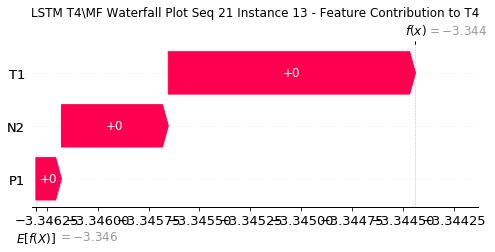

None

Contribution: [0.00010627 0.00111809 0.00043271]


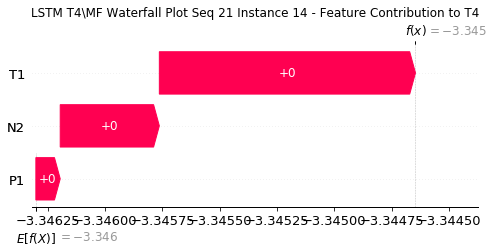

None

Contribution: [-0.00024936  0.00044636 -0.0003415 ]


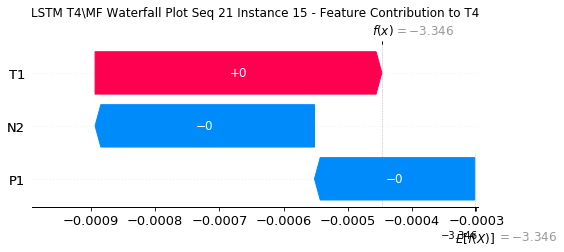

None

Contribution: [-0.00046824 -0.0014021  -0.0014031 ]


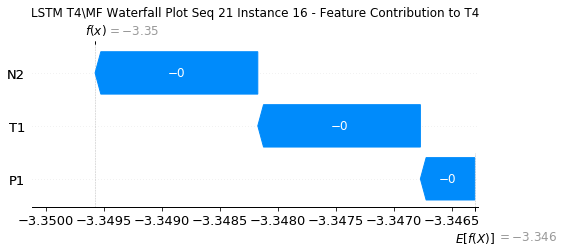

None

Contribution: [-0.00048794 -0.00361184 -0.00159934]


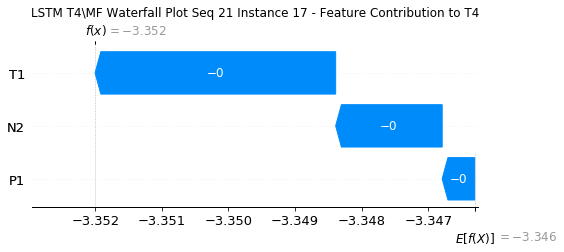

None

Contribution: [ 3.85472132e-04 -4.68203476e-03  3.63483789e-05]


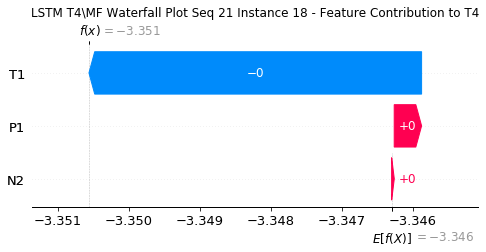

None

Contribution: [ 0.00108404 -0.0037749   0.00281084]


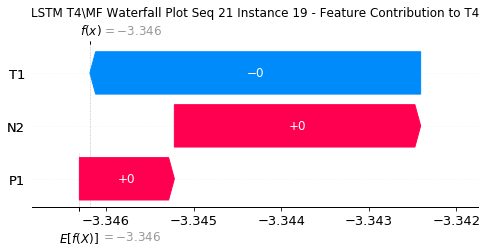

None

Contribution: [0.00142544 0.00243299 0.00422182]


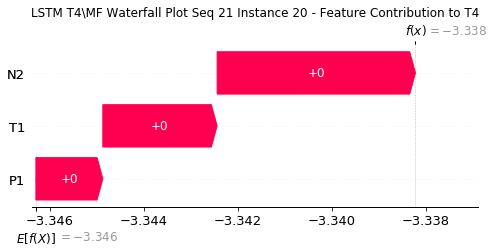

None

Contribution: [0.00096013 0.01453745 0.00082529]


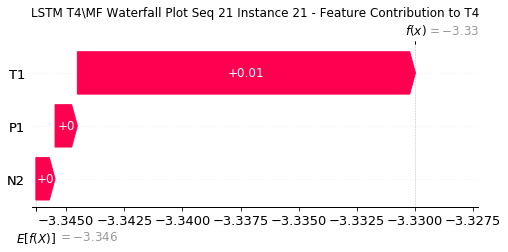

None

Contribution: [-0.0018791   0.03088057 -0.00688687]


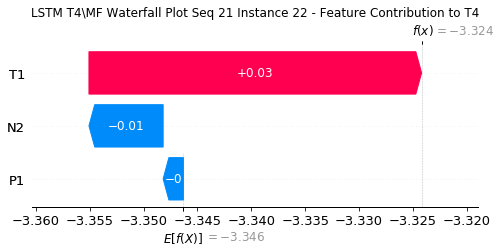

None

Contribution: [-0.00434302  0.03679744 -0.01440774]


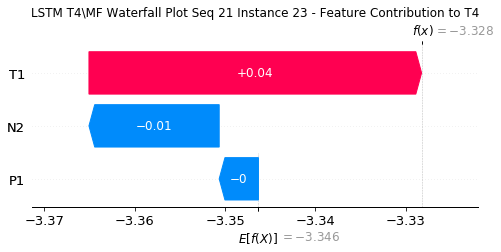

None

Contribution: [-0.00374313  0.01844937 -0.00802551]


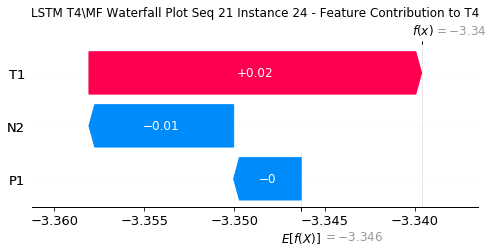

None

Contribution: [-0.0030283   0.05012106 -0.00753069]


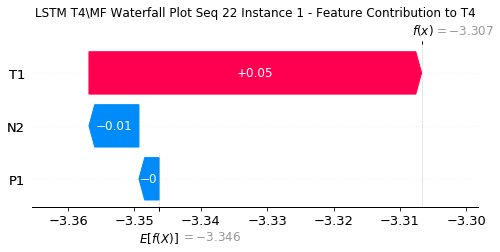

None

Contribution: [ 0.00039707 -0.0034373   0.0010478 ]


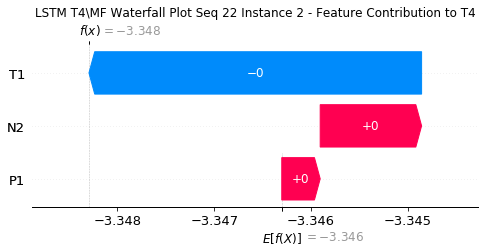

None

Contribution: [-5.74920257e-05  1.75536479e-03  5.36576532e-05]


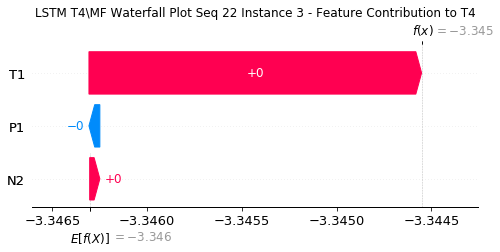

None

Contribution: [-3.94761848e-06  3.80339286e-04  4.70280943e-06]


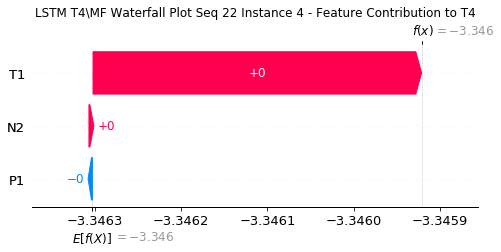

None

Contribution: [-1.25339329e-06  2.23338154e-04  4.42088363e-06]


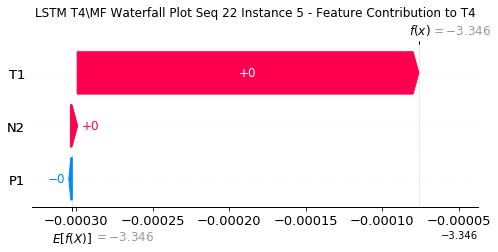

None

Contribution: [1.85761598e-05 1.89698395e-04 6.75507832e-05]


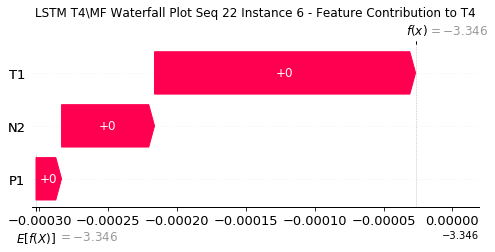

None

Contribution: [3.68342906e-05 1.07018053e-04 9.74936777e-05]


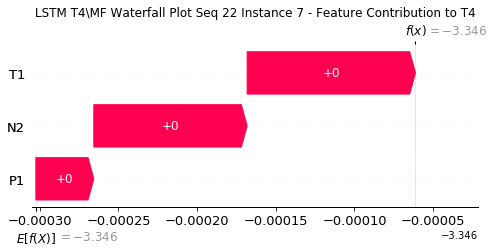

None

Contribution: [ 1.34109083e-05 -8.07368026e-05  1.21517364e-05]


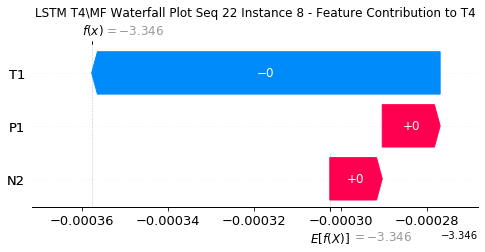

None

Contribution: [-3.03713997e-05 -2.14553322e-04 -1.62030675e-04]


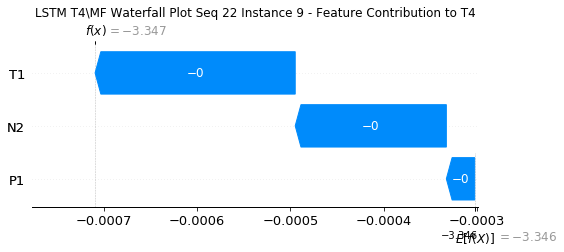

None

Contribution: [-6.06650739e-05 -1.69307200e-04 -2.87805883e-04]


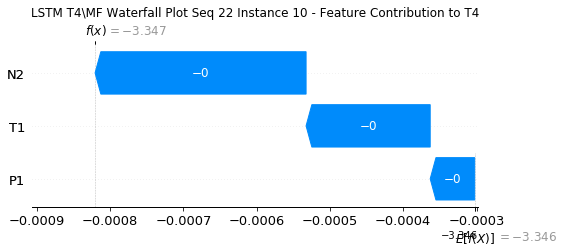

None

Contribution: [-4.85182354e-05  1.38767881e-04 -2.04300648e-04]


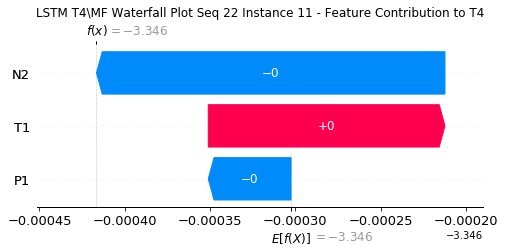

None

Contribution: [4.49110006e-05 7.27529347e-04 1.50729922e-04]


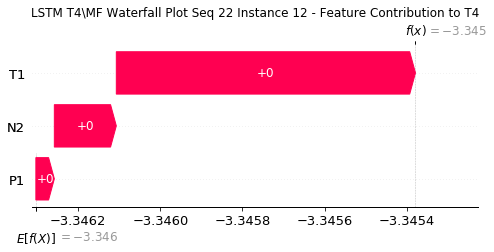

None

Contribution: [0.00011318 0.00121898 0.0005234 ]


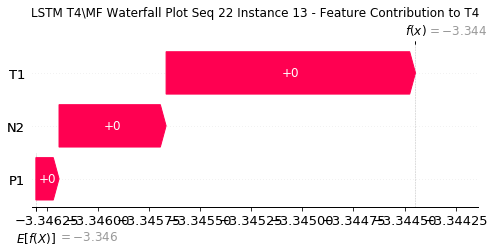

None

Contribution: [0.00015634 0.00115613 0.00045023]


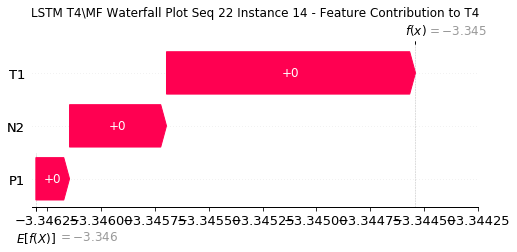

None

Contribution: [-0.00011717  0.00023396 -0.00028148]


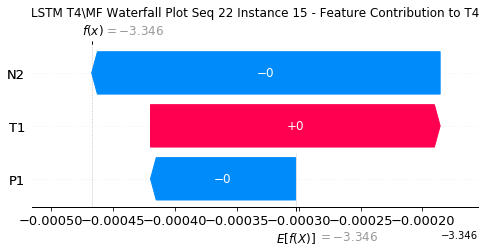

None

Contribution: [-0.00044553 -0.00158521 -0.00138679]


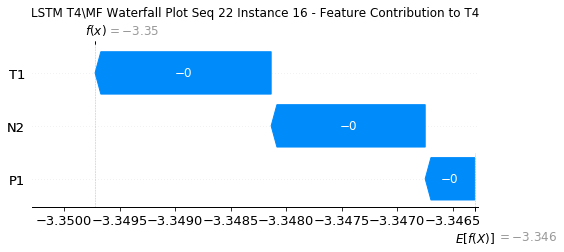

None

Contribution: [-0.00049479 -0.0033111  -0.00160792]


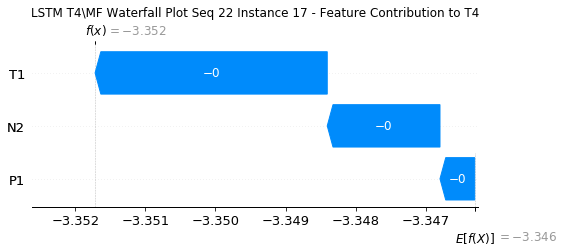

None

Contribution: [ 5.83131767e-04 -3.74591744e-03 -7.70372878e-05]


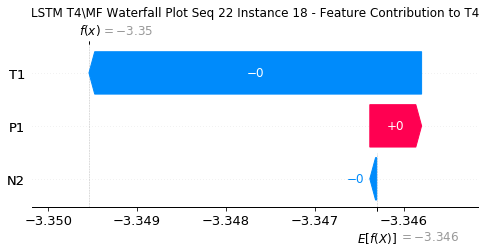

None

Contribution: [ 0.0012447  -0.00194207  0.00282994]


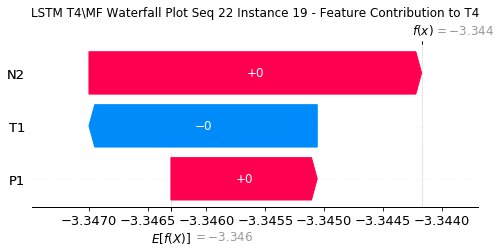

None

Contribution: [0.001502   0.00346679 0.00421507]


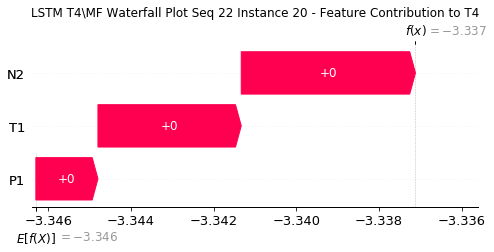

None

Contribution: [0.00084305 0.01269022 0.0007551 ]


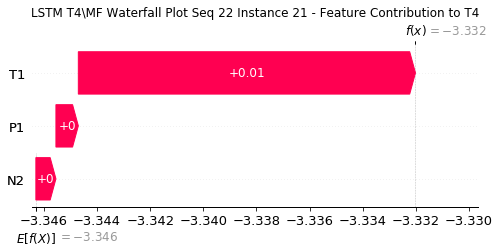

None

Contribution: [-0.00219889  0.02400196 -0.00702535]


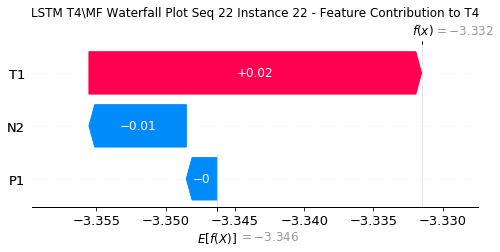

None

Contribution: [-0.00320799  0.02891639 -0.01409968]


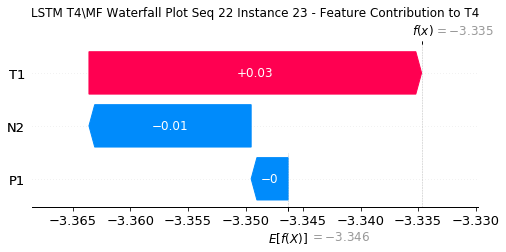

None

Contribution: [-0.00024269  0.01815124 -0.00715671]


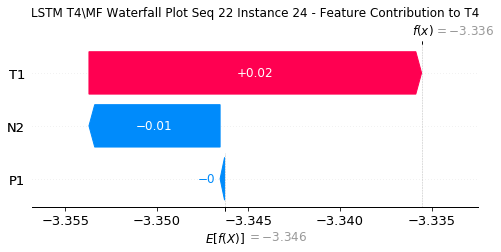

None

Contribution: [-0.00397753  0.04231965 -0.00859253]


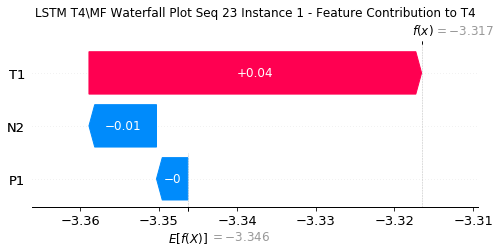

None

Contribution: [ 0.00044028 -0.00277451  0.00120981]


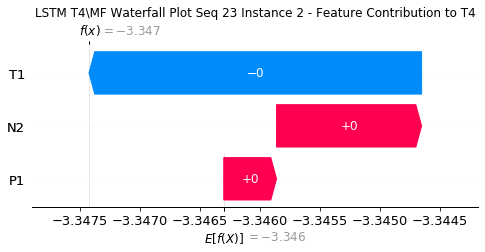

None

Contribution: [-9.68178703e-05  1.48067565e-03 -9.17701027e-06]


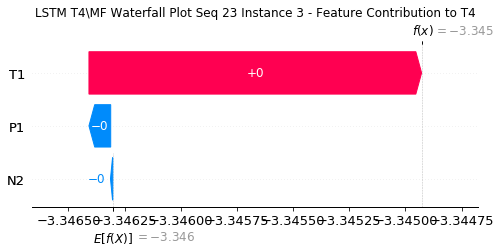

None

Contribution: [-9.05265643e-06  3.85650643e-04 -5.08215163e-06]


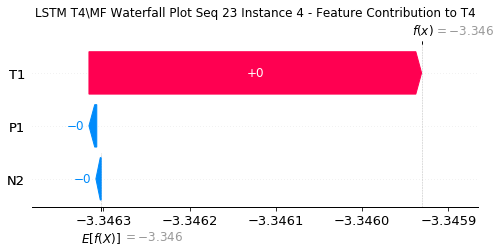

None

Contribution: [-2.78704759e-06  2.38927988e-04  4.36847552e-06]


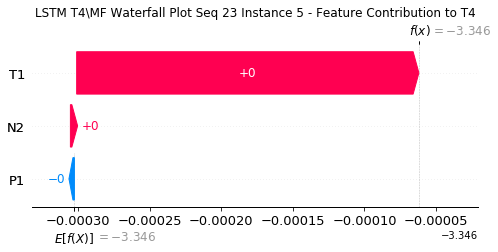

None

Contribution: [1.76104802e-05 1.90842712e-04 6.65041521e-05]


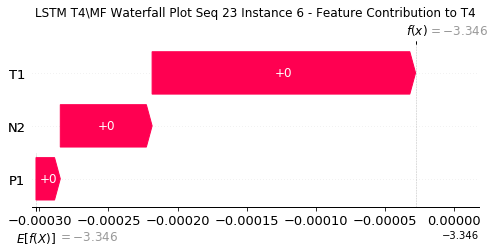

None

Contribution: [3.49495974e-05 9.27409564e-05 8.97717141e-05]


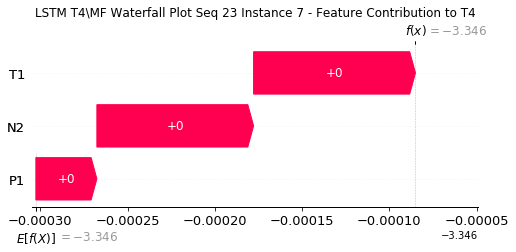

None

Contribution: [ 7.87803275e-06 -6.14892698e-05  3.79681755e-06]


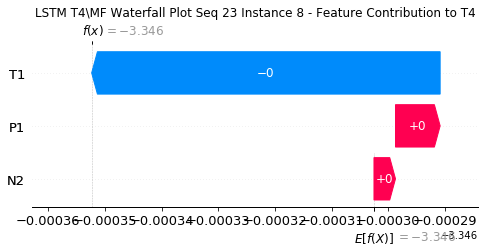

None

Contribution: [-2.81037173e-05 -2.08927485e-04 -1.66308537e-04]


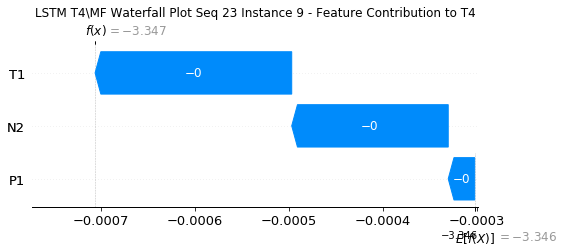

None

Contribution: [-5.83670995e-05 -1.31419472e-04 -2.81533175e-04]


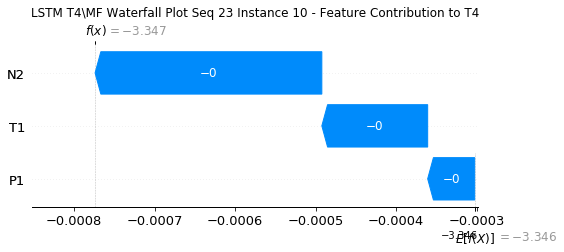

None

Contribution: [-3.86294661e-05  2.04631803e-04 -1.85484059e-04]


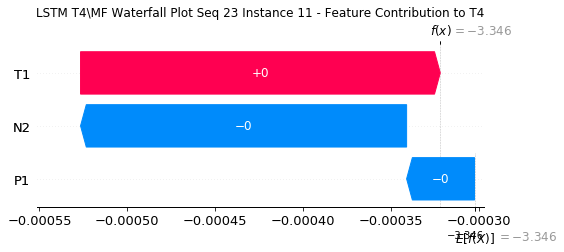

None

Contribution: [5.18065088e-05 7.61954155e-04 1.64657850e-04]


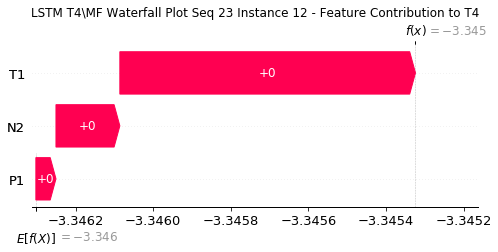

None

Contribution: [0.0001107  0.00119354 0.00051735]


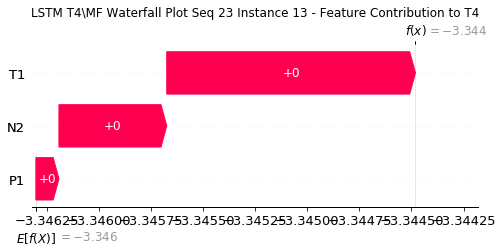

None

Contribution: [0.00011402 0.00107917 0.00040482]


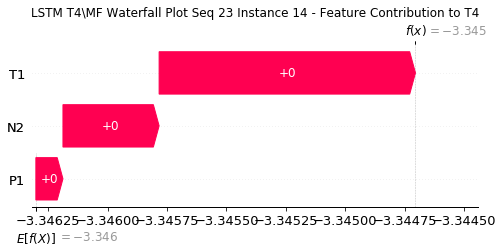

None

Contribution: [-0.00020914  0.00023706 -0.00029287]


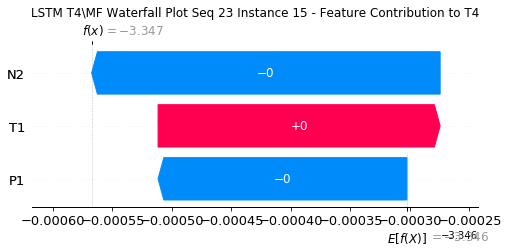

None

Contribution: [-0.0004669  -0.00158711 -0.00140915]


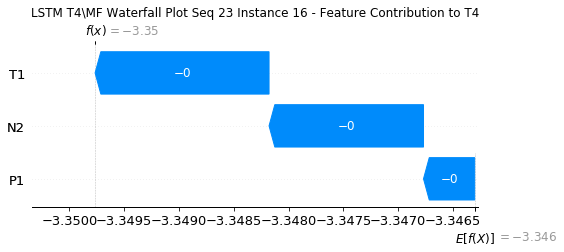

None

Contribution: [-0.00046902 -0.0033411  -0.00157893]


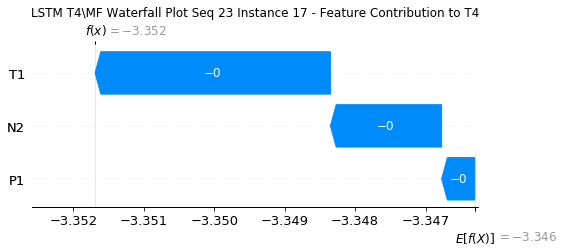

None

Contribution: [ 2.00504637e-04 -4.12974380e-03 -4.59853975e-05]


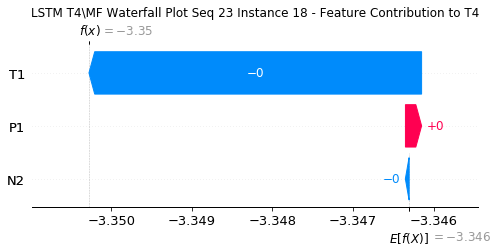

None

Contribution: [ 0.00135631 -0.00225719  0.00290062]


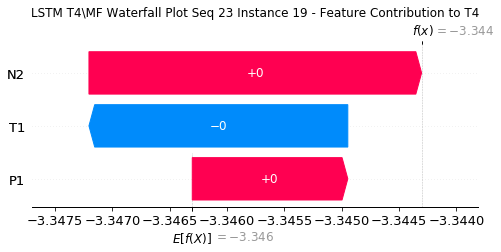

None

Contribution: [0.00156896 0.00350131 0.00422787]


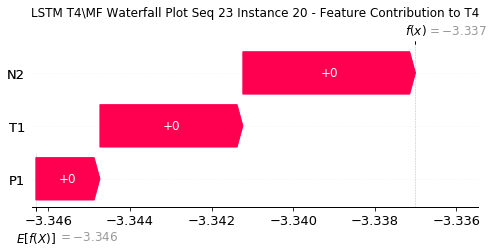

None

Contribution: [0.00049902 0.01309953 0.00063817]


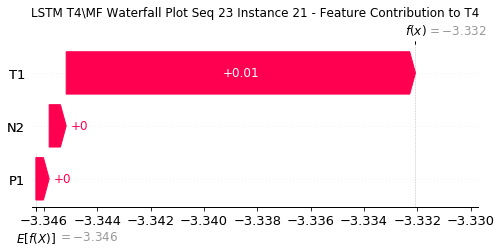

None

Contribution: [-0.00315303  0.02437875 -0.00719521]


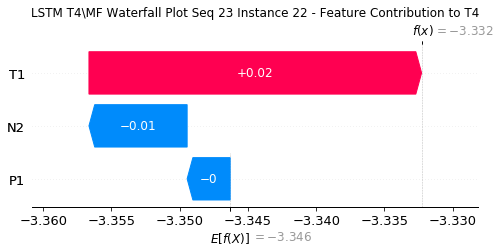

None

Contribution: [-0.00630262  0.02757987 -0.01477622]


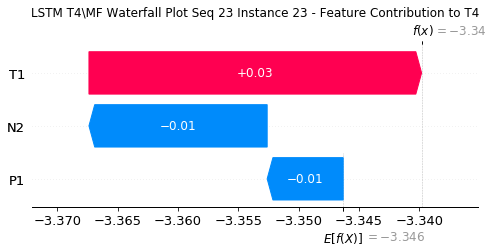

None

Contribution: [-0.004381    0.01615442 -0.00795358]


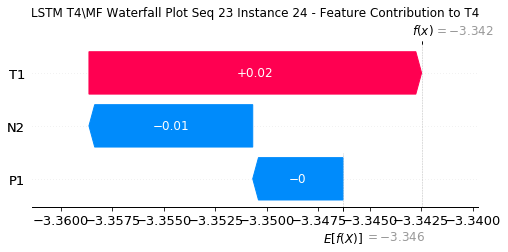

None

Contribution: [-0.00479003  0.04440014 -0.00842942]


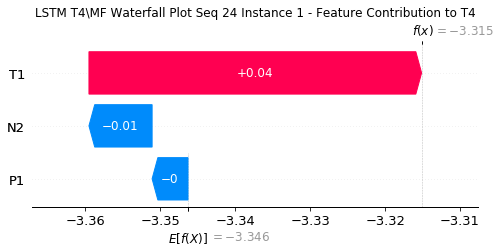

None

Contribution: [ 0.00059448 -0.00288333  0.0012066 ]


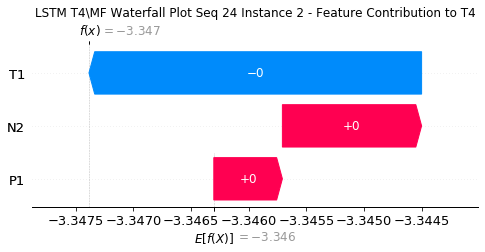

None

Contribution: [-5.69486190e-05  1.57339543e-03 -1.41712217e-06]


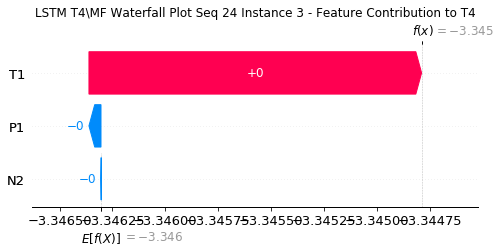

None

Contribution: [-1.15738405e-05  4.12987055e-04 -5.30690804e-06]


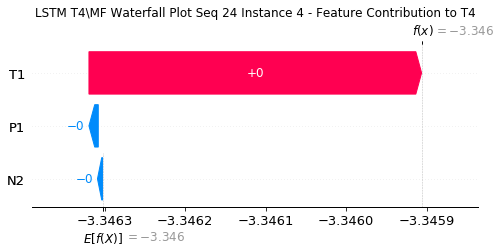

None

Contribution: [-2.39437024e-06  2.34754204e-04  5.81520428e-06]


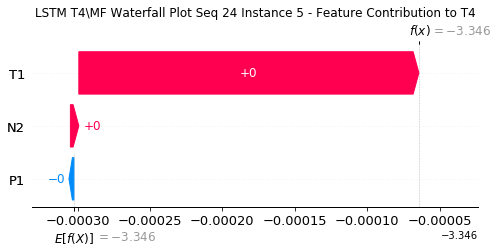

None

Contribution: [1.75834212e-05 1.75921173e-04 6.66899133e-05]


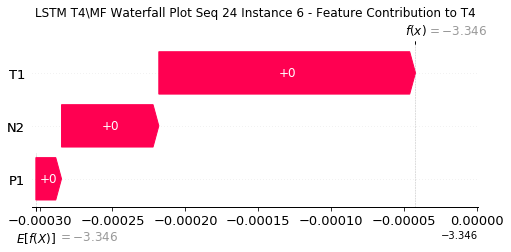

None

Contribution: [3.46168907e-05 8.61615522e-05 8.80004993e-05]


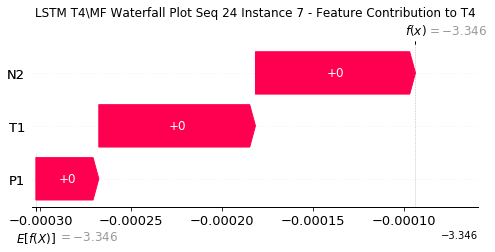

None

Contribution: [ 1.33487918e-05 -4.73092583e-05  1.64803280e-06]


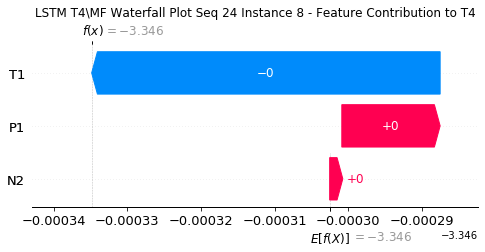

None

Contribution: [-2.21630669e-05 -1.75619222e-04 -1.65381176e-04]


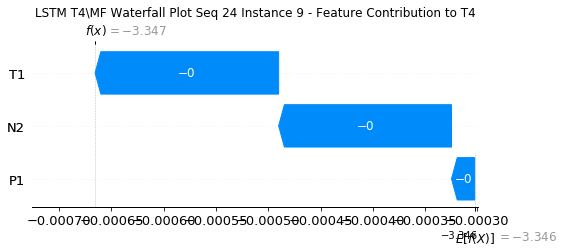

None

Contribution: [-5.75521741e-05 -1.21647886e-04 -2.77636633e-04]


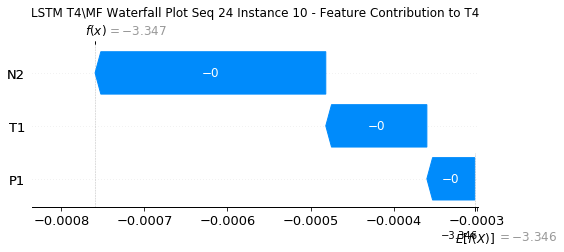

None

Contribution: [-3.40990876e-05  2.28071640e-04 -1.77030902e-04]


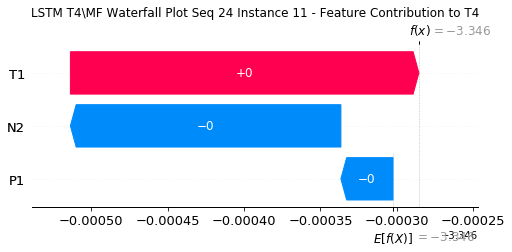

None

Contribution: [5.38689450e-05 7.73410997e-04 1.70270467e-04]


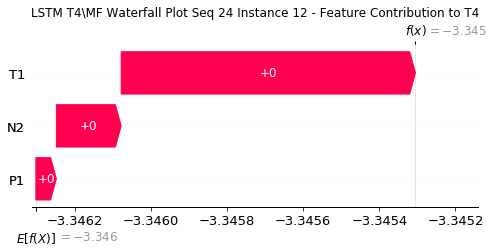

None

Contribution: [0.00010957 0.0011456  0.00051179]


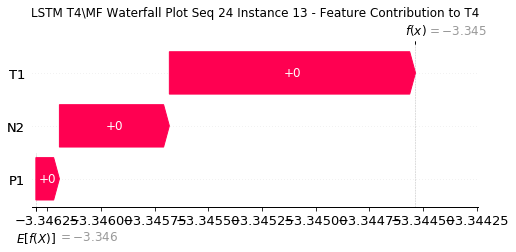

None

Contribution: [8.26796714e-05 9.51839011e-04 3.78133404e-04]


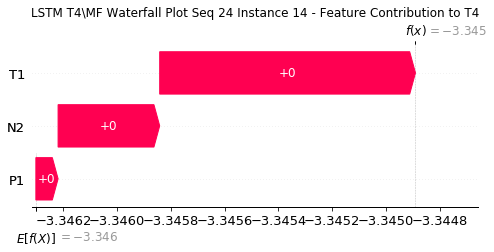

None

Contribution: [-0.00020445 -0.00011954 -0.00042306]


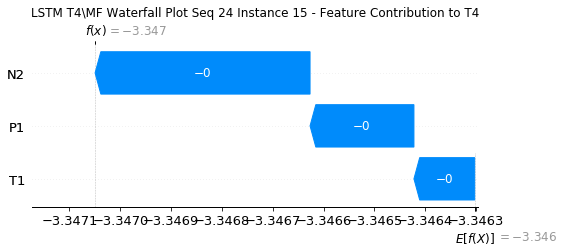

None

Contribution: [-0.00047481 -0.00171306 -0.00141183]


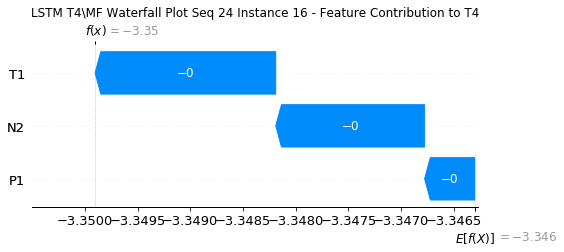

None

Contribution: [-0.00044505 -0.00304162 -0.00155081]


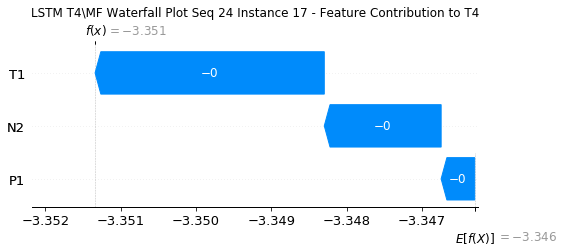

None

Contribution: [ 4.78664627e-04 -2.56557132e-03 -1.89655355e-05]


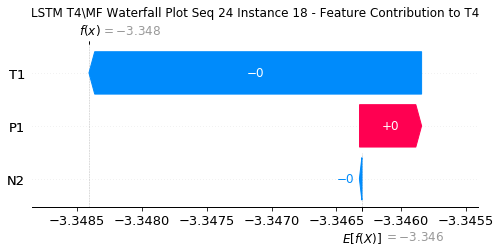

None

Contribution: [ 0.00143467 -0.00068584  0.00292774]


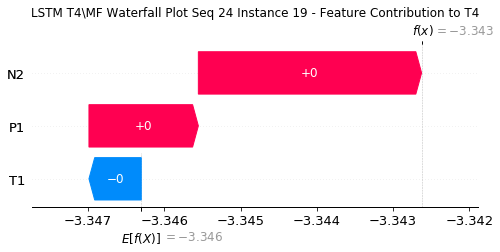

None

Contribution: [0.00156665 0.00440014 0.00418071]


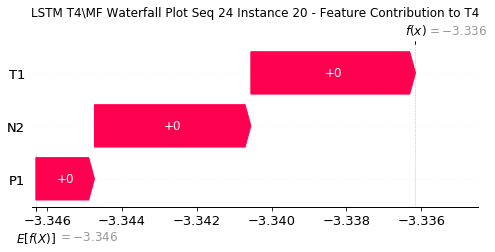

None

Contribution: [0.00026532 0.01158351 0.00059056]


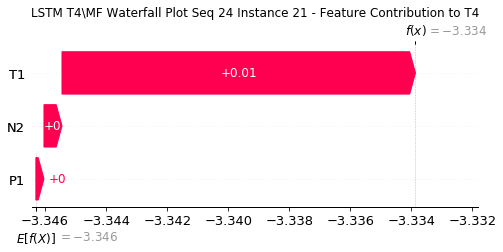

None

Contribution: [-0.00371504  0.01890962 -0.00703534]


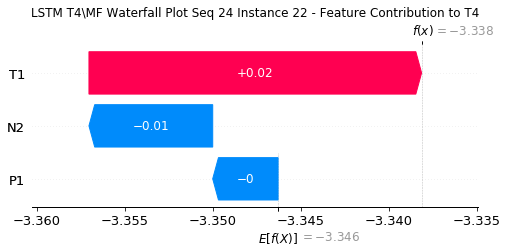

None

Contribution: [-0.00706338  0.02089169 -0.01478346]


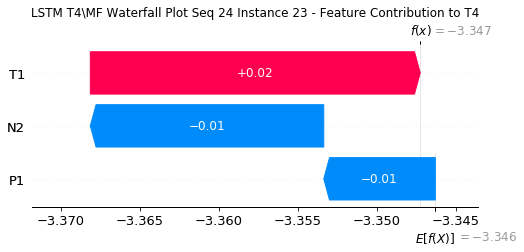

None

Contribution: [-0.00148465  0.0151289  -0.00737094]


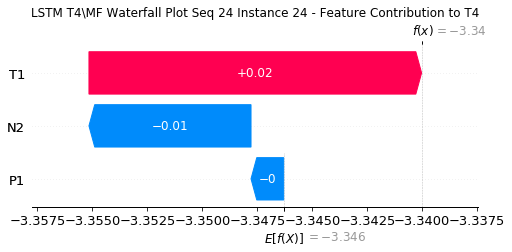

None

Contribution: [-0.0002681   0.0372515  -0.00649416]


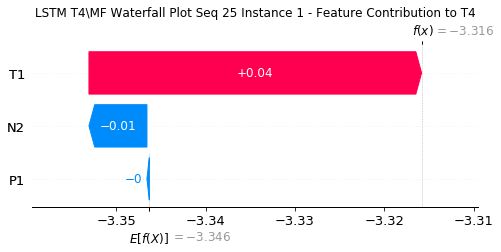

None

Contribution: [ 0.00041184 -0.00229978  0.00117405]


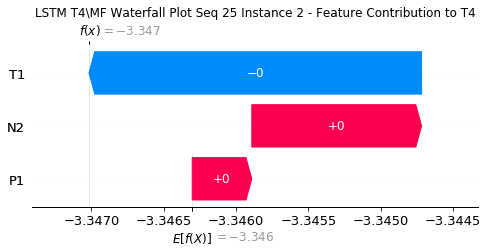

None

Contribution: [-3.50185694e-05  1.34996939e-03 -1.14834673e-05]


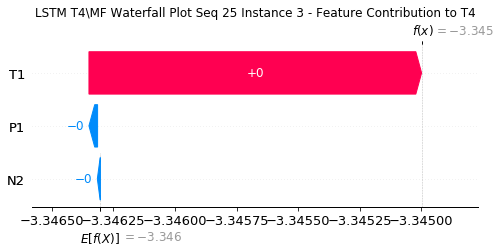

None

Contribution: [-1.47938077e-05  3.84251491e-04 -7.39215803e-06]


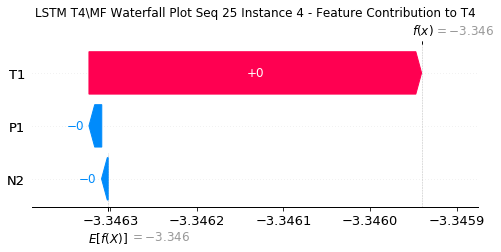

None

Contribution: [-2.84291970e-06  2.37935137e-04  5.80240942e-06]


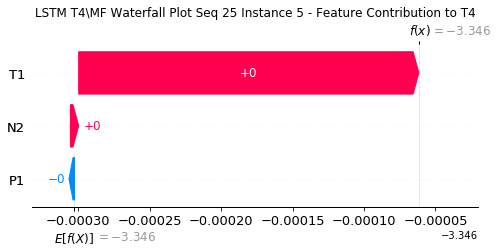

None

Contribution: [1.42923177e-05 1.76649340e-04 6.55366383e-05]


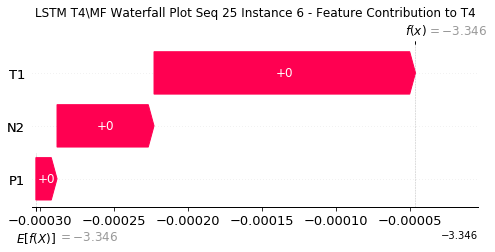

None

Contribution: [3.49939664e-05 7.76334075e-05 8.65445953e-05]


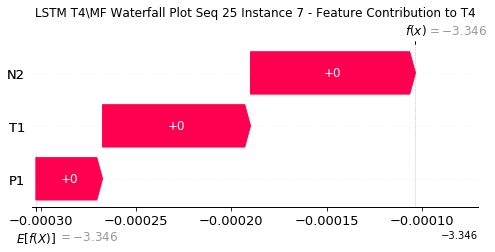

None

Contribution: [ 1.75539263e-05 -7.14933547e-05 -2.33071333e-07]


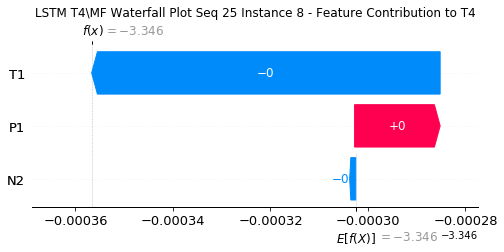

None

Contribution: [-2.18778712e-05 -1.83054682e-04 -1.67765192e-04]


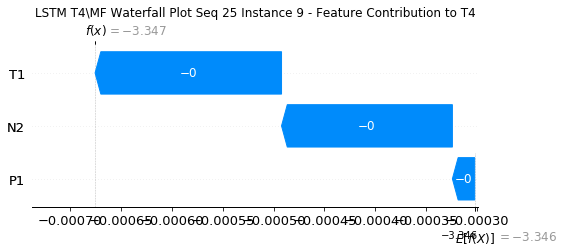

None

Contribution: [-5.82092459e-05 -8.95810997e-05 -2.78181180e-04]


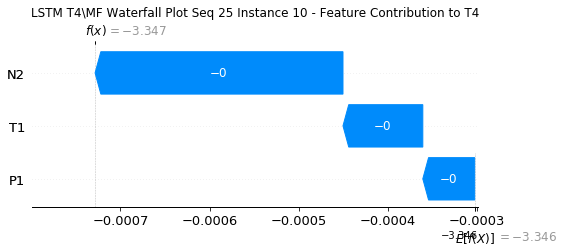

None

Contribution: [-4.58743558e-05  2.54451420e-04 -1.78694672e-04]


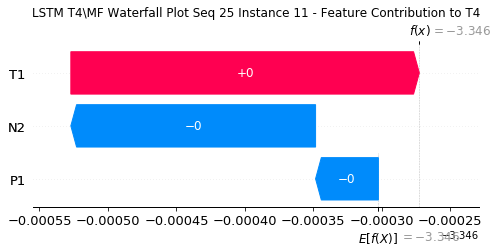

None

Contribution: [4.29192647e-05 7.87043778e-04 1.68941795e-04]


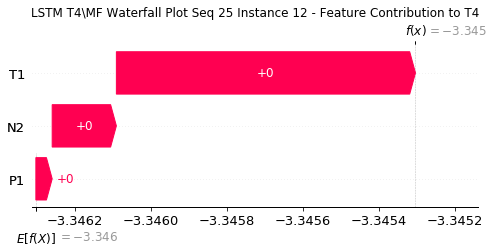

None

Contribution: [0.00013257 0.00113557 0.00051234]


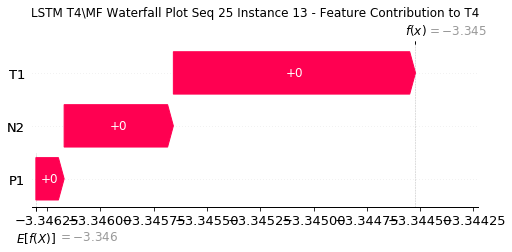

None

Contribution: [0.00014775 0.00087844 0.00038998]


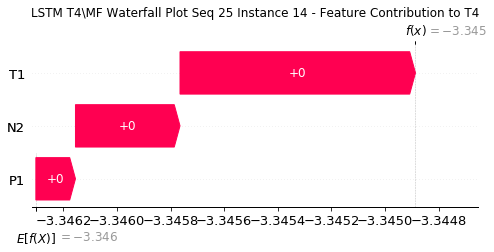

None

Contribution: [-0.00026312 -0.0001844  -0.00038883]


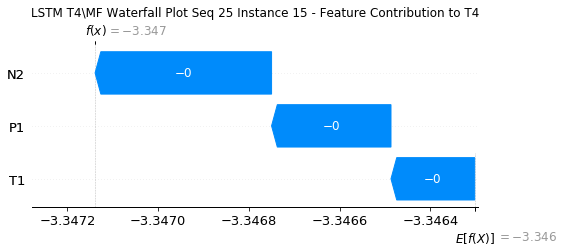

None

Contribution: [-0.00040543 -0.00174371 -0.00139517]


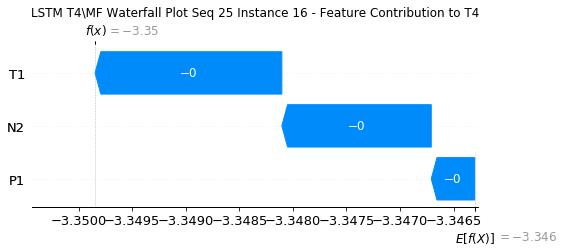

None

Contribution: [-0.00049913 -0.0029021  -0.00154024]


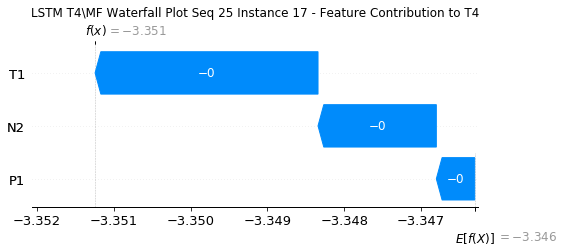

None

Contribution: [ 0.00045521 -0.00194567  0.00016649]


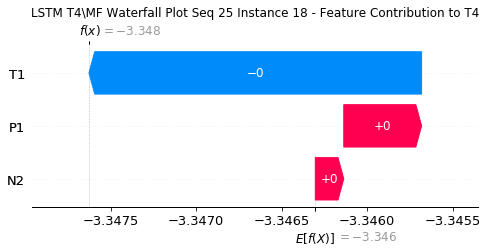

None

Contribution: [0.00121946 0.00025305 0.00300048]


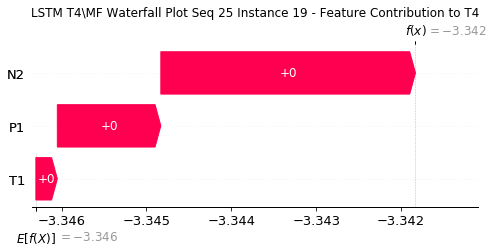

None

Contribution: [0.00149488 0.00489417 0.00420456]


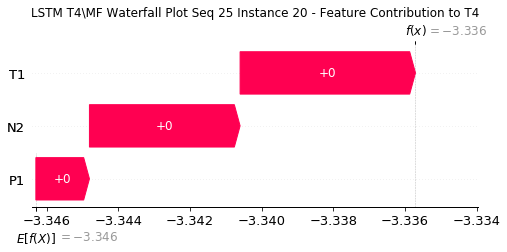

None

Contribution: [0.00044733 0.01062034 0.00041188]


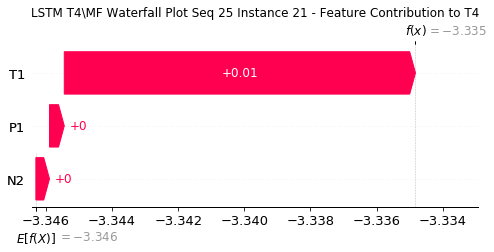

None

Contribution: [-0.00318874  0.01678699 -0.00743378]


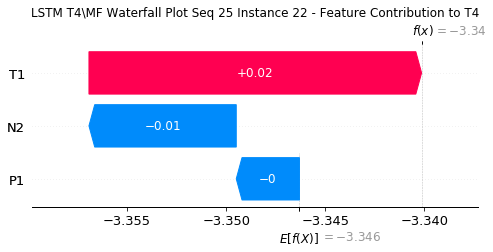

None

Contribution: [-0.00630343  0.01565746 -0.01532077]


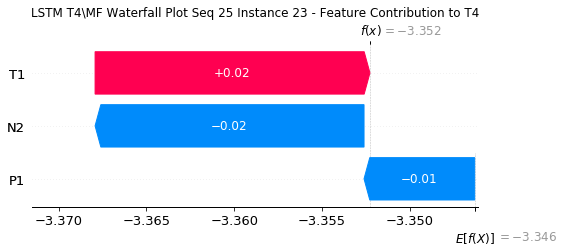

None

Contribution: [-0.00311037  0.00944924 -0.00811505]


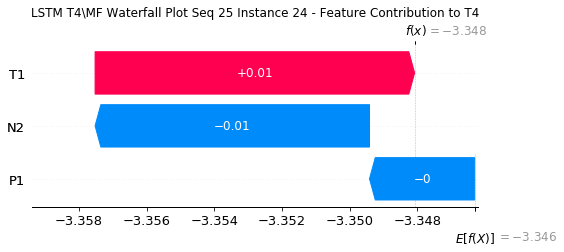

None

Contribution: [-0.00478572  0.03059657 -0.00888292]


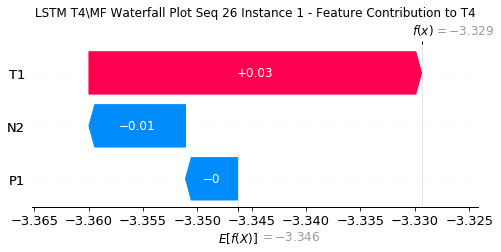

None

Contribution: [ 0.00054286 -0.00175828  0.0012535 ]


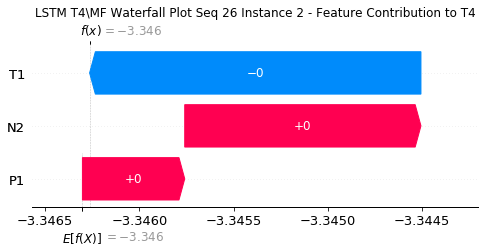

None

Contribution: [-7.21599370e-05  1.14899030e-03 -2.37157206e-05]


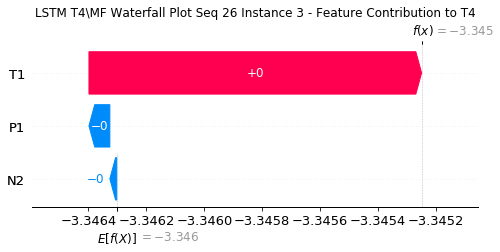

None

Contribution: [ 4.09619930e-06  3.72109250e-04 -3.67637806e-06]


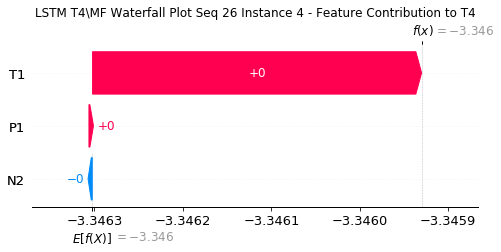

None

Contribution: [-1.40362239e-06  2.39296874e-04  4.05763647e-06]


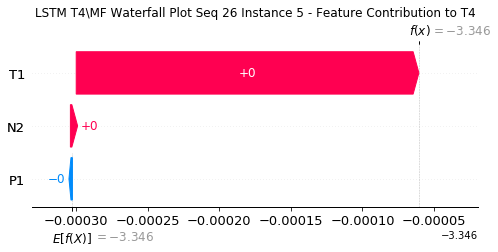

None

Contribution: [1.49103386e-05 1.79591441e-04 6.04108478e-05]


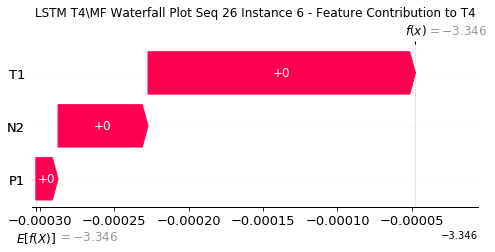

None

Contribution: [3.72299943e-05 6.76268721e-05 7.83528419e-05]


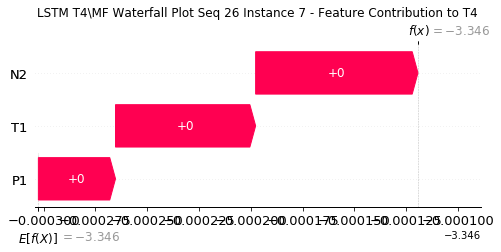

None

Contribution: [ 1.62045979e-05 -7.63628337e-05 -7.39213747e-06]


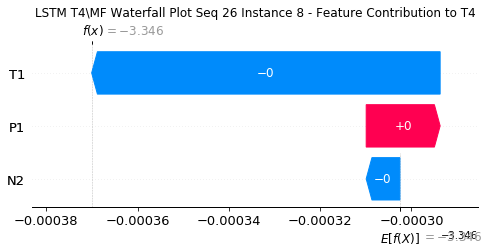

None

Contribution: [-3.71760763e-05 -1.64666843e-04 -1.72079910e-04]


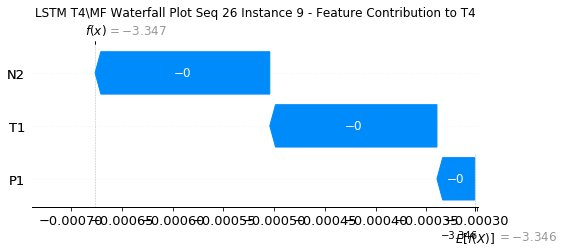

None

Contribution: [-5.68714651e-05 -4.94823640e-05 -2.71405482e-04]


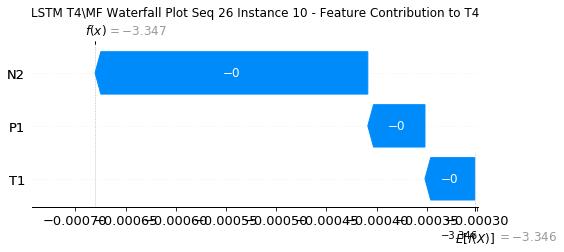

None

Contribution: [-4.52402403e-05  3.02230356e-04 -1.68592277e-04]


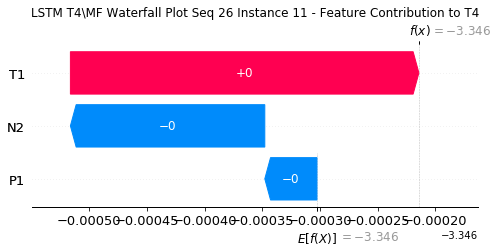

None

Contribution: [4.14024800e-05 8.02827910e-04 1.70498837e-04]


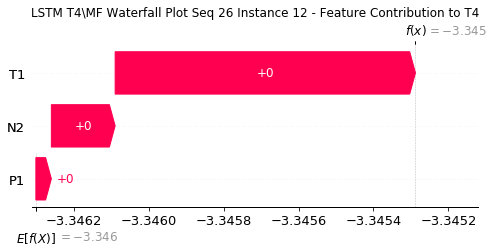

None

Contribution: [0.00010159 0.00105118 0.00049487]


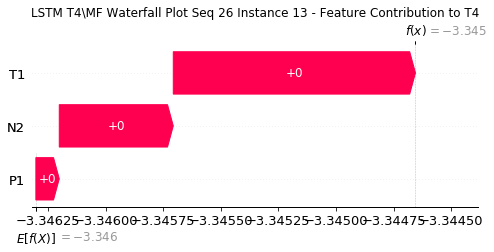

None

Contribution: [0.00013324 0.00077177 0.00036495]


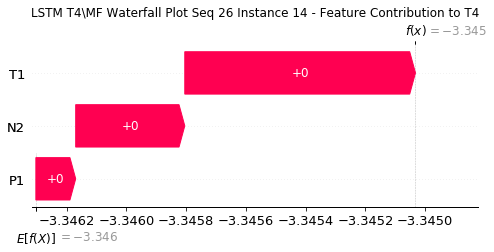

None

Contribution: [-0.00019038 -0.00033942 -0.00037295]


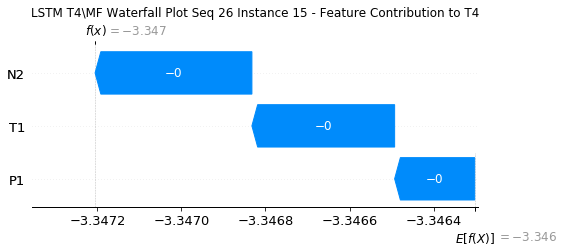

None

Contribution: [-0.00042525 -0.00177328 -0.00140064]


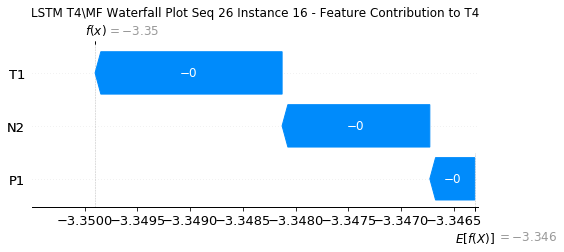

None

Contribution: [-0.00046881 -0.00292426 -0.00152873]


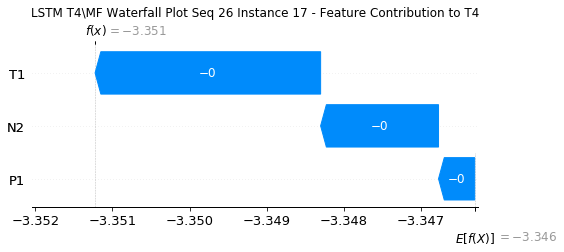

None

Contribution: [ 2.76329828e-04 -2.50649063e-03  3.49096560e-05]


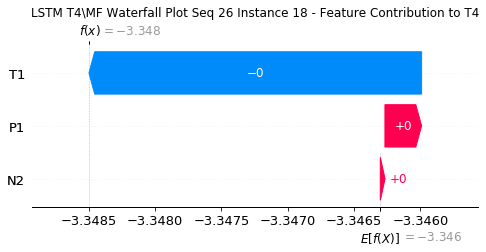

None

Contribution: [ 0.00118649 -0.00026521  0.00291938]


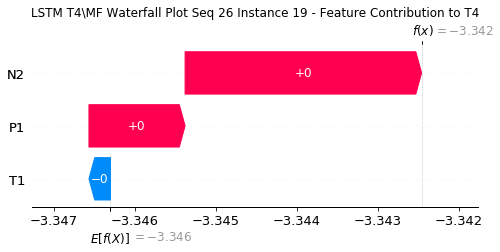

None

Contribution: [0.00147096 0.00465643 0.00415013]


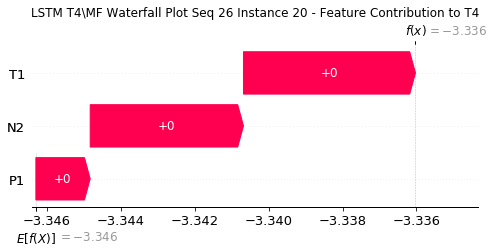

None

Contribution: [0.00054705 0.01179651 0.00054959]


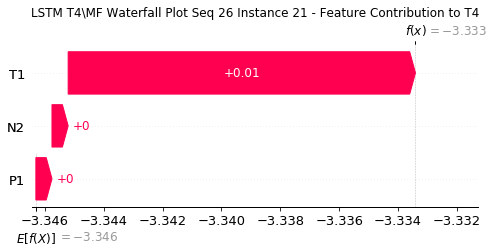

None

Contribution: [-0.00346303  0.01999945 -0.00714651]


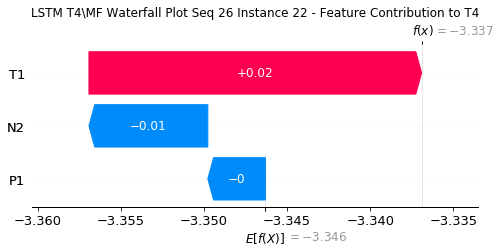

None

Contribution: [-0.00713045  0.01902187 -0.01508348]


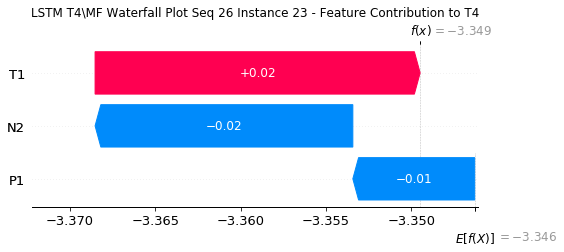

None

Contribution: [-0.00317229  0.01130297 -0.00800702]


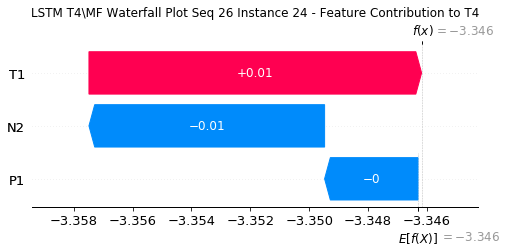

None

Contribution: [-0.00151678  0.04115287 -0.00711234]


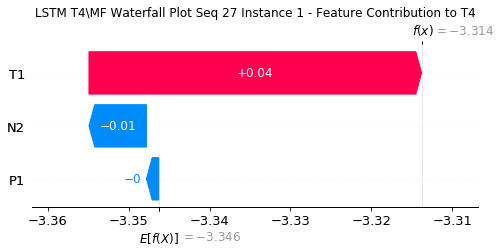

None

Contribution: [ 0.00032164 -0.00238689  0.00117723]


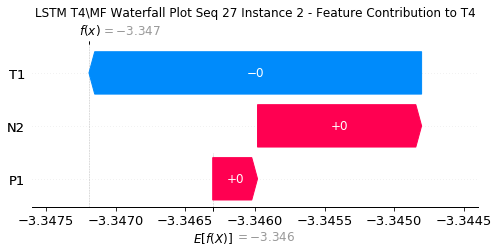

None

Contribution: [-2.03720679e-05  1.21959728e-03 -1.45980517e-05]


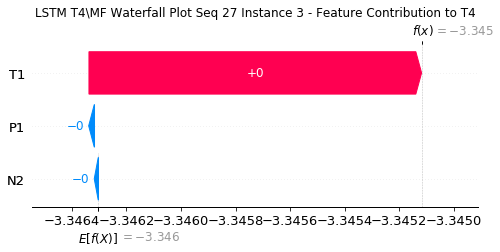

None

Contribution: [-8.26635752e-06  3.70077936e-04 -3.43553204e-06]


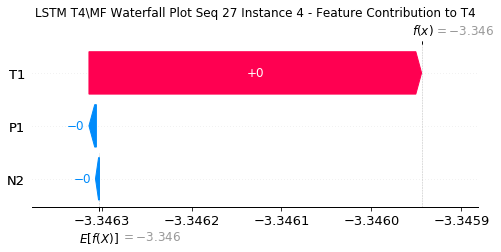

None

Contribution: [-3.01367463e-06  2.42196644e-04  4.25323993e-06]


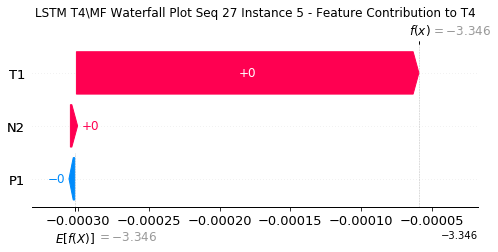

None

Contribution: [1.48904724e-05 1.91383577e-04 6.33491089e-05]


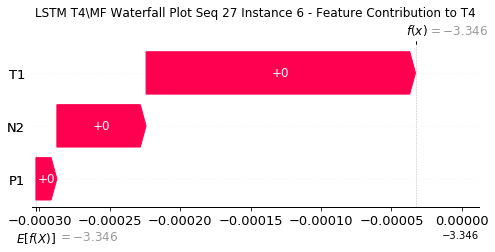

None

Contribution: [3.57417360e-05 7.87301593e-05 8.68662150e-05]


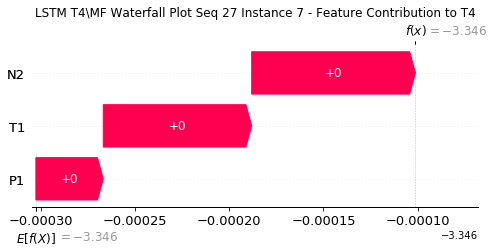

None

Contribution: [ 2.31625252e-05 -8.57734076e-05  7.07051109e-06]


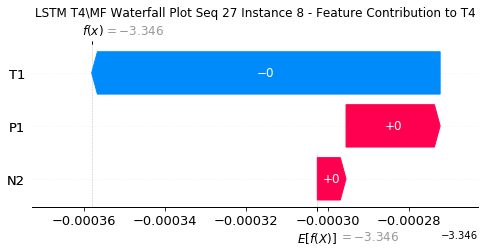

None

Contribution: [-9.17633008e-06 -1.82764157e-04 -1.56692581e-04]


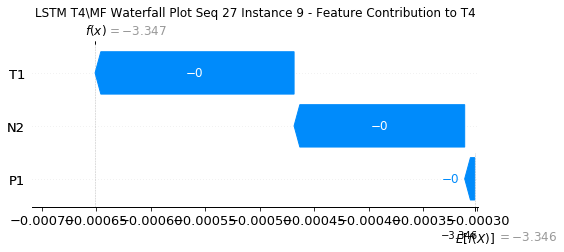

None

Contribution: [-6.09879700e-05 -1.24448646e-04 -2.78147401e-04]


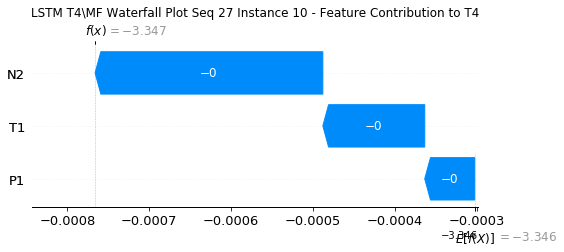

None

Contribution: [-4.10992461e-05  2.63961157e-04 -1.84116943e-04]


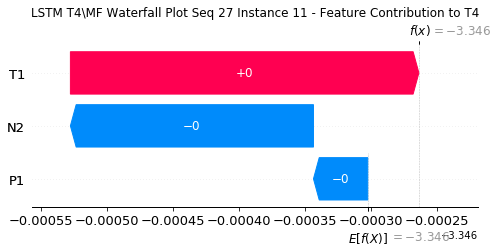

None

Contribution: [4.7462821e-05 8.1014671e-04 1.6300583e-04]


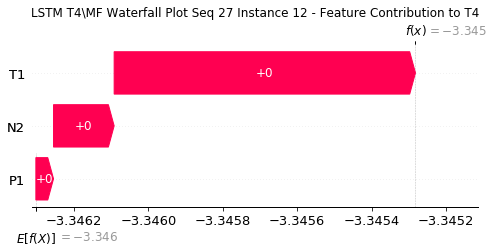

None

Contribution: [0.00012369 0.0011232  0.00051717]


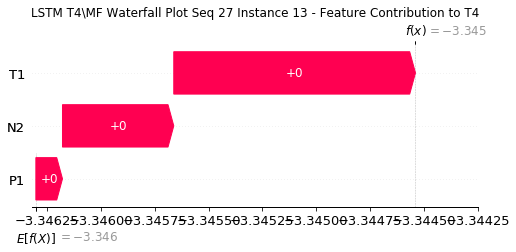

None

Contribution: [0.00014186 0.00082513 0.0004091 ]


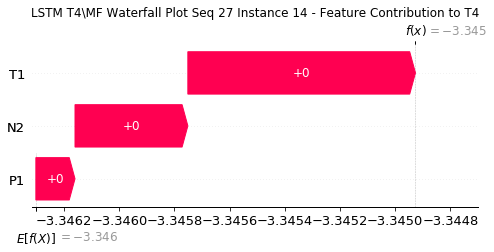

None

Contribution: [-0.00016815 -0.00022225 -0.00030358]


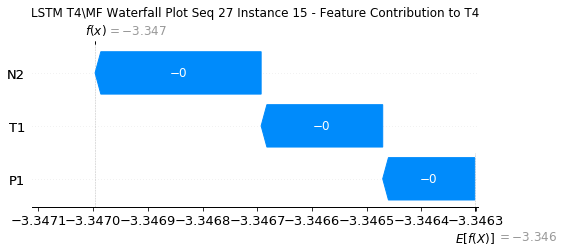

None

Contribution: [-0.00041887 -0.00180039 -0.00138434]


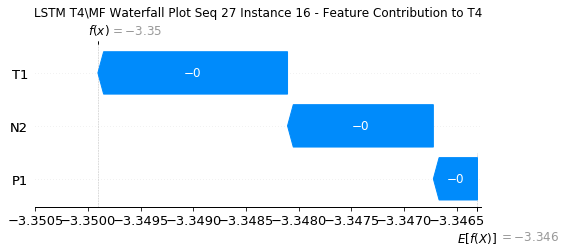

None

Contribution: [-0.00052559 -0.00293166 -0.00159088]


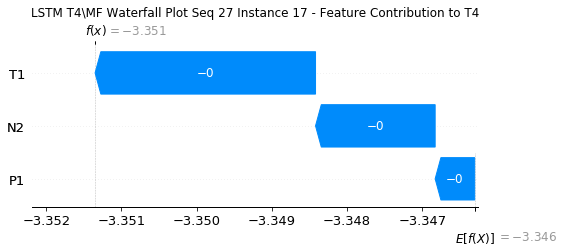

None

Contribution: [ 0.00037216 -0.00205714  0.00010603]


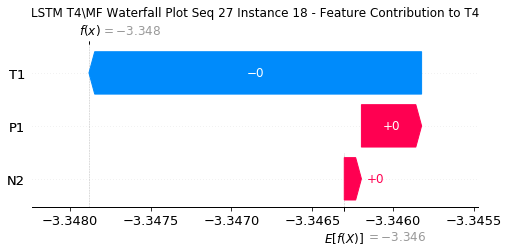

None

Contribution: [ 0.00080594 -0.00025977  0.00272616]


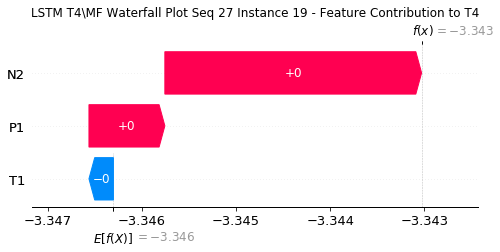

None

Contribution: [0.00128304 0.00447312 0.00410586]


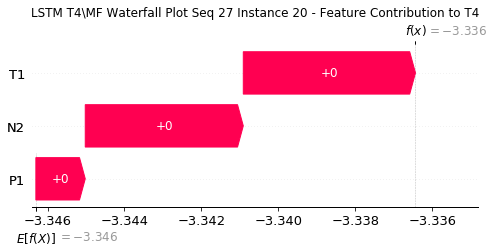

None

Contribution: [0.00130073 0.01108099 0.00090882]


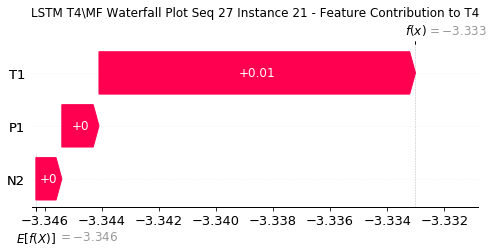

None

Contribution: [-0.00082756  0.01833755 -0.00624643]


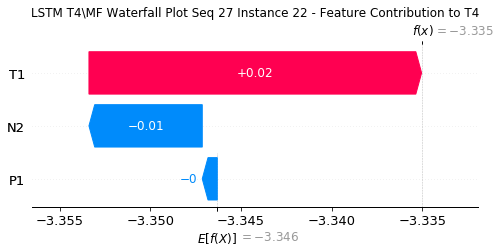

None

Contribution: [-0.00140549  0.01872296 -0.01320454]


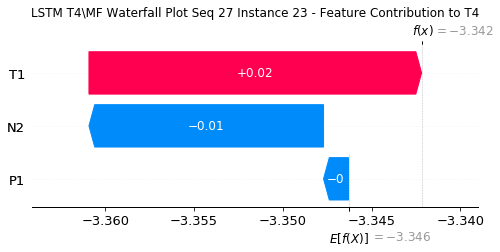

None

Contribution: [-0.00324958  0.01096605 -0.0074898 ]


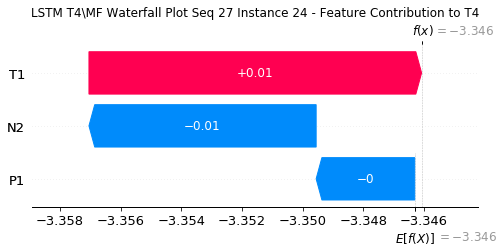

None

Contribution: [-0.0071807   0.03287493 -0.00803766]


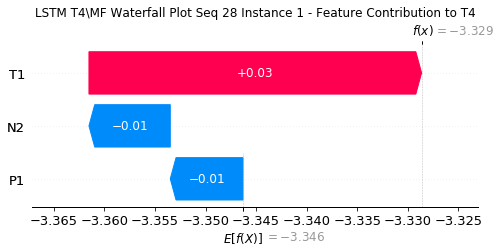

None

Contribution: [ 0.00073069 -0.00184214  0.00118954]


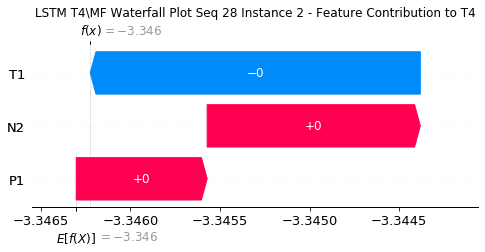

None

Contribution: [-1.15675637e-04  1.09370997e-03 -2.23099987e-05]


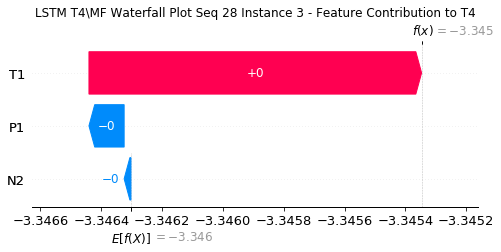

None

Contribution: [-1.85499974e-05  3.09032647e-04 -1.07004883e-05]


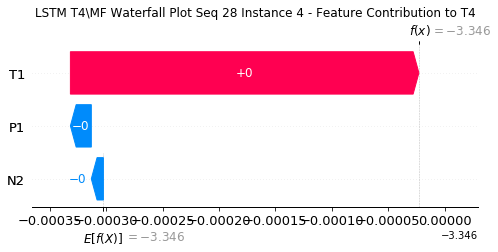

None

Contribution: [-5.89091871e-06  2.45459505e-04 -5.40633757e-07]


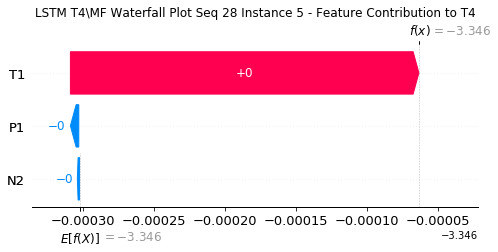

None

Contribution: [1.14530180e-05 2.08360529e-04 5.84195552e-05]


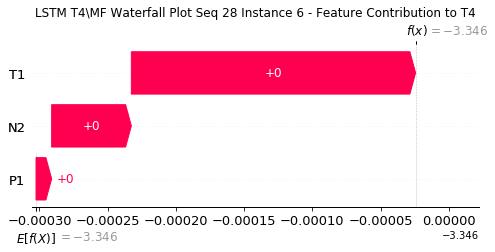

None

Contribution: [3.05364924e-05 8.54147808e-05 8.33752004e-05]


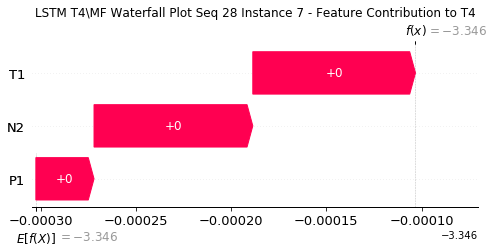

None

Contribution: [ 8.15001681e-06 -8.99692279e-05  6.65469801e-06]


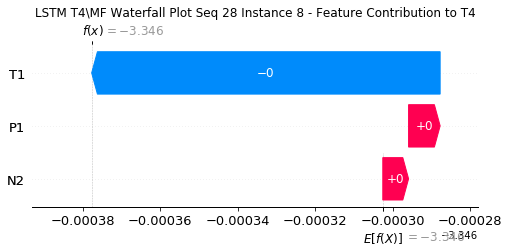

None

Contribution: [-2.79934215e-05 -2.30064745e-04 -1.61671190e-04]


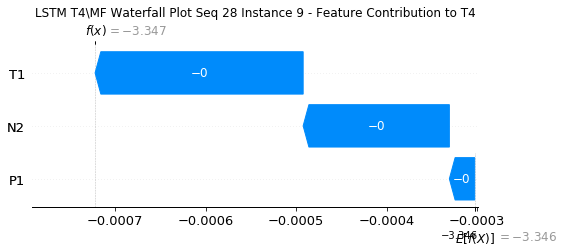

None

Contribution: [-5.93586913e-05 -1.64119669e-04 -2.81250930e-04]


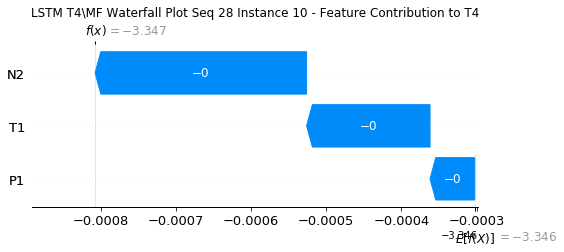

None

Contribution: [-2.54635771e-05  2.29831391e-04 -1.87468724e-04]


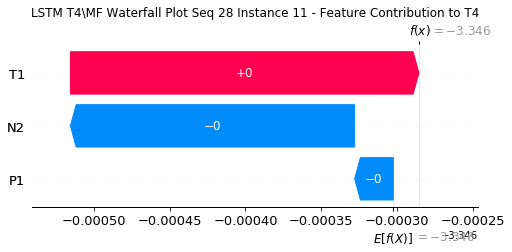

None

Contribution: [7.20292919e-05 7.86682401e-04 1.63573832e-04]


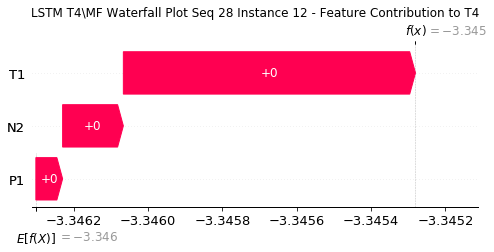

None

Contribution: [0.00013353 0.00119772 0.00052074]


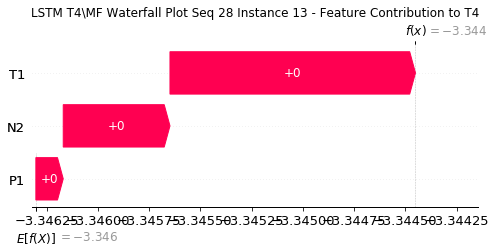

None

Contribution: [-3.35297731e-05  1.23693439e-03  3.87715326e-04]


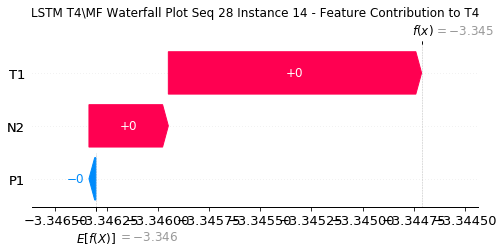

None

Contribution: [-0.00019218  0.00062172 -0.00032274]


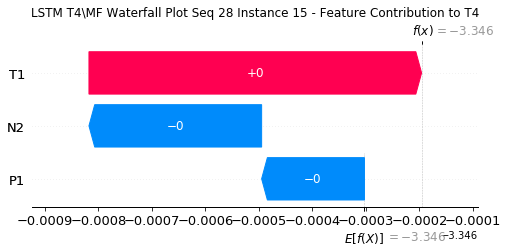

None

Contribution: [-0.00070752 -0.00115165 -0.00144289]


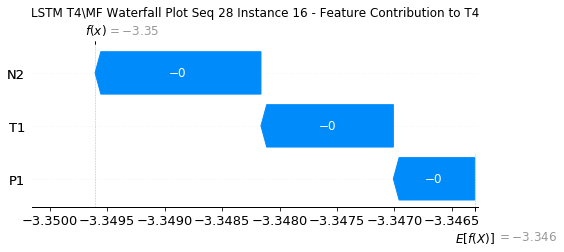

None

Contribution: [-0.00024657 -0.00411101 -0.00159174]


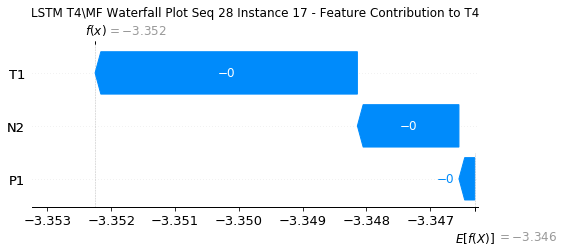

None

Contribution: [-0.00038038 -0.00466909 -0.00026223]


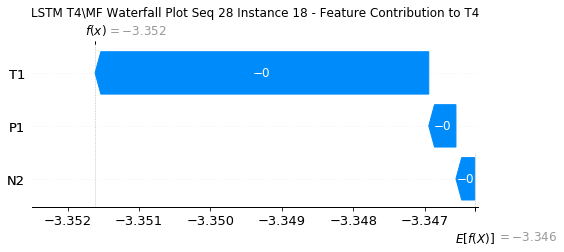

None

Contribution: [ 0.00404386 -0.00959483  0.003265  ]


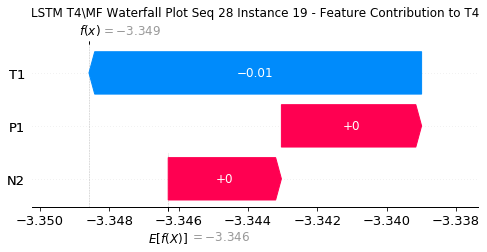

None

Contribution: [ 0.00315385 -0.00147254  0.00448808]


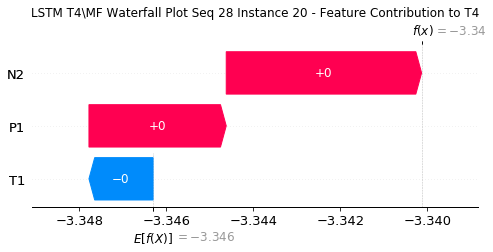

None

Contribution: [-0.00282387  0.02121483  0.00023378]


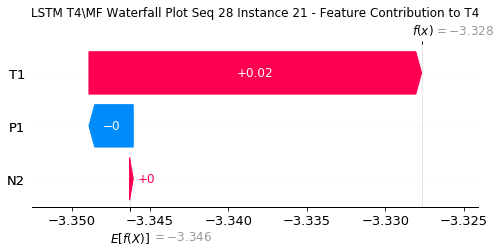

None

Contribution: [-0.01243683  0.052786   -0.00826945]


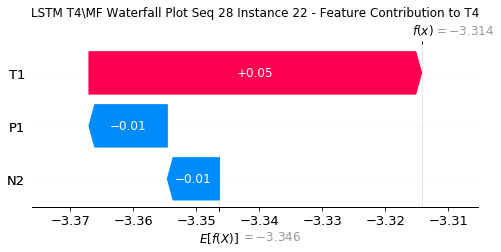

None

Contribution: [-0.02259246  0.07214519 -0.01746993]


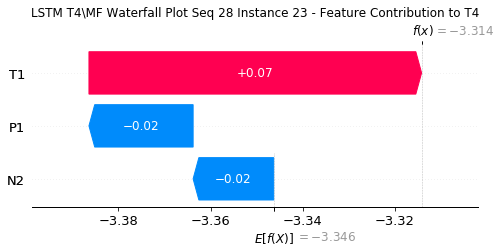

None

Contribution: [-0.01267183  0.04011409 -0.00951177]


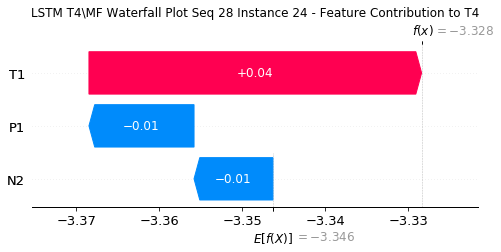

None

Contribution: [-0.01721084  0.09138758 -0.00926227]


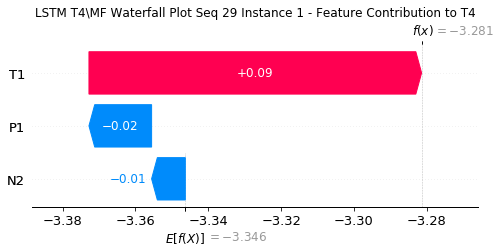

None

Contribution: [ 0.00239202 -0.00679082  0.00150989]


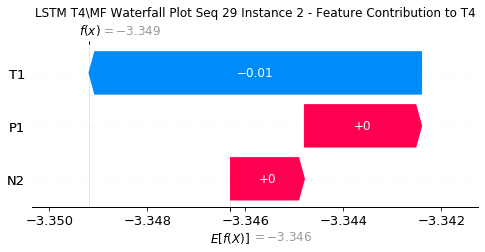

None

Contribution: [-5.47363876e-04  2.43996016e-03 -7.98631572e-05]


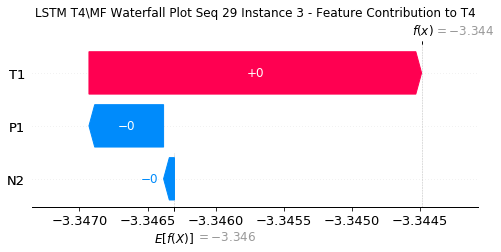

None

Contribution: [-5.27329400e-05  4.06139317e-04 -1.38246688e-05]


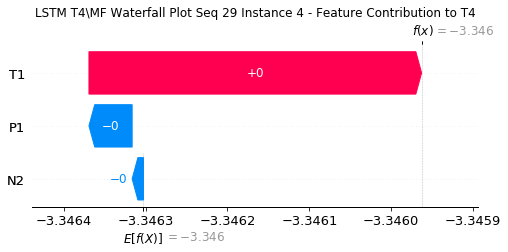

None

Contribution: [ 6.33072259e-05 -8.74145446e-06  2.07410877e-05]


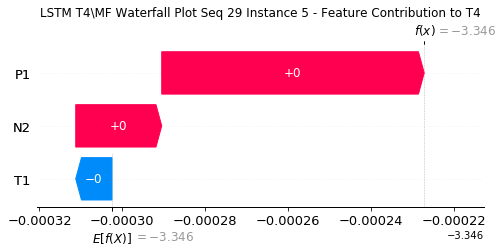

None

Contribution: [ 5.25658152e-05 -4.04237786e-05  9.06651077e-05]


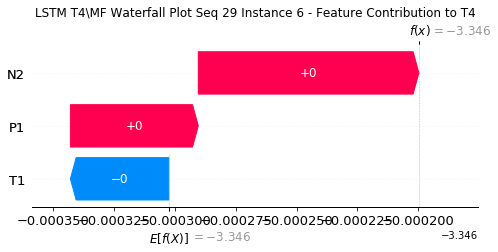

None

Contribution: [2.66850962e-05 1.60997774e-04 1.20928842e-04]


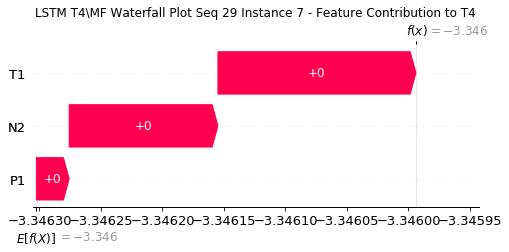

None

Contribution: [-9.68105006e-05  3.02146639e-04  1.21783294e-05]


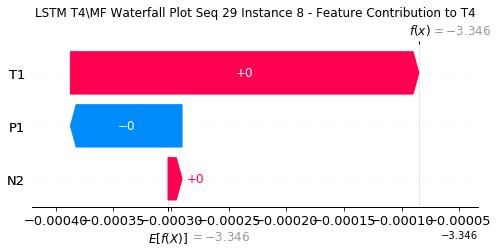

None

Contribution: [-1.91458731e-04  5.48201409e-05 -1.92825139e-04]


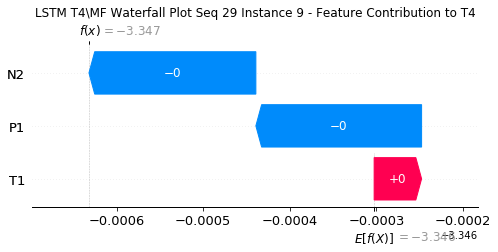

None

Contribution: [-4.05221710e-05 -4.05868504e-04 -3.01093986e-04]


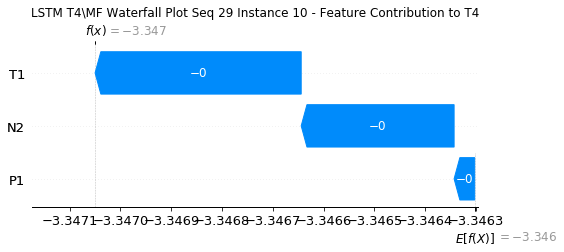

None

Contribution: [ 0.00017059 -0.00060818 -0.00019189]


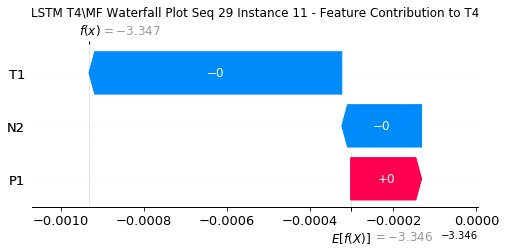

None

Contribution: [ 3.04060344e-04 -8.85699364e-05  1.91167744e-04]


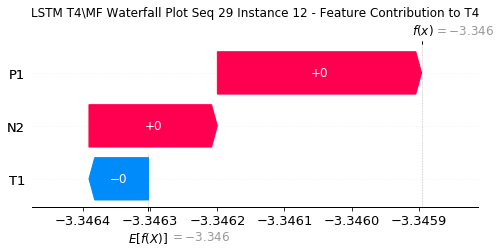

None

Contribution: [0.00018455 0.00117294 0.00056743]


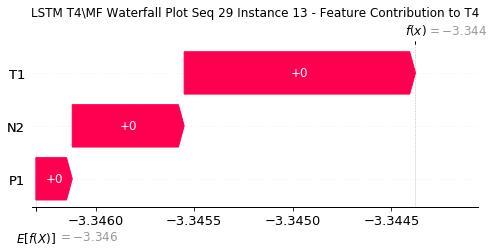

None

Contribution: [-0.00024698  0.00248902  0.00042686]


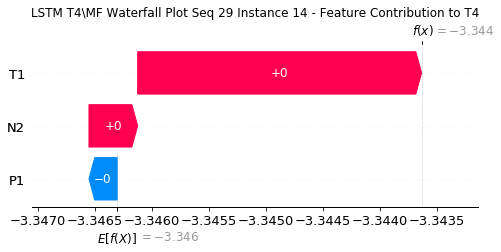

None

Contribution: [-0.00047534  0.00142455 -0.00026528]


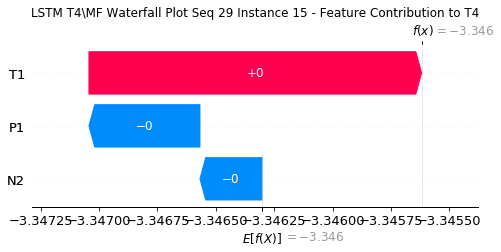

None

Contribution: [-0.00088136 -0.00023073 -0.00147761]


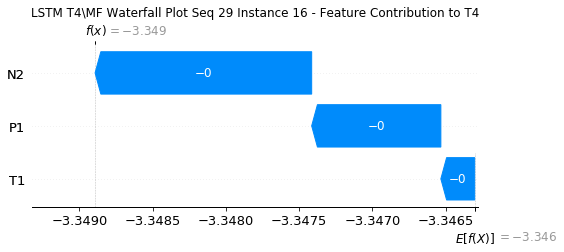

None

Contribution: [-0.00032134 -0.0041673  -0.00163547]


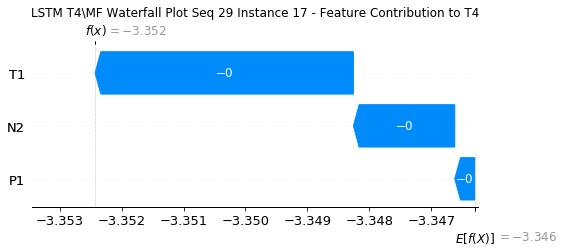

None

Contribution: [-0.0006651  -0.00546707 -0.00027976]


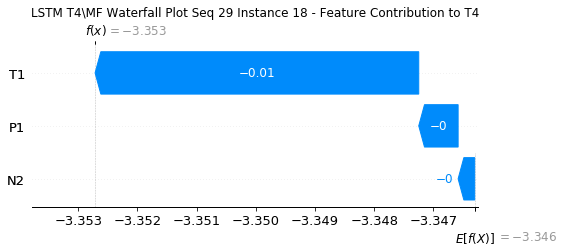

None

Contribution: [ 0.00112478 -0.00527846  0.00296871]


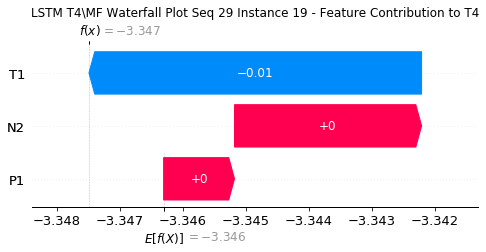

None

Contribution: [0.00143629 0.00146672 0.00439394]


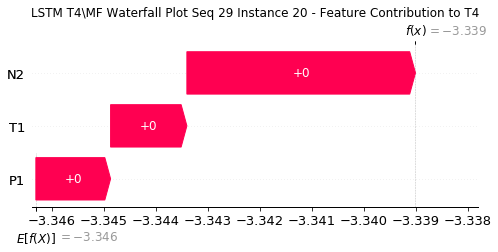

None

Contribution: [0.00091548 0.01306968 0.00071717]


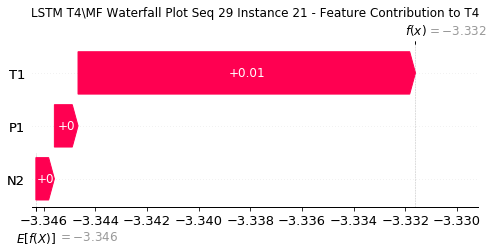

None

Contribution: [-0.00259651  0.02522937 -0.00732401]


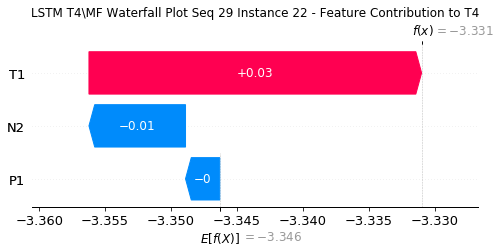

None

Contribution: [-0.00172293  0.02981266 -0.01462048]


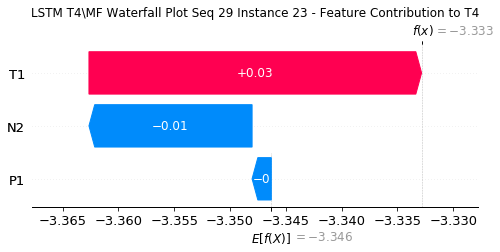

None

Contribution: [ 0.00195562  0.02337317 -0.00715574]


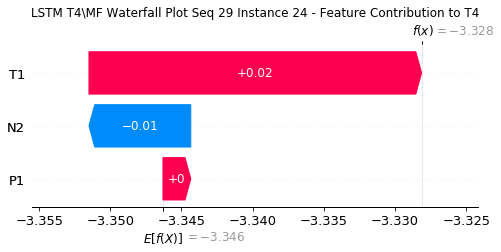

None

Contribution: [-0.00226954  0.03832868 -0.00870763]


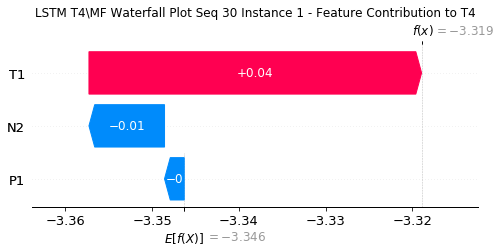

None

Contribution: [ 0.00056111 -0.00275853  0.00128762]


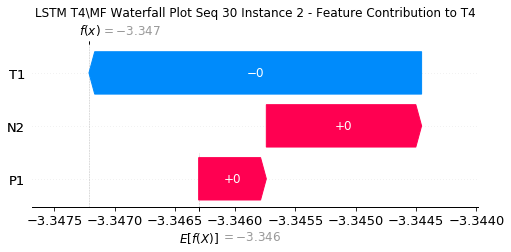

None

Contribution: [-1.05629691e-04  1.11763603e-03 -2.66710622e-05]


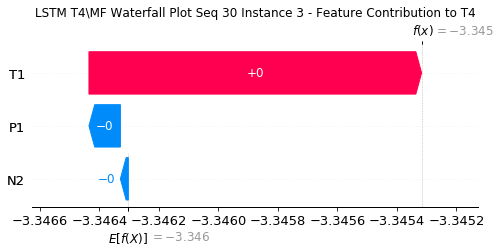

None

Contribution: [-2.01837346e-06  3.51133077e-04 -5.56476944e-06]


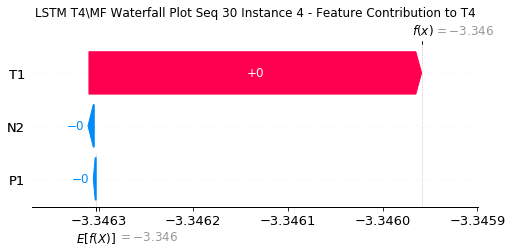

None

Contribution: [-2.57469536e-06  2.47348205e-04  3.07704697e-06]


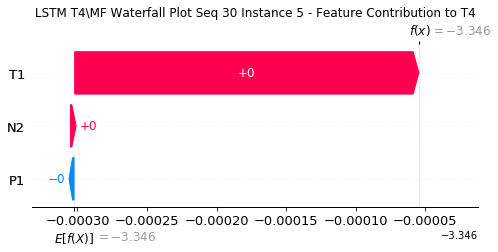

None

Contribution: [1.49102585e-05 1.96368830e-04 6.27823872e-05]


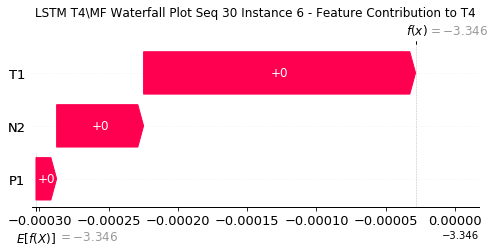

None

Contribution: [3.69103509e-05 7.92933521e-05 8.56465844e-05]


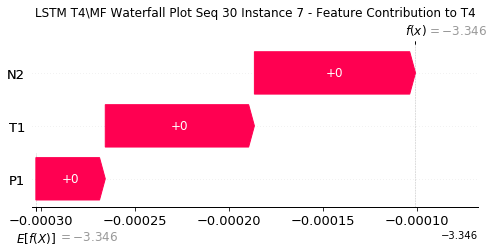

None

Contribution: [ 2.37792478e-05 -7.52651100e-05  5.46892900e-06]


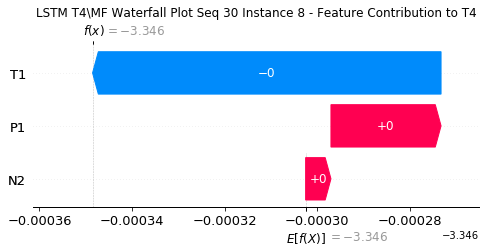

None

Contribution: [-1.16730227e-05 -1.92932991e-04 -1.62653738e-04]


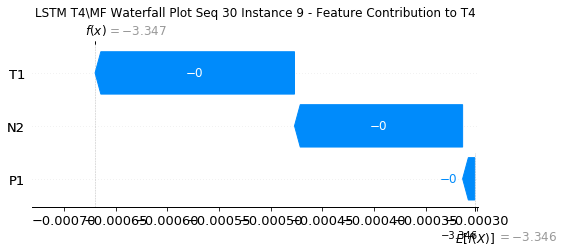

None

Contribution: [-6.04611267e-05 -1.29984786e-04 -2.80009128e-04]


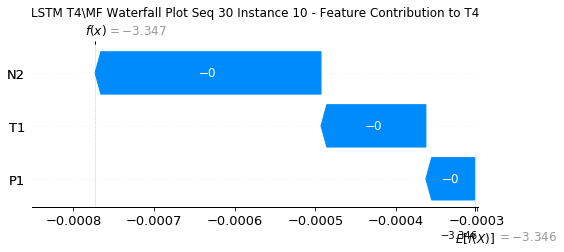

None

Contribution: [-5.20955948e-05  2.29786677e-04 -1.85714594e-04]


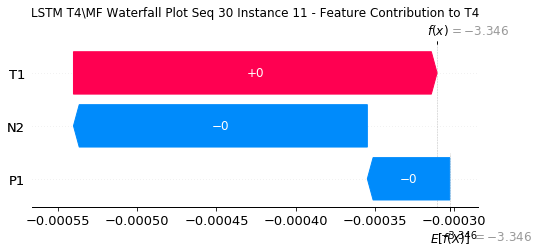

None

Contribution: [3.74115435e-05 7.87360814e-04 1.63352620e-04]


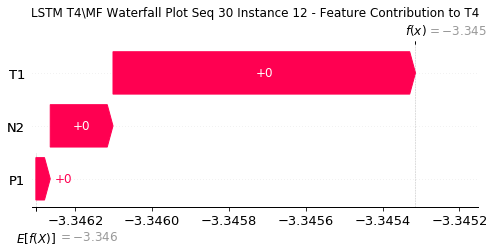

None

Contribution: [0.00013059 0.00117708 0.00051725]


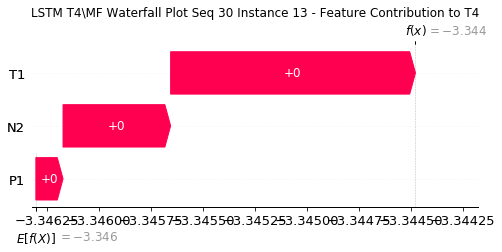

None

Contribution: [0.00017491 0.00097583 0.00040221]


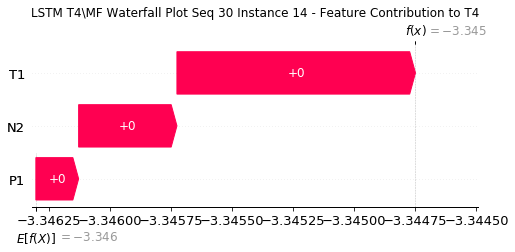

None

Contribution: [-0.00017298 -0.00020927 -0.00034102]


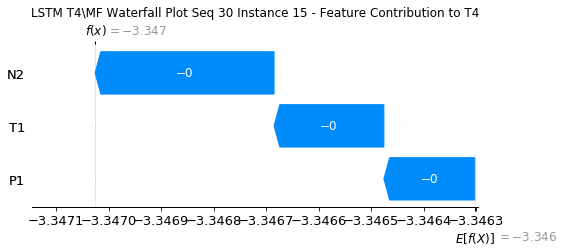

None

Contribution: [-0.00039226 -0.00168374 -0.00139062]


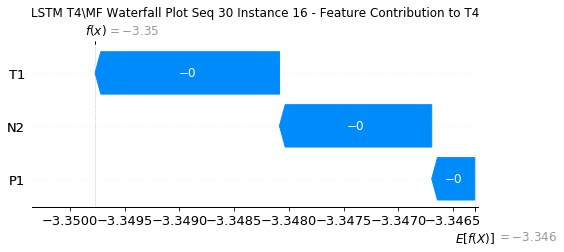

None

Contribution: [-0.00053093 -0.00313961 -0.00156526]


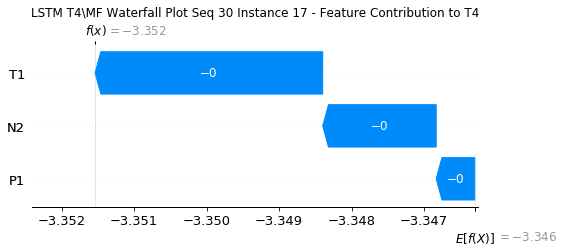

None

Contribution: [ 1.92977621e-04 -3.49569955e-03 -6.01589823e-05]


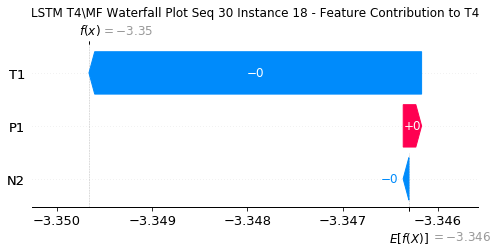

None

Contribution: [ 0.00101432 -0.00033088  0.00297529]


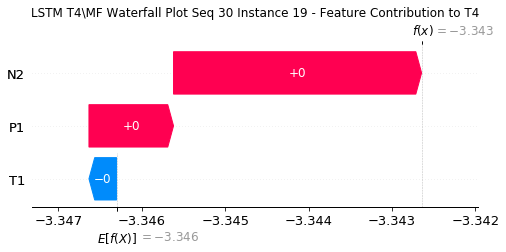

None

Contribution: [0.00141654 0.00458192 0.00422093]


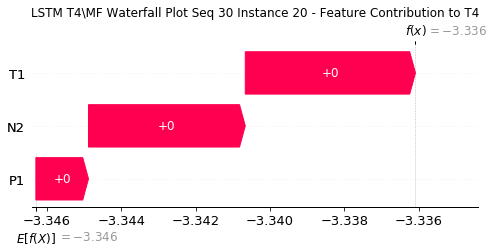

None

Contribution: [0.00083124 0.01148919 0.00038767]


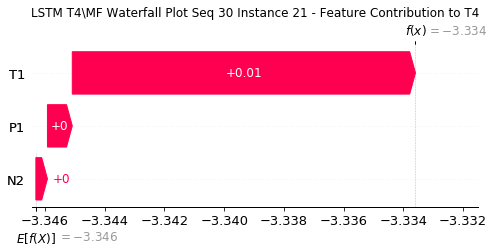

None

Contribution: [-0.00227316  0.0208051  -0.00749748]


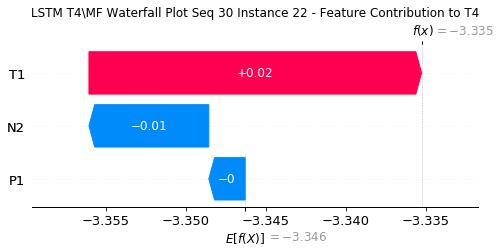

None

Contribution: [-0.003771    0.01926766 -0.01494388]


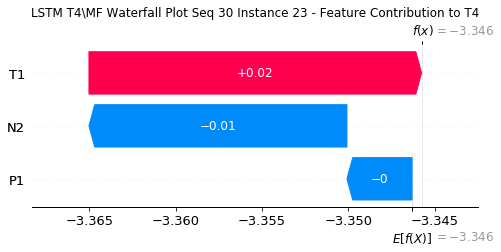

None

Contribution: [-0.00097813  0.0106522  -0.00807115]


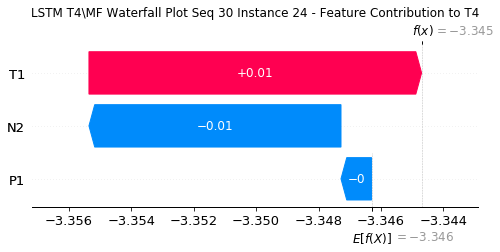

None

Contribution: [-0.00372058  0.03796824 -0.0106741 ]


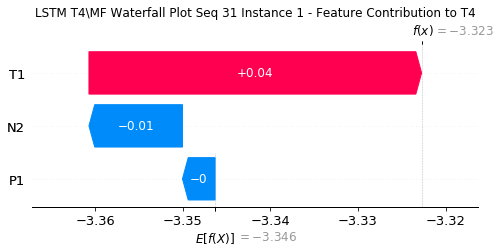

None

Contribution: [ 0.0003017  -0.00233456  0.00135805]


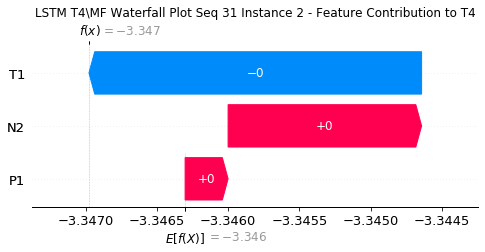

None

Contribution: [ 7.61341467e-05  1.24089352e-03 -1.57562990e-05]


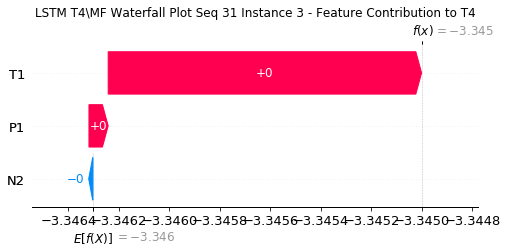

None

Contribution: [-1.80221633e-05  3.62243612e-04 -1.55253423e-05]


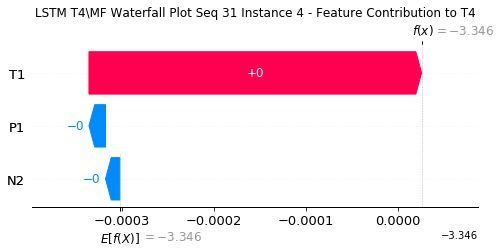

None

Contribution: [-5.60822733e-06  2.47916518e-04  1.60470645e-06]


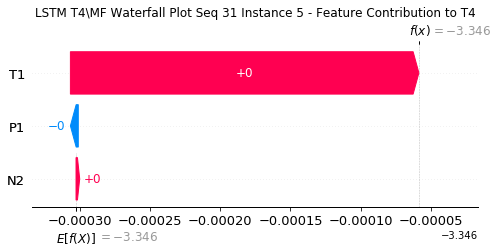

None

Contribution: [1.37144799e-05 1.95498787e-04 5.98355385e-05]


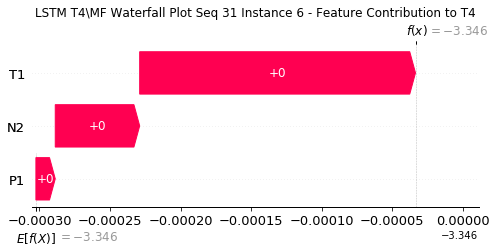

None

Contribution: [3.33371708e-05 7.52428117e-05 7.98996448e-05]


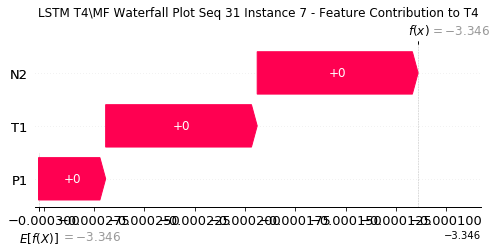

None

Contribution: [ 2.71436883e-05 -7.83063842e-05  3.23043847e-06]


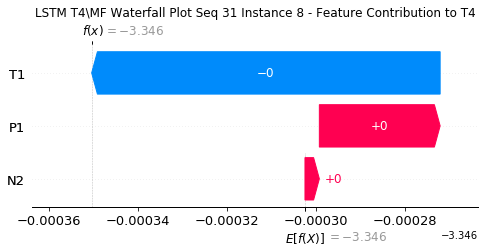

None

Contribution: [-6.65909556e-06 -2.00588507e-04 -1.58644768e-04]


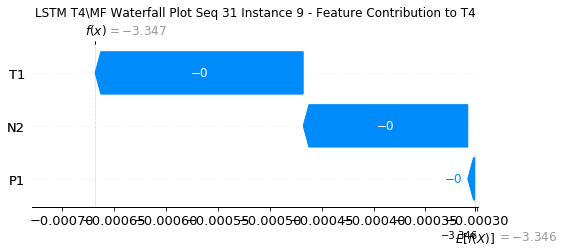

None

Contribution: [-6.05877779e-05 -1.17130983e-04 -2.73756085e-04]


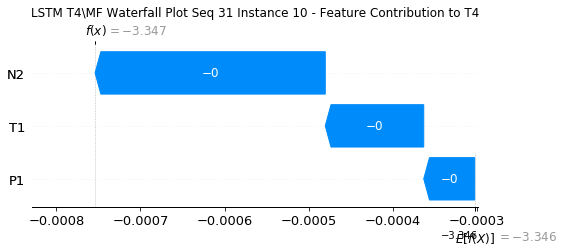

None

Contribution: [-3.68750721e-05  2.68841217e-04 -1.72014866e-04]


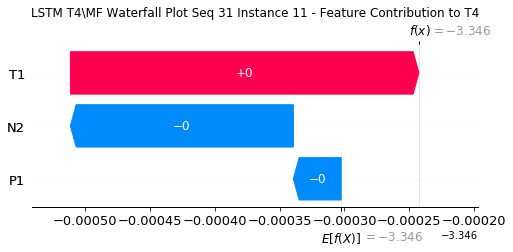

None

Contribution: [4.93288930e-05 8.05993054e-04 1.70449937e-04]


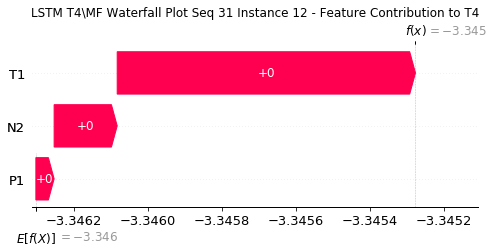

None

Contribution: [0.00011102 0.00113487 0.00050128]


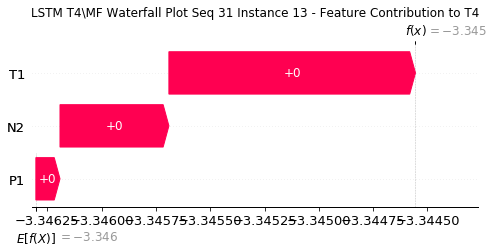

None

Contribution: [0.00011604 0.00090104 0.00036596]


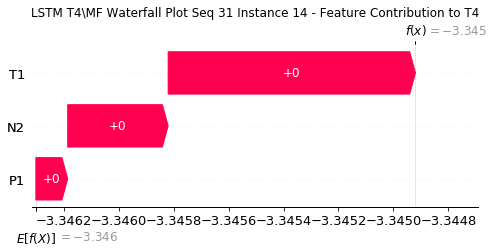

None

Contribution: [-1.00374858e-04 -7.81182053e-05 -3.92460748e-04]


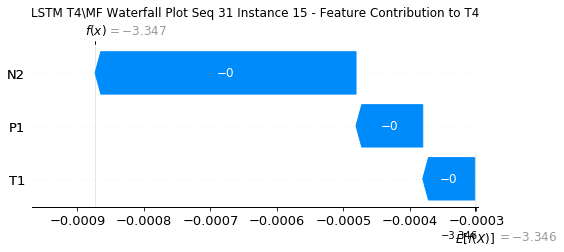

None

Contribution: [-0.00043088 -0.00167599 -0.00140437]


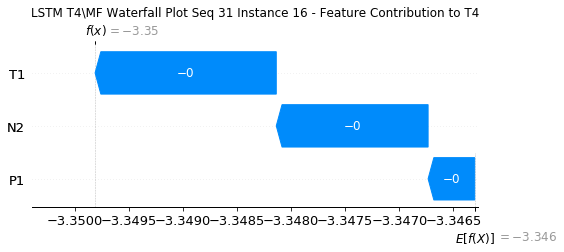

None

Contribution: [-0.00050561 -0.00308487 -0.00155802]


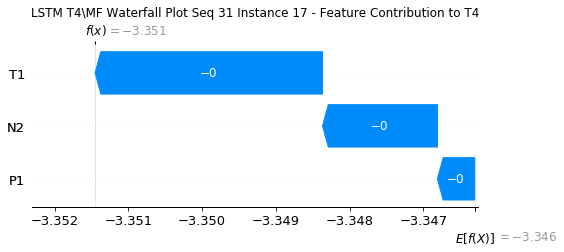

None

Contribution: [ 0.00054374 -0.00254556  0.00019015]


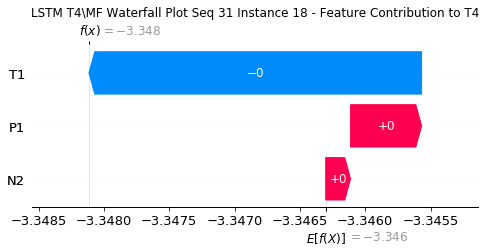

None

Contribution: [ 0.00097302 -0.00121281  0.00290989]


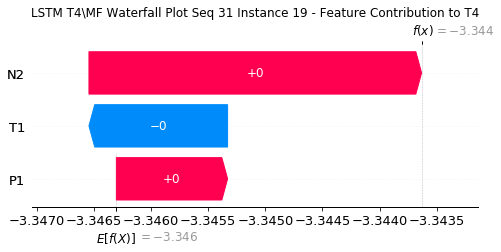

None

Contribution: [0.00136422 0.00409049 0.00418782]


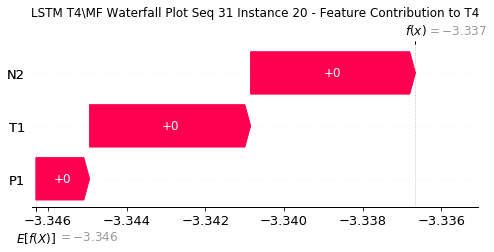

None

Contribution: [0.00096532 0.01262949 0.00054748]


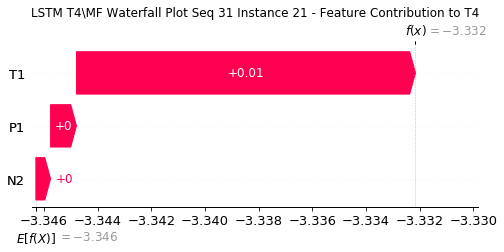

None

Contribution: [-0.00171363  0.02305295 -0.00705236]


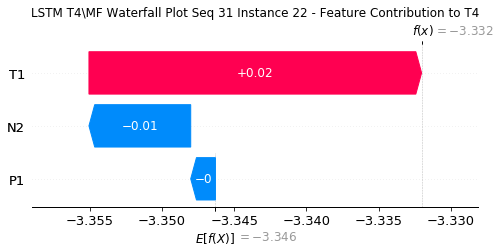

None

Contribution: [-0.00285652  0.02553816 -0.01450034]


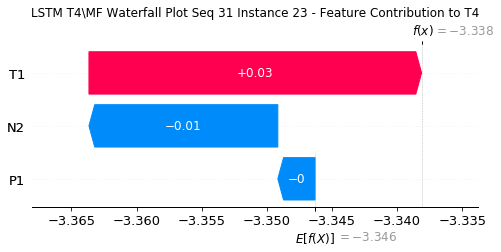

None

Contribution: [-0.00263389  0.01184159 -0.00961144]


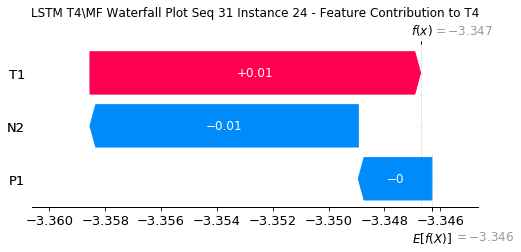

None

Contribution: [-0.00697416  0.0369701  -0.01322563]


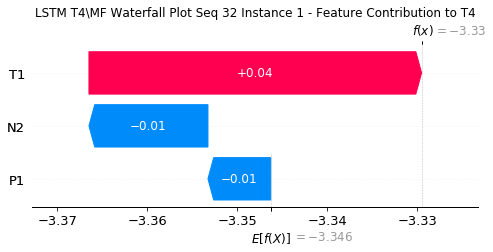

None

Contribution: [ 0.00079472 -0.00256517  0.0016609 ]


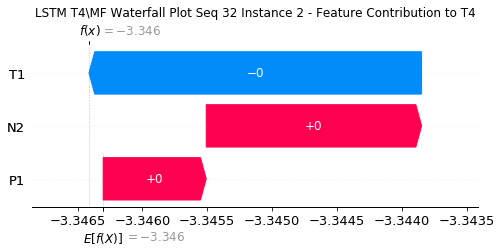

None

Contribution: [-0.00013747  0.00156039 -0.00015287]


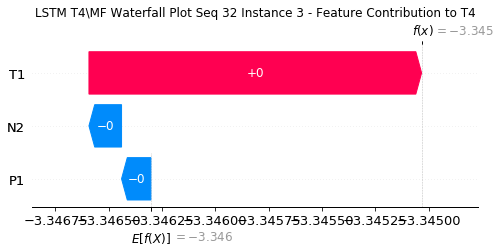

None

Contribution: [-4.03104161e-06  3.84184772e-04 -1.74868893e-05]


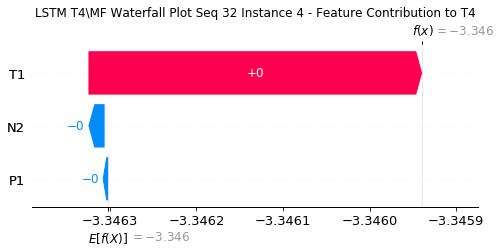

None

Contribution: [-2.54381518e-06  2.41788362e-04  2.89016206e-06]


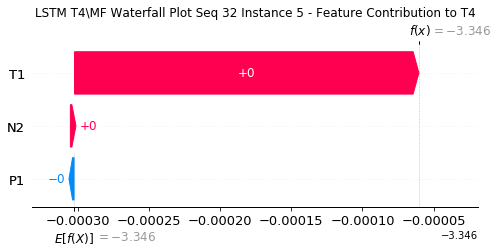

None

Contribution: [1.43672413e-05 1.83260273e-04 6.17401870e-05]


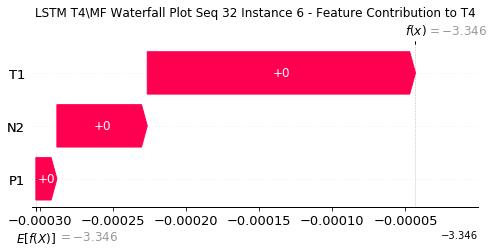

None

Contribution: [3.75524971e-05 7.95390172e-05 8.08937857e-05]


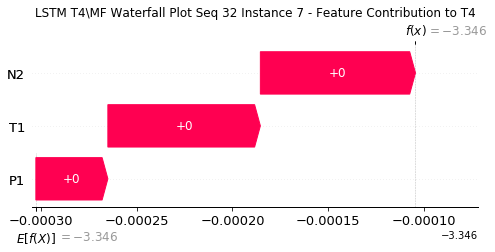

None

Contribution: [ 1.66703742e-05 -7.07123265e-05 -1.31466352e-05]


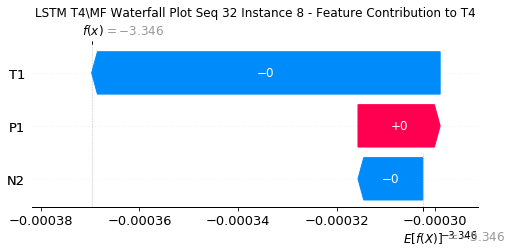

None

Contribution: [-2.83373553e-05 -1.84854152e-04 -1.79376649e-04]


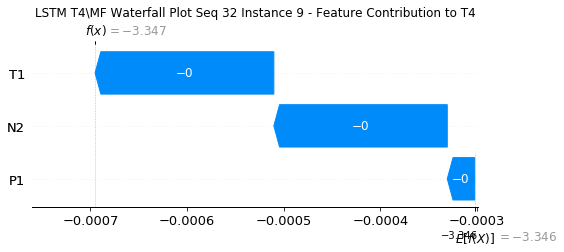

None

Contribution: [-5.95902948e-05 -7.64710215e-05 -2.74173574e-04]


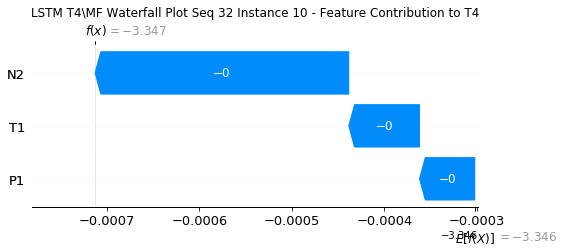

None

Contribution: [-4.69913955e-05  2.54493474e-04 -1.63351853e-04]


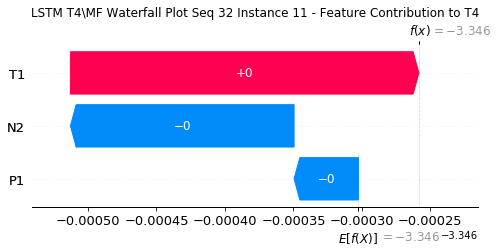

None

Contribution: [4.24095609e-05 7.79684801e-04 1.80908198e-04]


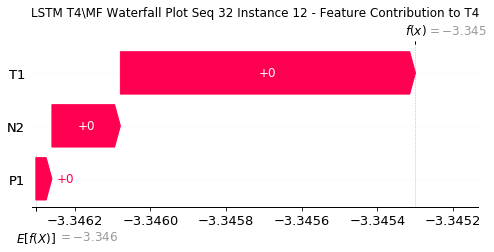

None

Contribution: [0.00012988 0.00117456 0.0004981 ]


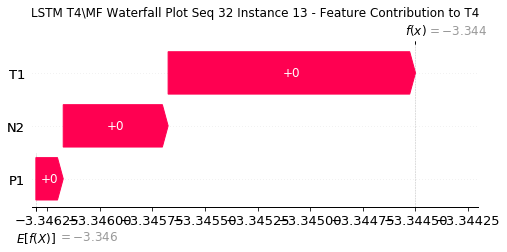

None

Contribution: [0.00015068 0.0010279  0.00032029]


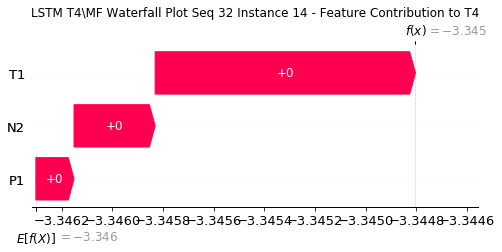

None

Contribution: [ 0.00010019  0.00044686 -0.00036339]


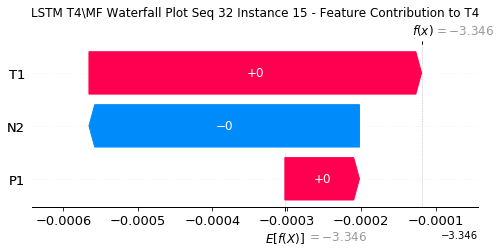

None

Contribution: [-0.00041371 -0.00157618 -0.00146698]


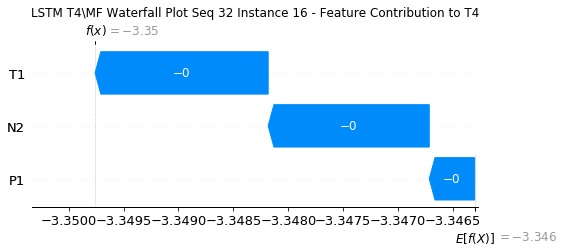

None

Contribution: [-0.00052478 -0.00327698 -0.00145913]


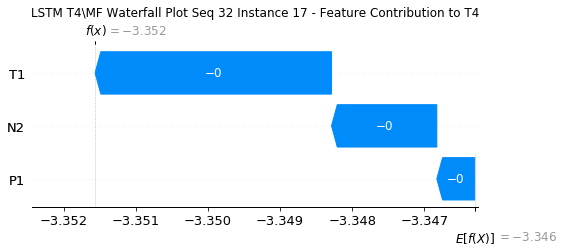

None

Contribution: [ 0.00011779 -0.00408706  0.00051373]


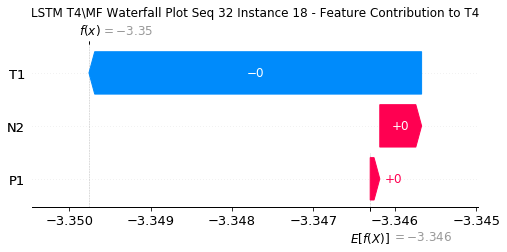

None

Contribution: [ 0.00102134 -0.00216327  0.00344094]


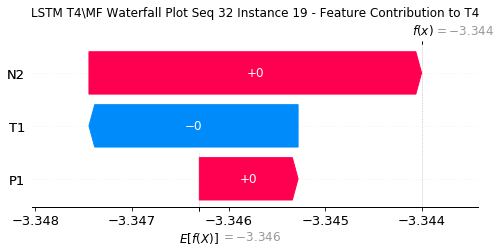

None

Contribution: [0.00139236 0.00371742 0.0044278 ]


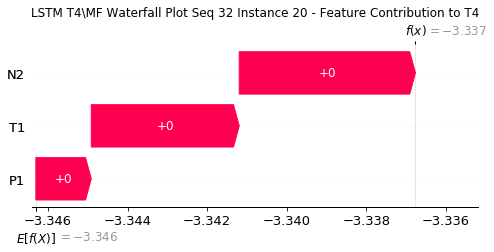

None

Contribution: [ 0.00082793  0.01387676 -0.0001864 ]


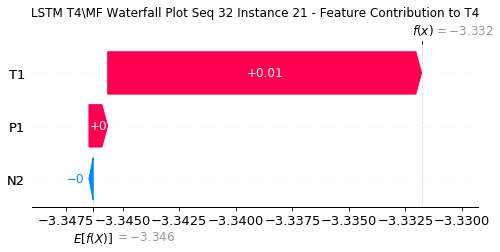

None

Contribution: [-0.00201344  0.0261945  -0.00924507]


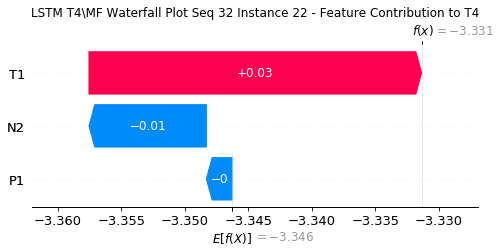

None

Contribution: [-0.00431453  0.02866623 -0.01776127]


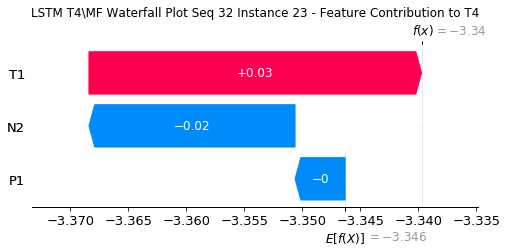

None

Contribution: [-0.0025626   0.01101623 -0.00956747]


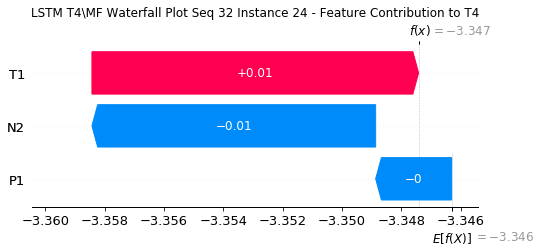

None

Contribution: [-0.00299294  0.03885283 -0.01165601]


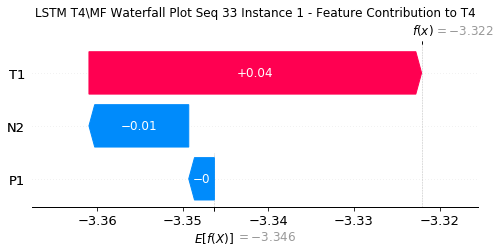

None

Contribution: [ 0.00047299 -0.00261445  0.00153775]


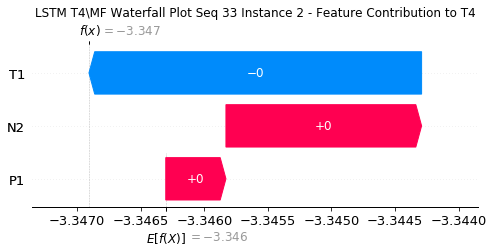

None

Contribution: [-2.03638314e-05  1.39958328e-03 -1.01853520e-04]


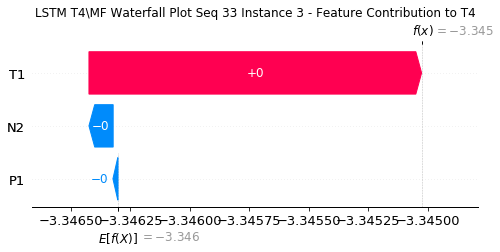

None

Contribution: [ 1.20930440e-05  3.91655750e-04 -1.59235009e-05]


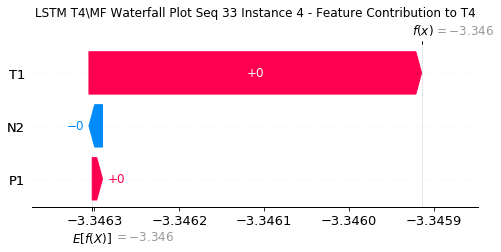

None

Contribution: [-3.20527439e-06  2.39105364e-04  2.50096572e-06]


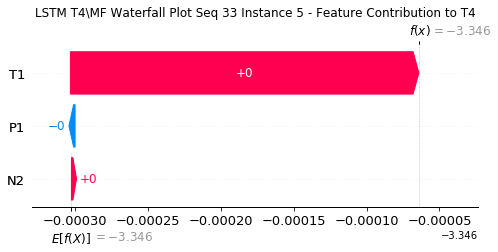

None

Contribution: [1.15888558e-05 2.03590566e-04 6.62960910e-05]


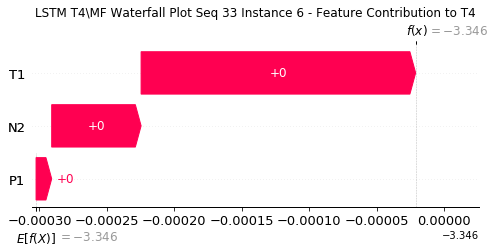

None

Contribution: [4.20481809e-05 1.15638729e-04 9.59230391e-05]


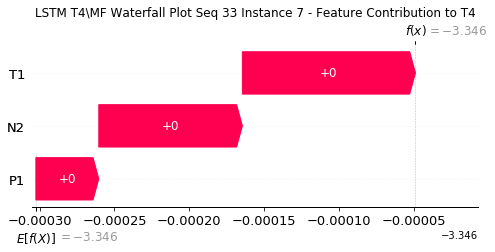

None

Contribution: [ 2.26622944e-05 -1.78753129e-05  1.17818834e-05]


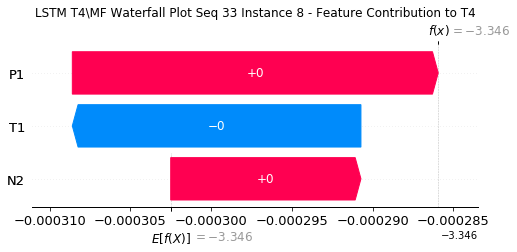

None

Contribution: [-1.90107499e-05 -2.23200022e-04 -1.64356341e-04]


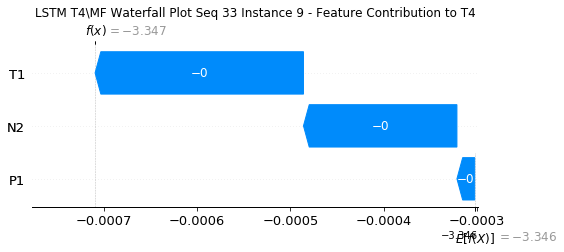

None

Contribution: [-6.31570108e-05 -2.23740161e-04 -2.91116592e-04]


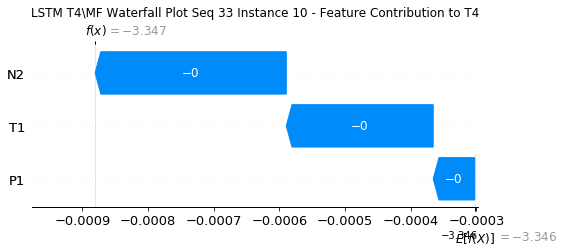

None

Contribution: [-7.27352292e-05  6.14650694e-05 -2.02970316e-04]


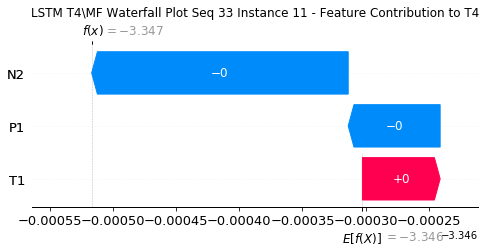

None

Contribution: [1.58536870e-05 6.58585432e-04 1.55012891e-04]


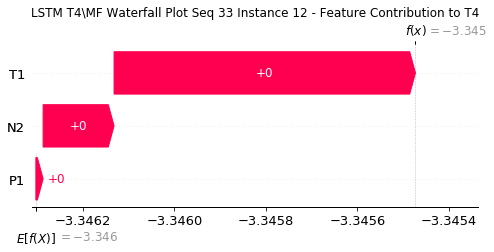

None

Contribution: [0.00012321 0.00127453 0.00052736]


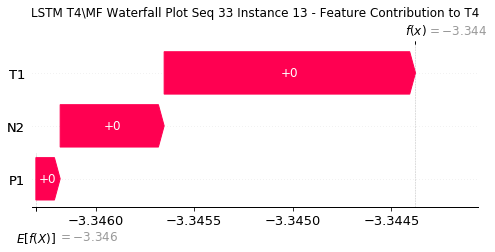

None

Contribution: [0.00022757 0.00147815 0.0004433 ]


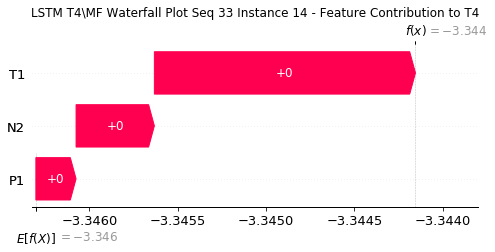

None

Contribution: [ 7.73418333e-05  7.98228036e-04 -2.28265913e-04]


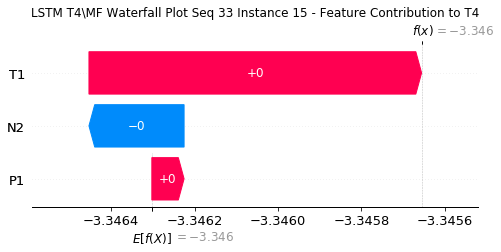

None

Contribution: [-0.00033004 -0.00117665 -0.00137665]


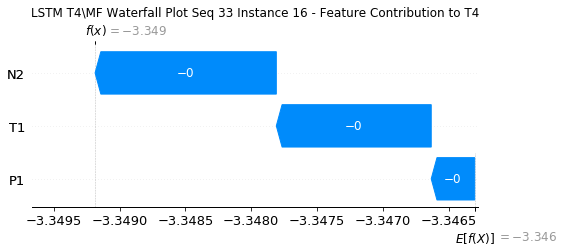

None

Contribution: [-0.00066334 -0.00380373 -0.00166452]


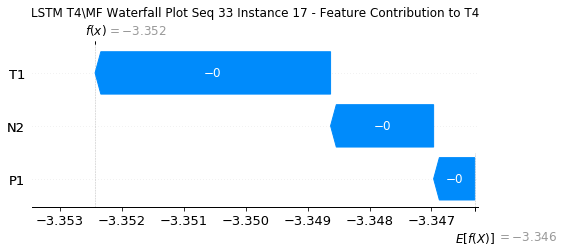

None

Contribution: [ 1.83522825e-04 -5.89889637e-03 -2.36614728e-05]


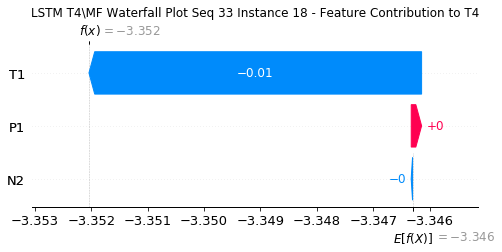

None

Contribution: [ 0.00039304 -0.00481921  0.00274039]


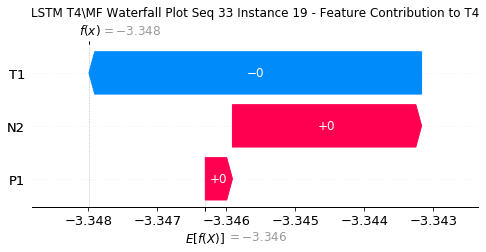

None

Contribution: [0.001047   0.00180666 0.00417841]


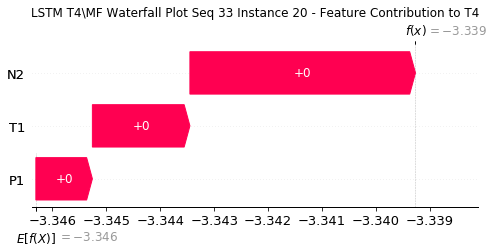

None

Contribution: [0.00144141 0.01522984 0.00081936]


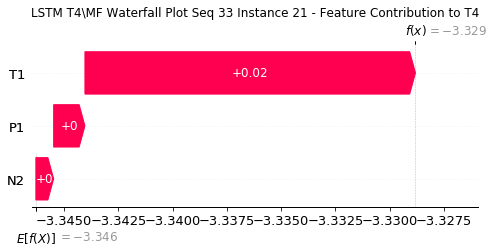

None

Contribution: [ 5.49188117e-06  3.29947223e-02 -6.33332655e-03]


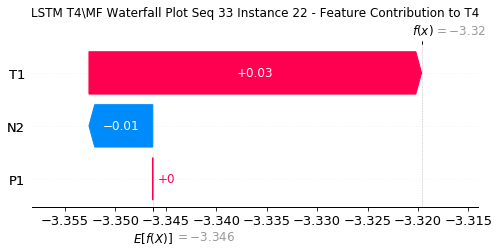

None

Contribution: [-0.00196158  0.04008618 -0.01402763]


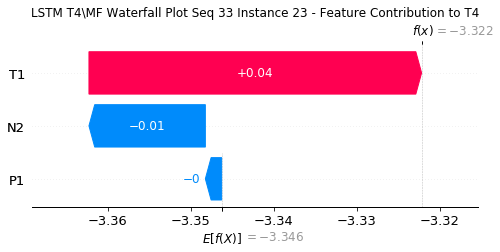

None

Contribution: [-0.00046     0.02163418 -0.00737848]


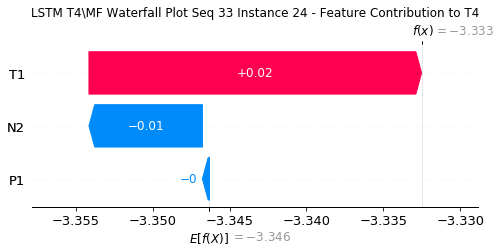

None

Contribution: [ 0.00236835  0.05041647 -0.00652619]


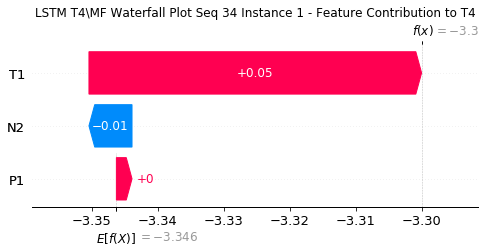

None

Contribution: [ 0.00021657 -0.00369543  0.00112859]


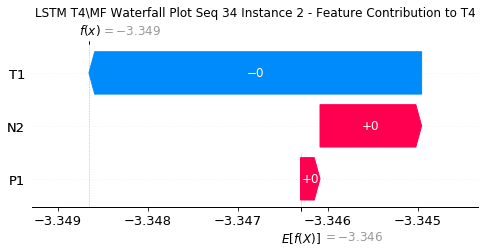

None

Contribution: [9.71699976e-05 1.63733628e-03 4.19978894e-05]


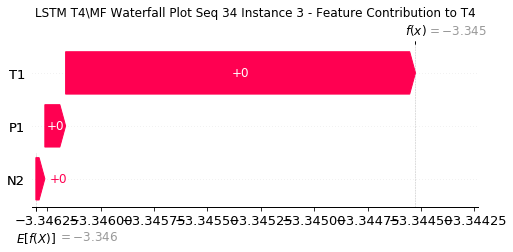

None

Contribution: [ 1.24545319e-05  3.64597810e-04 -1.20090225e-05]


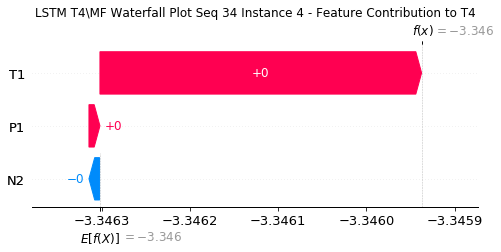

None

Contribution: [-9.79323967e-06  1.99620108e-04  3.59156902e-06]


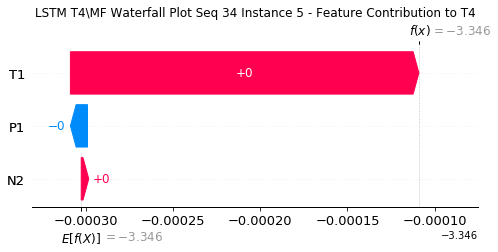

None

Contribution: [-4.93430110e-06  1.81160105e-04  7.59810404e-05]


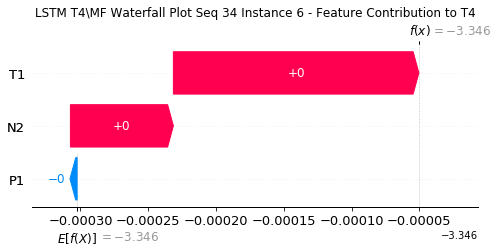

None

Contribution: [4.29872004e-05 1.58152771e-04 1.10698424e-04]


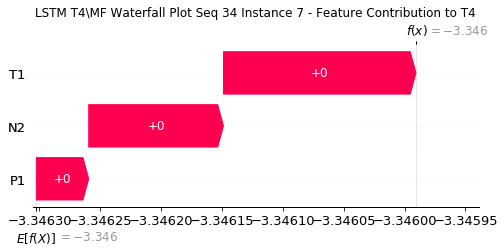

None

Contribution: [6.89392516e-05 1.09342524e-05 2.26862601e-05]


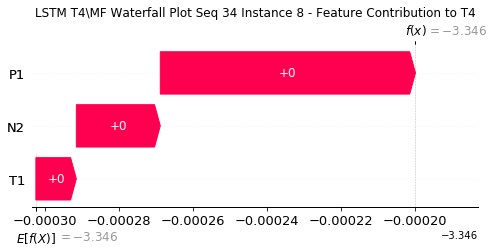

None

Contribution: [ 5.38550497e-05 -2.13608462e-04 -1.57431429e-04]


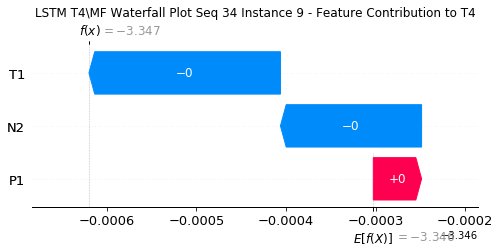

None

Contribution: [-7.82271825e-05 -3.48175707e-04 -3.00586043e-04]


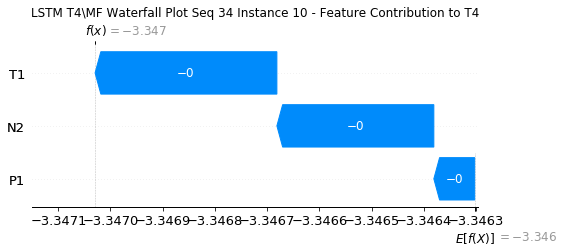

None

Contribution: [-0.00011044 -0.00015929 -0.00022334]


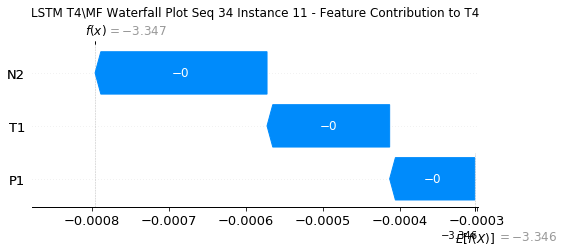

None

Contribution: [-2.50488276e-05  4.75611493e-04  1.46896436e-04]


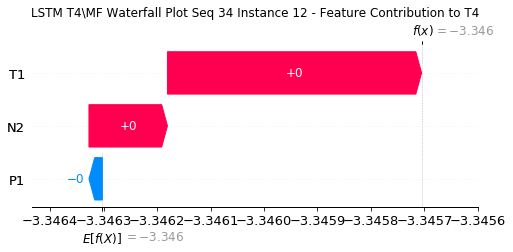

None

Contribution: [0.00012949 0.00130925 0.00054331]


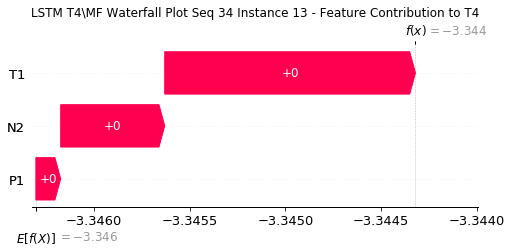

None

Contribution: [0.00031978 0.00181167 0.00047893]


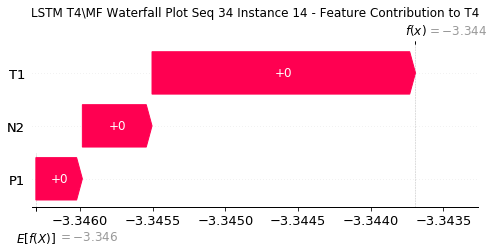

None

Contribution: [ 0.00031822  0.00147174 -0.00022167]


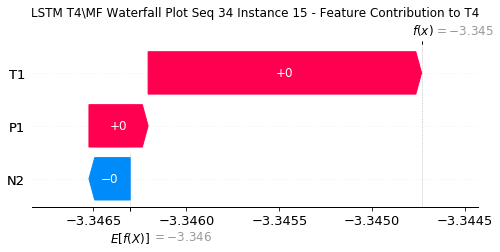

None

Contribution: [-0.00022008 -0.00074185 -0.00139767]


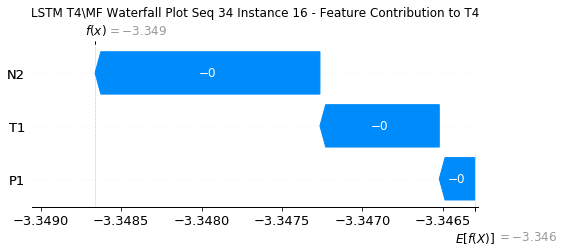

None

Contribution: [-0.00069895 -0.00395724 -0.00168655]


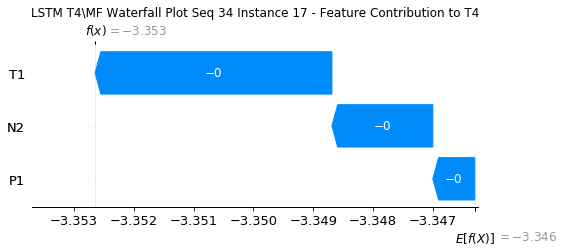

None

Contribution: [-3.63128321e-04 -6.16756100e-03 -7.55066307e-05]


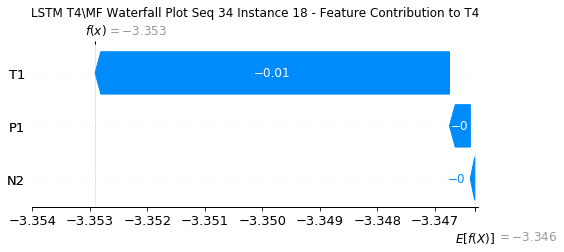

None

Contribution: [ 0.00023092 -0.0062085   0.00279826]


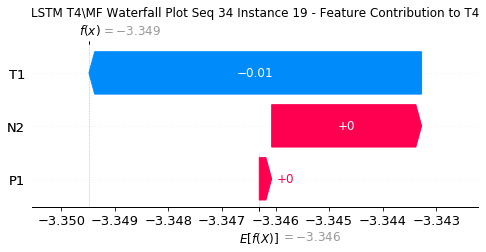

None

Contribution: [0.00093345 0.00053012 0.00426246]


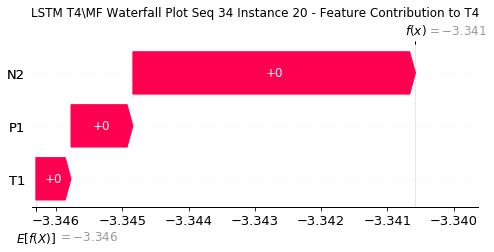

None

Contribution: [0.00159845 0.01476081 0.00090863]


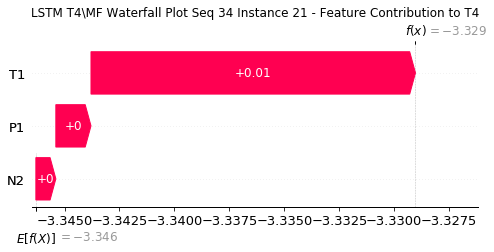

None

Contribution: [ 0.00107733  0.03391773 -0.00644139]


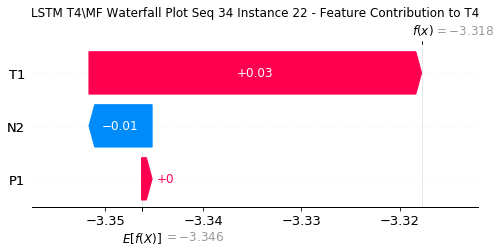

None

Contribution: [-0.00057063  0.04122755 -0.01409591]


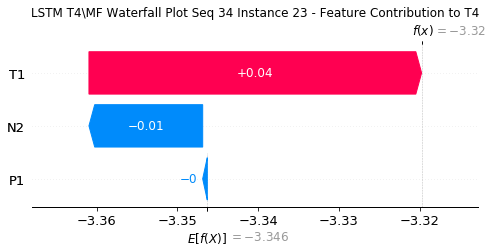

None

Contribution: [-0.00022401  0.02314637 -0.00761765]


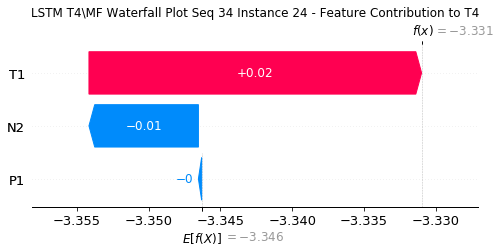

None

In [39]:
#Waterfall Plot for Consistency metric

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM T4\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to T4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)